In [1]:
import os
import sys
train_done = True
study_id = 'original'
write_in_file = False

data_ = 'TransMut'

data_dir = '/home/s202357/thesis/transmut/data/transmut_github/'
model_folder = '/home/s202357/thesis/transmut/pipeline/{}/models/'.format(study_id)
result_folder = '/home/s202357/thesis/transmut/pipeline/{}/results/'.format(study_id)

In [2]:
!gpustat

phoebe                         Tue Jun 21 16:52:46 2022  470.103.01
[0] NVIDIA GeForce GTX 1080 Ti | 20'C,   0 % |     1 / 11178 MB |
[1] NVIDIA GeForce GTX 1080 Ti | 22'C,   0 % |   785 / 11178 MB | s202357(781M)
[2] NVIDIA GeForce GTX 1080 Ti | 23'C,   0 % |     1 / 11178 MB |
[3] NVIDIA GeForce GTX 1080 Ti | 22'C,   0 % |     1 / 11178 MB |
[4] NVIDIA GeForce GTX 1080 Ti | 22'C,   0 % |     1 / 11178 MB |
[5] NVIDIA GeForce GTX 1080 Ti | 23'C,   0 % |     1 / 11178 MB |
[6] NVIDIA GeForce GTX 1080 Ti | 22'C,   0 % |     1 / 11178 MB |
[7] NVIDIA GeForce GTX 1080 Ti | 20'C,   0 % |     1 / 11178 MB |


In [3]:
os.environ['CUDA_VISIBLE_DEVICES']='1'

In [17]:
import math
from sklearn import metrics
from sklearn import preprocessing
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
import time
import datetime
import random
from scipy import spatial
from scipy.special import softmax
random.seed(1234)

import warnings
warnings.filterwarnings("ignore")

from collections import Counter
from functools import reduce
from tqdm import tqdm, trange
import seaborn as sn
from copy import deepcopy
from scipy import spatial

from IPython.display import HTML
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score, auc, accuracy_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_auc_score, roc_curve, auc

import gc
import os
import sys
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as Data


In [18]:
sys.path.append('/home/s202357/thesis/transmut/pipeline/procedure/functions')
sys.path.append('/home/s202357/thesis/transmut/pipeline/procedure/architecture')

import functions_figures as fnc
from model_components import *

In [19]:
if torch.cuda.is_available():
    device = torch.device('cuda')
    use_cuda = True
    print('There are %d GPU(s) avalable.' % torch.cuda.device_count())
else:
    print('No GPUs available. Using CPU instead.')
    device = torch.device('cpu')

There are 1 GPU(s) avalable.


In [20]:
seed = 19961231
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.benchmark = False
torch.backends.cudnn.deterministic = True

In [21]:
chart = [
[ ['1p', 'Blosum_ED', 20],           ['25p', 'Blosum_ED', 20],         ['75p', 'Blosum_ED', 20], ['100p', 'Blosum_ED', 20]],
[ ['1p', 'EmbeddingAttention', 4],   ['25p', 'EmbeddingAttention', 4],  ['75p', 'EmbeddingAttention', 4], ['100p', 'EmbeddingAttention', 4]],
[ ['1p', 'EmbeddingAttention', 20],  ['25p', 'EmbeddingAttention', 20], ['75p', 'EmbeddingAttention', 20], ['100p', 'EmbeddingAttention', 20]],    
[ ['1p', 'EmbeddingAttention', 32],  ['25p', 'EmbeddingAttention', 32], ['75p', 'EmbeddingAttention', 32], ['100p', 'EmbeddingAttention', 32]],
[ ['1p', 'EmbeddingAttention', 64],  ['25p', 'EmbeddingAttention', 64], ['75p', 'EmbeddingAttention', 64], ['100p', 'EmbeddingAttention', 64], ['100p', 'EmbeddingAttention', 128]]
]

size_dict = {'1p':6000,
             '5p':30000,
             '25':150500,
             '50p':301000,
             '75':451500}

for key, val in zip(blosum_dict.keys(), blosum_dict.values()):
    if len(val) != 20:
        print(key +":"+ str(len(val)), end =", ")

In [22]:
cv = 5
count = 0
index_order = []

for outer in range(cv):
        test_idx = outer
        for inner in range(cv):
            if inner!=outer:
                val_idx = inner
                train_index = list()
                for t in range(5):
                    if t!=inner and t!=outer:
                        train_index.append(t)
                count += 1  
                index_order.append([test_idx, val_idx, train_index])
                
index_order_nested = index_order


In [23]:
pep_max_len = 14
hla_max_len = 34

tgt_len = pep_max_len + hla_max_len

d_ff = 512
n_layers, n_heads = 1, 3

batch_size = 1024
epochs = 25
threshold = 0.5

vocab = np.load( data_dir + 'Transformer_vocab_dict.npy', allow_pickle = True).item()
vocab_size = len(vocab)

model_info = chart[4][3]
size = model_info[0]   
model_type = model_info[1]
d_model = d_k = d_v = model_info[2]
model_abbr = 'ED'

print(size, model_type, d_model)

id_blosum = 'OF_TData_pad14_{}_{}_hlac_pad'
id_emb = 'OF_TData_pad14_{}_{}'
#id_emb = 'OF_TData_pad14_{}_EmbeddingAttention_200ep'

save_attn = True
save_attn_hla = False
save_attn_decoder = False

criterion = nn.CrossEntropyLoss()
data_dir = '/home/s202357/thesis/transmut/data/transmut_github/'
vocab = np.load( data_dir + 'Transformer_vocab_dict.npy', allow_pickle = True).item()
pep_max_len = 14
hla_max_len = 34

100p EmbeddingAttention 64


SET PARAMETERS AND MODEL TO GET FIGURES

In [24]:
 if "Blosum" in model_type:
            id_nested = id_blosum.format(size, model_type)  
            encoding_ = 'blosum'

            class EncoderLayer(nn.Module):
                def __init__(self):
                    super(EncoderLayer, self).__init__()
                    self.enc_self_attn = MultiHeadAttention(d_model, d_k, d_v, n_heads)
                    self.pos_ffn = PoswiseFeedForwardNet(d_model, d_ff)

                def forward(self, enc_inputs, enc_self_attn_mask):
                    enc_outputs, attn = self.enc_self_attn(enc_inputs, enc_inputs, enc_inputs, enc_self_attn_mask) # enc_inputs to same Q,K,V
                    enc_outputs = self.pos_ffn(enc_outputs) # enc_outputs: [batch_size, src_len, d_model]
                    return enc_outputs, attn


            class Encoder(nn.Module):
                def __init__(self):
                    super(Encoder, self).__init__()
                    self.pos_emb = PositionalEncoding(d_model)
                    self.layers = nn.ModuleList([EncoderLayer() for _ in range(n_layers)])

                def forward(self, enc_inputs):
                    enc_outputs = self.pos_emb(enc_inputs.transpose(0, 1)).transpose(0, 1) # [batch_size, src_len, d_model]
                        
                    #print("\n\n\n\n\nshape enc_inputs-------")
                    #print("np.shape(enc_inputs)", np.shape(enc_inputs))
                    #print("type enc_inputs", type(enc_inputs))
                    #for i in enc_inputs[0]:
                    #    print(i)
                    
                    seq_q_pad = torch.from_numpy( np.array( [ [np.prod(aa) for aa in pep] for pep in np.array(enc_inputs.cpu())] )).to(device)
                    
                    
                    #print("np.shape(seq_q)", np.shape(seq_q), "-------")
                    #print("type (seq_q)", type(seq_q), "-------")
                    
                    #for i in seq_q[0]:
                    #    print(i)
                        
                    enc_self_attn_mask = fnc.get_attn_pad_mask_blosum(seq_q_pad, seq_q_pad) # [batch_size, src_len, src_len]
                        
                    del seq_q
                    gc.collect()
                    torch.cuda.empty_cache()
                    
                    #print("shape enc_self_attn_mask", np.shape(enc_self_attn_mask), "----------")
                    #for i in enc_self_attn_mask[0]:
                    #    print(i)
                    
                    enc_self_attns = []
                    for layer in self.layers:
                        enc_outputs, enc_self_attn = layer(enc_outputs, enc_self_attn_mask)
                        enc_self_attns.append(enc_self_attn)
                    return enc_outputs, enc_self_attns

            class DecoderLayer(nn.Module):
                def __init__(self):
                    super(DecoderLayer, self).__init__()
                    self.dec_self_attn = MultiHeadAttention(d_model, d_k, d_v, n_heads)
                    self.pos_ffn = PoswiseFeedForwardNet(d_model, d_ff)

                def forward(self, dec_inputs, dec_self_attn_mask): 
                    dec_outputs, dec_self_attn = self.dec_self_attn(dec_inputs, dec_inputs, dec_inputs, dec_self_attn_mask)
                    dec_outputs = self.pos_ffn(dec_outputs)
                    return dec_outputs, dec_self_attn


            class Decoder(nn.Module):
                def __init__(self):
                    super(Decoder, self).__init__()
                    self.use_cuda = use_cuda
                    device = torch.device('cuda')
                    self.pos_emb = PositionalEncoding(d_model)
                    self.layers = nn.ModuleList([DecoderLayer() for _ in range(n_layers)])
                    self.tgt_len = tgt_len

                def forward(self, dec_inputs): 
                    dec_outputs = self.pos_emb(dec_inputs.transpose(0, 1)).transpose(0, 1).to(device) # [batch_size, tgt_len, d_model]
                    dec_self_attn_pad_mask = torch.LongTensor(np.zeros((dec_inputs.shape[0], tgt_len, tgt_len))).bool().to(device)

                    dec_self_attns = []
                    for layer in self.layers:
                        dec_outputs, dec_self_attn = layer(dec_outputs, dec_self_attn_pad_mask)
                        dec_self_attns.append(dec_self_attn)

                    return dec_outputs, dec_self_attns
            print("Transformer Blosum imported")
            
if "Embedding" in model_type:
            
            id_nested = id_emb.format(size, model_type)
            encoding_ = 'embedding'
            
            class EncoderLayer(nn.Module):
                def __init__(self):
                    super(EncoderLayer, self).__init__()
                    self.enc_self_attn = MultiHeadAttention(d_model, d_k, d_v, n_heads)
                    self.pos_ffn = PoswiseFeedForwardNet(d_model, d_ff)

                def forward(self, enc_inputs, enc_self_attn_mask):
                    enc_outputs, attn = self.enc_self_attn(enc_inputs, enc_inputs, enc_inputs, enc_self_attn_mask) # enc_inputs to same Q,K,V
                    enc_outputs = self.pos_ffn(enc_outputs) # enc_outputs: [batch_size, src_len, d_model]
                    return enc_outputs, attn


            class Encoder(nn.Module):
                def __init__(self):
                    super(Encoder, self).__init__()
                    self.src_emb = nn.Embedding(vocab_size, d_model)
                    self.pos_emb = PositionalEncoding(d_model)
                    self.layers = nn.ModuleList([EncoderLayer() for _ in range(n_layers)])

                def forward(self, enc_inputs):
                    enc_outputs = self.src_emb(enc_inputs) # [batch_size, src_len, d_model]
                    '''
                    print("---------")
                    print("---------")
                    if len(enc_outputs[0]) == 14:
                        for i, t in zip(enc_inputs[0], enc_outputs[0]):
                            print("\'" + str(list(vocab.keys())[i.item()-1]) + "\':" , t.tolist())
                    print("---------")
                    print("---------")
                    print("---------")
                    '''
                    enc_outputs = self.pos_emb(enc_outputs.transpose(0, 1)).transpose(0, 1) # [batch_size, src_len, d_model]
                    enc_self_attn_mask = fnc.get_attn_pad_mask(enc_inputs, enc_inputs) # [batch_size, src_len, src_len]
                    
                    #print("\n\nshape enc_inputs-------")
                    #print("np.shape(enc_inputs)", np.shape(enc_inputs))
                    #for i in enc_inputs[0]:
                    #    print(i)
                    
                    enc_self_attns = []
                    for layer in self.layers:
                        enc_outputs, enc_self_attn = layer(enc_outputs, enc_self_attn_mask)
                        enc_self_attns.append(enc_self_attn)
                    return enc_outputs, enc_self_attns
            print("Transformer Embedding imported")
            
        
            class DecoderLayer(nn.Module):
                def __init__(self):
                    super(DecoderLayer, self).__init__()
                    self.dec_self_attn = MultiHeadAttention(d_model, d_k, d_v, n_heads)
                    self.pos_ffn = PoswiseFeedForwardNet(d_model, d_ff)

                def forward(self, dec_inputs, dec_self_attn_mask): 
                    '''
                    dec_inputs: [batch_size, tgt_len, d_model]
                    enc_outputs: [batch_size, src_len, d_model]
                    dec_self_attn_mask: [batch_size, tgt_len, tgt_len]
                    '''
                    dec_outputs, dec_self_attn = self.dec_self_attn(dec_inputs, dec_inputs, dec_inputs, dec_self_attn_mask)
                    dec_outputs = self.pos_ffn(dec_outputs) 
                    return dec_outputs, dec_self_attn


            class Decoder(nn.Module):
                def __init__(self):
                    super(Decoder, self).__init__()
                    self.use_cuda = use_cuda
                    device = torch.device('cuda')
                    self.pos_emb = PositionalEncoding(d_model)
                    self.layers = nn.ModuleList([DecoderLayer() for _ in range(n_layers)])
                    self.tgt_len = tgt_len

                def forward(self, dec_inputs): 
                    '''
                    dec_inputs: [batch_size, tgt_len]
                    enc_intpus: [batch_size, src_len]
                    enc_outputs: [batsh_size, src_len, d_model]
                    '''
                    dec_outputs = self.pos_emb(dec_inputs.transpose(0, 1)).transpose(0, 1).to(device) 
                    dec_self_attn_pad_mask = torch.LongTensor(np.zeros((dec_inputs.shape[0], tgt_len, tgt_len))).bool().to(device)

                    dec_self_attns = []
                    for layer in self.layers:
                        dec_outputs, dec_self_attn = layer(dec_outputs, dec_self_attn_pad_mask)
                        dec_self_attns.append(dec_self_attn)

                    return dec_outputs, dec_self_attns
                
                
class Transformer(nn.Module):
    def __init__(self):
        super(Transformer, self).__init__()
        self.use_cuda = use_cuda
        device = torch.device('cuda')
        self.pep_encoder = Encoder().to(device)
        self.hla_encoder = Encoder().to(device)
        self.decoder = Decoder().to(device)
        self.tgt_len = tgt_len
        self.projection = nn.Sequential(
                                        nn.Linear(tgt_len * d_model, 256),
                                        nn.ReLU(True),

                                        nn.BatchNorm1d(256),
                                        nn.Linear(256, 64),
                                        nn.ReLU(True),

                                        #output layer
                                        nn.Linear(64, 2)
                                        ).to(device)
        
    def forward(self, pep_inputs, hla_inputs):
        '''
        pep_inputs: [batch_size, pep_len]
        hla_inputs: [batch_size, hla_len]
        '''
        pep_enc_outputs, pep_enc_self_attns = self.pep_encoder(pep_inputs)
        hla_enc_outputs, hla_enc_self_attns = self.hla_encoder(hla_inputs)
        enc_outputs = torch.cat((pep_enc_outputs, hla_enc_outputs), 1) # concat pep & hla embedding
        
        dec_outputs, dec_self_attns = self.decoder(enc_outputs)
        dec_outputs = dec_outputs.view(dec_outputs.shape[0], -1) # Flatten [batch_size, tgt_len * d_model]
        dec_logits = self.projection(dec_outputs) # dec_logits: [batch_size, tgt_len, tgt_vocab_size]

        return dec_logits.view(-1, dec_logits.size(-1)), pep_enc_self_attns, hla_enc_self_attns, dec_self_attns
    
    
def eval_step_test(model, model_type, threshold, val_loader, fold, epoch, epochs, use_cuda = True):
    device = torch.device('cuda')
    
    model.eval()
    torch.manual_seed(19961231)
    torch.cuda.manual_seed(19961231)
    with torch.no_grad():
        loss_val_list, dec_attns_val_list = [], []
        y_true_val_list, y_prob_val_list, attns_val_list, attns_hla_val_list = [], [], [], []
        for val_pep_inputs, val_hla_inputs, _, val_labels in val_loader:
            val_pep_inputs, val_hla_inputs, val_labels = val_pep_inputs.to(device), val_hla_inputs.to(device), val_labels.to(device)
            
            if model_type == 'ED':
                val_outputs, enc_attn, enc_hla_attn, dec_attns = model(val_pep_inputs, val_hla_inputs)
            else:
                val_outputs, enc_attn, enc_hla_attn = model(val_pep_inputs, val_hla_inputs, val_pep_inputs)
            val_loss = criterion(val_outputs, val_labels)
            y_true_val = val_labels.cpu().numpy()
            y_prob_val = nn.Softmax(dim = 1)(val_outputs)[:, 1].cpu().detach().numpy()

            y_true_val_list.extend(y_true_val)
            y_prob_val_list.extend(y_prob_val)
            loss_val_list.append(val_loss)
            
            if model_type != 'FFNN':
                attns_val_list.extend(enc_attn[0].cpu().numpy())
                attns_hla_val_list.extend(enc_hla_attn[0].cpu().numpy())
                dec_attns_val_list.extend(dec_attns[0].cpu().numpy())
            
        y_pred_val_list = transfer(y_prob_val_list, threshold)
        ys_val = (y_true_val_list, y_pred_val_list, y_prob_val_list)
        
        print_bool = False
        if epoch == 1 or epoch == 25 or epoch == 50:
            print_bool = True
            print('\nFold-{} **** Test  Epoch-{}/{}: Loss = {:.6f} | '.format(fold, epoch, epochs, f_mean(loss_val_list)), end='')
            
        metrics_val = performances(y_true_val_list, y_pred_val_list, y_prob_val_list, print_ = print_bool)
    return ys_val, loss_val_list, metrics_val, y_prob_val_list, y_pred_val_list, attns_val_list,  attns_hla_val_list, dec_attns_val_list

Transformer Embedding imported


TEST MODEL

In [25]:
auc_list = []
auc01_list = []
ppv_list = []

In [26]:
print('\n\n\n===== Model {}, {}, {} ====='.format(size,model_type,d_model))

ep_best = 0
fold = 0

test_fold_metrics_list_nested = []

fold_avg_4 = True
type_ = 'test'

df_list = []
time_testing = time.time()

if fold_avg_4:

    fold_avg_all = [list(range(0,4)), list(range(4,8)), list(range(8,12)), list(range(12,16)), list(range(16,20))] 
    pred_all = []
    target_all = []
    enc_attn_list_all = []
    enc_hla_attn_list_all = []
    enc_dec_attn_list_all = []
    
    for fold_avg, file_num in zip(fold_avg_all,[0,1,2,3,4]):

            pred_fold = []
            target_fold = []
            enc_attn_list_tmp = []
            enc_hla_attn_list_tmp = []
            enc_dec_attn_list_tmp = []

            #print('\n=====Models-{}====='.format(fold_avg))
            for f in fold_avg:
                index_order_idx = f
                path_saver = model_folder + fnc.pkl(id_nested, n_layers, n_heads, f, d_model)
                print("\t"+path_saver.replace("/home/s202357/thesis/transmut/pipeline/original/models/",""))

                test_data, test_pep_inputs, test_hla_inputs, test_labels, test_loader = fnc.data_with_loader_unique(data_dir, 
                                                                                                                    model_type, 
                                                                                                                    pep_max_len,
                                                                                                                    hla_max_len,
                                                                                                                    vocab,
                                                                                                                    index_order_idx, 
                                                                                                                    type_ = type_, 
                                                                                                                    fold = file_num,  
                                                                                                                    batch_size = batch_size)
                model = Transformer().to(device)

                model.load_state_dict(torch.load(path_saver))
                model_test = model.eval()

                ys_res_test, loss_res_test_list, metrics_res_test, y_prob, y_pred_bin, enc_attn_list, enc_hla_attn_list, enc_dec_attn_list = eval_step_test(model_test, 
                                                                                                       model_abbr,
                                                                                                       threshold,
                                                                                                       test_loader, 
                                                                                                       fold, 
                                                                                                       ep_best, 
                                                                                                       epochs, 
                                                                                                       use_cuda) # , test_res_attns
                pred_fold.append(y_prob)
                target_fold = [x.item() for x in test_labels]

                df_temp = pd.DataFrame(list(zip(target_fold, y_prob)), columns= ['target_', 'pred_'])
                num_pos = len(df_temp[df_temp['target_']==1])
                df_temp_ppv = df_temp.sort_values(by=['pred_'], ascending=False)[0:num_pos]
                num_true_pos = len(df_temp_ppv[df_temp_ppv['target_']==1])
                ppv = num_true_pos/num_pos
                auc_01 = fnc.binary_roc_auc_score(df_temp['target_'].tolist(), df_temp['pred_'], max_fpr=0.1)
                auc01_ppv = (auc_01, ppv)
                metrics_final = (*auc01_ppv, *metrics_res_test)

                test_fold_metrics_list_nested.append(metrics_final)
                
                if save_attn:
                    enc_attn_list_tmp.append(enc_attn_list)
                if save_attn_hla:
                    enc_hla_attn_list_tmp.append(enc_hla_attn_list)
                if save_attn_decoder:
                    enc_dec_attn_list_tmp.append(enc_dec_attn_list)
                    
                
                del test_pep_inputs, test_hla_inputs, test_labels, test_loader, model, ys_res_test, loss_res_test_list, metrics_res_test, y_prob, y_pred_bin
                gc.collect()
                torch.cuda.empty_cache()
                print("")

            #print("\t\tTaking the average:")   
            # get avg of attn
            if save_attn:
                enc_attn_list_mean = np.mean(enc_attn_list_tmp, axis=0)
                enc_attn_list_all.extend(enc_attn_list_mean)
                del enc_attn_list_tmp, enc_attn_list_mean
                gc.collect()
            if save_attn_hla:
                enc_hla_attn_list_mean = np.mean(enc_hla_attn_list_tmp, axis=0)
                enc_hla_attn_list_all.extend(enc_hla_attn_list_mean)  
                
            if save_attn_decoder:
                enc_dec_attn_list_mean = np.mean(enc_dec_attn_list_tmp, axis=0)
                enc_dec_attn_list_all.extend(enc_dec_attn_list_mean)  
            
            arrays = [np.array(x) for x in pred_fold]
            pred_fold_avg = [np.mean(k) for k in zip(*arrays)]
            pred_all.extend(pred_fold_avg)
            target_all.extend(target_fold)
            print("\t\t\t\t roc in:", roc_auc_score(target_fold, pred_fold_avg))

            test_data['target_'] = target_fold
            test_data['pred_'] = pred_fold_avg
            df_list.append(test_data)

    df_pd_nested_test_unique = pd.concat(df_list)
    del df_list
    gc.collect()




===== Model 100p, EmbeddingAttention, 64 =====
	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL0.pkl
	Test File ID 0 372896 torch.Size([372896, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL1.pkl
	Test File ID 0 372896 torch.Size([372896, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL2.pkl
	Test File ID 0 372896 torch.Size([372896, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL3.pkl
	Test File ID 0 372896 torch.Size([372896, 14])

				 roc in: 0.9817994771565939
	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL4.pkl
	Test File ID 1 372782 torch.Size([372782, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL5.pkl
	Test File ID 1 372782 torch.Size([372782, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MODEL6.pkl
	Test File ID 1 372782 torch.Size([372782, 14])

	OF_TData_pad14_100p_EmbeddingAttention_d64_layer1_multihead3_MO

In [27]:
df_results = pd.DataFrame(list(zip(target_all, pred_all)), columns= ['target', 'pred'])
del model_test, target_all, pred_all, Transformer
gc.collect()
torch.cuda.empty_cache()

In [28]:
#print("Time testing:", round((time.time()-time_testing)/60, 2), "mins. \n\n")
print(model_info)
print("== Stats:")
auc_ = roc_auc_score(df_results['target'], df_results['pred'])
print("  auc:", auc_)

num_pos = len(df_results[df_results['target']==1])
df_temp_ppv = df_results.sort_values(by=['pred'], ascending=False)[0:num_pos]
num_true_pos = len(df_temp_ppv[df_temp_ppv['target']==1])
ppv = num_true_pos/num_pos
auc_01 = fnc.binary_roc_auc_score(df_results['target'].tolist(), df_results['pred'].tolist(), max_fpr=0.1)
print("  auc fpr 0.1:", auc_01)
print("  ppv:", ppv)

acc_best, i, df_results = fnc.best_treshold(df_results, [0.5])
print("  Used/Best treshold:", i, "\n")
print("  AUC pred treshold:", roc_auc_score(df_results['target'], df_results['pred_binary']))
roc_auc, acc, mcc, f1, sensitivity, specificity, precision, recall, aupr = fnc.performances(df_results['target'], df_results['pred_binary'], df_results['pred'], print_ = True)

del df_results
gc.collect()

['100p', 'EmbeddingAttention', 64]
== Stats:
  auc: 0.9814548469753153
  auc fpr 0.1: 0.8683893995397715
  ppv: 0.8728721538230233
  Used/Best treshold: 0.5 

  AUC pred treshold: 0.9344769844719177
tn = 1410586, fp = 94868, fn = 24434, tp = 334732
y_pred: 0 = 1435020 | 1 = 429600
y_true: 0 = 1505454 | 1 = 359166
auc=0.9815|sensitivity=0.9320|specificity=0.9370|acc=0.9360|mcc=0.8138
precision=0.7792|recall=0.9320|f1=0.8487|aupr=0.9379


0

In [29]:
def aa_spec_attn(data, attn, max_len, label, pep_len = None, HLA_type = None, fltr = None):
        
    aa_spec_attn = np.zeros((20,max_len,max_len))
    head_mean = np.array(attn).mean(axis=1)
    
    if fltr:
        data = data[0:fltr[0]]
        head_mean = head_mean[0:fltr[0]]
        
    cc = 0
    for attn, peptide, hla, lbl in zip(head_mean, data['peptide'].tolist(), data['HLA'].tolist(), data['label'].tolist()):
        if HLA_type == None:
            hla = None
        if lbl == label and hla == HLA_type and len(peptide) in pep_len:
            cc += 1
            for aa, idx in zip(peptide, list(range(len(peptide)))):
                attn_row = attn[idx]
                aa_spec_attn[aas_dict[aa]][idx] = aa_spec_attn[aas_dict[aa]][idx] + attn_row
        else:
            continue

    print(cc)        
    return aa_spec_attn / cc*10

def plot_attn(df, attn, idx):
    print(df[['peptide','length','HLA','label']][idx:idx+1])
    return sn.heatmap(attn,cmap='YlGnBu')

In [ ]:
# pep len and hla are filtered
aa_spec_attn_map = aa_spec_attn(df_pd_nested_test_unique, enc_attn_list_all, pep_max_len, 1, [9], 'HLA-A*02:01', [])

fig, axes = plt.subplots(4, 5, figsize=(20, 14))
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)
t = 0
for xc in range(4):
    for yc in range(5):
        aa = list(blosum_dict.keys())[t]
        attn = np.array(aa_spec_attn_map)[t]
        s = sn.heatmap(ax=axes[xc, yc], data=attn, cmap='YlGnBu')
        s.set(xlabel=aa)
        t += 1
        
fig.show()

## ATTENTION MHC: 100p 64d

In [26]:
def corrcoef_aas(repr_dict, HLA_list, norm = None, pearson= True):
    tbl = []
    for HLA_filter_1 in HLA_list:
        row = []
        #print(HLA_filter_1 + ", ", end="")
        for HLA_filter_2 in HLA_list:
            X = repr_dict[HLA_filter_1]
            Y = repr_dict[HLA_filter_2]
            if pearson:
                #method 1:
                pearson = np.corrcoef(X, Y)[0][1] 
                if norm:
                    pearson = round(pearson * norm)
                row.append(pearson)
            else:
                #method 2:
                cos = (1 - spatial.distance.cosine(X, Y))
                if norm:
                    cos = round(cos * norm)
                row.append(cos)
        gc.collect()
        tbl.append(row)
    return tbl

def cluster_HLA(col_mean_per_HLA):
    tbl = corrcoef_aas(col_mean_per_HLA, col_mean_per_HLA.keys(), norm = None, pearson = True)
    tbl = pd.DataFrame(tbl)
    tbl.columns = col_mean_per_HLA.keys()
    tbl = tbl.set_axis(col_mean_per_HLA.keys(), axis='index').sort_index(ascending=True)
    return tbl

In [28]:
enc_hla_attn_list_all = torch.from_numpy(np.array(enc_hla_attn_list_all))
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))

In [29]:
df_pd_nested_test_unique.reset_index(drop=True)

,peptide,length,HLA,label,HLA_sequence,target_,pred_
0,HLNRTLAEN,9,HLA-B*15:01,0,YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY,0,0.001859
1,SDADCPTC,8,HLA-C*07:01,0,YDSGYRENYRQADVSNLYLRYDSYTLAALAYTWY,0,0.000020
2,LKRMSVYVILV,11,HLA-B*58:01,0,YYATYGENMASTYENIAYIRYDSYTWAVLAYLWY,0,0.000804
3,MPSVFQNVL,9,HLA-C*04:01,1,YSAGYREKYRQADVNKLYLRFNFYTWAERAYTWY,1,0.978176
4,TPSSREGTL,9,HLA-B*07:02,1,YYSEYRNIYAQTDESNLYLSYDYYTWAERAYEWY,1,0.998247
...,...,...,...,...,...,...,...
1864615,QGDGEDNHM,9,HLA-C*02:02,0,YYAGYREKYRQTDVNKLYLRYDSYTWAEWAYEWY,0,0.002356
1864616,FTSAEDDE,8,HLA-B*15:01,0,YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY,0,0.002255
1864617,TATTPTATS,9,HLA-B*14:02,0,YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH,0,0.000081
1864618,RGASGSIFS,9,HLA-C*03:03,0,YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY,0,0.000853


#Peptides: 1809
HLA: HLA-C*17:01
Threshold: 0.6
YYAGYREKYRQADVNKLYIRYNFYSLAELAYEWY
threshold: 0.6


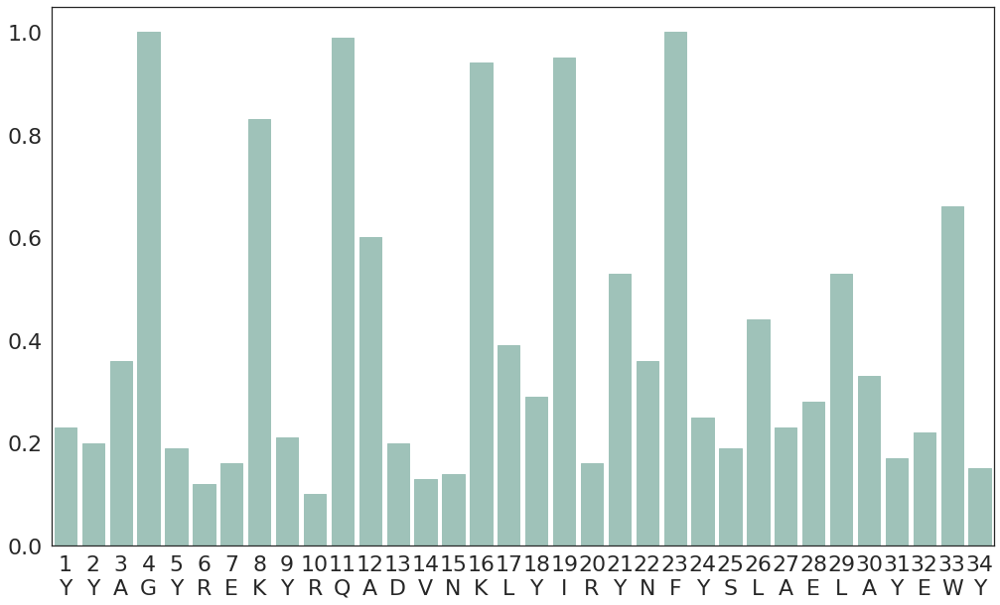

[0.23, 0.2, 0.36, 1.0, 0.19, 0.12, 0.16, 0.83, 0.21, 0.1, 0.99, 0.6, 0.2, 0.13, 0.14, 0.94, 0.39, 0.29, 0.95, 0.16, 0.53, 0.36, 1.0, 0.25, 0.19, 0.44, 0.23, 0.28, 0.53, 0.33, 0.17, 0.22, 0.66, 0.15]

---------------------
#Peptides: 3323
HLA: HLA-B*27:03
Threshold: 0.6
YHTEHREICAKTDEDTLYLNYHDYTWAVLAYEWY
threshold: 0.6


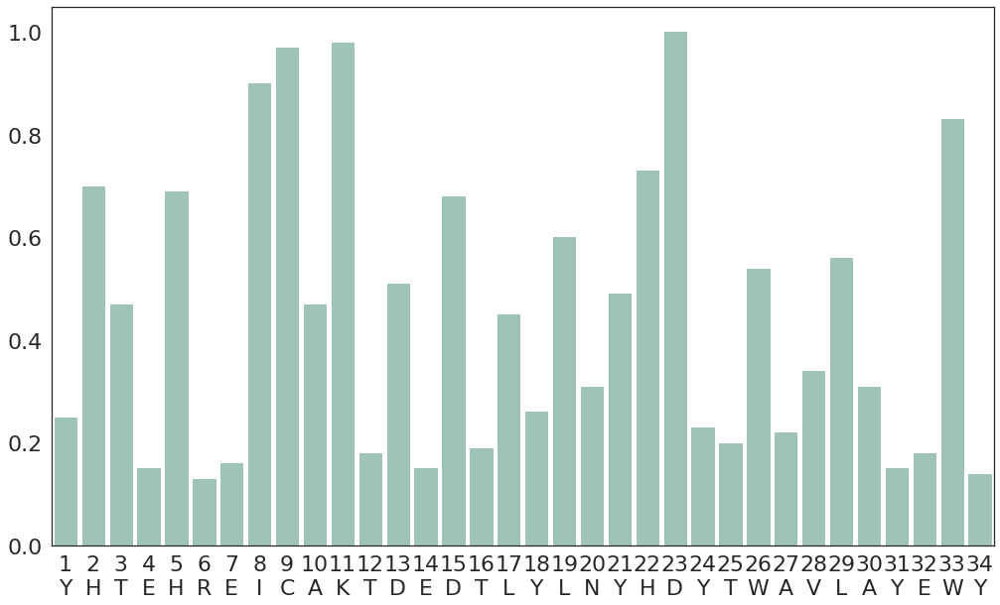

[0.25, 0.7, 0.47, 0.15, 0.69, 0.13, 0.16, 0.9, 0.97, 0.47, 0.98, 0.18, 0.51, 0.15, 0.68, 0.19, 0.45, 0.26, 0.6, 0.31, 0.49, 0.73, 1.0, 0.23, 0.2, 0.54, 0.22, 0.34, 0.56, 0.31, 0.15, 0.18, 0.83, 0.14]

---------------------
#Peptides: 17954
HLA: HLA-C*03:03
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY
threshold: 0.6


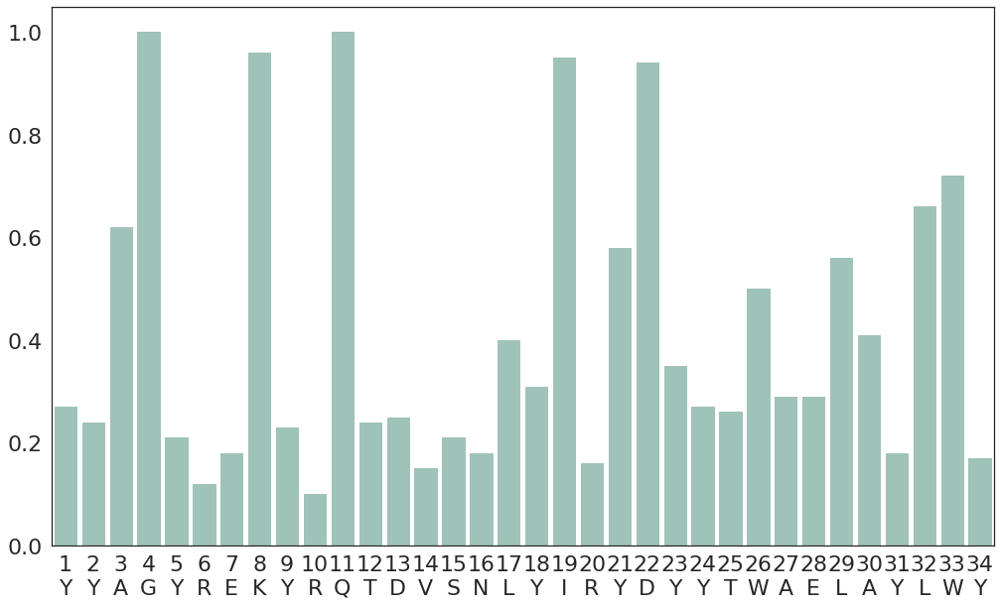

[0.27, 0.24, 0.62, 1.0, 0.21, 0.12, 0.18, 0.96, 0.23, 0.1, 1.0, 0.24, 0.25, 0.15, 0.21, 0.18, 0.4, 0.31, 0.95, 0.16, 0.58, 0.94, 0.35, 0.27, 0.26, 0.5, 0.29, 0.29, 0.56, 0.41, 0.18, 0.66, 0.72, 0.17]

---------------------
#Peptides: 14535
HLA: HLA-C*16:01
Threshold: 0.6
YYAGYREKYRQTDVSNLYLWYDSYTWAAQAYTWY
threshold: 0.6


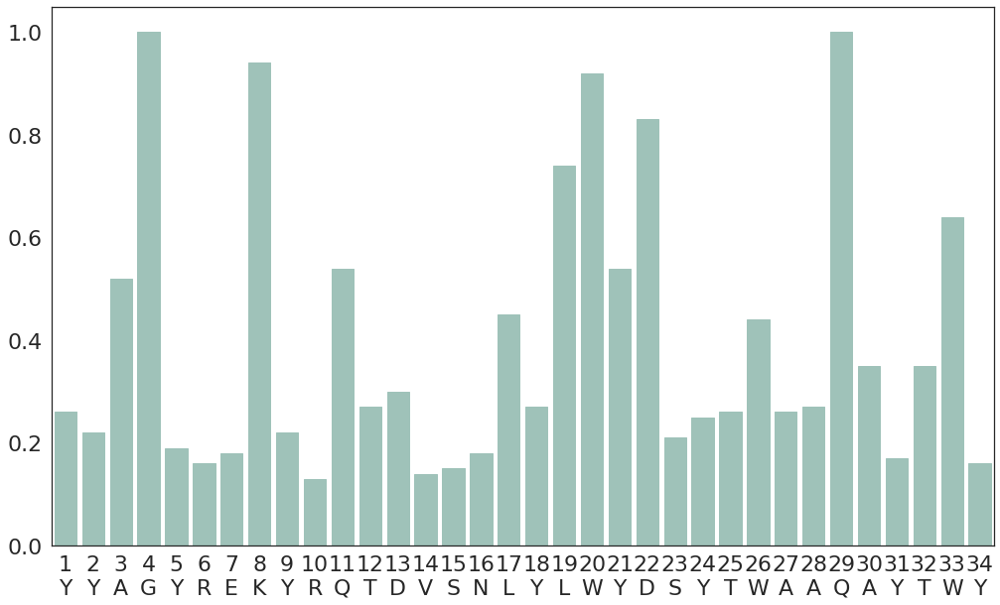

[0.26, 0.22, 0.52, 1.0, 0.19, 0.16, 0.18, 0.94, 0.22, 0.13, 0.54, 0.27, 0.3, 0.14, 0.15, 0.18, 0.45, 0.27, 0.74, 0.92, 0.54, 0.83, 0.21, 0.25, 0.26, 0.44, 0.26, 0.27, 1.0, 0.35, 0.17, 0.35, 0.64, 0.16]

---------------------
#Peptides: 3367
HLA: HLA-A*02:20
Threshold: 0.6
YFAMYGENVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


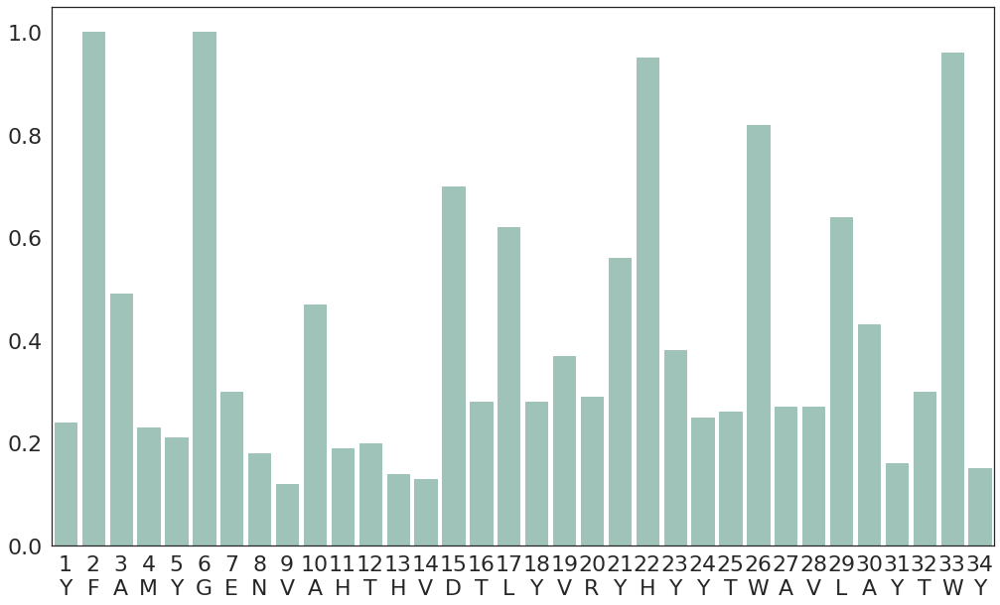

[0.24, 1.0, 0.49, 0.23, 0.21, 1.0, 0.3, 0.18, 0.12, 0.47, 0.19, 0.2, 0.14, 0.13, 0.7, 0.28, 0.62, 0.28, 0.37, 0.29, 0.56, 0.95, 0.38, 0.25, 0.26, 0.82, 0.27, 0.27, 0.64, 0.43, 0.16, 0.3, 0.96, 0.15]

---------------------
#Peptides: 979
HLA: HLA-A*02:17
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLMFHYYTWAVLAYTWY
threshold: 0.6


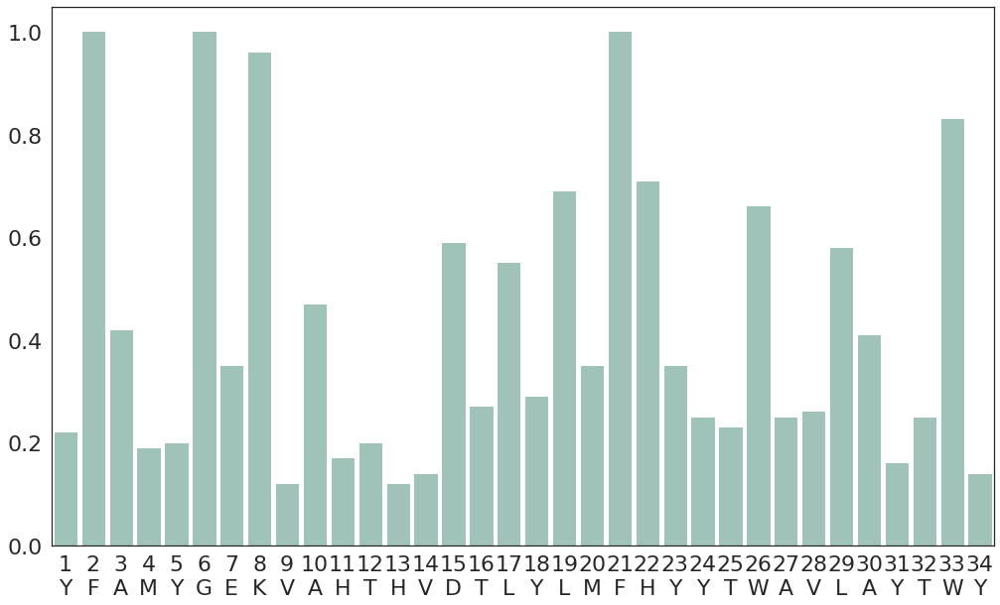

[0.22, 1.0, 0.42, 0.19, 0.2, 1.0, 0.35, 0.96, 0.12, 0.47, 0.17, 0.2, 0.12, 0.14, 0.59, 0.27, 0.55, 0.29, 0.69, 0.35, 1.0, 0.71, 0.35, 0.25, 0.23, 0.66, 0.25, 0.26, 0.58, 0.41, 0.16, 0.25, 0.83, 0.14]

---------------------
#Peptides: 35562
HLA: HLA-A*01:01
Threshold: 0.6
YFAMYQENMAHTDANTLYIIYRDYTWVARVYRGY
threshold: 0.6


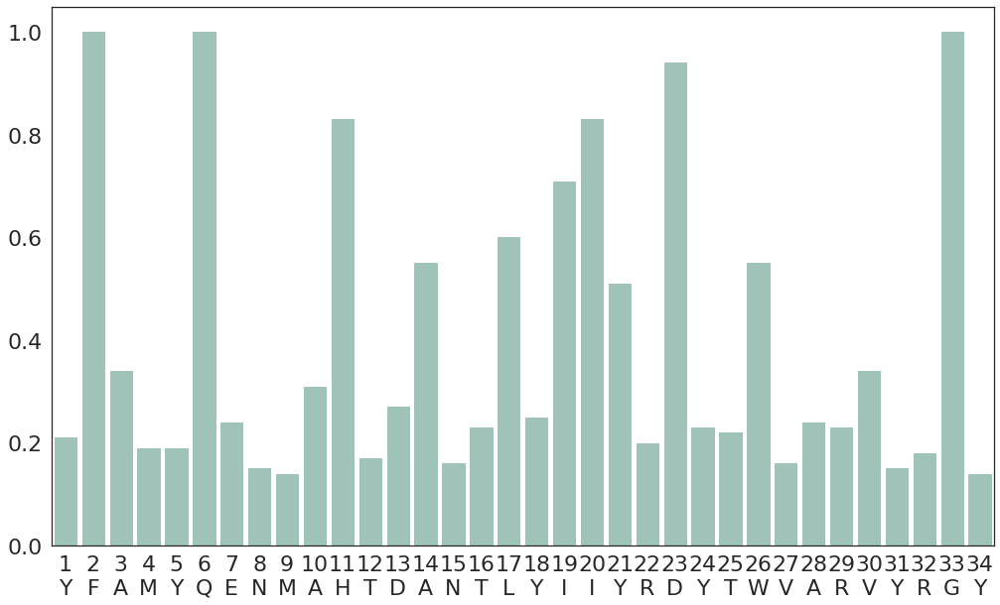

[0.21, 1.0, 0.34, 0.19, 0.19, 1.0, 0.24, 0.15, 0.14, 0.31, 0.83, 0.17, 0.27, 0.55, 0.16, 0.23, 0.6, 0.25, 0.71, 0.83, 0.51, 0.2, 0.94, 0.23, 0.22, 0.55, 0.16, 0.24, 0.23, 0.34, 0.15, 0.18, 1.0, 0.14]

---------------------
#Peptides: 8070
HLA: HLA-C*01:02
Threshold: 0.6
YFSGYREKYRQTDVSNLYLWCDYYTWAERAYTWY
threshold: 0.6


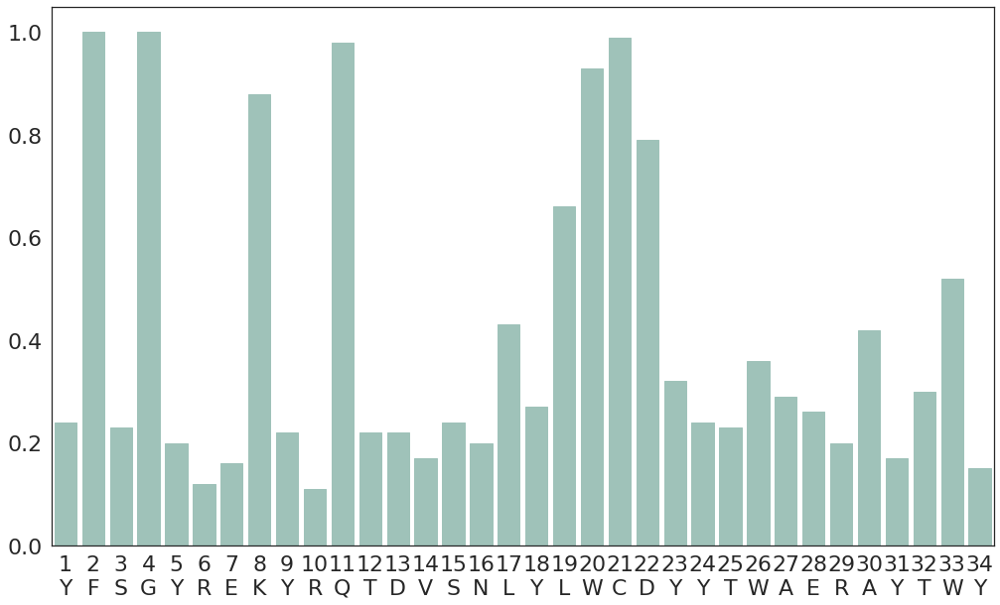

[0.24, 1.0, 0.23, 1.0, 0.2, 0.12, 0.16, 0.88, 0.22, 0.11, 0.98, 0.22, 0.22, 0.17, 0.24, 0.2, 0.43, 0.27, 0.66, 0.93, 0.99, 0.79, 0.32, 0.24, 0.23, 0.36, 0.29, 0.26, 0.2, 0.42, 0.17, 0.3, 0.52, 0.15]

---------------------
#Peptides: 13088
HLA: HLA-B*38:01
Threshold: 0.6
YYSEYRNICTNTYENIAYLRYNFYTWAVLTYTWY
threshold: 0.6


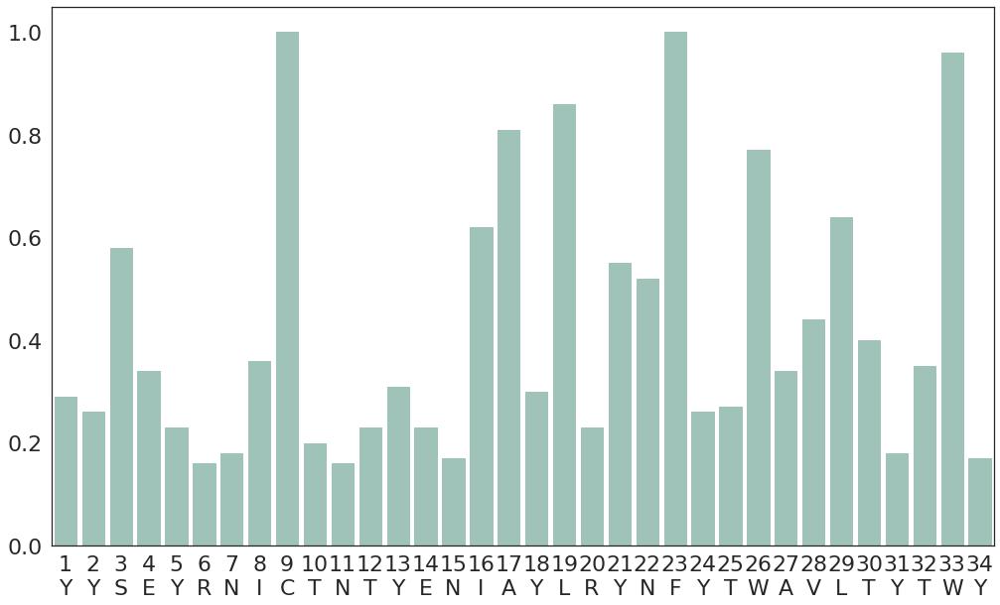

[0.29, 0.26, 0.58, 0.34, 0.23, 0.16, 0.18, 0.36, 1.0, 0.2, 0.16, 0.23, 0.31, 0.23, 0.17, 0.62, 0.81, 0.3, 0.86, 0.23, 0.55, 0.52, 1.0, 0.26, 0.27, 0.77, 0.34, 0.44, 0.64, 0.4, 0.18, 0.35, 0.96, 0.17]

---------------------
#Peptides: 9520
HLA: HLA-B*45:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAVDAYLSY
threshold: 0.6


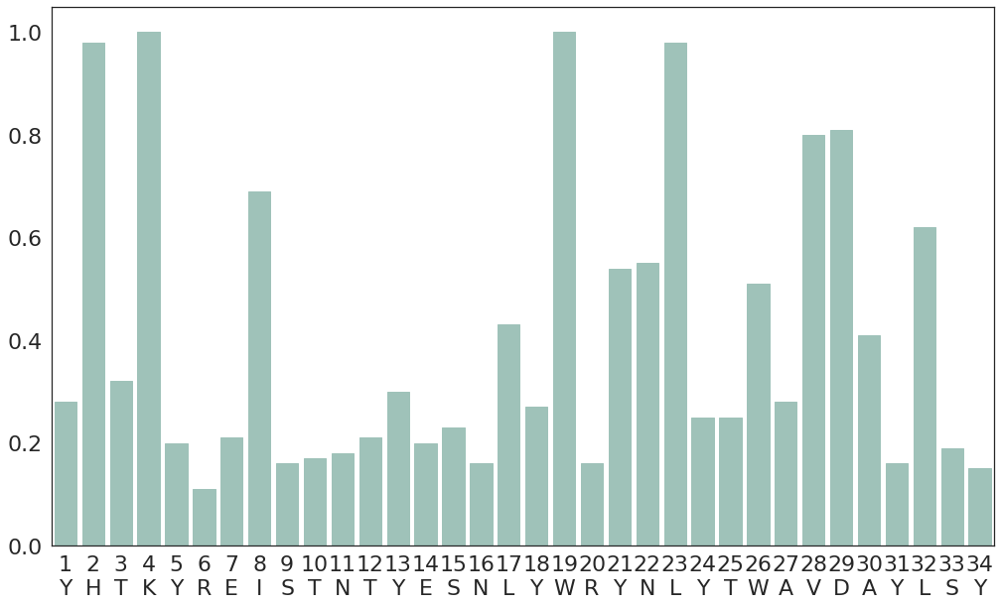

[0.28, 0.98, 0.32, 1.0, 0.2, 0.11, 0.21, 0.69, 0.16, 0.17, 0.18, 0.21, 0.3, 0.2, 0.23, 0.16, 0.43, 0.27, 1.0, 0.16, 0.54, 0.55, 0.98, 0.25, 0.25, 0.51, 0.28, 0.8, 0.81, 0.41, 0.16, 0.62, 0.19, 0.15]

---------------------
#Peptides: 8410
HLA: HLA-A*02:02
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY
threshold: 0.6


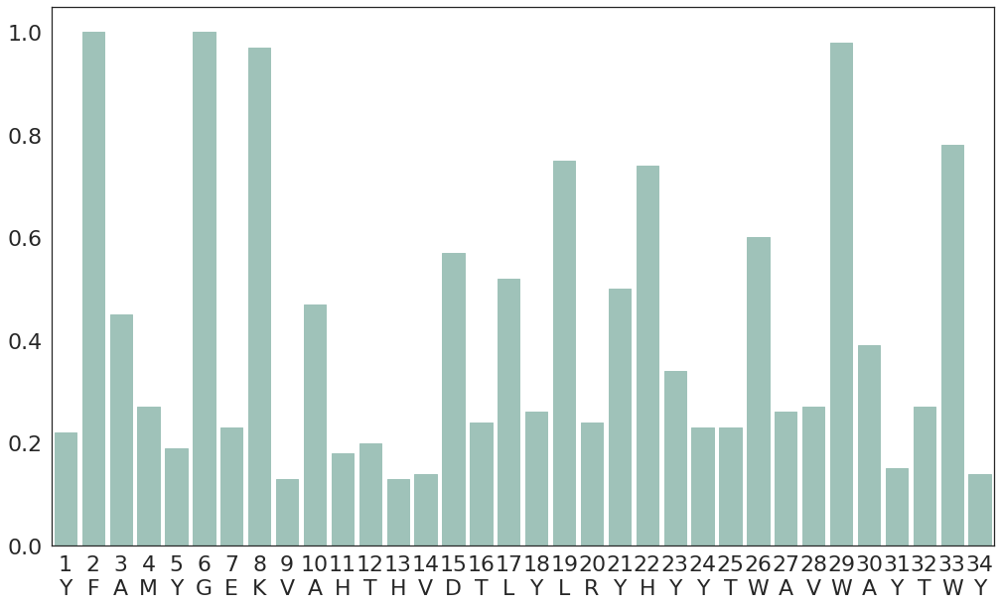

[0.22, 1.0, 0.45, 0.27, 0.19, 1.0, 0.23, 0.97, 0.13, 0.47, 0.18, 0.2, 0.13, 0.14, 0.57, 0.24, 0.52, 0.26, 0.75, 0.24, 0.5, 0.74, 0.34, 0.23, 0.23, 0.6, 0.26, 0.27, 0.98, 0.39, 0.15, 0.27, 0.78, 0.14]

---------------------
#Peptides: 18499
HLA: HLA-B*40:01
Threshold: 0.6
YHTKYREISTNTYESNLYLRYNYYSLAVLAYEWY
threshold: 0.6


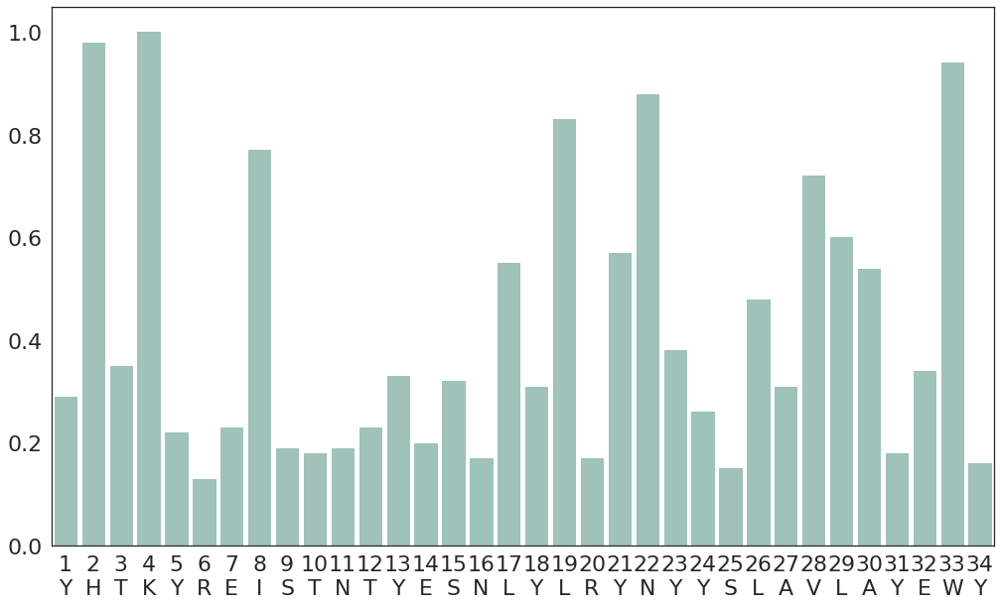

[0.29, 0.98, 0.35, 1.0, 0.22, 0.13, 0.23, 0.77, 0.19, 0.18, 0.19, 0.23, 0.33, 0.2, 0.32, 0.17, 0.55, 0.31, 0.83, 0.17, 0.57, 0.88, 0.38, 0.26, 0.15, 0.48, 0.31, 0.72, 0.6, 0.54, 0.18, 0.34, 0.94, 0.16]

---------------------
#Peptides: 1373
HLA: HLA-B*15:03
Threshold: 0.6
YYSEYREISTNTYESNLYLRYDSYTWAELAYLWY
threshold: 0.6


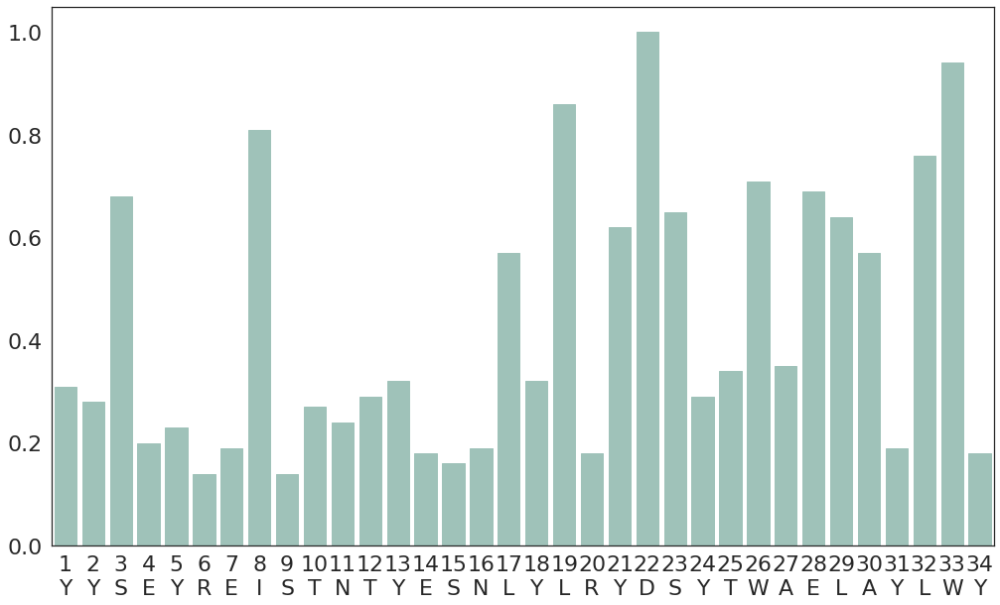

[0.31, 0.28, 0.68, 0.2, 0.23, 0.14, 0.19, 0.81, 0.14, 0.27, 0.24, 0.29, 0.32, 0.18, 0.16, 0.19, 0.57, 0.32, 0.86, 0.18, 0.62, 1.0, 0.65, 0.29, 0.34, 0.71, 0.35, 0.69, 0.64, 0.57, 0.19, 0.76, 0.94, 0.18]

---------------------
#Peptides: 790
HLA: HLA-A*26:02
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQNYTWAEWAYRWY
threshold: 0.6


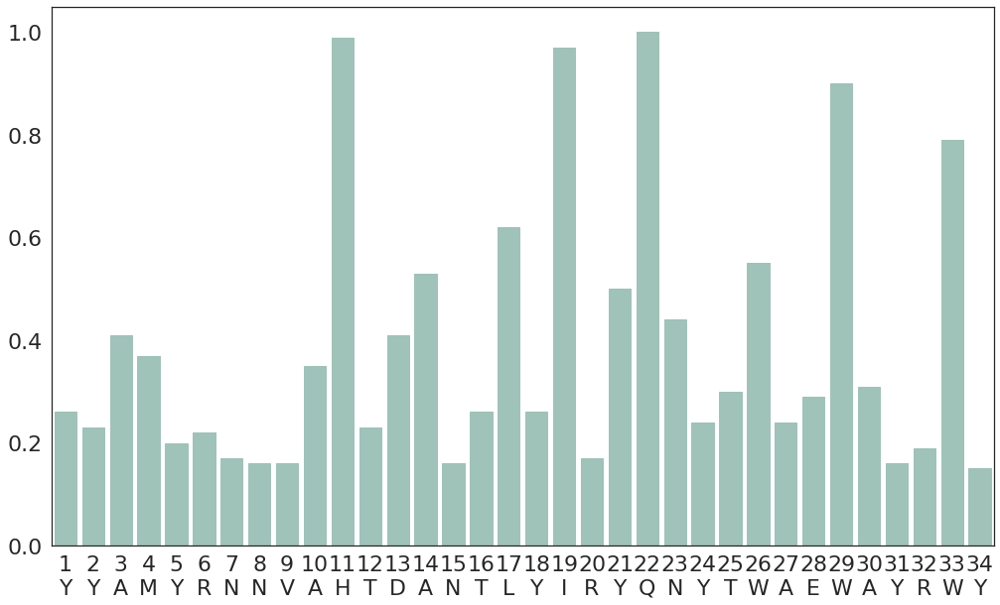

[0.26, 0.23, 0.41, 0.37, 0.2, 0.22, 0.17, 0.16, 0.16, 0.35, 0.99, 0.23, 0.41, 0.53, 0.16, 0.26, 0.62, 0.26, 0.97, 0.17, 0.5, 1.0, 0.44, 0.24, 0.3, 0.55, 0.24, 0.29, 0.9, 0.31, 0.16, 0.19, 0.79, 0.15]

---------------------
#Peptides: 12278
HLA: HLA-B*27:01
Threshold: 0.6
YHTEYREICAKTYENTAYLNYHDYTWAVLAYEWY
threshold: 0.6


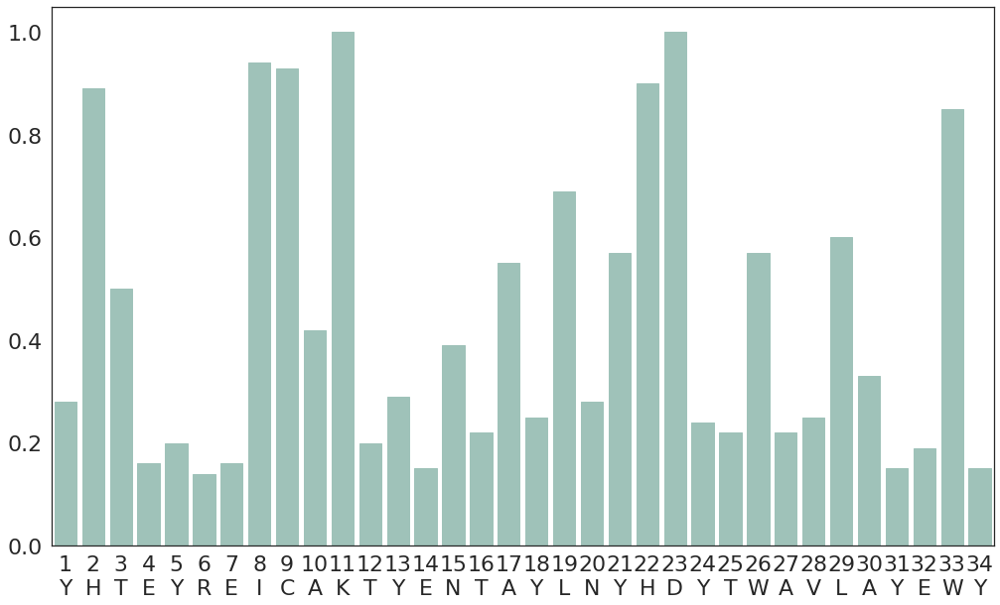

[0.28, 0.89, 0.5, 0.16, 0.2, 0.14, 0.16, 0.94, 0.93, 0.42, 1.0, 0.2, 0.29, 0.15, 0.39, 0.22, 0.55, 0.25, 0.69, 0.28, 0.57, 0.9, 1.0, 0.24, 0.22, 0.57, 0.22, 0.25, 0.6, 0.33, 0.15, 0.19, 0.85, 0.15]

---------------------
#Peptides: 298
HLA: HLA-A*02:50
Threshold: 0.6
YFAMYGEKVAHTHVDTLYIRYHYYTWAVWAYTWY
threshold: 0.6


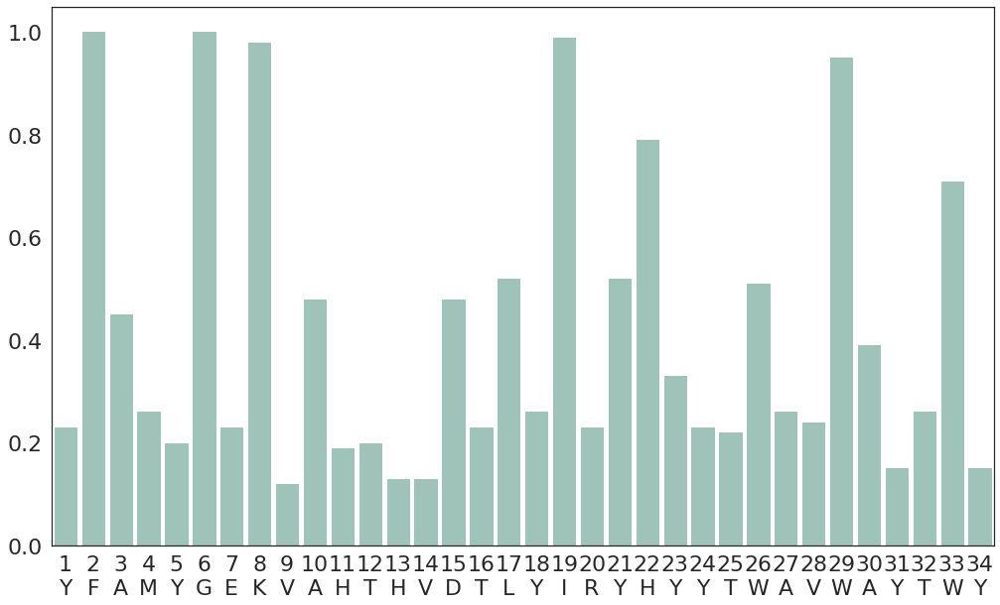

[0.23, 1.0, 0.45, 0.26, 0.2, 1.0, 0.23, 0.98, 0.12, 0.48, 0.19, 0.2, 0.13, 0.13, 0.48, 0.23, 0.52, 0.26, 0.99, 0.23, 0.52, 0.79, 0.33, 0.23, 0.22, 0.51, 0.26, 0.24, 0.95, 0.39, 0.15, 0.26, 0.71, 0.15]

---------------------
#Peptides: 18626
HLA: HLA-B*27:09
Threshold: 0.59
YHTEYREICAKTDEDTLYLNYHHYTWAVLAYEWY
threshold: 0.59


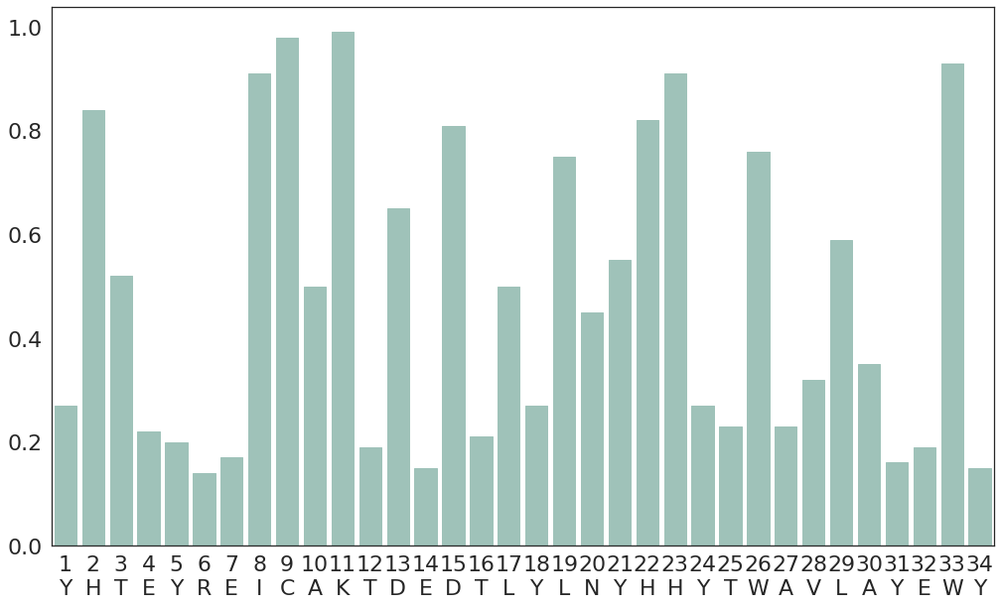

[0.27, 0.84, 0.52, 0.22, 0.2, 0.14, 0.17, 0.91, 0.98, 0.5, 0.99, 0.19, 0.65, 0.15, 0.81, 0.21, 0.5, 0.27, 0.75, 0.45, 0.55, 0.82, 0.91, 0.27, 0.23, 0.76, 0.23, 0.32, 0.59, 0.35, 0.16, 0.19, 0.93, 0.15]

---------------------
#Peptides: 16673
HLA: HLA-A*02:03
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAEWAYTWY
threshold: 0.6


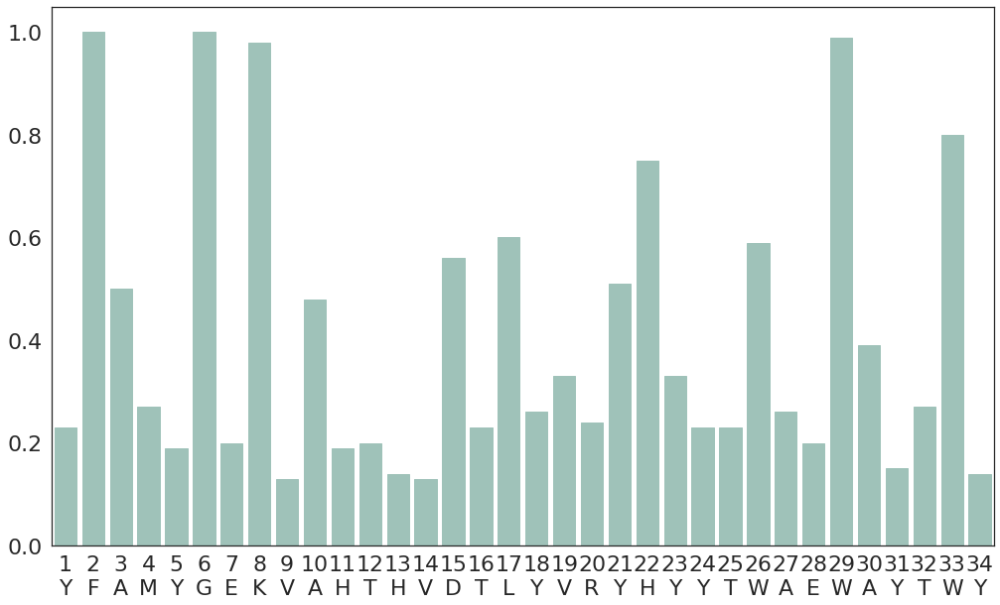

[0.23, 1.0, 0.5, 0.27, 0.19, 1.0, 0.2, 0.98, 0.13, 0.48, 0.19, 0.2, 0.14, 0.13, 0.56, 0.23, 0.6, 0.26, 0.33, 0.24, 0.51, 0.75, 0.33, 0.23, 0.23, 0.59, 0.26, 0.2, 0.99, 0.39, 0.15, 0.27, 0.8, 0.14]

---------------------
#Peptides: 395
HLA: HLA-B*48:01
Threshold: 0.59
YYSEYREISTNTYESNLYLSYNYYSLAVLAYEWY
threshold: 0.59


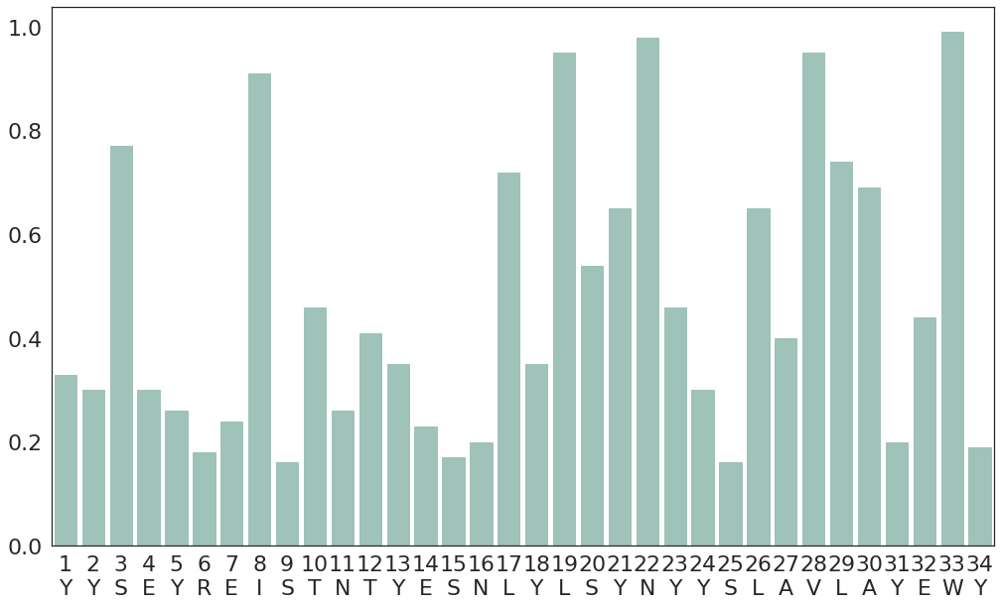

[0.33, 0.3, 0.77, 0.3, 0.26, 0.18, 0.24, 0.91, 0.16, 0.46, 0.26, 0.41, 0.35, 0.23, 0.17, 0.2, 0.72, 0.35, 0.95, 0.54, 0.65, 0.98, 0.46, 0.3, 0.16, 0.65, 0.4, 0.95, 0.74, 0.69, 0.2, 0.44, 0.99, 0.19]

---------------------
#Peptides: 277
HLA: HLA-A*26:03
Threshold: 0.6
YYAMYRNNVAHTHVDTLYIRYQDYTWAEWAYRWY
threshold: 0.6


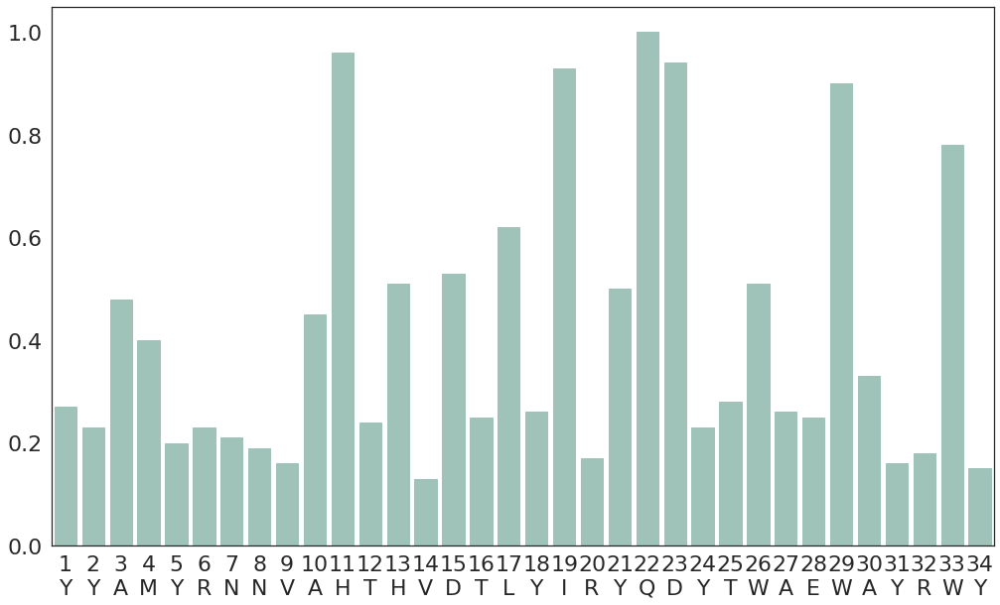

[0.27, 0.23, 0.48, 0.4, 0.2, 0.23, 0.21, 0.19, 0.16, 0.45, 0.96, 0.24, 0.51, 0.13, 0.53, 0.25, 0.62, 0.26, 0.93, 0.17, 0.5, 1.0, 0.94, 0.23, 0.28, 0.51, 0.26, 0.25, 0.9, 0.33, 0.16, 0.18, 0.78, 0.15]

---------------------
#Peptides: 244
HLA: HLA-A*32:15
Threshold: 0.6
YFAMYRNNVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


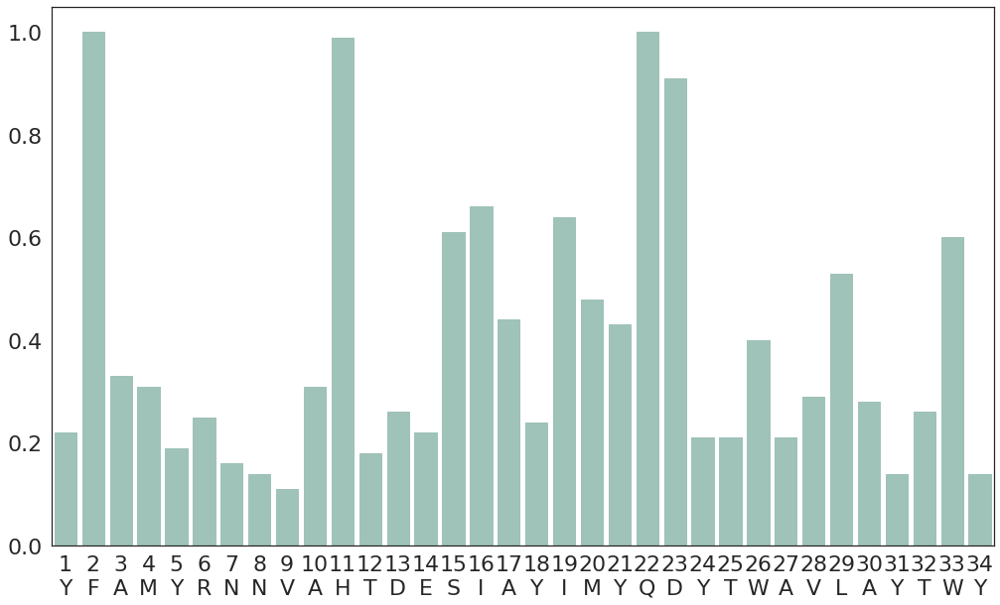

[0.22, 1.0, 0.33, 0.31, 0.19, 0.25, 0.16, 0.14, 0.11, 0.31, 0.99, 0.18, 0.26, 0.22, 0.61, 0.66, 0.44, 0.24, 0.64, 0.48, 0.43, 1.0, 0.91, 0.21, 0.21, 0.4, 0.21, 0.29, 0.53, 0.28, 0.14, 0.26, 0.6, 0.14]

---------------------
#Peptides: 6785
HLA: HLA-C*12:03
Threshold: 0.6
YYAGYREKYRQADVSNLYLWYDSYTWAEWAYTWY
threshold: 0.6


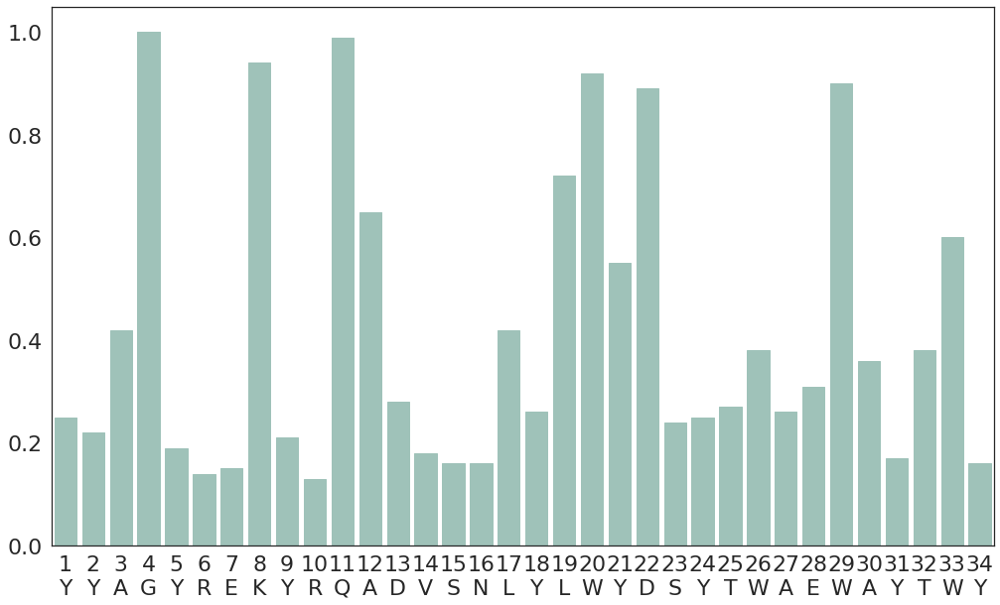

[0.25, 0.22, 0.42, 1.0, 0.19, 0.14, 0.15, 0.94, 0.21, 0.13, 0.99, 0.65, 0.28, 0.18, 0.16, 0.16, 0.42, 0.26, 0.72, 0.92, 0.55, 0.89, 0.24, 0.25, 0.27, 0.38, 0.26, 0.31, 0.9, 0.36, 0.17, 0.38, 0.6, 0.16]

---------------------
#Peptides: 16662
HLA: HLA-B*39:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLRYNFYTWAVLTYTWY
threshold: 0.6


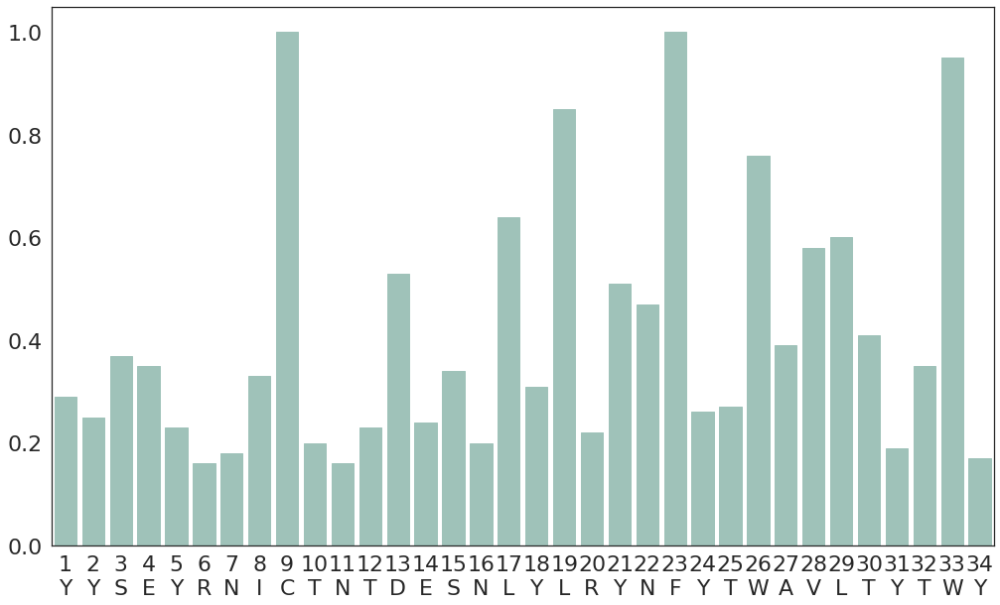

[0.29, 0.25, 0.37, 0.35, 0.23, 0.16, 0.18, 0.33, 1.0, 0.2, 0.16, 0.23, 0.53, 0.24, 0.34, 0.2, 0.64, 0.31, 0.85, 0.22, 0.51, 0.47, 1.0, 0.26, 0.27, 0.76, 0.39, 0.58, 0.6, 0.41, 0.19, 0.35, 0.95, 0.17]

---------------------
#Peptides: 57773
HLA: HLA-B*15:01
Threshold: 0.6
YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY
threshold: 0.6


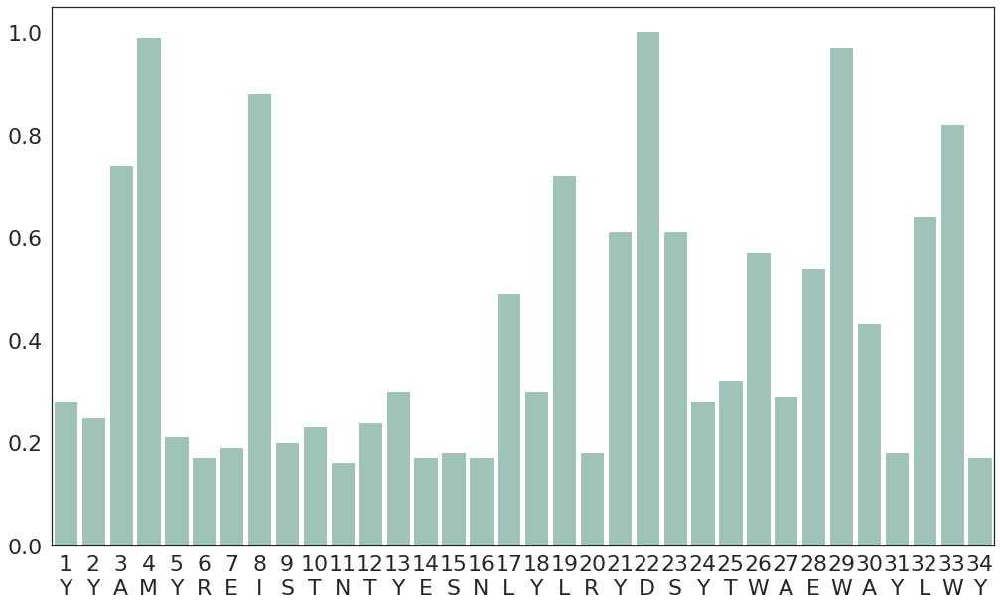

[0.28, 0.25, 0.74, 0.99, 0.21, 0.17, 0.19, 0.88, 0.2, 0.23, 0.16, 0.24, 0.3, 0.17, 0.18, 0.17, 0.49, 0.3, 0.72, 0.18, 0.61, 1.0, 0.61, 0.28, 0.32, 0.57, 0.29, 0.54, 0.97, 0.43, 0.18, 0.64, 0.82, 0.17]

---------------------
#Peptides: 3963
HLA: HLA-B*27:06
Threshold: 0.6
YHTEYREICAKTDESTLYLNYDYYTWAELAYEWY
threshold: 0.6


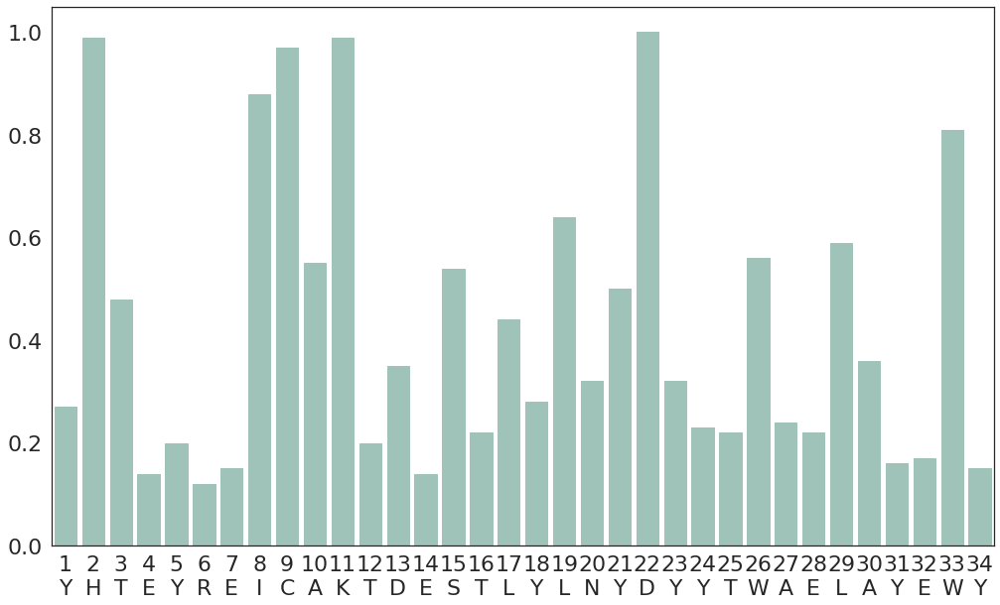

[0.27, 0.99, 0.48, 0.14, 0.2, 0.12, 0.15, 0.88, 0.97, 0.55, 0.99, 0.2, 0.35, 0.14, 0.54, 0.22, 0.44, 0.28, 0.64, 0.32, 0.5, 1.0, 0.32, 0.23, 0.22, 0.56, 0.24, 0.22, 0.59, 0.36, 0.16, 0.17, 0.81, 0.15]

---------------------
#Peptides: 15143
HLA: HLA-B*37:01
Threshold: 0.6
YHSTYREISTNTYEDTLYIRSNFYTWAVDAYTWY
threshold: 0.6


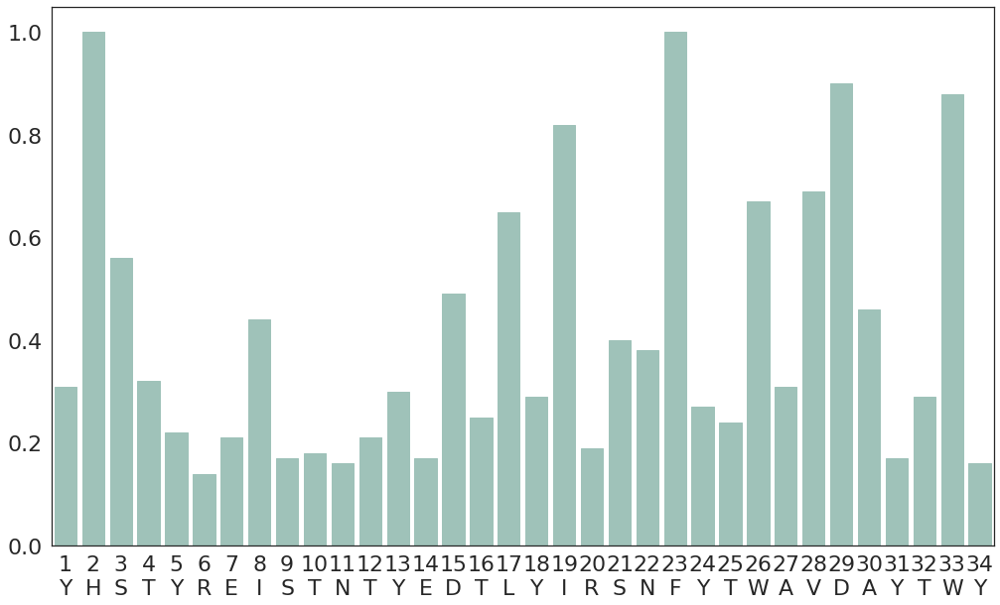

[0.31, 1.0, 0.56, 0.32, 0.22, 0.14, 0.21, 0.44, 0.17, 0.18, 0.16, 0.21, 0.3, 0.17, 0.49, 0.25, 0.65, 0.29, 0.82, 0.19, 0.4, 0.38, 1.0, 0.27, 0.24, 0.67, 0.31, 0.69, 0.9, 0.46, 0.17, 0.29, 0.88, 0.16]

---------------------
#Peptides: 36063
HLA: HLA-B*35:01
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVLAYLWY
threshold: 0.6


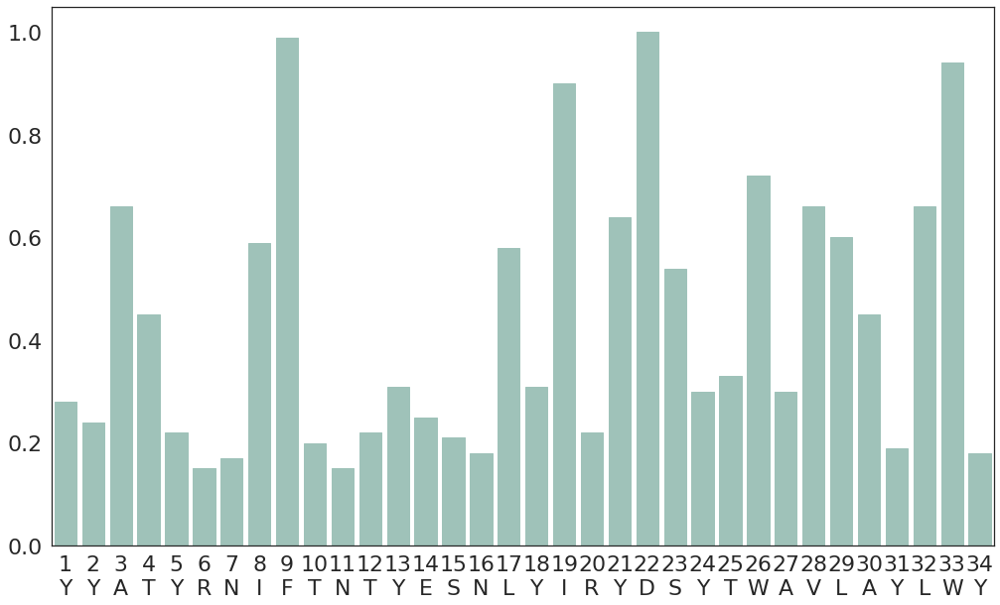

[0.28, 0.24, 0.66, 0.45, 0.22, 0.15, 0.17, 0.59, 0.99, 0.2, 0.15, 0.22, 0.31, 0.25, 0.21, 0.18, 0.58, 0.31, 0.9, 0.22, 0.64, 1.0, 0.54, 0.3, 0.33, 0.72, 0.3, 0.66, 0.6, 0.45, 0.19, 0.66, 0.94, 0.18]

---------------------
#Peptides: 9226
HLA: HLA-A*02:05
Threshold: 0.6
YYAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY
threshold: 0.6


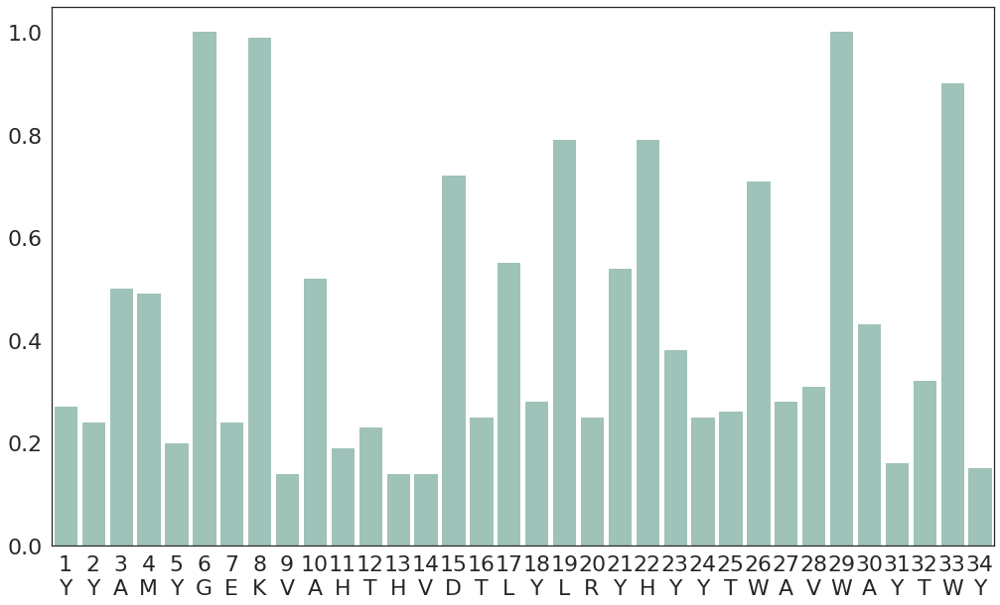

[0.27, 0.24, 0.5, 0.49, 0.2, 1.0, 0.24, 0.99, 0.14, 0.52, 0.19, 0.23, 0.14, 0.14, 0.72, 0.25, 0.55, 0.28, 0.79, 0.25, 0.54, 0.79, 0.38, 0.25, 0.26, 0.71, 0.28, 0.31, 1.0, 0.43, 0.16, 0.32, 0.9, 0.15]

---------------------
#Peptides: 10955
HLA: HLA-A*02:07
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRCHYYTWAVLAYTWY
threshold: 0.6


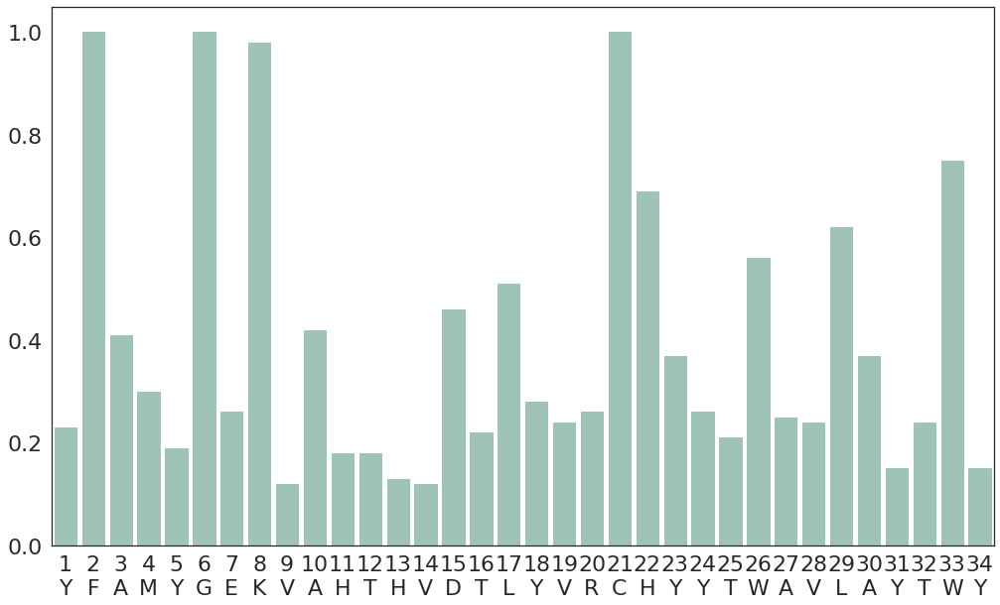

[0.23, 1.0, 0.41, 0.3, 0.19, 1.0, 0.26, 0.98, 0.12, 0.42, 0.18, 0.18, 0.13, 0.12, 0.46, 0.22, 0.51, 0.28, 0.24, 0.26, 1.0, 0.69, 0.37, 0.26, 0.21, 0.56, 0.25, 0.24, 0.62, 0.37, 0.15, 0.24, 0.75, 0.15]

---------------------
#Peptides: 1726
HLA: HLA-B*52:01
Threshold: 0.6
YYATYREISTNTYENIAYWTYNYYTWAELAYLWH
threshold: 0.6


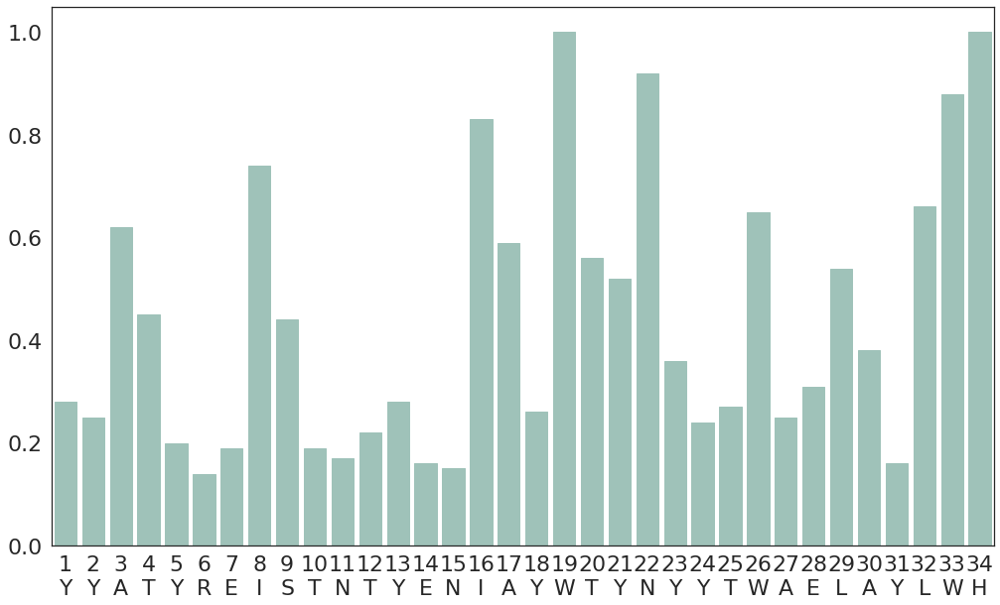

[0.28, 0.25, 0.62, 0.45, 0.2, 0.14, 0.19, 0.74, 0.44, 0.19, 0.17, 0.22, 0.28, 0.16, 0.15, 0.83, 0.59, 0.26, 1.0, 0.56, 0.52, 0.92, 0.36, 0.24, 0.27, 0.65, 0.25, 0.31, 0.54, 0.38, 0.16, 0.66, 0.88, 1.0]

---------------------
#Peptides: 891
HLA: HLA-B*18:03
Threshold: 0.6
YHSTYRNISTNTDESNLYLRYDSYTWAVLAYTWH
threshold: 0.6


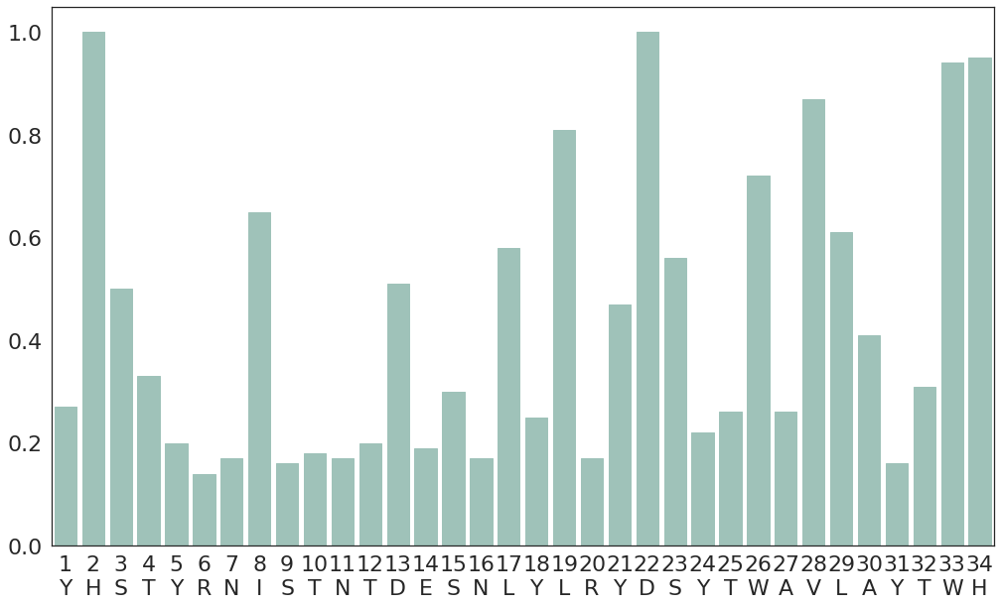

[0.27, 1.0, 0.5, 0.33, 0.2, 0.14, 0.17, 0.65, 0.16, 0.18, 0.17, 0.2, 0.51, 0.19, 0.3, 0.17, 0.58, 0.25, 0.81, 0.17, 0.47, 1.0, 0.56, 0.22, 0.26, 0.72, 0.26, 0.87, 0.61, 0.41, 0.16, 0.31, 0.94, 0.95]

---------------------
#Peptides: 18564
HLA: HLA-B*58:01
Threshold: 0.6
YYATYGENMASTYENIAYIRYDSYTWAVLAYLWY
threshold: 0.6


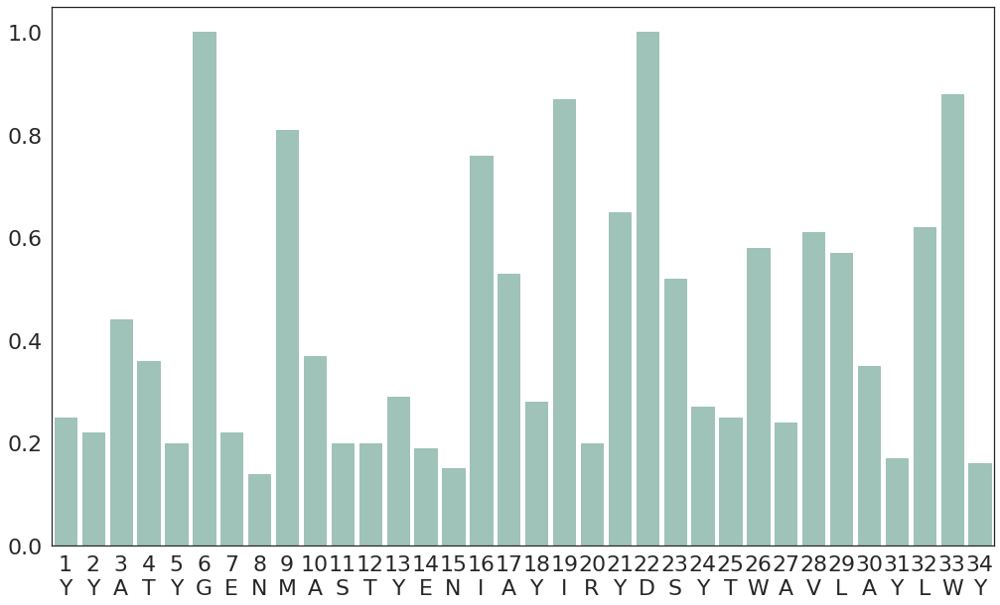

[0.25, 0.22, 0.44, 0.36, 0.2, 1.0, 0.22, 0.14, 0.81, 0.37, 0.2, 0.2, 0.29, 0.19, 0.15, 0.76, 0.53, 0.28, 0.87, 0.2, 0.65, 1.0, 0.52, 0.27, 0.25, 0.58, 0.24, 0.61, 0.57, 0.35, 0.17, 0.62, 0.88, 0.16]

---------------------
#Peptides: 1651
HLA: HLA-B*15:17
Threshold: 0.6
YYAMYRENMASTYENIAYLRYHDYTWAELAYLWY
threshold: 0.6


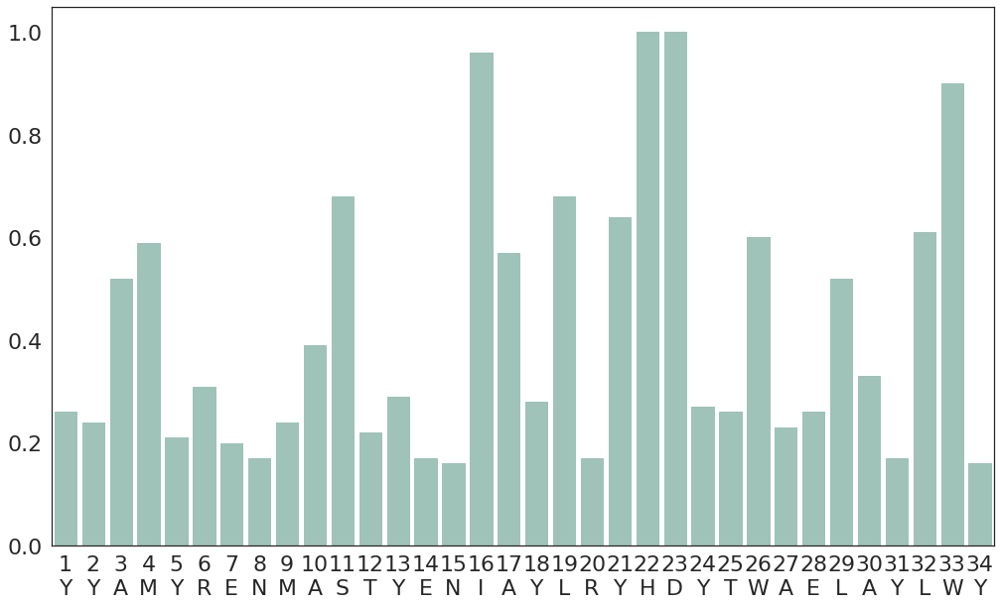

[0.26, 0.24, 0.52, 0.59, 0.21, 0.31, 0.2, 0.17, 0.24, 0.39, 0.68, 0.22, 0.29, 0.17, 0.16, 0.96, 0.57, 0.28, 0.68, 0.17, 0.64, 1.0, 1.0, 0.27, 0.26, 0.6, 0.23, 0.26, 0.52, 0.33, 0.17, 0.61, 0.9, 0.16]

---------------------
#Peptides: 832
HLA: HLA-A*02:19
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTGY
threshold: 0.6


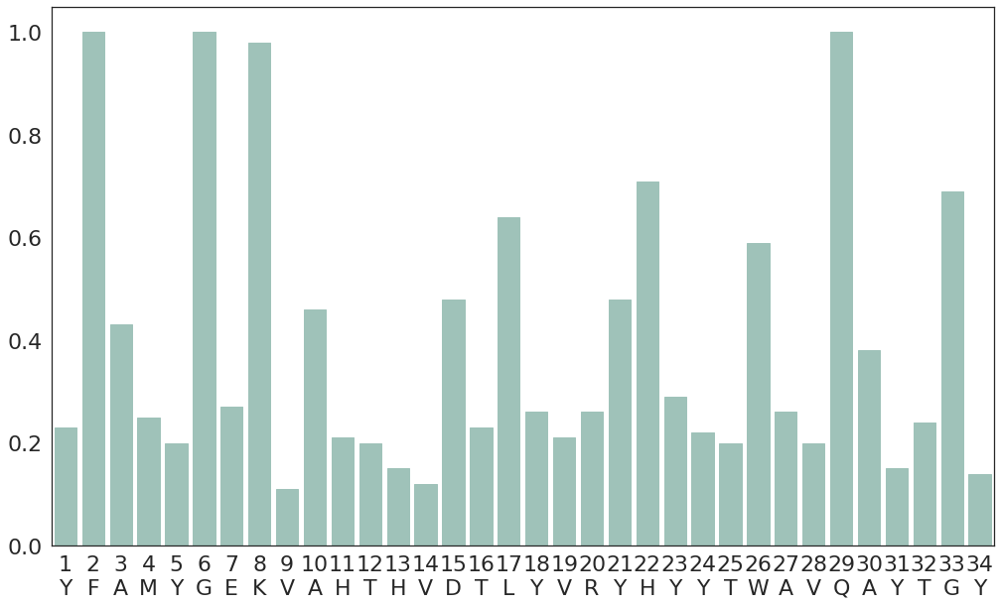

[0.23, 1.0, 0.43, 0.25, 0.2, 1.0, 0.27, 0.98, 0.11, 0.46, 0.21, 0.2, 0.15, 0.12, 0.48, 0.23, 0.64, 0.26, 0.21, 0.26, 0.48, 0.71, 0.29, 0.22, 0.2, 0.59, 0.26, 0.2, 1.0, 0.38, 0.15, 0.24, 0.69, 0.14]

---------------------
#Peptides: 44500
HLA: HLA-A*03:01
Threshold: 0.6
YFAMYQENVAQTDVDTLYIIYRDYTWAELAYTWY
threshold: 0.6


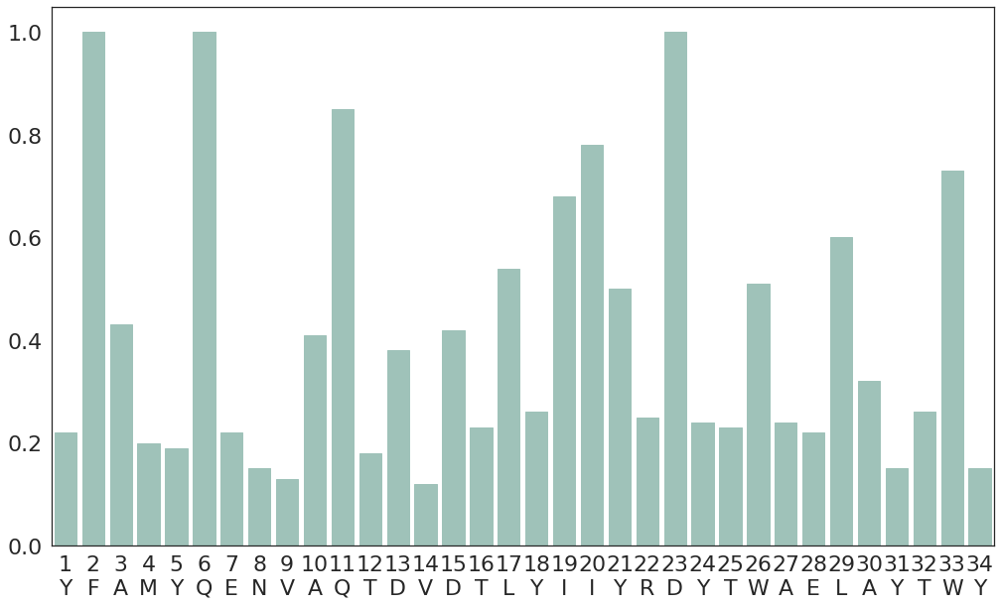

[0.22, 1.0, 0.43, 0.2, 0.19, 1.0, 0.22, 0.15, 0.13, 0.41, 0.85, 0.18, 0.38, 0.12, 0.42, 0.23, 0.54, 0.26, 0.68, 0.78, 0.5, 0.25, 1.0, 0.24, 0.23, 0.51, 0.24, 0.22, 0.6, 0.32, 0.15, 0.26, 0.73, 0.15]

---------------------
#Peptides: 638
HLA: HLA-A*02:16
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYEWY
threshold: 0.6


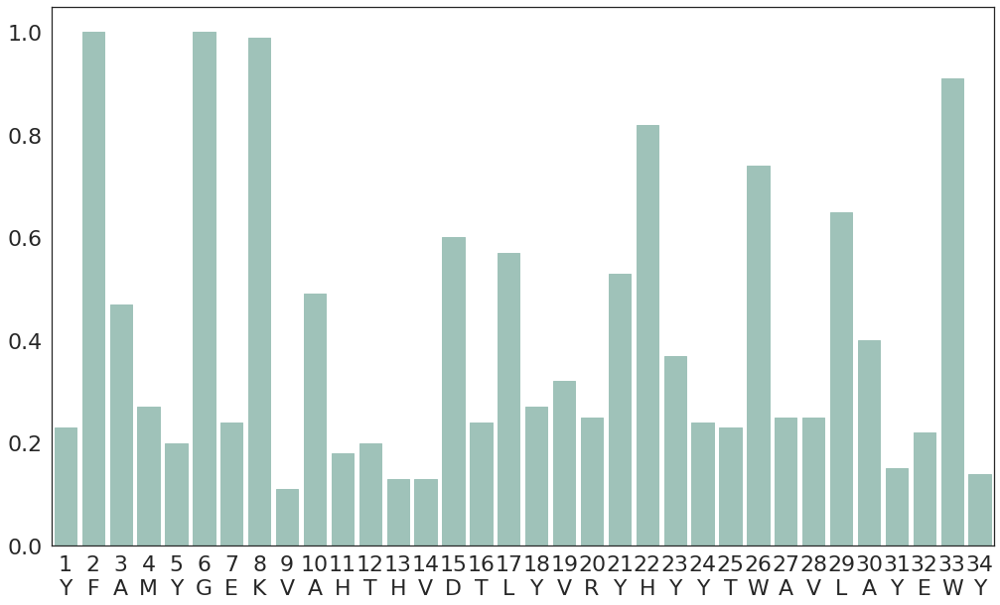

[0.23, 1.0, 0.47, 0.27, 0.2, 1.0, 0.24, 0.99, 0.11, 0.49, 0.18, 0.2, 0.13, 0.13, 0.6, 0.24, 0.57, 0.27, 0.32, 0.25, 0.53, 0.82, 0.37, 0.24, 0.23, 0.74, 0.25, 0.25, 0.65, 0.4, 0.15, 0.22, 0.91, 0.14]

---------------------
#Peptides: 496
HLA: HLA-A*24:13
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY
threshold: 0.6


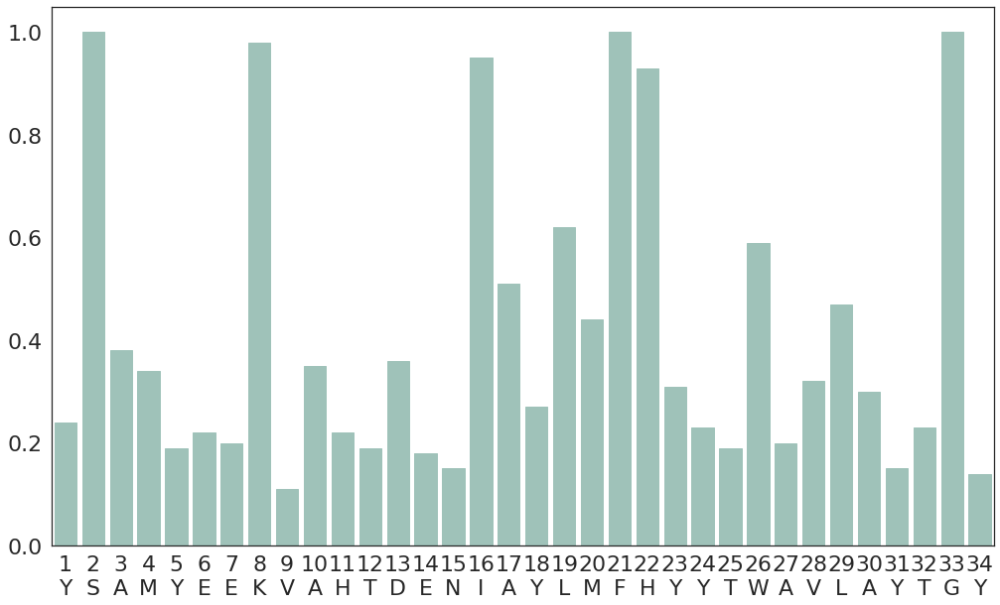

[0.24, 1.0, 0.38, 0.34, 0.19, 0.22, 0.2, 0.98, 0.11, 0.35, 0.22, 0.19, 0.36, 0.18, 0.15, 0.95, 0.51, 0.27, 0.62, 0.44, 1.0, 0.93, 0.31, 0.23, 0.19, 0.59, 0.2, 0.32, 0.47, 0.3, 0.15, 0.23, 1.0, 0.14]

---------------------
#Peptides: 4917
HLA: HLA-B*54:01
Threshold: 0.6
YYAGYRNIYAQTDESNLYWTYNLYTWAVLAYTWY
threshold: 0.6


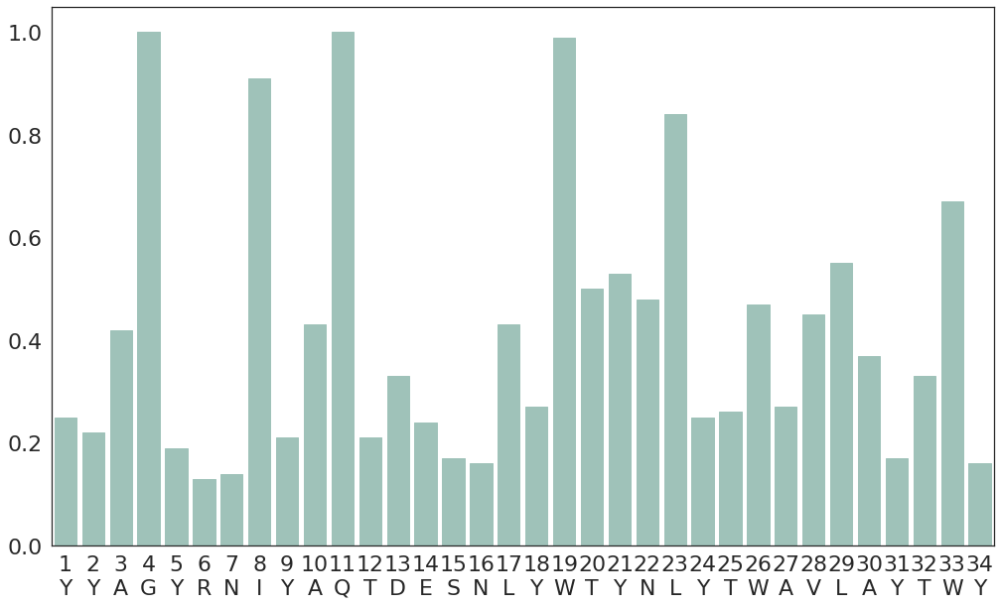

[0.25, 0.22, 0.42, 1.0, 0.19, 0.13, 0.14, 0.91, 0.21, 0.43, 1.0, 0.21, 0.33, 0.24, 0.17, 0.16, 0.43, 0.27, 0.99, 0.5, 0.53, 0.48, 0.84, 0.25, 0.26, 0.47, 0.27, 0.45, 0.55, 0.37, 0.17, 0.33, 0.67, 0.16]

---------------------
#Peptides: 4470
HLA: HLA-B*35:08
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVRAYLWY
threshold: 0.6


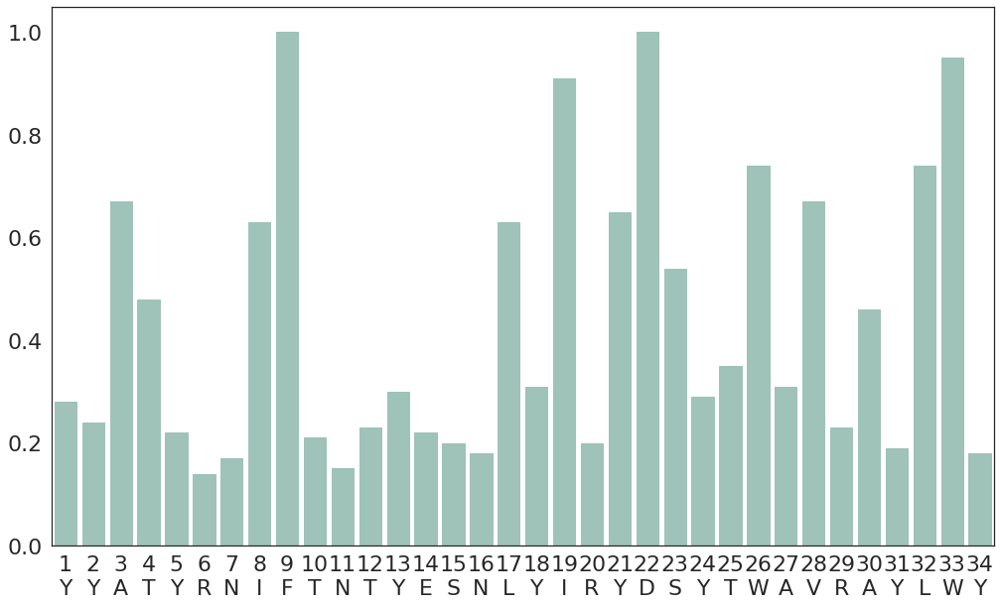

[0.28, 0.24, 0.67, 0.48, 0.22, 0.14, 0.17, 0.63, 1.0, 0.21, 0.15, 0.23, 0.3, 0.22, 0.2, 0.18, 0.63, 0.31, 0.91, 0.2, 0.65, 1.0, 0.54, 0.29, 0.35, 0.74, 0.31, 0.67, 0.23, 0.46, 0.19, 0.74, 0.95, 0.18]

---------------------
#Peptides: 16946
HLA: HLA-A*02:06
Threshold: 0.6
YYAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


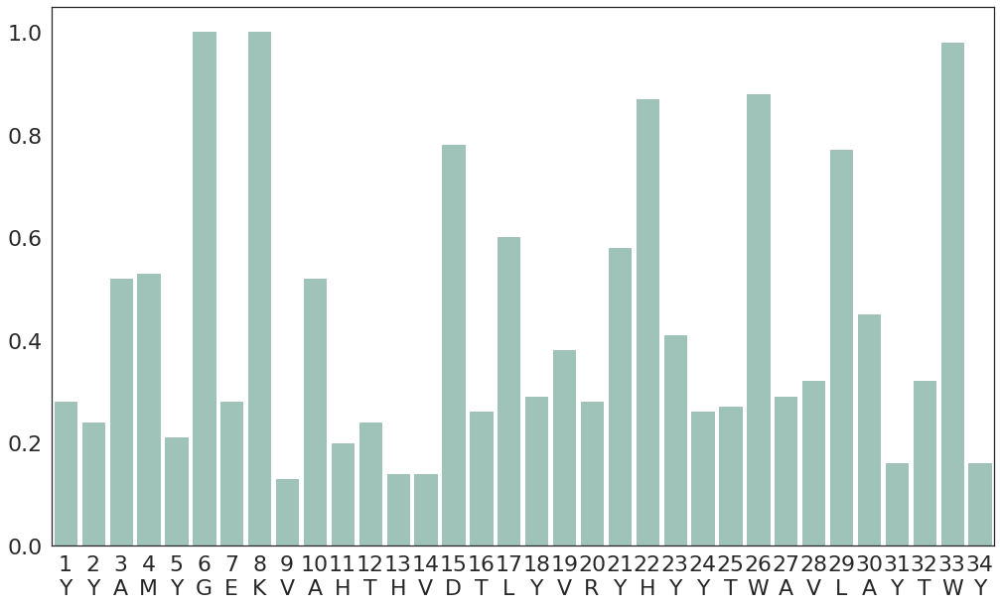

[0.28, 0.24, 0.52, 0.53, 0.21, 1.0, 0.28, 1.0, 0.13, 0.52, 0.2, 0.24, 0.14, 0.14, 0.78, 0.26, 0.6, 0.29, 0.38, 0.28, 0.58, 0.87, 0.41, 0.26, 0.27, 0.88, 0.29, 0.32, 0.77, 0.45, 0.16, 0.32, 0.98, 0.16]

---------------------
#Peptides: 12537
HLA: HLA-C*07:02
Threshold: 0.6
YDSGYREKYRQADVSNLYLRSDSYTLAALAYTWY
threshold: 0.6


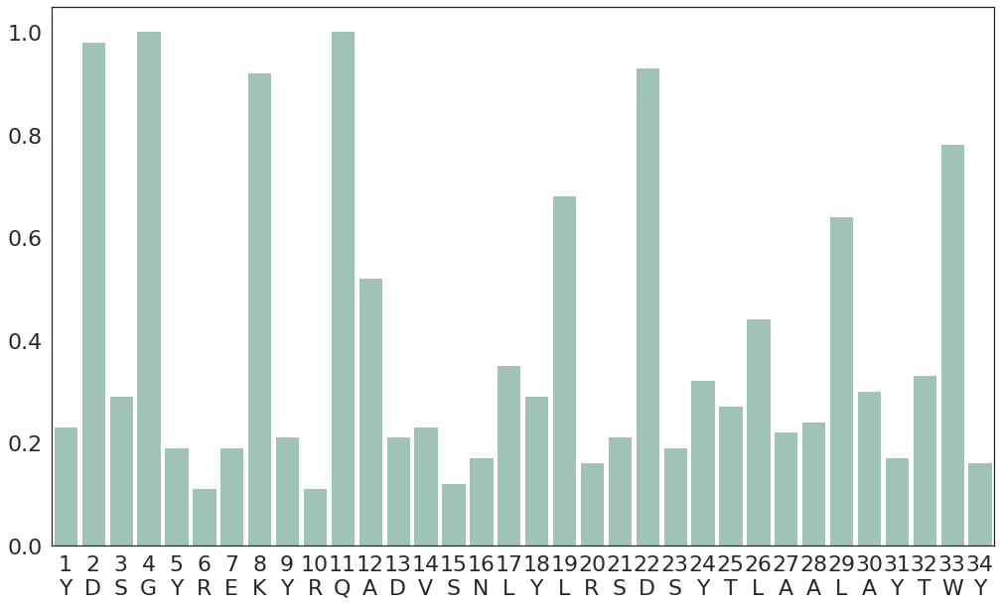

[0.23, 0.98, 0.29, 1.0, 0.19, 0.11, 0.19, 0.92, 0.21, 0.11, 1.0, 0.52, 0.21, 0.23, 0.12, 0.17, 0.35, 0.29, 0.68, 0.16, 0.21, 0.93, 0.19, 0.32, 0.27, 0.44, 0.22, 0.24, 0.64, 0.3, 0.17, 0.33, 0.78, 0.16]

---------------------
#Peptides: 38027
HLA: HLA-A*11:01
Threshold: 0.6
YYAMYQENVAQTDVDTLYIIYRDYTWAAQAYRWY
threshold: 0.6


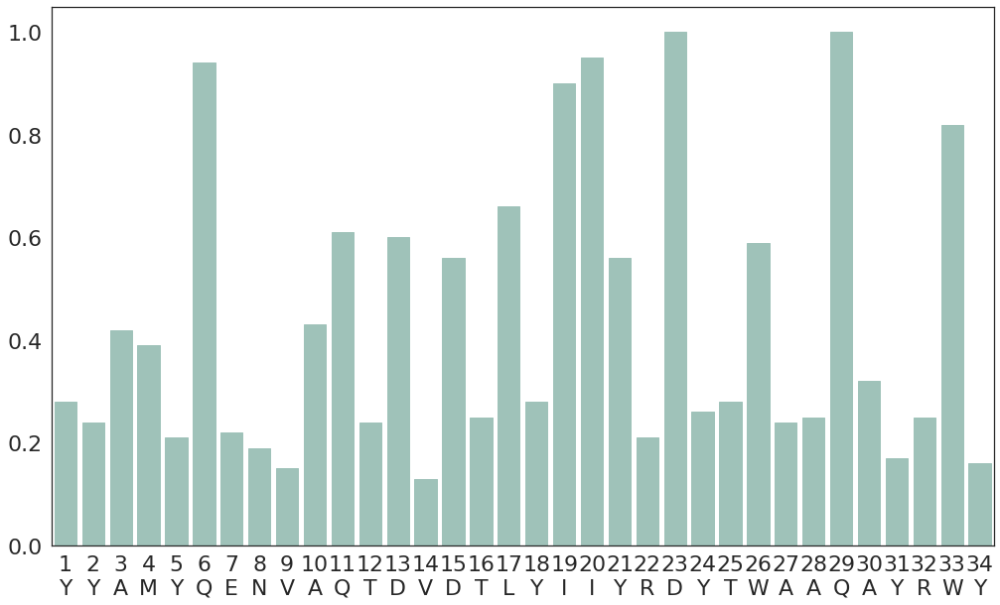

[0.28, 0.24, 0.42, 0.39, 0.21, 0.94, 0.22, 0.19, 0.15, 0.43, 0.61, 0.24, 0.6, 0.13, 0.56, 0.25, 0.66, 0.28, 0.9, 0.95, 0.56, 0.21, 1.0, 0.26, 0.28, 0.59, 0.24, 0.25, 1.0, 0.32, 0.17, 0.25, 0.82, 0.16]

---------------------
#Peptides: 596
HLA: HLA-A*80:01
Threshold: 0.6
YFAMYEENVAHTNANTLYIIYRDYTWARLAYEGY
threshold: 0.6


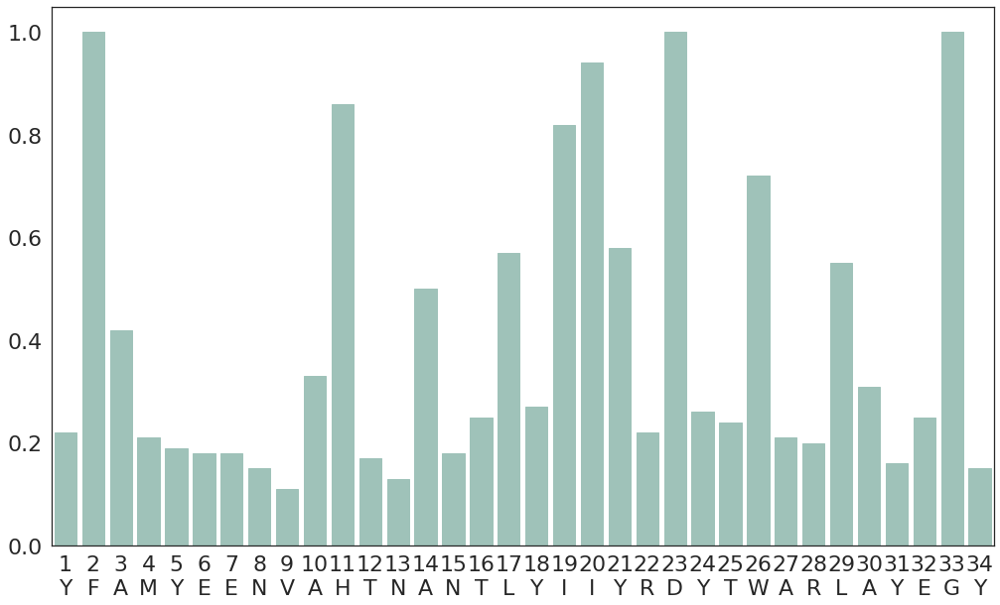

[0.22, 1.0, 0.42, 0.21, 0.19, 0.18, 0.18, 0.15, 0.11, 0.33, 0.86, 0.17, 0.13, 0.5, 0.18, 0.25, 0.57, 0.27, 0.82, 0.94, 0.58, 0.22, 1.0, 0.26, 0.24, 0.72, 0.21, 0.2, 0.55, 0.31, 0.16, 0.25, 1.0, 0.15]

---------------------
#Peptides: 9989
HLA: HLA-C*07:04
Threshold: 0.6
YDSGYREKYRQADVSNLYFRYDFYTLAADAYTWY
threshold: 0.6


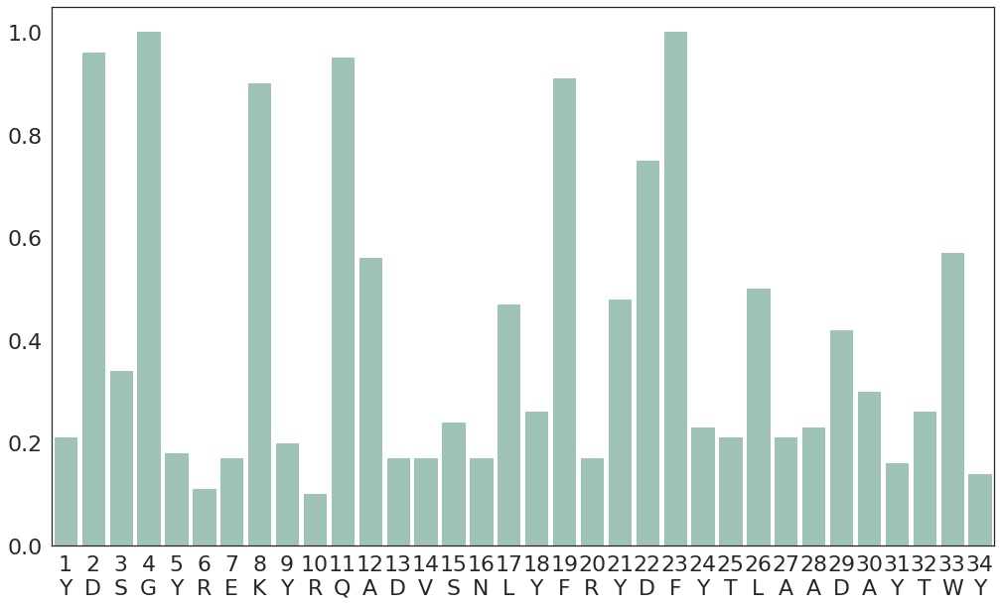

[0.21, 0.96, 0.34, 1.0, 0.18, 0.11, 0.17, 0.9, 0.2, 0.1, 0.95, 0.56, 0.17, 0.17, 0.24, 0.17, 0.47, 0.26, 0.91, 0.17, 0.48, 0.75, 1.0, 0.23, 0.21, 0.5, 0.21, 0.23, 0.42, 0.3, 0.16, 0.26, 0.57, 0.14]

---------------------
#Peptides: 1159
HLA: HLA-A*02:12
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTWY
threshold: 0.6


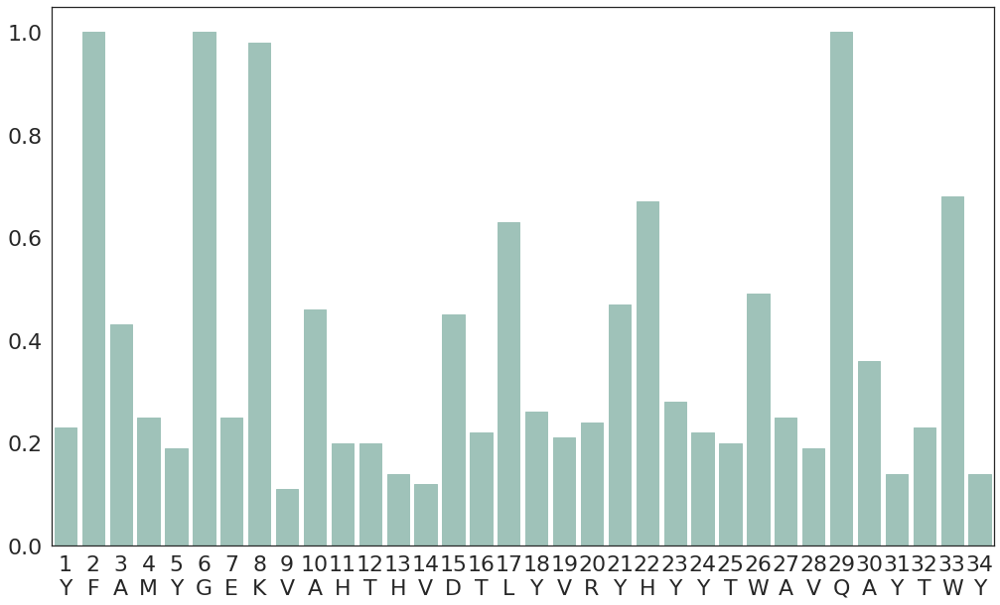

[0.23, 1.0, 0.43, 0.25, 0.19, 1.0, 0.25, 0.98, 0.11, 0.46, 0.2, 0.2, 0.14, 0.12, 0.45, 0.22, 0.63, 0.26, 0.21, 0.24, 0.47, 0.67, 0.28, 0.22, 0.2, 0.49, 0.25, 0.19, 1.0, 0.36, 0.14, 0.23, 0.68, 0.14]

---------------------
#Peptides: 35776
HLA: HLA-C*04:01
Threshold: 0.6
YSAGYREKYRQADVNKLYLRFNFYTWAERAYTWY
threshold: 0.6


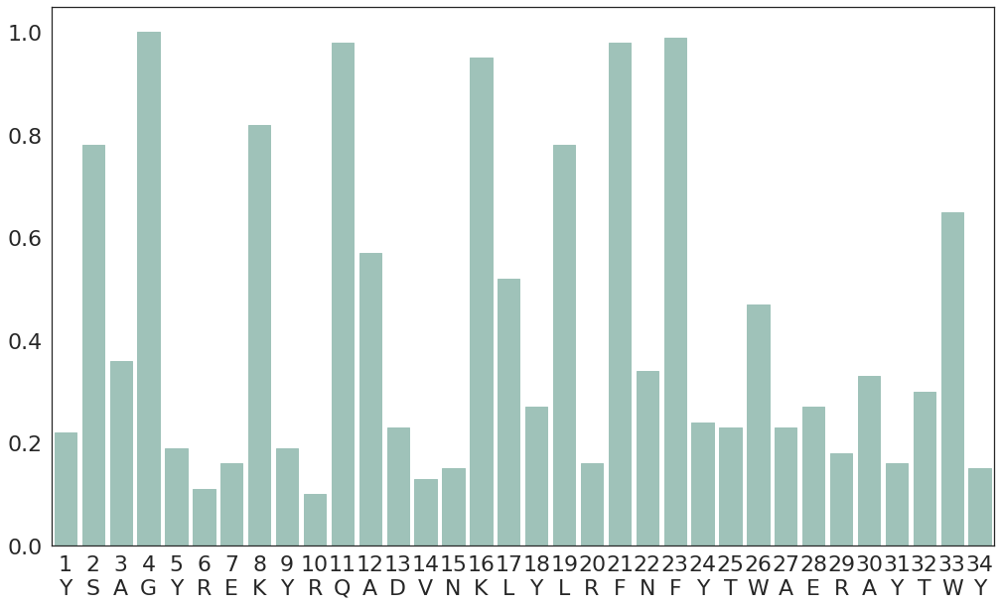

[0.22, 0.78, 0.36, 1.0, 0.19, 0.11, 0.16, 0.82, 0.19, 0.1, 0.98, 0.57, 0.23, 0.13, 0.15, 0.95, 0.52, 0.27, 0.78, 0.16, 0.98, 0.34, 0.99, 0.24, 0.23, 0.47, 0.23, 0.27, 0.18, 0.33, 0.16, 0.3, 0.65, 0.15]

---------------------
#Peptides: 1714
HLA: HLA-B*73:01
Threshold: 0.6
YHTEYRNICAKTDVGNLYWTYNFYTWAVLAYEWH
threshold: 0.6


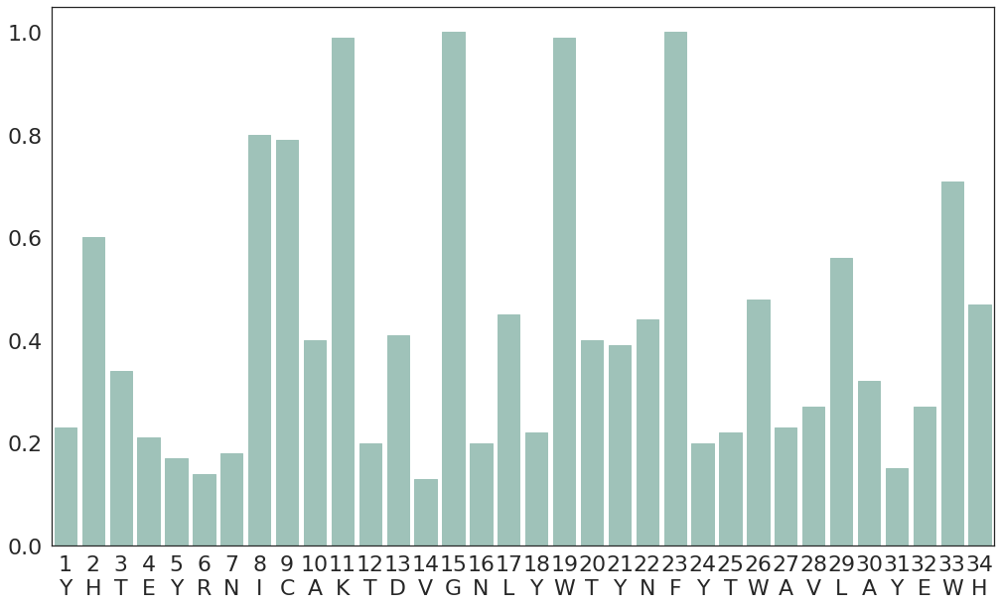

[0.23, 0.6, 0.34, 0.21, 0.17, 0.14, 0.18, 0.8, 0.79, 0.4, 0.99, 0.2, 0.41, 0.13, 1.0, 0.2, 0.45, 0.22, 0.99, 0.4, 0.39, 0.44, 1.0, 0.2, 0.22, 0.48, 0.23, 0.27, 0.56, 0.32, 0.15, 0.27, 0.71, 0.47]

---------------------
#Peptides: 307
HLA: HLA-B*27:20
Threshold: 0.6
YHTEYREICAKTDESTLYLNYNYYTWAELAYEWY
threshold: 0.6


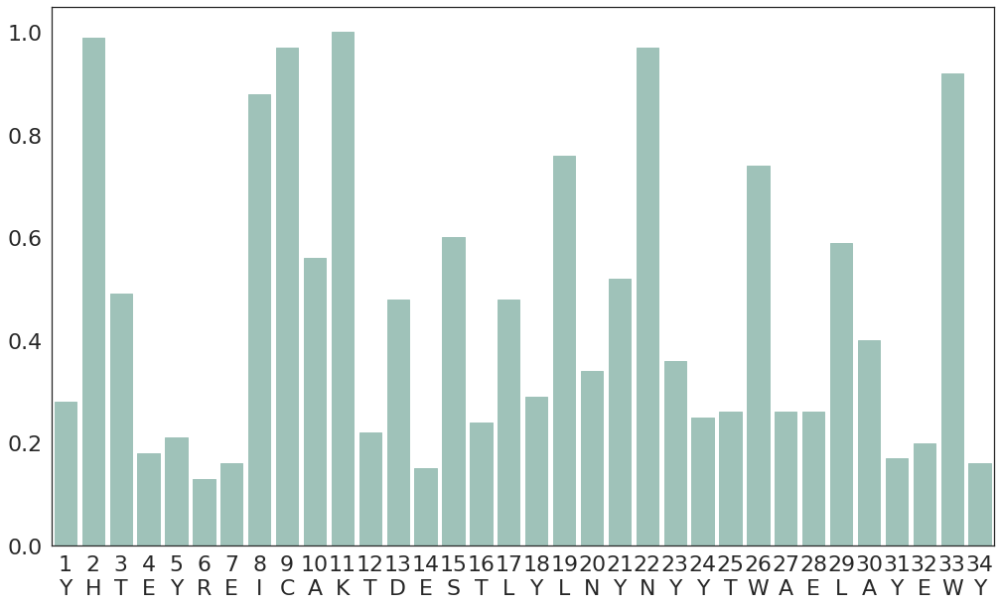

[0.28, 0.99, 0.49, 0.18, 0.21, 0.13, 0.16, 0.88, 0.97, 0.56, 1.0, 0.22, 0.48, 0.15, 0.6, 0.24, 0.48, 0.29, 0.76, 0.34, 0.52, 0.97, 0.36, 0.25, 0.26, 0.74, 0.26, 0.26, 0.59, 0.4, 0.17, 0.2, 0.92, 0.16]

---------------------
#Peptides: 886
HLA: HLA-B*15:02
Threshold: 0.6
YYAMYRNISTNTYESNLYIRYDSYTWAELAYLWY
threshold: 0.6


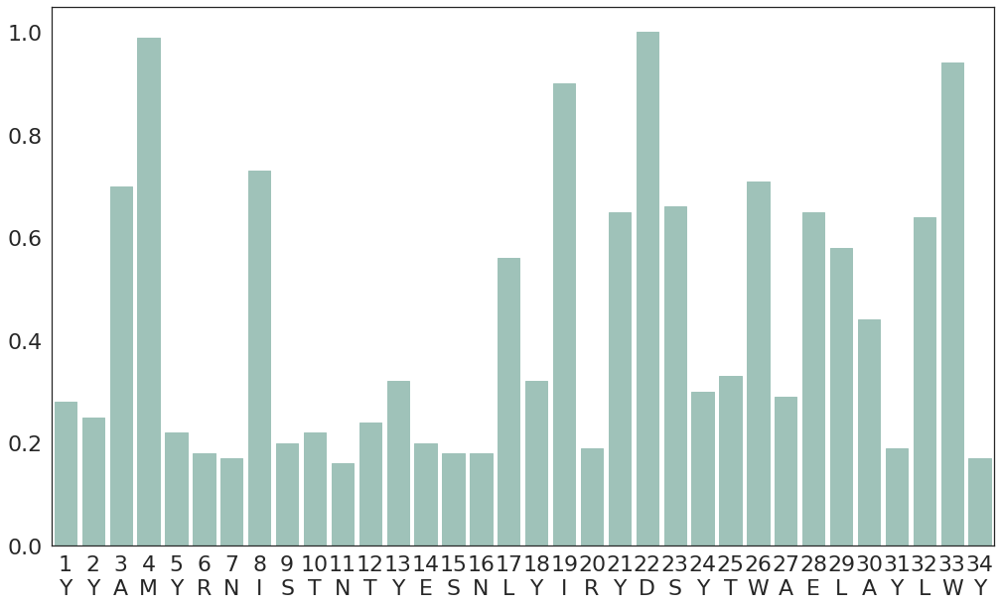

[0.28, 0.25, 0.7, 0.99, 0.22, 0.18, 0.17, 0.73, 0.2, 0.22, 0.16, 0.24, 0.32, 0.2, 0.18, 0.18, 0.56, 0.32, 0.9, 0.19, 0.65, 1.0, 0.66, 0.3, 0.33, 0.71, 0.29, 0.65, 0.58, 0.44, 0.19, 0.64, 0.94, 0.17]

---------------------
#Peptides: 50152
HLA: HLA-B*57:01
Threshold: 0.6
YYAMYGENMASTYENIAYIVYDSYTWAVLAYLWY
threshold: 0.6


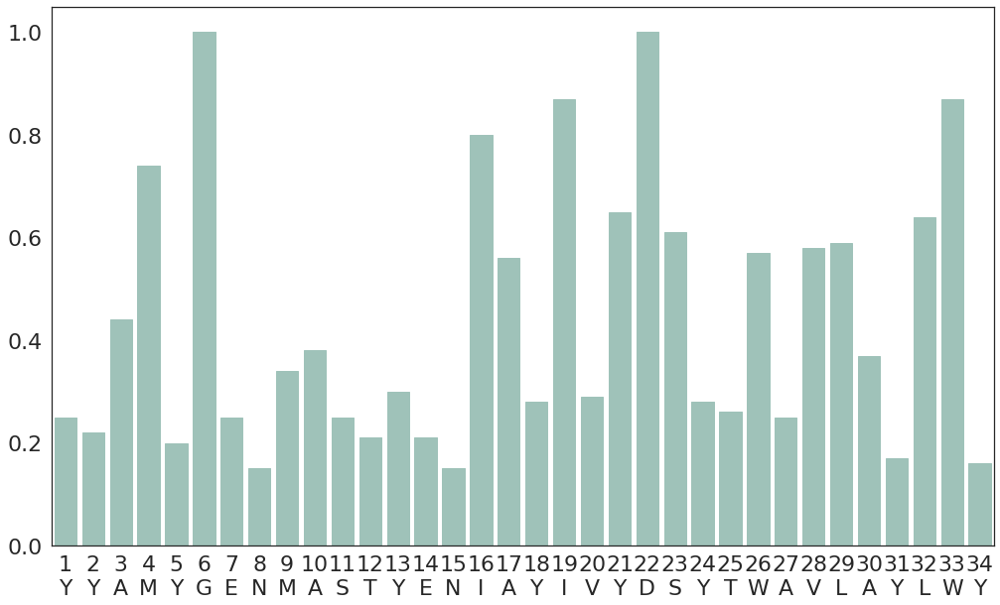

[0.25, 0.22, 0.44, 0.74, 0.2, 1.0, 0.25, 0.15, 0.34, 0.38, 0.25, 0.21, 0.3, 0.21, 0.15, 0.8, 0.56, 0.28, 0.87, 0.29, 0.65, 1.0, 0.61, 0.28, 0.26, 0.57, 0.25, 0.58, 0.59, 0.37, 0.17, 0.64, 0.87, 0.16]

---------------------
#Peptides: 21551
HLA: HLA-C*08:02
Threshold: 0.6
YYAGYREKYRQTDVSNLYLRYNFYTWAERAYTWY
threshold: 0.6


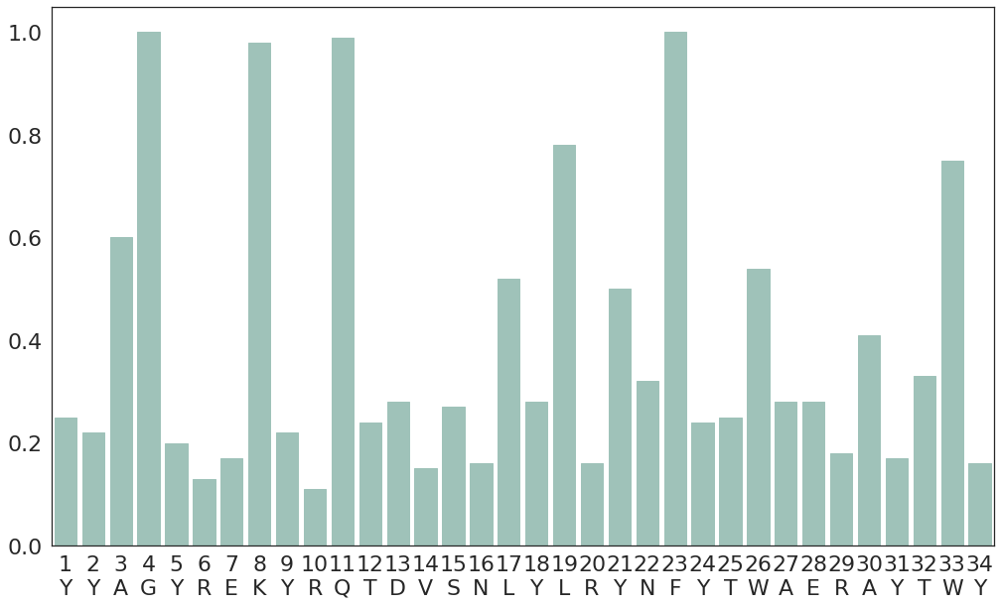

[0.25, 0.22, 0.6, 1.0, 0.2, 0.13, 0.17, 0.98, 0.22, 0.11, 0.99, 0.24, 0.28, 0.15, 0.27, 0.16, 0.52, 0.28, 0.78, 0.16, 0.5, 0.32, 1.0, 0.24, 0.25, 0.54, 0.28, 0.28, 0.18, 0.41, 0.17, 0.33, 0.75, 0.16]

---------------------
#Peptides: 153324
HLA: HLA-B*27:05
Threshold: 0.6
YHTEYREICAKTDEDTLYLNYHDYTWAVLAYEWY
threshold: 0.6


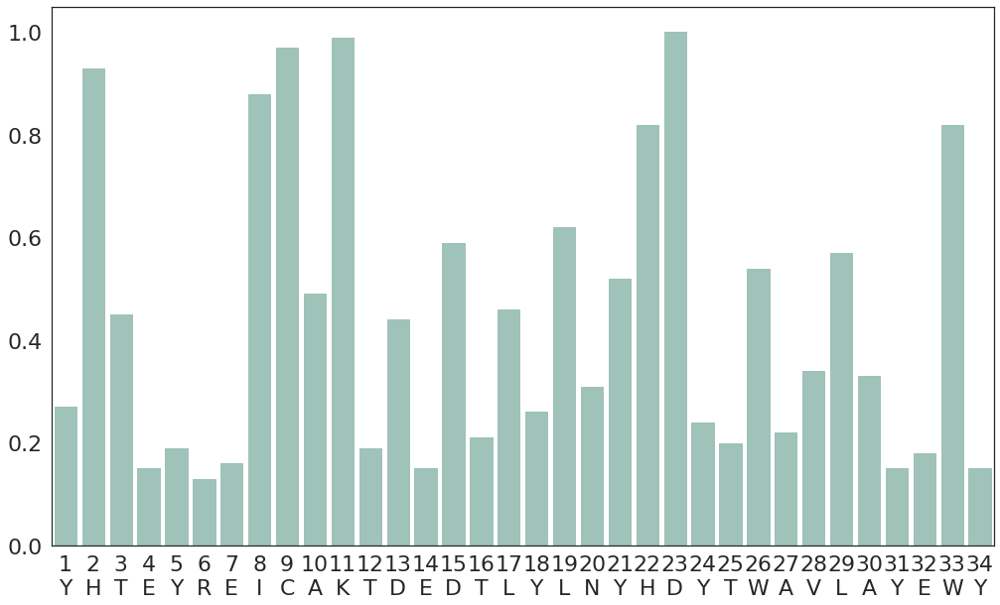

[0.27, 0.93, 0.45, 0.15, 0.19, 0.13, 0.16, 0.88, 0.97, 0.49, 0.99, 0.19, 0.44, 0.15, 0.59, 0.21, 0.46, 0.26, 0.62, 0.31, 0.52, 0.82, 1.0, 0.24, 0.2, 0.54, 0.22, 0.34, 0.57, 0.33, 0.15, 0.18, 0.82, 0.15]

---------------------
#Peptides: 1077
HLA: HLA-B*83:01
Threshold: 0.6
YYSEYRNIYAQTDESNLYIRYDDYTWAVDAYLSY
threshold: 0.6


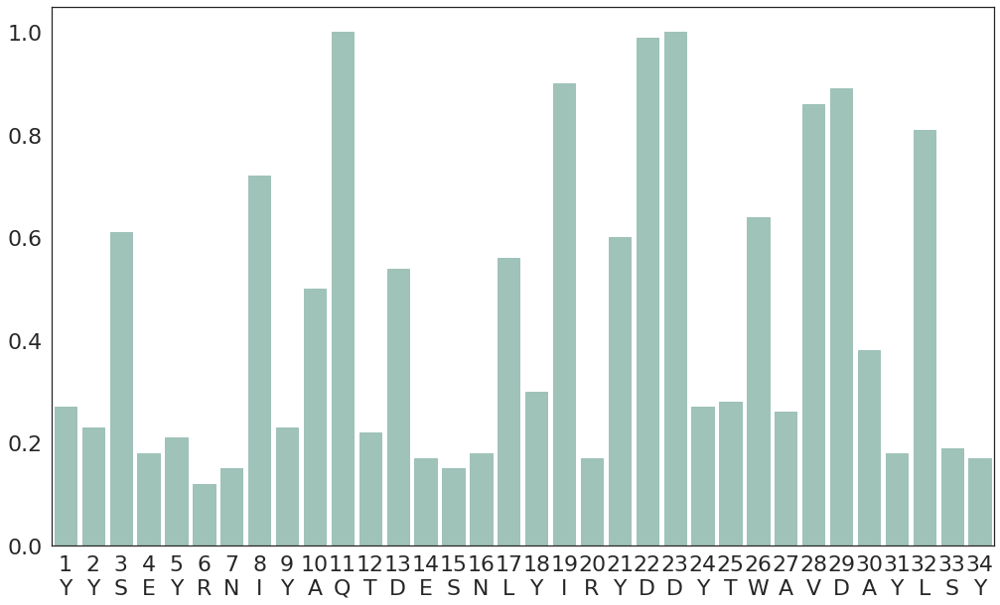

[0.27, 0.23, 0.61, 0.18, 0.21, 0.12, 0.15, 0.72, 0.23, 0.5, 1.0, 0.22, 0.54, 0.17, 0.15, 0.18, 0.56, 0.3, 0.9, 0.17, 0.6, 0.99, 1.0, 0.27, 0.28, 0.64, 0.26, 0.86, 0.89, 0.38, 0.18, 0.81, 0.19, 0.17]

---------------------
#Peptides: 7614
HLA: HLA-A*26:01
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQDYTWAEWAYRWY
threshold: 0.6


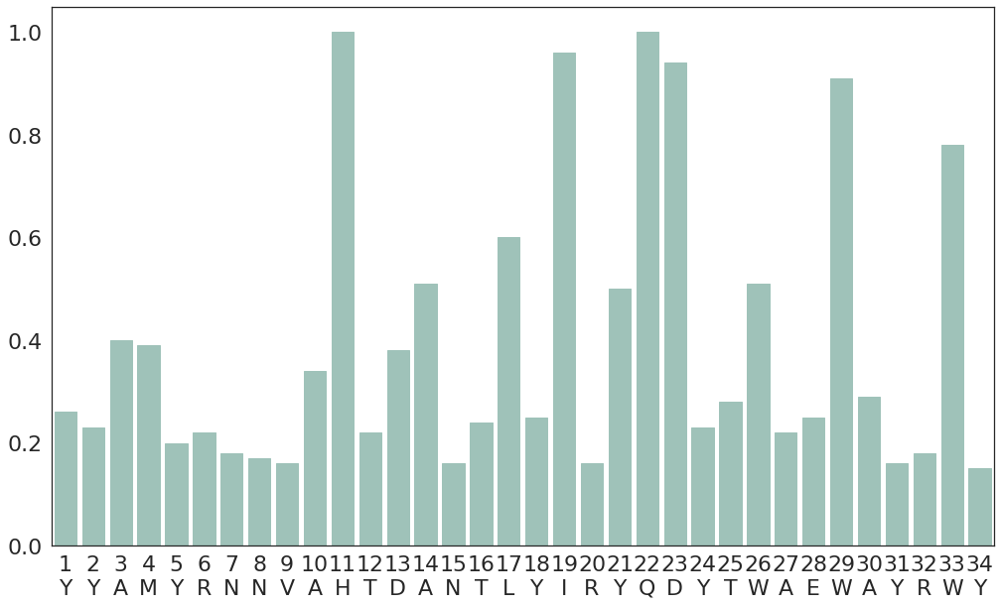

[0.26, 0.23, 0.4, 0.39, 0.2, 0.22, 0.18, 0.17, 0.16, 0.34, 1.0, 0.22, 0.38, 0.51, 0.16, 0.24, 0.6, 0.25, 0.96, 0.16, 0.5, 1.0, 0.94, 0.23, 0.28, 0.51, 0.22, 0.25, 0.91, 0.29, 0.16, 0.18, 0.78, 0.15]

---------------------
#Peptides: 20869
HLA: HLA-B*51:01
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAELAYLWH
threshold: 0.6


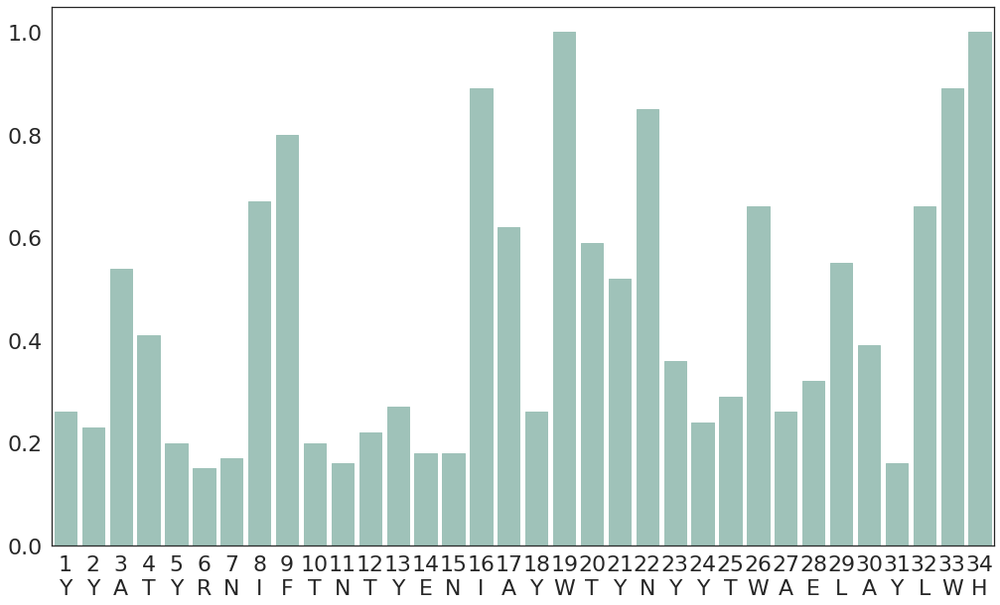

[0.26, 0.23, 0.54, 0.41, 0.2, 0.15, 0.17, 0.67, 0.8, 0.2, 0.16, 0.22, 0.27, 0.18, 0.18, 0.89, 0.62, 0.26, 1.0, 0.59, 0.52, 0.85, 0.36, 0.24, 0.29, 0.66, 0.26, 0.32, 0.55, 0.39, 0.16, 0.66, 0.89, 1.0]

---------------------
#Peptides: 403
HLA: HLA-A*25:01
Threshold: 0.6
YYAMYRNNVAHTDESIAYIRYQDYTWAEWAYRWY
threshold: 0.6


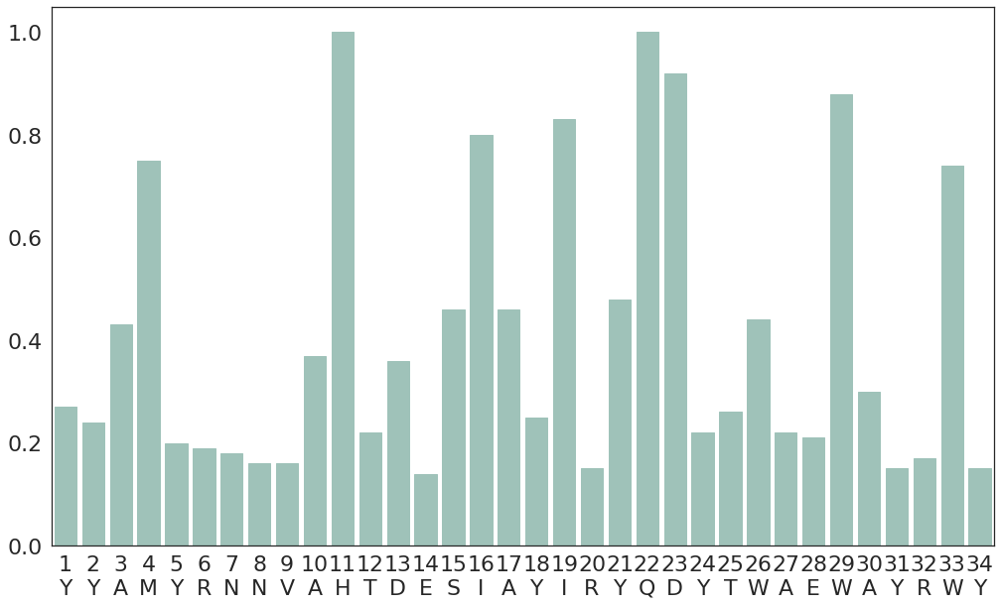

[0.27, 0.24, 0.43, 0.75, 0.2, 0.19, 0.18, 0.16, 0.16, 0.37, 1.0, 0.22, 0.36, 0.14, 0.46, 0.8, 0.46, 0.25, 0.83, 0.15, 0.48, 1.0, 0.92, 0.22, 0.26, 0.44, 0.22, 0.21, 0.88, 0.3, 0.15, 0.17, 0.74, 0.15]

---------------------
#Peptides: 2411
HLA: HLA-B*56:01
Threshold: 0.6
YYAEYRNIYAQTDESNLYWTYNLYTWAVLAYLWY
threshold: 0.6


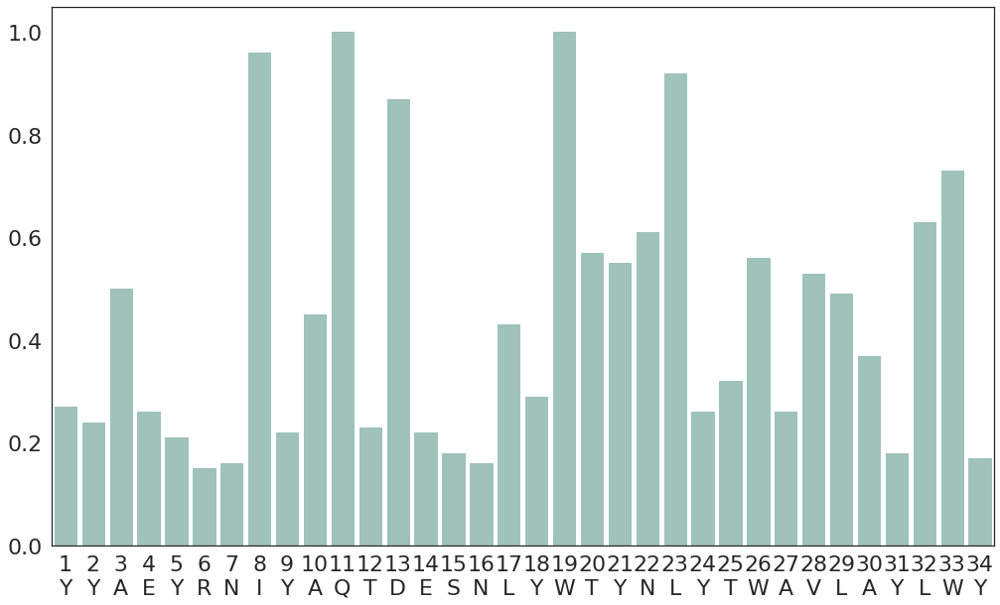

[0.27, 0.24, 0.5, 0.26, 0.21, 0.15, 0.16, 0.96, 0.22, 0.45, 1.0, 0.23, 0.87, 0.22, 0.18, 0.16, 0.43, 0.29, 1.0, 0.57, 0.55, 0.61, 0.92, 0.26, 0.32, 0.56, 0.26, 0.53, 0.49, 0.37, 0.18, 0.63, 0.73, 0.17]

---------------------
#Peptides: 6921
HLA: HLA-B*27:08
Threshold: 0.6
YHTEYREICAKTDESNLYLNYHDYTWAVLAYEWY
threshold: 0.6


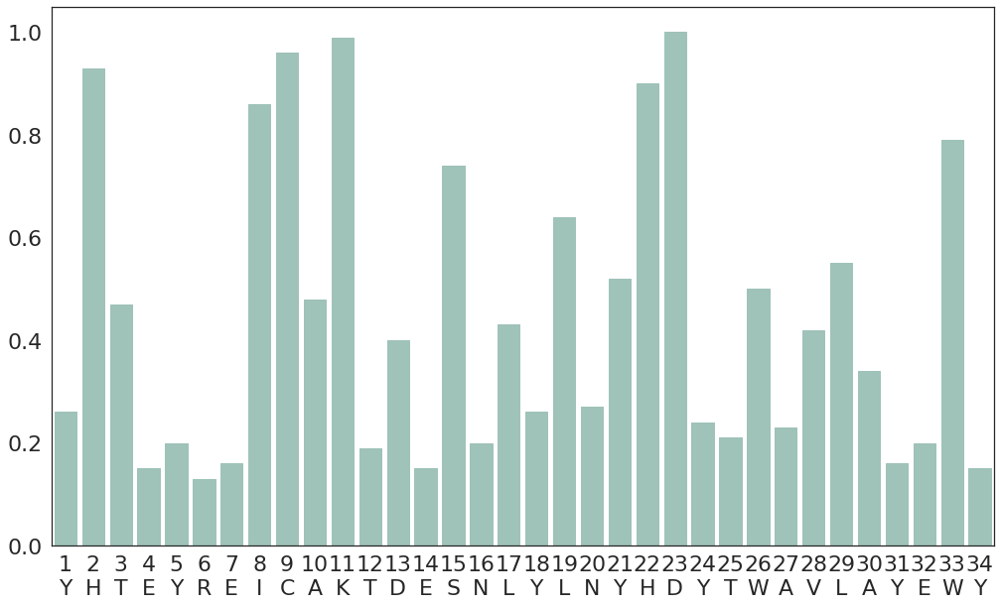

[0.26, 0.93, 0.47, 0.15, 0.2, 0.13, 0.16, 0.86, 0.96, 0.48, 0.99, 0.19, 0.4, 0.15, 0.74, 0.2, 0.43, 0.26, 0.64, 0.27, 0.52, 0.9, 1.0, 0.24, 0.21, 0.5, 0.23, 0.42, 0.55, 0.34, 0.16, 0.2, 0.79, 0.15]

---------------------
#Peptides: 6831
HLA: HLA-B*27:07
Threshold: 0.6
YHTEYREICAKTDEDTLYLSYNYYTWAVLAYEWY
threshold: 0.6


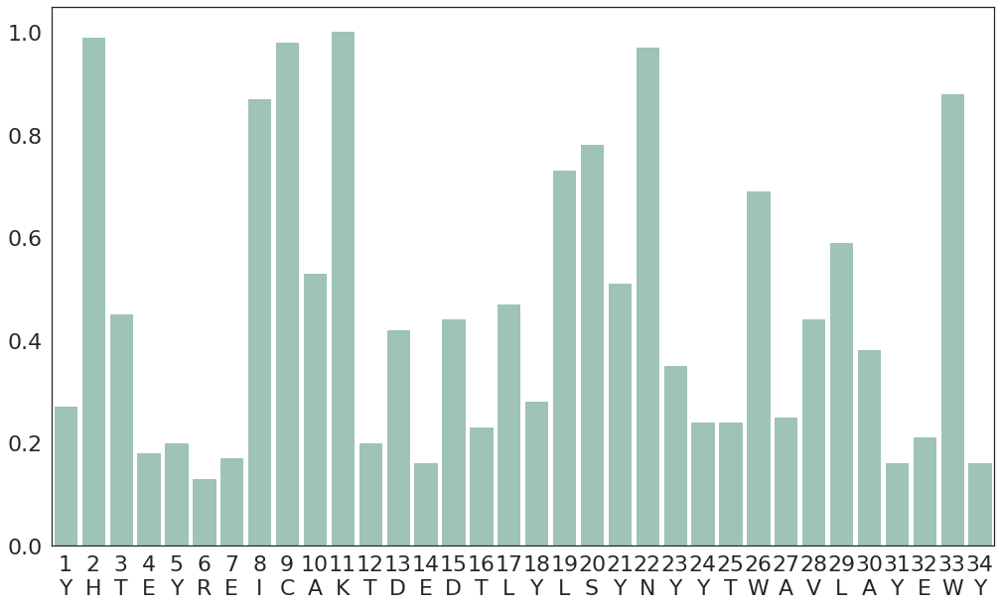

[0.27, 0.99, 0.45, 0.18, 0.2, 0.13, 0.17, 0.87, 0.98, 0.53, 1.0, 0.2, 0.42, 0.16, 0.44, 0.23, 0.47, 0.28, 0.73, 0.78, 0.51, 0.97, 0.35, 0.24, 0.24, 0.69, 0.25, 0.44, 0.59, 0.38, 0.16, 0.21, 0.88, 0.16]

---------------------
#Peptides: 100416
HLA: HLA-A*02:01
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


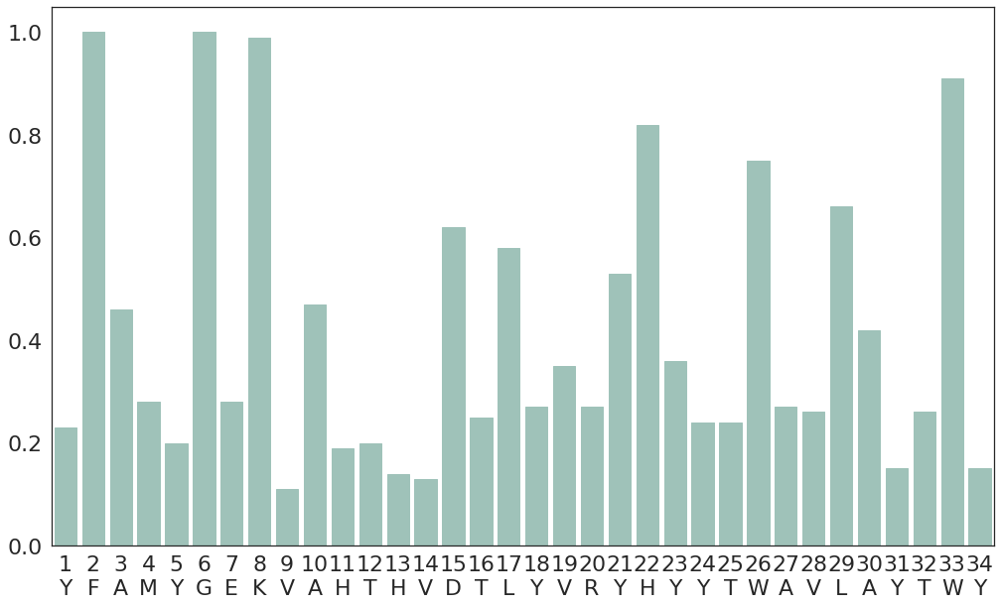

[0.23, 1.0, 0.46, 0.28, 0.2, 1.0, 0.28, 0.99, 0.11, 0.47, 0.19, 0.2, 0.14, 0.13, 0.62, 0.25, 0.58, 0.27, 0.35, 0.27, 0.53, 0.82, 0.36, 0.24, 0.24, 0.75, 0.27, 0.26, 0.66, 0.42, 0.15, 0.26, 0.91, 0.15]

---------------------
#Peptides: 4532
HLA: HLA-A*33:01
Threshold: 0.6
YTAMYRNNVAHIDVDTLYIMYQDYTWAVLAYTWH
threshold: 0.6


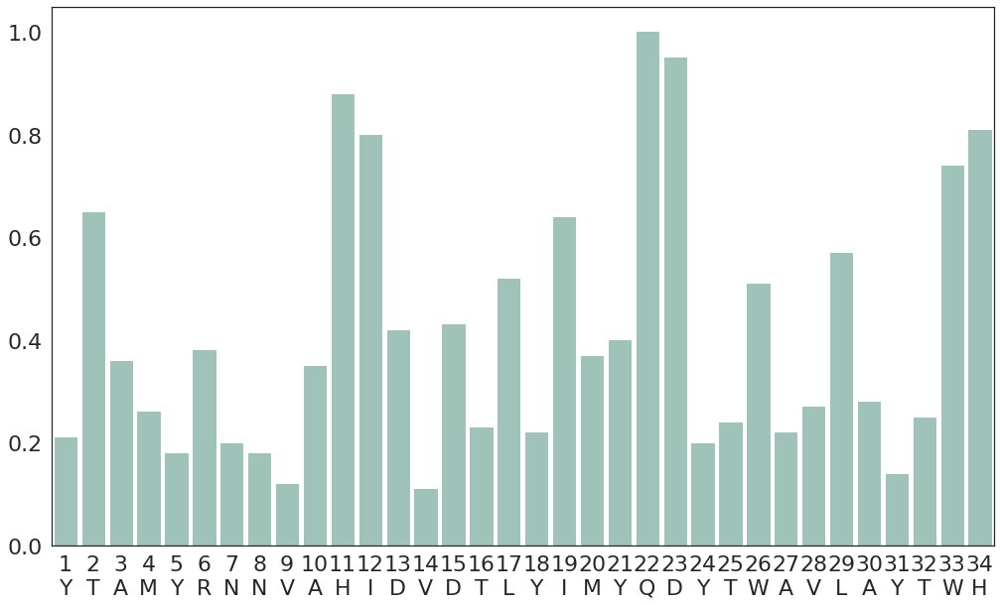

[0.21, 0.65, 0.36, 0.26, 0.18, 0.38, 0.2, 0.18, 0.12, 0.35, 0.88, 0.8, 0.42, 0.11, 0.43, 0.23, 0.52, 0.22, 0.64, 0.37, 0.4, 1.0, 0.95, 0.2, 0.24, 0.51, 0.22, 0.27, 0.57, 0.28, 0.14, 0.25, 0.74, 0.81]

---------------------
#Peptides: 8360
HLA: HLA-B*27:04
Threshold: 0.6
YHTEYREICAKTDESTLYLNYHDYTWAELAYEWY
threshold: 0.6


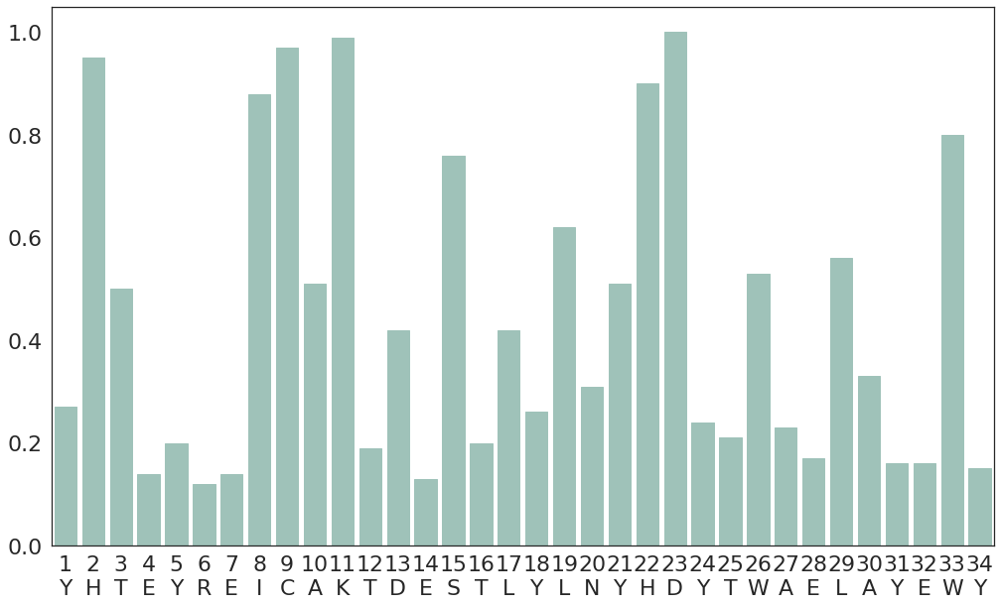

[0.27, 0.95, 0.5, 0.14, 0.2, 0.12, 0.14, 0.88, 0.97, 0.51, 0.99, 0.19, 0.42, 0.13, 0.76, 0.2, 0.42, 0.26, 0.62, 0.31, 0.51, 0.9, 1.0, 0.24, 0.21, 0.53, 0.23, 0.17, 0.56, 0.33, 0.16, 0.16, 0.8, 0.15]

---------------------
#Peptides: 15277
HLA: HLA-C*07:01
Threshold: 0.6
YDSGYRENYRQADVSNLYLRYDSYTLAALAYTWY
threshold: 0.6


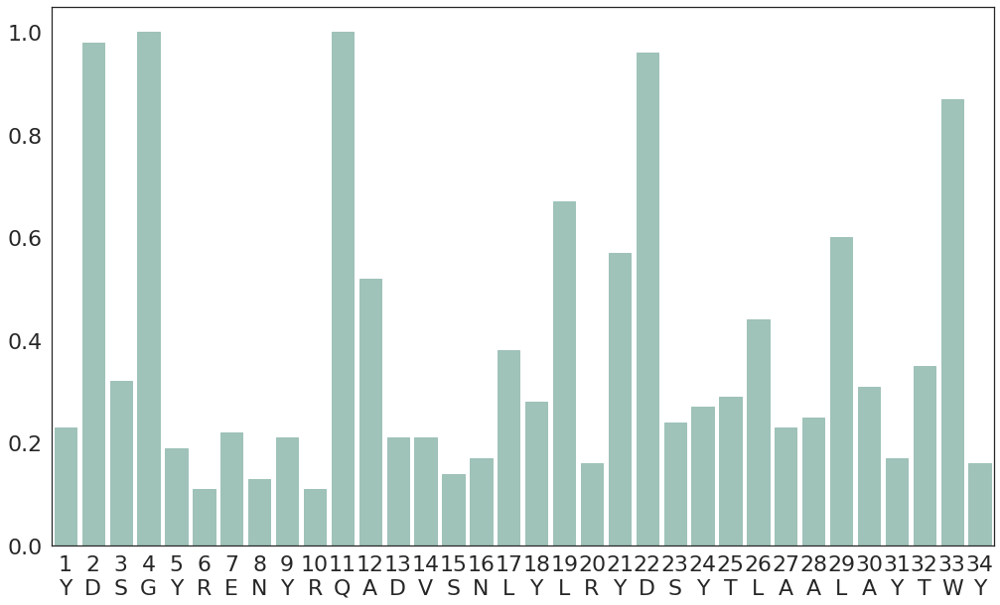

[0.23, 0.98, 0.32, 1.0, 0.19, 0.11, 0.22, 0.13, 0.21, 0.11, 1.0, 0.52, 0.21, 0.21, 0.14, 0.17, 0.38, 0.28, 0.67, 0.16, 0.57, 0.96, 0.24, 0.27, 0.29, 0.44, 0.23, 0.25, 0.6, 0.31, 0.17, 0.35, 0.87, 0.16]

---------------------
#Peptides: 13402
HLA: HLA-B*14:02
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH
threshold: 0.6


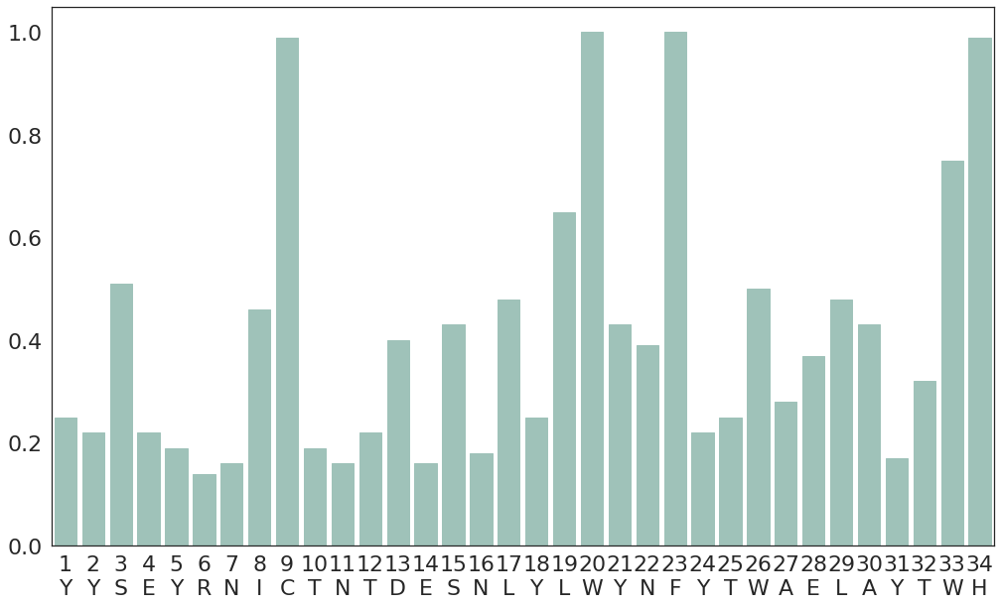

[0.25, 0.22, 0.51, 0.22, 0.19, 0.14, 0.16, 0.46, 0.99, 0.19, 0.16, 0.22, 0.4, 0.16, 0.43, 0.18, 0.48, 0.25, 0.65, 1.0, 0.43, 0.39, 1.0, 0.22, 0.25, 0.5, 0.28, 0.37, 0.48, 0.43, 0.17, 0.32, 0.75, 0.99]

---------------------
#Peptides: 13590
HLA: HLA-B*35:03
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDFYTWAVLAYLWY
threshold: 0.6


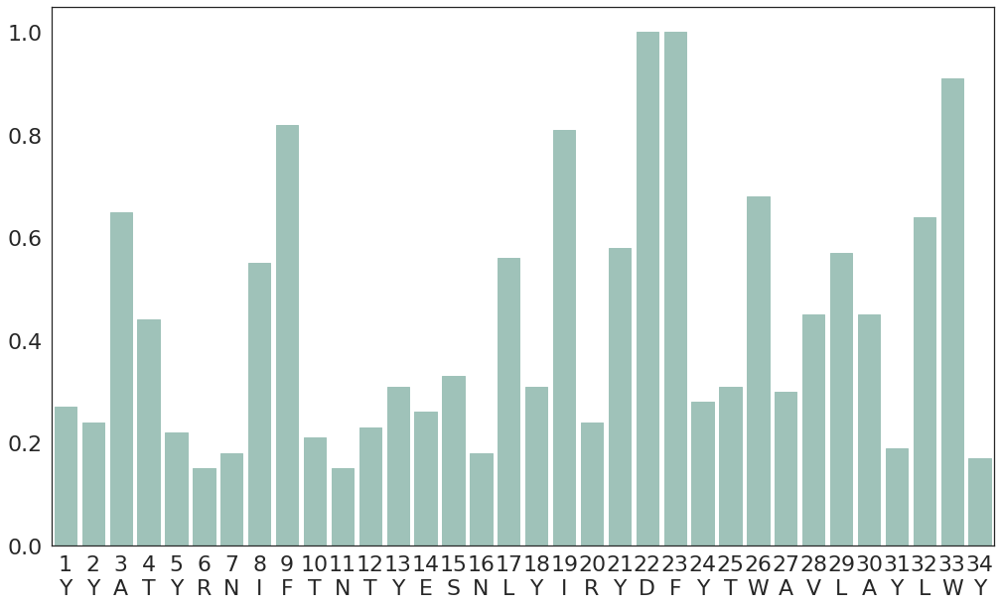

[0.27, 0.24, 0.65, 0.44, 0.22, 0.15, 0.18, 0.55, 0.82, 0.21, 0.15, 0.23, 0.31, 0.26, 0.33, 0.18, 0.56, 0.31, 0.81, 0.24, 0.58, 1.0, 1.0, 0.28, 0.31, 0.68, 0.3, 0.45, 0.57, 0.45, 0.19, 0.64, 0.91, 0.17]

---------------------
#Peptides: 1176
HLA: HLA-B*45:06
Threshold: 0.6
YHTKYREIYAQTDESNLYWRYNLYTWAVDAYLSY
threshold: 0.6


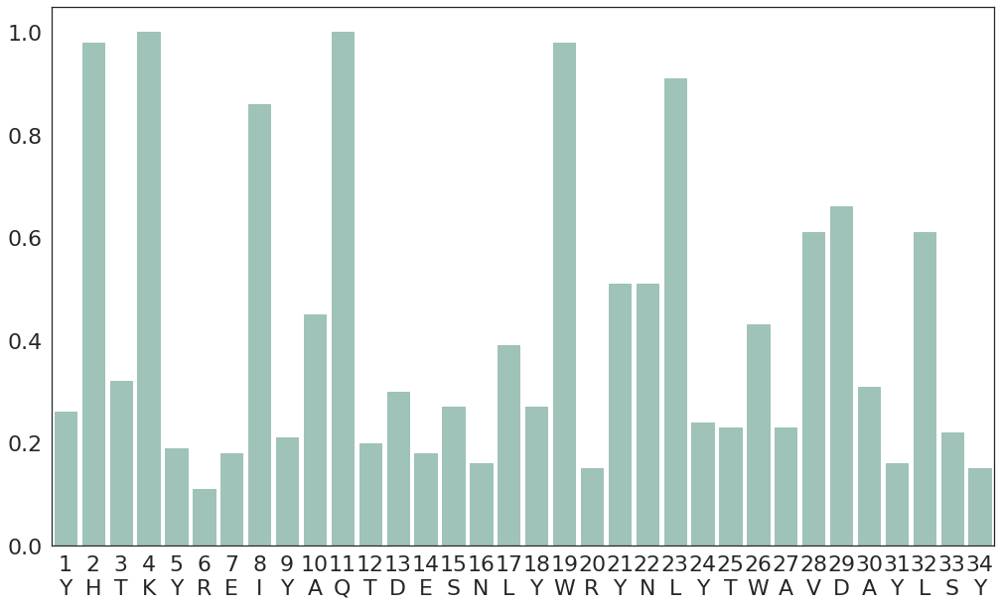

[0.26, 0.98, 0.32, 1.0, 0.19, 0.11, 0.18, 0.86, 0.21, 0.45, 1.0, 0.2, 0.3, 0.18, 0.27, 0.16, 0.39, 0.27, 0.98, 0.15, 0.51, 0.51, 0.91, 0.24, 0.23, 0.43, 0.23, 0.61, 0.66, 0.31, 0.16, 0.61, 0.22, 0.15]

---------------------
#Peptides: 311
HLA: HLA-A*66:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYQDYTWAEWAYRWY
threshold: 0.6


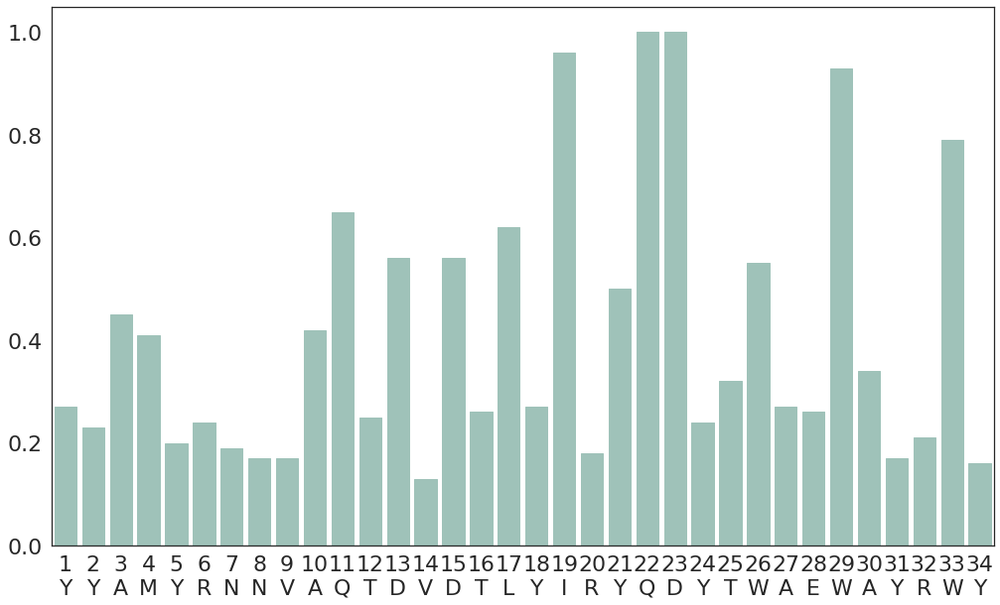

[0.27, 0.23, 0.45, 0.41, 0.2, 0.24, 0.19, 0.17, 0.17, 0.42, 0.65, 0.25, 0.56, 0.13, 0.56, 0.26, 0.62, 0.27, 0.96, 0.18, 0.5, 1.0, 1.0, 0.24, 0.32, 0.55, 0.27, 0.26, 0.93, 0.34, 0.17, 0.21, 0.79, 0.16]

---------------------
#Peptides: 16645
HLA: HLA-B*49:01
Threshold: 0.6
YHTKYREISTNTYENIAYWRYNLYTWAELAYLWY
threshold: 0.6


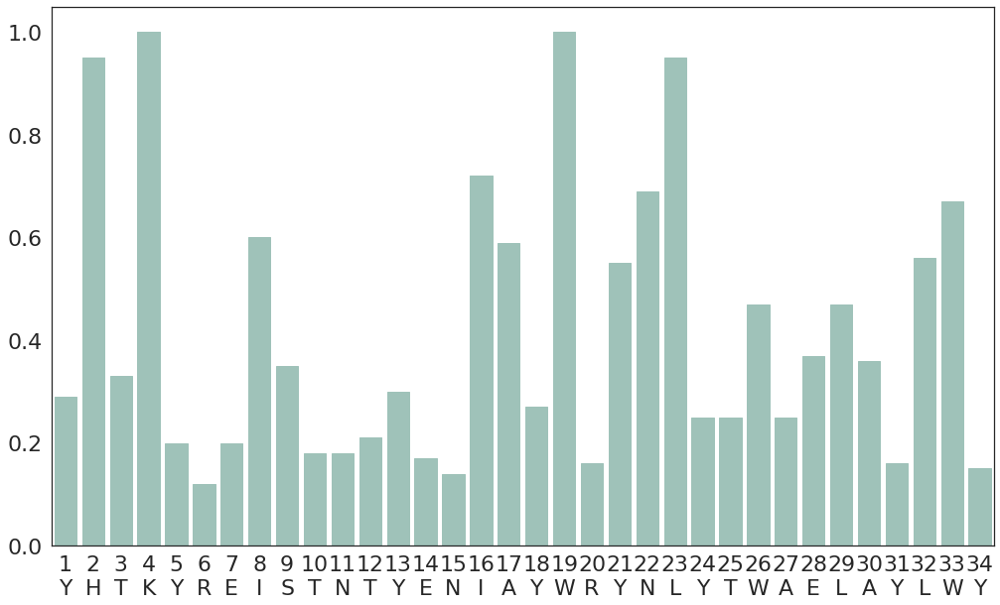

[0.29, 0.95, 0.33, 1.0, 0.2, 0.12, 0.2, 0.6, 0.35, 0.18, 0.18, 0.21, 0.3, 0.17, 0.14, 0.72, 0.59, 0.27, 1.0, 0.16, 0.55, 0.69, 0.95, 0.25, 0.25, 0.47, 0.25, 0.37, 0.47, 0.36, 0.16, 0.56, 0.67, 0.15]

---------------------
#Peptides: 5991
HLA: HLA-B*50:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAELAYLWY
threshold: 0.6


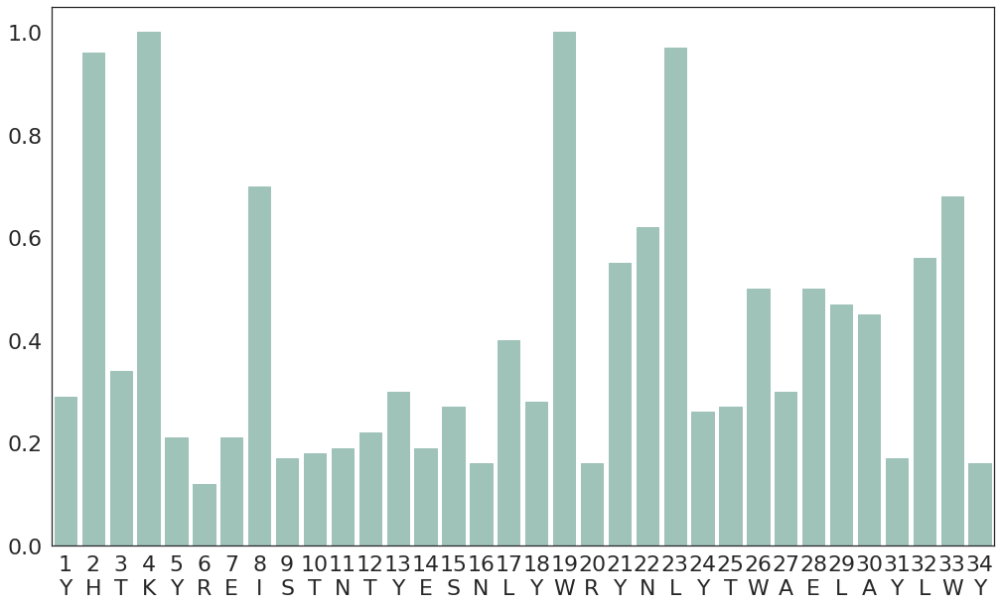

[0.29, 0.96, 0.34, 1.0, 0.21, 0.12, 0.21, 0.7, 0.17, 0.18, 0.19, 0.22, 0.3, 0.19, 0.27, 0.16, 0.4, 0.28, 1.0, 0.16, 0.55, 0.62, 0.97, 0.26, 0.27, 0.5, 0.3, 0.5, 0.47, 0.45, 0.17, 0.56, 0.68, 0.16]

---------------------
#Peptides: 4014
HLA: HLA-A*69:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


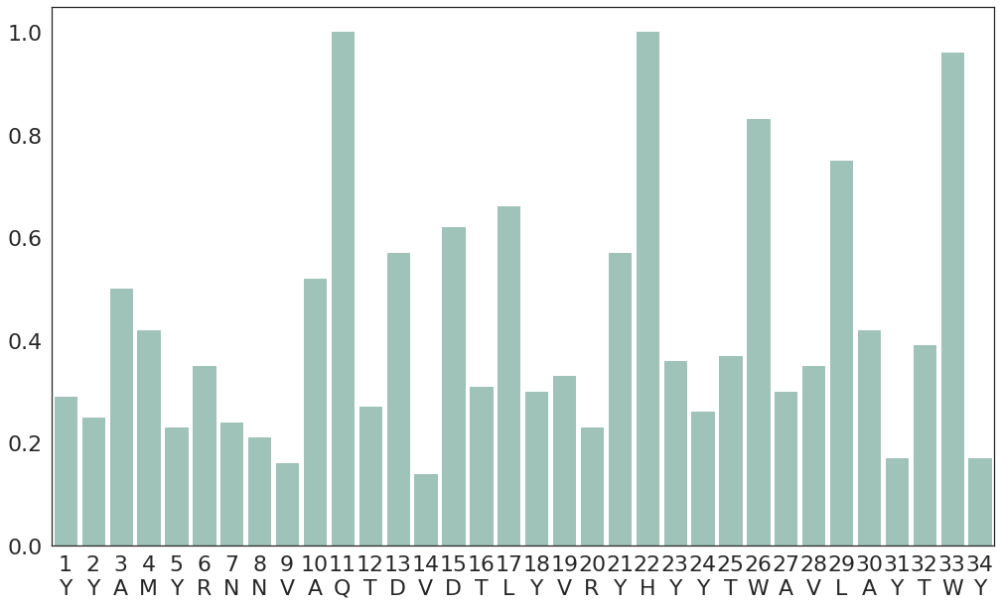

[0.29, 0.25, 0.5, 0.42, 0.23, 0.35, 0.24, 0.21, 0.16, 0.52, 1.0, 0.27, 0.57, 0.14, 0.62, 0.31, 0.66, 0.3, 0.33, 0.23, 0.57, 1.0, 0.36, 0.26, 0.37, 0.83, 0.3, 0.35, 0.75, 0.42, 0.17, 0.39, 0.96, 0.17]

---------------------
#Peptides: 1016
HLA: HLA-A*24:06
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVWAYTGY
threshold: 0.6


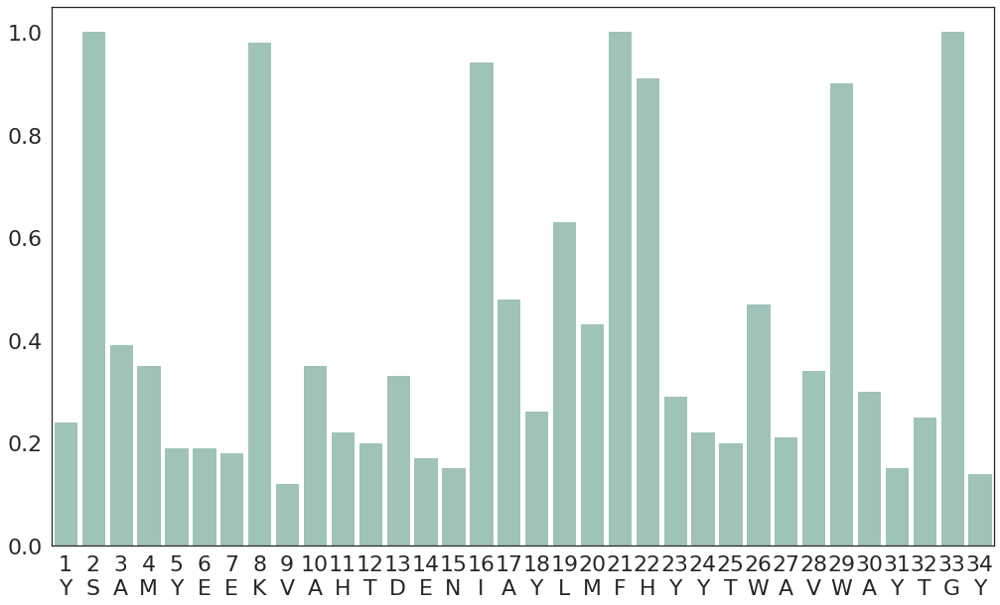

[0.24, 1.0, 0.39, 0.35, 0.19, 0.19, 0.18, 0.98, 0.12, 0.35, 0.22, 0.2, 0.33, 0.17, 0.15, 0.94, 0.48, 0.26, 0.63, 0.43, 1.0, 0.91, 0.29, 0.22, 0.2, 0.47, 0.21, 0.34, 0.9, 0.3, 0.15, 0.25, 1.0, 0.14]

---------------------
#Peptides: 17406
HLA: HLA-B*57:03
Threshold: 0.6
YYAMYGENMASTYENIAYIVYNYYTWAVLAYLWY
threshold: 0.6


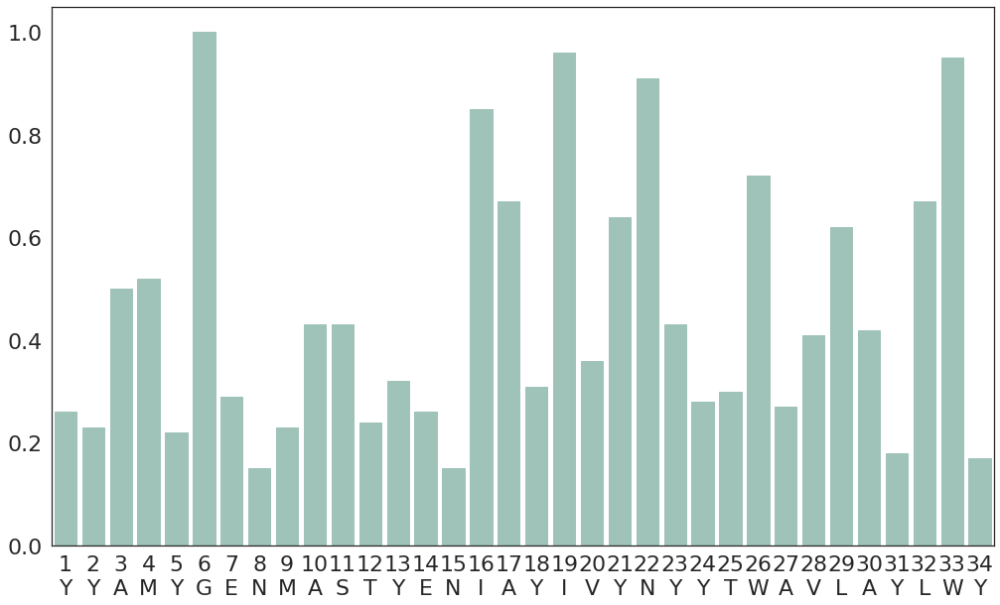

[0.26, 0.23, 0.5, 0.52, 0.22, 1.0, 0.29, 0.15, 0.23, 0.43, 0.43, 0.24, 0.32, 0.26, 0.15, 0.85, 0.67, 0.31, 0.96, 0.36, 0.64, 0.91, 0.43, 0.28, 0.3, 0.72, 0.27, 0.41, 0.62, 0.42, 0.18, 0.67, 0.95, 0.17]

---------------------
#Peptides: 6686
HLA: HLA-C*15:02
Threshold: 0.6
YYAGYRENYRQTDVNKLYIRYDLYTWAELAYTWY
threshold: 0.6


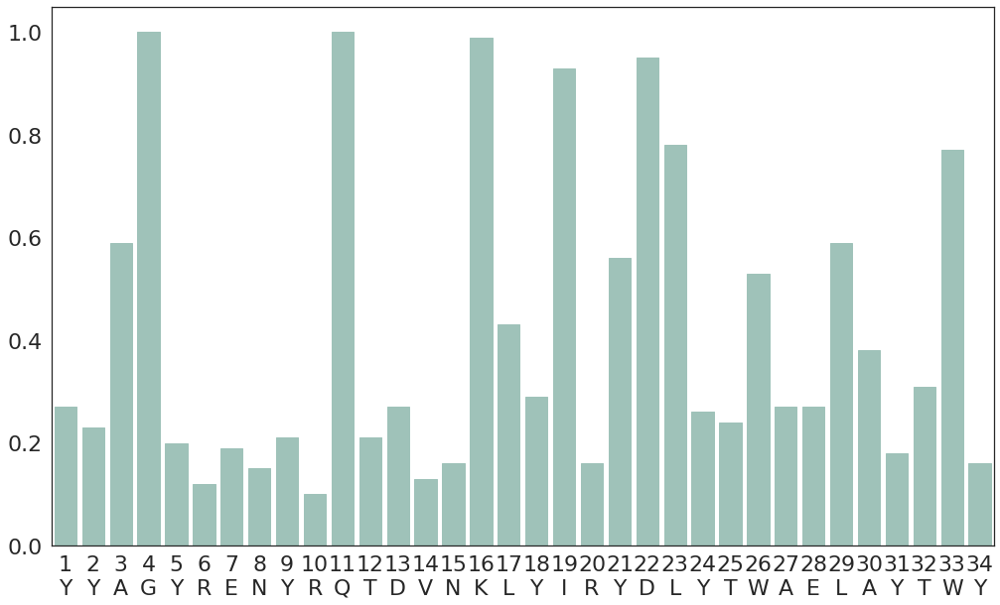

[0.27, 0.23, 0.59, 1.0, 0.2, 0.12, 0.19, 0.15, 0.21, 0.1, 1.0, 0.21, 0.27, 0.13, 0.16, 0.99, 0.43, 0.29, 0.93, 0.16, 0.56, 0.95, 0.78, 0.26, 0.24, 0.53, 0.27, 0.27, 0.59, 0.38, 0.18, 0.31, 0.77, 0.16]

---------------------
#Peptides: 344
HLA: HLA-B*15:09
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYNYYTWAELAYLWY
threshold: 0.6


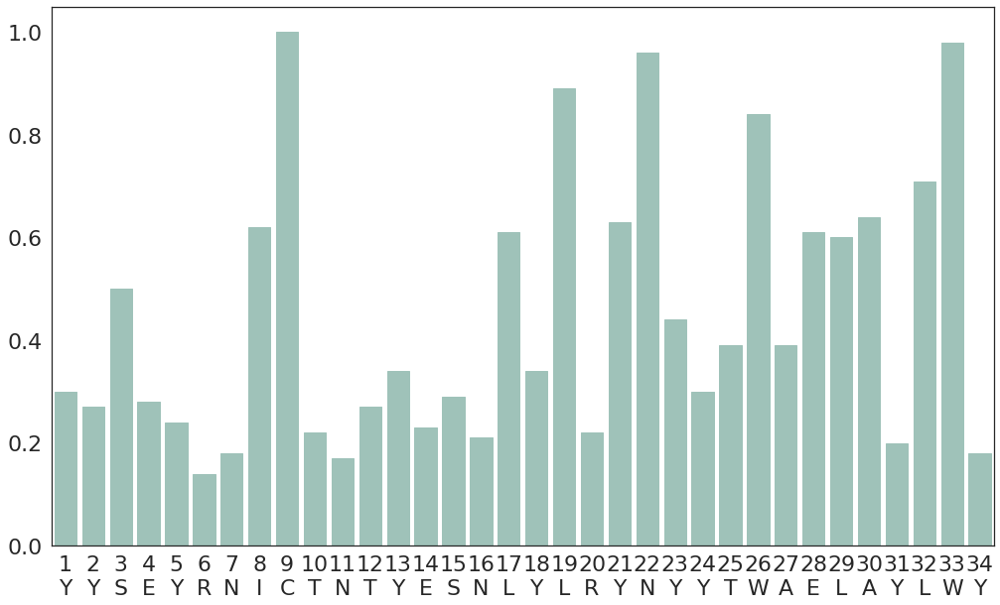

[0.3, 0.27, 0.5, 0.28, 0.24, 0.14, 0.18, 0.62, 1.0, 0.22, 0.17, 0.27, 0.34, 0.23, 0.29, 0.21, 0.61, 0.34, 0.89, 0.22, 0.63, 0.96, 0.44, 0.3, 0.39, 0.84, 0.39, 0.61, 0.6, 0.64, 0.2, 0.71, 0.98, 0.18]

---------------------
#Peptides: 5820
HLA: HLA-A*30:01
Threshold: 0.6
YSAMYQENVAQTDVDTLYIIYEHYTWAWLAYTWY
threshold: 0.6


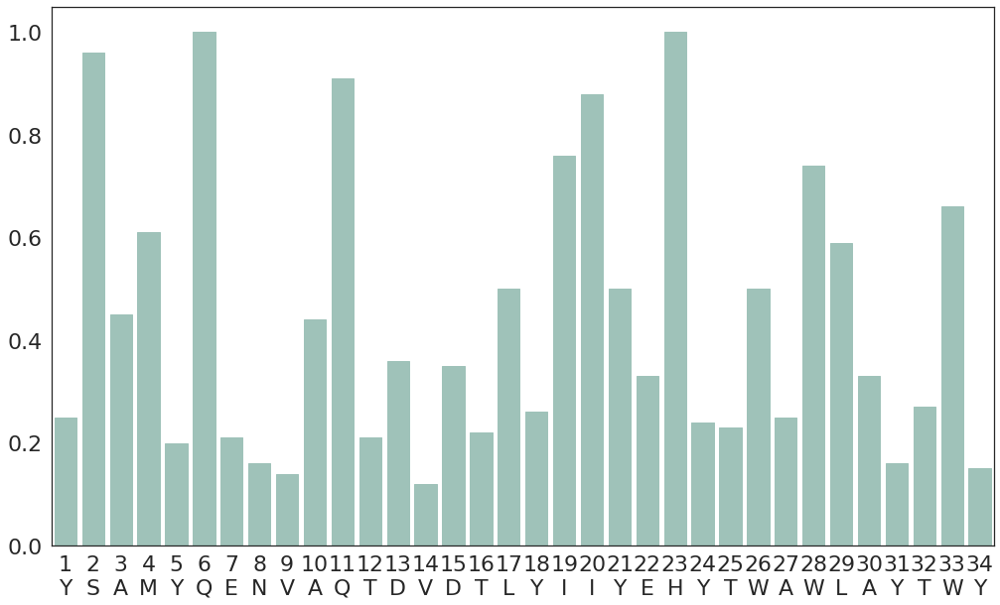

[0.25, 0.96, 0.45, 0.61, 0.2, 1.0, 0.21, 0.16, 0.14, 0.44, 0.91, 0.21, 0.36, 0.12, 0.35, 0.22, 0.5, 0.26, 0.76, 0.88, 0.5, 0.33, 1.0, 0.24, 0.23, 0.5, 0.25, 0.74, 0.59, 0.33, 0.16, 0.27, 0.66, 0.15]

---------------------
#Peptides: 2079
HLA: HLA-B*41:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNYYTWAVDAYTWY
threshold: 0.6


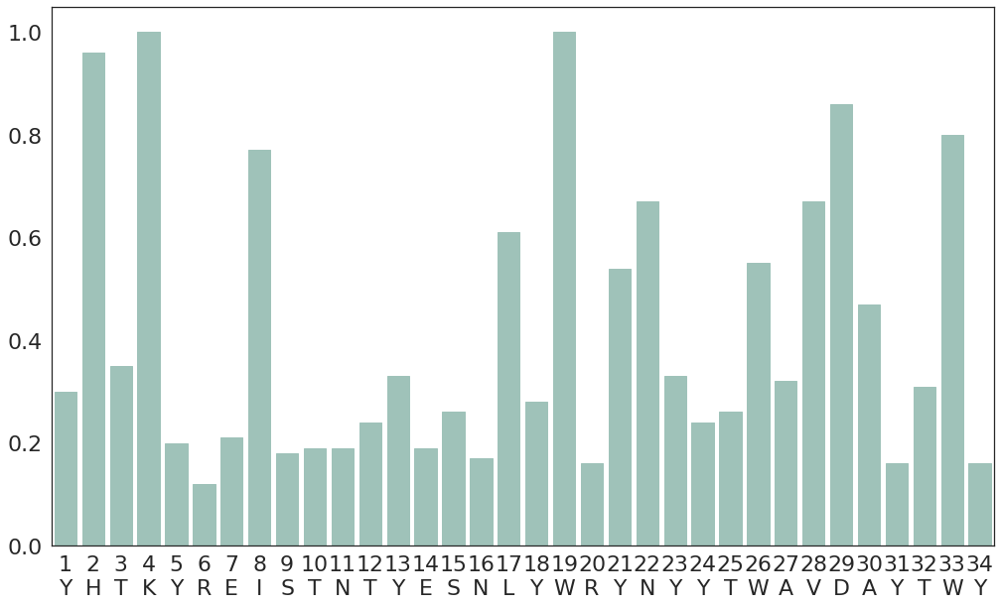

[0.3, 0.96, 0.35, 1.0, 0.2, 0.12, 0.21, 0.77, 0.18, 0.19, 0.19, 0.24, 0.33, 0.19, 0.26, 0.17, 0.61, 0.28, 1.0, 0.16, 0.54, 0.67, 0.33, 0.24, 0.26, 0.55, 0.32, 0.67, 0.86, 0.47, 0.16, 0.31, 0.8, 0.16]

---------------------
#Peptides: 227
HLA: HLA-B*44:27
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY
threshold: 0.6


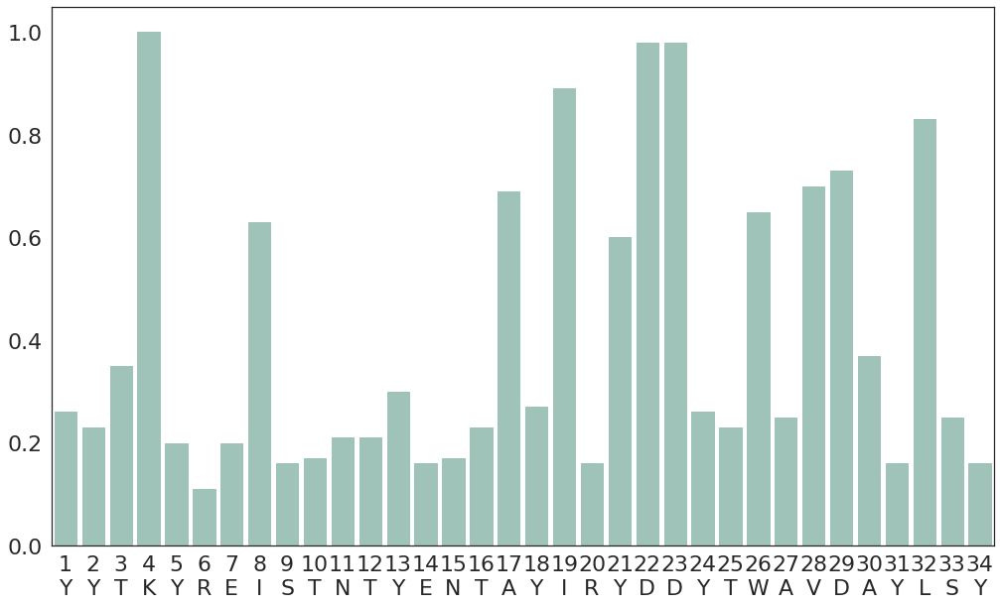

[0.26, 0.23, 0.35, 1.0, 0.2, 0.11, 0.2, 0.63, 0.16, 0.17, 0.21, 0.21, 0.3, 0.16, 0.17, 0.23, 0.69, 0.27, 0.89, 0.16, 0.6, 0.98, 0.98, 0.26, 0.23, 0.65, 0.25, 0.7, 0.73, 0.37, 0.16, 0.83, 0.25, 0.16]

---------------------
#Peptides: 12621
HLA: HLA-A*23:01
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY
threshold: 0.6


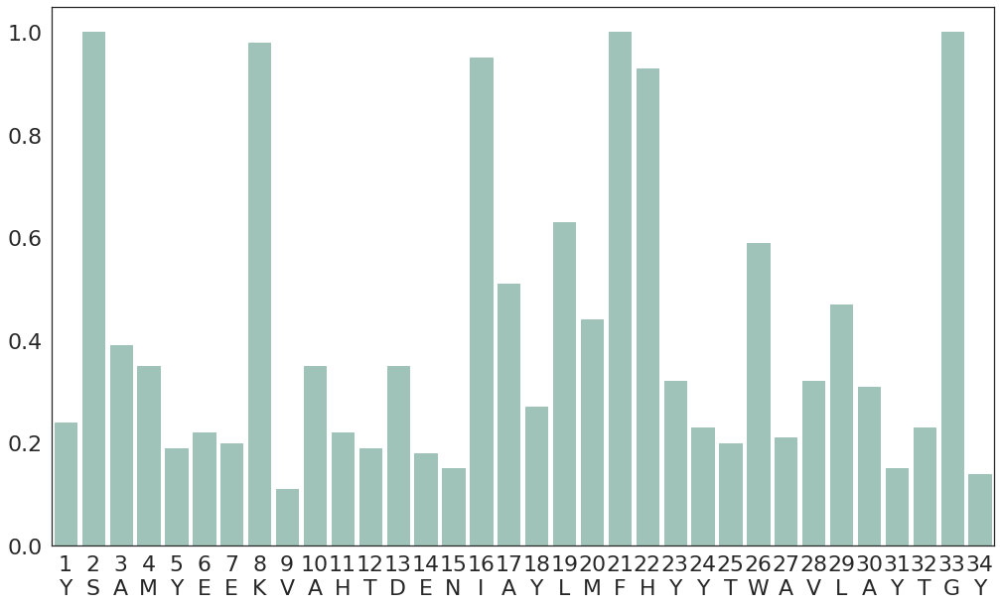

[0.24, 1.0, 0.39, 0.35, 0.19, 0.22, 0.2, 0.98, 0.11, 0.35, 0.22, 0.19, 0.35, 0.18, 0.15, 0.95, 0.51, 0.27, 0.63, 0.44, 1.0, 0.93, 0.32, 0.23, 0.2, 0.59, 0.21, 0.32, 0.47, 0.31, 0.15, 0.23, 1.0, 0.14]

---------------------
#Peptides: 16879
HLA: HLA-C*03:04
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY
threshold: 0.6


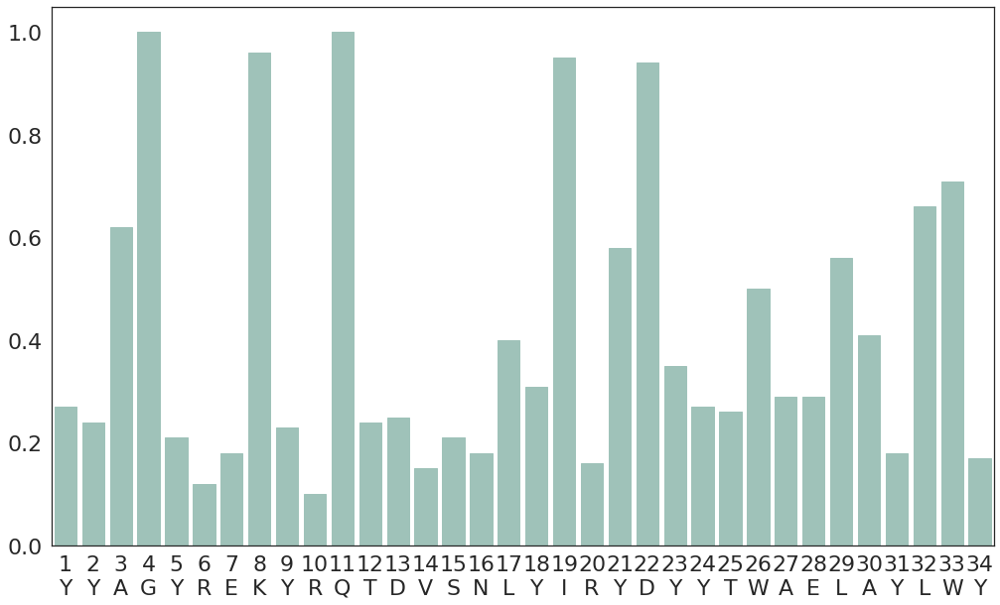

[0.27, 0.24, 0.62, 1.0, 0.21, 0.12, 0.18, 0.96, 0.23, 0.1, 1.0, 0.24, 0.25, 0.15, 0.21, 0.18, 0.4, 0.31, 0.95, 0.16, 0.58, 0.94, 0.35, 0.27, 0.26, 0.5, 0.29, 0.29, 0.56, 0.41, 0.18, 0.66, 0.71, 0.17]

---------------------
#Peptides: 10700
HLA: HLA-B*13:02
Threshold: 0.6
YYTMYREISTNTYENTAYWTYNLYTWAVLAYEWY
threshold: 0.6


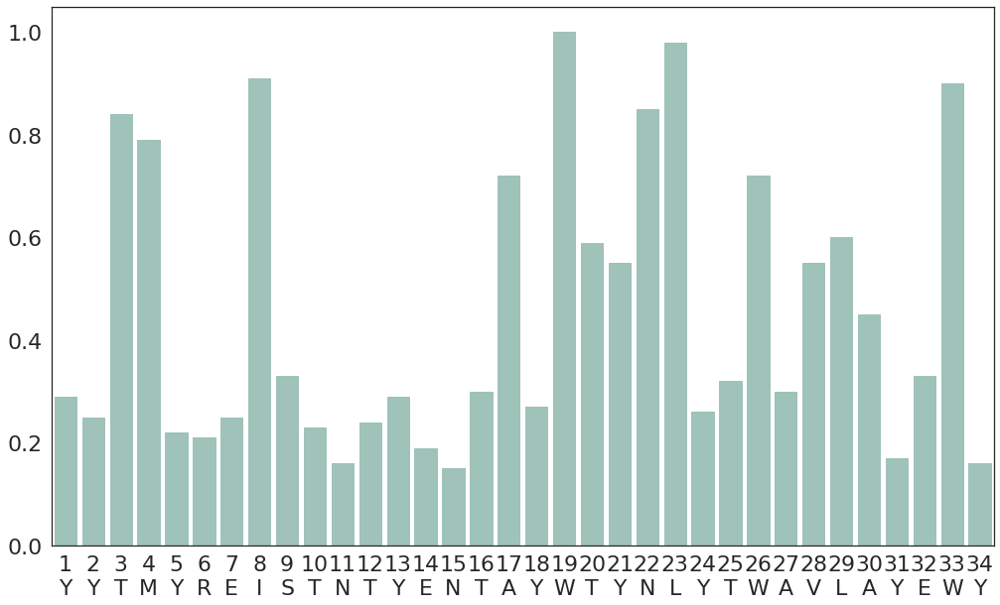

[0.29, 0.25, 0.84, 0.79, 0.22, 0.21, 0.25, 0.91, 0.33, 0.23, 0.16, 0.24, 0.29, 0.19, 0.15, 0.3, 0.72, 0.27, 1.0, 0.59, 0.55, 0.85, 0.98, 0.26, 0.32, 0.72, 0.3, 0.55, 0.6, 0.45, 0.17, 0.33, 0.9, 0.16]

---------------------
#Peptides: 21773
HLA: HLA-A*68:02
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYHYYTWAVWAYTWY
threshold: 0.6


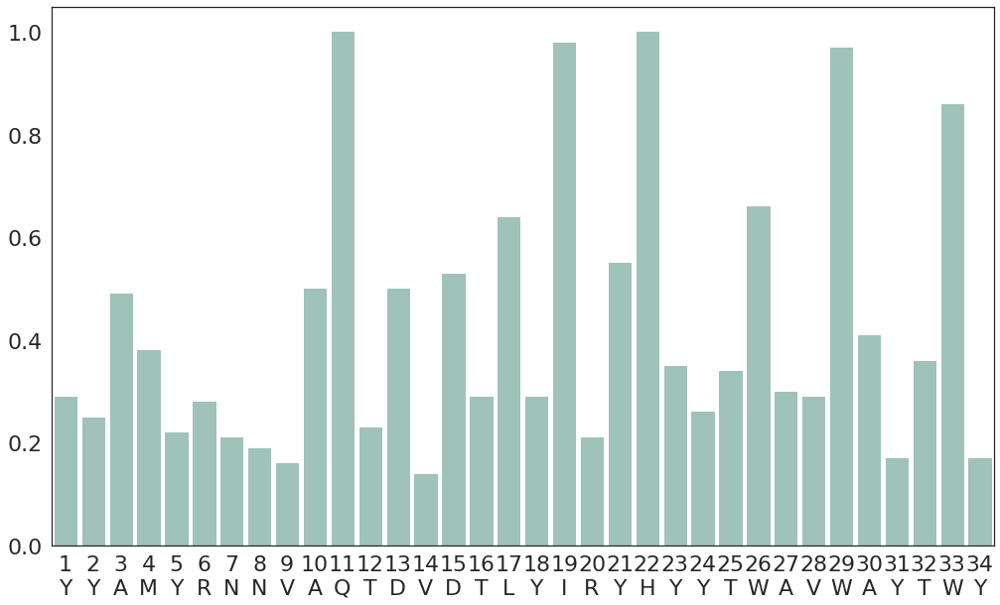

[0.29, 0.25, 0.49, 0.38, 0.22, 0.28, 0.21, 0.19, 0.16, 0.5, 1.0, 0.23, 0.5, 0.14, 0.53, 0.29, 0.64, 0.29, 0.98, 0.21, 0.55, 1.0, 0.35, 0.26, 0.34, 0.66, 0.3, 0.29, 0.97, 0.41, 0.17, 0.36, 0.86, 0.17]

---------------------
#Peptides: 28652
HLA: HLA-A*68:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIMYRDYTWAVWAYTWY
threshold: 0.6


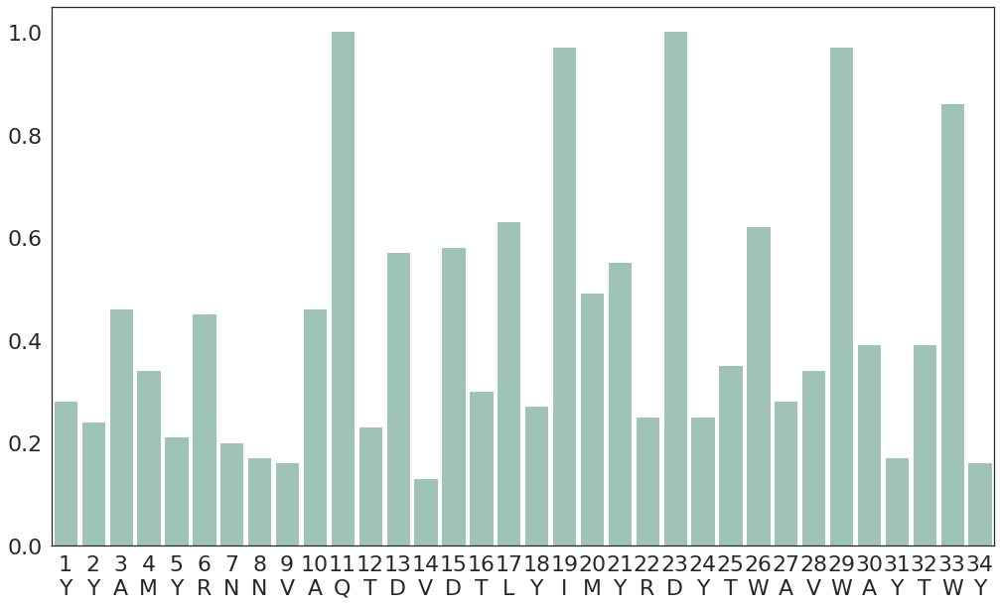

[0.28, 0.24, 0.46, 0.34, 0.21, 0.45, 0.2, 0.17, 0.16, 0.46, 1.0, 0.23, 0.57, 0.13, 0.58, 0.3, 0.63, 0.27, 0.97, 0.49, 0.55, 0.25, 1.0, 0.25, 0.35, 0.62, 0.28, 0.34, 0.97, 0.39, 0.17, 0.39, 0.86, 0.16]

---------------------
#Peptides: 18481
HLA: HLA-C*05:01
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYNFYTWAERAYTWY
threshold: 0.6


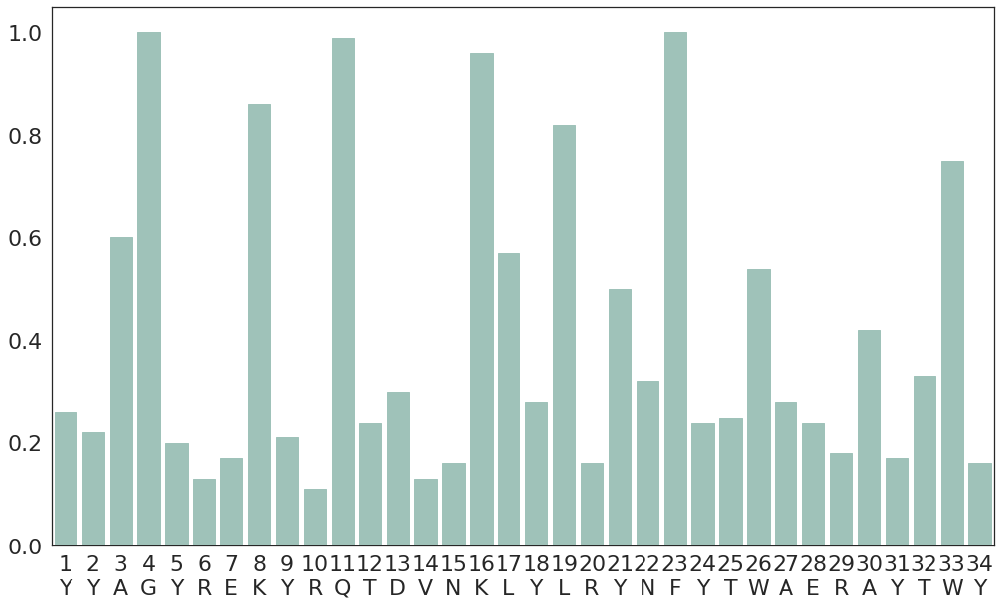

[0.26, 0.22, 0.6, 1.0, 0.2, 0.13, 0.17, 0.86, 0.21, 0.11, 0.99, 0.24, 0.3, 0.13, 0.16, 0.96, 0.57, 0.28, 0.82, 0.16, 0.5, 0.32, 1.0, 0.24, 0.25, 0.54, 0.28, 0.24, 0.18, 0.42, 0.17, 0.33, 0.75, 0.16]

---------------------
#Peptides: 22839
HLA: HLA-C*06:02
Threshold: 0.6
YDSGYREKYRQADVNKLYLWYDSYTWAEWAYTWY
threshold: 0.6


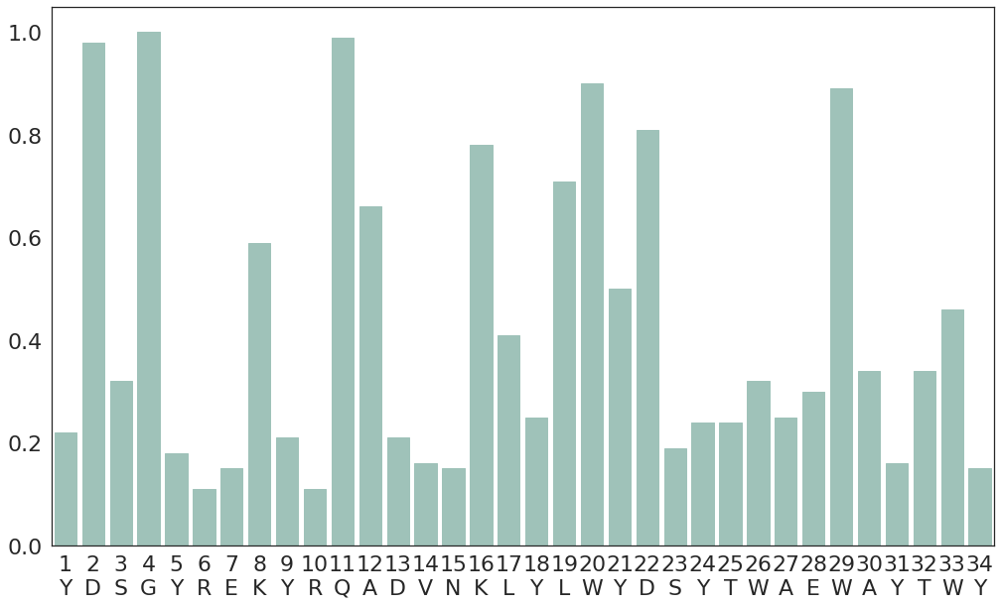

[0.22, 0.98, 0.32, 1.0, 0.18, 0.11, 0.15, 0.59, 0.21, 0.11, 0.99, 0.66, 0.21, 0.16, 0.15, 0.78, 0.41, 0.25, 0.71, 0.9, 0.5, 0.81, 0.19, 0.24, 0.24, 0.32, 0.25, 0.3, 0.89, 0.34, 0.16, 0.34, 0.46, 0.15]

---------------------
#Peptides: 30360
HLA: HLA-B*44:02
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY
threshold: 0.6


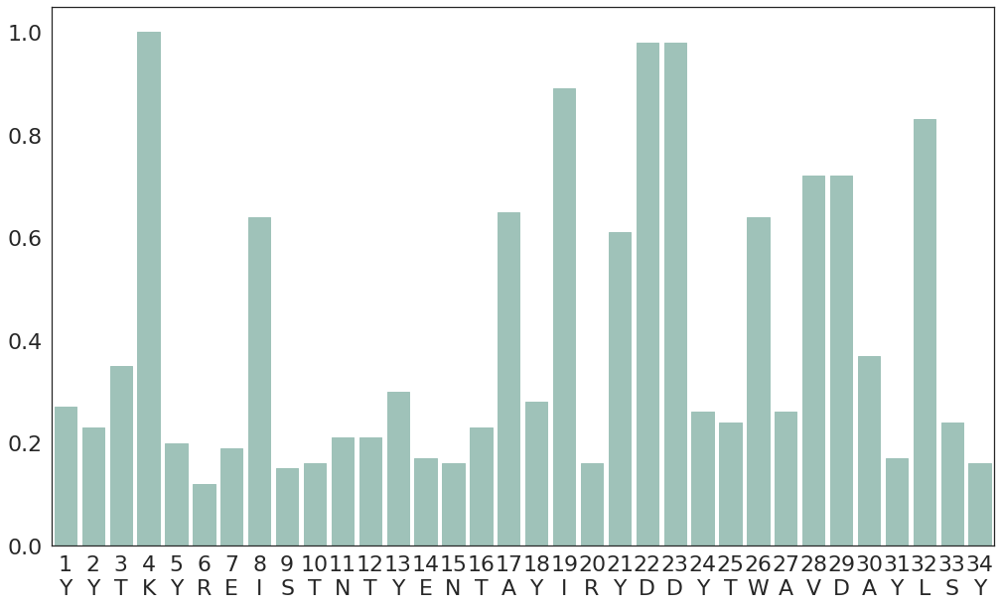

[0.27, 0.23, 0.35, 1.0, 0.2, 0.12, 0.19, 0.64, 0.15, 0.16, 0.21, 0.21, 0.3, 0.17, 0.16, 0.23, 0.65, 0.28, 0.89, 0.16, 0.61, 0.98, 0.98, 0.26, 0.24, 0.64, 0.26, 0.72, 0.72, 0.37, 0.17, 0.83, 0.24, 0.16]

---------------------
#Peptides: 9425
HLA: HLA-B*18:01
Threshold: 0.6
YHSTYRNISTNTYESNLYLRYDSYTWAVLAYTWH
threshold: 0.6


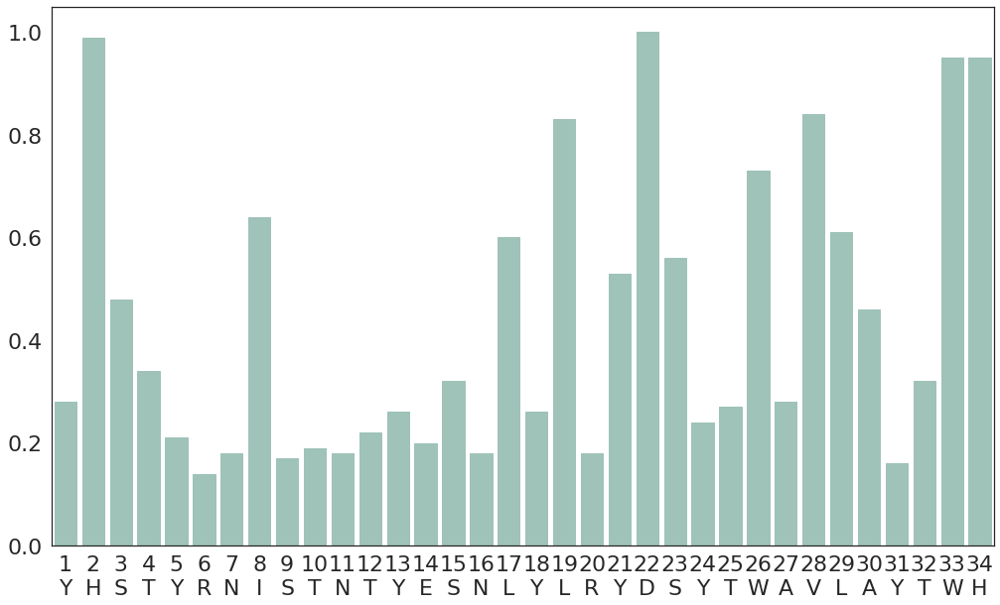

[0.28, 0.99, 0.48, 0.34, 0.21, 0.14, 0.18, 0.64, 0.17, 0.19, 0.18, 0.22, 0.26, 0.2, 0.32, 0.18, 0.6, 0.26, 0.83, 0.18, 0.53, 1.0, 0.56, 0.24, 0.27, 0.73, 0.28, 0.84, 0.61, 0.46, 0.16, 0.32, 0.95, 0.95]

---------------------
#Peptides: 319
HLA: HLA-B*14:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH
threshold: 0.6


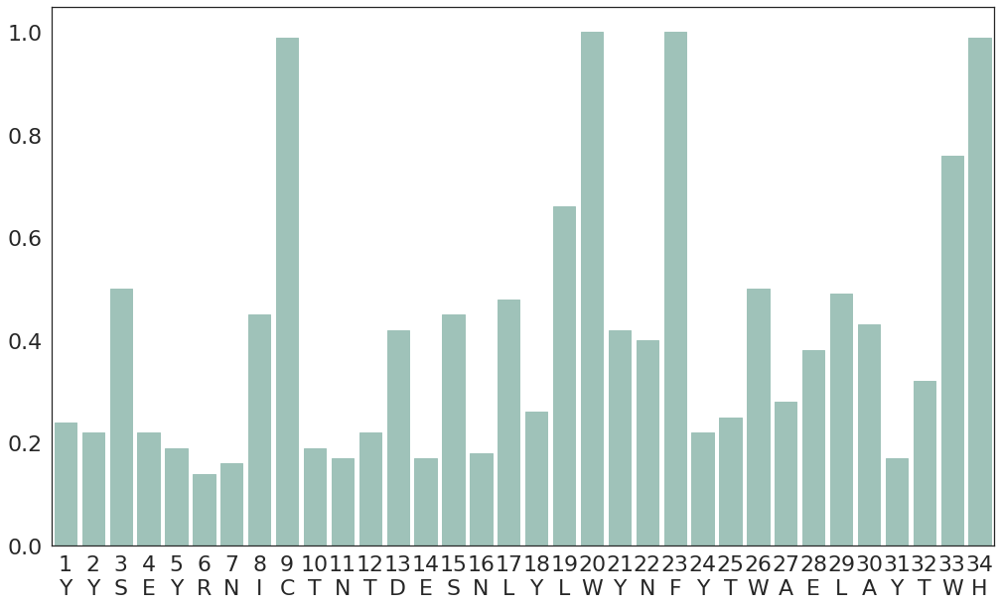

[0.24, 0.22, 0.5, 0.22, 0.19, 0.14, 0.16, 0.45, 0.99, 0.19, 0.17, 0.22, 0.42, 0.17, 0.45, 0.18, 0.48, 0.26, 0.66, 1.0, 0.42, 0.4, 1.0, 0.22, 0.25, 0.5, 0.28, 0.38, 0.49, 0.43, 0.17, 0.32, 0.76, 0.99]

---------------------
#Peptides: 3613
HLA: HLA-B*15:18
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYDSYTWAELAYLWY
threshold: 0.6


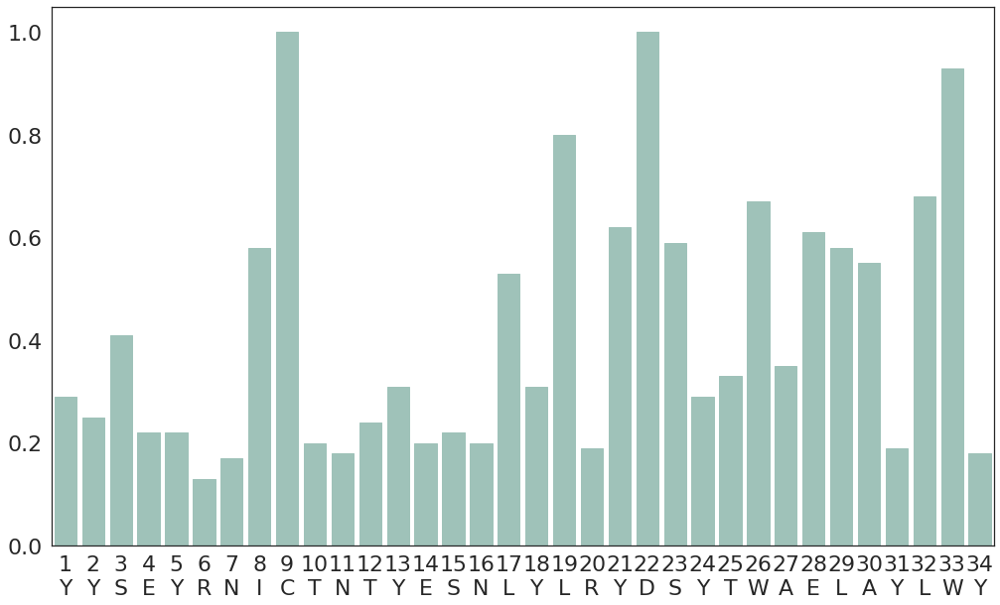

[0.29, 0.25, 0.41, 0.22, 0.22, 0.13, 0.17, 0.58, 1.0, 0.2, 0.18, 0.24, 0.31, 0.2, 0.22, 0.2, 0.53, 0.31, 0.8, 0.19, 0.62, 1.0, 0.59, 0.29, 0.33, 0.67, 0.35, 0.61, 0.58, 0.55, 0.19, 0.68, 0.93, 0.18]

---------------------
#Peptides: 1294
HLA: HLA-A*24:03
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTWY
threshold: 0.6


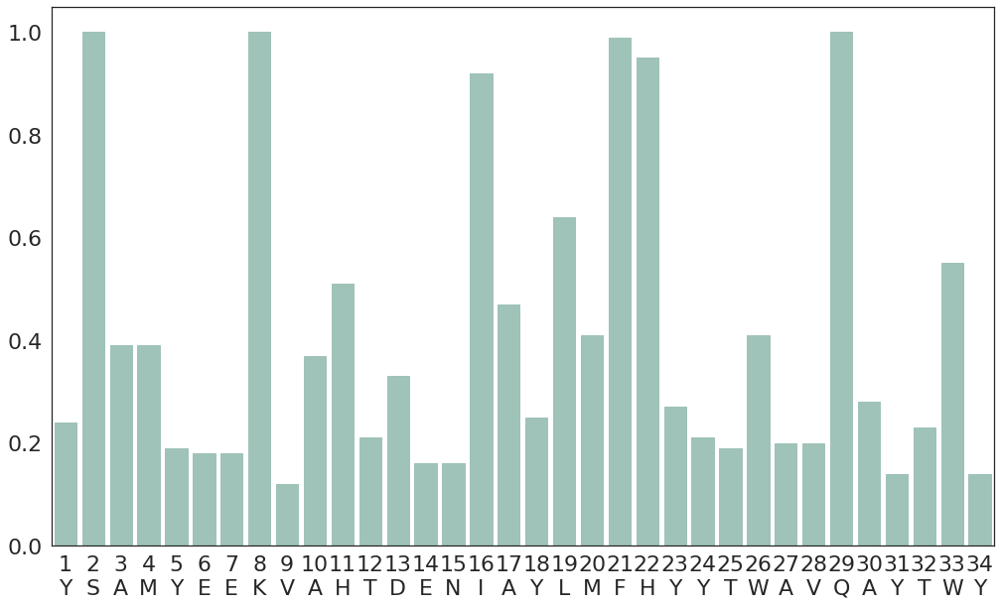

[0.24, 1.0, 0.39, 0.39, 0.19, 0.18, 0.18, 1.0, 0.12, 0.37, 0.51, 0.21, 0.33, 0.16, 0.16, 0.92, 0.47, 0.25, 0.64, 0.41, 0.99, 0.95, 0.27, 0.21, 0.19, 0.41, 0.2, 0.2, 1.0, 0.28, 0.14, 0.23, 0.55, 0.14]

---------------------
#Peptides: 3549
HLA: HLA-A*30:02
Threshold: 0.6
YSAMYQENVAHTDENTLYIIYEHYTWARLAYTWY
threshold: 0.6


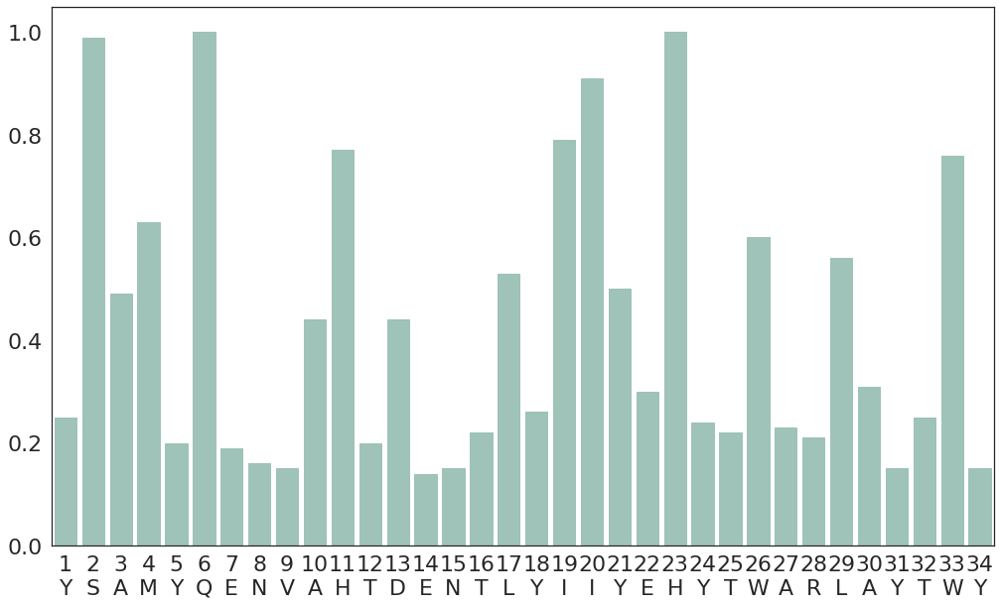

[0.25, 0.99, 0.49, 0.63, 0.2, 1.0, 0.19, 0.16, 0.15, 0.44, 0.77, 0.2, 0.44, 0.14, 0.15, 0.22, 0.53, 0.26, 0.79, 0.91, 0.5, 0.3, 1.0, 0.24, 0.22, 0.6, 0.23, 0.21, 0.56, 0.31, 0.15, 0.25, 0.76, 0.15]

---------------------
#Peptides: 54379
HLA: HLA-B*07:02
Threshold: 0.6
YYSEYRNIYAQTDESNLYLSYDYYTWAERAYEWY
threshold: 0.6


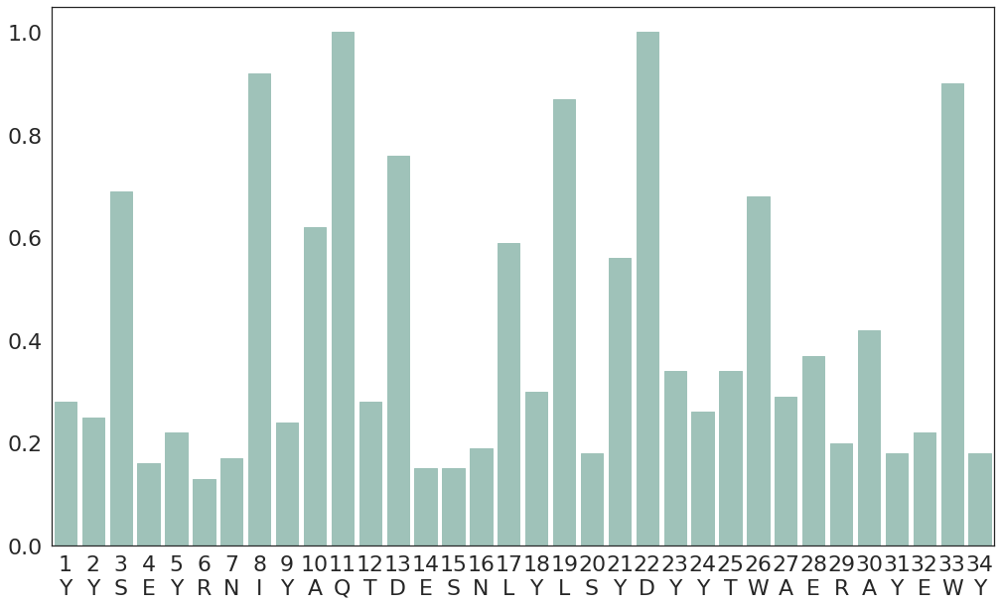

[0.28, 0.25, 0.69, 0.16, 0.22, 0.13, 0.17, 0.92, 0.24, 0.62, 1.0, 0.28, 0.76, 0.15, 0.15, 0.19, 0.59, 0.3, 0.87, 0.18, 0.56, 1.0, 0.34, 0.26, 0.34, 0.68, 0.29, 0.37, 0.2, 0.42, 0.18, 0.22, 0.9, 0.18]

---------------------
#Peptides: 1189
HLA: HLA-B*15:42
Threshold: 0.6
YYAMYREISTNTYESNLYWTYNLYTWAELAYTWY
threshold: 0.6


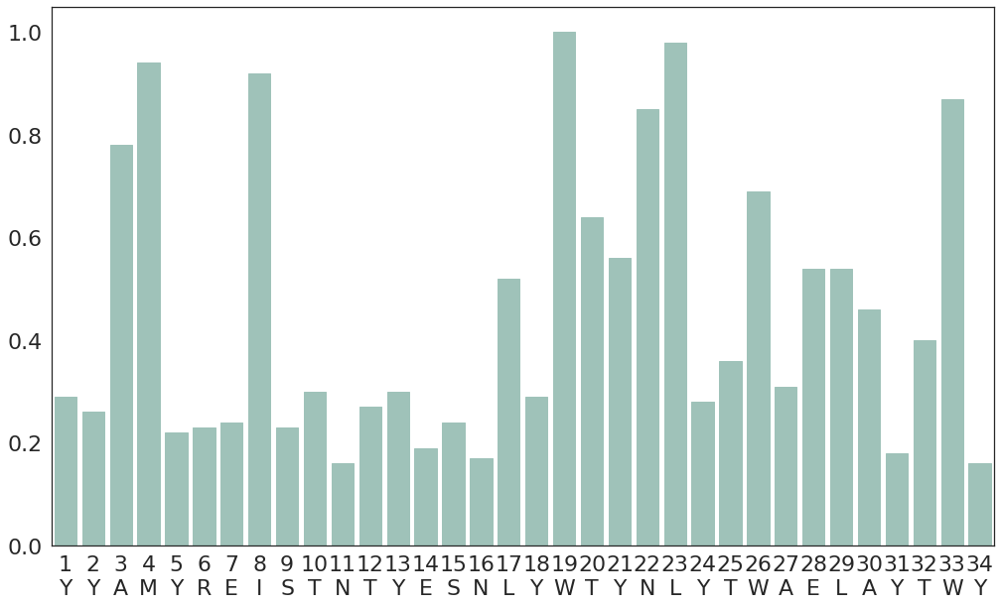

[0.29, 0.26, 0.78, 0.94, 0.22, 0.23, 0.24, 0.92, 0.23, 0.3, 0.16, 0.27, 0.3, 0.19, 0.24, 0.17, 0.52, 0.29, 1.0, 0.64, 0.56, 0.85, 0.98, 0.28, 0.36, 0.69, 0.31, 0.54, 0.54, 0.46, 0.18, 0.4, 0.87, 0.16]

---------------------
#Peptides: 14250
HLA: HLA-A*32:01
Threshold: 0.6
YFAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


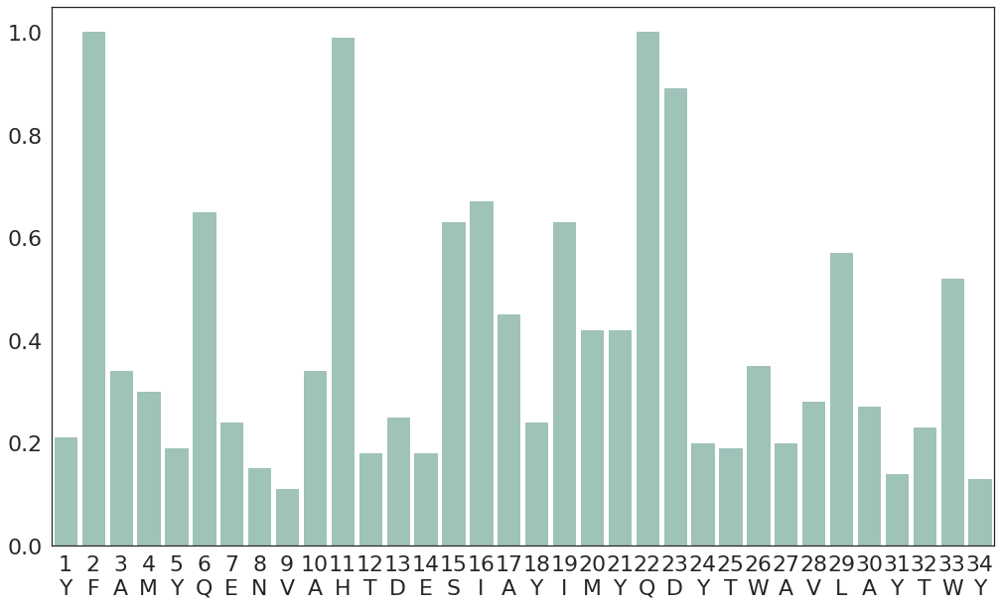

[0.21, 1.0, 0.34, 0.3, 0.19, 0.65, 0.24, 0.15, 0.11, 0.34, 0.99, 0.18, 0.25, 0.18, 0.63, 0.67, 0.45, 0.24, 0.63, 0.42, 0.42, 1.0, 0.89, 0.2, 0.19, 0.35, 0.2, 0.28, 0.57, 0.27, 0.14, 0.23, 0.52, 0.13]

---------------------
#Peptides: 20190
HLA: HLA-C*02:02
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYDSYTWAEWAYEWY
threshold: 0.6


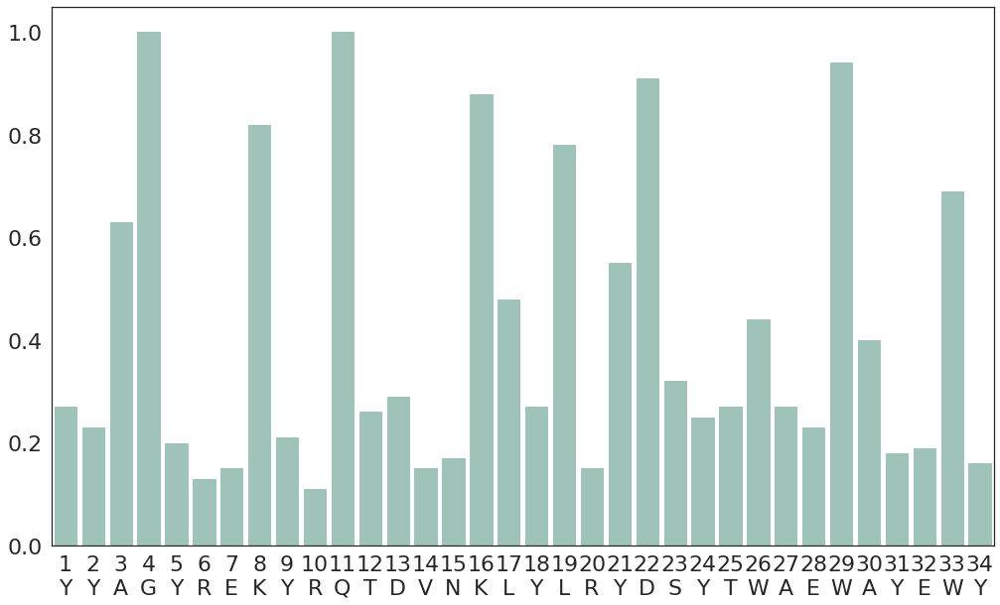

[0.27, 0.23, 0.63, 1.0, 0.2, 0.13, 0.15, 0.82, 0.21, 0.11, 1.0, 0.26, 0.29, 0.15, 0.17, 0.88, 0.48, 0.27, 0.78, 0.15, 0.55, 0.91, 0.32, 0.25, 0.27, 0.44, 0.27, 0.23, 0.94, 0.4, 0.18, 0.19, 0.69, 0.16]

---------------------
#Peptides: 6892
HLA: HLA-B*46:01
Threshold: 0.6
YYAMYREKYRQTDVSNLYLRYDSYTWAEWAYLWY
threshold: 0.6


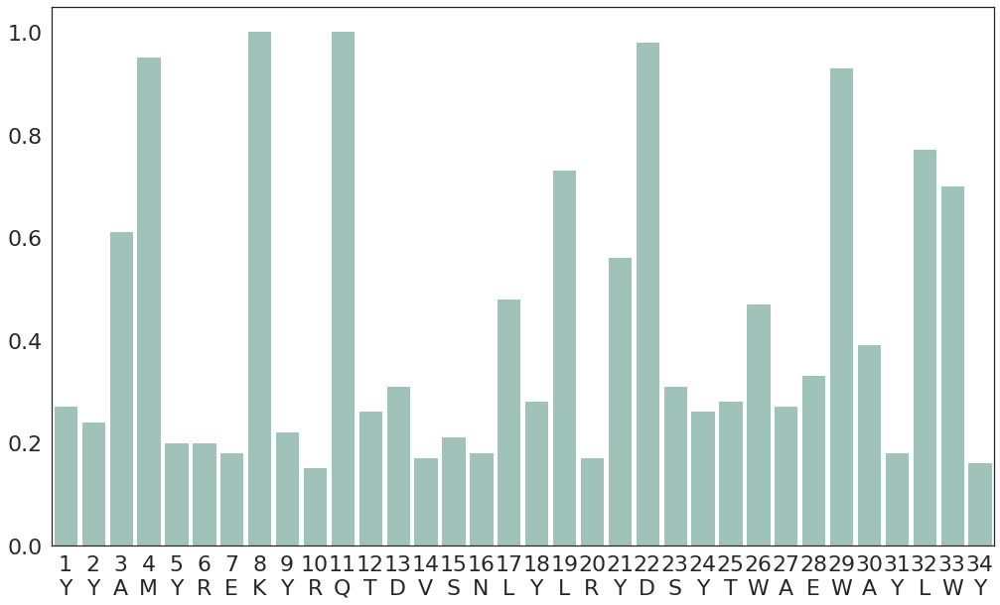

[0.27, 0.24, 0.61, 0.95, 0.2, 0.2, 0.18, 1.0, 0.22, 0.15, 1.0, 0.26, 0.31, 0.17, 0.21, 0.18, 0.48, 0.28, 0.73, 0.17, 0.56, 0.98, 0.31, 0.26, 0.28, 0.47, 0.27, 0.33, 0.93, 0.39, 0.18, 0.77, 0.7, 0.16]

---------------------
#Peptides: 31499
HLA: HLA-B*40:02
Threshold: 0.6
YHTKYREISTNTYESNLYLSYNYYTWAVLAYEWY
threshold: 0.6


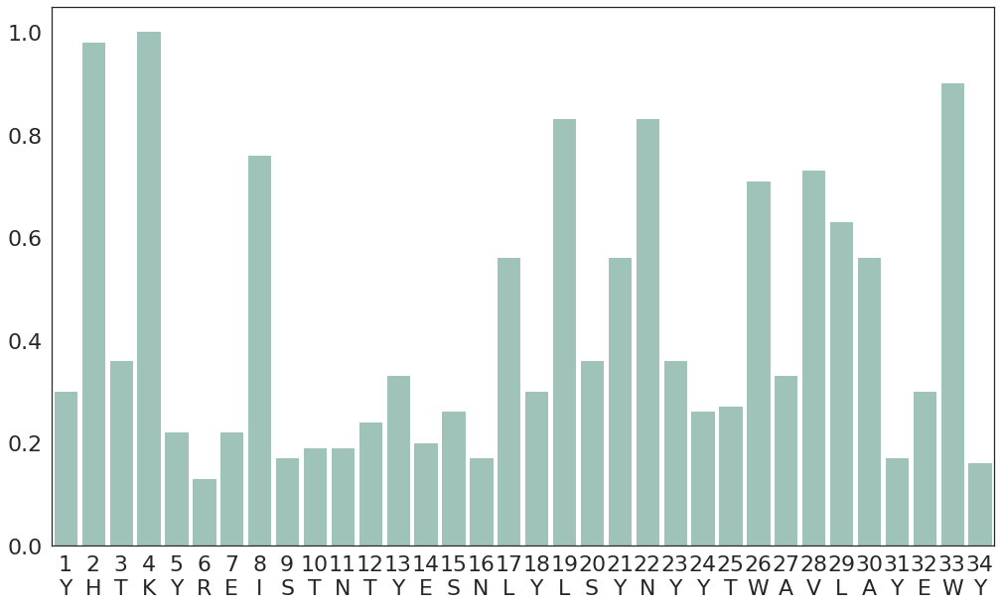

[0.3, 0.98, 0.36, 1.0, 0.22, 0.13, 0.22, 0.76, 0.17, 0.19, 0.19, 0.24, 0.33, 0.2, 0.26, 0.17, 0.56, 0.3, 0.83, 0.36, 0.56, 0.83, 0.36, 0.26, 0.27, 0.71, 0.33, 0.73, 0.63, 0.56, 0.17, 0.3, 0.9, 0.16]

---------------------
#Peptides: 34097
HLA: HLA-A*24:02
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTGY
threshold: 0.6


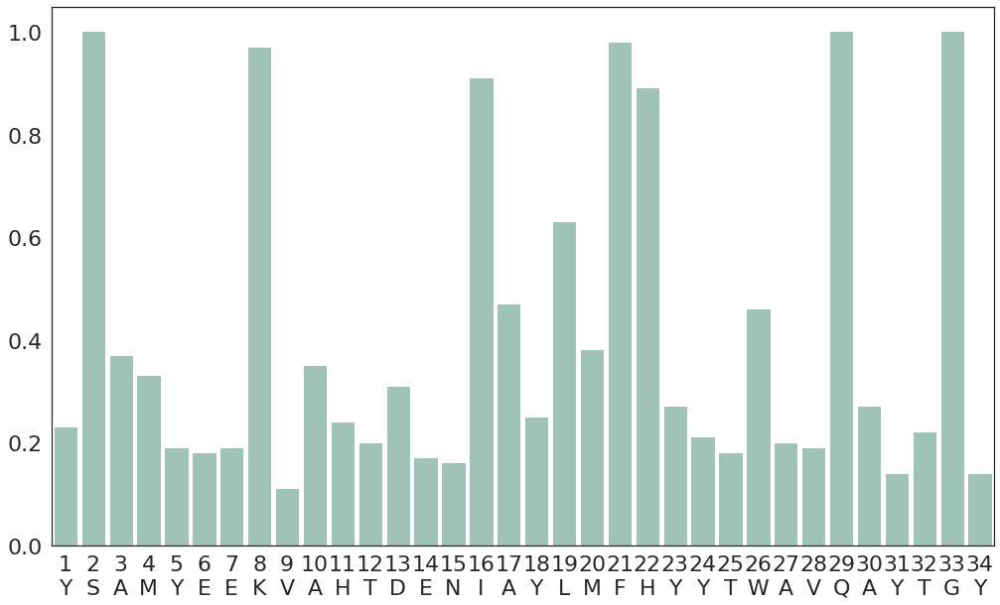

[0.23, 1.0, 0.37, 0.33, 0.19, 0.18, 0.19, 0.97, 0.11, 0.35, 0.24, 0.2, 0.31, 0.17, 0.16, 0.91, 0.47, 0.25, 0.63, 0.38, 0.98, 0.89, 0.27, 0.21, 0.18, 0.46, 0.2, 0.19, 1.0, 0.27, 0.14, 0.22, 1.0, 0.14]

---------------------
#Peptides: 24681
HLA: HLA-B*44:03
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVLAYLSY
threshold: 0.6


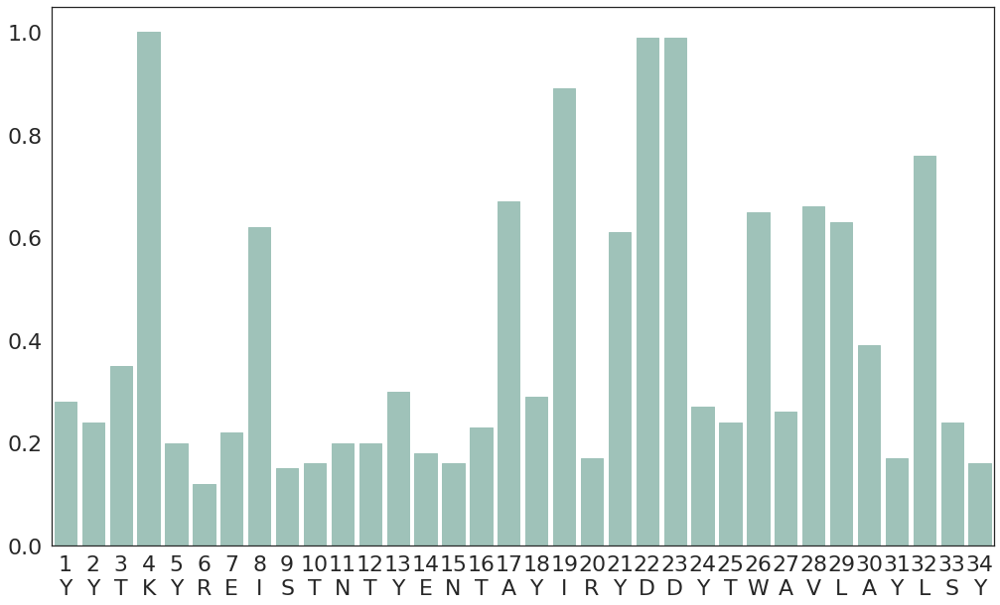

[0.28, 0.24, 0.35, 1.0, 0.2, 0.12, 0.22, 0.62, 0.15, 0.16, 0.2, 0.2, 0.3, 0.18, 0.16, 0.23, 0.67, 0.29, 0.89, 0.17, 0.61, 0.99, 0.99, 0.27, 0.24, 0.65, 0.26, 0.66, 0.63, 0.39, 0.17, 0.76, 0.24, 0.16]

---------------------
#Peptides: 2046
HLA: HLA-B*39:24
Threshold: 0.6
YYSEYRNICTNTDESNLYLSYNFYTWAVLTYTWY
threshold: 0.6


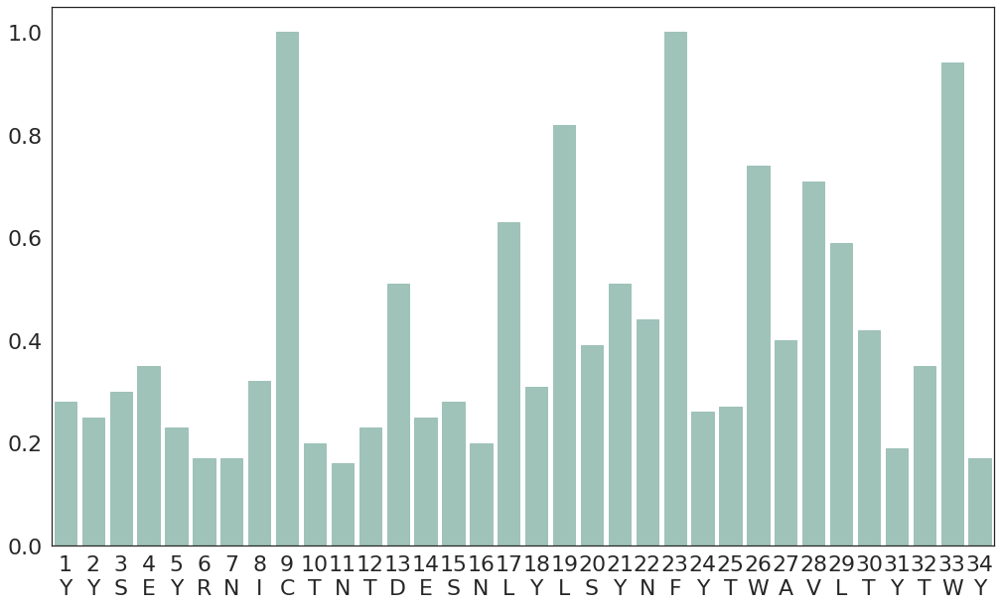

[0.28, 0.25, 0.3, 0.35, 0.23, 0.17, 0.17, 0.32, 1.0, 0.2, 0.16, 0.23, 0.51, 0.25, 0.28, 0.2, 0.63, 0.31, 0.82, 0.39, 0.51, 0.44, 1.0, 0.26, 0.27, 0.74, 0.4, 0.71, 0.59, 0.42, 0.19, 0.35, 0.94, 0.17]

---------------------
#Peptides: 1378
HLA: HLA-A*02:11
Threshold: 0.6
YFAMYGEKVAHIDVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


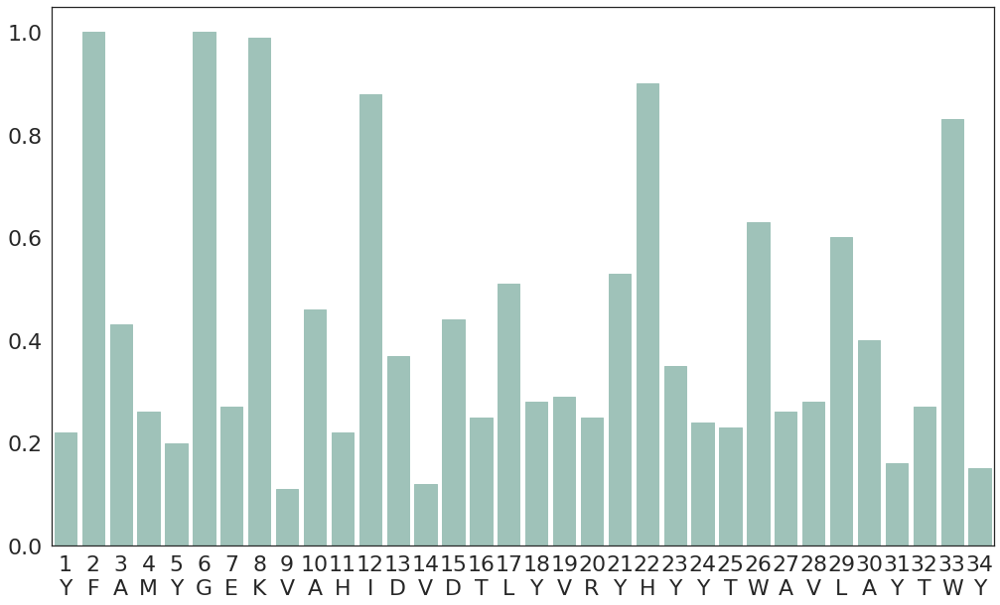

[0.22, 1.0, 0.43, 0.26, 0.2, 1.0, 0.27, 0.99, 0.11, 0.46, 0.22, 0.88, 0.37, 0.12, 0.44, 0.25, 0.51, 0.28, 0.29, 0.25, 0.53, 0.9, 0.35, 0.24, 0.23, 0.63, 0.26, 0.28, 0.6, 0.4, 0.16, 0.27, 0.83, 0.15]

---------------------
#Peptides: 5611
HLA: HLA-A*02:04
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVMYHYYTWAVLAYTWY
threshold: 0.6


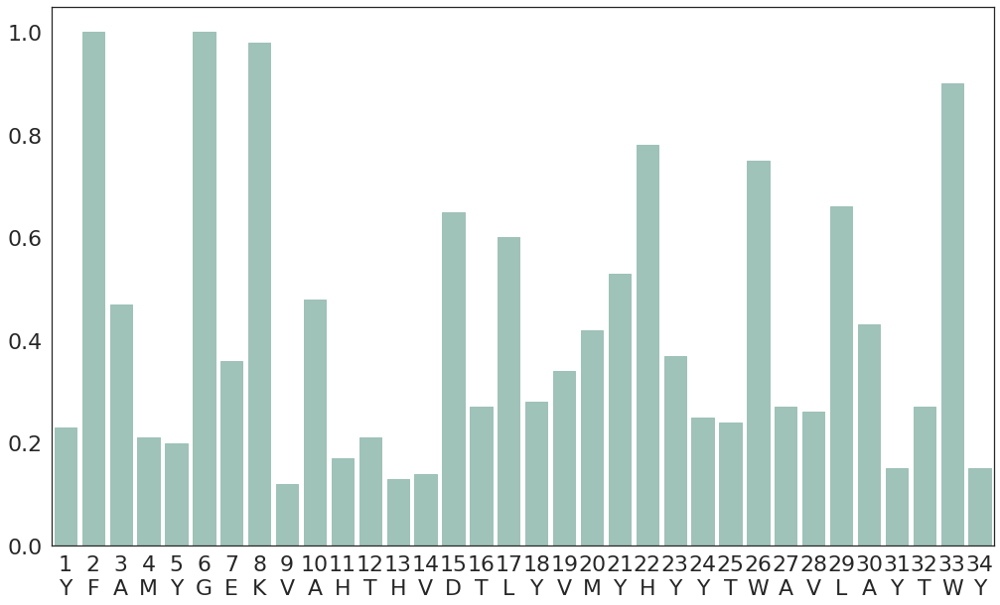

[0.23, 1.0, 0.47, 0.21, 0.2, 1.0, 0.36, 0.98, 0.12, 0.48, 0.17, 0.21, 0.13, 0.14, 0.65, 0.27, 0.6, 0.28, 0.34, 0.42, 0.53, 0.78, 0.37, 0.25, 0.24, 0.75, 0.27, 0.26, 0.66, 0.43, 0.15, 0.27, 0.9, 0.15]

---------------------
#Peptides: 8826
HLA: HLA-C*14:02
Threshold: 0.6
YSAGYREKYRQTDVSNLYLWFDSYTWAERAYTWY
threshold: 0.6


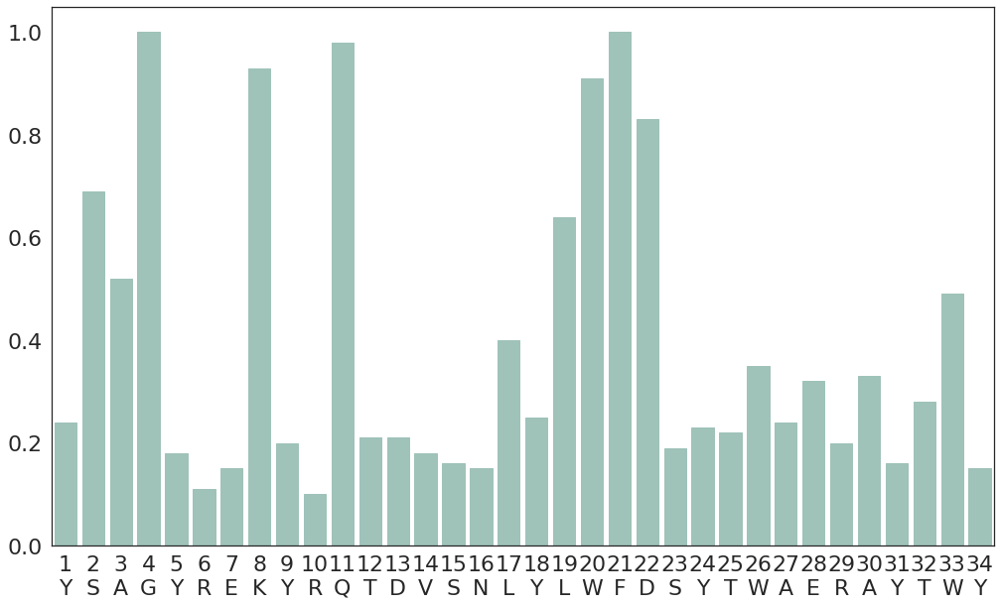

[0.24, 0.69, 0.52, 1.0, 0.18, 0.11, 0.15, 0.93, 0.2, 0.1, 0.98, 0.21, 0.21, 0.18, 0.16, 0.15, 0.4, 0.25, 0.64, 0.91, 1.0, 0.83, 0.19, 0.23, 0.22, 0.35, 0.24, 0.32, 0.2, 0.33, 0.16, 0.28, 0.49, 0.15]

---------------------
#Peptides: 23876
HLA: HLA-B*08:01
Threshold: 0.6
YDSEYRNIFTNTDESNLYLSYNYYTWAVDAYTWY
threshold: 0.6


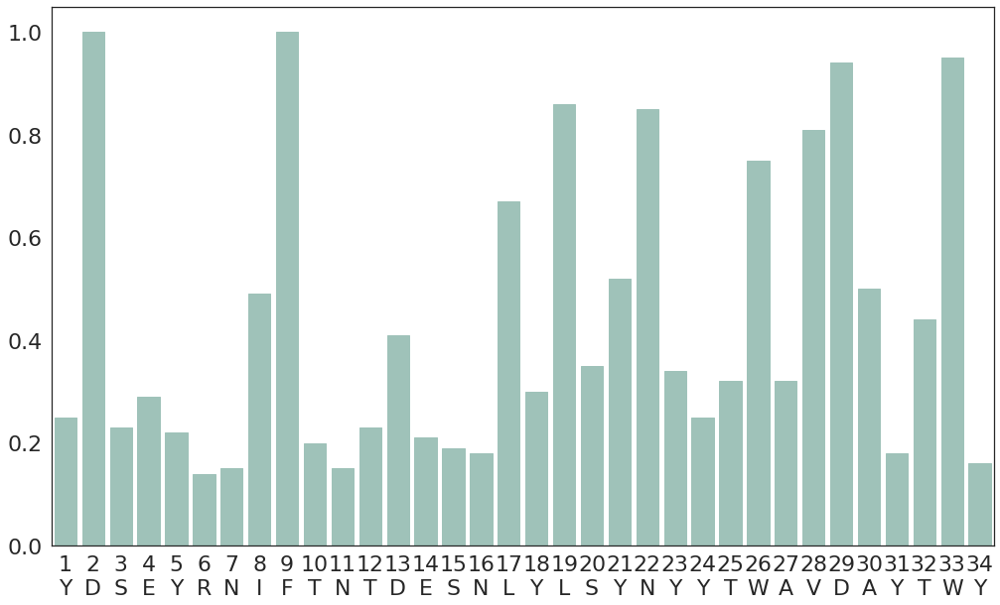

[0.25, 1.0, 0.23, 0.29, 0.22, 0.14, 0.15, 0.49, 1.0, 0.2, 0.15, 0.23, 0.41, 0.21, 0.19, 0.18, 0.67, 0.3, 0.86, 0.35, 0.52, 0.85, 0.34, 0.25, 0.32, 0.75, 0.32, 0.81, 0.94, 0.5, 0.18, 0.44, 0.95, 0.16]

---------------------
#Peptides: 294
HLA: HLA-A*32:07
Threshold: 0.6
YSAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


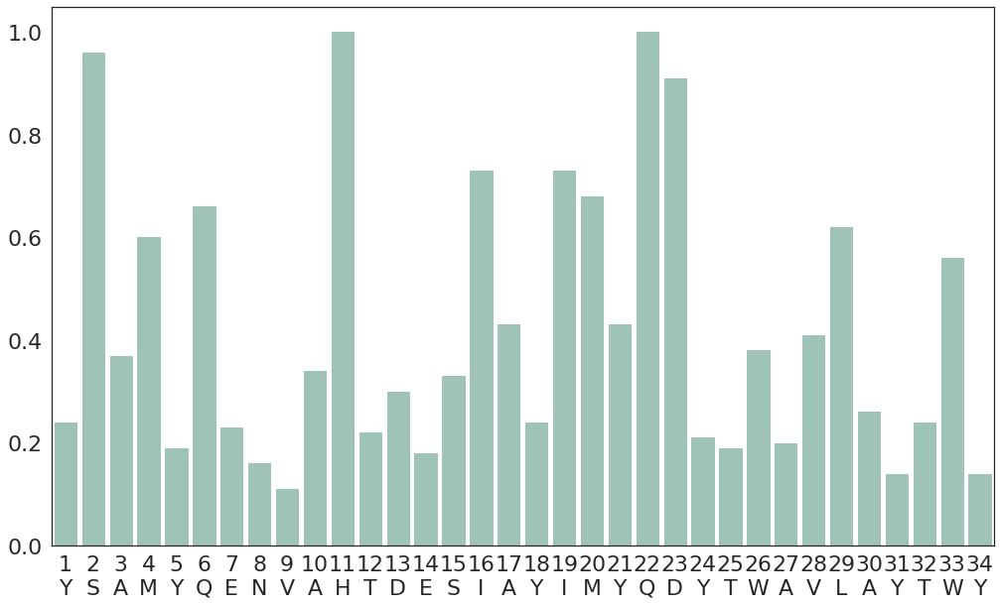

[0.24, 0.96, 0.37, 0.6, 0.19, 0.66, 0.23, 0.16, 0.11, 0.34, 1.0, 0.22, 0.3, 0.18, 0.33, 0.73, 0.43, 0.24, 0.73, 0.68, 0.43, 1.0, 0.91, 0.21, 0.19, 0.38, 0.2, 0.41, 0.62, 0.26, 0.14, 0.24, 0.56, 0.14]

---------------------
#Peptides: 2751
HLA: HLA-B*53:01
Threshold: 0.6
YYATYRNIFTNTYENIAYIRYDSYTWAVLAYLWY
threshold: 0.6


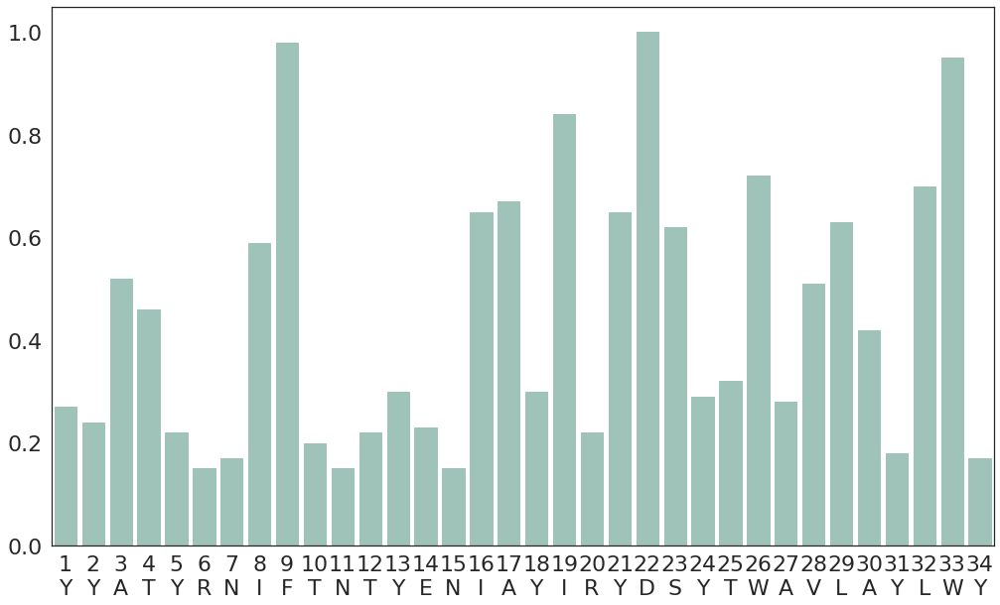

[0.27, 0.24, 0.52, 0.46, 0.22, 0.15, 0.17, 0.59, 0.98, 0.2, 0.15, 0.22, 0.3, 0.23, 0.15, 0.65, 0.67, 0.3, 0.84, 0.22, 0.65, 1.0, 0.62, 0.29, 0.32, 0.72, 0.28, 0.51, 0.63, 0.42, 0.18, 0.7, 0.95, 0.17]

---------------------
#Peptides: 1916
HLA: HLA-B*51:08
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAVDAYLWH
threshold: 0.6


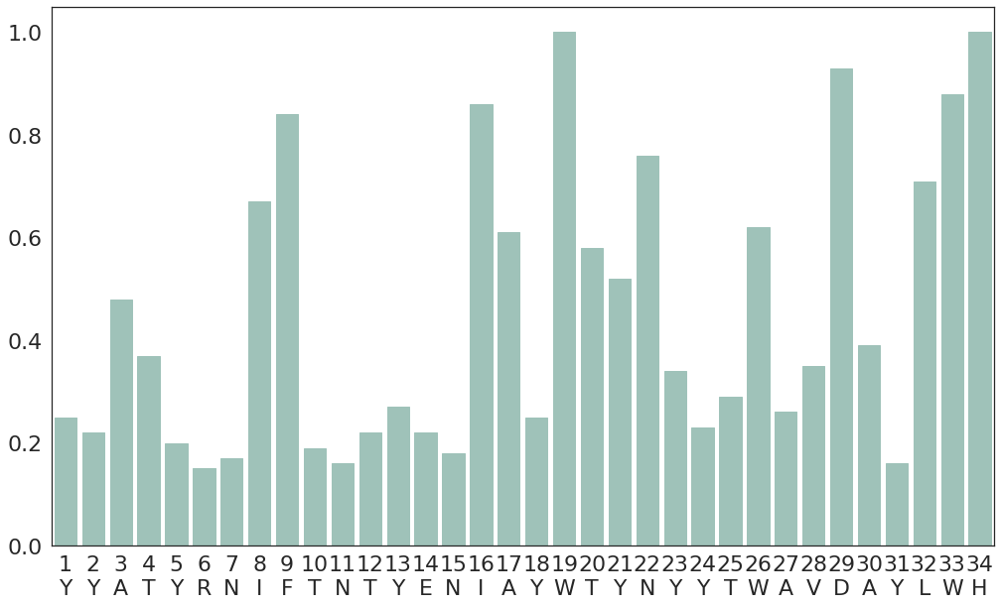

[0.25, 0.22, 0.48, 0.37, 0.2, 0.15, 0.17, 0.67, 0.84, 0.19, 0.16, 0.22, 0.27, 0.22, 0.18, 0.86, 0.61, 0.25, 1.0, 0.58, 0.52, 0.76, 0.34, 0.23, 0.29, 0.62, 0.26, 0.35, 0.93, 0.39, 0.16, 0.71, 0.88, 1.0]

---------------------
#Peptides: 5301
HLA: HLA-B*39:06
Threshold: 0.6
YYSEYRNICTNTDESNLYWTYNFYTWAVLTYTWY
threshold: 0.6


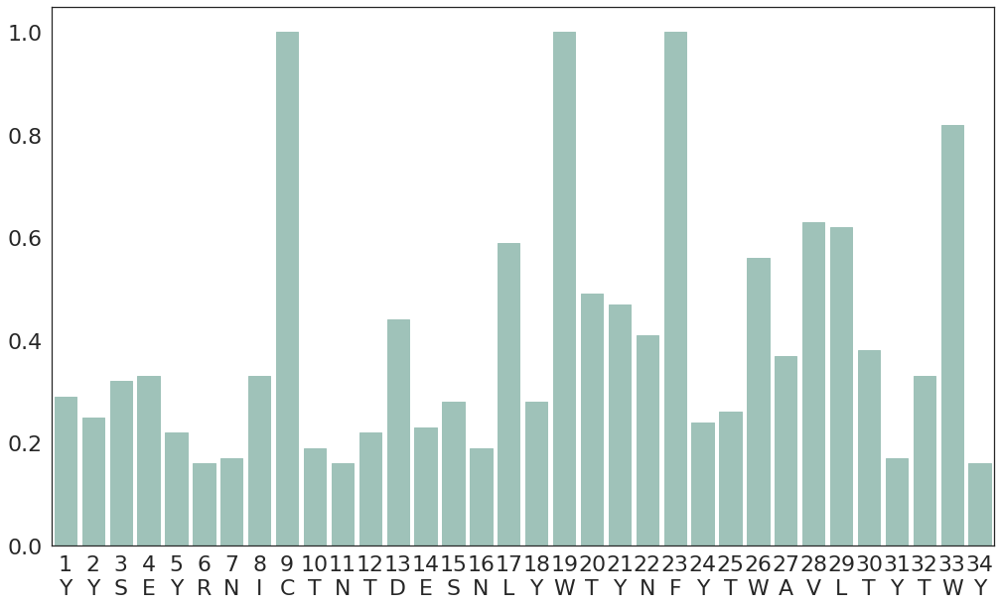

[0.29, 0.25, 0.32, 0.33, 0.22, 0.16, 0.17, 0.33, 1.0, 0.19, 0.16, 0.22, 0.44, 0.23, 0.28, 0.19, 0.59, 0.28, 1.0, 0.49, 0.47, 0.41, 1.0, 0.24, 0.26, 0.56, 0.37, 0.63, 0.62, 0.38, 0.17, 0.33, 0.82, 0.16]

---------------------
#Peptides: 269
HLA: HLA-A*68:23
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYRDYTWAVWAYTWY
threshold: 0.6


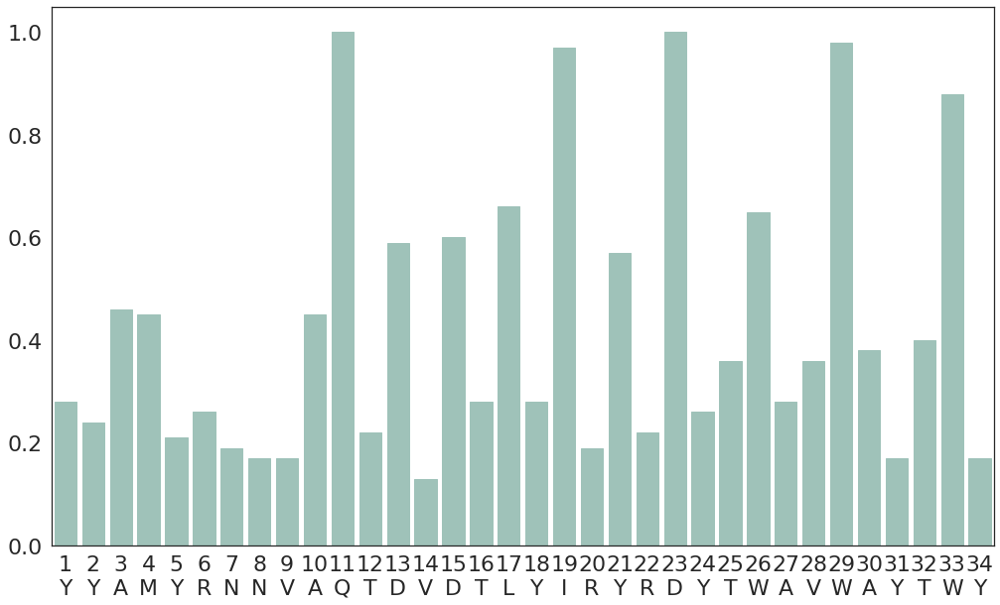

[0.28, 0.24, 0.46, 0.45, 0.21, 0.26, 0.19, 0.17, 0.17, 0.45, 1.0, 0.22, 0.59, 0.13, 0.6, 0.28, 0.66, 0.28, 0.97, 0.19, 0.57, 0.22, 1.0, 0.26, 0.36, 0.65, 0.28, 0.36, 0.98, 0.38, 0.17, 0.4, 0.88, 0.17]

---------------------
#Peptides: 24701
HLA: HLA-A*29:02
Threshold: 0.6
YTAMYLQNVAQTDANTLYIMYRDYTWAVLAYTWY
threshold: 0.6


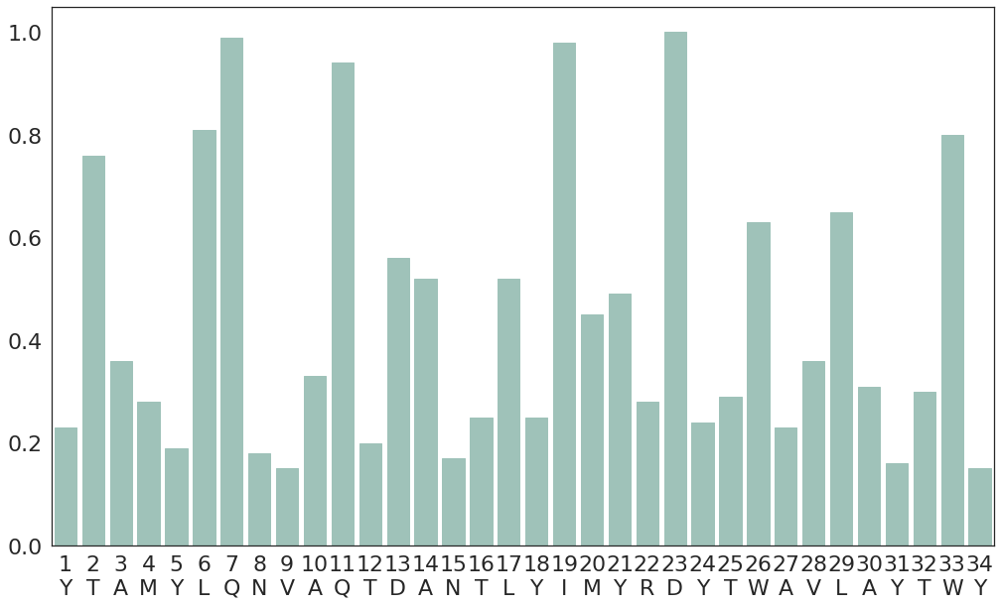

[0.23, 0.76, 0.36, 0.28, 0.19, 0.81, 0.99, 0.18, 0.15, 0.33, 0.94, 0.2, 0.56, 0.52, 0.17, 0.25, 0.52, 0.25, 0.98, 0.45, 0.49, 0.28, 1.0, 0.24, 0.29, 0.63, 0.23, 0.36, 0.65, 0.31, 0.16, 0.3, 0.8, 0.15]

---------------------
#Peptides: 3100
HLA: HLA-B*15:11
Threshold: 0.6
YYAMYRNIYTNTYESNLYLRYDSYTWAEWAYLWY
threshold: 0.6


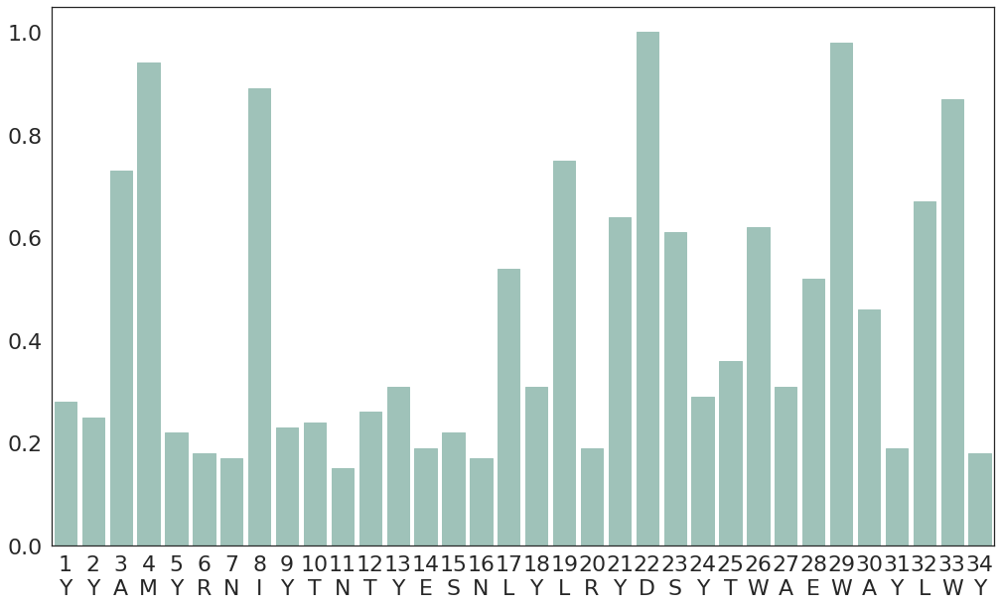

[0.28, 0.25, 0.73, 0.94, 0.22, 0.18, 0.17, 0.89, 0.23, 0.24, 0.15, 0.26, 0.31, 0.19, 0.22, 0.17, 0.54, 0.31, 0.75, 0.19, 0.64, 1.0, 0.61, 0.29, 0.36, 0.62, 0.31, 0.52, 0.98, 0.46, 0.19, 0.67, 0.87, 0.18]

---------------------
#Peptides: 19287
HLA: HLA-A*31:01
Threshold: 0.6
YTAMYQENVAHIDVDTLYIMYQDYTWAVLAYTWY
threshold: 0.6


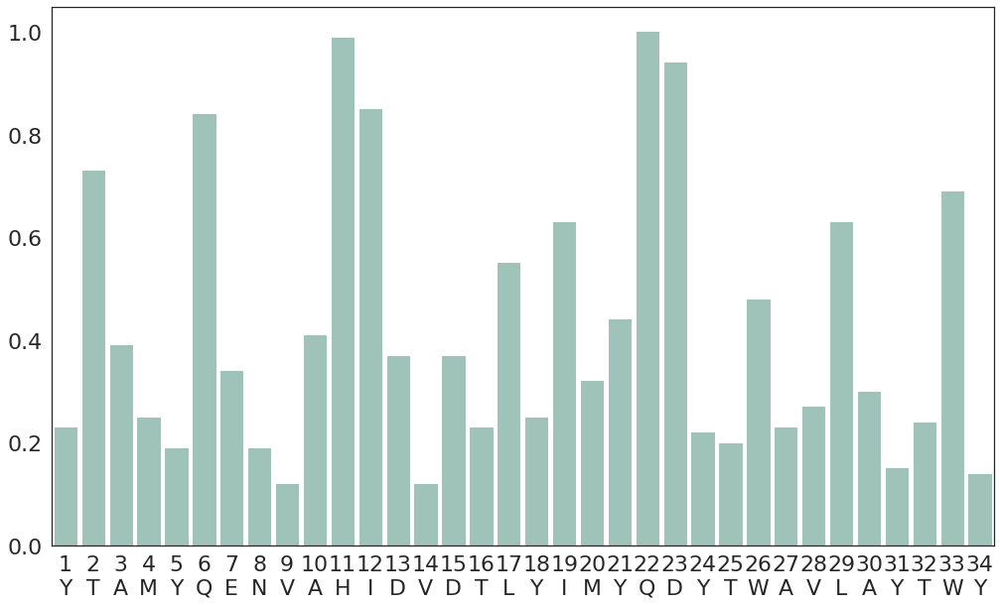

[0.23, 0.73, 0.39, 0.25, 0.19, 0.84, 0.34, 0.19, 0.12, 0.41, 0.99, 0.85, 0.37, 0.12, 0.37, 0.23, 0.55, 0.25, 0.63, 0.32, 0.44, 1.0, 0.94, 0.22, 0.2, 0.48, 0.23, 0.27, 0.63, 0.3, 0.15, 0.24, 0.69, 0.14]

---------------------
#Peptides: 10709
HLA: HLA-B*27:02
Threshold: 0.6
YHTEYREICAKTDENIAYLNYHDYTWAVLAYEWY
threshold: 0.6


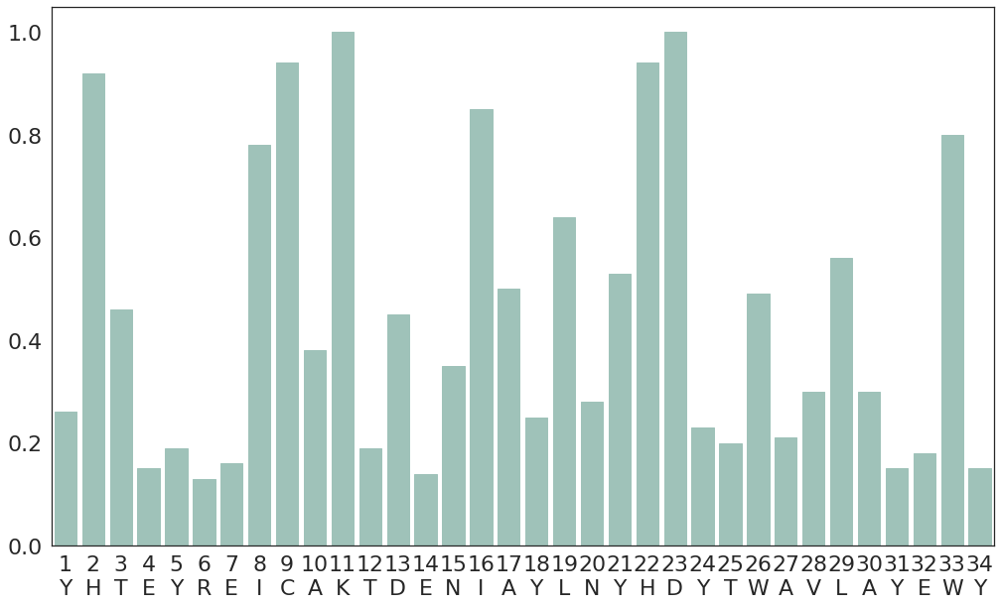

[0.26, 0.92, 0.46, 0.15, 0.19, 0.13, 0.16, 0.78, 0.94, 0.38, 1.0, 0.19, 0.45, 0.14, 0.35, 0.85, 0.5, 0.25, 0.64, 0.28, 0.53, 0.94, 1.0, 0.23, 0.2, 0.49, 0.21, 0.3, 0.56, 0.3, 0.15, 0.18, 0.8, 0.15]

---------------------


"\npos: 25 || {'T', 'S'} || Counter({'T': 109, 'S': 3})      \n# S in pos 25: HLA-B*40:01, HLA-C*17:01, HLA-B*48:01: 0.49, 0.49, \n\n\npos: 26 || {'L', 'W'} || Counter({'W': 106, 'L': 6}) \n"

In [30]:
col_mean_per_HLA = dict()
col_mean_per_HLA_softmax = dict()
max_list_all = []
for HLA_filter in HLA_list:
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position_HLApseudo(17, 10, '#9fc2b9', df_pd_nested_test_unique.reset_index(drop=True), enc_hla_attn_list_all, n_heads, HLA_filter, 34, softmax_dim = 0, label = 0, length = None , threshold = 0.60, show = 'bar', top = False, softmax = True, unsoftmax = True )    
    print(max_list)
    max_list_all.append(max_list)
    print(color.END + '')
    col_mean_per_HLA[HLA_filter] =  unsoftmax_pd.max(axis=0).tolist()
    col_mean_per_HLA_softmax[HLA_filter] =  softmax_pd.max(axis=0).tolist()
    print("---------------------")


#Peptides: 3973
HLA: HLA-B*39:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLRYNFYTWAVLTYTWY
threshold: 0.6


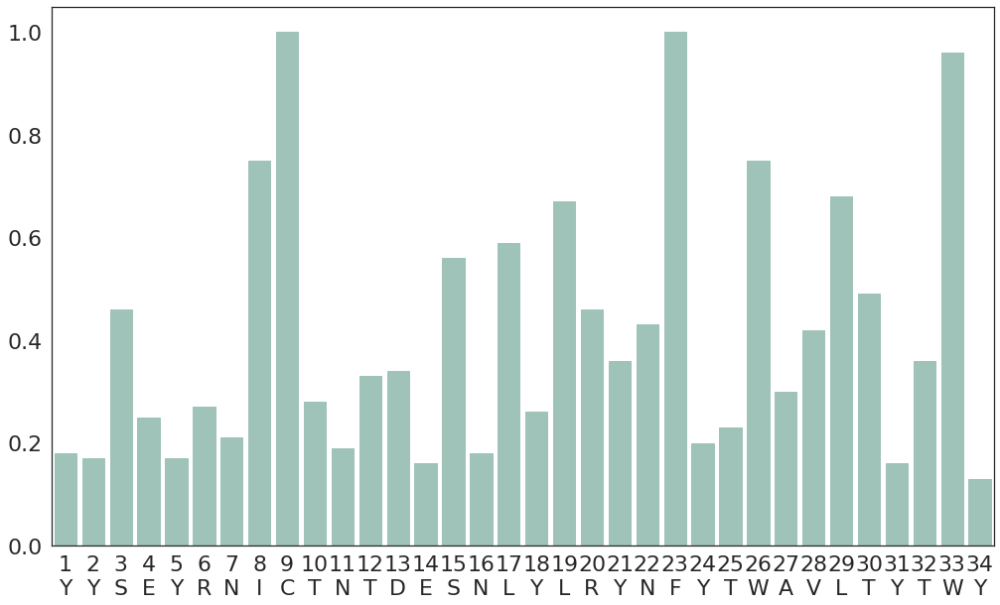

[0.18, 0.17, 0.46, 0.25, 0.17, 0.27, 0.21, 0.75, 1.0, 0.28, 0.19, 0.33, 0.34, 0.16, 0.56, 0.18, 0.59, 0.26, 0.67, 0.46, 0.36, 0.43, 1.0, 0.2, 0.23, 0.75, 0.3, 0.42, 0.68, 0.49, 0.16, 0.36, 0.96, 0.13]

---------------------
#Peptides: 845
HLA: HLA-A*30:02
Threshold: 0.6
YSAMYQENVAHTDENTLYIIYEHYTWARLAYTWY
threshold: 0.6


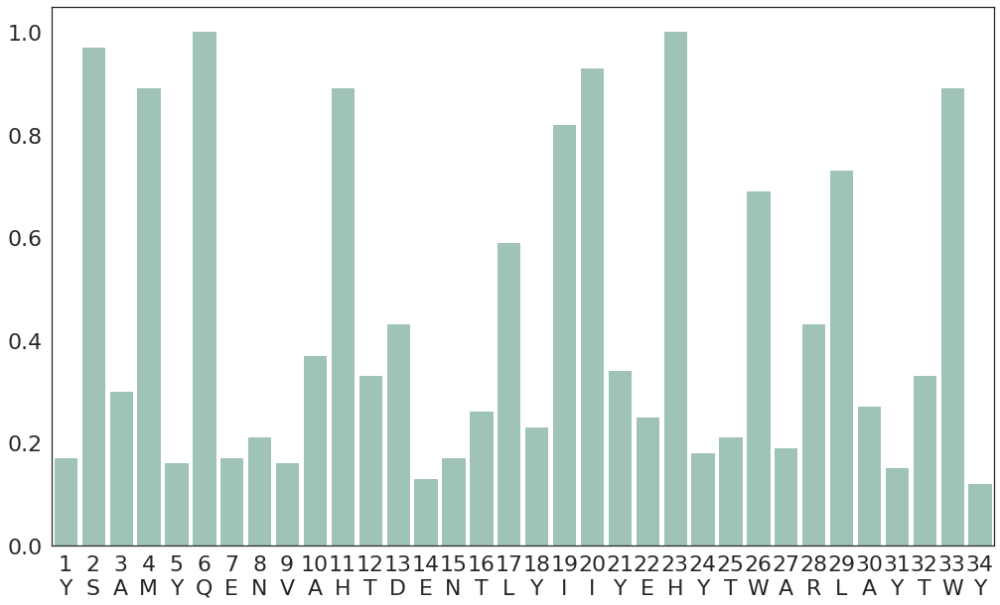

[0.17, 0.97, 0.3, 0.89, 0.16, 1.0, 0.17, 0.21, 0.16, 0.37, 0.89, 0.33, 0.43, 0.13, 0.17, 0.26, 0.59, 0.23, 0.82, 0.93, 0.34, 0.25, 1.0, 0.18, 0.21, 0.69, 0.19, 0.43, 0.73, 0.27, 0.15, 0.33, 0.89, 0.12]

---------------------
#Peptides: 152
HLA: HLA-A*02:16
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYEWY
threshold: 0.6


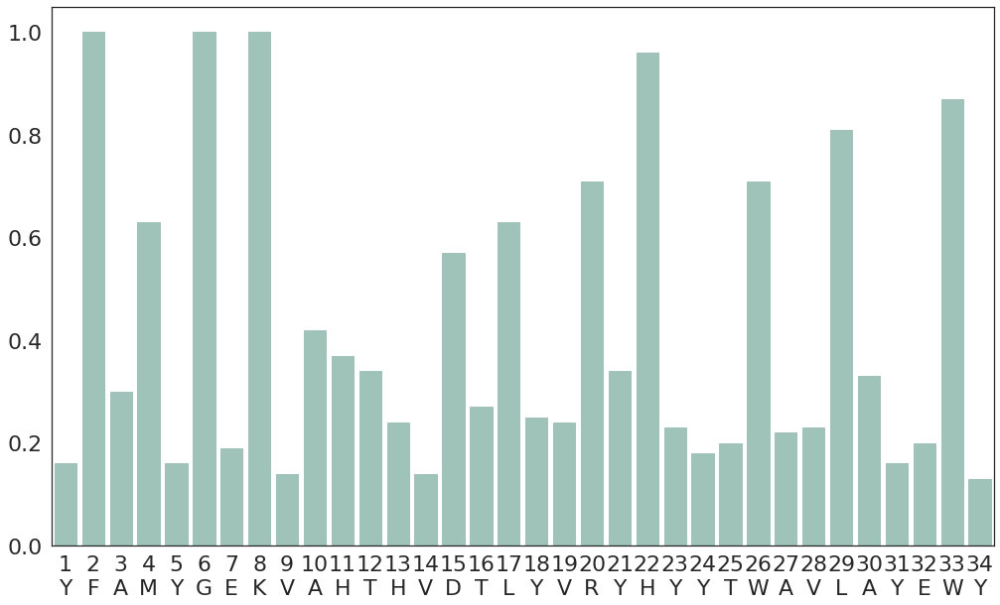

[0.16, 1.0, 0.3, 0.63, 0.16, 1.0, 0.19, 1.0, 0.14, 0.42, 0.37, 0.34, 0.24, 0.14, 0.57, 0.27, 0.63, 0.25, 0.24, 0.71, 0.34, 0.96, 0.23, 0.18, 0.2, 0.71, 0.22, 0.23, 0.81, 0.33, 0.16, 0.2, 0.87, 0.13]

---------------------
#Peptides: 8477
HLA: HLA-A*01:01
Threshold: 0.6
YFAMYQENMAHTDANTLYIIYRDYTWVARVYRGY
threshold: 0.6


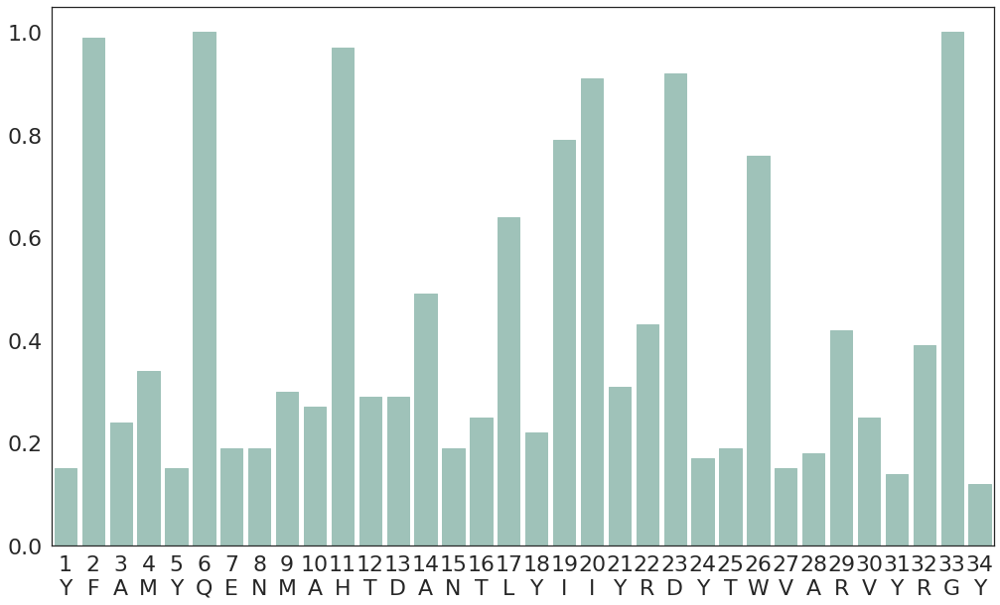

[0.15, 0.99, 0.24, 0.34, 0.15, 1.0, 0.19, 0.19, 0.3, 0.27, 0.97, 0.29, 0.29, 0.49, 0.19, 0.25, 0.64, 0.22, 0.79, 0.91, 0.31, 0.43, 0.92, 0.17, 0.19, 0.76, 0.15, 0.18, 0.42, 0.25, 0.14, 0.39, 1.0, 0.12]

---------------------
#Peptides: 10623
HLA: HLA-A*03:01
Threshold: 0.6
YFAMYQENVAQTDVDTLYIIYRDYTWAELAYTWY
threshold: 0.6


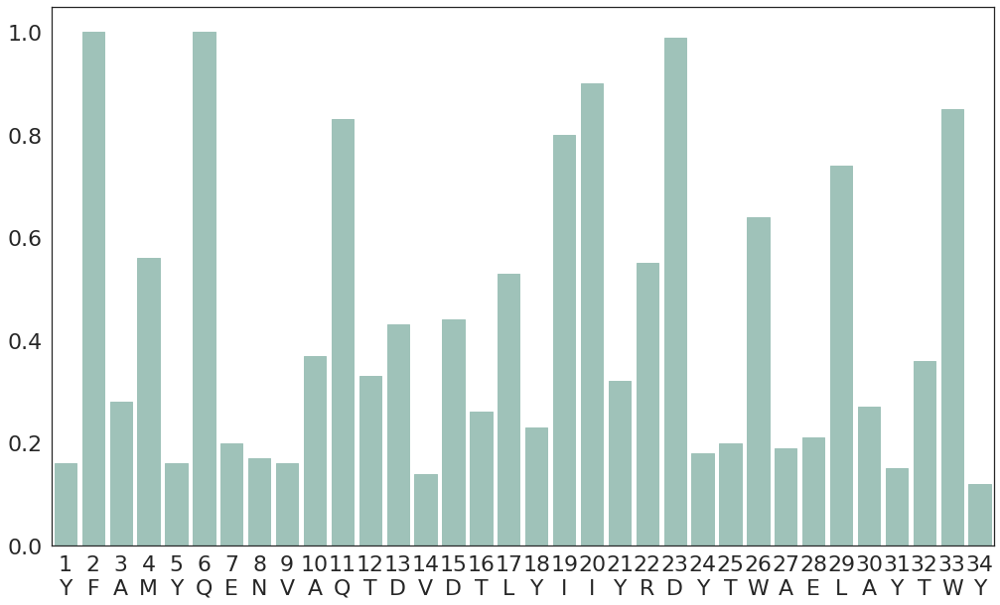

[0.16, 1.0, 0.28, 0.56, 0.16, 1.0, 0.2, 0.17, 0.16, 0.37, 0.83, 0.33, 0.43, 0.14, 0.44, 0.26, 0.53, 0.23, 0.8, 0.9, 0.32, 0.55, 0.99, 0.18, 0.2, 0.64, 0.19, 0.21, 0.74, 0.27, 0.15, 0.36, 0.85, 0.12]

---------------------
#Peptides: 5888
HLA: HLA-A*29:02
Threshold: 0.6
YTAMYLQNVAQTDANTLYIMYRDYTWAVLAYTWY
threshold: 0.6


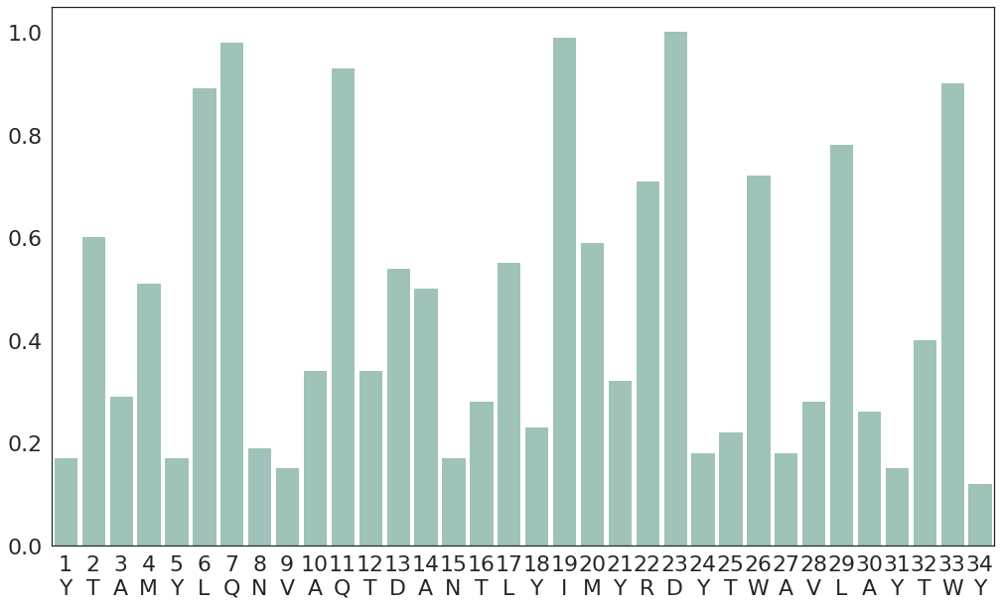

[0.17, 0.6, 0.29, 0.51, 0.17, 0.89, 0.98, 0.19, 0.15, 0.34, 0.93, 0.34, 0.54, 0.5, 0.17, 0.28, 0.55, 0.23, 0.99, 0.59, 0.32, 0.71, 1.0, 0.18, 0.22, 0.72, 0.18, 0.28, 0.78, 0.26, 0.15, 0.4, 0.9, 0.12]

---------------------
#Peptides: 738
HLA: HLA-B*15:11
Threshold: 0.6
YYAMYRNIYTNTYESNLYLRYDSYTWAEWAYLWY
threshold: 0.6


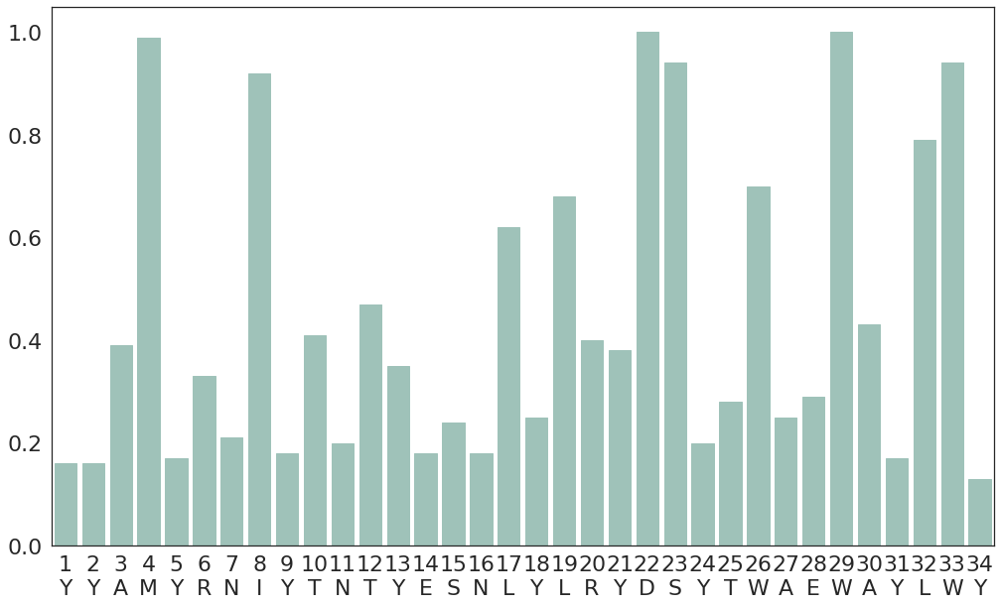

[0.16, 0.16, 0.39, 0.99, 0.17, 0.33, 0.21, 0.92, 0.18, 0.41, 0.2, 0.47, 0.35, 0.18, 0.24, 0.18, 0.62, 0.25, 0.68, 0.4, 0.38, 1.0, 0.94, 0.2, 0.28, 0.7, 0.25, 0.29, 1.0, 0.43, 0.17, 0.79, 0.94, 0.13]

---------------------
#Peptides: 8542
HLA: HLA-C*04:01
Threshold: 0.6
YSAGYREKYRQADVNKLYLRFNFYTWAERAYTWY
threshold: 0.6


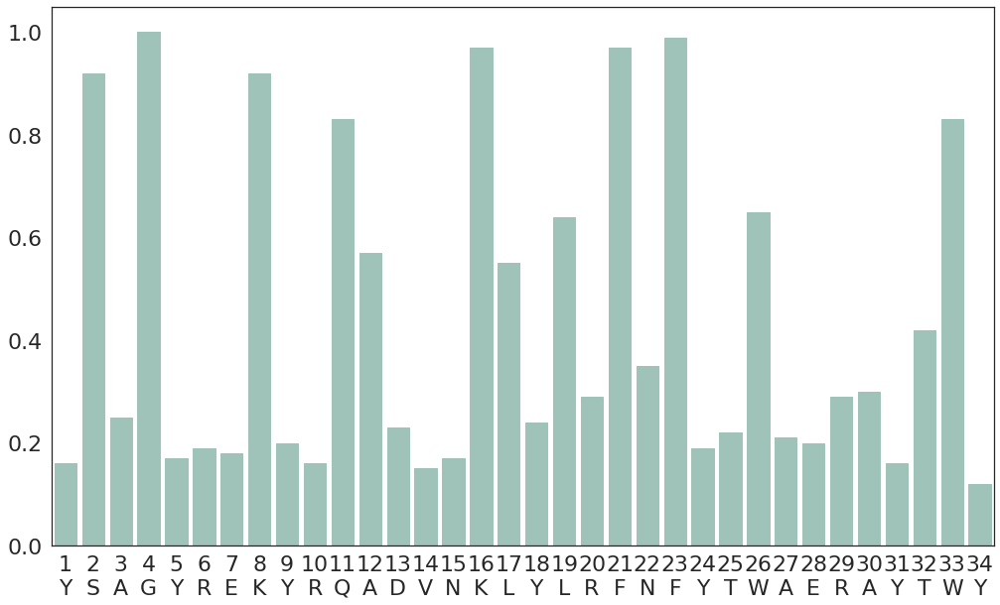

[0.16, 0.92, 0.25, 1.0, 0.17, 0.19, 0.18, 0.92, 0.2, 0.16, 0.83, 0.57, 0.23, 0.15, 0.17, 0.97, 0.55, 0.24, 0.64, 0.29, 0.97, 0.35, 0.99, 0.19, 0.22, 0.65, 0.21, 0.2, 0.29, 0.3, 0.16, 0.42, 0.83, 0.12]

---------------------
#Peptides: 4023
HLA: HLA-C*03:04
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY
threshold: 0.6


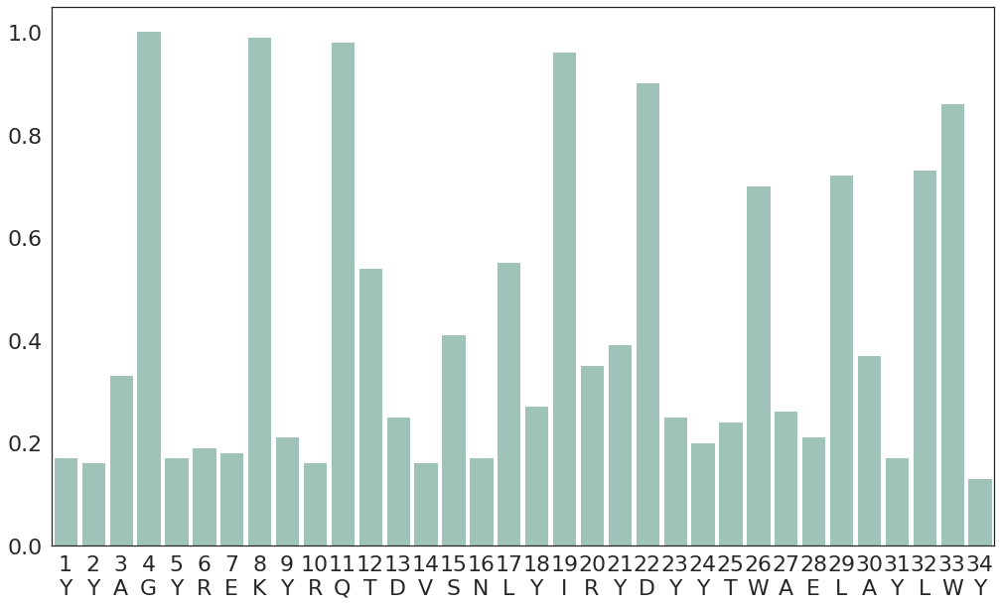

[0.17, 0.16, 0.33, 1.0, 0.17, 0.19, 0.18, 0.99, 0.21, 0.16, 0.98, 0.54, 0.25, 0.16, 0.41, 0.17, 0.55, 0.27, 0.96, 0.35, 0.39, 0.9, 0.25, 0.2, 0.24, 0.7, 0.26, 0.21, 0.72, 0.37, 0.17, 0.73, 0.86, 0.13]

---------------------
#Peptides: 64
HLA: HLA-A*68:23
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYRDYTWAVWAYTWY
threshold: 0.6


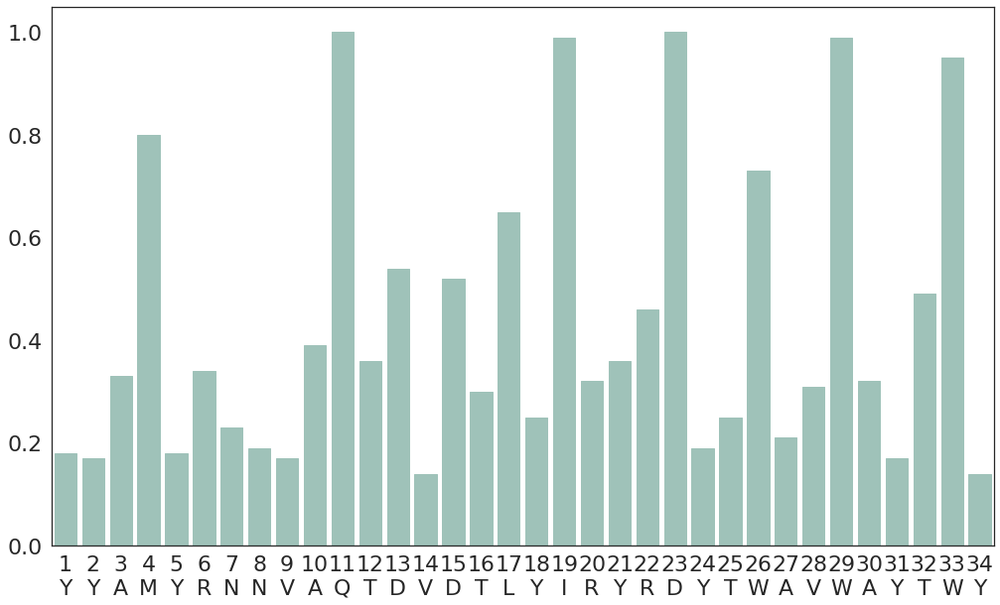

[0.18, 0.17, 0.33, 0.8, 0.18, 0.34, 0.23, 0.19, 0.17, 0.39, 1.0, 0.36, 0.54, 0.14, 0.52, 0.3, 0.65, 0.25, 0.99, 0.32, 0.36, 0.46, 1.0, 0.19, 0.25, 0.73, 0.21, 0.31, 0.99, 0.32, 0.17, 0.49, 0.95, 0.14]

---------------------
#Peptides: 408
HLA: HLA-B*73:01
Threshold: 0.6
YHTEYRNICAKTDVGNLYWTYNFYTWAVLAYEWH
threshold: 0.6


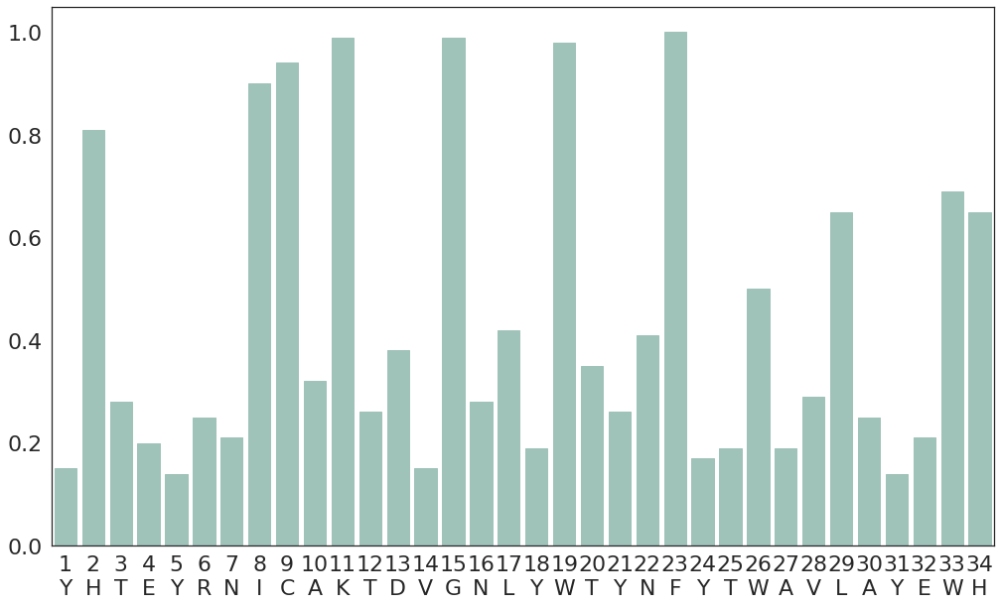

[0.15, 0.81, 0.28, 0.2, 0.14, 0.25, 0.21, 0.9, 0.94, 0.32, 0.99, 0.26, 0.38, 0.15, 0.99, 0.28, 0.42, 0.19, 0.98, 0.35, 0.26, 0.41, 1.0, 0.17, 0.19, 0.5, 0.19, 0.29, 0.65, 0.25, 0.14, 0.21, 0.69, 0.65]

---------------------
#Peptides: 1992
HLA: HLA-B*27:04
Threshold: 0.6
YHTEYREICAKTDESTLYLNYHDYTWAELAYEWY
threshold: 0.6


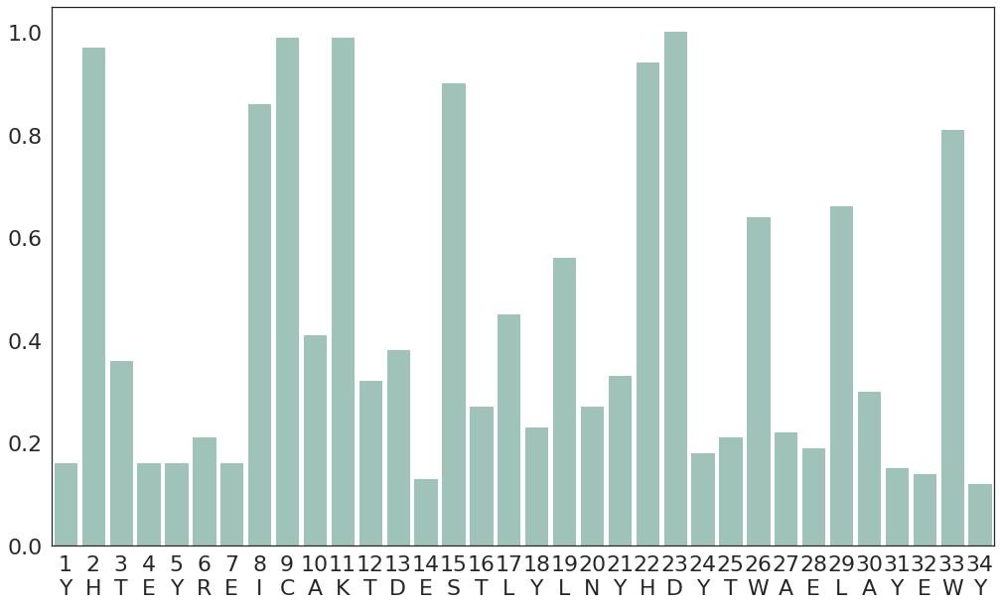

[0.16, 0.97, 0.36, 0.16, 0.16, 0.21, 0.16, 0.86, 0.99, 0.41, 0.99, 0.32, 0.38, 0.13, 0.9, 0.27, 0.45, 0.23, 0.56, 0.27, 0.33, 0.94, 1.0, 0.18, 0.21, 0.64, 0.22, 0.19, 0.66, 0.3, 0.15, 0.14, 0.81, 0.12]

---------------------
#Peptides: 58
HLA: HLA-A*32:15
Threshold: 0.6
YFAMYRNNVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


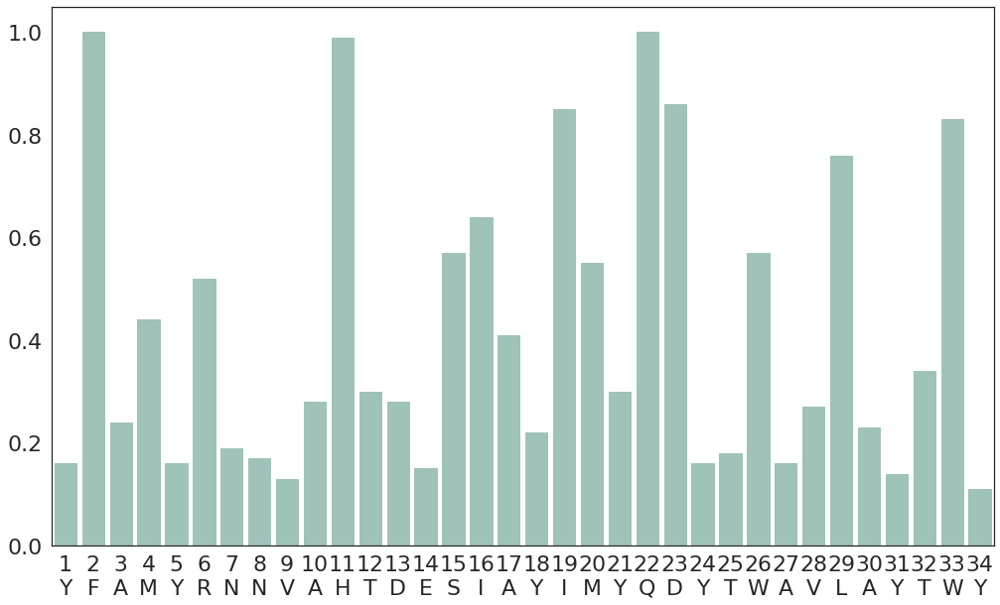

[0.16, 1.0, 0.24, 0.44, 0.16, 0.52, 0.19, 0.17, 0.13, 0.28, 0.99, 0.3, 0.28, 0.15, 0.57, 0.64, 0.41, 0.22, 0.85, 0.55, 0.3, 1.0, 0.86, 0.16, 0.18, 0.57, 0.16, 0.27, 0.76, 0.23, 0.14, 0.34, 0.83, 0.11]

---------------------
#Peptides: 3240
HLA: HLA-B*35:03
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDFYTWAVLAYLWY
threshold: 0.6


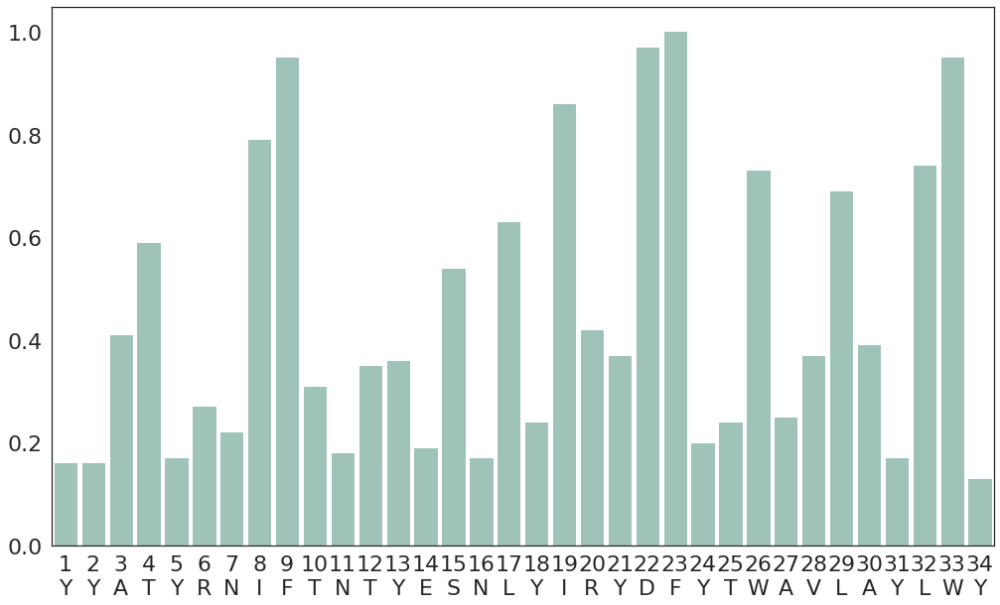

[0.16, 0.16, 0.41, 0.59, 0.17, 0.27, 0.22, 0.79, 0.95, 0.31, 0.18, 0.35, 0.36, 0.19, 0.54, 0.17, 0.63, 0.24, 0.86, 0.42, 0.37, 0.97, 1.0, 0.2, 0.24, 0.73, 0.25, 0.37, 0.69, 0.39, 0.17, 0.74, 0.95, 0.13]

---------------------
#Peptides: 211
HLA: HLA-B*15:02
Threshold: 0.6
YYAMYRNISTNTYESNLYIRYDSYTWAELAYLWY
threshold: 0.6


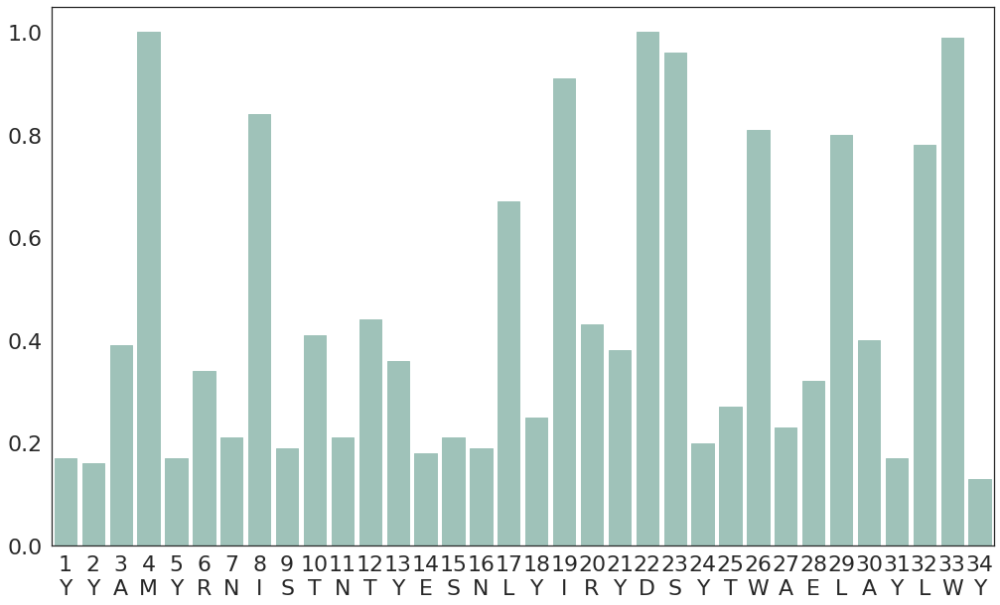

[0.17, 0.16, 0.39, 1.0, 0.17, 0.34, 0.21, 0.84, 0.19, 0.41, 0.21, 0.44, 0.36, 0.18, 0.21, 0.19, 0.67, 0.25, 0.91, 0.43, 0.38, 1.0, 0.96, 0.2, 0.27, 0.81, 0.23, 0.32, 0.8, 0.4, 0.17, 0.78, 0.99, 0.13]

---------------------
#Peptides: 233
HLA: HLA-A*02:17
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLMFHYYTWAVLAYTWY
threshold: 0.6


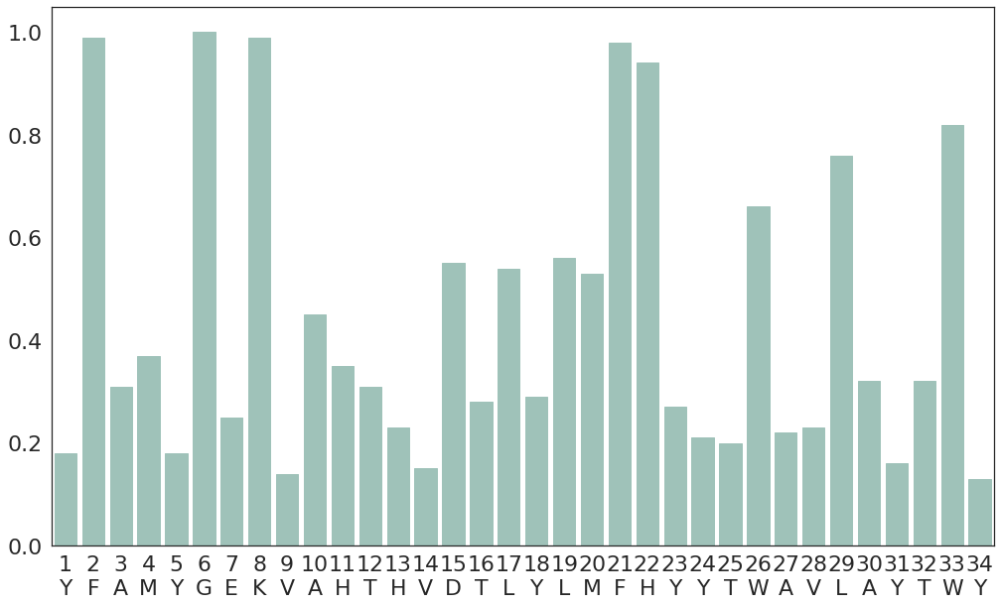

[0.18, 0.99, 0.31, 0.37, 0.18, 1.0, 0.25, 0.99, 0.14, 0.45, 0.35, 0.31, 0.23, 0.15, 0.55, 0.28, 0.54, 0.29, 0.56, 0.53, 0.98, 0.94, 0.27, 0.21, 0.2, 0.66, 0.22, 0.23, 0.76, 0.32, 0.16, 0.32, 0.82, 0.13]

---------------------
#Peptides: 791
HLA: HLA-B*27:03
Threshold: 0.6
YHTEHREICAKTDEDTLYLNYHDYTWAVLAYEWY
threshold: 0.6


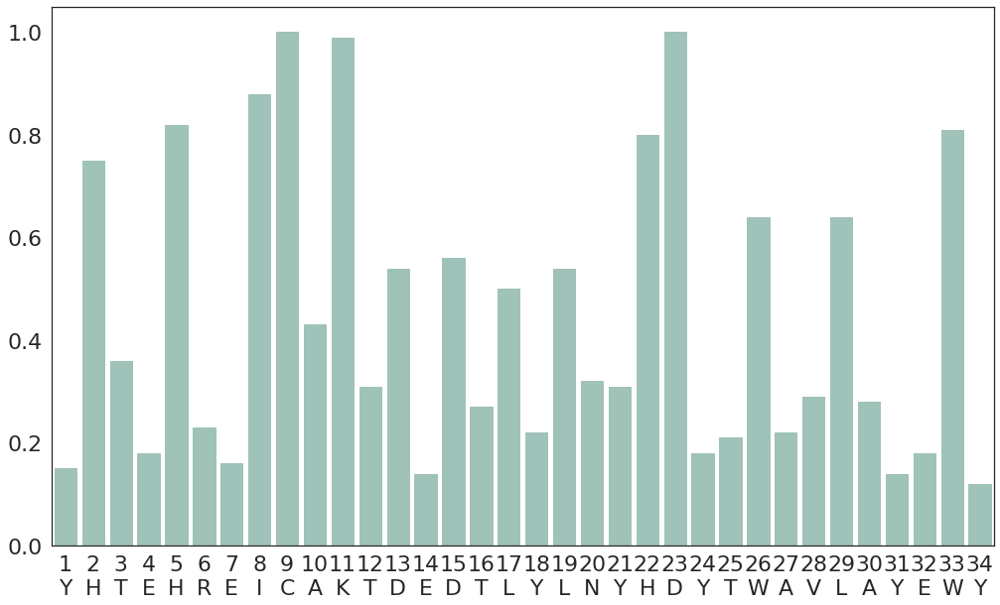

[0.15, 0.75, 0.36, 0.18, 0.82, 0.23, 0.16, 0.88, 1.0, 0.43, 0.99, 0.31, 0.54, 0.14, 0.56, 0.27, 0.5, 0.22, 0.54, 0.32, 0.31, 0.8, 1.0, 0.18, 0.21, 0.64, 0.22, 0.29, 0.64, 0.28, 0.14, 0.18, 0.81, 0.12]

---------------------
#Peptides: 1336
HLA: HLA-A*02:04
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVMYHYYTWAVLAYTWY
threshold: 0.6


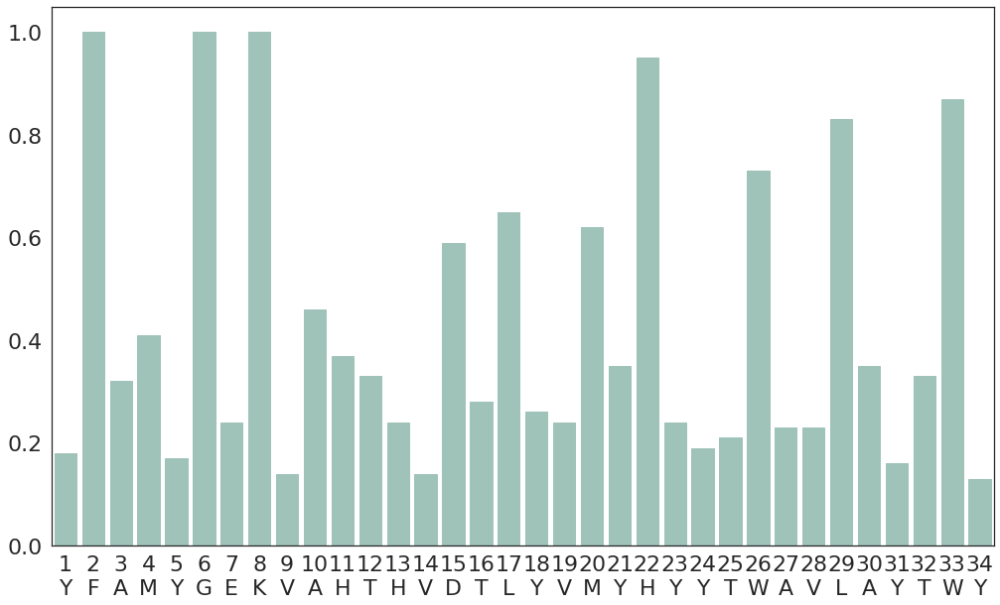

[0.18, 1.0, 0.32, 0.41, 0.17, 1.0, 0.24, 1.0, 0.14, 0.46, 0.37, 0.33, 0.24, 0.14, 0.59, 0.28, 0.65, 0.26, 0.24, 0.62, 0.35, 0.95, 0.24, 0.19, 0.21, 0.73, 0.23, 0.23, 0.83, 0.35, 0.16, 0.33, 0.87, 0.13]

---------------------
#Peptides: 4409
HLA: HLA-B*40:01
Threshold: 0.6
YHTKYREISTNTYESNLYLRYNYYSLAVLAYEWY
threshold: 0.6


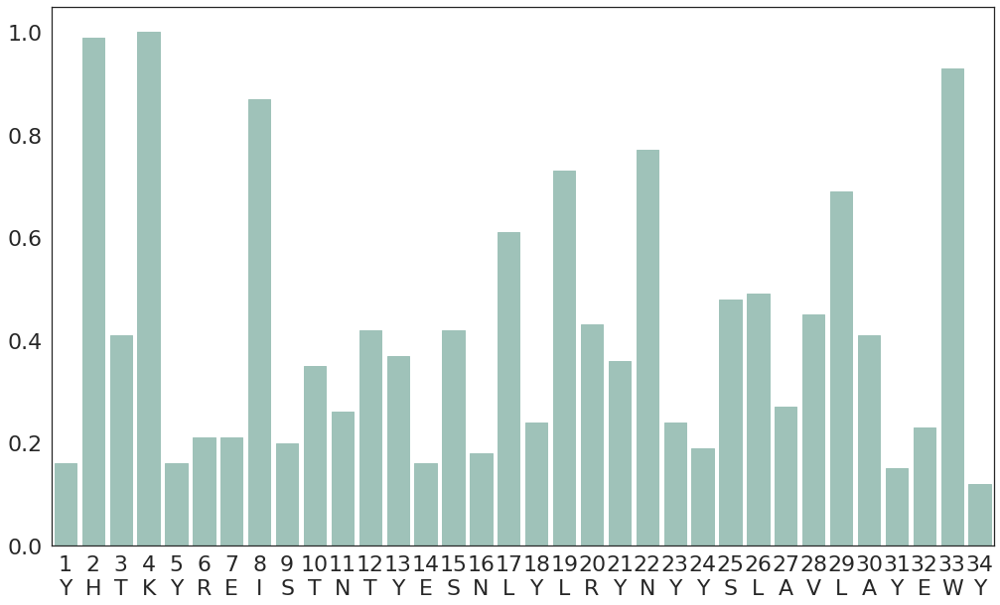

[0.16, 0.99, 0.41, 1.0, 0.16, 0.21, 0.21, 0.87, 0.2, 0.35, 0.26, 0.42, 0.37, 0.16, 0.42, 0.18, 0.61, 0.24, 0.73, 0.43, 0.36, 0.77, 0.24, 0.19, 0.48, 0.49, 0.27, 0.45, 0.69, 0.41, 0.15, 0.23, 0.93, 0.12]

---------------------
#Peptides: 5883
HLA: HLA-B*44:03
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVLAYLSY
threshold: 0.6


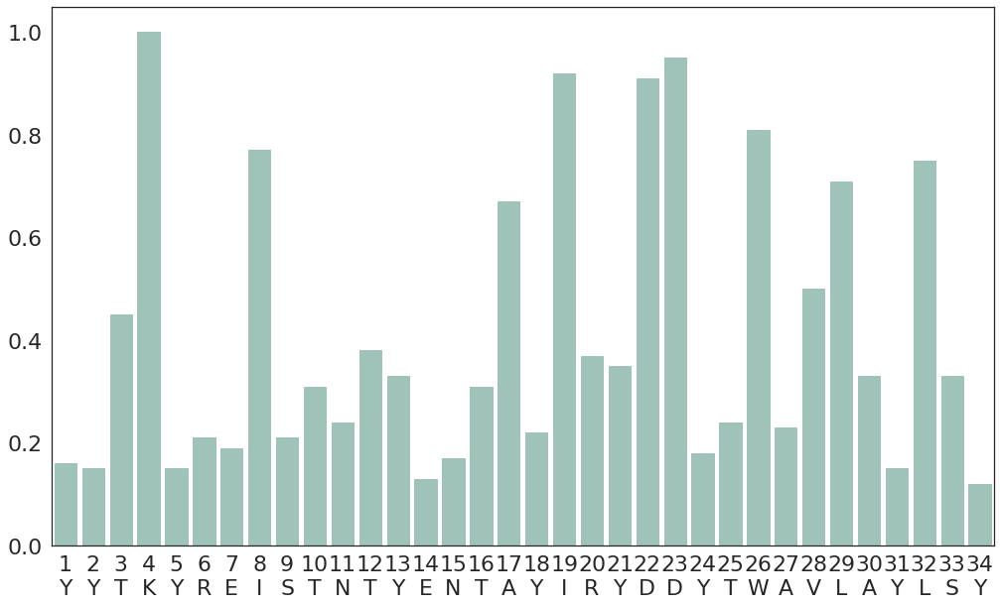

[0.16, 0.15, 0.45, 1.0, 0.15, 0.21, 0.19, 0.77, 0.21, 0.31, 0.24, 0.38, 0.33, 0.13, 0.17, 0.31, 0.67, 0.22, 0.92, 0.37, 0.35, 0.91, 0.95, 0.18, 0.24, 0.81, 0.23, 0.5, 0.71, 0.33, 0.15, 0.75, 0.33, 0.12]

---------------------
#Peptides: 4974
HLA: HLA-B*51:01
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAELAYLWH
threshold: 0.6


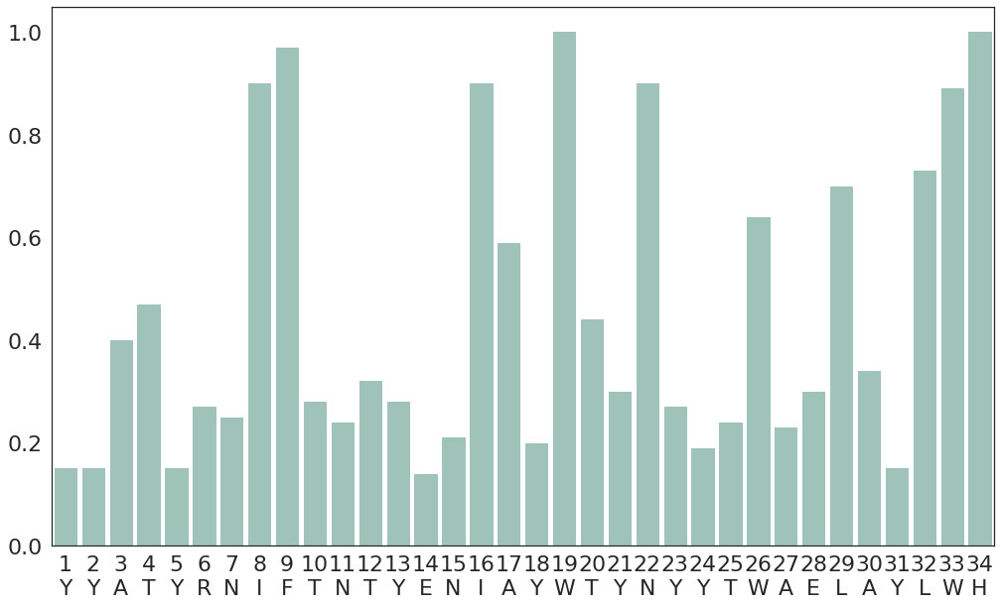

[0.15, 0.15, 0.4, 0.47, 0.15, 0.27, 0.25, 0.9, 0.97, 0.28, 0.24, 0.32, 0.28, 0.14, 0.21, 0.9, 0.59, 0.2, 1.0, 0.44, 0.3, 0.9, 0.27, 0.19, 0.24, 0.64, 0.23, 0.3, 0.7, 0.34, 0.15, 0.73, 0.89, 1.0]

---------------------
#Peptides: 495
HLA: HLA-B*41:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNYYTWAVDAYTWY
threshold: 0.6


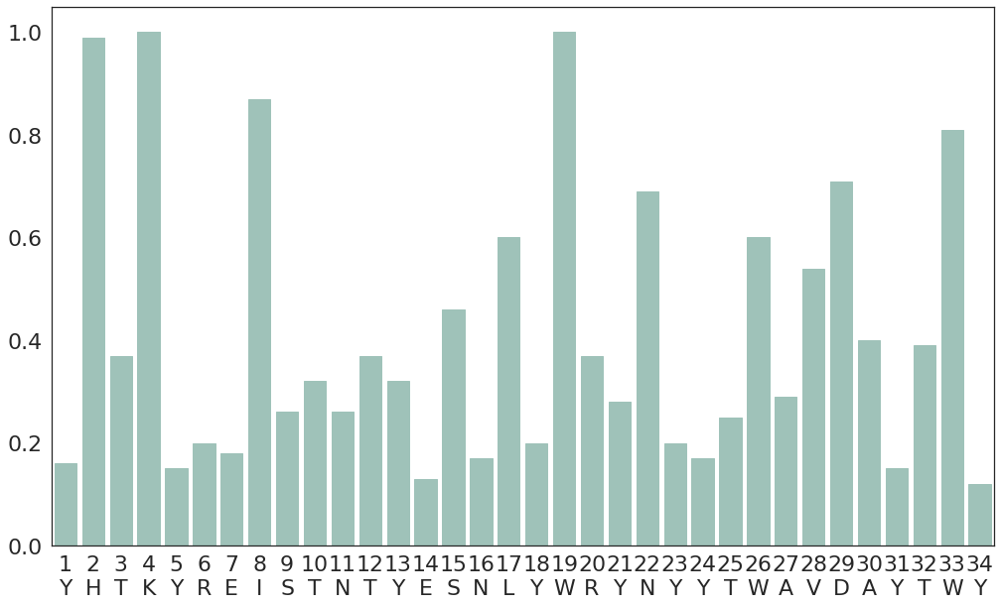

[0.16, 0.99, 0.37, 1.0, 0.15, 0.2, 0.18, 0.87, 0.26, 0.32, 0.26, 0.37, 0.32, 0.13, 0.46, 0.17, 0.6, 0.2, 1.0, 0.37, 0.28, 0.69, 0.2, 0.17, 0.25, 0.6, 0.29, 0.54, 0.71, 0.4, 0.15, 0.39, 0.81, 0.12]

---------------------
#Peptides: 2988
HLA: HLA-C*07:02
Threshold: 0.6
YDSGYREKYRQADVSNLYLRSDSYTLAALAYTWY
threshold: 0.6


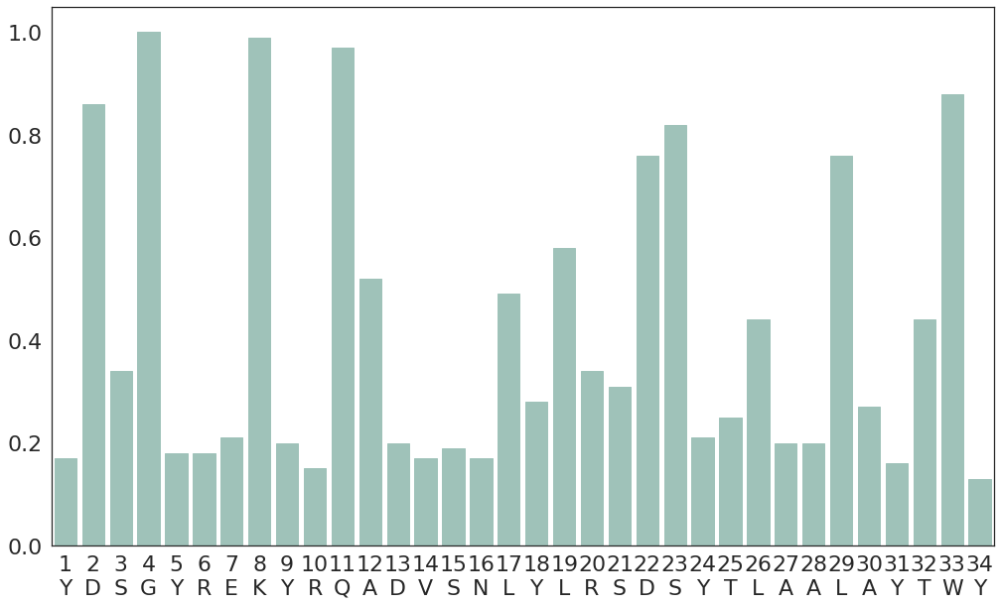

[0.17, 0.86, 0.34, 1.0, 0.18, 0.18, 0.21, 0.99, 0.2, 0.15, 0.97, 0.52, 0.2, 0.17, 0.19, 0.17, 0.49, 0.28, 0.58, 0.34, 0.31, 0.76, 0.82, 0.21, 0.25, 0.44, 0.2, 0.2, 0.76, 0.27, 0.16, 0.44, 0.88, 0.13]

---------------------
#Peptides: 861
HLA: HLA-B*15:18
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYDSYTWAELAYLWY
threshold: 0.6


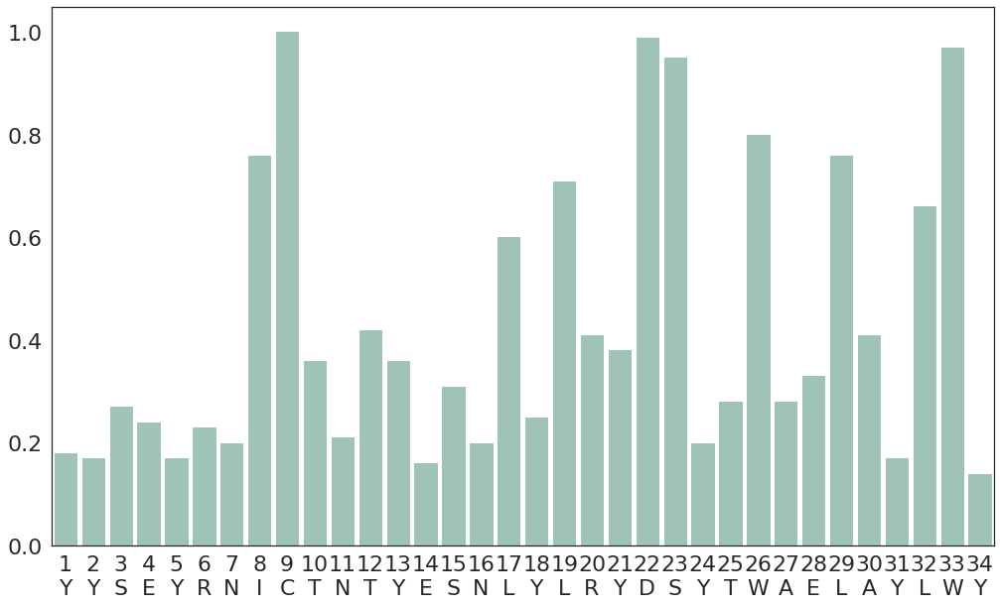

[0.18, 0.17, 0.27, 0.24, 0.17, 0.23, 0.2, 0.76, 1.0, 0.36, 0.21, 0.42, 0.36, 0.16, 0.31, 0.2, 0.6, 0.25, 0.71, 0.41, 0.38, 0.99, 0.95, 0.2, 0.28, 0.8, 0.28, 0.33, 0.76, 0.41, 0.17, 0.66, 0.97, 0.14]

---------------------
#Peptides: 2925
HLA: HLA-B*27:01
Threshold: 0.6
YHTEYREICAKTYENTAYLNYHDYTWAVLAYEWY
threshold: 0.6


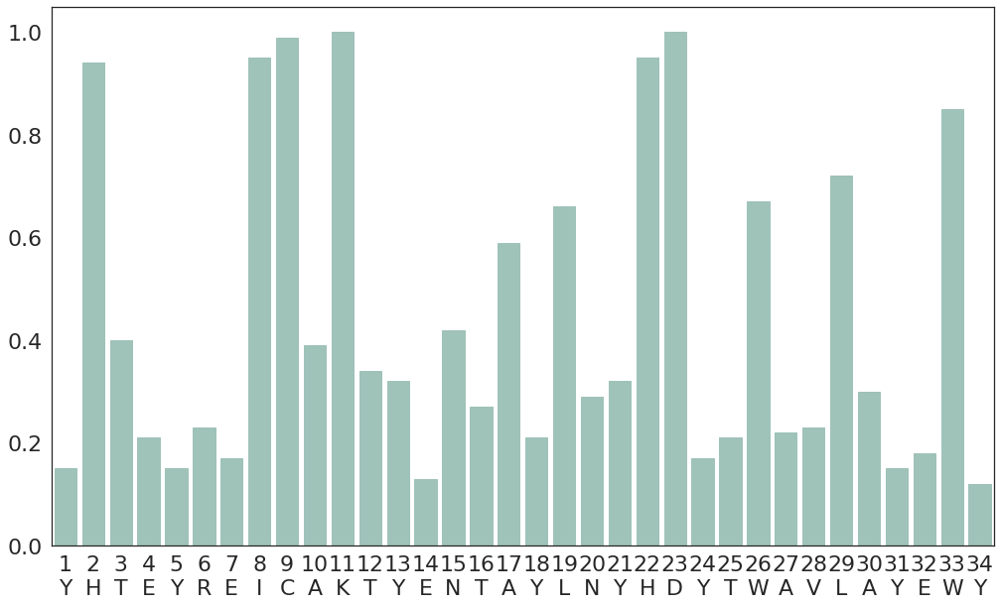

[0.15, 0.94, 0.4, 0.21, 0.15, 0.23, 0.17, 0.95, 0.99, 0.39, 1.0, 0.34, 0.32, 0.13, 0.42, 0.27, 0.59, 0.21, 0.66, 0.29, 0.32, 0.95, 1.0, 0.17, 0.21, 0.67, 0.22, 0.23, 0.72, 0.3, 0.15, 0.18, 0.85, 0.12]

---------------------
#Peptides: 4405
HLA: HLA-C*05:01
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYNFYTWAERAYTWY
threshold: 0.6


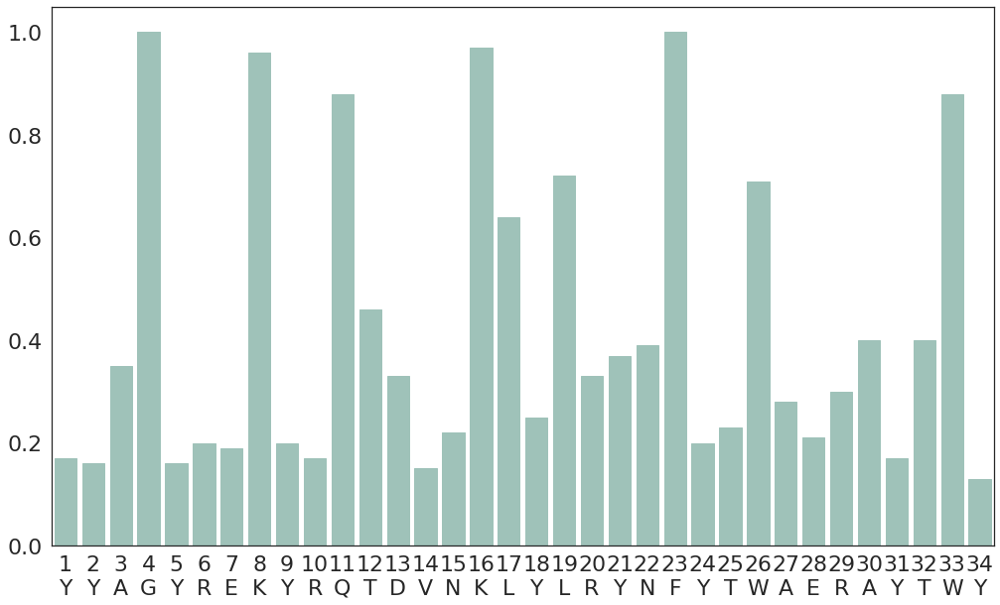

[0.17, 0.16, 0.35, 1.0, 0.16, 0.2, 0.19, 0.96, 0.2, 0.17, 0.88, 0.46, 0.33, 0.15, 0.22, 0.97, 0.64, 0.25, 0.72, 0.33, 0.37, 0.39, 1.0, 0.2, 0.23, 0.71, 0.28, 0.21, 0.3, 0.4, 0.17, 0.4, 0.88, 0.13]

---------------------
#Peptides: 36670
HLA: HLA-B*27:05
Threshold: 0.6
YHTEYREICAKTDEDTLYLNYHDYTWAVLAYEWY
threshold: 0.6


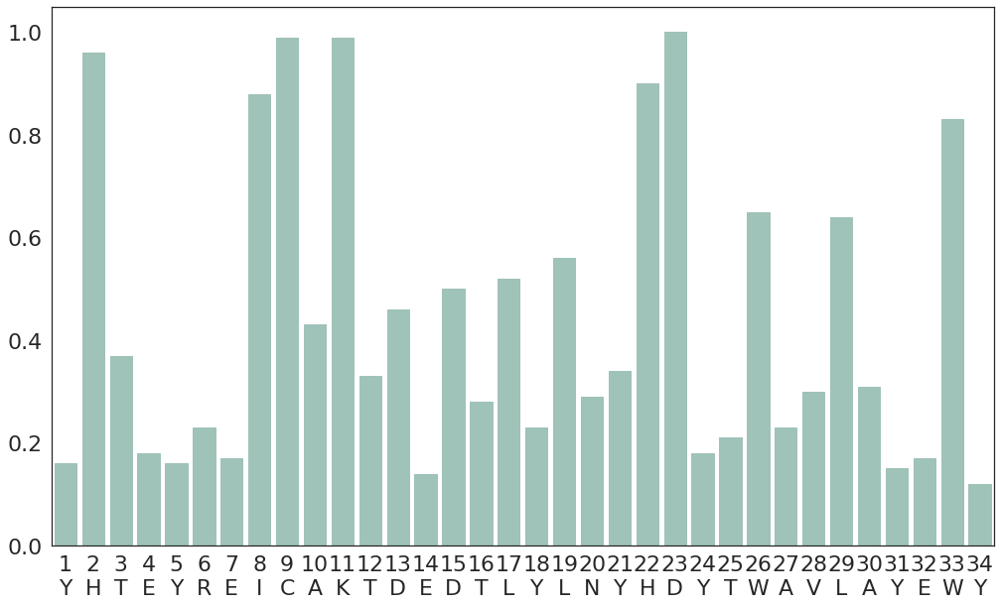

[0.16, 0.96, 0.37, 0.18, 0.16, 0.23, 0.17, 0.88, 0.99, 0.43, 0.99, 0.33, 0.46, 0.14, 0.5, 0.28, 0.52, 0.23, 0.56, 0.29, 0.34, 0.9, 1.0, 0.18, 0.21, 0.65, 0.23, 0.3, 0.64, 0.31, 0.15, 0.17, 0.83, 0.12]

---------------------
#Peptides: 74
HLA: HLA-A*66:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYQDYTWAEWAYRWY
threshold: 0.6


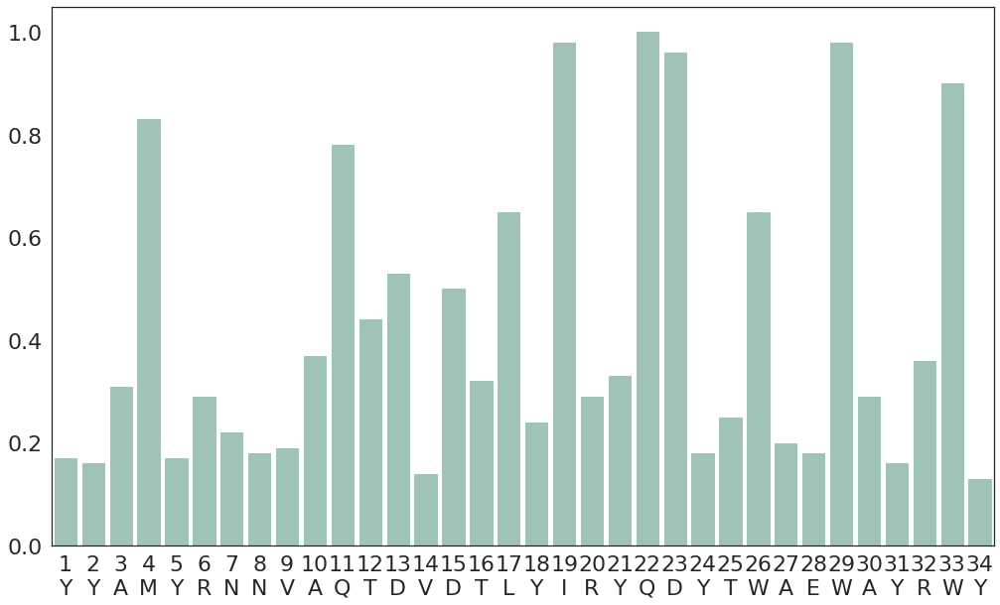

[0.17, 0.16, 0.31, 0.83, 0.17, 0.29, 0.22, 0.18, 0.19, 0.37, 0.78, 0.44, 0.53, 0.14, 0.5, 0.32, 0.65, 0.24, 0.98, 0.29, 0.33, 1.0, 0.96, 0.18, 0.25, 0.65, 0.2, 0.18, 0.98, 0.29, 0.16, 0.36, 0.9, 0.13]

---------------------
#Peptides: 456
HLA: HLA-B*51:08
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAVDAYLWH
threshold: 0.6


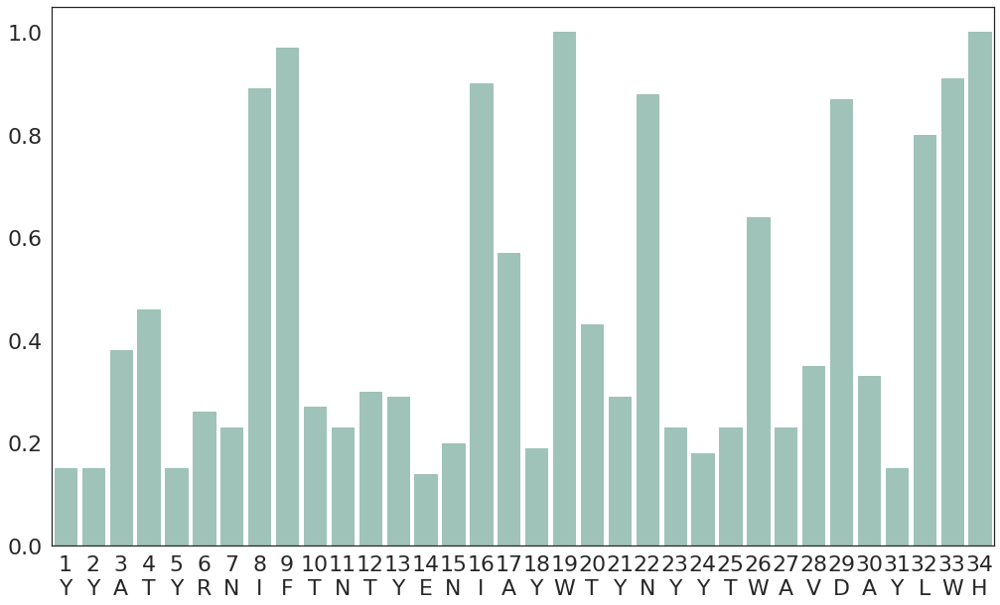

[0.15, 0.15, 0.38, 0.46, 0.15, 0.26, 0.23, 0.89, 0.97, 0.27, 0.23, 0.3, 0.29, 0.14, 0.2, 0.9, 0.57, 0.19, 1.0, 0.43, 0.29, 0.88, 0.23, 0.18, 0.23, 0.64, 0.23, 0.35, 0.87, 0.33, 0.15, 0.8, 0.91, 1.0]

---------------------
#Peptides: 2103
HLA: HLA-C*14:02
Threshold: 0.6
YSAGYREKYRQTDVSNLYLWFDSYTWAERAYTWY
threshold: 0.6


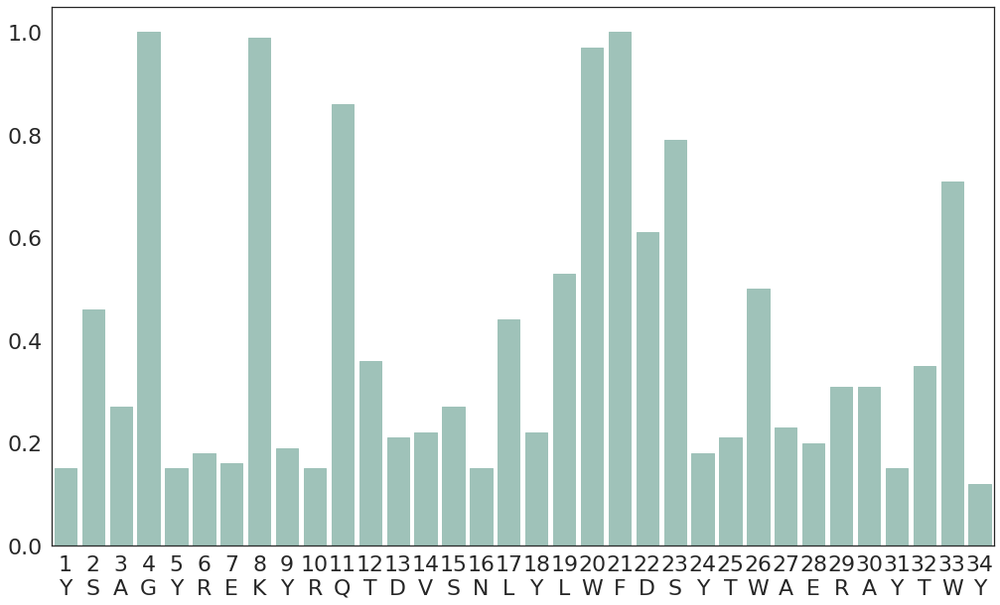

[0.15, 0.46, 0.27, 1.0, 0.15, 0.18, 0.16, 0.99, 0.19, 0.15, 0.86, 0.36, 0.21, 0.22, 0.27, 0.15, 0.44, 0.22, 0.53, 0.97, 1.0, 0.61, 0.79, 0.18, 0.21, 0.5, 0.23, 0.2, 0.31, 0.31, 0.15, 0.35, 0.71, 0.12]

---------------------
#Peptides: 802
HLA: HLA-A*02:20
Threshold: 0.6
YFAMYGENVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


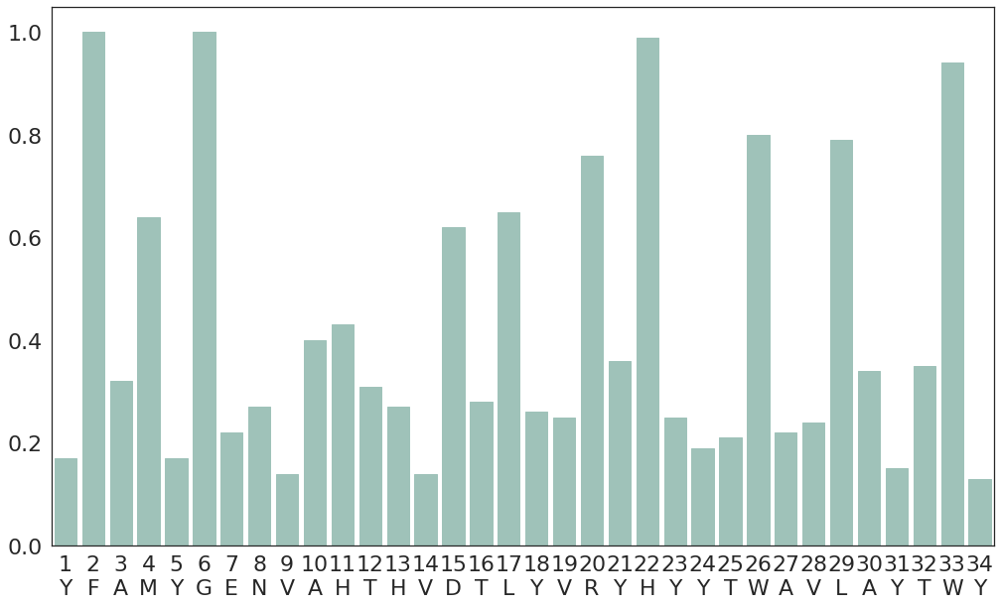

[0.17, 1.0, 0.32, 0.64, 0.17, 1.0, 0.22, 0.27, 0.14, 0.4, 0.43, 0.31, 0.27, 0.14, 0.62, 0.28, 0.65, 0.26, 0.25, 0.76, 0.36, 0.99, 0.25, 0.19, 0.21, 0.8, 0.22, 0.24, 0.79, 0.34, 0.15, 0.35, 0.94, 0.13]

---------------------
#Peptides: 328
HLA: HLA-A*02:11
Threshold: 0.6
YFAMYGEKVAHIDVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


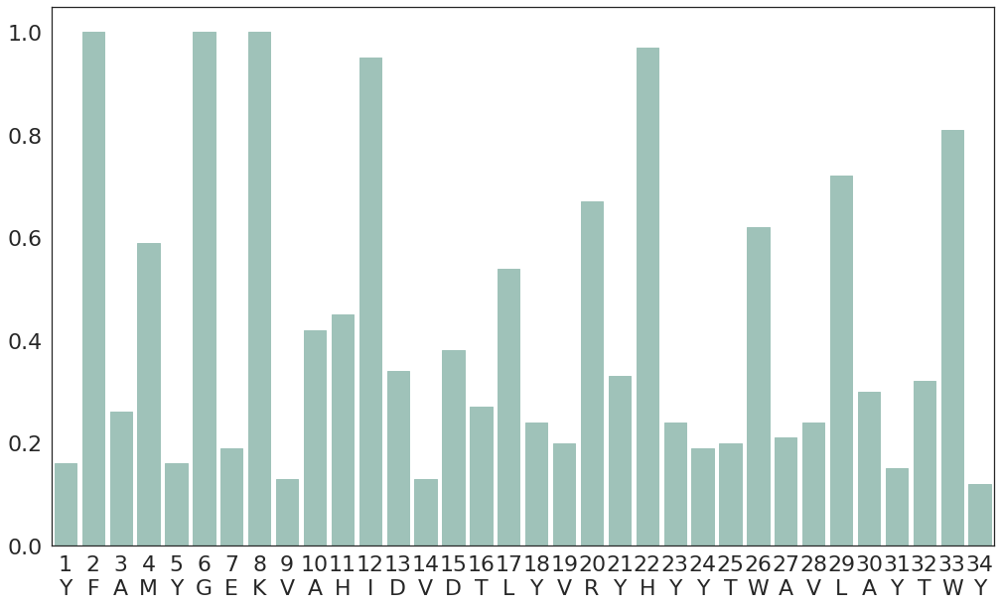

[0.16, 1.0, 0.26, 0.59, 0.16, 1.0, 0.19, 1.0, 0.13, 0.42, 0.45, 0.95, 0.34, 0.13, 0.38, 0.27, 0.54, 0.24, 0.2, 0.67, 0.33, 0.97, 0.24, 0.19, 0.2, 0.62, 0.21, 0.24, 0.72, 0.3, 0.15, 0.32, 0.81, 0.12]

---------------------
#Peptides: 2550
HLA: HLA-B*13:02
Threshold: 0.6
YYTMYREISTNTYENTAYWTYNLYTWAVLAYEWY
threshold: 0.6


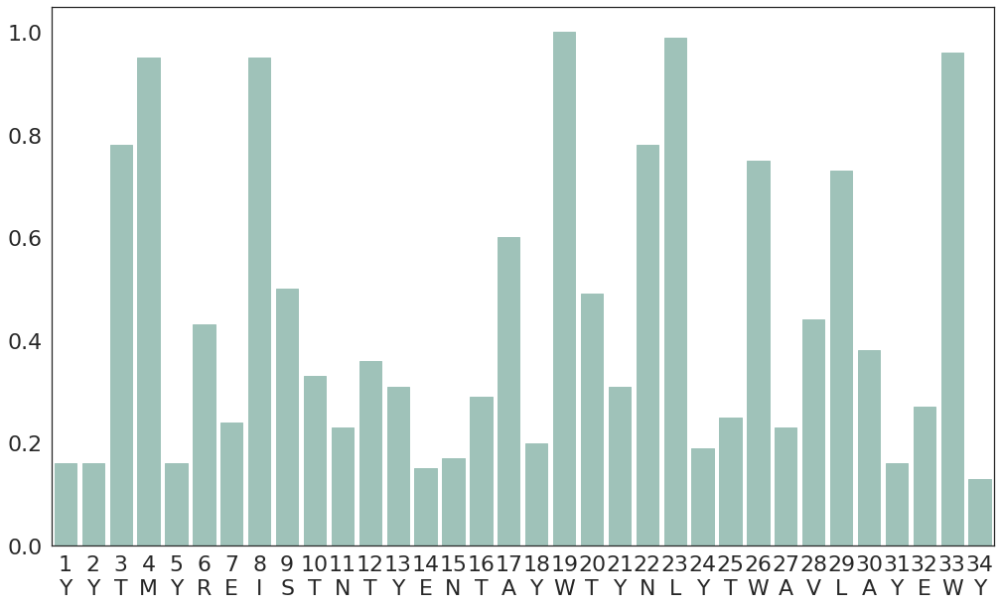

[0.16, 0.16, 0.78, 0.95, 0.16, 0.43, 0.24, 0.95, 0.5, 0.33, 0.23, 0.36, 0.31, 0.15, 0.17, 0.29, 0.6, 0.2, 1.0, 0.49, 0.31, 0.78, 0.99, 0.19, 0.25, 0.75, 0.23, 0.44, 0.73, 0.38, 0.16, 0.27, 0.96, 0.13]

---------------------
#Peptides: 3641
HLA: HLA-C*07:01
Threshold: 0.6
YDSGYRENYRQADVSNLYLRYDSYTLAALAYTWY
threshold: 0.6


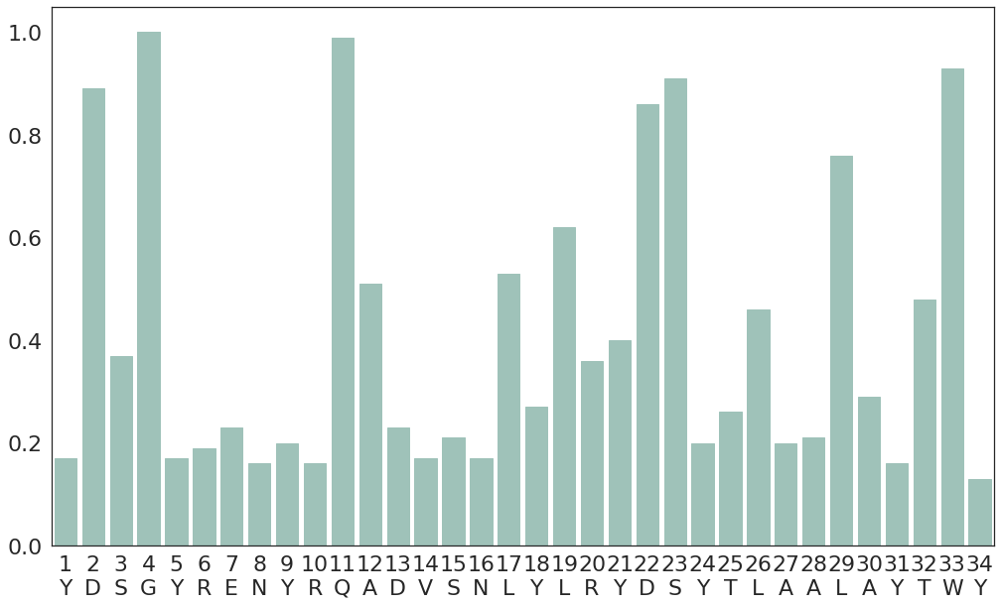

[0.17, 0.89, 0.37, 1.0, 0.17, 0.19, 0.23, 0.16, 0.2, 0.16, 0.99, 0.51, 0.23, 0.17, 0.21, 0.17, 0.53, 0.27, 0.62, 0.36, 0.4, 0.86, 0.91, 0.2, 0.26, 0.46, 0.2, 0.21, 0.76, 0.29, 0.16, 0.48, 0.93, 0.13]

---------------------
#Peptides: 655
HLA: HLA-B*53:01
Threshold: 0.6
YYATYRNIFTNTYENIAYIRYDSYTWAVLAYLWY
threshold: 0.6


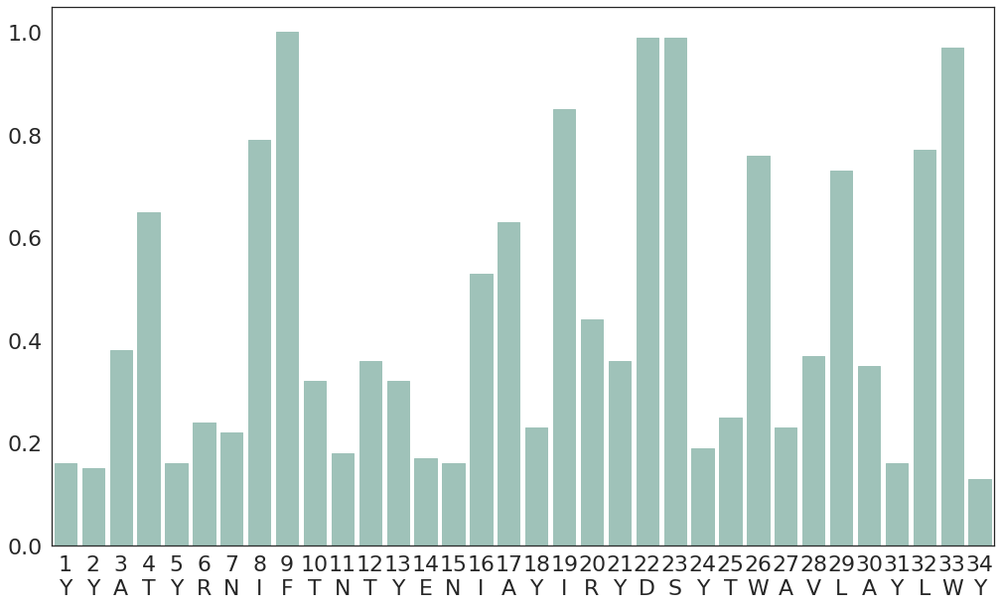

[0.16, 0.15, 0.38, 0.65, 0.16, 0.24, 0.22, 0.79, 1.0, 0.32, 0.18, 0.36, 0.32, 0.17, 0.16, 0.53, 0.63, 0.23, 0.85, 0.44, 0.36, 0.99, 0.99, 0.19, 0.25, 0.76, 0.23, 0.37, 0.73, 0.35, 0.16, 0.77, 0.97, 0.13]

---------------------
#Peptides: 4042
HLA: HLA-A*02:06
Threshold: 0.6
YYAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


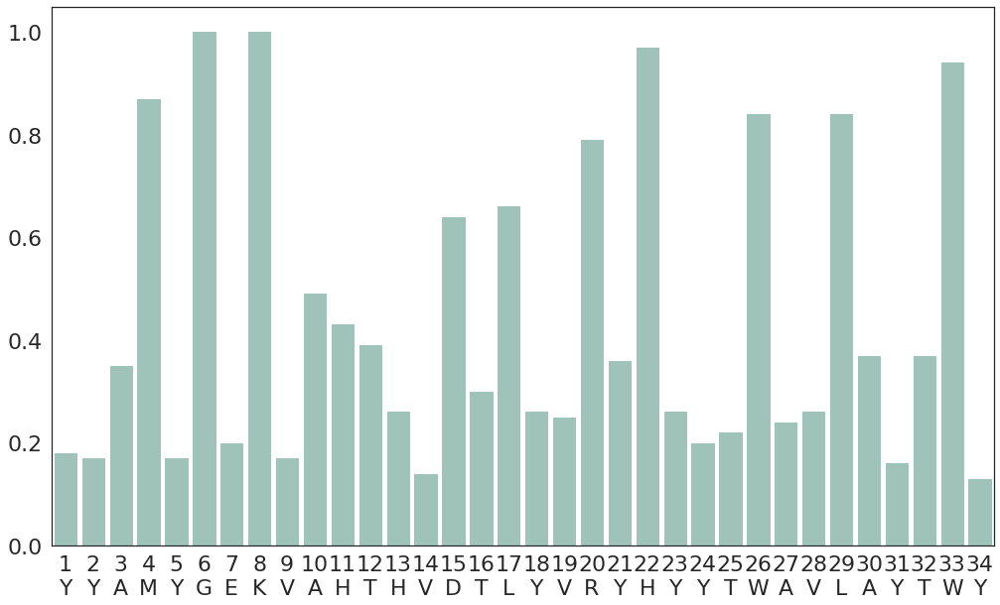

[0.18, 0.17, 0.35, 0.87, 0.17, 1.0, 0.2, 1.0, 0.17, 0.49, 0.43, 0.39, 0.26, 0.14, 0.64, 0.3, 0.66, 0.26, 0.25, 0.79, 0.36, 0.97, 0.26, 0.2, 0.22, 0.84, 0.24, 0.26, 0.84, 0.37, 0.16, 0.37, 0.94, 0.13]

---------------------
#Peptides: 2198
HLA: HLA-A*02:05
Threshold: 0.6
YYAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY
threshold: 0.6


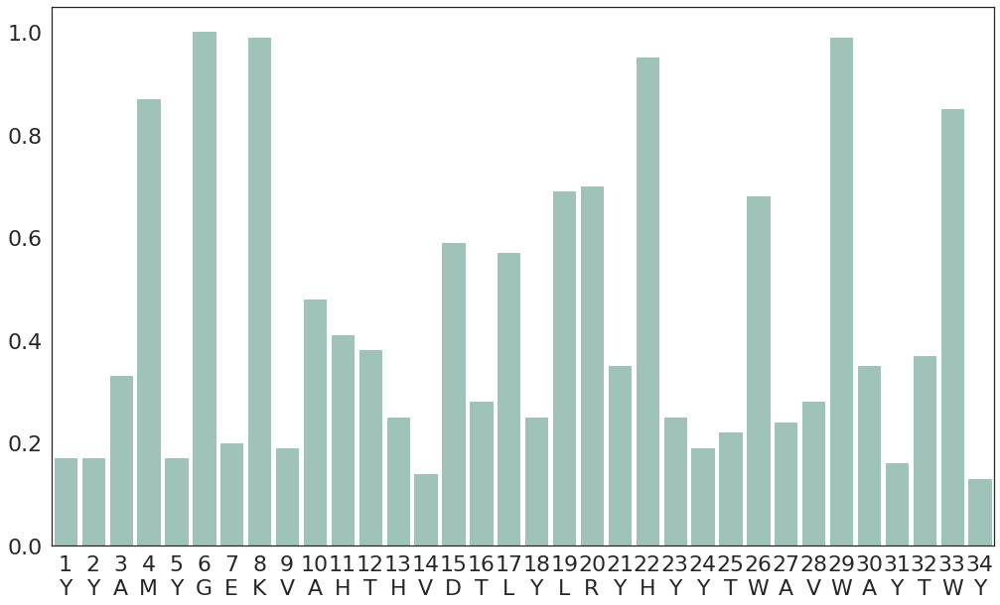

[0.17, 0.17, 0.33, 0.87, 0.17, 1.0, 0.2, 0.99, 0.19, 0.48, 0.41, 0.38, 0.25, 0.14, 0.59, 0.28, 0.57, 0.25, 0.69, 0.7, 0.35, 0.95, 0.25, 0.19, 0.22, 0.68, 0.24, 0.28, 0.99, 0.35, 0.16, 0.37, 0.85, 0.13]

---------------------
#Peptides: 327
HLA: HLA-B*15:03
Threshold: 0.6
YYSEYREISTNTYESNLYLRYDSYTWAELAYLWY
threshold: 0.6


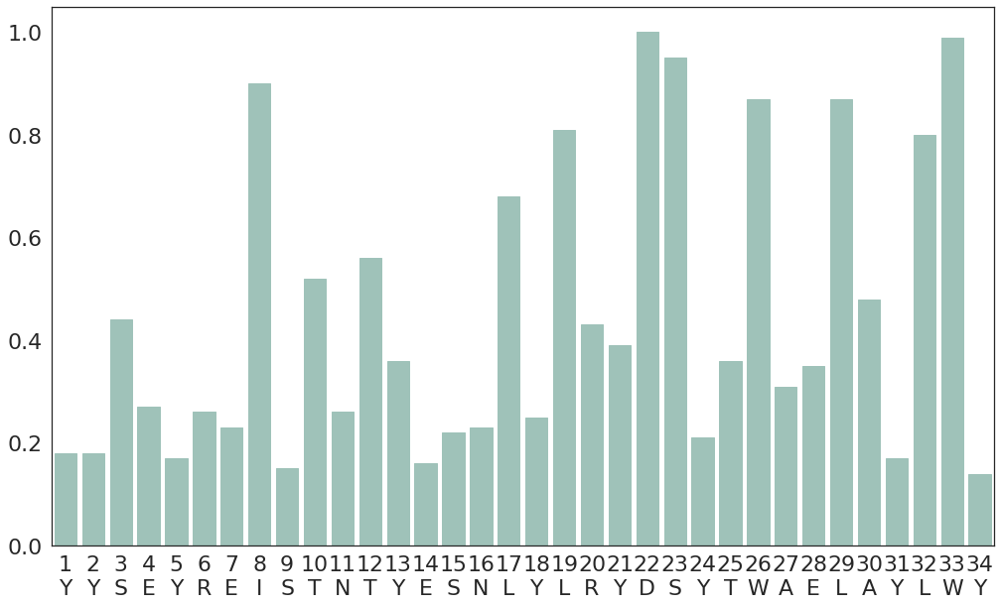

[0.18, 0.18, 0.44, 0.27, 0.17, 0.26, 0.23, 0.9, 0.15, 0.52, 0.26, 0.56, 0.36, 0.16, 0.22, 0.23, 0.68, 0.25, 0.81, 0.43, 0.39, 1.0, 0.95, 0.21, 0.36, 0.87, 0.31, 0.35, 0.87, 0.48, 0.17, 0.8, 0.99, 0.14]

---------------------
#Peptides: 13808
HLA: HLA-B*15:01
Threshold: 0.6
YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY
threshold: 0.6


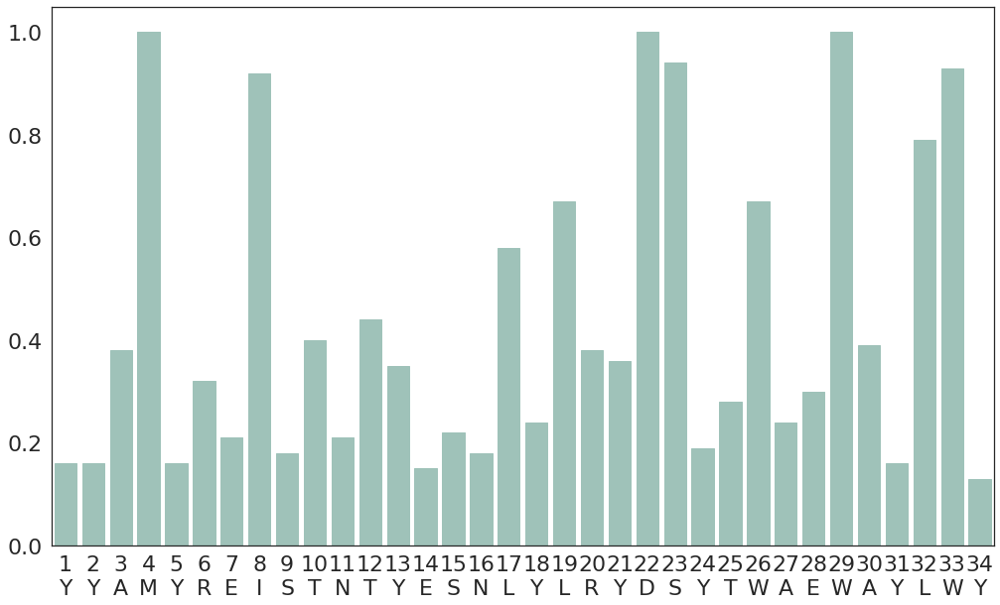

[0.16, 0.16, 0.38, 1.0, 0.16, 0.32, 0.21, 0.92, 0.18, 0.4, 0.21, 0.44, 0.35, 0.15, 0.22, 0.18, 0.58, 0.24, 0.67, 0.38, 0.36, 1.0, 0.94, 0.19, 0.28, 0.67, 0.24, 0.3, 1.0, 0.39, 0.16, 0.79, 0.93, 0.13]

---------------------
#Peptides: 66
HLA: HLA-A*26:03
Threshold: 0.6
YYAMYRNNVAHTHVDTLYIRYQDYTWAEWAYRWY
threshold: 0.6


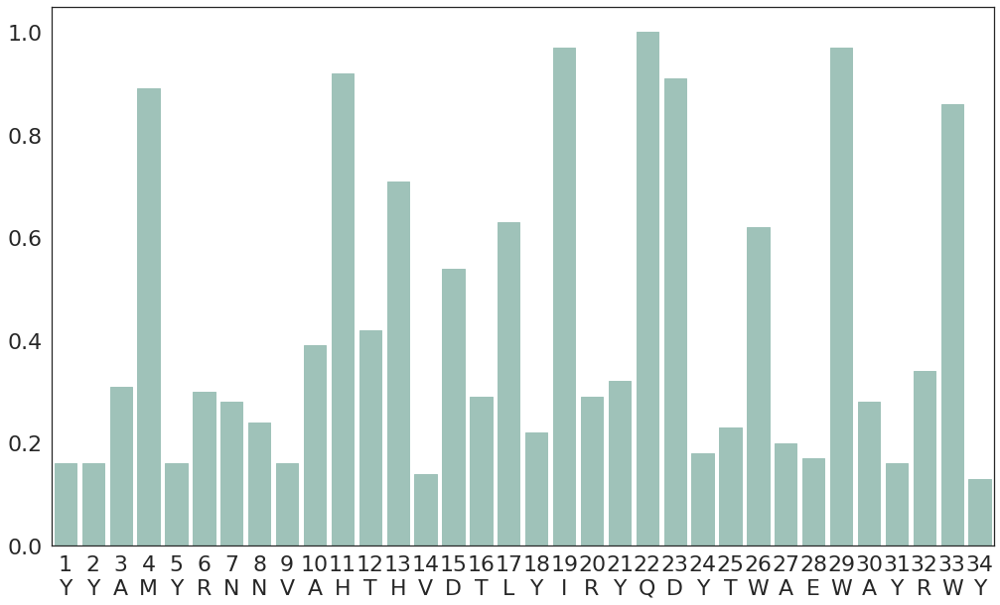

[0.16, 0.16, 0.31, 0.89, 0.16, 0.3, 0.28, 0.24, 0.16, 0.39, 0.92, 0.42, 0.71, 0.14, 0.54, 0.29, 0.63, 0.22, 0.97, 0.29, 0.32, 1.0, 0.91, 0.18, 0.23, 0.62, 0.2, 0.17, 0.97, 0.28, 0.16, 0.34, 0.86, 0.13]

---------------------
#Peptides: 257
HLA: HLA-B*83:01
Threshold: 0.6
YYSEYRNIYAQTDESNLYIRYDDYTWAVDAYLSY
threshold: 0.6


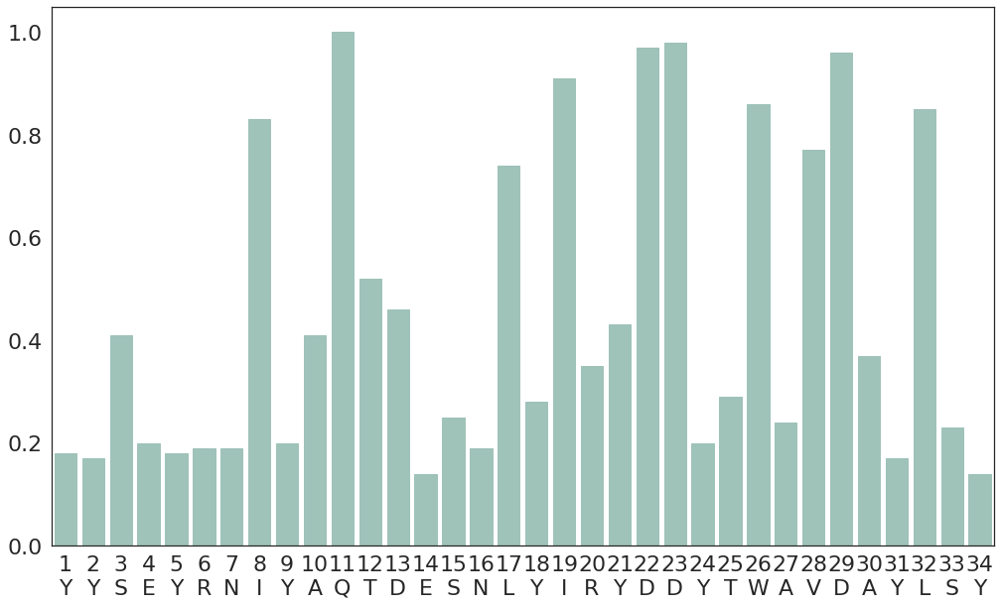

[0.18, 0.17, 0.41, 0.2, 0.18, 0.19, 0.19, 0.83, 0.2, 0.41, 1.0, 0.52, 0.46, 0.14, 0.25, 0.19, 0.74, 0.28, 0.91, 0.35, 0.43, 0.97, 0.98, 0.2, 0.29, 0.86, 0.24, 0.77, 0.96, 0.37, 0.17, 0.85, 0.23, 0.14]

---------------------
#Peptides: 5447
HLA: HLA-C*06:02
Threshold: 0.6
YDSGYREKYRQADVNKLYLWYDSYTWAEWAYTWY
threshold: 0.6


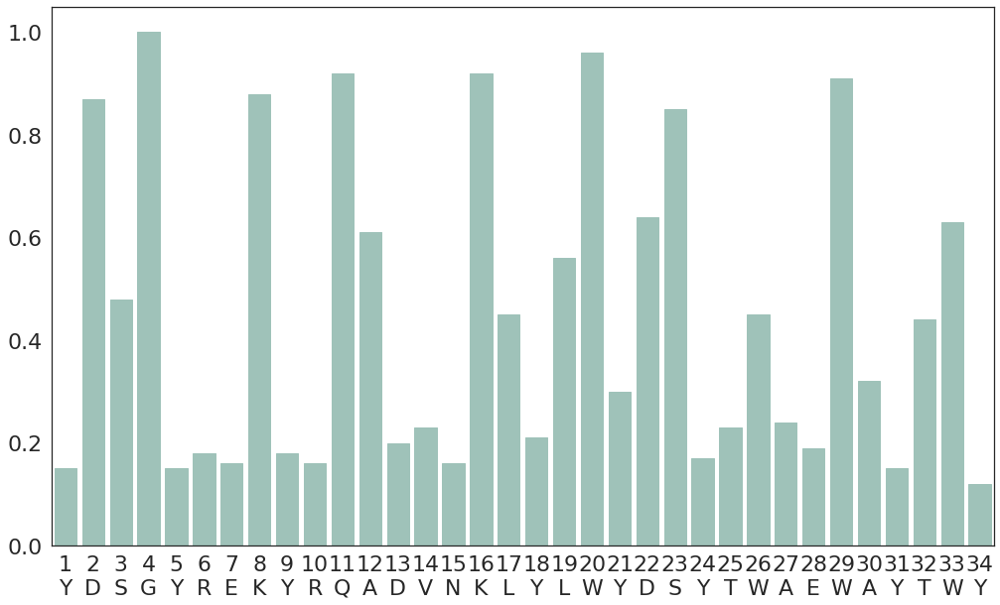

[0.15, 0.87, 0.48, 1.0, 0.15, 0.18, 0.16, 0.88, 0.18, 0.16, 0.92, 0.61, 0.2, 0.23, 0.16, 0.92, 0.45, 0.21, 0.56, 0.96, 0.3, 0.64, 0.85, 0.17, 0.23, 0.45, 0.24, 0.19, 0.91, 0.32, 0.15, 0.44, 0.63, 0.12]

---------------------
#Peptides: 2245
HLA: HLA-B*18:01
Threshold: 0.59
YHSTYRNISTNTYESNLYLRYDSYTWAVLAYTWH
threshold: 0.59


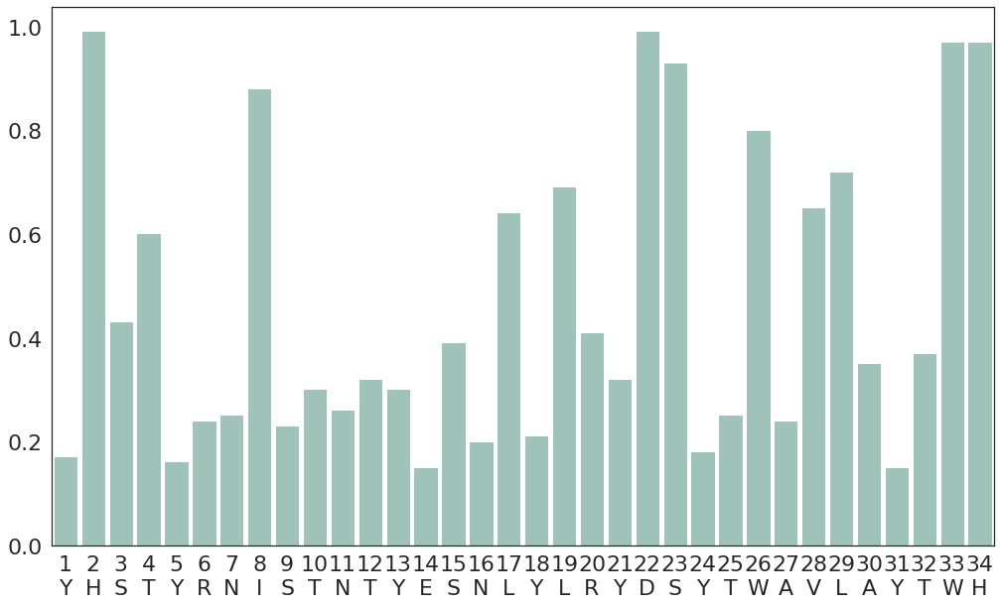

[0.17, 0.99, 0.43, 0.6, 0.16, 0.24, 0.25, 0.88, 0.23, 0.3, 0.26, 0.32, 0.3, 0.15, 0.39, 0.2, 0.64, 0.21, 0.69, 0.41, 0.32, 0.99, 0.93, 0.18, 0.25, 0.8, 0.24, 0.65, 0.72, 0.35, 0.15, 0.37, 0.97, 0.97]

---------------------
#Peptides: 5138
HLA: HLA-C*08:02
Threshold: 0.6
YYAGYREKYRQTDVSNLYLRYNFYTWAERAYTWY
threshold: 0.6


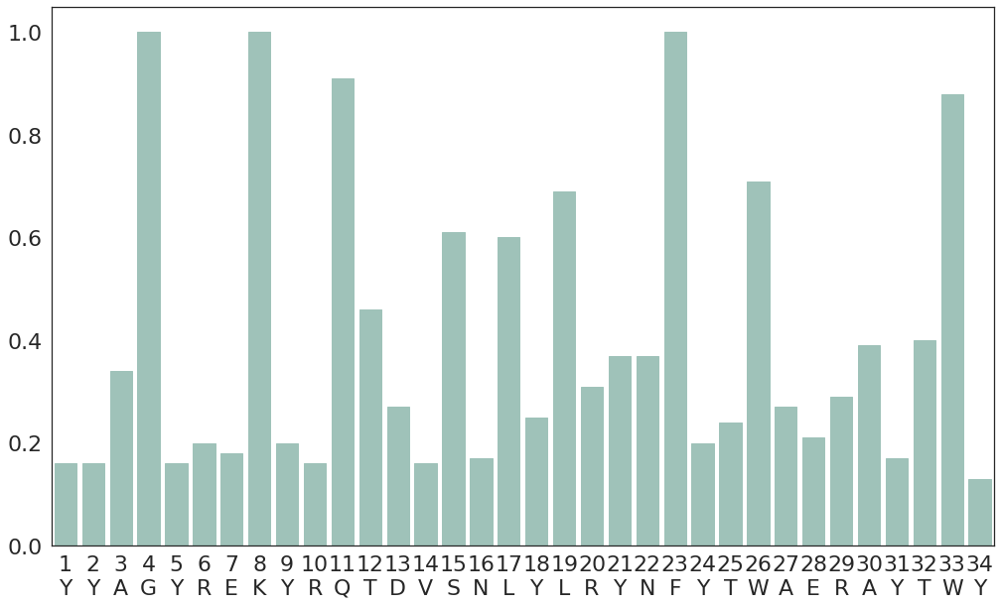

[0.16, 0.16, 0.34, 1.0, 0.16, 0.2, 0.18, 1.0, 0.2, 0.16, 0.91, 0.46, 0.27, 0.16, 0.61, 0.17, 0.6, 0.25, 0.69, 0.31, 0.37, 0.37, 1.0, 0.2, 0.24, 0.71, 0.27, 0.21, 0.29, 0.39, 0.17, 0.4, 0.88, 0.13]

---------------------
#Peptides: 3119
HLA: HLA-B*38:01
Threshold: 0.6
YYSEYRNICTNTYENIAYLRYNFYTWAVLTYTWY
threshold: 0.6


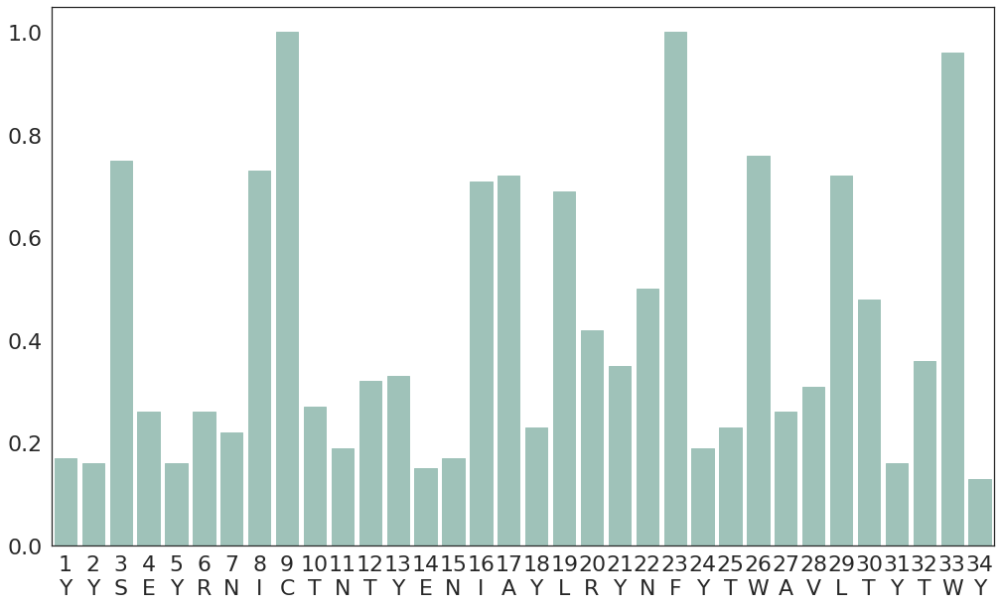

[0.17, 0.16, 0.75, 0.26, 0.16, 0.26, 0.22, 0.73, 1.0, 0.27, 0.19, 0.32, 0.33, 0.15, 0.17, 0.71, 0.72, 0.23, 0.69, 0.42, 0.35, 0.5, 1.0, 0.19, 0.23, 0.76, 0.26, 0.31, 0.72, 0.48, 0.16, 0.36, 0.96, 0.13]

---------------------
#Peptides: 2550
HLA: HLA-B*27:02
Threshold: 0.6
YHTEYREICAKTDENIAYLNYHDYTWAVLAYEWY
threshold: 0.6


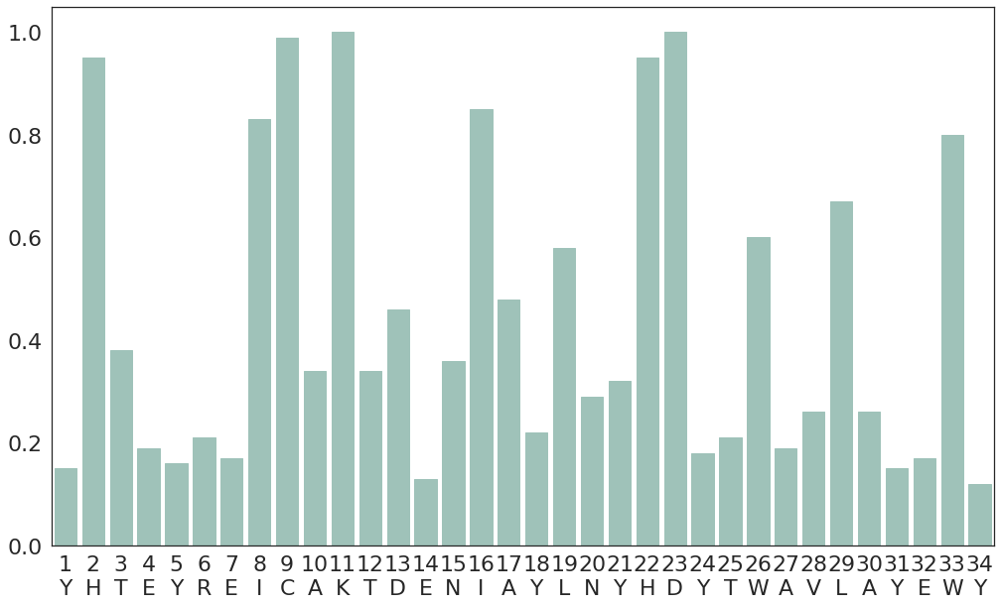

[0.15, 0.95, 0.38, 0.19, 0.16, 0.21, 0.17, 0.83, 0.99, 0.34, 1.0, 0.34, 0.46, 0.13, 0.36, 0.85, 0.48, 0.22, 0.58, 0.29, 0.32, 0.95, 1.0, 0.18, 0.21, 0.6, 0.19, 0.26, 0.67, 0.26, 0.15, 0.17, 0.8, 0.12]

---------------------
#Peptides: 1386
HLA: HLA-A*30:01
Threshold: 0.6
YSAMYQENVAQTDVDTLYIIYEHYTWAWLAYTWY
threshold: 0.6


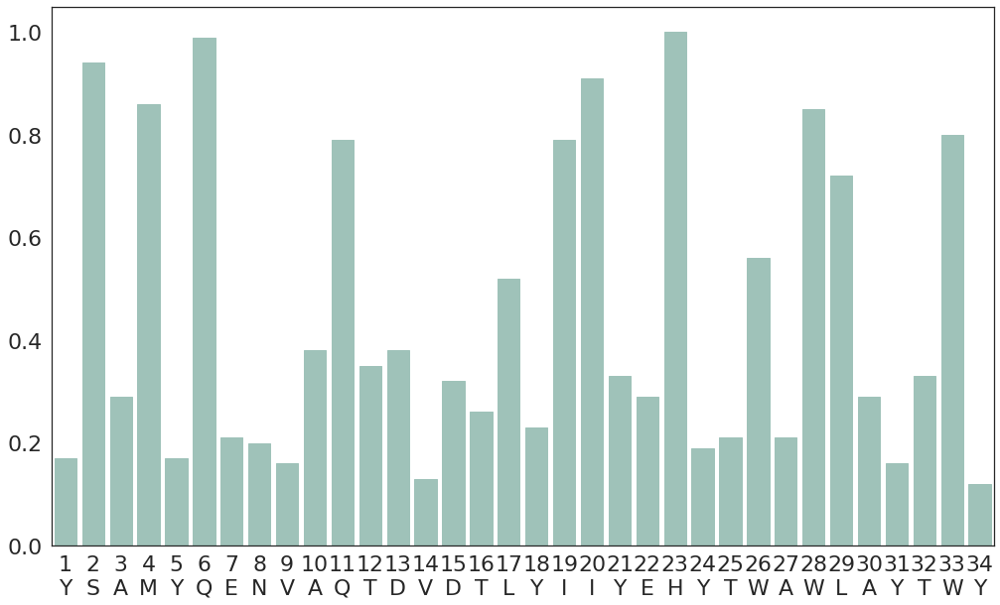

[0.17, 0.94, 0.29, 0.86, 0.17, 0.99, 0.21, 0.2, 0.16, 0.38, 0.79, 0.35, 0.38, 0.13, 0.32, 0.26, 0.52, 0.23, 0.79, 0.91, 0.33, 0.29, 1.0, 0.19, 0.21, 0.56, 0.21, 0.85, 0.72, 0.29, 0.16, 0.33, 0.8, 0.12]

---------------------
#Peptides: 957
HLA: HLA-A*69:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


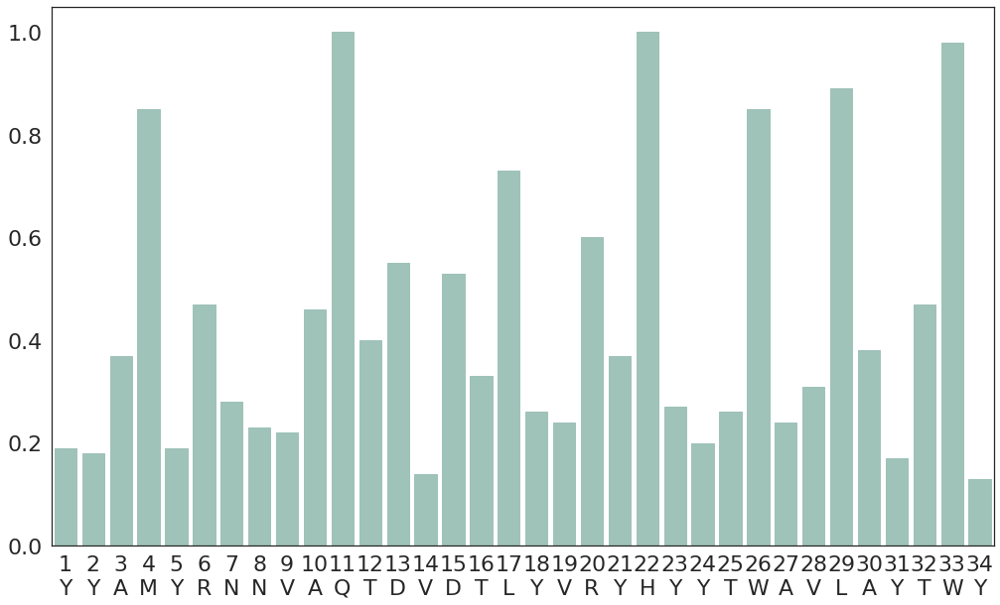

[0.19, 0.18, 0.37, 0.85, 0.19, 0.47, 0.28, 0.23, 0.22, 0.46, 1.0, 0.4, 0.55, 0.14, 0.53, 0.33, 0.73, 0.26, 0.24, 0.6, 0.37, 1.0, 0.27, 0.2, 0.26, 0.85, 0.24, 0.31, 0.89, 0.38, 0.17, 0.47, 0.98, 0.13]

---------------------
#Peptides: 411
HLA: HLA-B*52:01
Threshold: 0.6
YYATYREISTNTYENIAYWTYNYYTWAELAYLWH
threshold: 0.6


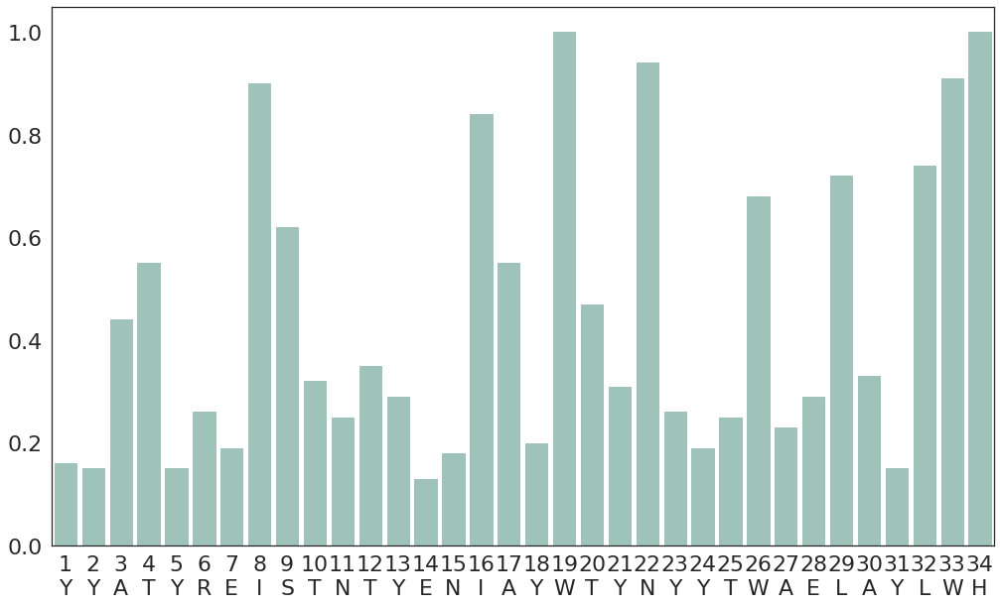

[0.16, 0.15, 0.44, 0.55, 0.15, 0.26, 0.19, 0.9, 0.62, 0.32, 0.25, 0.35, 0.29, 0.13, 0.18, 0.84, 0.55, 0.2, 1.0, 0.47, 0.31, 0.94, 0.26, 0.19, 0.25, 0.68, 0.23, 0.29, 0.72, 0.33, 0.15, 0.74, 0.91, 1.0]

---------------------
#Peptides: 142
HLA: HLA-A*80:01
Threshold: 0.6
YFAMYEENVAHTNANTLYIIYRDYTWARLAYEGY
threshold: 0.6


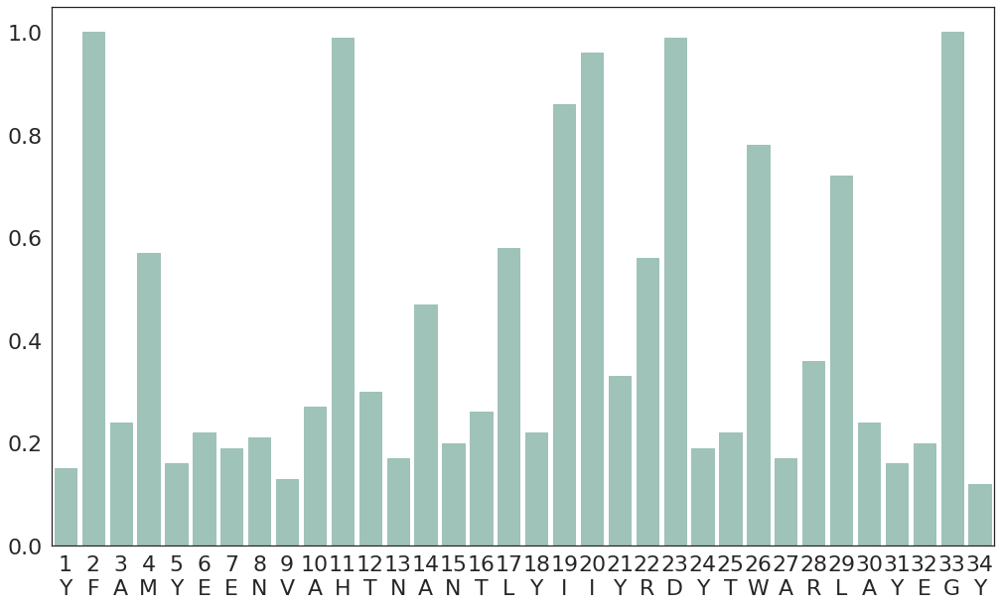

[0.15, 1.0, 0.24, 0.57, 0.16, 0.22, 0.19, 0.21, 0.13, 0.27, 0.99, 0.3, 0.17, 0.47, 0.2, 0.26, 0.58, 0.22, 0.86, 0.96, 0.33, 0.56, 0.99, 0.19, 0.22, 0.78, 0.17, 0.36, 0.72, 0.24, 0.16, 0.2, 1.0, 0.12]

---------------------
#Peptides: 1642
HLA: HLA-B*46:01
Threshold: 0.6
YYAMYREKYRQTDVSNLYLRYDSYTWAEWAYLWY
threshold: 0.6


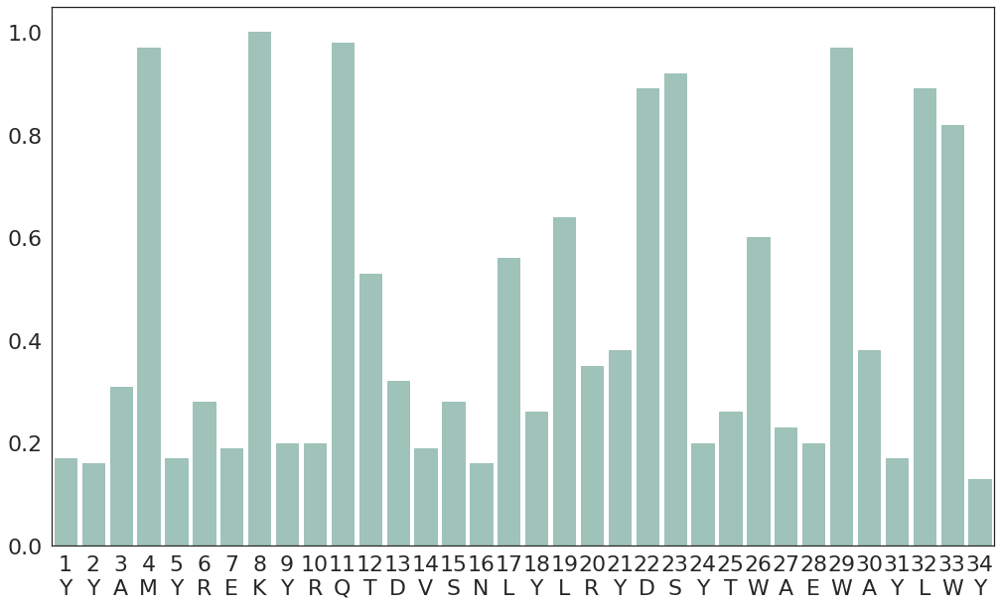

[0.17, 0.16, 0.31, 0.97, 0.17, 0.28, 0.19, 1.0, 0.2, 0.2, 0.98, 0.53, 0.32, 0.19, 0.28, 0.16, 0.56, 0.26, 0.64, 0.35, 0.38, 0.89, 0.92, 0.2, 0.26, 0.6, 0.23, 0.2, 0.97, 0.38, 0.17, 0.89, 0.82, 0.13]

---------------------
#Peptides: 276
HLA: HLA-A*02:12
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTWY
threshold: 0.6


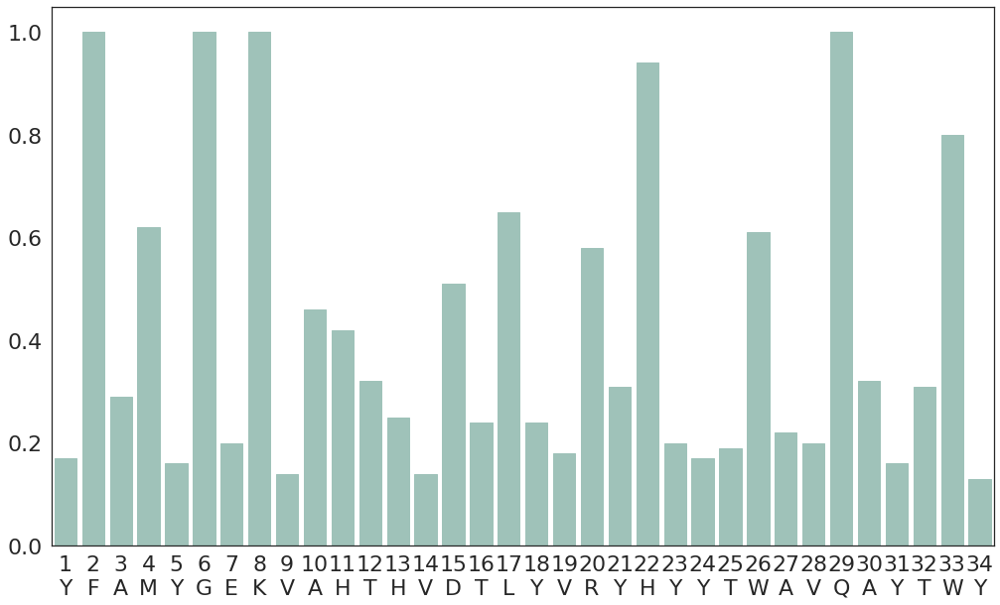

[0.17, 1.0, 0.29, 0.62, 0.16, 1.0, 0.2, 1.0, 0.14, 0.46, 0.42, 0.32, 0.25, 0.14, 0.51, 0.24, 0.65, 0.24, 0.18, 0.58, 0.31, 0.94, 0.2, 0.17, 0.19, 0.61, 0.22, 0.2, 1.0, 0.32, 0.16, 0.31, 0.8, 0.13]

---------------------
#Peptides: 6837
HLA: HLA-A*68:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIMYRDYTWAVWAYTWY
threshold: 0.6


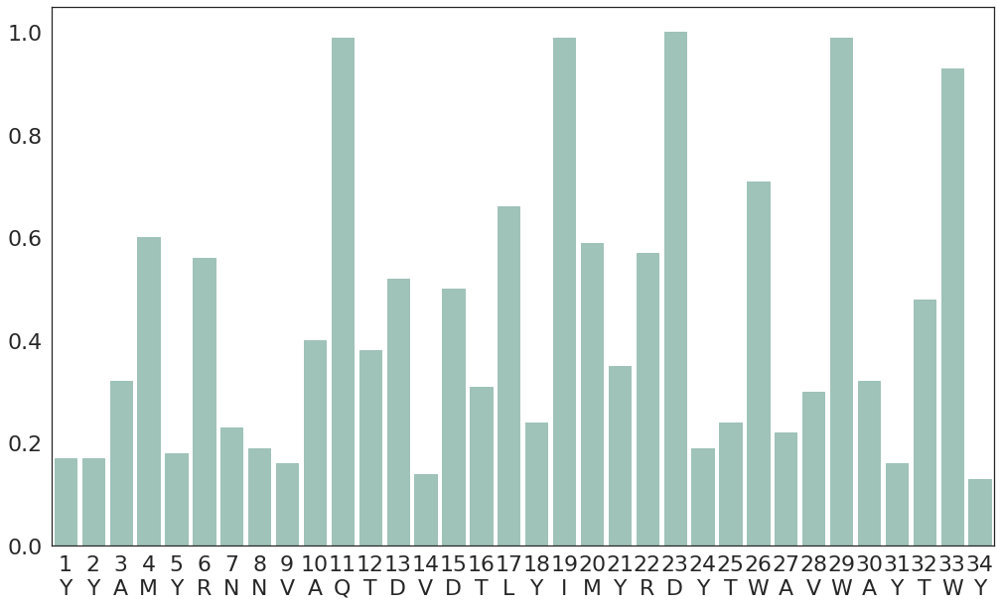

[0.17, 0.17, 0.32, 0.6, 0.18, 0.56, 0.23, 0.19, 0.16, 0.4, 0.99, 0.38, 0.52, 0.14, 0.5, 0.31, 0.66, 0.24, 0.99, 0.59, 0.35, 0.57, 1.0, 0.19, 0.24, 0.71, 0.22, 0.3, 0.99, 0.32, 0.16, 0.48, 0.93, 0.13]

---------------------
#Peptides: 1648
HLA: HLA-B*27:08
Threshold: 0.6
YHTEYREICAKTDESNLYLNYHDYTWAVLAYEWY
threshold: 0.6


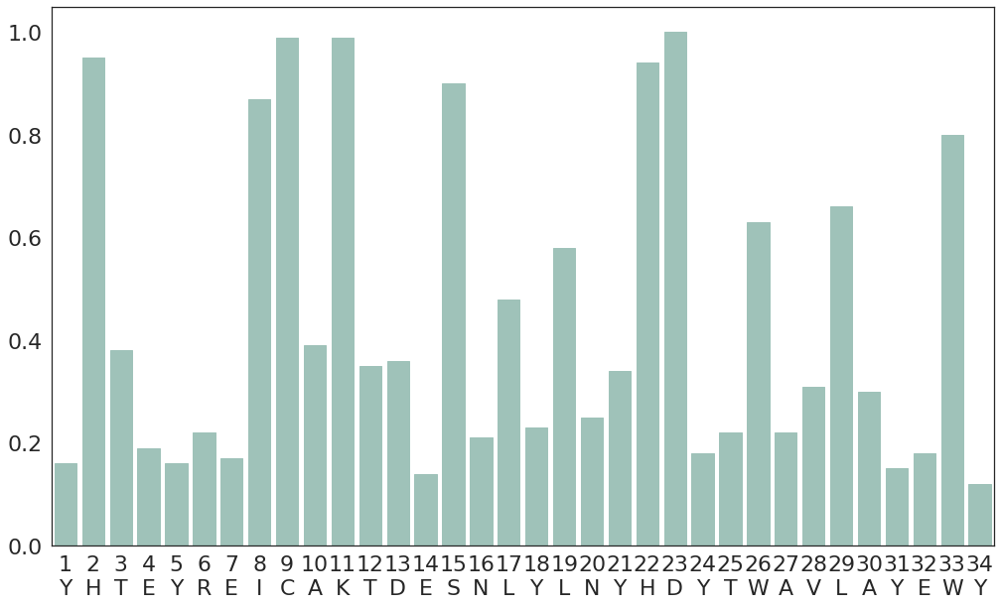

[0.16, 0.95, 0.38, 0.19, 0.16, 0.22, 0.17, 0.87, 0.99, 0.39, 0.99, 0.35, 0.36, 0.14, 0.9, 0.21, 0.48, 0.23, 0.58, 0.25, 0.34, 0.94, 1.0, 0.18, 0.22, 0.63, 0.22, 0.31, 0.66, 0.3, 0.15, 0.18, 0.8, 0.12]

---------------------
#Peptides: 944
HLA: HLA-B*27:06
Threshold: 0.6
YHTEYREICAKTDESTLYLNYDYYTWAELAYEWY
threshold: 0.6


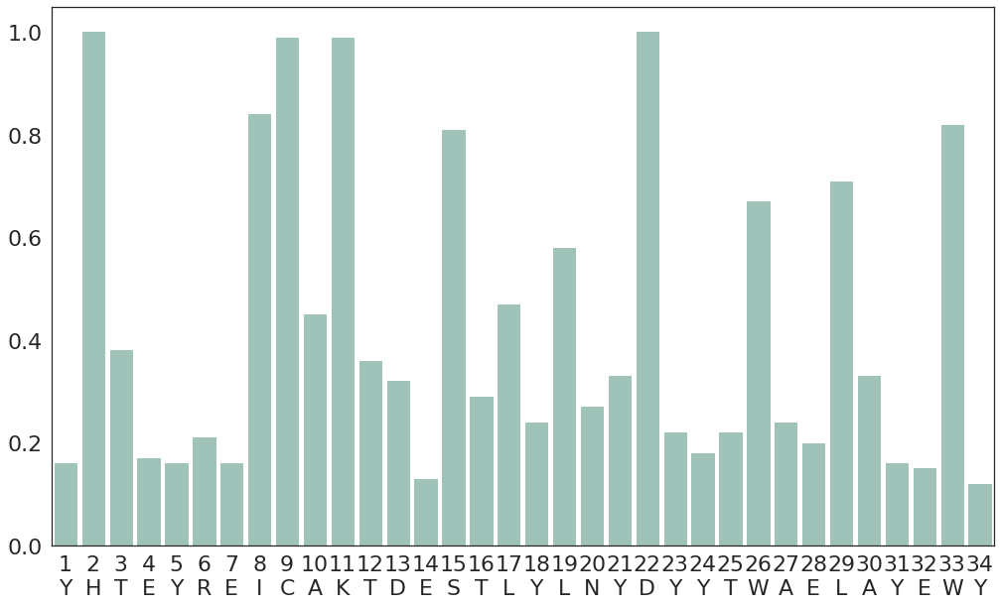

[0.16, 1.0, 0.38, 0.17, 0.16, 0.21, 0.16, 0.84, 0.99, 0.45, 0.99, 0.36, 0.32, 0.13, 0.81, 0.29, 0.47, 0.24, 0.58, 0.27, 0.33, 1.0, 0.22, 0.18, 0.22, 0.67, 0.24, 0.2, 0.71, 0.33, 0.16, 0.15, 0.82, 0.12]

---------------------
#Peptides: 4148
HLA: HLA-B*57:03
Threshold: 0.6
YYAMYGENMASTYENIAYIVYNYYTWAVLAYLWY
threshold: 0.6


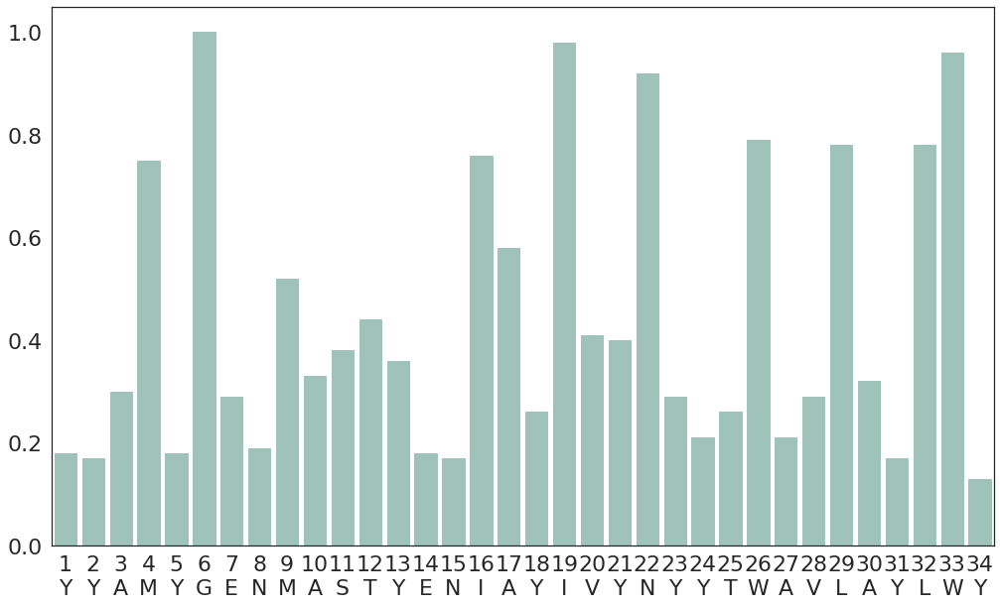

[0.18, 0.17, 0.3, 0.75, 0.18, 1.0, 0.29, 0.19, 0.52, 0.33, 0.38, 0.44, 0.36, 0.18, 0.17, 0.76, 0.58, 0.26, 0.98, 0.41, 0.4, 0.92, 0.29, 0.21, 0.26, 0.79, 0.21, 0.29, 0.78, 0.32, 0.17, 0.78, 0.96, 0.13]

---------------------
#Peptides: 1617
HLA: HLA-C*12:03
Threshold: 0.6
YYAGYREKYRQADVSNLYLWYDSYTWAEWAYTWY
threshold: 0.6


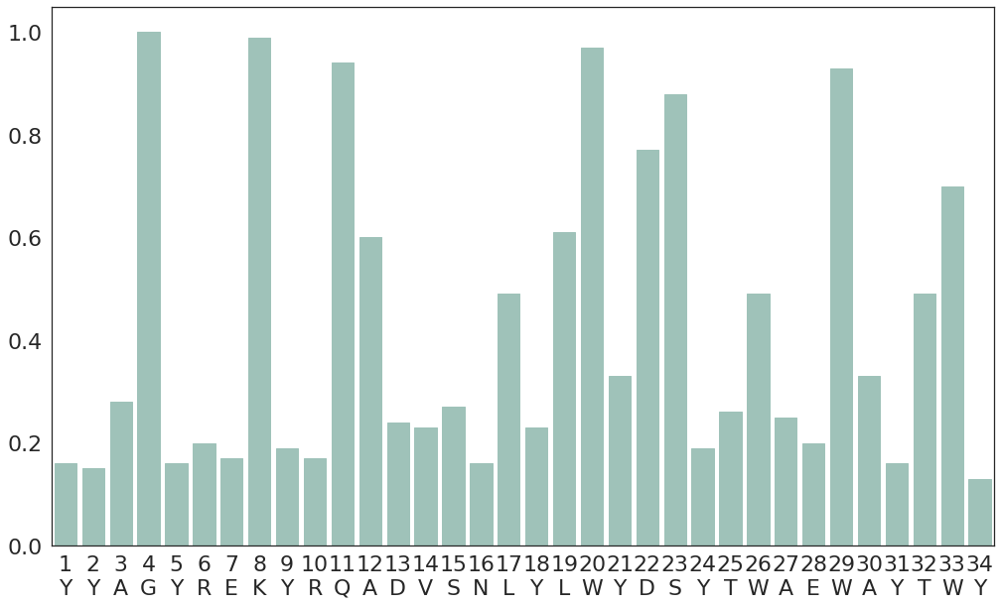

[0.16, 0.15, 0.28, 1.0, 0.16, 0.2, 0.17, 0.99, 0.19, 0.17, 0.94, 0.6, 0.24, 0.23, 0.27, 0.16, 0.49, 0.23, 0.61, 0.97, 0.33, 0.77, 0.88, 0.19, 0.26, 0.49, 0.25, 0.2, 0.93, 0.33, 0.16, 0.49, 0.7, 0.13]

---------------------
#Peptides: 487
HLA: HLA-B*39:24
Threshold: 0.6
YYSEYRNICTNTDESNLYLSYNFYTWAVLTYTWY
threshold: 0.6


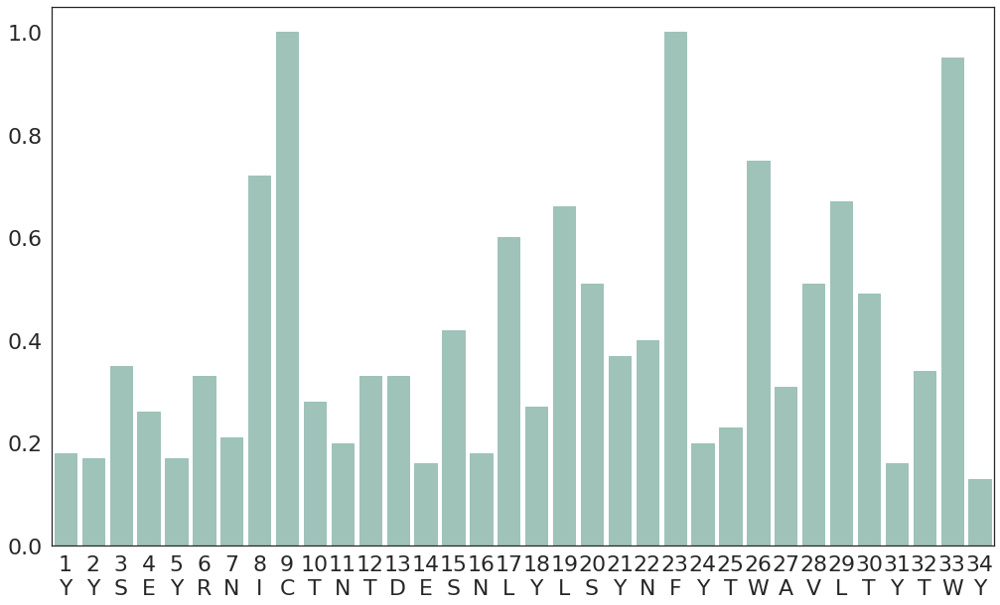

[0.18, 0.17, 0.35, 0.26, 0.17, 0.33, 0.21, 0.72, 1.0, 0.28, 0.2, 0.33, 0.33, 0.16, 0.42, 0.18, 0.6, 0.27, 0.66, 0.51, 0.37, 0.4, 1.0, 0.2, 0.23, 0.75, 0.31, 0.51, 0.67, 0.49, 0.16, 0.34, 0.95, 0.13]

---------------------
#Peptides: 9073
HLA: HLA-A*11:01
Threshold: 0.6
YYAMYQENVAQTDVDTLYIIYRDYTWAAQAYRWY
threshold: 0.6


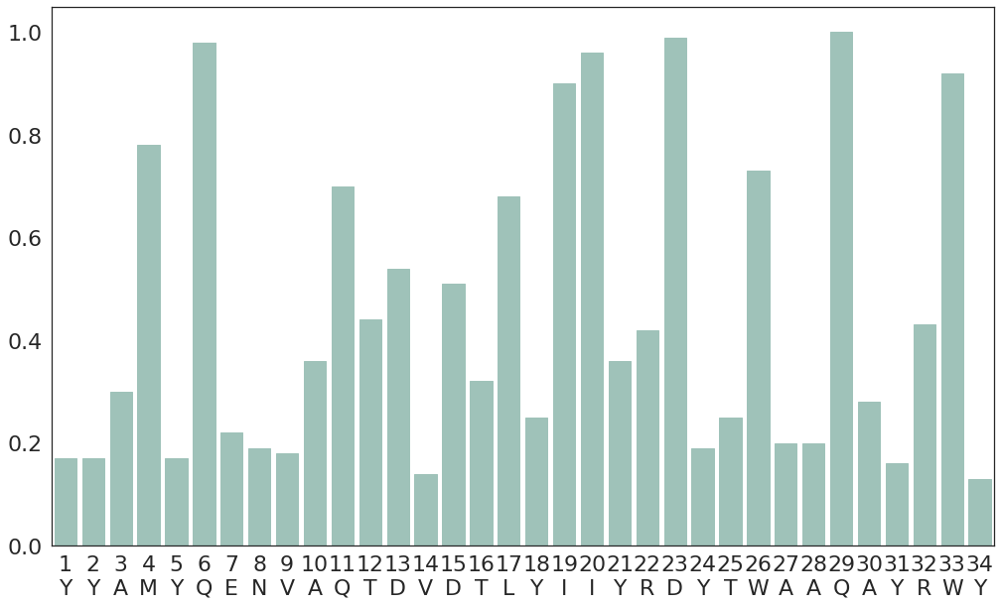

[0.17, 0.17, 0.3, 0.78, 0.17, 0.98, 0.22, 0.19, 0.18, 0.36, 0.7, 0.44, 0.54, 0.14, 0.51, 0.32, 0.68, 0.25, 0.9, 0.96, 0.36, 0.42, 0.99, 0.19, 0.25, 0.73, 0.2, 0.2, 1.0, 0.28, 0.16, 0.43, 0.92, 0.13]

---------------------
#Peptides: 8607
HLA: HLA-B*35:01
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVLAYLWY
threshold: 0.6


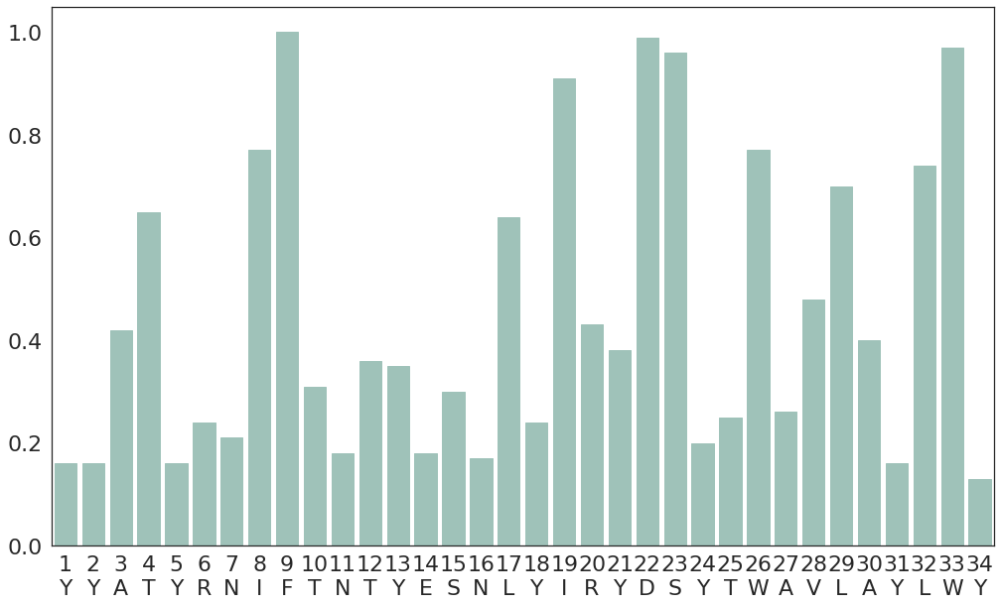

[0.16, 0.16, 0.42, 0.65, 0.16, 0.24, 0.21, 0.77, 1.0, 0.31, 0.18, 0.36, 0.35, 0.18, 0.3, 0.17, 0.64, 0.24, 0.91, 0.43, 0.38, 0.99, 0.96, 0.2, 0.25, 0.77, 0.26, 0.48, 0.7, 0.4, 0.16, 0.74, 0.97, 0.13]

---------------------
#Peptides: 308
HLA: HLA-A*24:03
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTWY
threshold: 0.6


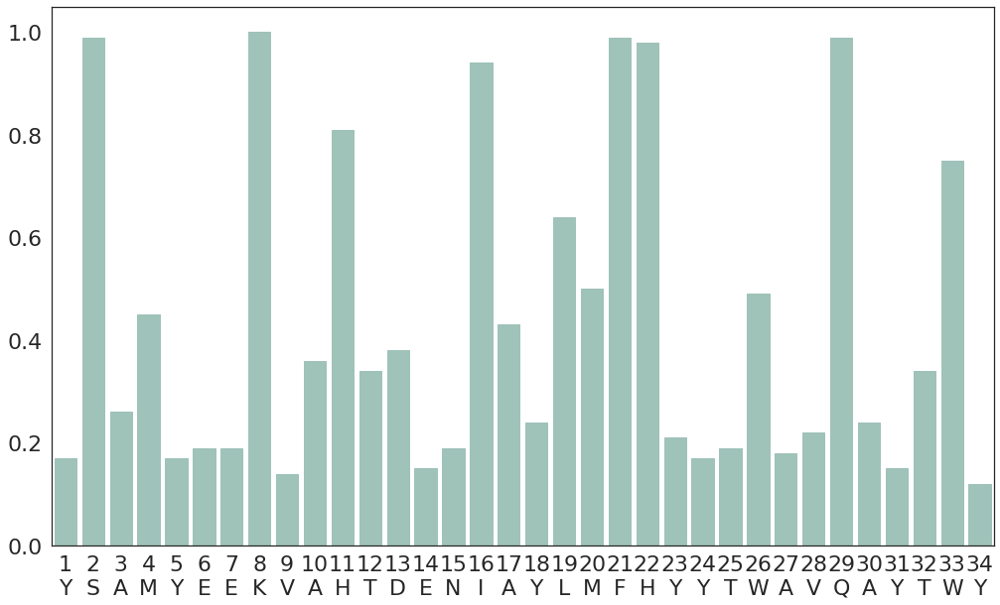

[0.17, 0.99, 0.26, 0.45, 0.17, 0.19, 0.19, 1.0, 0.14, 0.36, 0.81, 0.34, 0.38, 0.15, 0.19, 0.94, 0.43, 0.24, 0.64, 0.5, 0.99, 0.98, 0.21, 0.17, 0.19, 0.49, 0.18, 0.22, 0.99, 0.24, 0.15, 0.34, 0.75, 0.12]

---------------------
#Peptides: 188
HLA: HLA-A*26:02
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQNYTWAEWAYRWY
threshold: 0.6


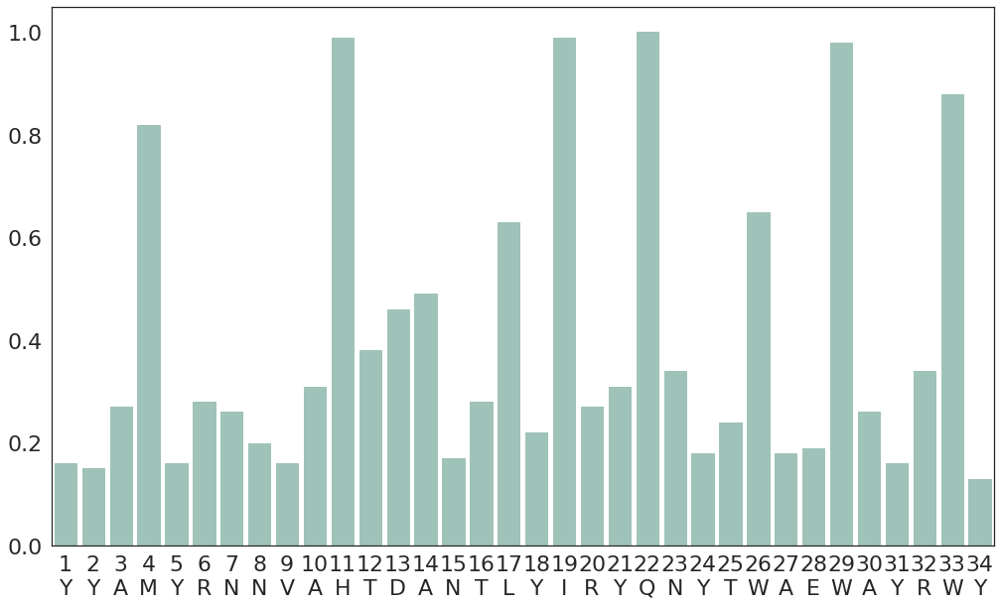

[0.16, 0.15, 0.27, 0.82, 0.16, 0.28, 0.26, 0.2, 0.16, 0.31, 0.99, 0.38, 0.46, 0.49, 0.17, 0.28, 0.63, 0.22, 0.99, 0.27, 0.31, 1.0, 0.34, 0.18, 0.24, 0.65, 0.18, 0.19, 0.98, 0.26, 0.16, 0.34, 0.88, 0.13]

---------------------
#Peptides: 5192
HLA: HLA-A*68:02
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYHYYTWAVWAYTWY
threshold: 0.6


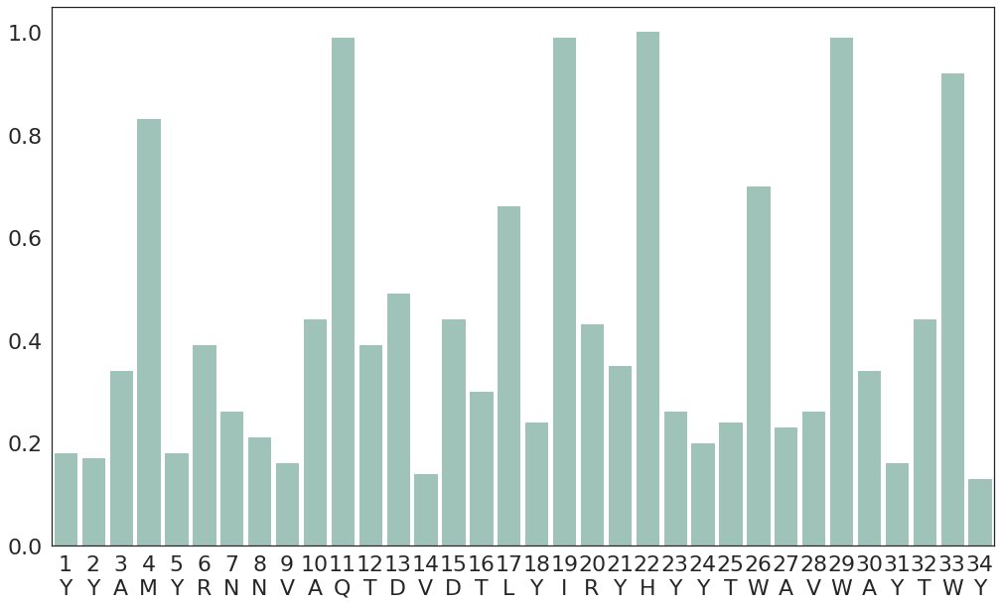

[0.18, 0.17, 0.34, 0.83, 0.18, 0.39, 0.26, 0.21, 0.16, 0.44, 0.99, 0.39, 0.49, 0.14, 0.44, 0.3, 0.66, 0.24, 0.99, 0.43, 0.35, 1.0, 0.26, 0.2, 0.24, 0.7, 0.23, 0.26, 0.99, 0.34, 0.16, 0.44, 0.92, 0.13]

---------------------
#Peptides: 4815
HLA: HLA-C*02:02
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYDSYTWAEWAYEWY
threshold: 0.6


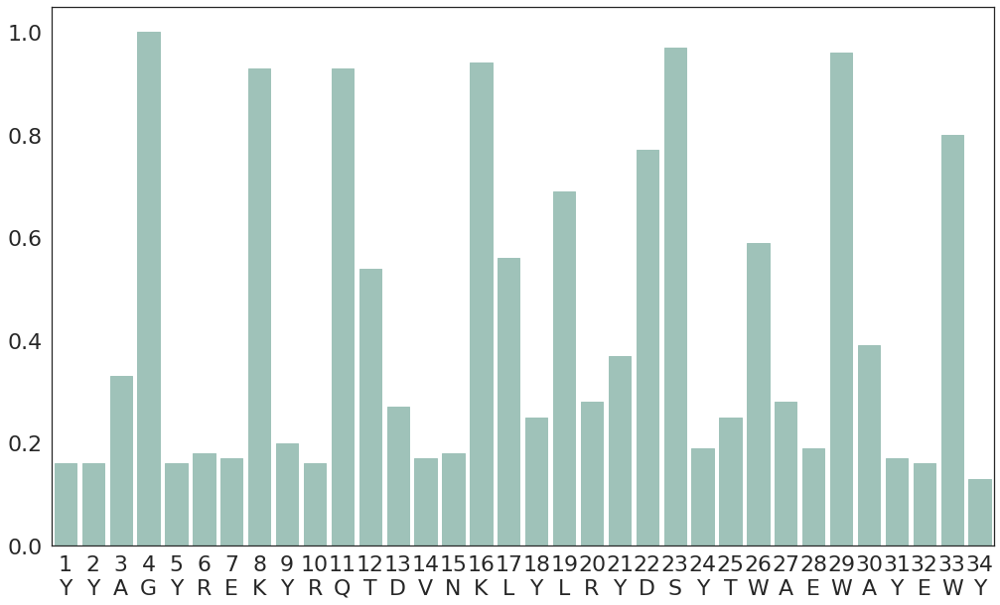

[0.16, 0.16, 0.33, 1.0, 0.16, 0.18, 0.17, 0.93, 0.2, 0.16, 0.93, 0.54, 0.27, 0.17, 0.18, 0.94, 0.56, 0.25, 0.69, 0.28, 0.37, 0.77, 0.97, 0.19, 0.25, 0.59, 0.28, 0.19, 0.96, 0.39, 0.17, 0.16, 0.8, 0.13]

---------------------
#Peptides: 212
HLA: HLA-B*18:03
Threshold: 0.59
YHSTYRNISTNTDESNLYLRYDSYTWAVLAYTWH
threshold: 0.59


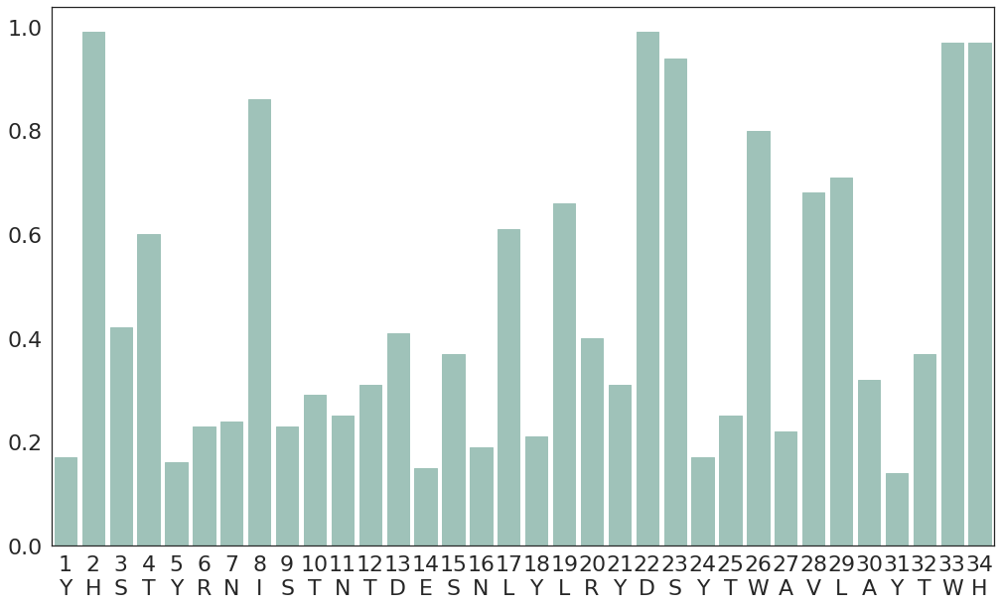

[0.17, 0.99, 0.42, 0.6, 0.16, 0.23, 0.24, 0.86, 0.23, 0.29, 0.25, 0.31, 0.41, 0.15, 0.37, 0.19, 0.61, 0.21, 0.66, 0.4, 0.31, 0.99, 0.94, 0.17, 0.25, 0.8, 0.22, 0.68, 0.71, 0.32, 0.14, 0.37, 0.97, 0.97]

---------------------
#Peptides: 7241
HLA: HLA-B*44:02
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY
threshold: 0.6


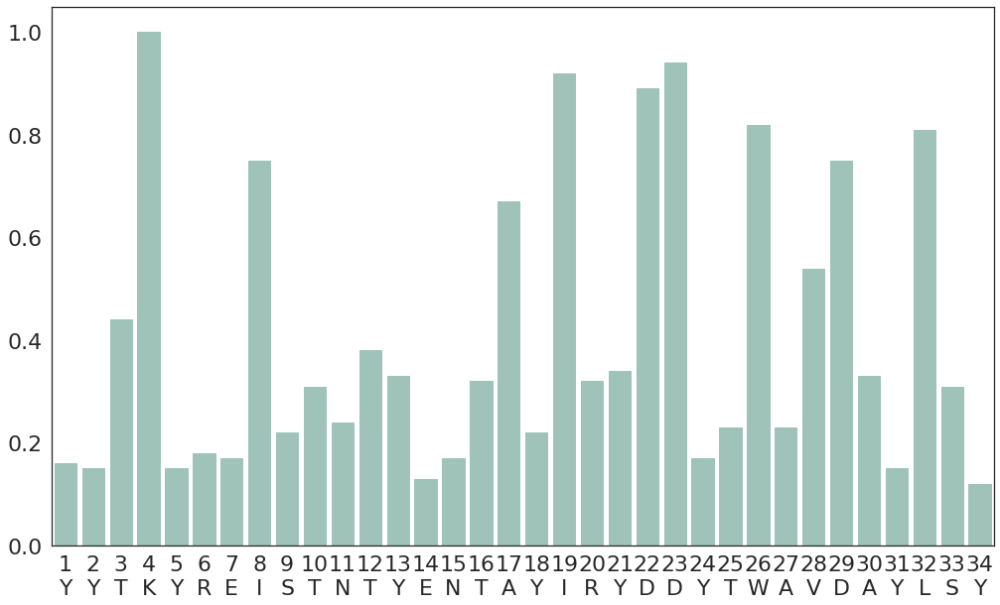

[0.16, 0.15, 0.44, 1.0, 0.15, 0.18, 0.17, 0.75, 0.22, 0.31, 0.24, 0.38, 0.33, 0.13, 0.17, 0.32, 0.67, 0.22, 0.92, 0.32, 0.34, 0.89, 0.94, 0.17, 0.23, 0.82, 0.23, 0.54, 0.75, 0.33, 0.15, 0.81, 0.31, 0.12]

---------------------
#Peptides: 393
HLA: HLA-B*15:17
Threshold: 0.6
YYAMYRENMASTYENIAYLRYHDYTWAELAYLWY
threshold: 0.6


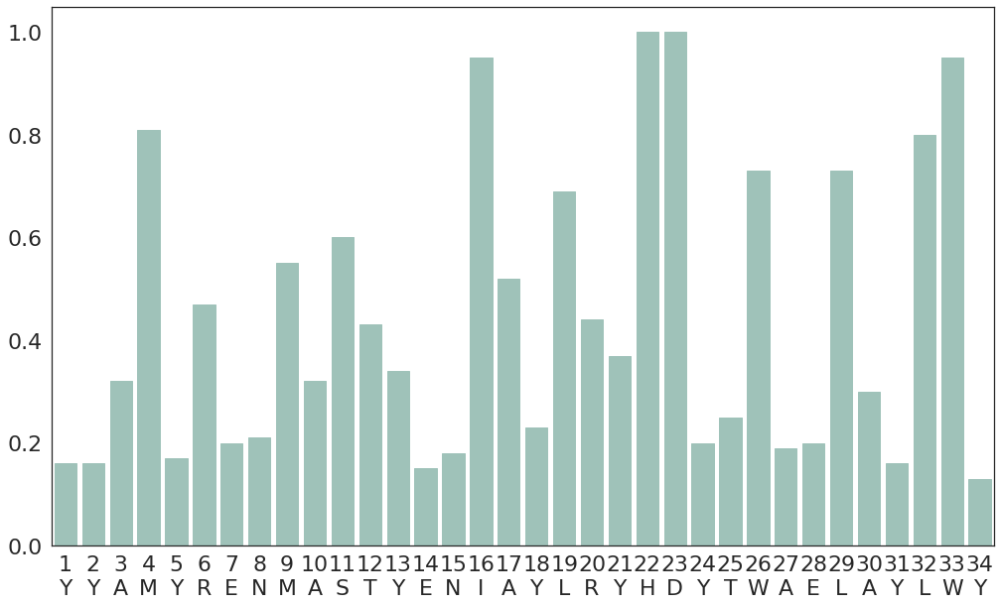

[0.16, 0.16, 0.32, 0.81, 0.17, 0.47, 0.2, 0.21, 0.55, 0.32, 0.6, 0.43, 0.34, 0.15, 0.18, 0.95, 0.52, 0.23, 0.69, 0.44, 0.37, 1.0, 1.0, 0.2, 0.25, 0.73, 0.19, 0.2, 0.73, 0.3, 0.16, 0.8, 0.95, 0.13]

---------------------
#Peptides: 431
HLA: HLA-C*17:01
Threshold: 0.6
YYAGYREKYRQADVNKLYIRYNFYSLAELAYEWY
threshold: 0.6


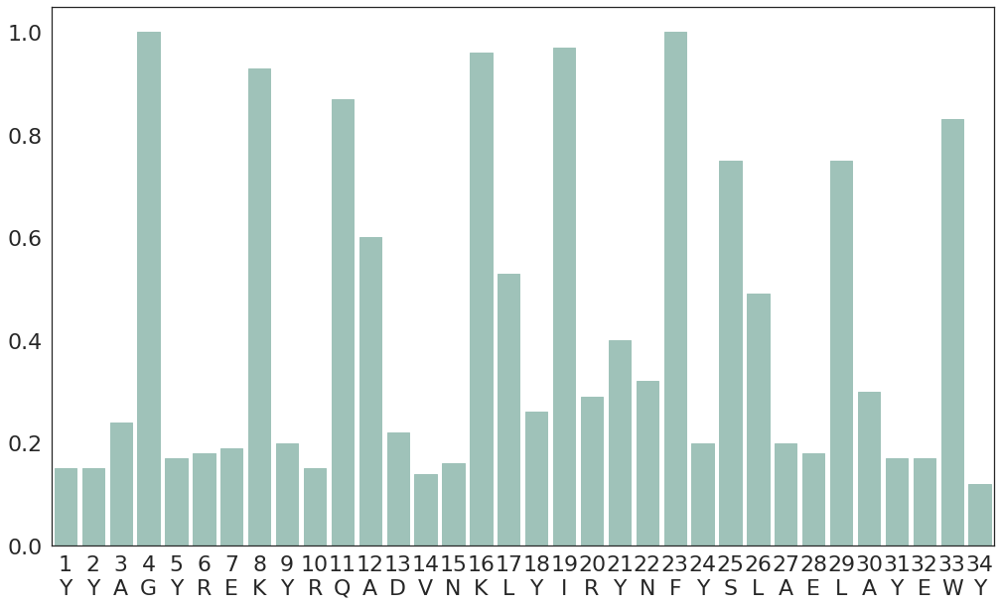

[0.15, 0.15, 0.24, 1.0, 0.17, 0.18, 0.19, 0.93, 0.2, 0.15, 0.87, 0.6, 0.22, 0.14, 0.16, 0.96, 0.53, 0.26, 0.97, 0.29, 0.4, 0.32, 1.0, 0.2, 0.75, 0.49, 0.2, 0.18, 0.75, 0.3, 0.17, 0.17, 0.83, 0.12]

---------------------
#Peptides: 8131
HLA: HLA-A*24:02
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTGY
threshold: 0.6


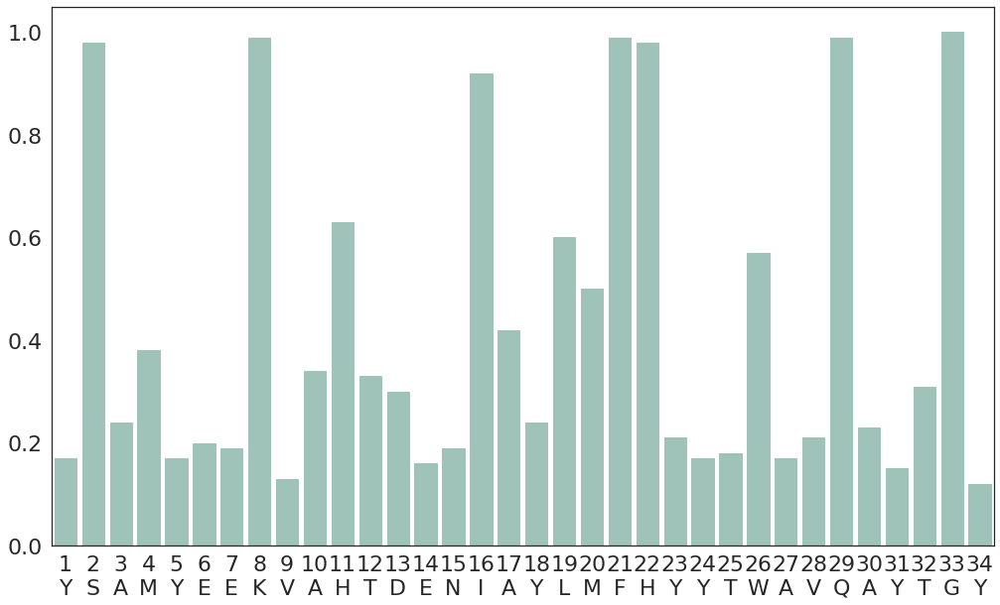

[0.17, 0.98, 0.24, 0.38, 0.17, 0.2, 0.19, 0.99, 0.13, 0.34, 0.63, 0.33, 0.3, 0.16, 0.19, 0.92, 0.42, 0.24, 0.6, 0.5, 0.99, 0.98, 0.21, 0.17, 0.18, 0.57, 0.17, 0.21, 0.99, 0.23, 0.15, 0.31, 1.0, 0.12]

---------------------
#Peptides: 3194
HLA: HLA-B*14:02
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH
threshold: 0.6


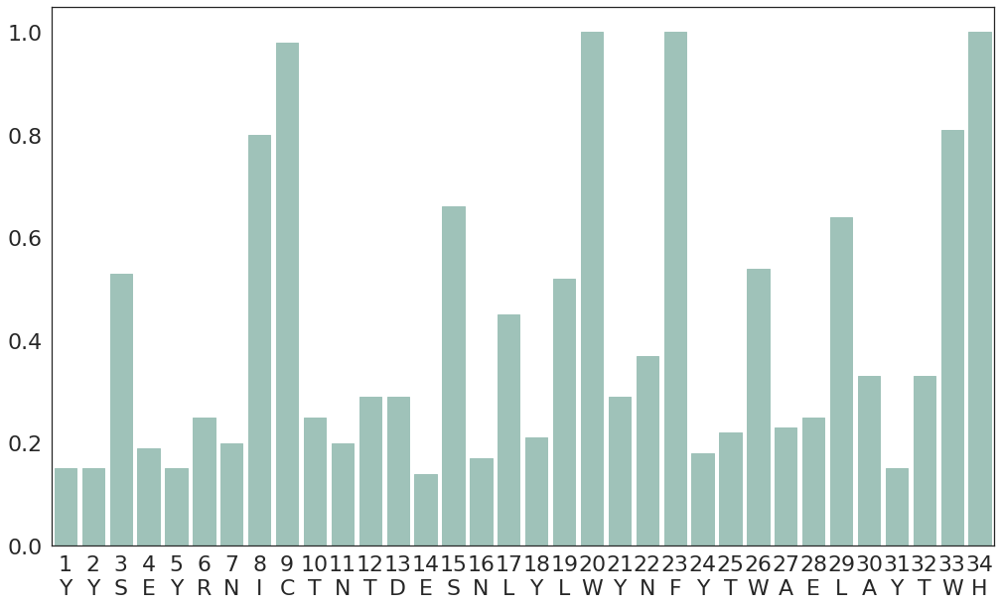

[0.15, 0.15, 0.53, 0.19, 0.15, 0.25, 0.2, 0.8, 0.98, 0.25, 0.2, 0.29, 0.29, 0.14, 0.66, 0.17, 0.45, 0.21, 0.52, 1.0, 0.29, 0.37, 1.0, 0.18, 0.22, 0.54, 0.23, 0.25, 0.64, 0.33, 0.15, 0.33, 0.81, 1.0]

---------------------
#Peptides: 3973
HLA: HLA-A*02:03
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAEWAYTWY
threshold: 0.6


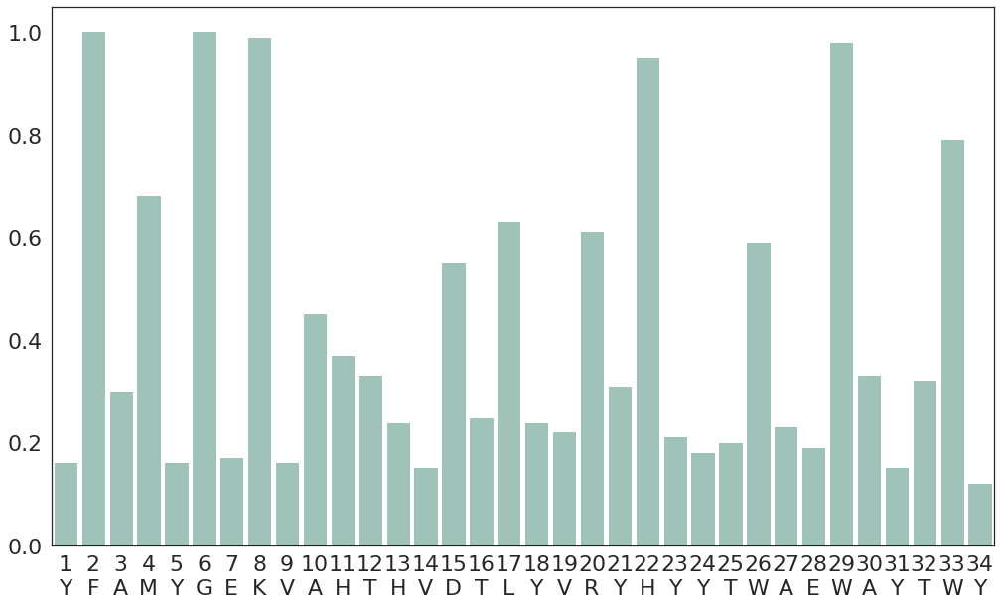

[0.16, 1.0, 0.3, 0.68, 0.16, 1.0, 0.17, 0.99, 0.16, 0.45, 0.37, 0.33, 0.24, 0.15, 0.55, 0.25, 0.63, 0.24, 0.22, 0.61, 0.31, 0.95, 0.21, 0.18, 0.2, 0.59, 0.23, 0.19, 0.98, 0.33, 0.15, 0.32, 0.79, 0.12]

---------------------
#Peptides: 2004
HLA: HLA-A*02:02
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY
threshold: 0.6


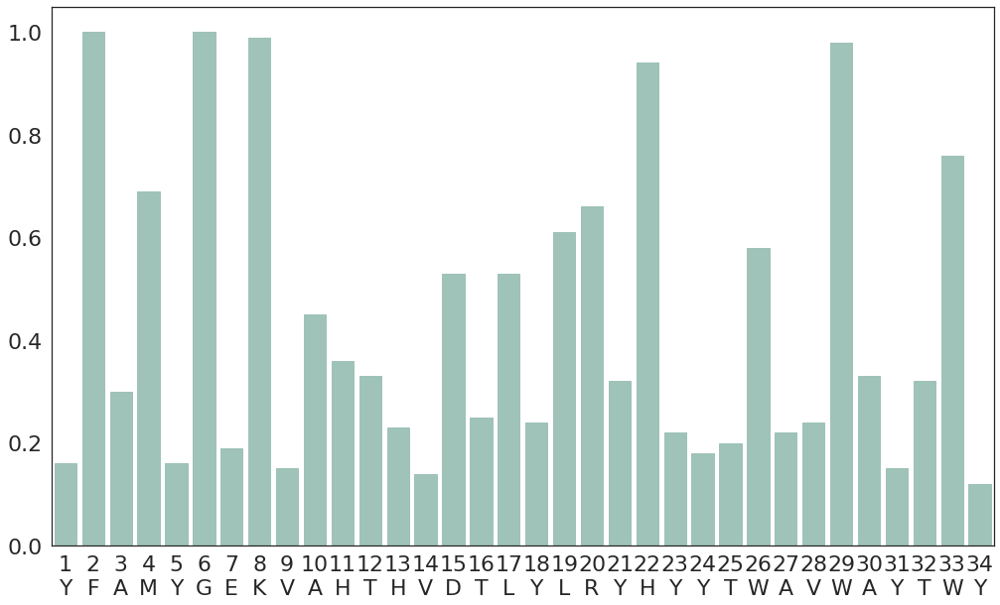

[0.16, 1.0, 0.3, 0.69, 0.16, 1.0, 0.19, 0.99, 0.15, 0.45, 0.36, 0.33, 0.23, 0.14, 0.53, 0.25, 0.53, 0.24, 0.61, 0.66, 0.32, 0.94, 0.22, 0.18, 0.2, 0.58, 0.22, 0.24, 0.98, 0.33, 0.15, 0.32, 0.76, 0.12]

---------------------
#Peptides: 198
HLA: HLA-A*02:19
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTGY
threshold: 0.6


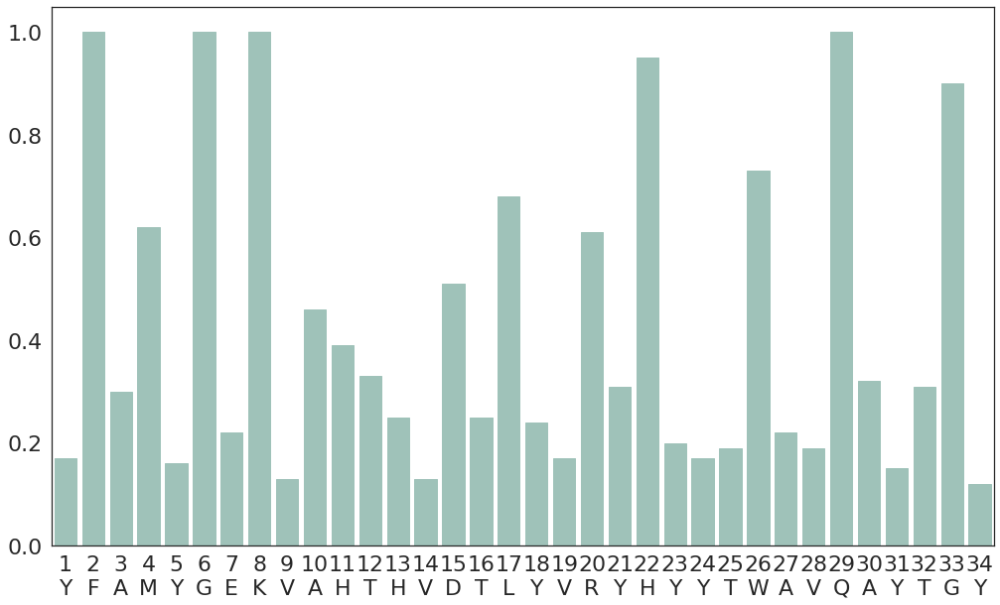

[0.17, 1.0, 0.3, 0.62, 0.16, 1.0, 0.22, 1.0, 0.13, 0.46, 0.39, 0.33, 0.25, 0.13, 0.51, 0.25, 0.68, 0.24, 0.17, 0.61, 0.31, 0.95, 0.2, 0.17, 0.19, 0.73, 0.22, 0.19, 1.0, 0.32, 0.15, 0.31, 0.9, 0.12]

---------------------
#Peptides: 1627
HLA: HLA-B*27:07
Threshold: 0.6
YHTEYREICAKTDEDTLYLSYNYYTWAVLAYEWY
threshold: 0.6


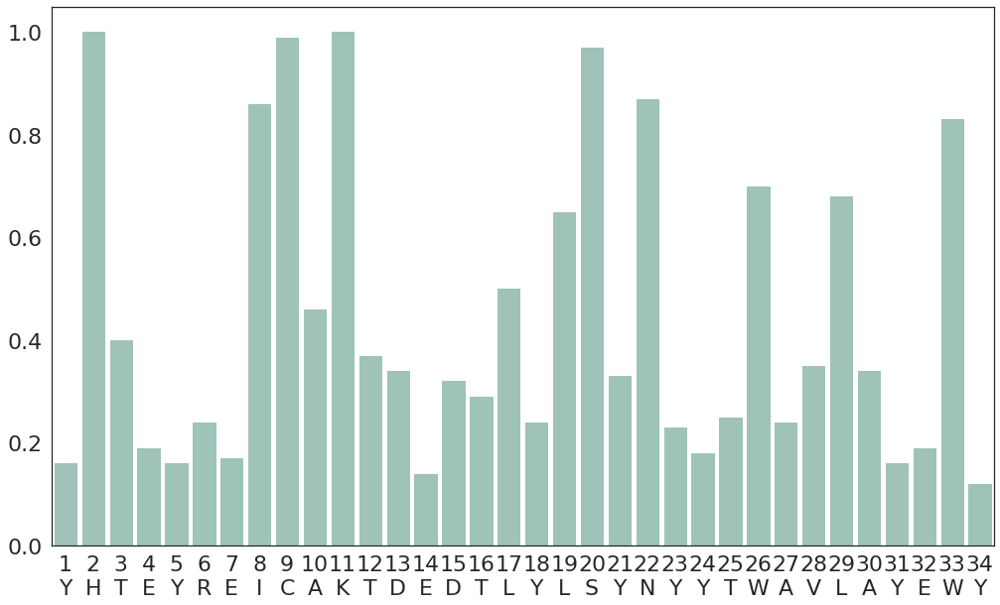

[0.16, 1.0, 0.4, 0.19, 0.16, 0.24, 0.17, 0.86, 0.99, 0.46, 1.0, 0.37, 0.34, 0.14, 0.32, 0.29, 0.5, 0.24, 0.65, 0.97, 0.33, 0.87, 0.23, 0.18, 0.25, 0.7, 0.24, 0.35, 0.68, 0.34, 0.16, 0.19, 0.83, 0.12]

---------------------
#Peptides: 1922
HLA: HLA-C*01:02
Threshold: 0.6
YFSGYREKYRQTDVSNLYLWCDYYTWAERAYTWY
threshold: 0.6


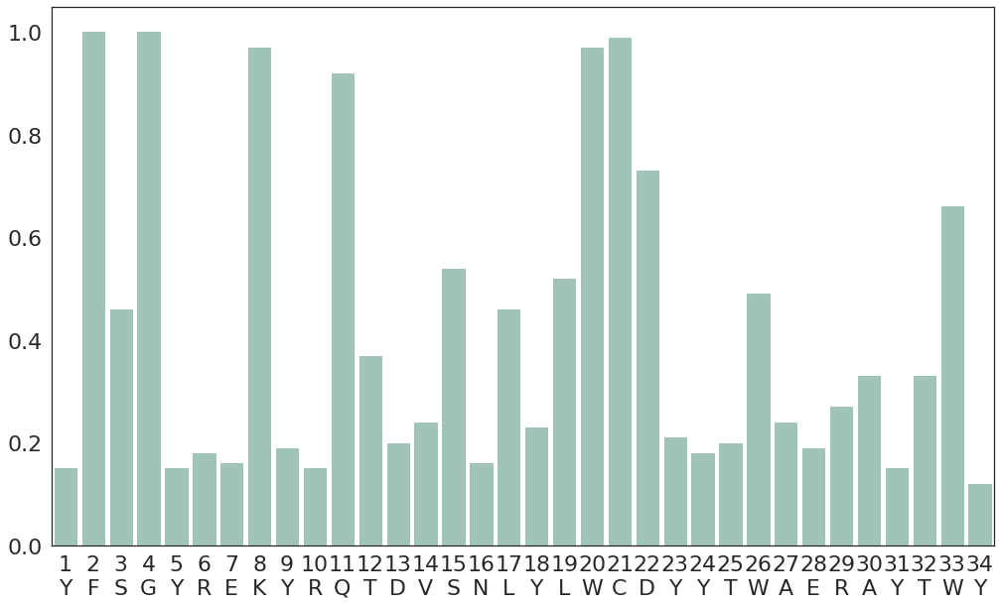

[0.15, 1.0, 0.46, 1.0, 0.15, 0.18, 0.16, 0.97, 0.19, 0.15, 0.92, 0.37, 0.2, 0.24, 0.54, 0.16, 0.46, 0.23, 0.52, 0.97, 0.99, 0.73, 0.21, 0.18, 0.2, 0.49, 0.24, 0.19, 0.27, 0.33, 0.15, 0.33, 0.66, 0.12]

---------------------
#Peptides: 242
HLA: HLA-A*24:06
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVWAYTGY
threshold: 0.6


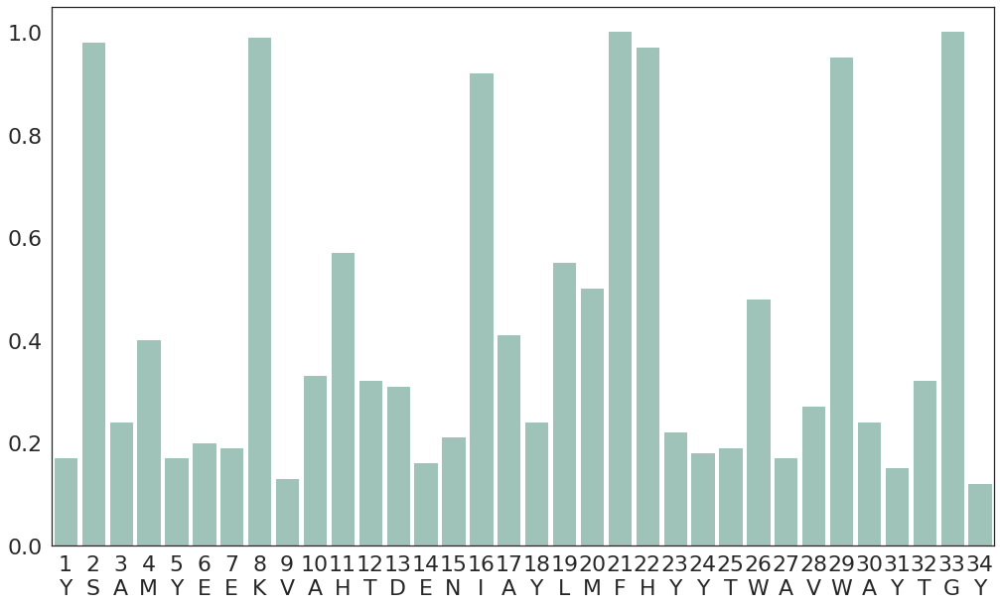

[0.17, 0.98, 0.24, 0.4, 0.17, 0.2, 0.19, 0.99, 0.13, 0.33, 0.57, 0.32, 0.31, 0.16, 0.21, 0.92, 0.41, 0.24, 0.55, 0.5, 1.0, 0.97, 0.22, 0.18, 0.19, 0.48, 0.17, 0.27, 0.95, 0.24, 0.15, 0.32, 1.0, 0.12]

---------------------
#Peptides: 4440
HLA: HLA-B*27:09
Threshold: 0.6
YHTEYREICAKTDEDTLYLNYHHYTWAVLAYEWY
threshold: 0.6


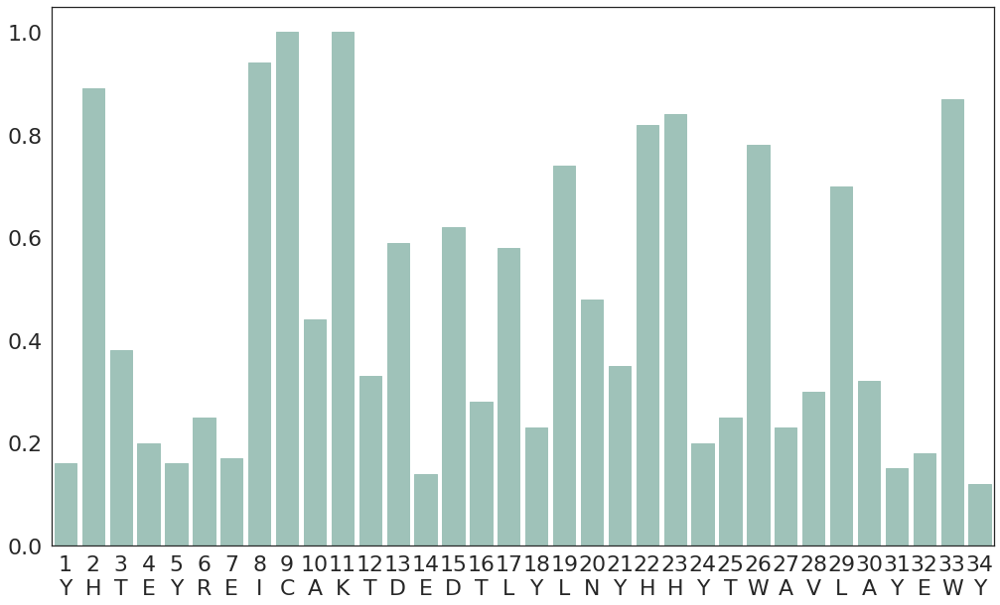

[0.16, 0.89, 0.38, 0.2, 0.16, 0.25, 0.17, 0.94, 1.0, 0.44, 1.0, 0.33, 0.59, 0.14, 0.62, 0.28, 0.58, 0.23, 0.74, 0.48, 0.35, 0.82, 0.84, 0.2, 0.25, 0.78, 0.23, 0.3, 0.7, 0.32, 0.15, 0.18, 0.87, 0.12]

---------------------
#Peptides: 1065
HLA: HLA-B*35:08
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVRAYLWY
threshold: 0.6


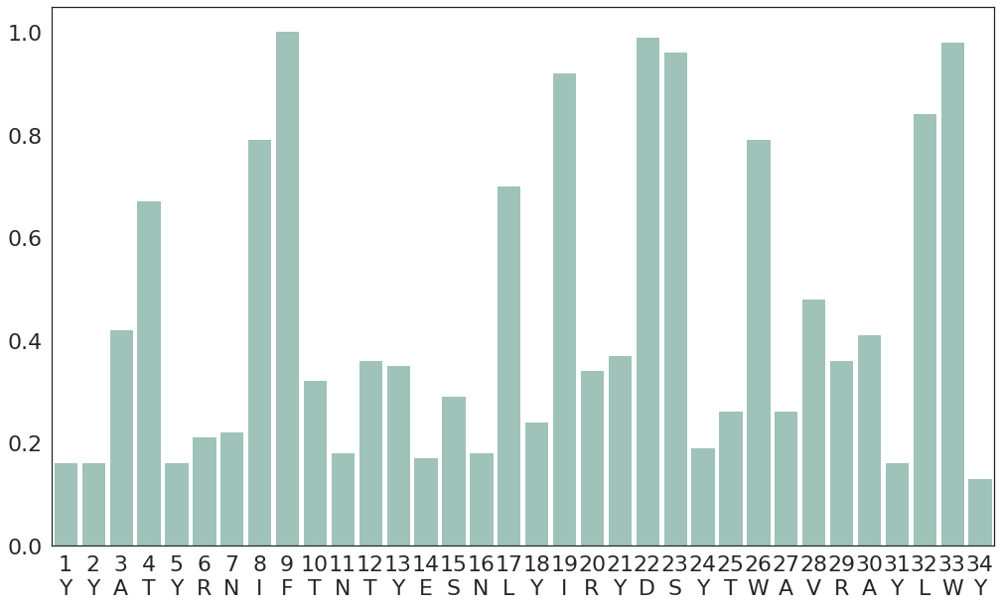

[0.16, 0.16, 0.42, 0.67, 0.16, 0.21, 0.22, 0.79, 1.0, 0.32, 0.18, 0.36, 0.35, 0.17, 0.29, 0.18, 0.7, 0.24, 0.92, 0.34, 0.37, 0.99, 0.96, 0.19, 0.26, 0.79, 0.26, 0.48, 0.36, 0.41, 0.16, 0.84, 0.98, 0.13]

---------------------
#Peptides: 7510
HLA: HLA-B*40:02
Threshold: 0.6
YHTKYREISTNTYESNLYLSYNYYTWAVLAYEWY
threshold: 0.6


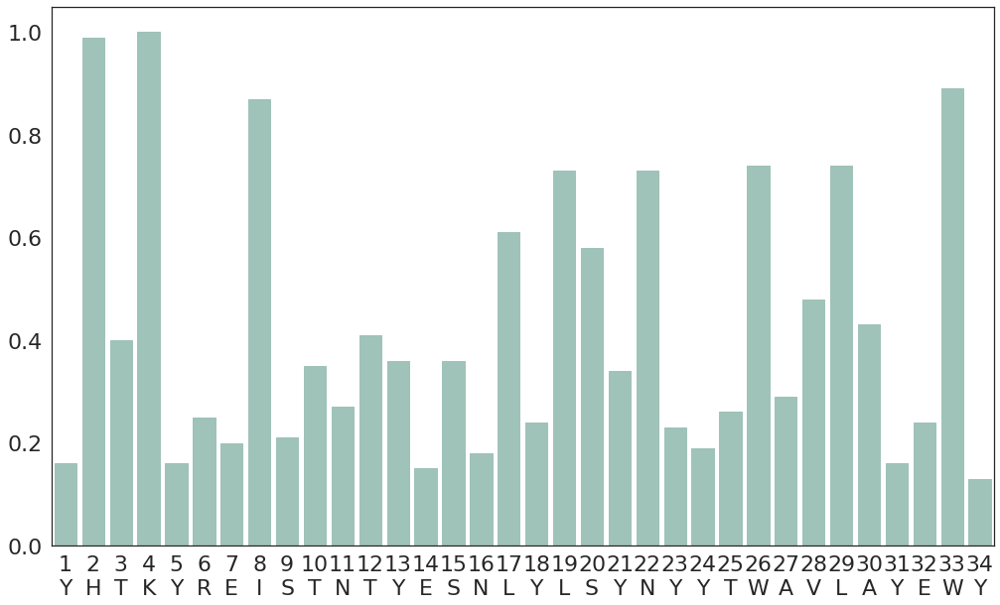

[0.16, 0.99, 0.4, 1.0, 0.16, 0.25, 0.2, 0.87, 0.21, 0.35, 0.27, 0.41, 0.36, 0.15, 0.36, 0.18, 0.61, 0.24, 0.73, 0.58, 0.34, 0.73, 0.23, 0.19, 0.26, 0.74, 0.29, 0.48, 0.74, 0.43, 0.16, 0.24, 0.89, 0.13]

---------------------
#Peptides: 96
HLA: HLA-A*25:01
Threshold: 0.6
YYAMYRNNVAHTDESIAYIRYQDYTWAEWAYRWY
threshold: 0.6


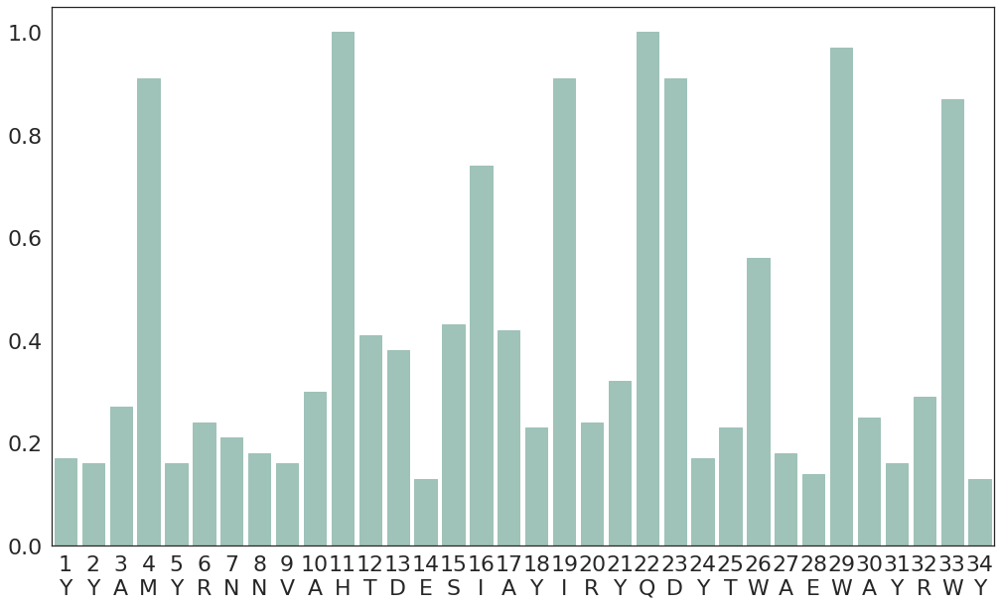

[0.17, 0.16, 0.27, 0.91, 0.16, 0.24, 0.21, 0.18, 0.16, 0.3, 1.0, 0.41, 0.38, 0.13, 0.43, 0.74, 0.42, 0.23, 0.91, 0.24, 0.32, 1.0, 0.91, 0.17, 0.23, 0.56, 0.18, 0.14, 0.97, 0.25, 0.16, 0.29, 0.87, 0.13]

---------------------
#Peptides: 11958
HLA: HLA-B*57:01
Threshold: 0.6
YYAMYGENMASTYENIAYIVYDSYTWAVLAYLWY
threshold: 0.6


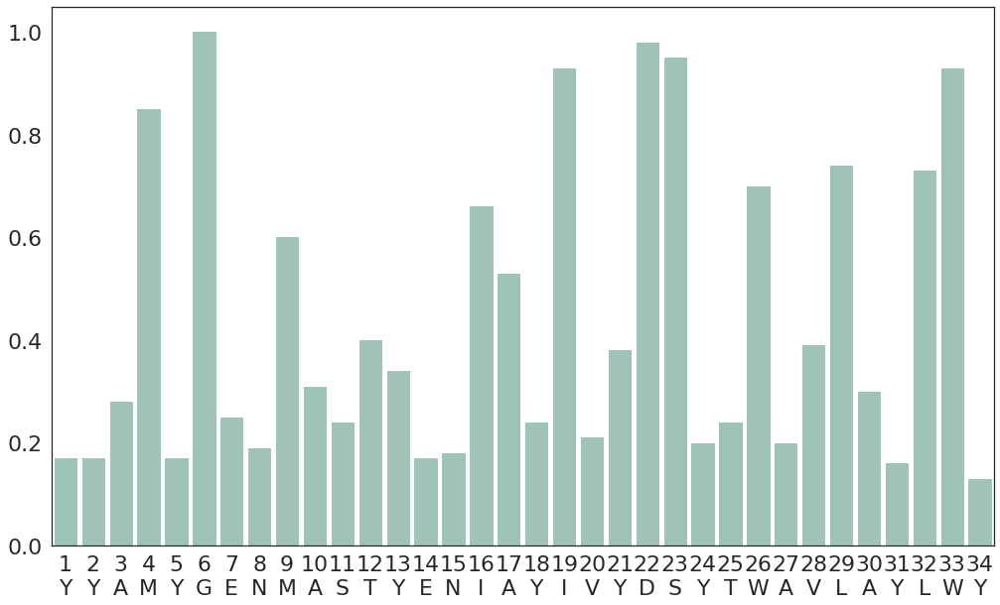

[0.17, 0.17, 0.28, 0.85, 0.17, 1.0, 0.25, 0.19, 0.6, 0.31, 0.24, 0.4, 0.34, 0.17, 0.18, 0.66, 0.53, 0.24, 0.93, 0.21, 0.38, 0.98, 0.95, 0.2, 0.24, 0.7, 0.2, 0.39, 0.74, 0.3, 0.16, 0.73, 0.93, 0.13]

---------------------
#Peptides: 24033
HLA: HLA-A*02:01
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY
threshold: 0.6


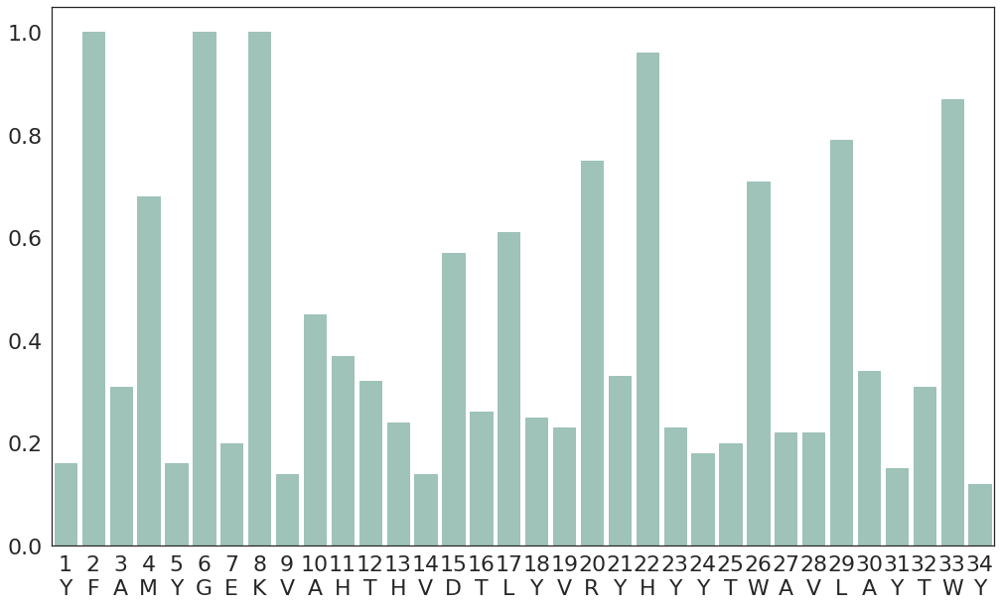

[0.16, 1.0, 0.31, 0.68, 0.16, 1.0, 0.2, 1.0, 0.14, 0.45, 0.37, 0.32, 0.24, 0.14, 0.57, 0.26, 0.61, 0.25, 0.23, 0.75, 0.33, 0.96, 0.23, 0.18, 0.2, 0.71, 0.22, 0.22, 0.79, 0.34, 0.15, 0.31, 0.87, 0.12]

---------------------
#Peptides: 1427
HLA: HLA-B*50:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAELAYLWY
threshold: 0.6


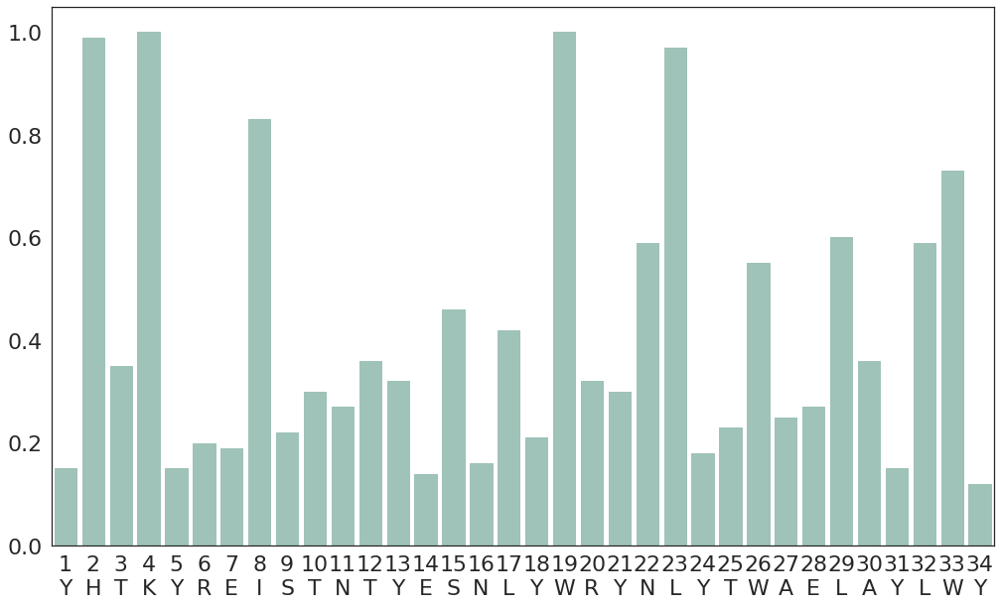

[0.15, 0.99, 0.35, 1.0, 0.15, 0.2, 0.19, 0.83, 0.22, 0.3, 0.27, 0.36, 0.32, 0.14, 0.46, 0.16, 0.42, 0.21, 1.0, 0.32, 0.3, 0.59, 0.97, 0.18, 0.23, 0.55, 0.25, 0.27, 0.6, 0.36, 0.15, 0.59, 0.73, 0.12]

---------------------
#Peptides: 12983
HLA: HLA-B*07:02
Threshold: 0.6
YYSEYRNIYAQTDESNLYLSYDYYTWAERAYEWY
threshold: 0.6


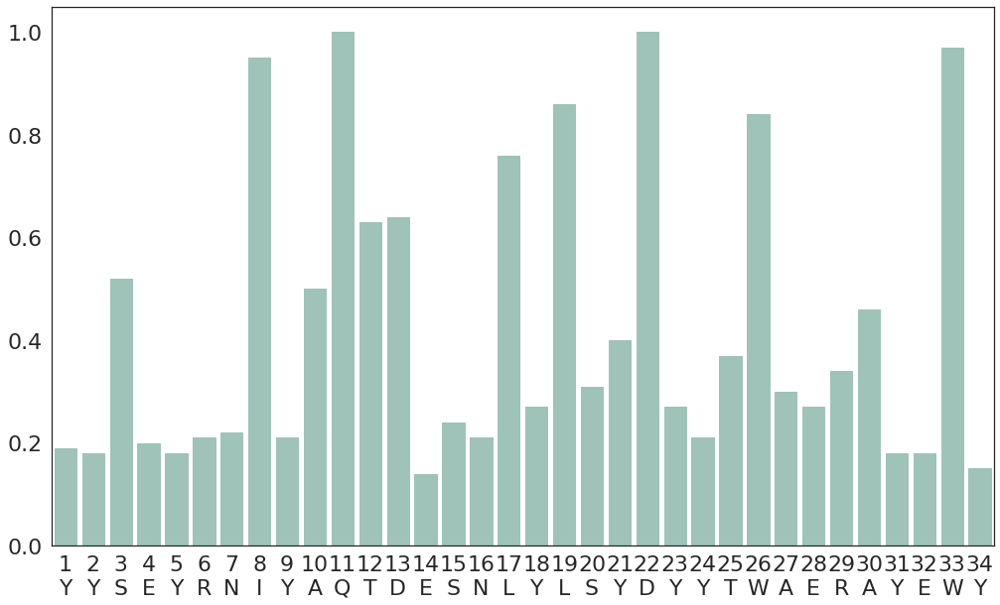

[0.19, 0.18, 0.52, 0.2, 0.18, 0.21, 0.22, 0.95, 0.21, 0.5, 1.0, 0.63, 0.64, 0.14, 0.24, 0.21, 0.76, 0.27, 0.86, 0.31, 0.4, 1.0, 0.27, 0.21, 0.37, 0.84, 0.3, 0.27, 0.34, 0.46, 0.18, 0.18, 0.97, 0.15]

---------------------
#Peptides: 280
HLA: HLA-B*45:06
Threshold: 0.6
YHTKYREIYAQTDESNLYWRYNLYTWAVDAYLSY
threshold: 0.6


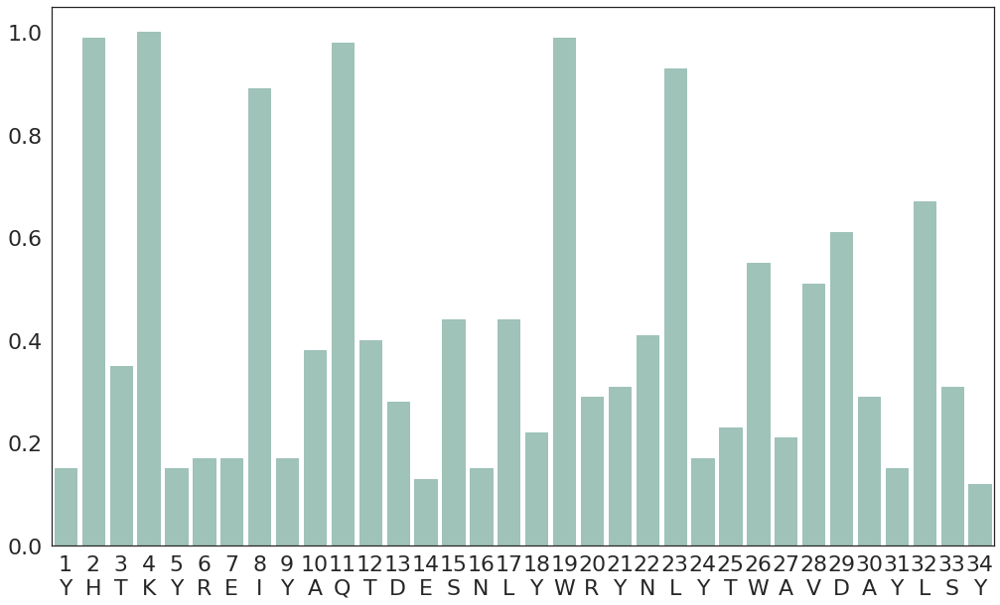

[0.15, 0.99, 0.35, 1.0, 0.15, 0.17, 0.17, 0.89, 0.17, 0.38, 0.98, 0.4, 0.28, 0.13, 0.44, 0.15, 0.44, 0.22, 0.99, 0.29, 0.31, 0.41, 0.93, 0.17, 0.23, 0.55, 0.21, 0.51, 0.61, 0.29, 0.15, 0.67, 0.31, 0.12]

---------------------
#Peptides: 118
HLA: HLA-A*24:13
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY
threshold: 0.6


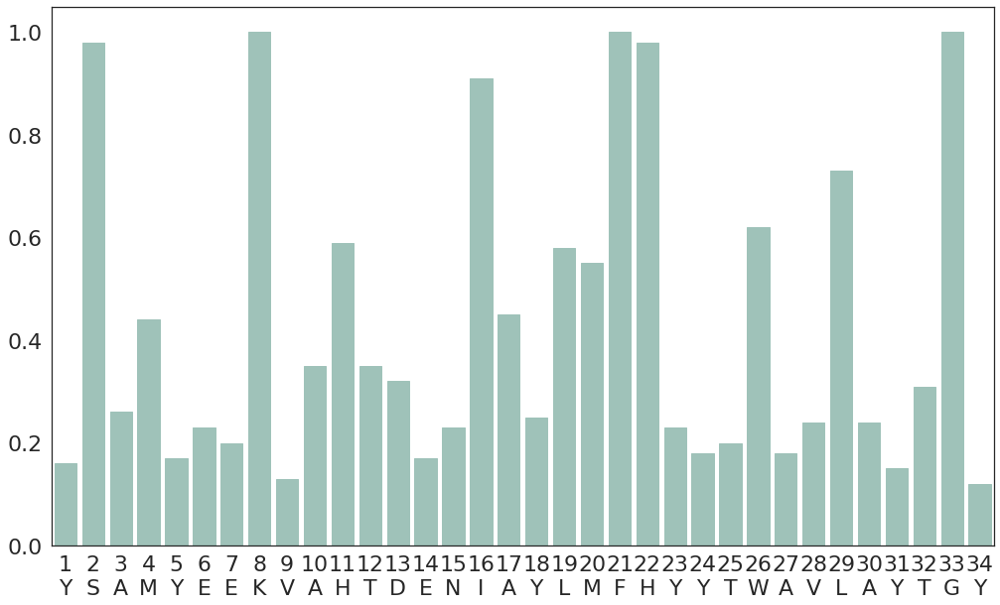

[0.16, 0.98, 0.26, 0.44, 0.17, 0.23, 0.2, 1.0, 0.13, 0.35, 0.59, 0.35, 0.32, 0.17, 0.23, 0.91, 0.45, 0.25, 0.58, 0.55, 1.0, 0.98, 0.23, 0.18, 0.2, 0.62, 0.18, 0.24, 0.73, 0.24, 0.15, 0.31, 1.0, 0.12]

---------------------
#Peptides: 54
HLA: HLA-B*44:27
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY
threshold: 0.6


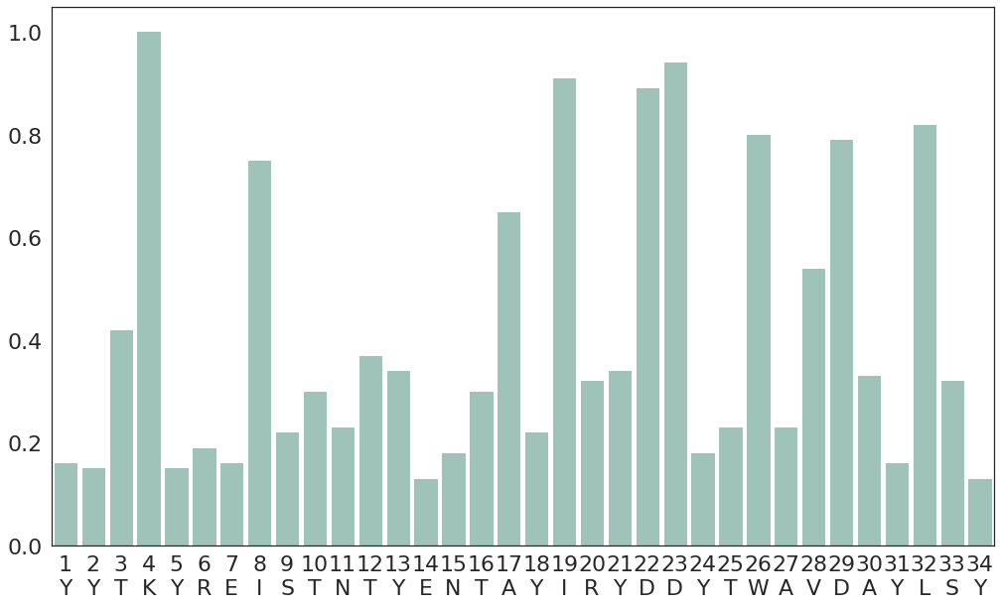

[0.16, 0.15, 0.42, 1.0, 0.15, 0.19, 0.16, 0.75, 0.22, 0.3, 0.23, 0.37, 0.34, 0.13, 0.18, 0.3, 0.65, 0.22, 0.91, 0.32, 0.34, 0.89, 0.94, 0.18, 0.23, 0.8, 0.23, 0.54, 0.79, 0.33, 0.16, 0.82, 0.32, 0.13]

---------------------
#Peptides: 76
HLA: HLA-B*14:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH
threshold: 0.6


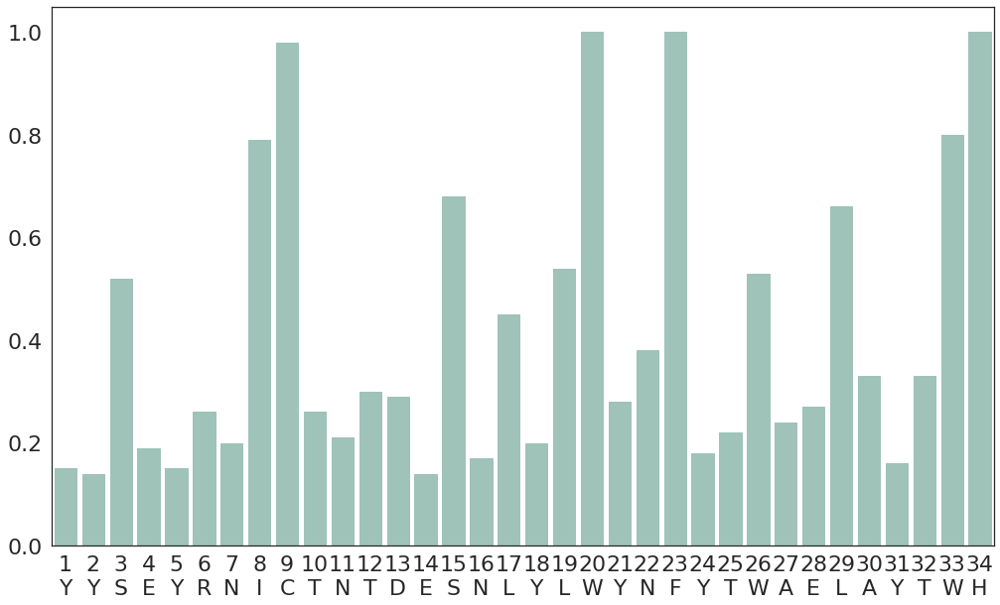

[0.15, 0.14, 0.52, 0.19, 0.15, 0.26, 0.2, 0.79, 0.98, 0.26, 0.21, 0.3, 0.29, 0.14, 0.68, 0.17, 0.45, 0.2, 0.54, 1.0, 0.28, 0.38, 1.0, 0.18, 0.22, 0.53, 0.24, 0.27, 0.66, 0.33, 0.16, 0.33, 0.8, 1.0]

---------------------
#Peptides: 5695
HLA: HLA-B*08:01
Threshold: 0.6
YDSEYRNIFTNTDESNLYLSYNYYTWAVDAYTWY
threshold: 0.6


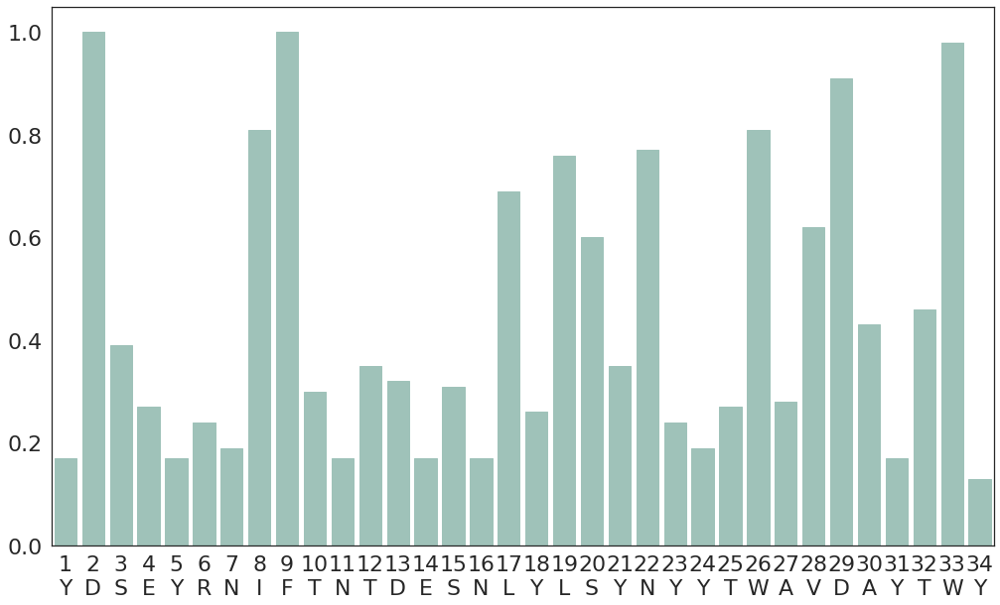

[0.17, 1.0, 0.39, 0.27, 0.17, 0.24, 0.19, 0.81, 1.0, 0.3, 0.17, 0.35, 0.32, 0.17, 0.31, 0.17, 0.69, 0.26, 0.76, 0.6, 0.35, 0.77, 0.24, 0.19, 0.27, 0.81, 0.28, 0.62, 0.91, 0.43, 0.17, 0.46, 0.98, 0.13]

---------------------
#Peptides: 4598
HLA: HLA-A*31:01
Threshold: 0.6
YTAMYQENVAHIDVDTLYIMYQDYTWAVLAYTWY
threshold: 0.6


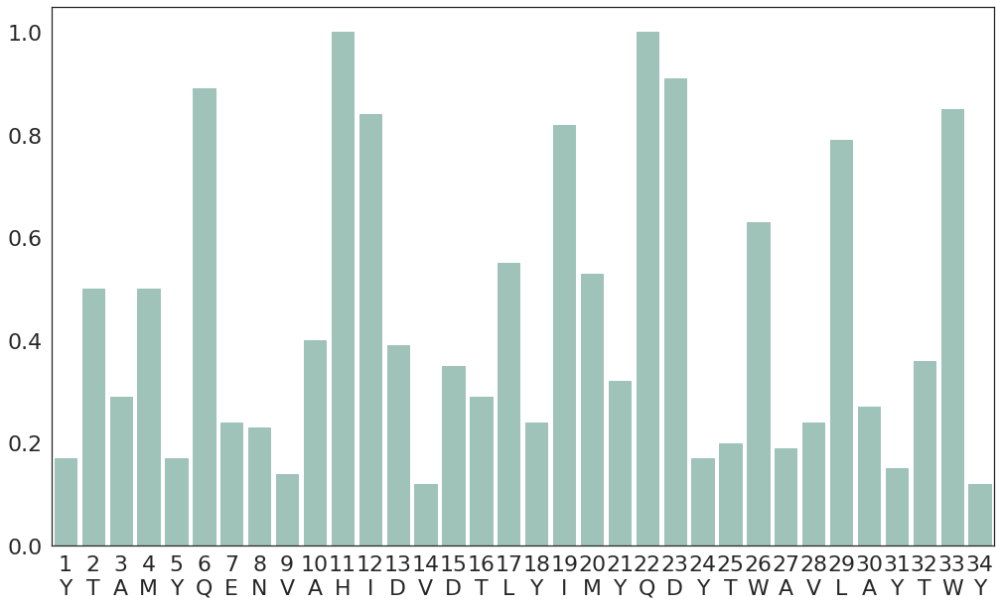

[0.17, 0.5, 0.29, 0.5, 0.17, 0.89, 0.24, 0.23, 0.14, 0.4, 1.0, 0.84, 0.39, 0.12, 0.35, 0.29, 0.55, 0.24, 0.82, 0.53, 0.32, 1.0, 0.91, 0.17, 0.2, 0.63, 0.19, 0.24, 0.79, 0.27, 0.15, 0.36, 0.85, 0.12]

---------------------
#Peptides: 2610
HLA: HLA-A*02:07
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRCHYYTWAVLAYTWY
threshold: 0.6


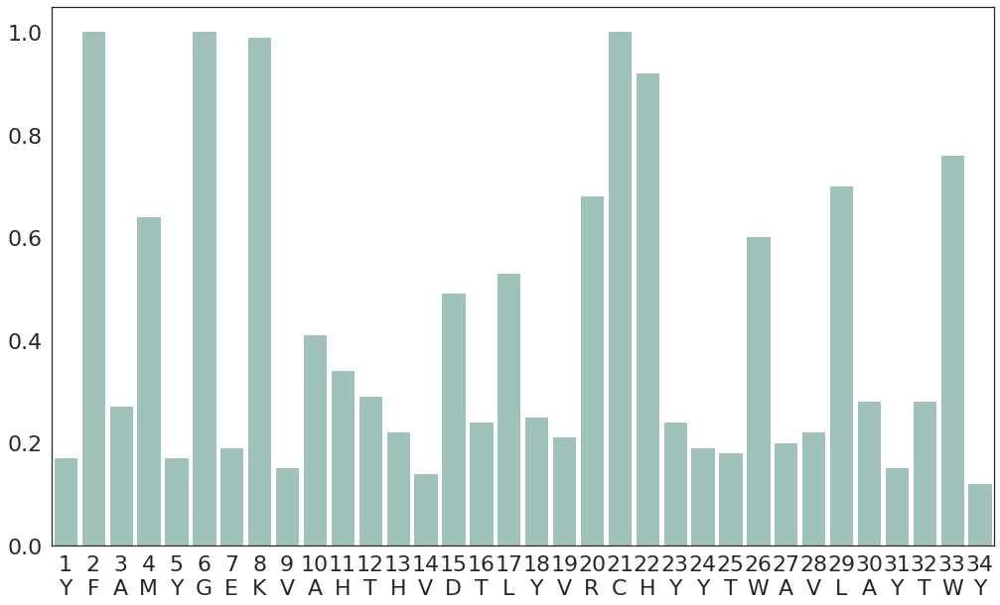

[0.17, 1.0, 0.27, 0.64, 0.17, 1.0, 0.19, 0.99, 0.15, 0.41, 0.34, 0.29, 0.22, 0.14, 0.49, 0.24, 0.53, 0.25, 0.21, 0.68, 1.0, 0.92, 0.24, 0.19, 0.18, 0.6, 0.2, 0.22, 0.7, 0.28, 0.15, 0.28, 0.76, 0.12]

---------------------
#Peptides: 283
HLA: HLA-B*15:42
Threshold: 0.6
YYAMYREISTNTYESNLYWTYNLYTWAELAYTWY
threshold: 0.6


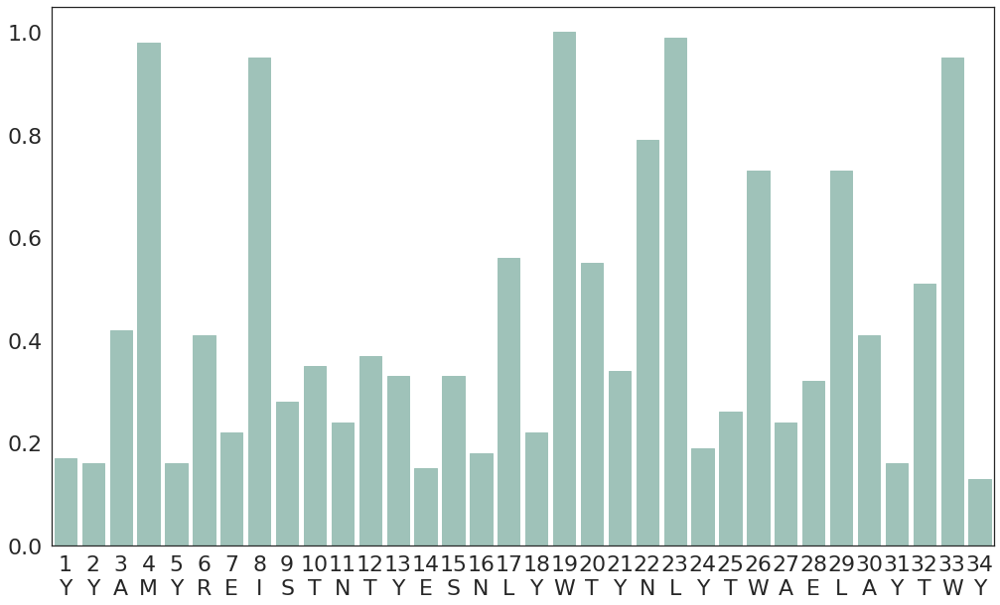

[0.17, 0.16, 0.42, 0.98, 0.16, 0.41, 0.22, 0.95, 0.28, 0.35, 0.24, 0.37, 0.33, 0.15, 0.33, 0.18, 0.56, 0.22, 1.0, 0.55, 0.34, 0.79, 0.99, 0.19, 0.26, 0.73, 0.24, 0.32, 0.73, 0.41, 0.16, 0.51, 0.95, 0.13]

---------------------
#Peptides: 574
HLA: HLA-B*56:01
Threshold: 0.6
YYAEYRNIYAQTDESNLYWTYNLYTWAVLAYLWY
threshold: 0.6


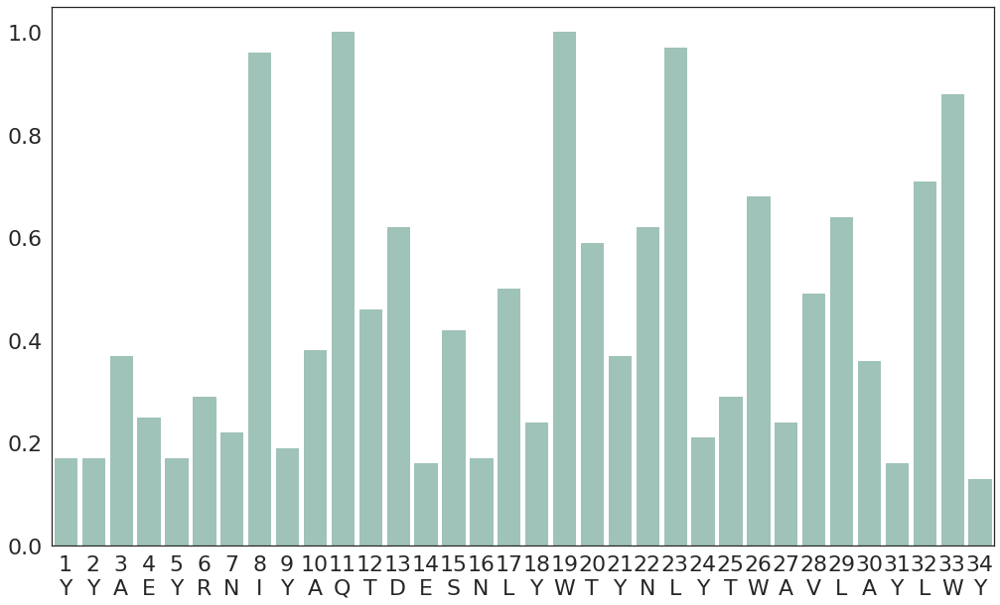

[0.17, 0.17, 0.37, 0.25, 0.17, 0.29, 0.22, 0.96, 0.19, 0.38, 1.0, 0.46, 0.62, 0.16, 0.42, 0.17, 0.5, 0.24, 1.0, 0.59, 0.37, 0.62, 0.97, 0.21, 0.29, 0.68, 0.24, 0.49, 0.64, 0.36, 0.16, 0.71, 0.88, 0.13]

---------------------
#Peptides: 1171
HLA: HLA-B*54:01
Threshold: 0.6
YYAGYRNIYAQTDESNLYWTYNLYTWAVLAYTWY
threshold: 0.6


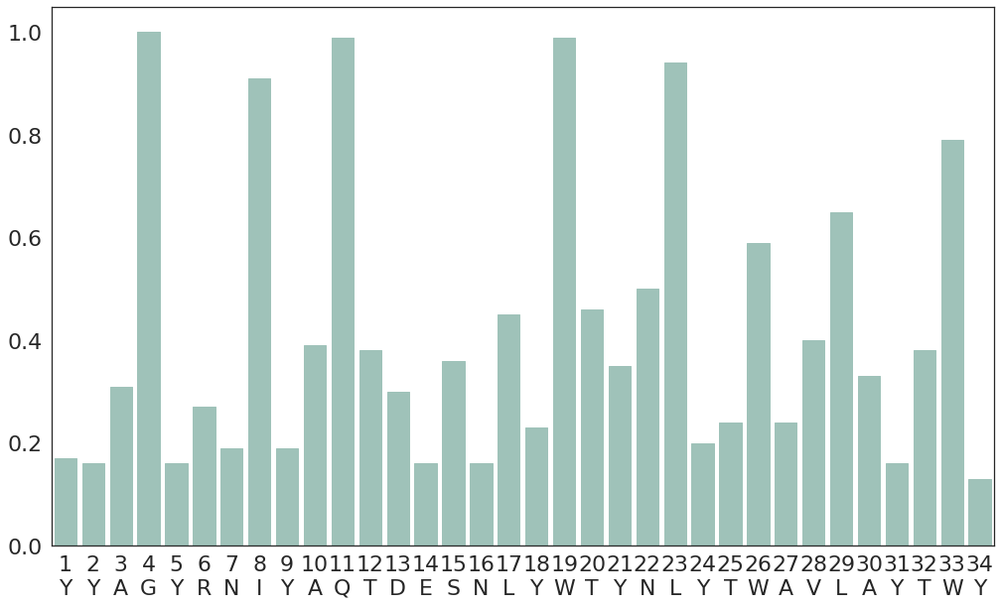

[0.17, 0.16, 0.31, 1.0, 0.16, 0.27, 0.19, 0.91, 0.19, 0.39, 0.99, 0.38, 0.3, 0.16, 0.36, 0.16, 0.45, 0.23, 0.99, 0.46, 0.35, 0.5, 0.94, 0.2, 0.24, 0.59, 0.24, 0.4, 0.65, 0.33, 0.16, 0.38, 0.79, 0.13]

---------------------
#Peptides: 1593
HLA: HLA-C*15:02
Threshold: 0.6
YYAGYRENYRQTDVNKLYIRYDLYTWAELAYTWY
threshold: 0.6


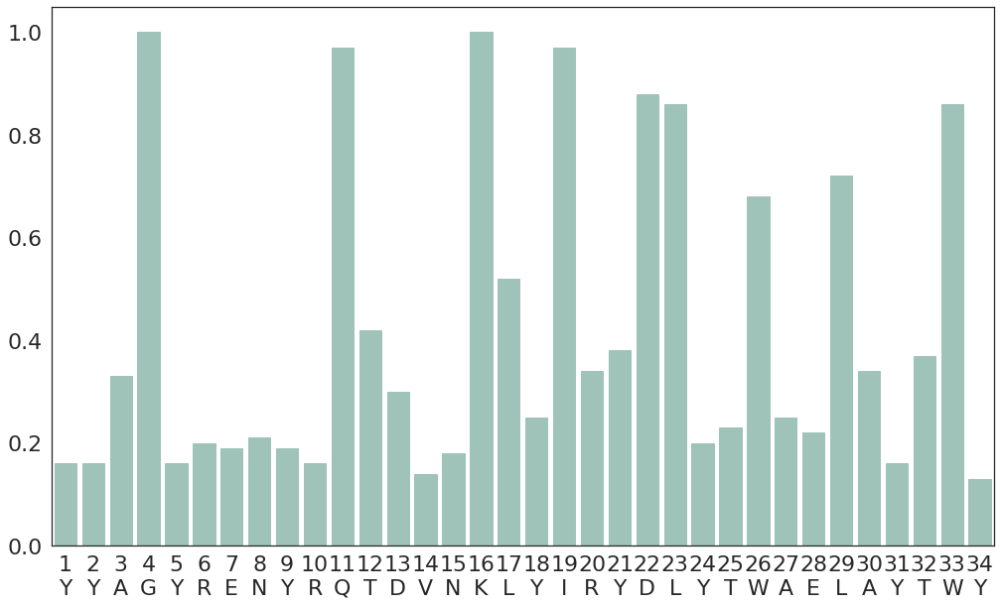

[0.16, 0.16, 0.33, 1.0, 0.16, 0.2, 0.19, 0.21, 0.19, 0.16, 0.97, 0.42, 0.3, 0.14, 0.18, 1.0, 0.52, 0.25, 0.97, 0.34, 0.38, 0.88, 0.86, 0.2, 0.23, 0.68, 0.25, 0.22, 0.72, 0.34, 0.16, 0.37, 0.86, 0.13]

---------------------
#Peptides: 3464
HLA: HLA-C*16:01
Threshold: 0.6
YYAGYREKYRQTDVSNLYLWYDSYTWAAQAYTWY
threshold: 0.6


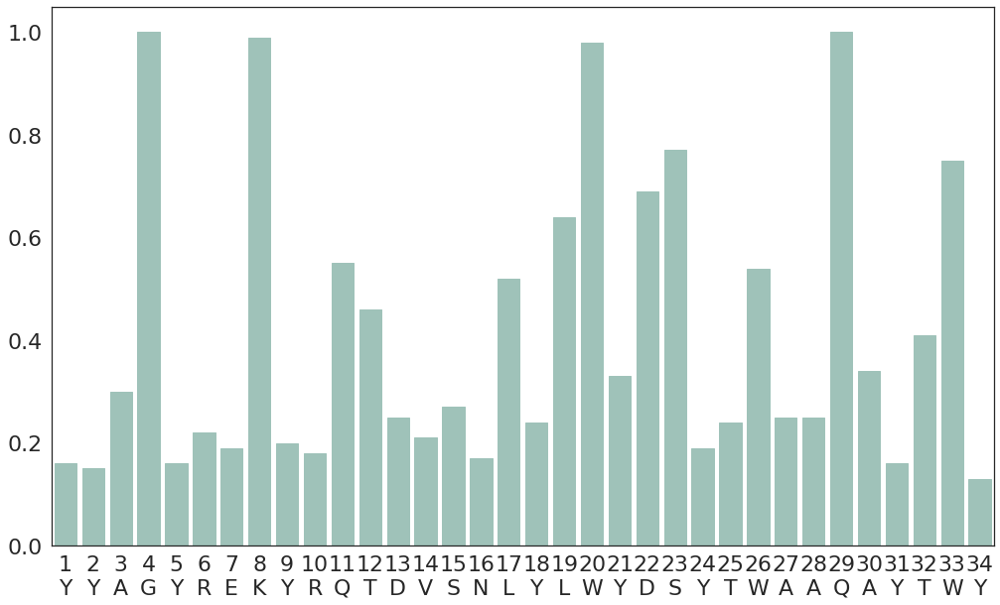

[0.16, 0.15, 0.3, 1.0, 0.16, 0.22, 0.19, 0.99, 0.2, 0.18, 0.55, 0.46, 0.25, 0.21, 0.27, 0.17, 0.52, 0.24, 0.64, 0.98, 0.33, 0.69, 0.77, 0.19, 0.24, 0.54, 0.25, 0.25, 1.0, 0.34, 0.16, 0.41, 0.75, 0.13]

---------------------
#Peptides: 2268
HLA: HLA-B*45:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAVDAYLSY
threshold: 0.6


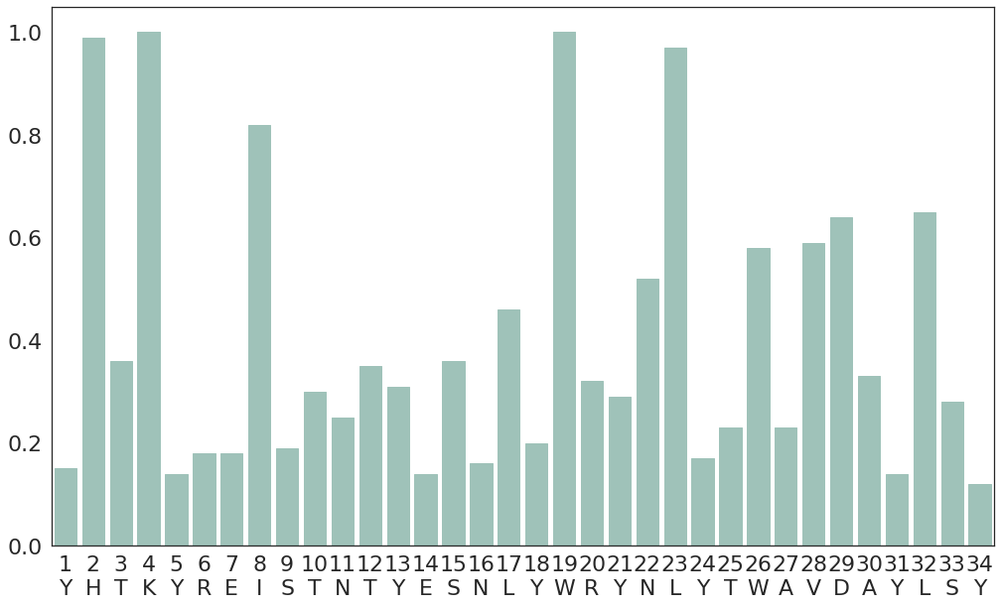

[0.15, 0.99, 0.36, 1.0, 0.14, 0.18, 0.18, 0.82, 0.19, 0.3, 0.25, 0.35, 0.31, 0.14, 0.36, 0.16, 0.46, 0.2, 1.0, 0.32, 0.29, 0.52, 0.97, 0.17, 0.23, 0.58, 0.23, 0.59, 0.64, 0.33, 0.14, 0.65, 0.28, 0.12]

---------------------
#Peptides: 4282
HLA: HLA-C*03:03
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY
threshold: 0.6


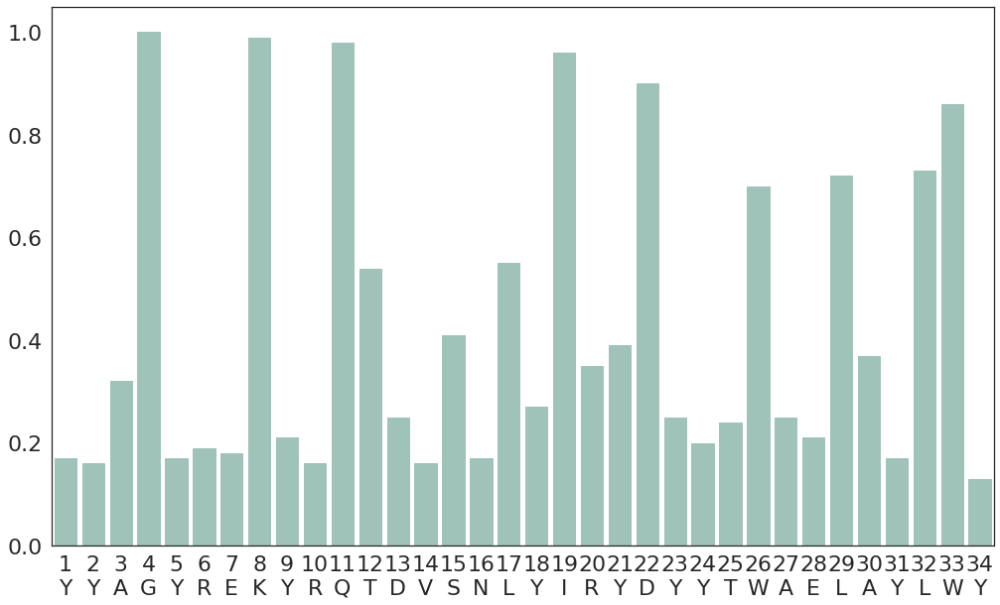

[0.17, 0.16, 0.32, 1.0, 0.17, 0.19, 0.18, 0.99, 0.21, 0.16, 0.98, 0.54, 0.25, 0.16, 0.41, 0.17, 0.55, 0.27, 0.96, 0.35, 0.39, 0.9, 0.25, 0.2, 0.24, 0.7, 0.25, 0.21, 0.72, 0.37, 0.17, 0.73, 0.86, 0.13]

---------------------
#Peptides: 1814
HLA: HLA-A*26:01
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQDYTWAEWAYRWY
threshold: 0.6


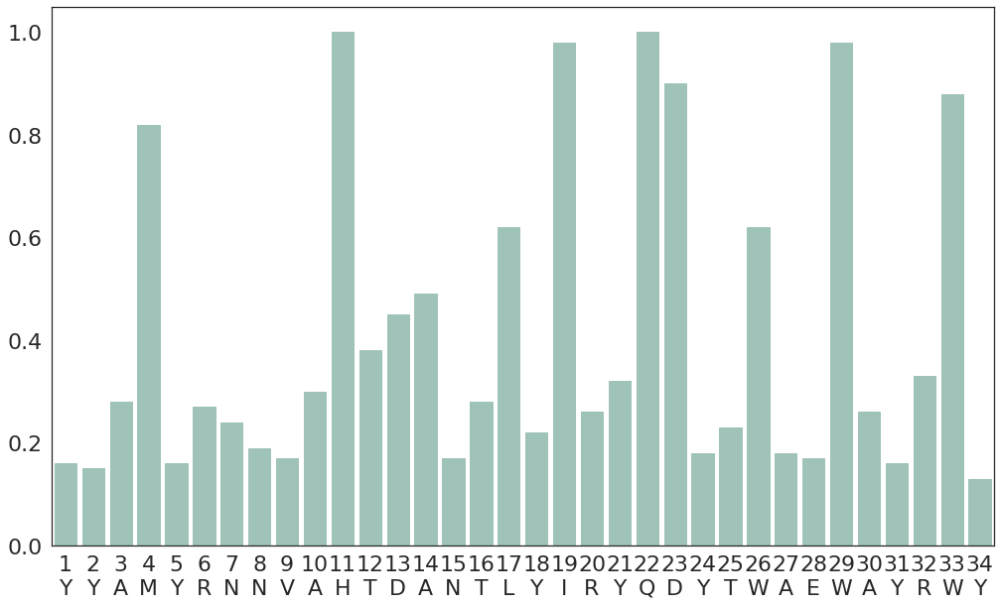

[0.16, 0.15, 0.28, 0.82, 0.16, 0.27, 0.24, 0.19, 0.17, 0.3, 1.0, 0.38, 0.45, 0.49, 0.17, 0.28, 0.62, 0.22, 0.98, 0.26, 0.32, 1.0, 0.9, 0.18, 0.23, 0.62, 0.18, 0.17, 0.98, 0.26, 0.16, 0.33, 0.88, 0.13]

---------------------
#Peptides: 1263
HLA: HLA-B*39:06
Threshold: 0.6
YYSEYRNICTNTDESNLYWTYNFYTWAVLTYTWY
threshold: 0.6


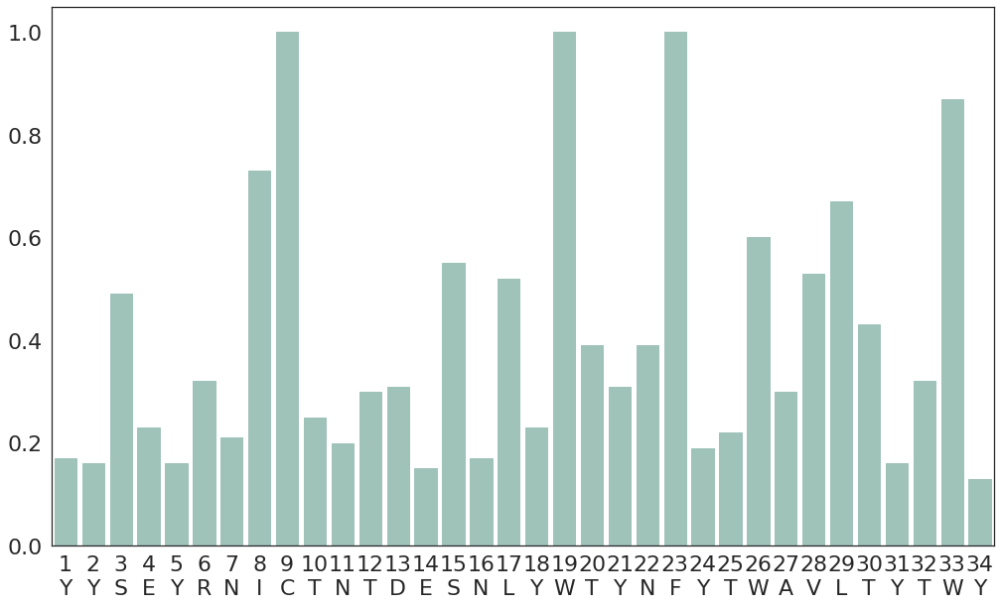

[0.17, 0.16, 0.49, 0.23, 0.16, 0.32, 0.21, 0.73, 1.0, 0.25, 0.2, 0.3, 0.31, 0.15, 0.55, 0.17, 0.52, 0.23, 1.0, 0.39, 0.31, 0.39, 1.0, 0.19, 0.22, 0.6, 0.3, 0.53, 0.67, 0.43, 0.16, 0.32, 0.87, 0.13]

---------------------
#Peptides: 1079
HLA: HLA-A*33:01
Threshold: 0.6
YTAMYRNNVAHIDVDTLYIMYQDYTWAVLAYTWH
threshold: 0.6


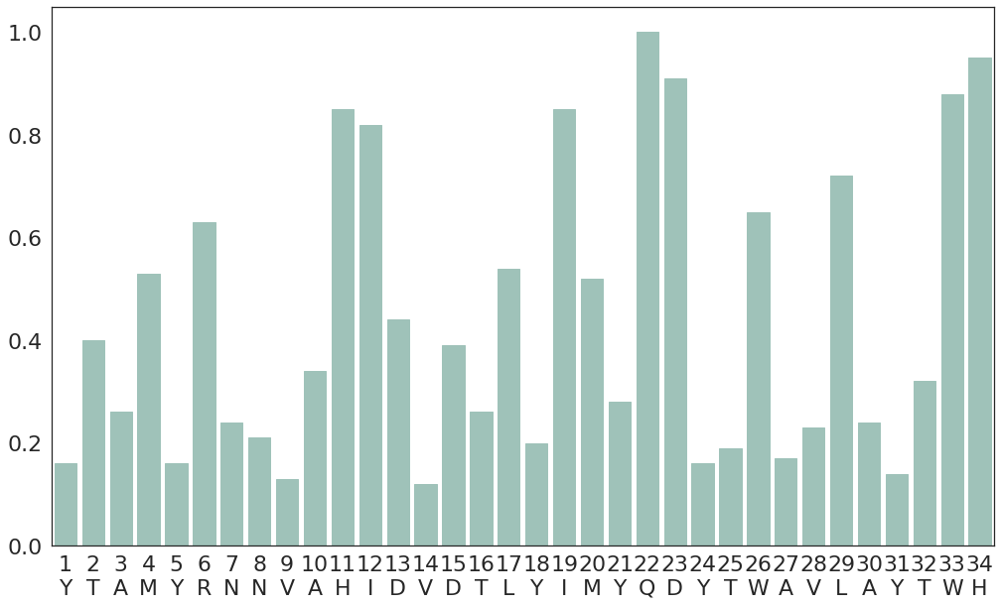

[0.16, 0.4, 0.26, 0.53, 0.16, 0.63, 0.24, 0.21, 0.13, 0.34, 0.85, 0.82, 0.44, 0.12, 0.39, 0.26, 0.54, 0.2, 0.85, 0.52, 0.28, 1.0, 0.91, 0.16, 0.19, 0.65, 0.17, 0.23, 0.72, 0.24, 0.14, 0.32, 0.88, 0.95]

---------------------
#Peptides: 94
HLA: HLA-B*48:01
Threshold: 0.6
YYSEYREISTNTYESNLYLSYNYYSLAVLAYEWY
threshold: 0.6


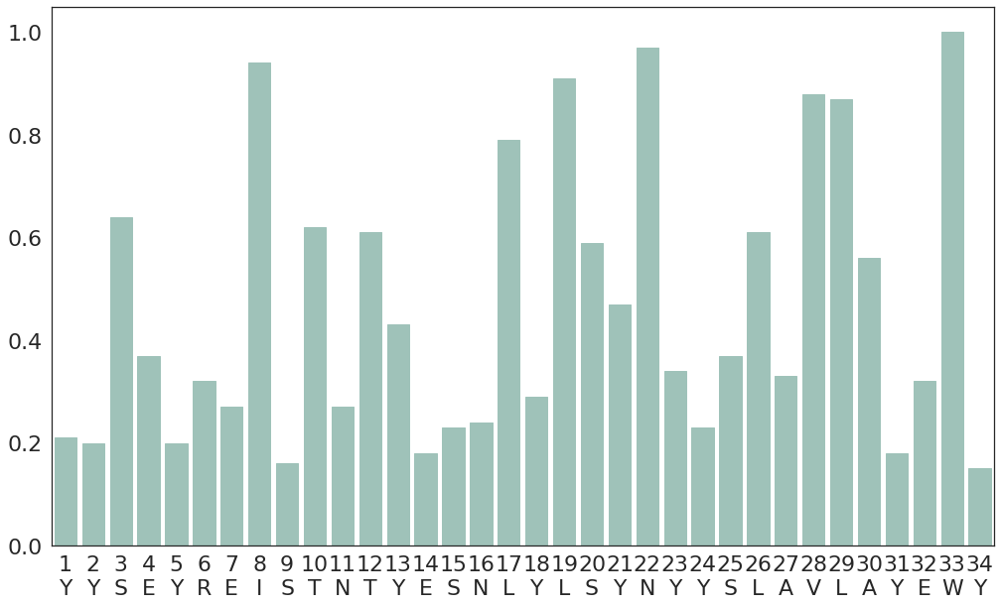

[0.21, 0.2, 0.64, 0.37, 0.2, 0.32, 0.27, 0.94, 0.16, 0.62, 0.27, 0.61, 0.43, 0.18, 0.23, 0.24, 0.79, 0.29, 0.91, 0.59, 0.47, 0.97, 0.34, 0.23, 0.37, 0.61, 0.33, 0.88, 0.87, 0.56, 0.18, 0.32, 1.0, 0.15]

---------------------
#Peptides: 71
HLA: HLA-A*02:50
Threshold: 0.6
YFAMYGEKVAHTHVDTLYIRYHYYTWAVWAYTWY
threshold: 0.6


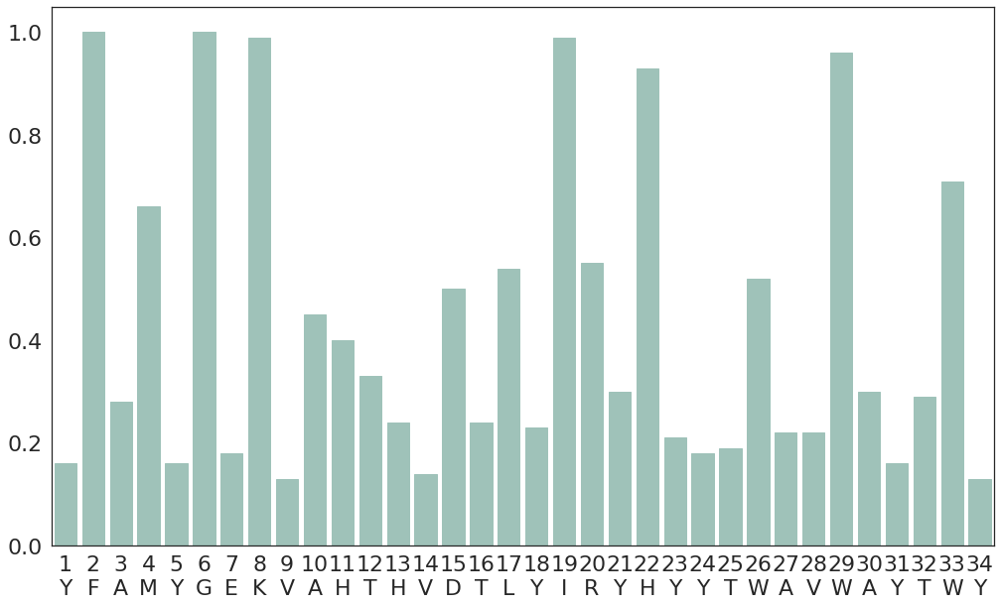

[0.16, 1.0, 0.28, 0.66, 0.16, 1.0, 0.18, 0.99, 0.13, 0.45, 0.4, 0.33, 0.24, 0.14, 0.5, 0.24, 0.54, 0.23, 0.99, 0.55, 0.3, 0.93, 0.21, 0.18, 0.19, 0.52, 0.22, 0.22, 0.96, 0.3, 0.16, 0.29, 0.71, 0.13]

---------------------
#Peptides: 70
HLA: HLA-A*32:07
Threshold: 0.6
YSAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


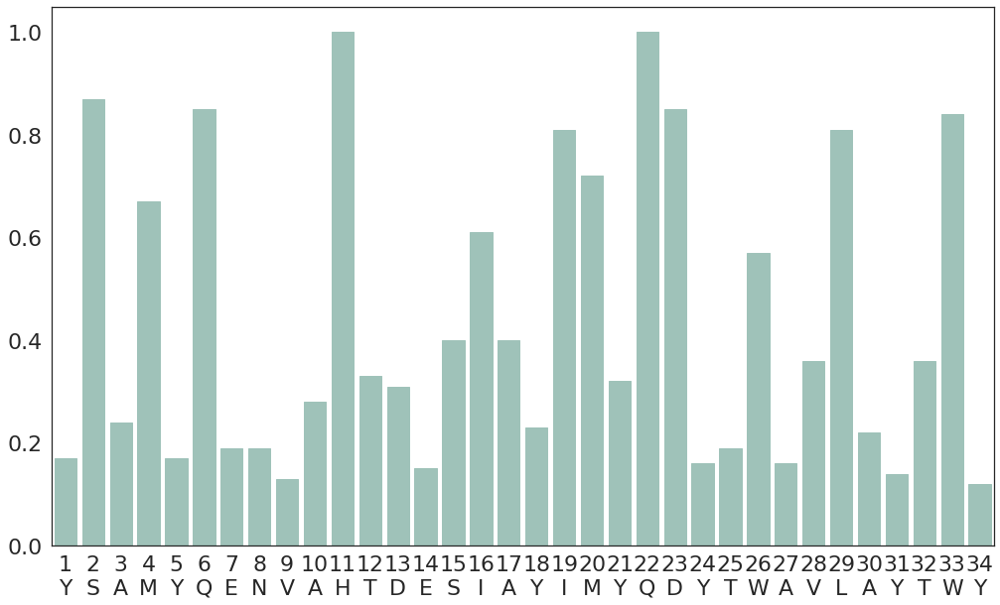

[0.17, 0.87, 0.24, 0.67, 0.17, 0.85, 0.19, 0.19, 0.13, 0.28, 1.0, 0.33, 0.31, 0.15, 0.4, 0.61, 0.4, 0.23, 0.81, 0.72, 0.32, 1.0, 0.85, 0.16, 0.19, 0.57, 0.16, 0.36, 0.81, 0.22, 0.14, 0.36, 0.84, 0.12]

---------------------
#Peptides: 3967
HLA: HLA-B*49:01
Threshold: 0.6
YHTKYREISTNTYENIAYWRYNLYTWAELAYLWY
threshold: 0.6


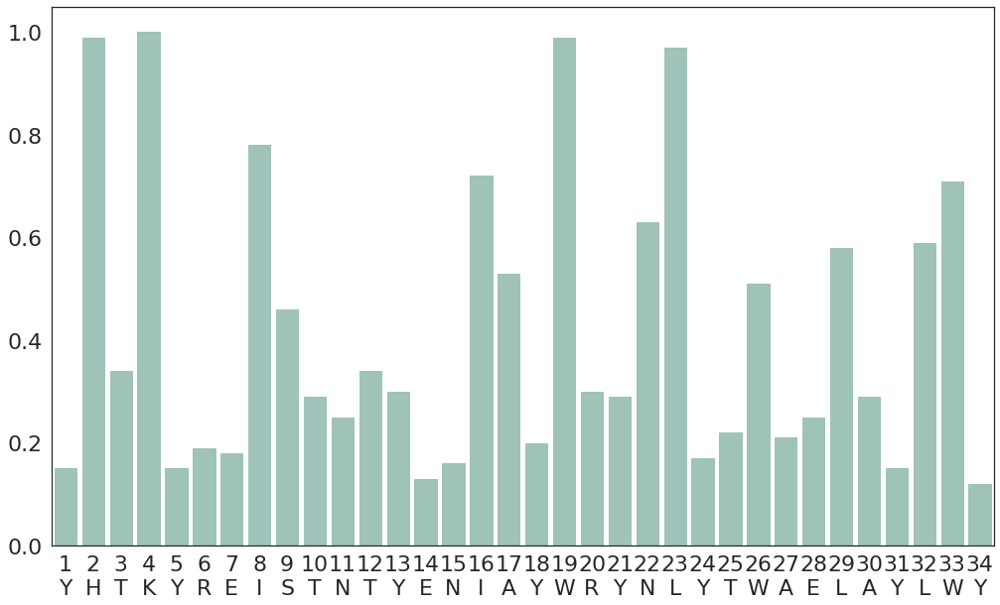

[0.15, 0.99, 0.34, 1.0, 0.15, 0.19, 0.18, 0.78, 0.46, 0.29, 0.25, 0.34, 0.3, 0.13, 0.16, 0.72, 0.53, 0.2, 0.99, 0.3, 0.29, 0.63, 0.97, 0.17, 0.22, 0.51, 0.21, 0.25, 0.58, 0.29, 0.15, 0.59, 0.71, 0.12]

---------------------
#Peptides: 3610
HLA: HLA-B*37:01
Threshold: 0.6
YHSTYREISTNTYEDTLYIRSNFYTWAVDAYTWY
threshold: 0.6


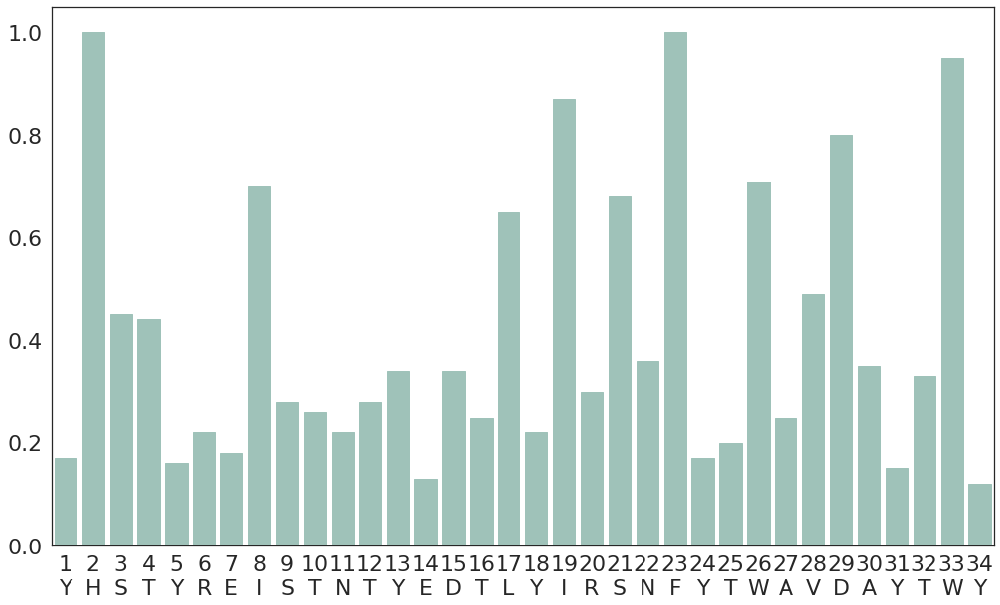

[0.17, 1.0, 0.45, 0.44, 0.16, 0.22, 0.18, 0.7, 0.28, 0.26, 0.22, 0.28, 0.34, 0.13, 0.34, 0.25, 0.65, 0.22, 0.87, 0.3, 0.68, 0.36, 1.0, 0.17, 0.2, 0.71, 0.25, 0.49, 0.8, 0.35, 0.15, 0.33, 0.95, 0.12]

---------------------
#Peptides: 3396
HLA: HLA-A*32:01
Threshold: 0.6
YFAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY
threshold: 0.6


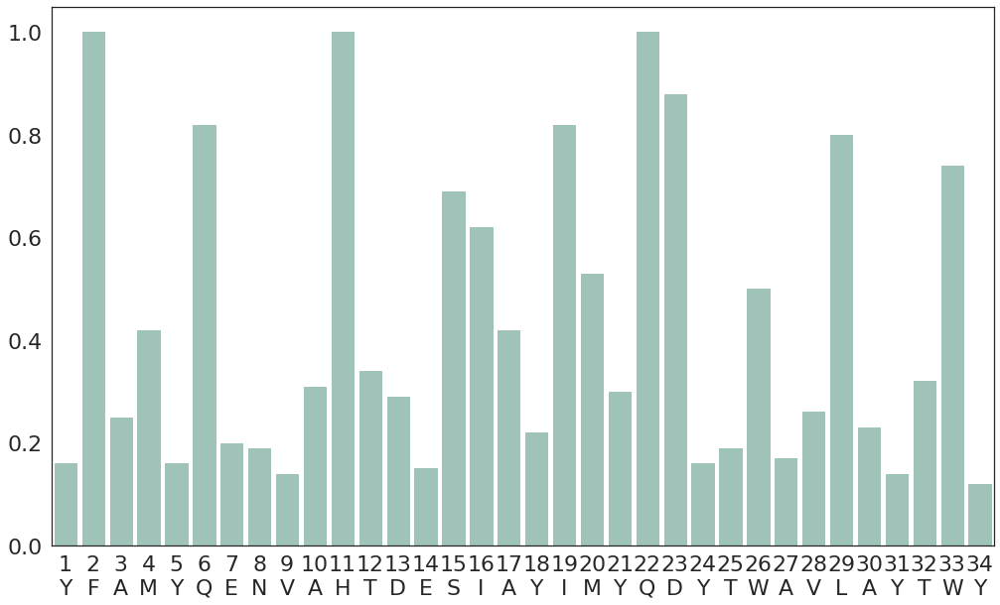

[0.16, 1.0, 0.25, 0.42, 0.16, 0.82, 0.2, 0.19, 0.14, 0.31, 1.0, 0.34, 0.29, 0.15, 0.69, 0.62, 0.42, 0.22, 0.82, 0.53, 0.3, 1.0, 0.88, 0.16, 0.19, 0.5, 0.17, 0.26, 0.8, 0.23, 0.14, 0.32, 0.74, 0.12]

---------------------
#Peptides: 4424
HLA: HLA-B*58:01
Threshold: 0.6
YYATYGENMASTYENIAYIRYDSYTWAVLAYLWY
threshold: 0.6


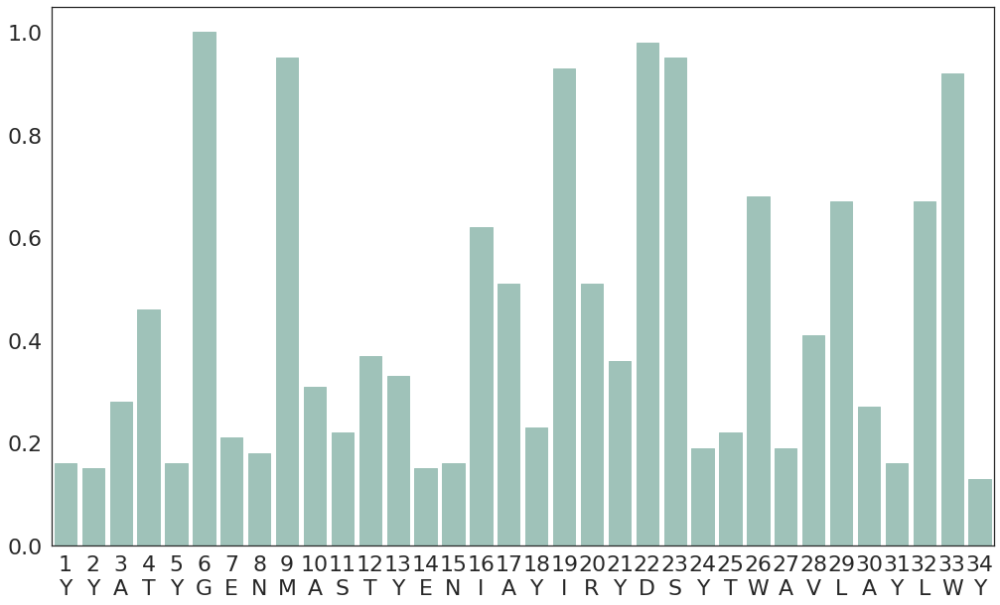

[0.16, 0.15, 0.28, 0.46, 0.16, 1.0, 0.21, 0.18, 0.95, 0.31, 0.22, 0.37, 0.33, 0.15, 0.16, 0.62, 0.51, 0.23, 0.93, 0.51, 0.36, 0.98, 0.95, 0.19, 0.22, 0.68, 0.19, 0.41, 0.67, 0.27, 0.16, 0.67, 0.92, 0.13]

---------------------
#Peptides: 2381
HLA: HLA-C*07:04
Threshold: 0.6
YDSGYREKYRQADVSNLYFRYDFYTLAADAYTWY
threshold: 0.6


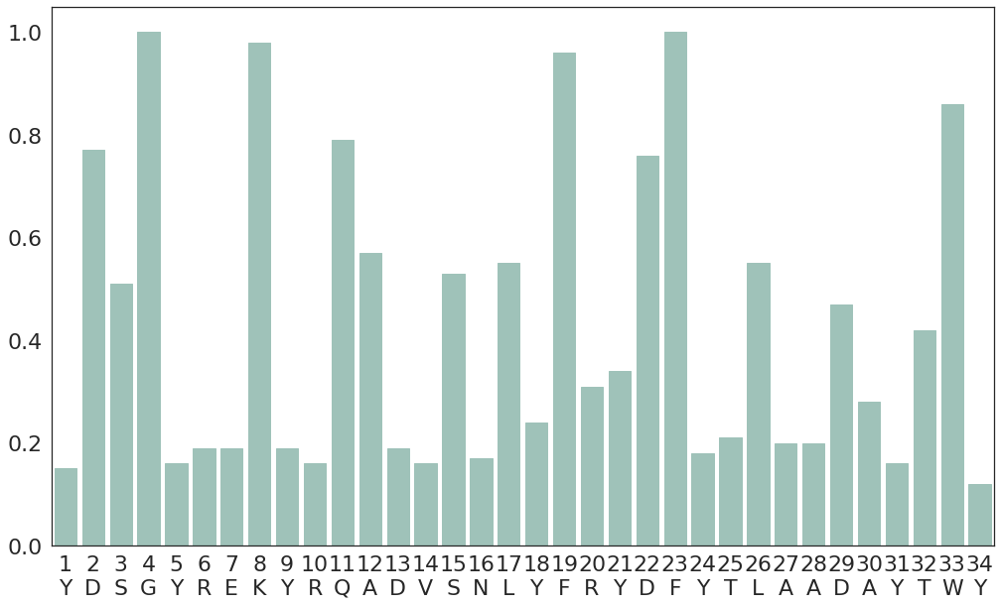

[0.15, 0.77, 0.51, 1.0, 0.16, 0.19, 0.19, 0.98, 0.19, 0.16, 0.79, 0.57, 0.19, 0.16, 0.53, 0.17, 0.55, 0.24, 0.96, 0.31, 0.34, 0.76, 1.0, 0.18, 0.21, 0.55, 0.2, 0.2, 0.47, 0.28, 0.16, 0.42, 0.86, 0.12]

---------------------
#Peptides: 73
HLA: HLA-B*27:20
Threshold: 0.6
YHTEYREICAKTDESTLYLNYNYYTWAELAYEWY
threshold: 0.6


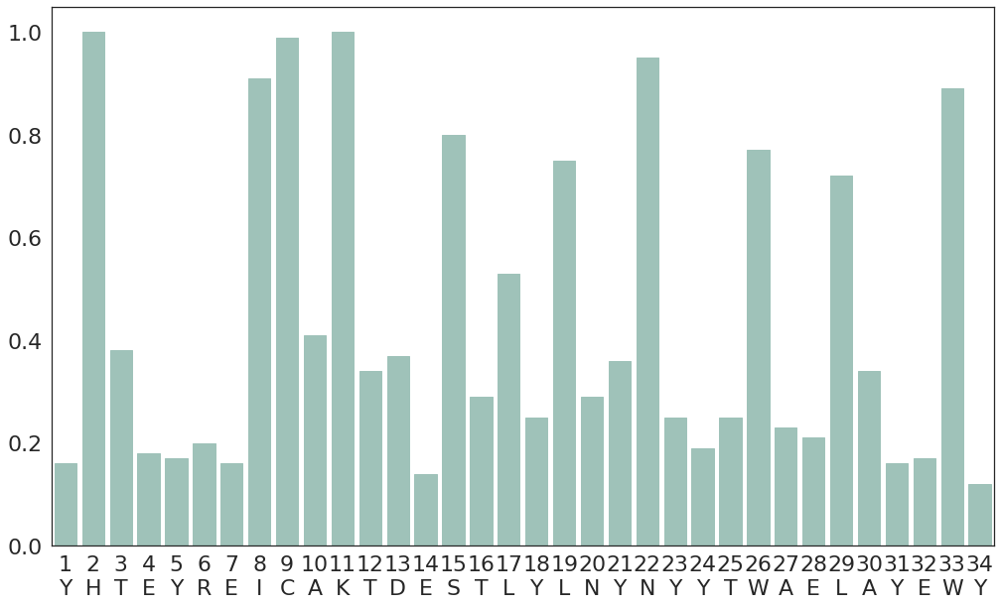

[0.16, 1.0, 0.38, 0.18, 0.17, 0.2, 0.16, 0.91, 0.99, 0.41, 1.0, 0.34, 0.37, 0.14, 0.8, 0.29, 0.53, 0.25, 0.75, 0.29, 0.36, 0.95, 0.25, 0.19, 0.25, 0.77, 0.23, 0.21, 0.72, 0.34, 0.16, 0.17, 0.89, 0.12]

---------------------
#Peptides: 82
HLA: HLA-B*15:09
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYNYYTWAELAYLWY
threshold: 0.6


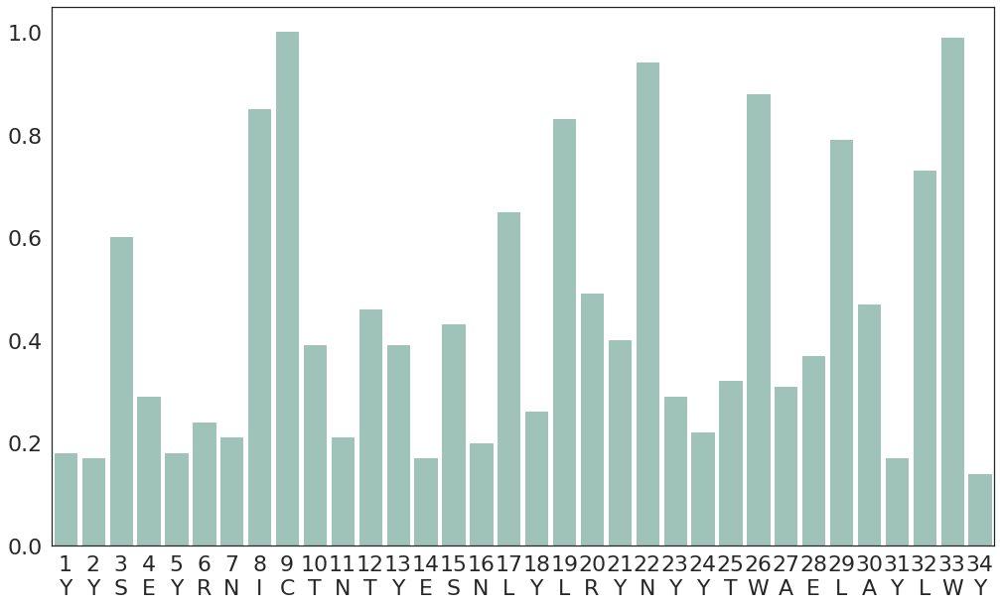

[0.18, 0.17, 0.6, 0.29, 0.18, 0.24, 0.21, 0.85, 1.0, 0.39, 0.21, 0.46, 0.39, 0.17, 0.43, 0.2, 0.65, 0.26, 0.83, 0.49, 0.4, 0.94, 0.29, 0.22, 0.32, 0.88, 0.31, 0.37, 0.79, 0.47, 0.17, 0.73, 0.99, 0.14]

---------------------
#Peptides: 3008
HLA: HLA-A*23:01
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY
threshold: 0.6


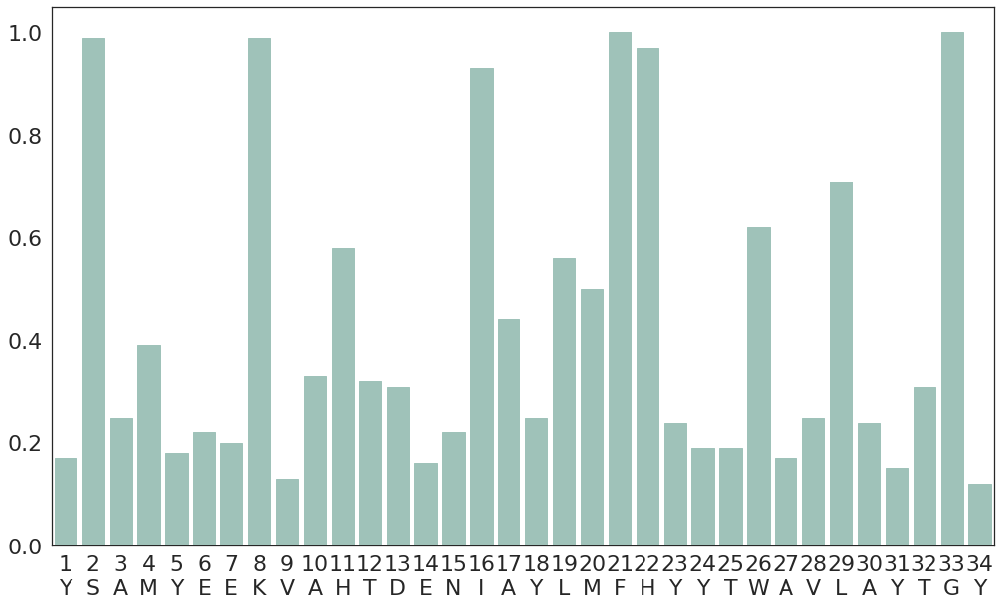

[0.17, 0.99, 0.25, 0.39, 0.18, 0.22, 0.2, 0.99, 0.13, 0.33, 0.58, 0.32, 0.31, 0.16, 0.22, 0.93, 0.44, 0.25, 0.56, 0.5, 1.0, 0.97, 0.24, 0.19, 0.19, 0.62, 0.17, 0.25, 0.71, 0.24, 0.15, 0.31, 1.0, 0.12]

---------------------


In [20]:
col_mean_per_HLA = dict()
col_mean_per_HLA_softmax = dict()
max_list_all = []
for HLA_filter in HLA_list:
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position_HLApseudo(17, 10, '#9fc2b9', df_pd_nested_test_unique.reset_index(drop=True), enc_hla_attn_list_all, n_heads, HLA_filter, 34, softmax_dim = 0, label = 1 , length = None , threshold = 0.60, show = 'bar', top = False, softmax = True, unsoftmax = True )    
    print(max_list)
    max_list_all.append(max_list)
    print(color.END + '')
    col_mean_per_HLA[HLA_filter] =  unsoftmax_pd.max(axis=0).tolist()
    col_mean_per_HLA_softmax[HLA_filter] =  softmax_pd.max(axis=0).tolist()
    print("---------------------")


[0.02209722 0.03259349 0.02679512 0.03578097 0.02220402 0.02863042
 0.02311637 0.03869882 0.02776442 0.02616156 0.03461823 0.02798093
 0.02638912 0.0221466  0.02749553 0.02709585 0.03300347 0.02374181
 0.03938201 0.0310205  0.02803094 0.04196687 0.03796302 0.02259601
 0.02381187 0.03637366 0.02352027 0.02574447 0.03991656 0.02614055
 0.02193015 0.02893882 0.0436289  0.02272144]


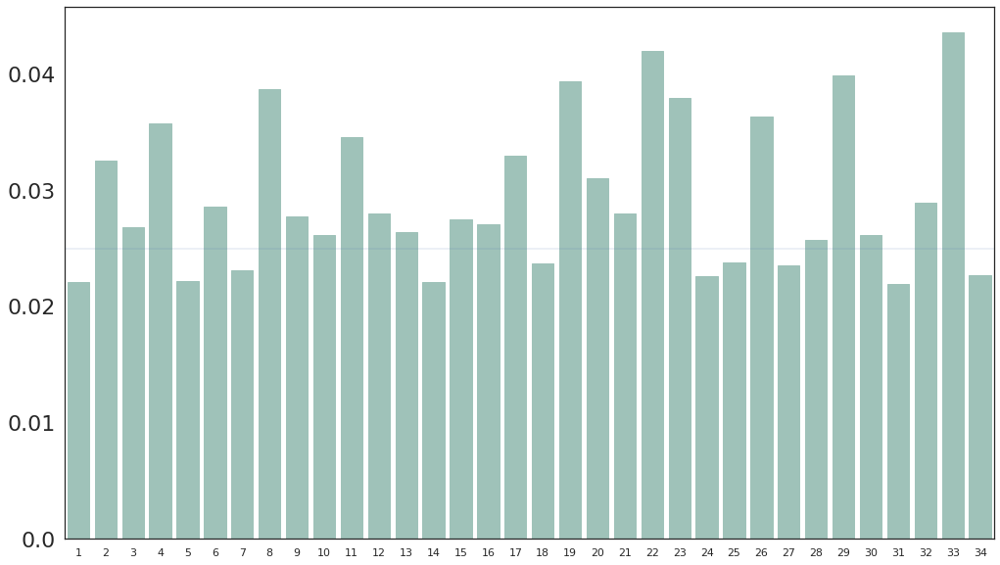

In [42]:
max_list_all_pooled_s = softmax(max_list_all_pooled)
print(max_list_all_pooled_s)

sn.set(rc = {'figure.figsize':(17,10)})
sn.set_style("white")
ax = sn.barplot(x=np.arange(len(max_list_all_pooled_s)), y=max_list_all_pooled_s)
ax.set_xticklabels(list(range(1,35,1)))
ax.set_yticklabels([round(x,2) for x in ax.get_yticks()], size=22)
ax.axhline(0.025, linewidth = 0.2)

idx = 0

for bar in ax.patches:
    bar.set_color('#9fc2b9')     

plt.show()

In [29]:
max_list_all_pooled = max_list_all_pooled/112
max_list_all_pooled

array([0.16455357, 0.55321429, 0.35732143, 0.64651786, 0.169375  ,
       0.42357143, 0.20964286, 0.72491071, 0.39285714, 0.33339286,
       0.61348214, 0.400625  , 0.34205357, 0.16678571, 0.383125  ,
       0.36848214, 0.56571429, 0.23633929, 0.74241071, 0.50375   ,
       0.40241071, 0.80598214, 0.70571429, 0.186875  , 0.23928571,
       0.66294643, 0.22696429, 0.31732143, 0.75589286, 0.33258929,
       0.15696429, 0.43428571, 0.84482143, 0.19241071])

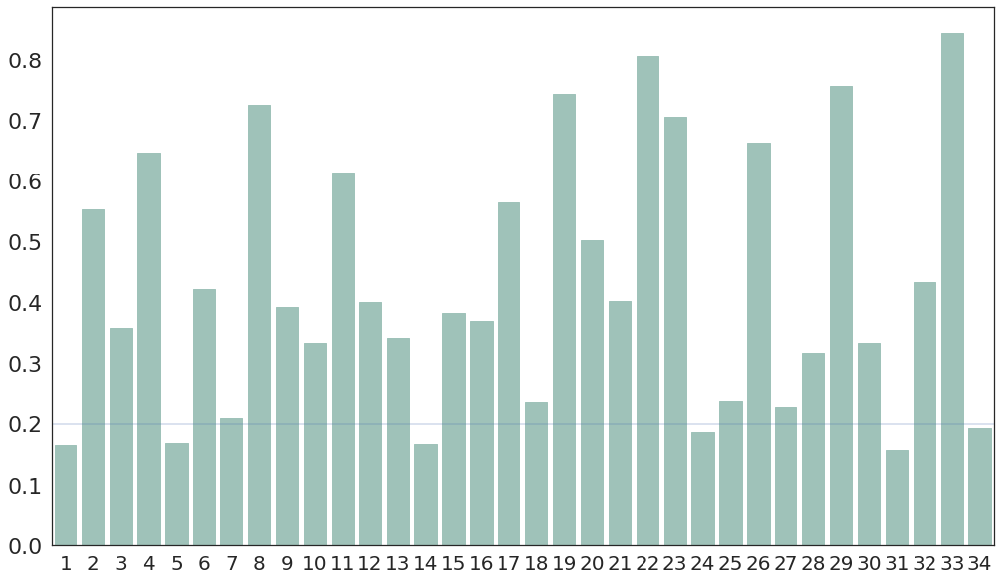

In [49]:
sn.set(rc = {'figure.figsize':(17,10)})
sn.set_style("white")
ax = sn.barplot(x=np.arange(len(max_list_all_pooled)), y=max_list_all_pooled)
ax.set_xticklabels(list(range(1,35,1)))
ax.set_yticklabels([round(x,2) for x in ax.get_yticks()], size=22)
ax.axhline(0.2, linewidth = 0.4)
ax.set_xticklabels(list(range(1,35,1)), size=20)
#ax.axhline(threshold_inner)
#plt.legend(loc='upper right', labels=['amino acid in MHC pseudo sequence'])
idx = 0

for bar in ax.patches:
    bar.set_color('#9fc2b9')     

plt.show()

#Peptides: 10623
HLA: HLA-A*03:01
Threshold: 0.6
YFAMYQENVAQTDVDTLYIIYRDYTWAELAYTWY

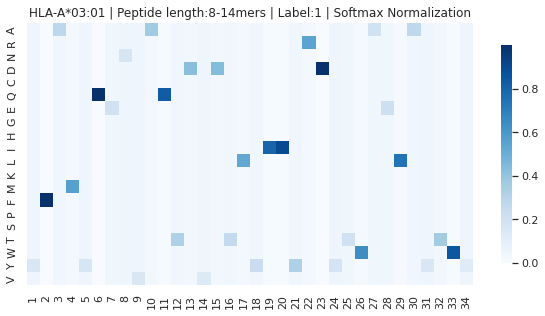

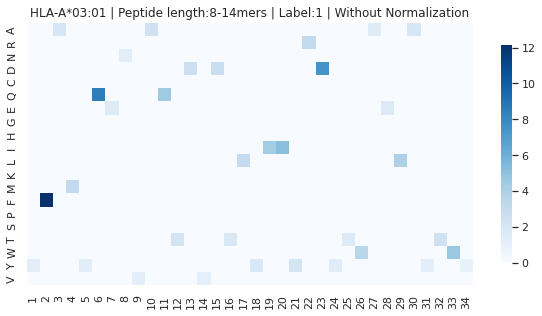


---------------------
#Peptides: 5138
HLA: HLA-C*08:02
Threshold: 0.6
YYAGYREKYRQTDVSNLYLRYNFYTWAERAYTWY

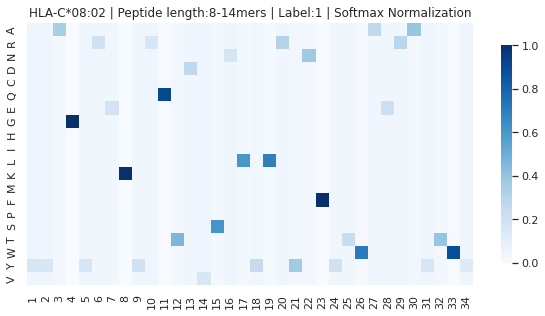

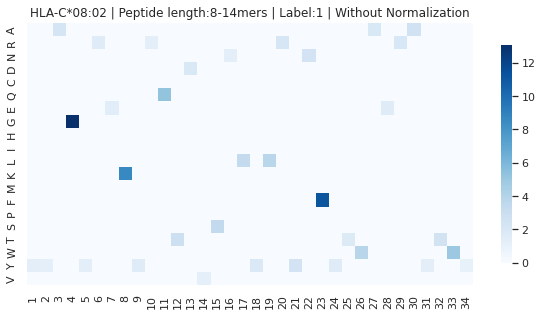


---------------------
#Peptides: 1427
HLA: HLA-B*50:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAELAYLWY

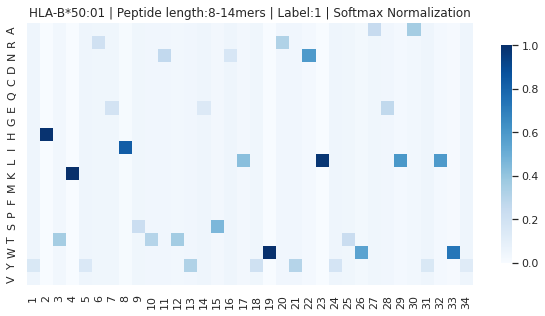

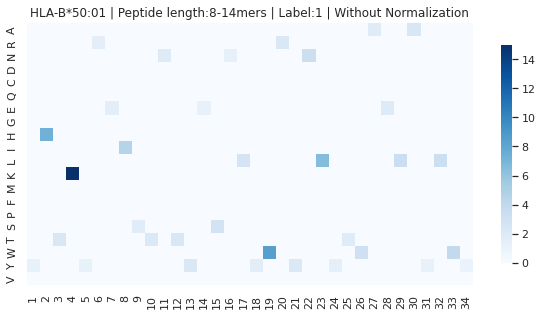


---------------------
#Peptides: 495
HLA: HLA-B*41:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNYYTWAVDAYTWY

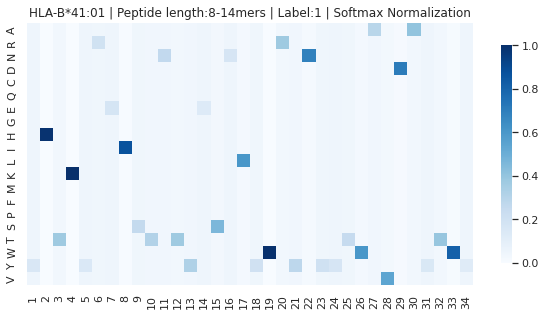

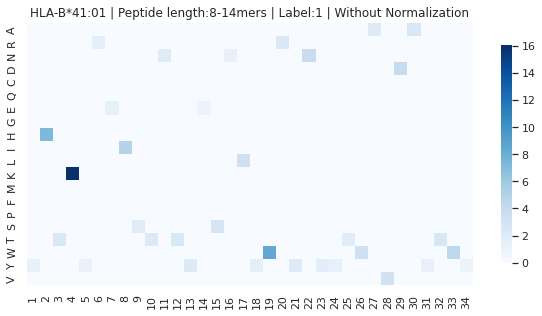


---------------------
#Peptides: 5695
HLA: HLA-B*08:01
Threshold: 0.6
YDSEYRNIFTNTDESNLYLSYNYYTWAVDAYTWY

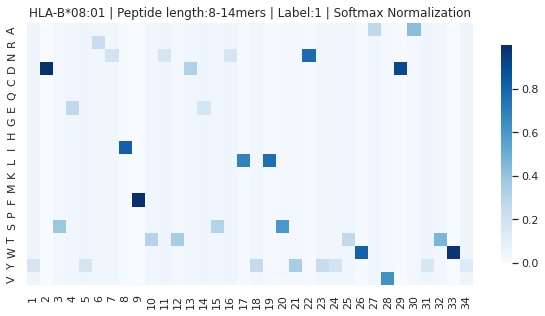

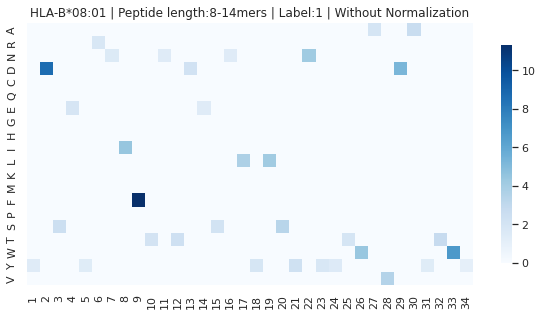


---------------------
#Peptides: 4974
HLA: HLA-B*51:01
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAELAYLWH

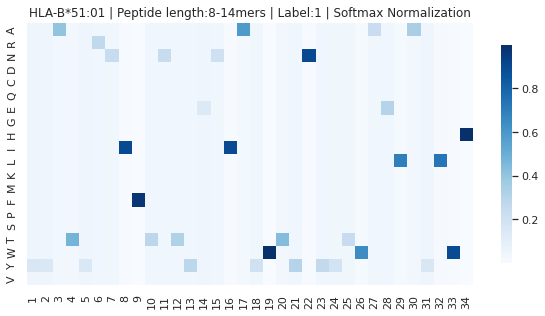

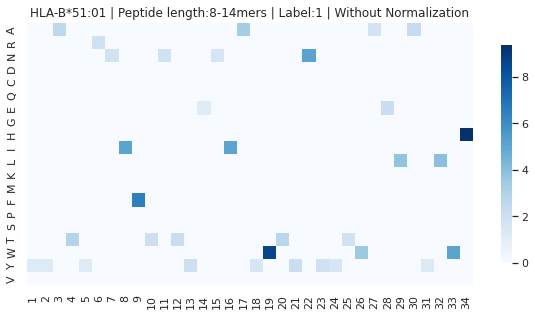


---------------------
#Peptides: 2988
HLA: HLA-C*07:02
Threshold: 0.6
YDSGYREKYRQADVSNLYLRSDSYTLAALAYTWY

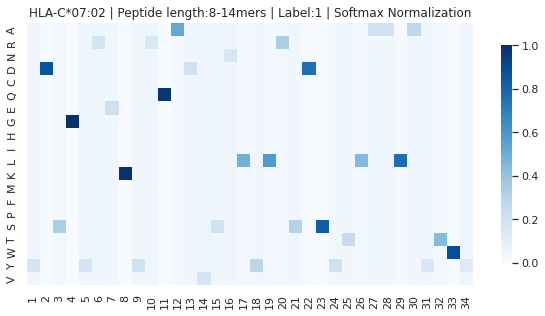

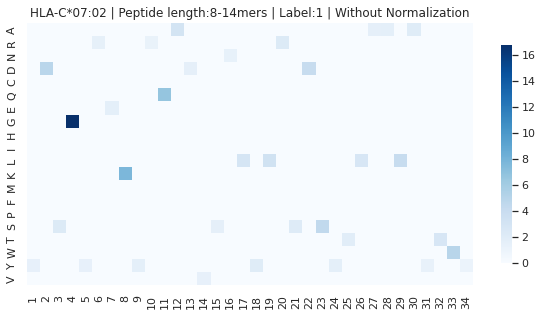


---------------------
#Peptides: 198
HLA: HLA-A*02:19
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTGY

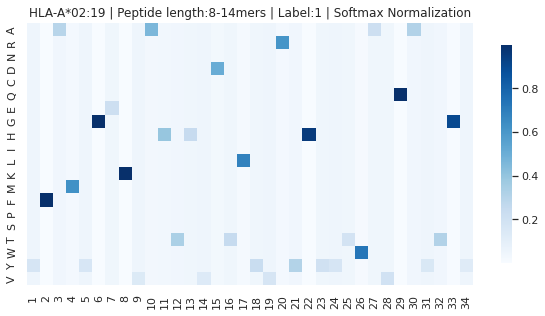

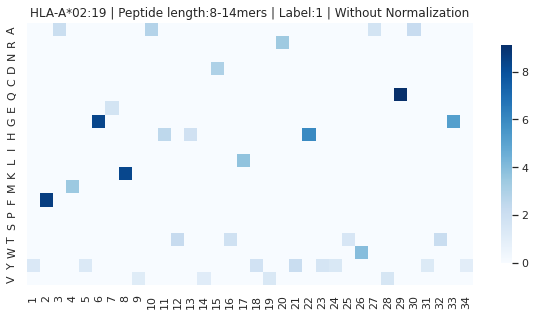


---------------------
#Peptides: 4023
HLA: HLA-C*03:04
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY

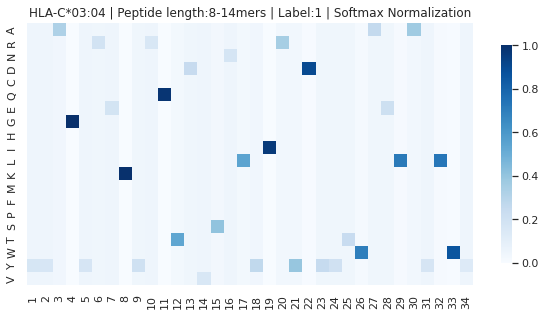

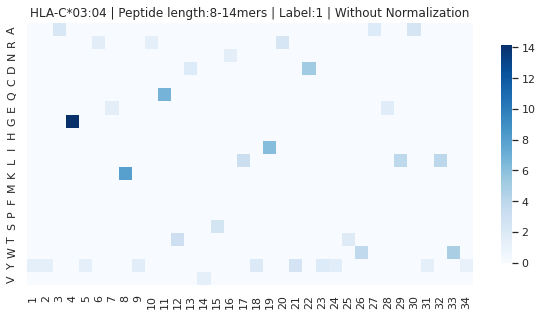


---------------------
#Peptides: 2245
HLA: HLA-B*18:01
Threshold: 0.59
YHSTYRNISTNTYESNLYLRYDSYTWAVLAYTWH

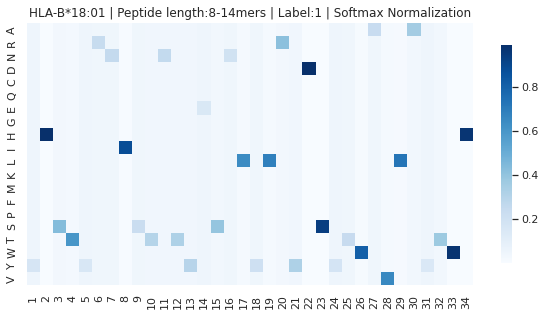

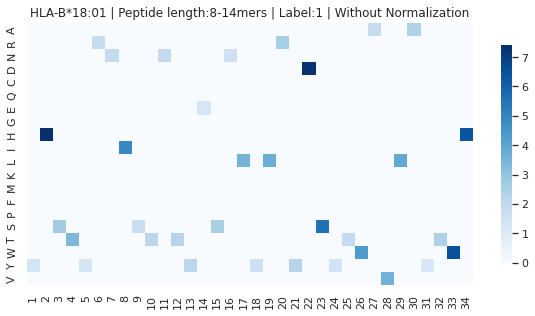


---------------------
#Peptides: 2381
HLA: HLA-C*07:04
Threshold: 0.6
YDSGYREKYRQADVSNLYFRYDFYTLAADAYTWY

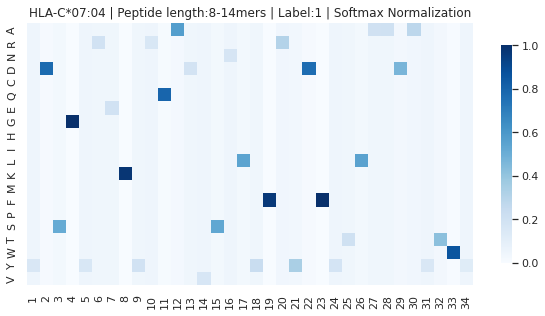

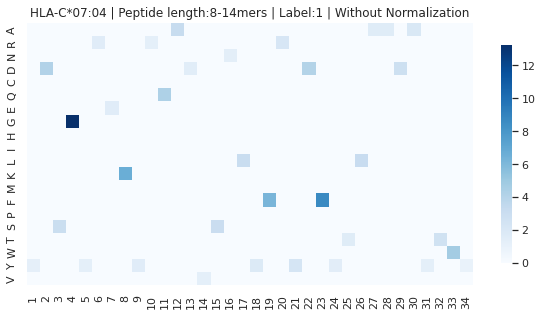


---------------------
#Peptides: 1386
HLA: HLA-A*30:01
Threshold: 0.6
YSAMYQENVAQTDVDTLYIIYEHYTWAWLAYTWY

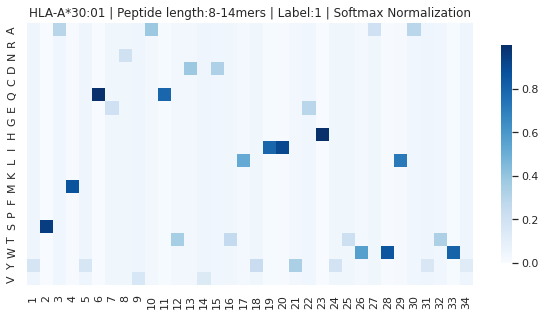

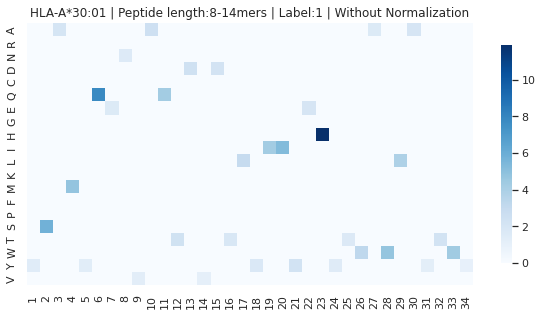


---------------------
#Peptides: 408
HLA: HLA-B*73:01
Threshold: 0.6
YHTEYRNICAKTDVGNLYWTYNFYTWAVLAYEWH

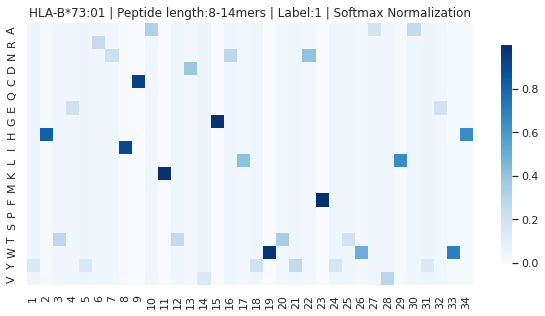

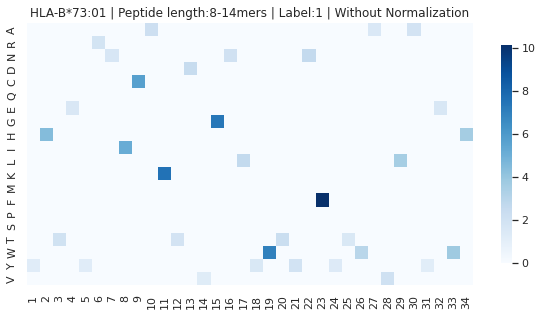


---------------------
#Peptides: 76
HLA: HLA-B*14:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH

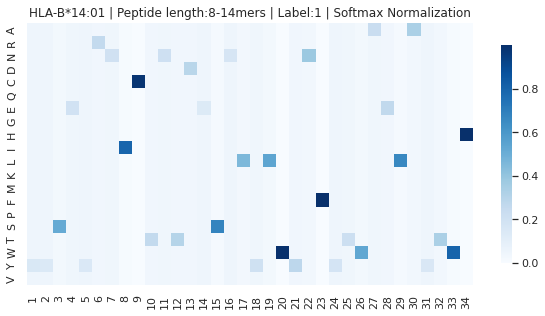

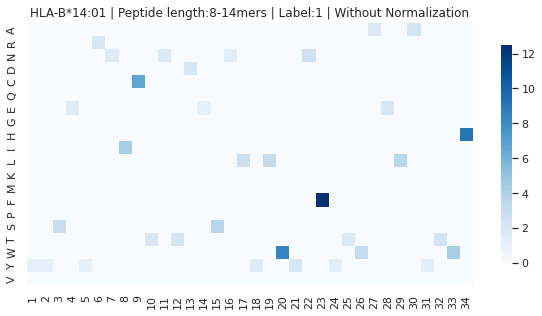


---------------------
#Peptides: 3641
HLA: HLA-C*07:01
Threshold: 0.6
YDSGYRENYRQADVSNLYLRYDSYTLAALAYTWY

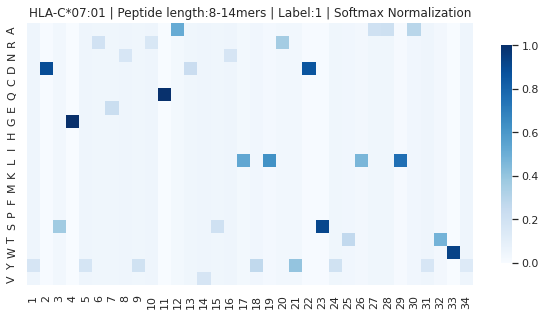

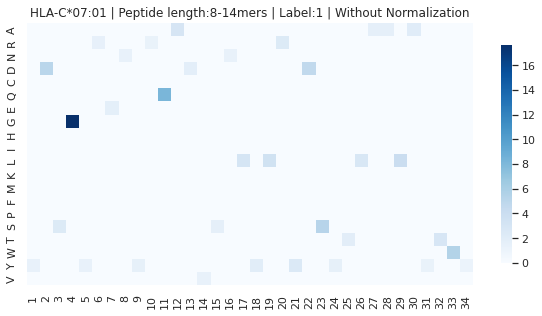


---------------------
#Peptides: 4424
HLA: HLA-B*58:01
Threshold: 0.6
YYATYGENMASTYENIAYIRYDSYTWAVLAYLWY

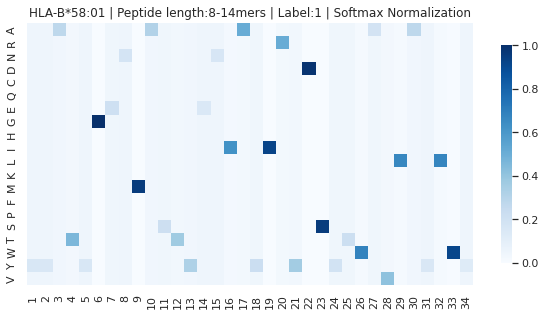

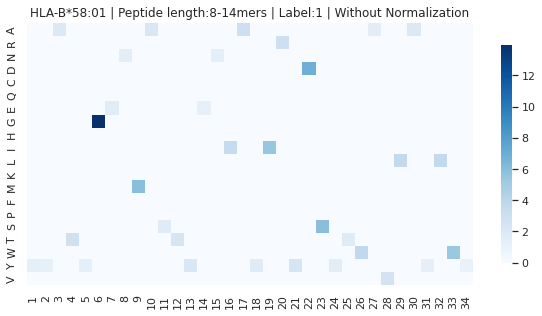


---------------------
#Peptides: 118
HLA: HLA-A*24:13
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY

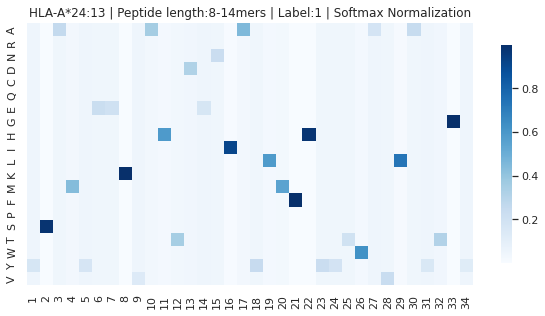

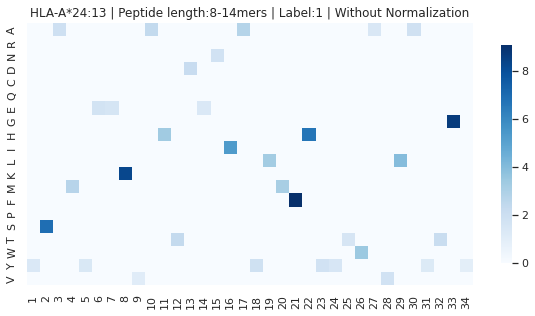


---------------------
#Peptides: 1814
HLA: HLA-A*26:01
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQDYTWAEWAYRWY

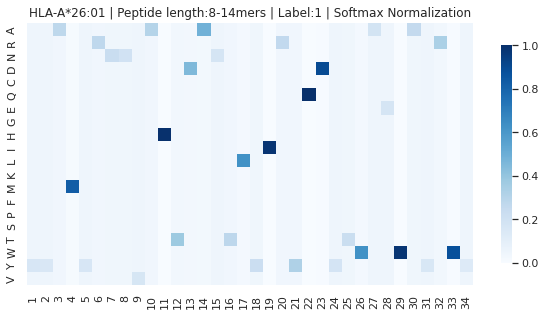

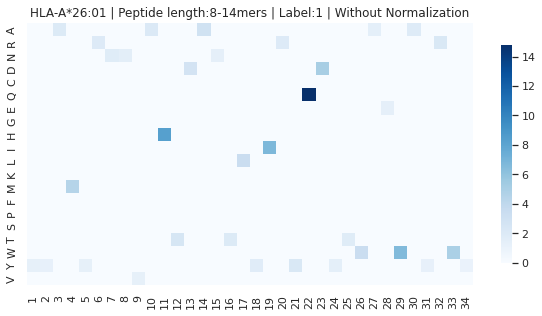


---------------------
#Peptides: 212
HLA: HLA-B*18:03
Threshold: 0.59
YHSTYRNISTNTDESNLYLRYDSYTWAVLAYTWH

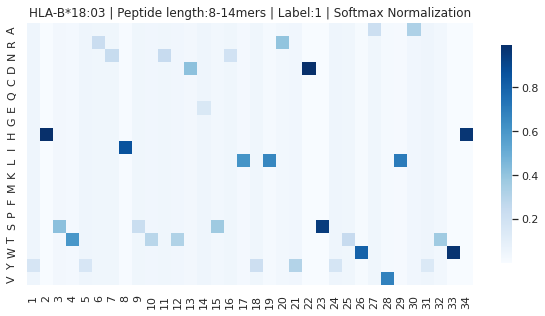

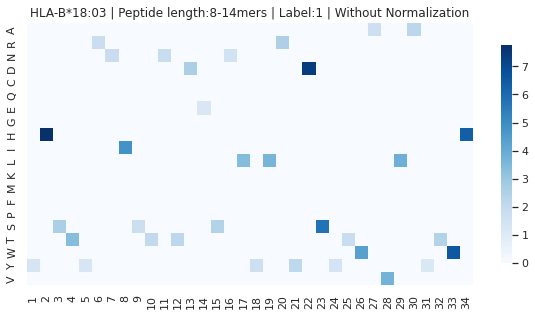


---------------------
#Peptides: 791
HLA: HLA-B*27:03
Threshold: 0.6
YHTEHREICAKTDEDTLYLNYHDYTWAVLAYEWY

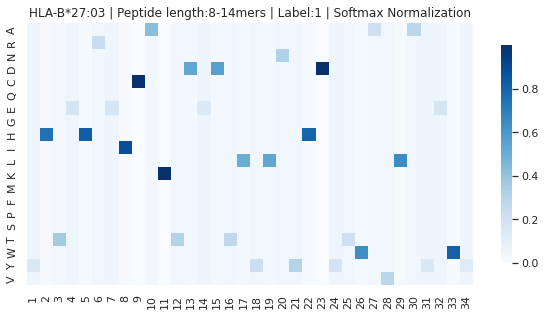

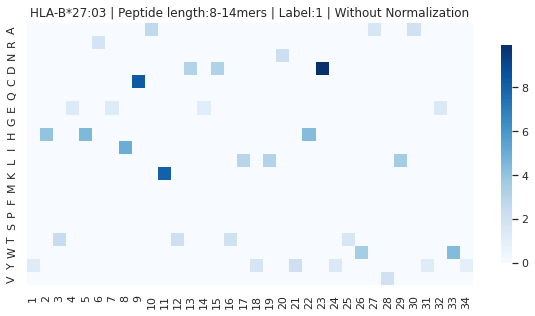


---------------------
#Peptides: 82
HLA: HLA-B*15:09
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYNYYTWAELAYLWY

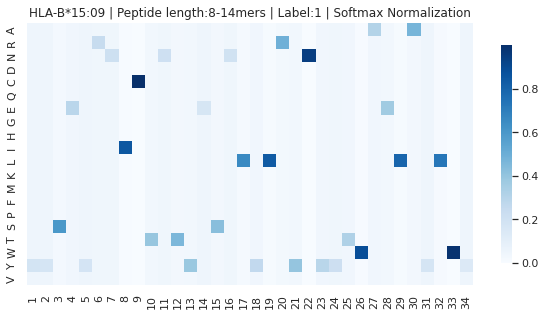

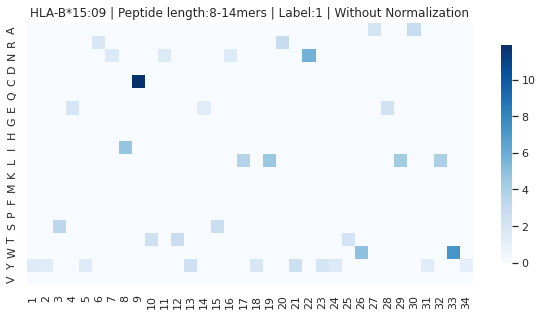


---------------------
#Peptides: 54
HLA: HLA-B*44:27
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY

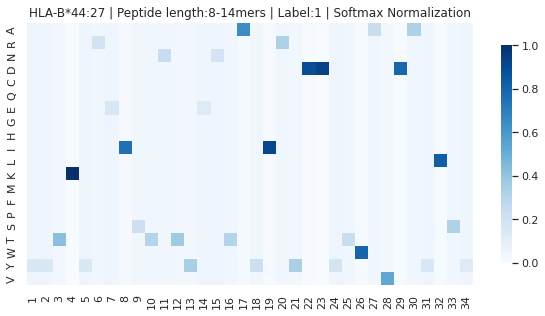

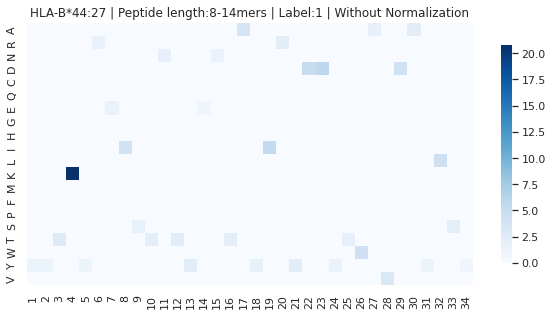


---------------------
#Peptides: 96
HLA: HLA-A*25:01
Threshold: 0.6
YYAMYRNNVAHTDESIAYIRYQDYTWAEWAYRWY

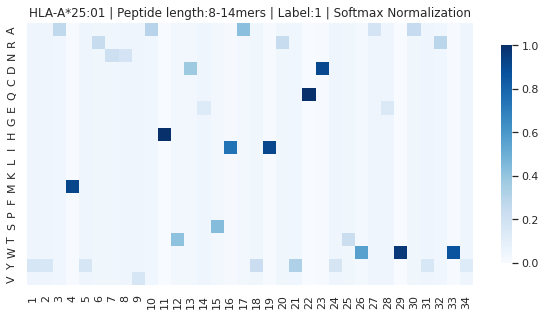

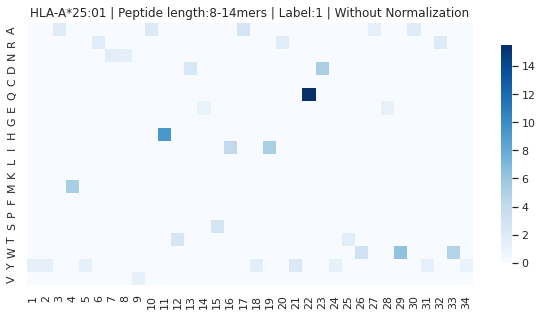


---------------------
#Peptides: 7241
HLA: HLA-B*44:02
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVDAYLSY

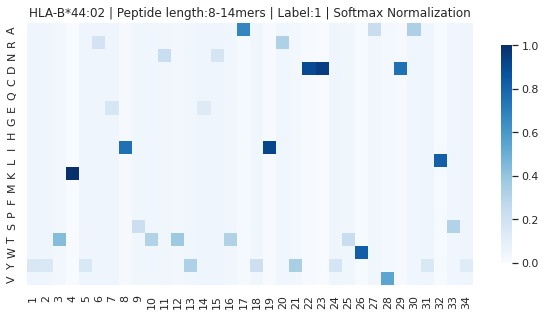

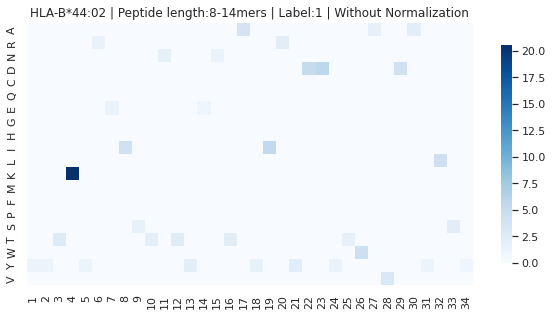


---------------------
#Peptides: 411
HLA: HLA-B*52:01
Threshold: 0.6
YYATYREISTNTYENIAYWTYNYYTWAELAYLWH

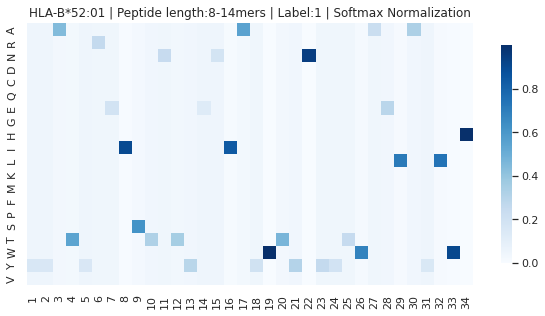

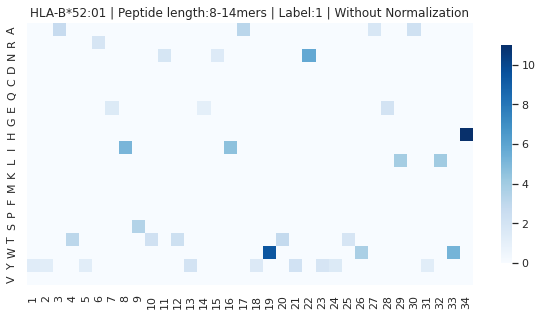


---------------------
#Peptides: 8607
HLA: HLA-B*35:01
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVLAYLWY

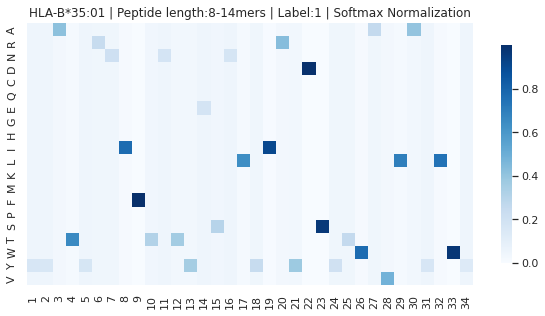

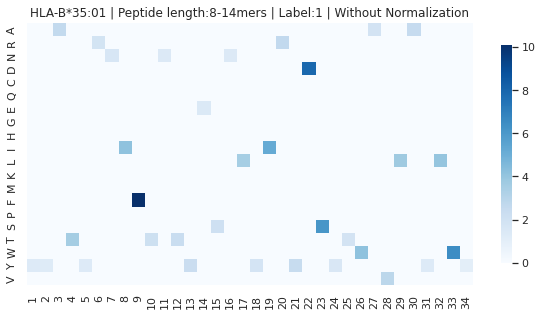


---------------------
#Peptides: 3610
HLA: HLA-B*37:01
Threshold: 0.6
YHSTYREISTNTYEDTLYIRSNFYTWAVDAYTWY

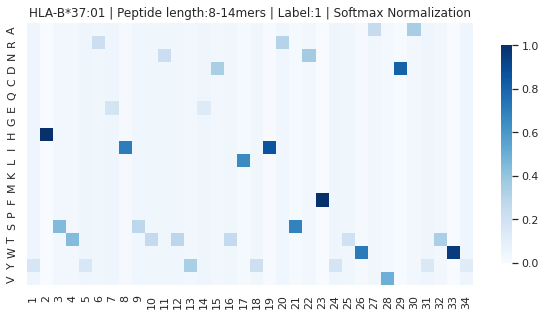

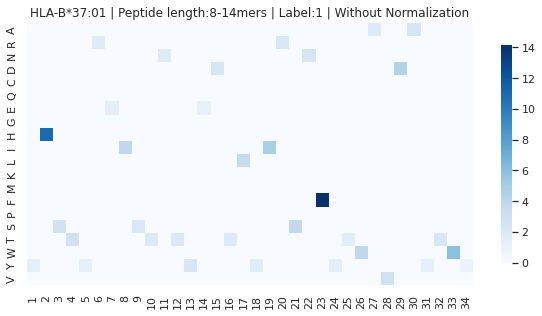


---------------------
#Peptides: 1079
HLA: HLA-A*33:01
Threshold: 0.6
YTAMYRNNVAHIDVDTLYIMYQDYTWAVLAYTWH

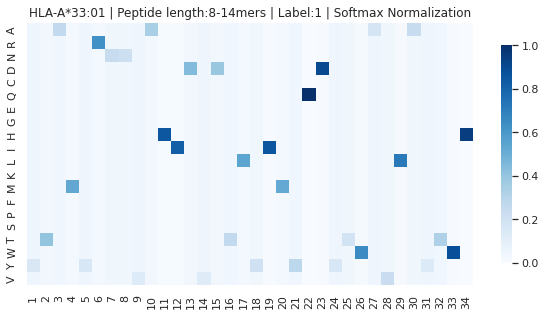

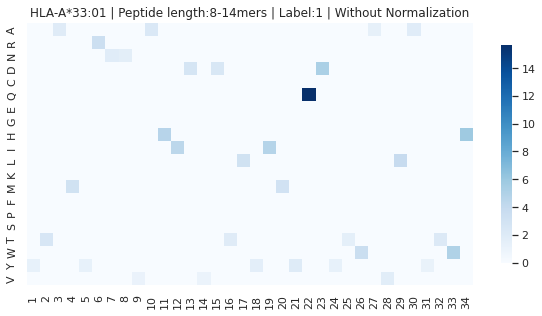


---------------------
#Peptides: 393
HLA: HLA-B*15:17
Threshold: 0.6
YYAMYRENMASTYENIAYLRYHDYTWAELAYLWY

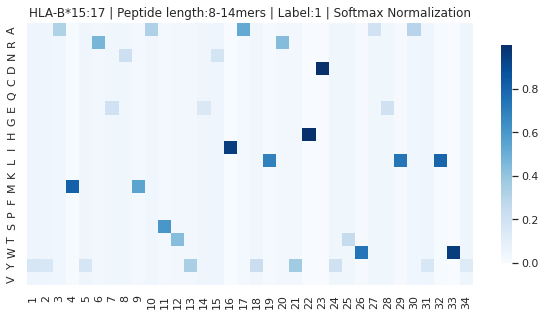

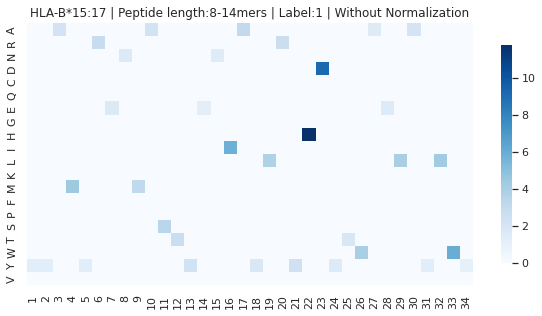


---------------------
#Peptides: 4598
HLA: HLA-A*31:01
Threshold: 0.6
YTAMYQENVAHIDVDTLYIMYQDYTWAVLAYTWY

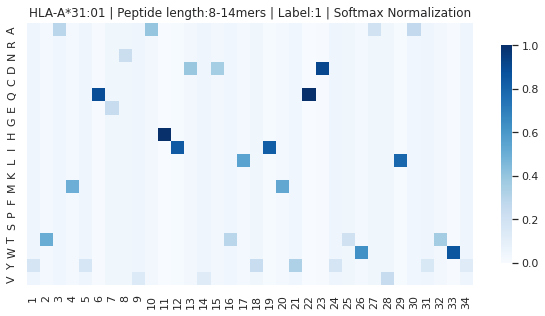

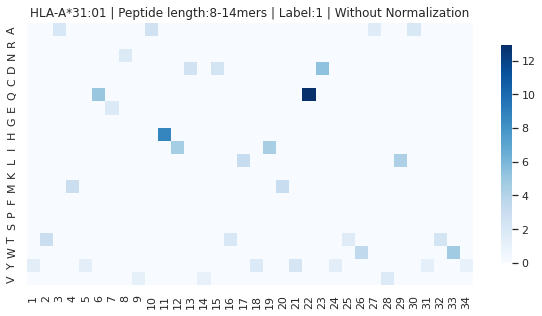


---------------------
#Peptides: 655
HLA: HLA-B*53:01
Threshold: 0.6
YYATYRNIFTNTYENIAYIRYDSYTWAVLAYLWY

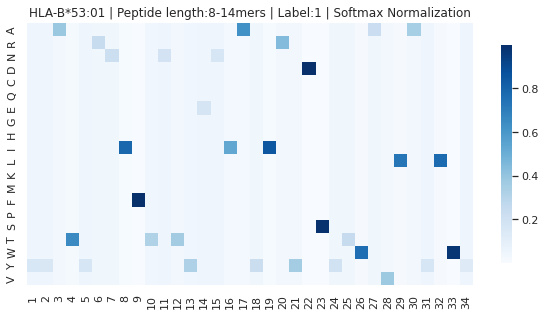

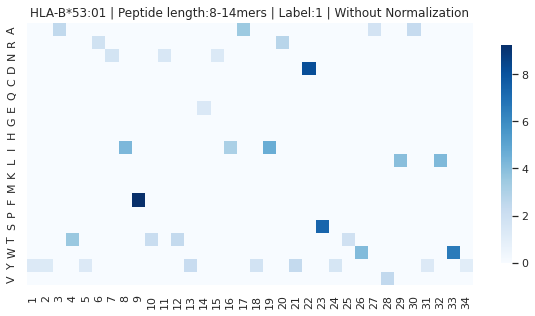


---------------------
#Peptides: 242
HLA: HLA-A*24:06
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVWAYTGY

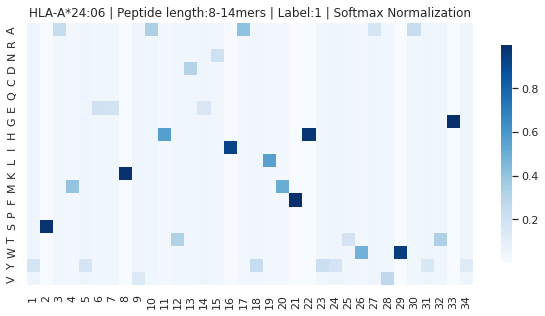

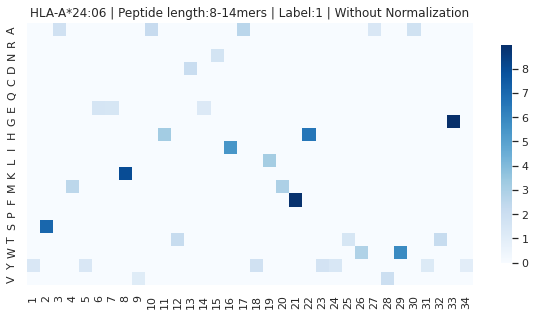


---------------------
#Peptides: 280
HLA: HLA-B*45:06
Threshold: 0.6
YHTKYREIYAQTDESNLYWRYNLYTWAVDAYLSY

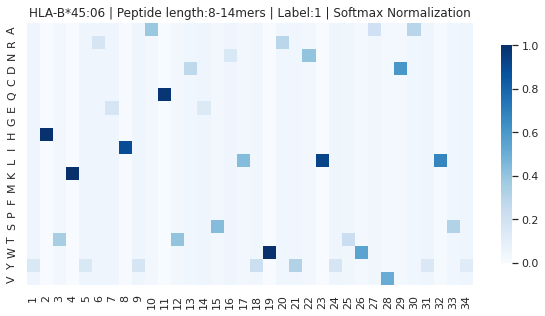

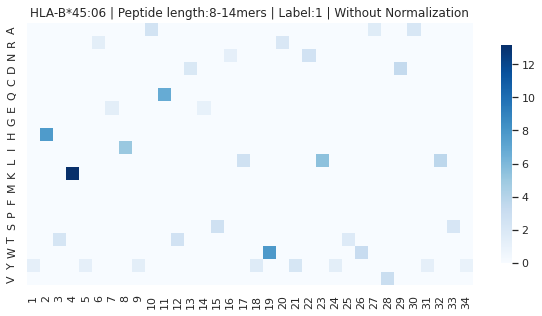


---------------------
#Peptides: 13808
HLA: HLA-B*15:01
Threshold: 0.6
YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY

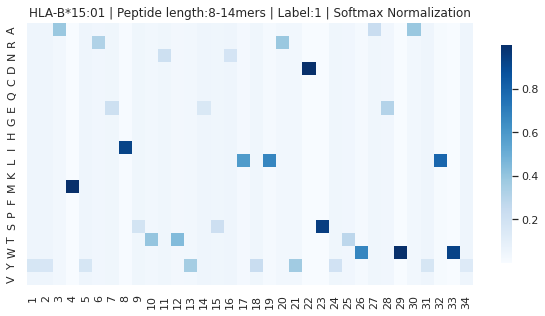

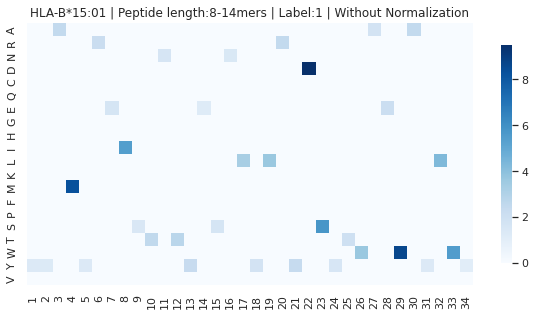


---------------------
#Peptides: 283
HLA: HLA-B*15:42
Threshold: 0.6
YYAMYREISTNTYESNLYWTYNLYTWAELAYTWY

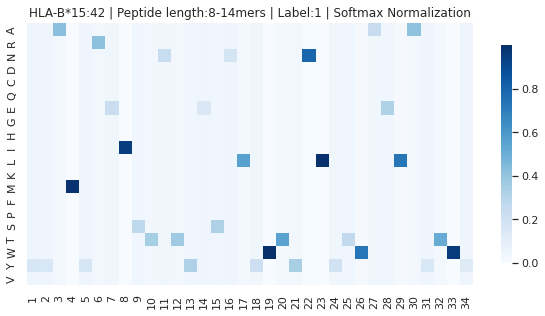

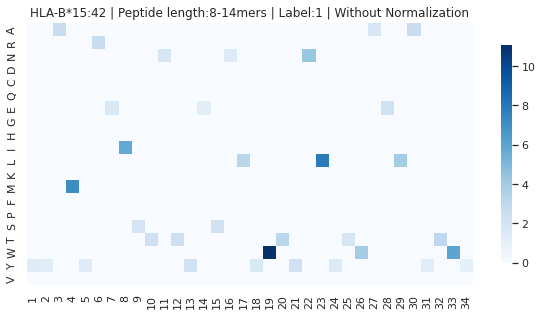


---------------------
#Peptides: 802
HLA: HLA-A*02:20
Threshold: 0.6
YFAMYGENVAHTHVDTLYVRYHYYTWAVLAYTWY

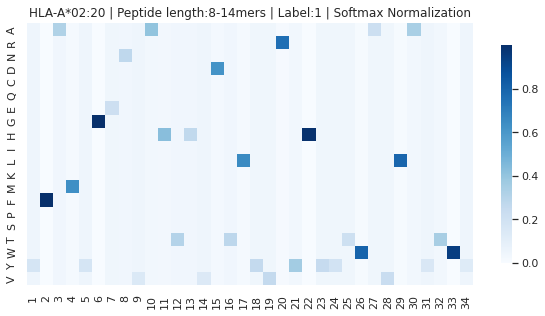

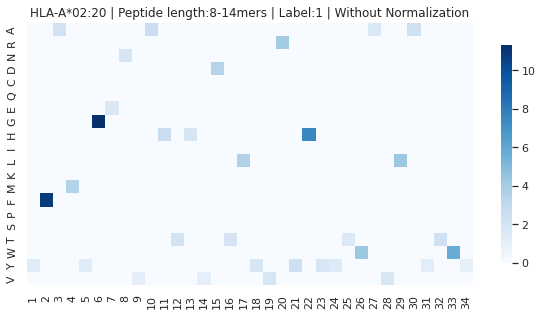


---------------------
#Peptides: 5192
HLA: HLA-A*68:02
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYHYYTWAVWAYTWY

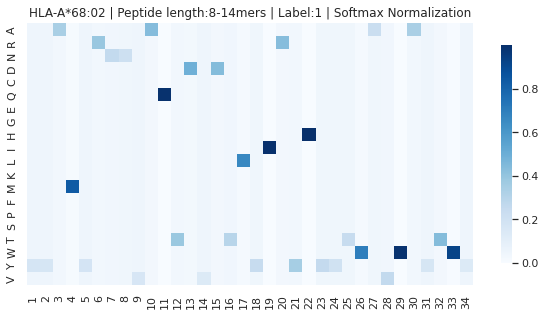

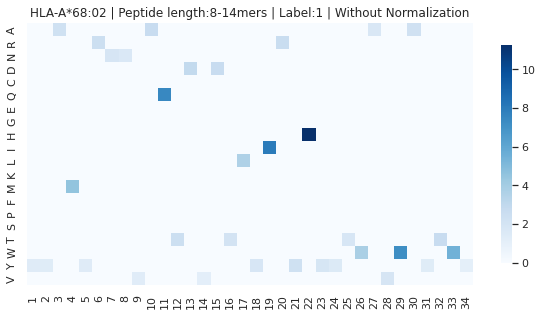


---------------------
#Peptides: 257
HLA: HLA-B*83:01
Threshold: 0.6
YYSEYRNIYAQTDESNLYIRYDDYTWAVDAYLSY

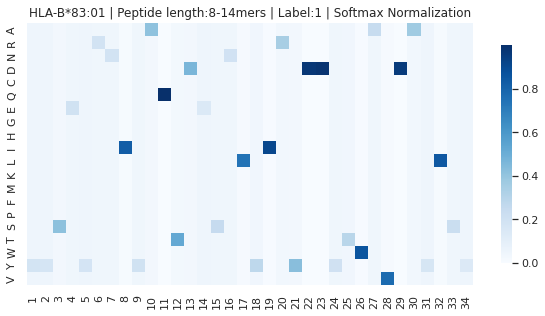

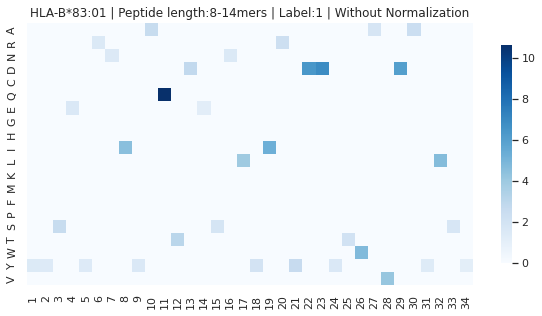


---------------------
#Peptides: 5883
HLA: HLA-B*44:03
Threshold: 0.6
YYTKYREISTNTYENTAYIRYDDYTWAVLAYLSY

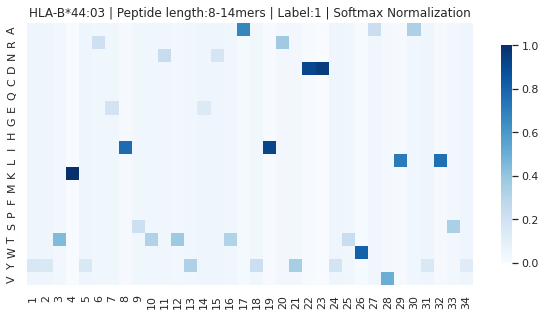

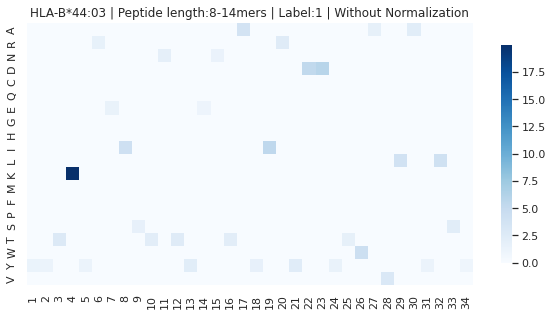


---------------------
#Peptides: 456
HLA: HLA-B*51:08
Threshold: 0.6
YYATYRNIFTNTYENIAYWTYNYYTWAVDAYLWH

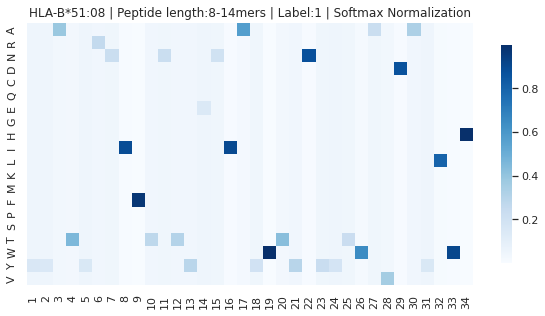

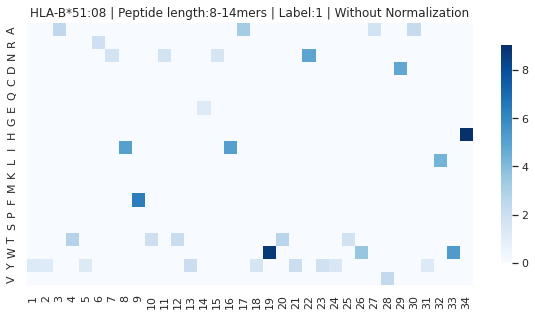


---------------------
#Peptides: 3396
HLA: HLA-A*32:01
Threshold: 0.6
YFAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY

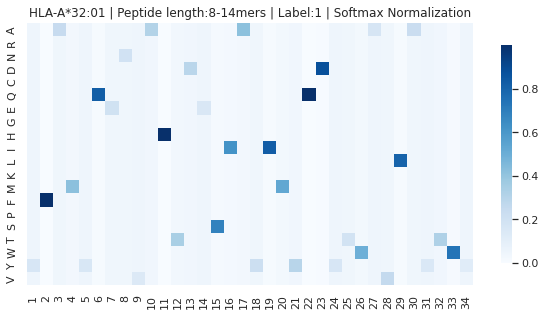

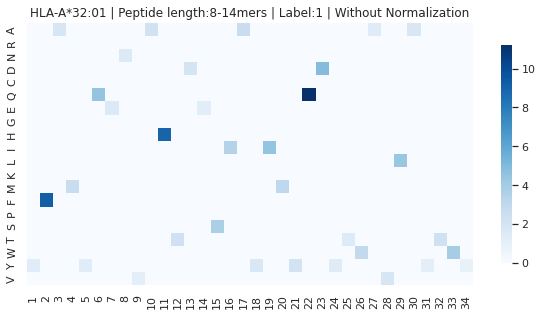


---------------------
#Peptides: 2925
HLA: HLA-B*27:01
Threshold: 0.6
YHTEYREICAKTYENTAYLNYHDYTWAVLAYEWY

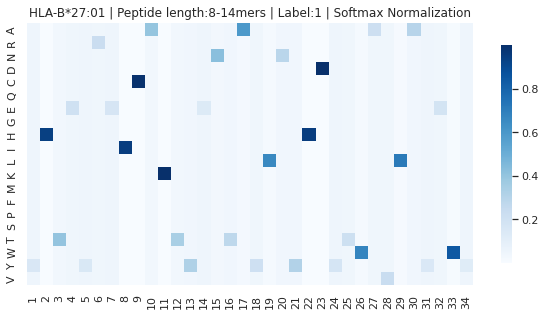

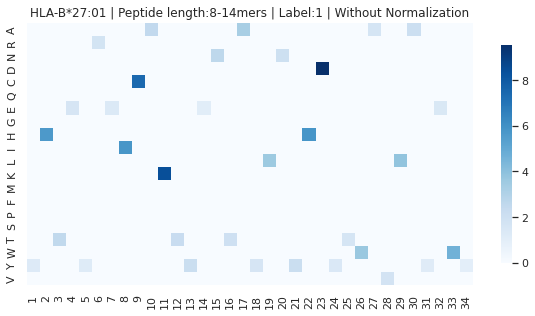


---------------------
#Peptides: 9073
HLA: HLA-A*11:01
Threshold: 0.6
YYAMYQENVAQTDVDTLYIIYRDYTWAAQAYRWY

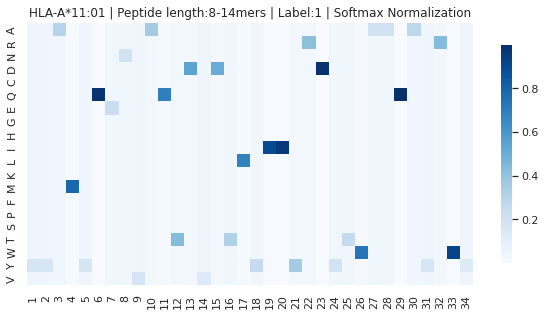

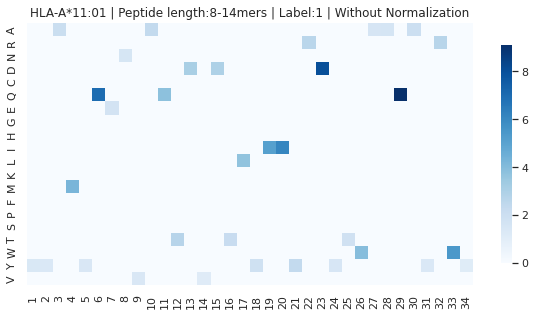


---------------------
#Peptides: 66
HLA: HLA-A*26:03
Threshold: 0.6
YYAMYRNNVAHTHVDTLYIRYQDYTWAEWAYRWY

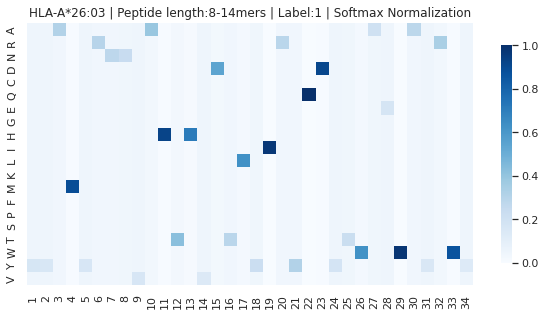

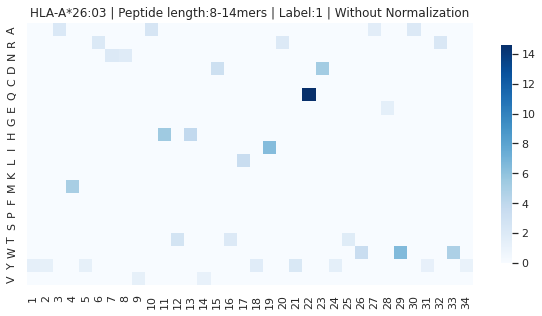


---------------------
#Peptides: 1593
HLA: HLA-C*15:02
Threshold: 0.6
YYAGYRENYRQTDVNKLYIRYDLYTWAELAYTWY

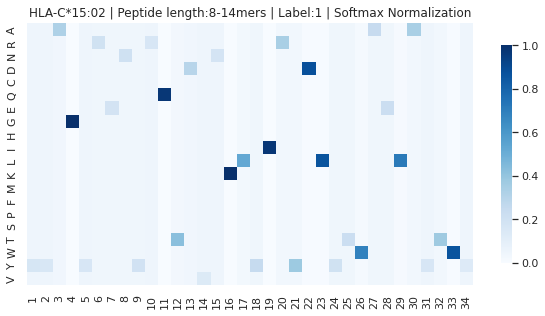

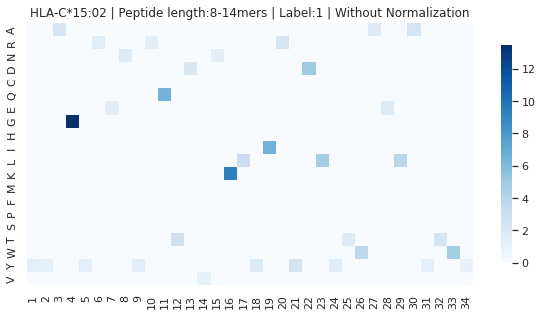


---------------------
#Peptides: 276
HLA: HLA-A*02:12
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVQAYTWY

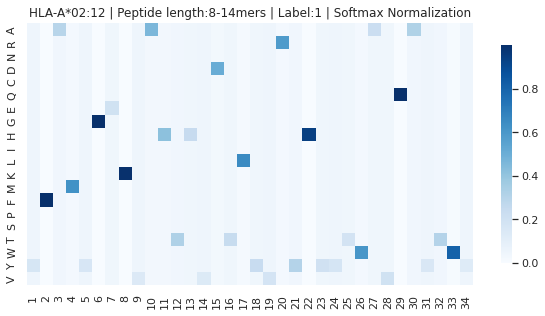

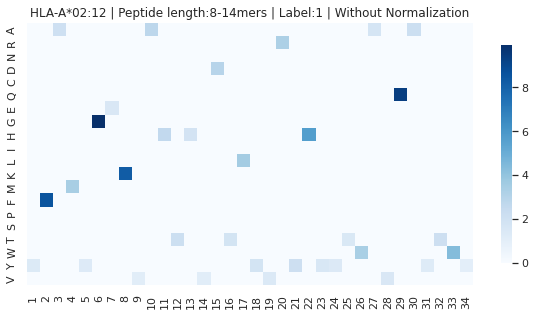


---------------------
#Peptides: 2004
HLA: HLA-A*02:02
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY

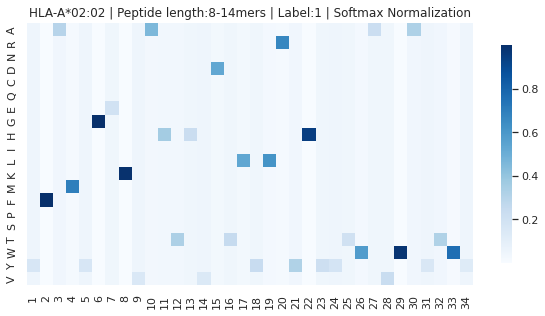

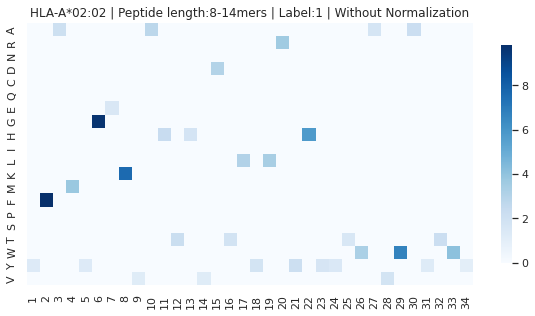


---------------------
#Peptides: 8542
HLA: HLA-C*04:01
Threshold: 0.6
YSAGYREKYRQADVNKLYLRFNFYTWAERAYTWY

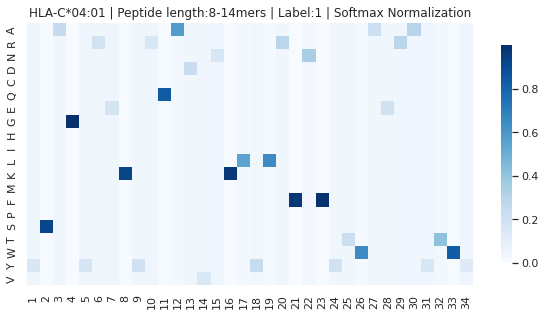

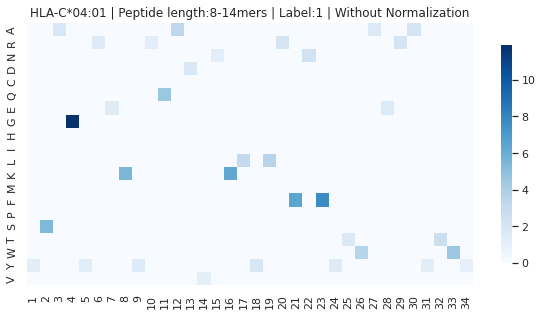


---------------------
#Peptides: 3464
HLA: HLA-C*16:01
Threshold: 0.6
YYAGYREKYRQTDVSNLYLWYDSYTWAAQAYTWY

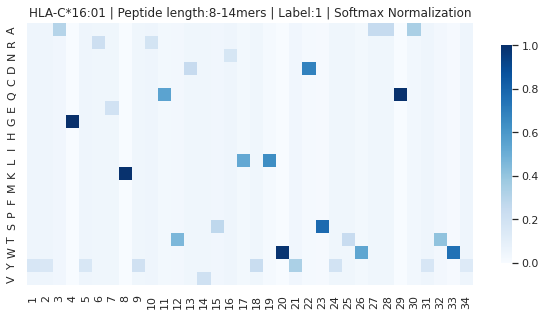

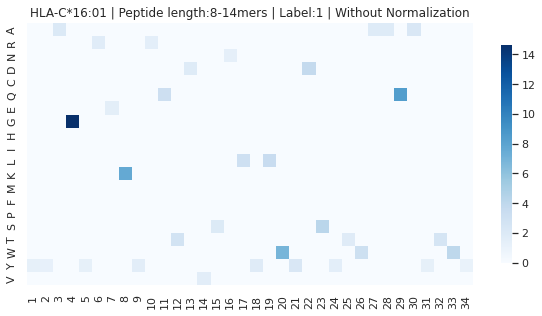


---------------------
#Peptides: 3194
HLA: HLA-B*14:02
Threshold: 0.6
YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH

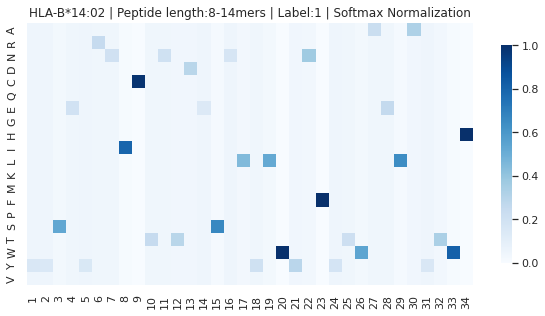

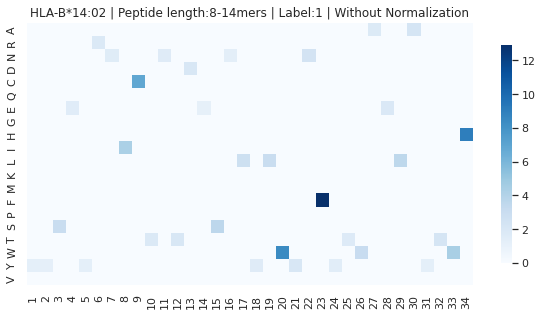


---------------------
#Peptides: 5888
HLA: HLA-A*29:02
Threshold: 0.6
YTAMYLQNVAQTDANTLYIMYRDYTWAVLAYTWY

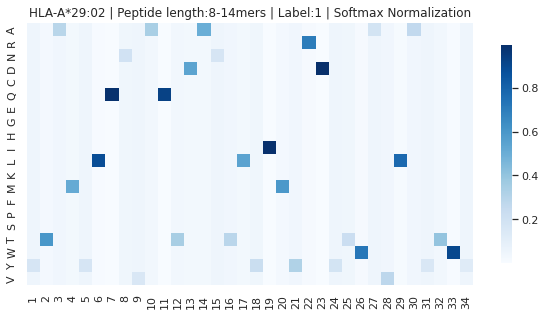

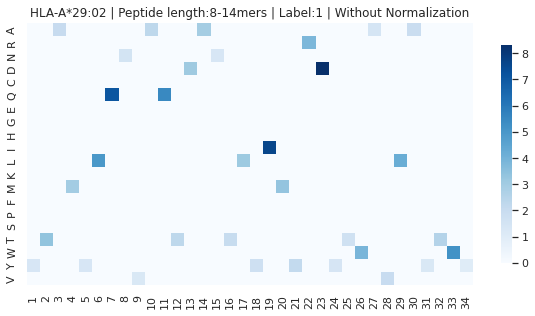


---------------------
#Peptides: 4440
HLA: HLA-B*27:09
Threshold: 0.6
YHTEYREICAKTDEDTLYLNYHHYTWAVLAYEWY

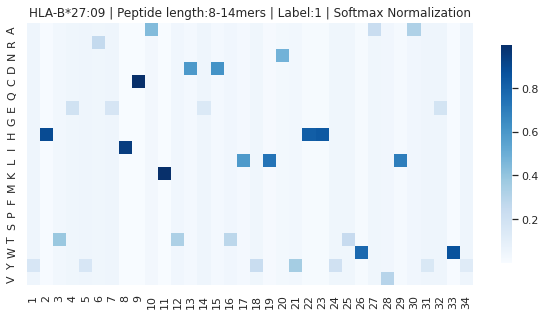

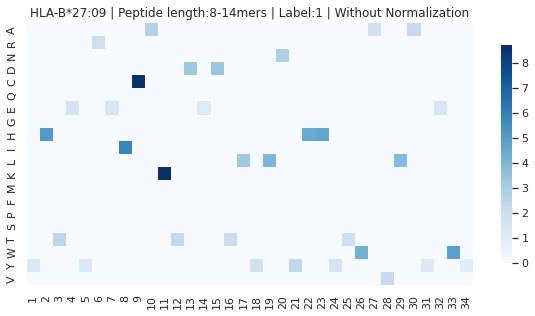


---------------------
#Peptides: 308
HLA: HLA-A*24:03
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTWY

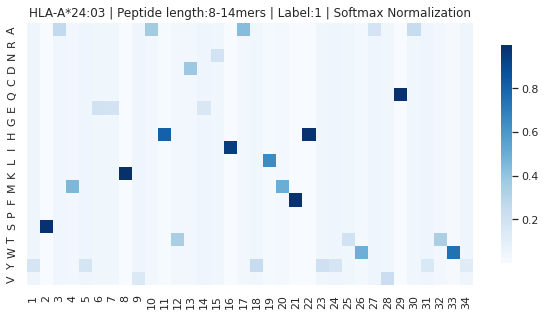

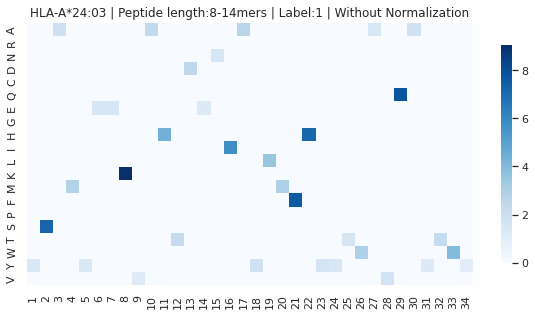


---------------------
#Peptides: 1065
HLA: HLA-B*35:08
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDSYTWAVRAYLWY

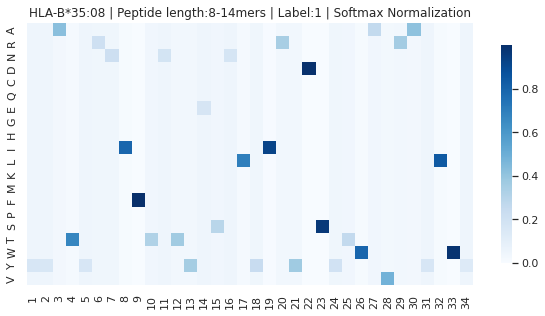

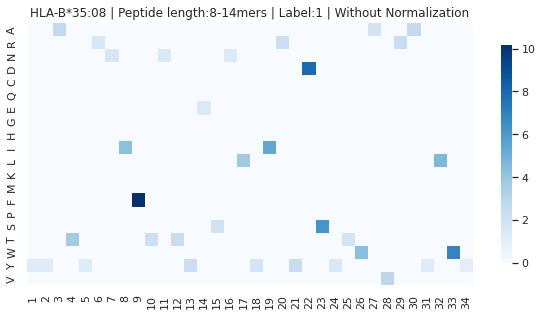


---------------------
#Peptides: 2550
HLA: HLA-B*13:02
Threshold: 0.6
YYTMYREISTNTYENTAYWTYNLYTWAVLAYEWY

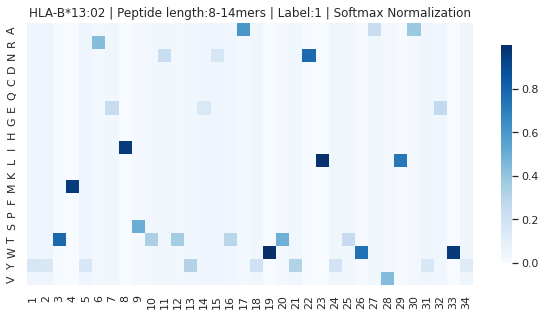

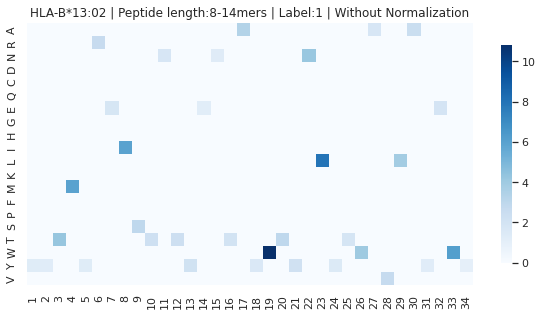


---------------------
#Peptides: 8477
HLA: HLA-A*01:01
Threshold: 0.6
YFAMYQENMAHTDANTLYIIYRDYTWVARVYRGY

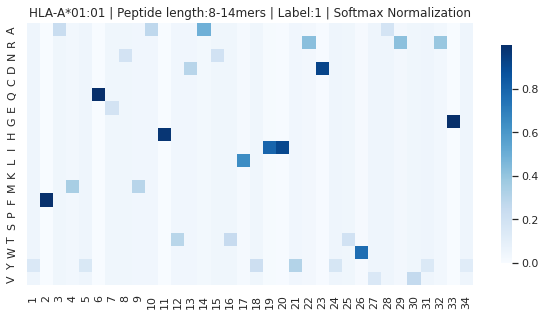

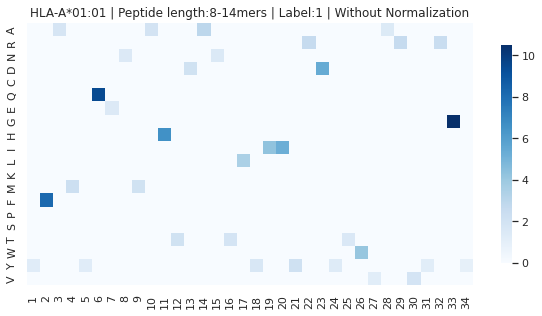


---------------------
#Peptides: 3119
HLA: HLA-B*38:01
Threshold: 0.6
YYSEYRNICTNTYENIAYLRYNFYTWAVLTYTWY

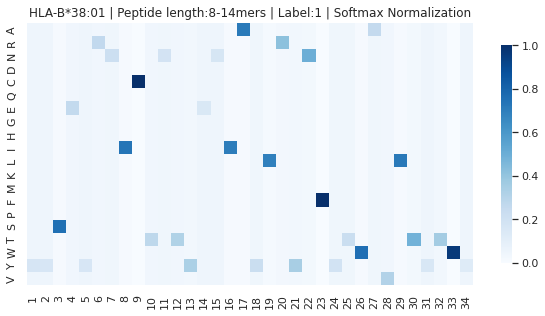

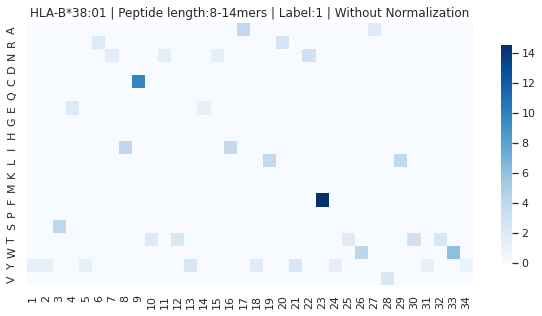


---------------------
#Peptides: 4409
HLA: HLA-B*40:01
Threshold: 0.6
YHTKYREISTNTYESNLYLRYNYYSLAVLAYEWY

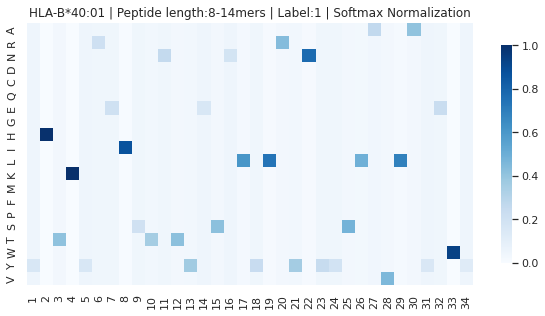

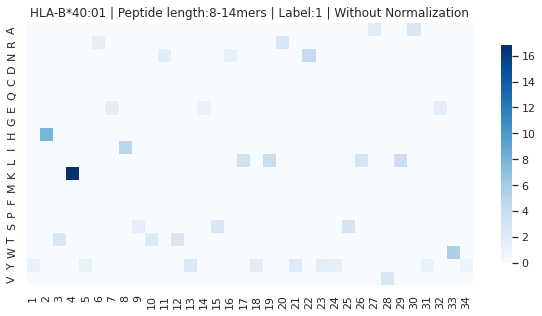


---------------------
#Peptides: 58
HLA: HLA-A*32:15
Threshold: 0.6
YFAMYRNNVAHTDESIAYIMYQDYTWAVLAYTWY

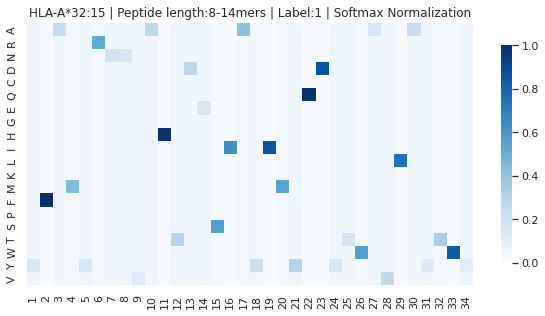

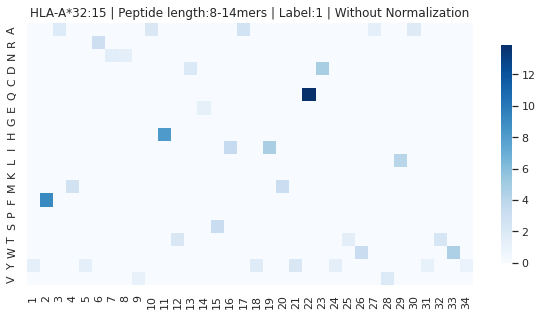


---------------------
#Peptides: 73
HLA: HLA-B*27:20
Threshold: 0.6
YHTEYREICAKTDESTLYLNYNYYTWAELAYEWY

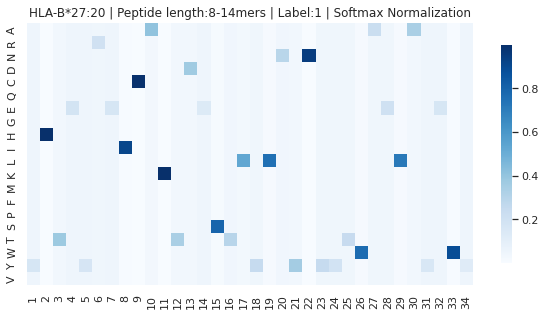

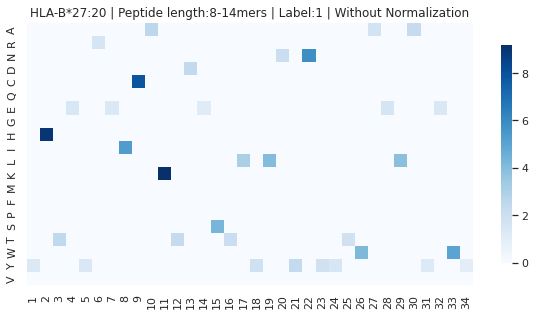


---------------------
#Peptides: 3973
HLA: HLA-A*02:03
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAEWAYTWY

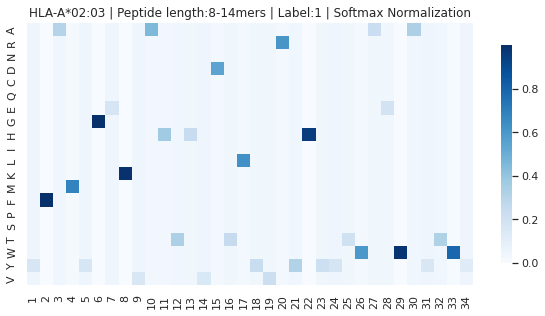

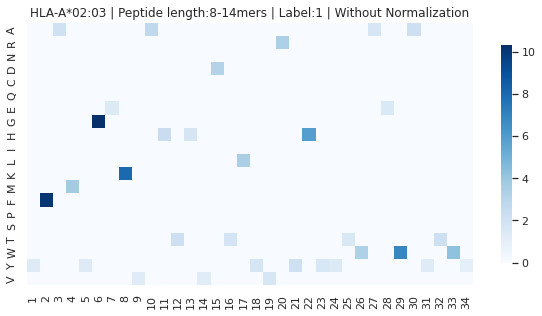


---------------------
#Peptides: 487
HLA: HLA-B*39:24
Threshold: 0.6
YYSEYRNICTNTDESNLYLSYNFYTWAVLTYTWY

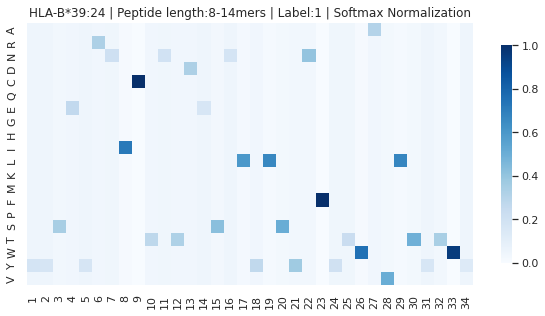

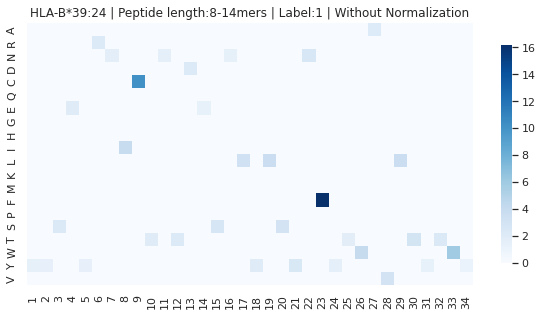


---------------------
#Peptides: 328
HLA: HLA-A*02:11
Threshold: 0.6
YFAMYGEKVAHIDVDTLYVRYHYYTWAVLAYTWY

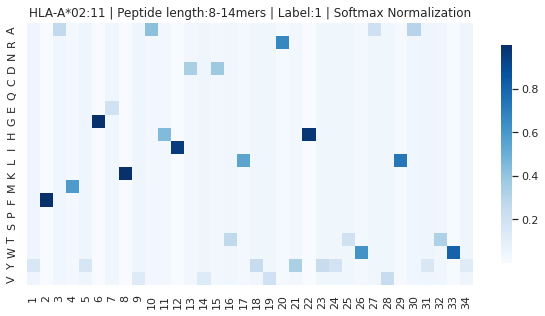

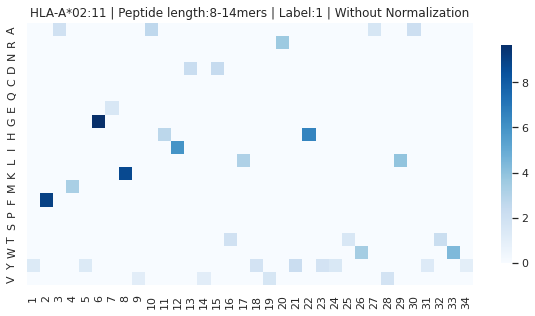


---------------------
#Peptides: 142
HLA: HLA-A*80:01
Threshold: 0.6
YFAMYEENVAHTNANTLYIIYRDYTWARLAYEGY

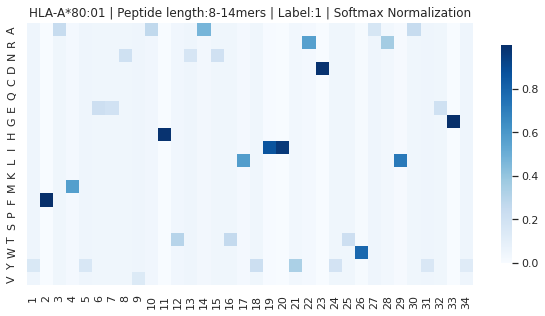

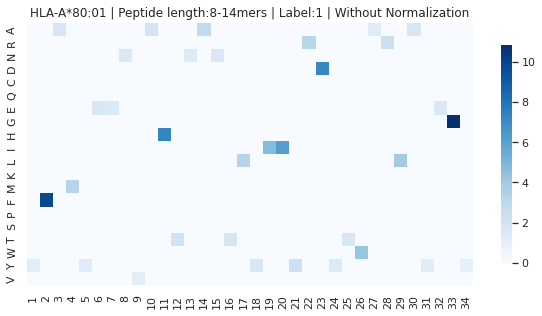


---------------------
#Peptides: 1263
HLA: HLA-B*39:06
Threshold: 0.6
YYSEYRNICTNTDESNLYWTYNFYTWAVLTYTWY

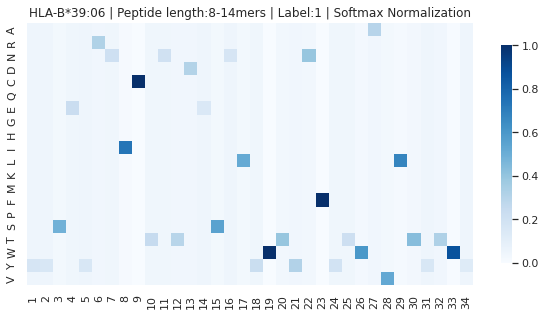

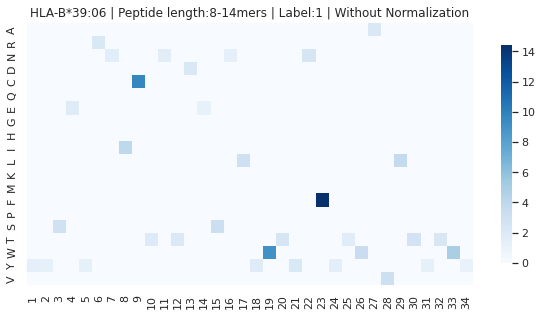


---------------------
#Peptides: 957
HLA: HLA-A*69:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYVRYHYYTWAVLAYTWY

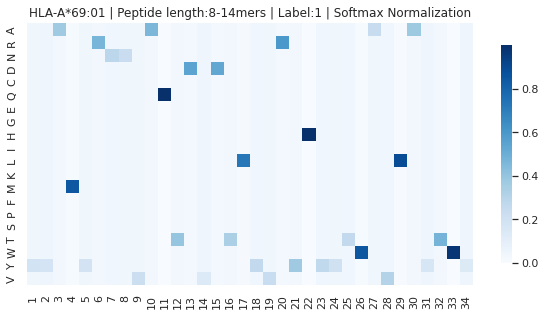

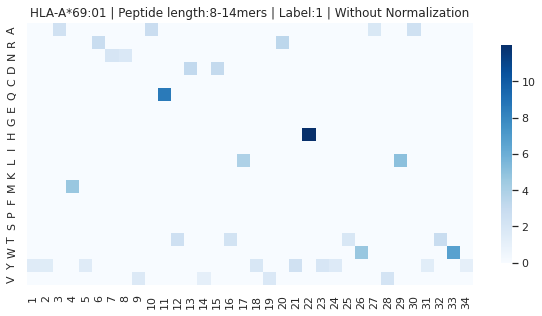


---------------------
#Peptides: 4148
HLA: HLA-B*57:03
Threshold: 0.6
YYAMYGENMASTYENIAYIVYNYYTWAVLAYLWY

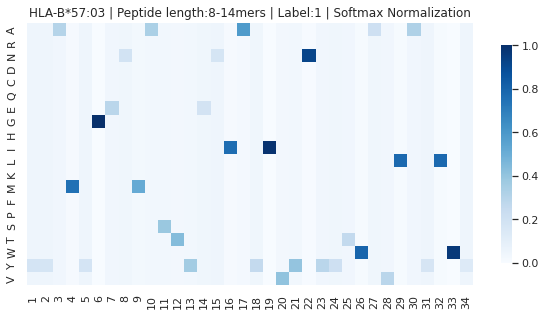

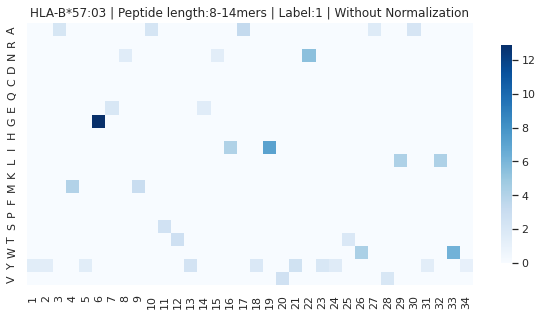


---------------------
#Peptides: 74
HLA: HLA-A*66:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYQDYTWAEWAYRWY

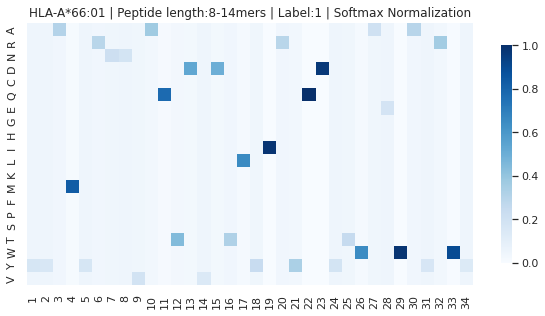

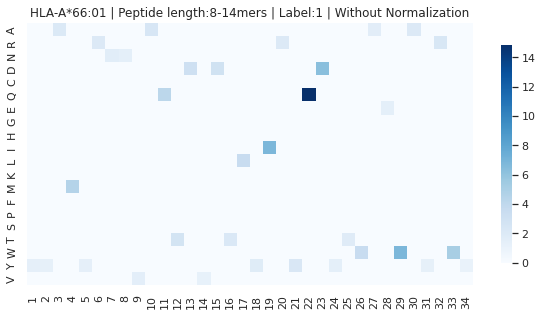


---------------------
#Peptides: 233
HLA: HLA-A*02:17
Threshold: 0.6
YFAMYGEKVAHTHVDTLYLMFHYYTWAVLAYTWY

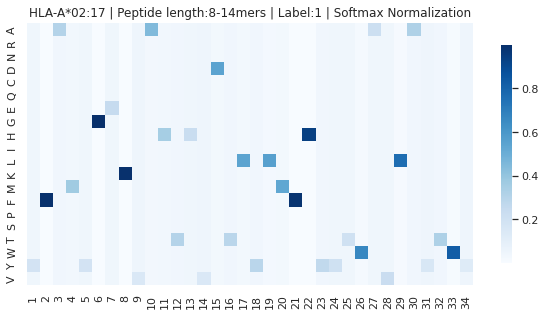

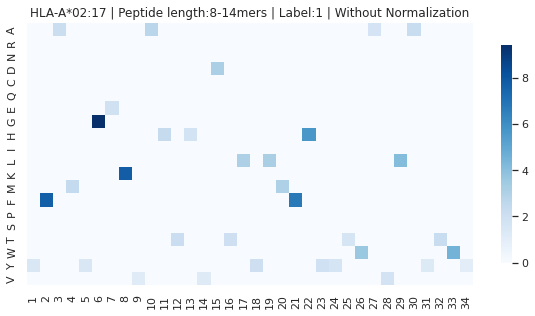


---------------------
#Peptides: 2268
HLA: HLA-B*45:01
Threshold: 0.6
YHTKYREISTNTYESNLYWRYNLYTWAVDAYLSY

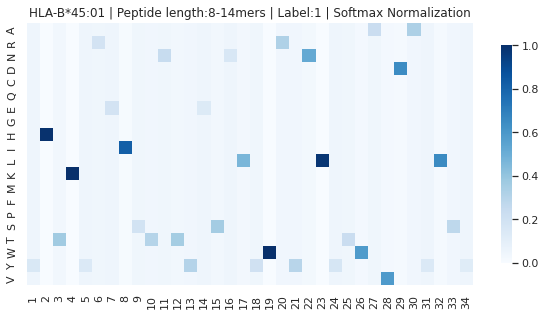

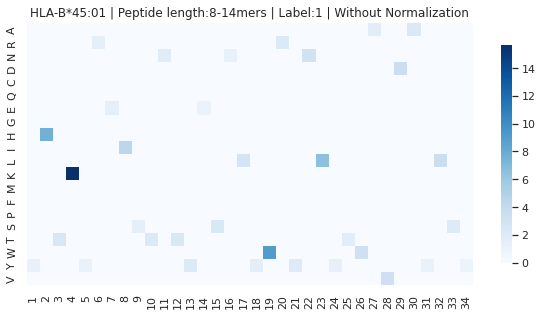


---------------------
#Peptides: 1171
HLA: HLA-B*54:01
Threshold: 0.6
YYAGYRNIYAQTDESNLYWTYNLYTWAVLAYTWY

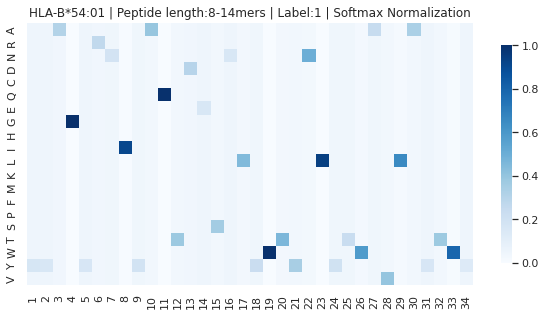

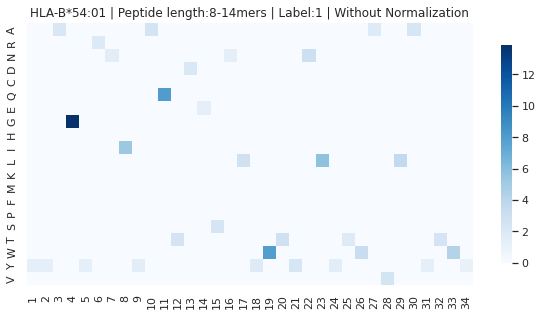


---------------------
#Peptides: 327
HLA: HLA-B*15:03
Threshold: 0.6
YYSEYREISTNTYESNLYLRYDSYTWAELAYLWY

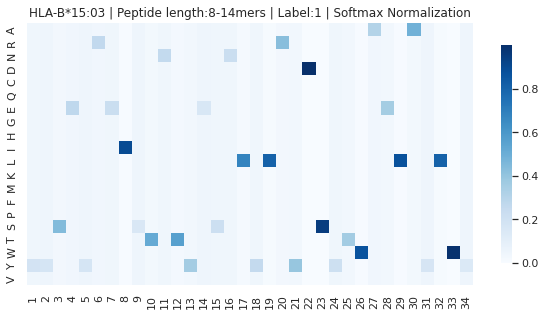

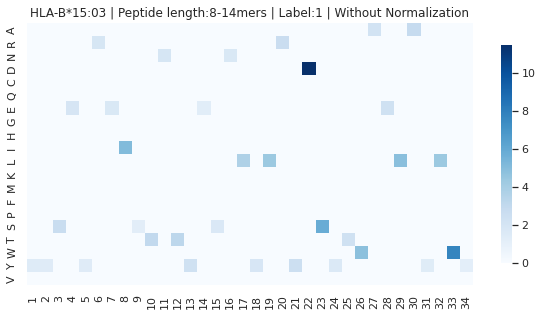


---------------------
#Peptides: 36670
HLA: HLA-B*27:05
Threshold: 0.6
YHTEYREICAKTDEDTLYLNYHDYTWAVLAYEWY

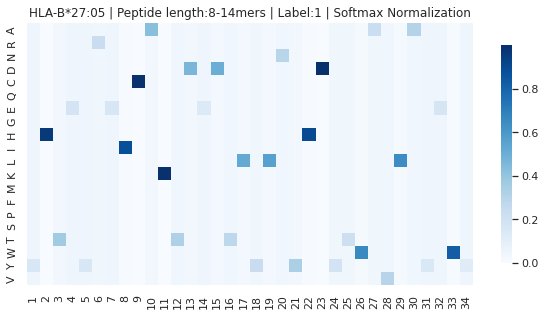

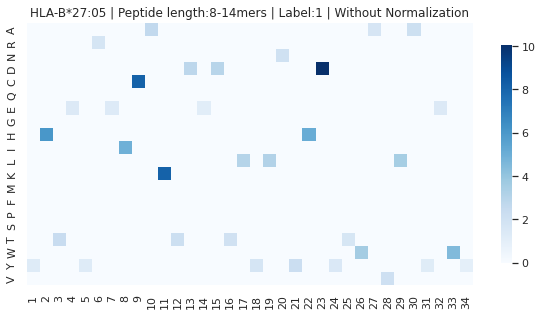


---------------------
#Peptides: 1648
HLA: HLA-B*27:08
Threshold: 0.6
YHTEYREICAKTDESNLYLNYHDYTWAVLAYEWY

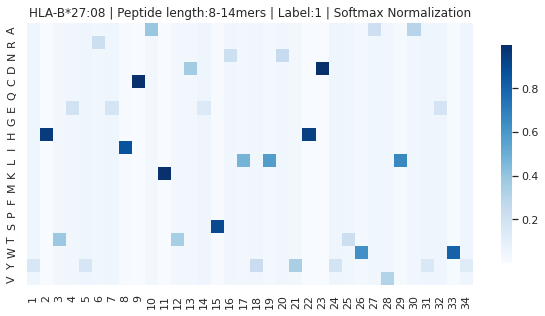

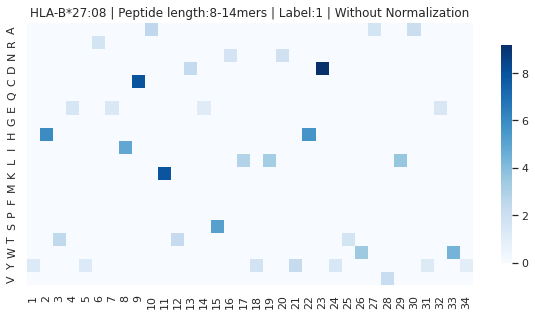


---------------------
#Peptides: 94
HLA: HLA-B*48:01
Threshold: 0.6
YYSEYREISTNTYESNLYLSYNYYSLAVLAYEWY

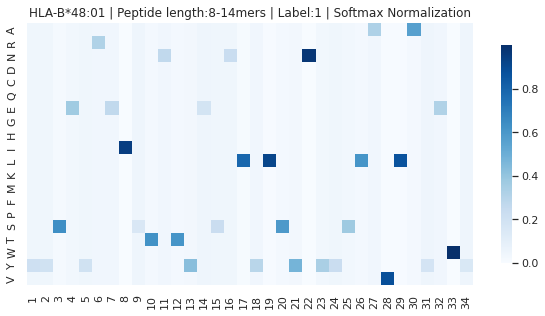

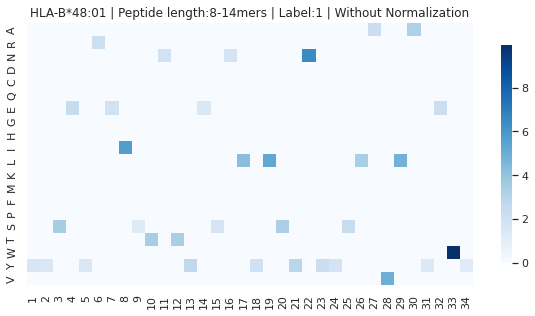


---------------------
#Peptides: 188
HLA: HLA-A*26:02
Threshold: 0.6
YYAMYRNNVAHTDANTLYIRYQNYTWAEWAYRWY

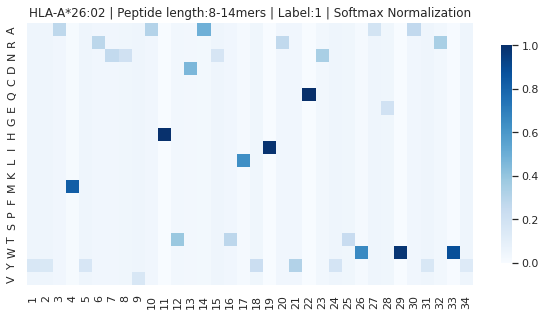

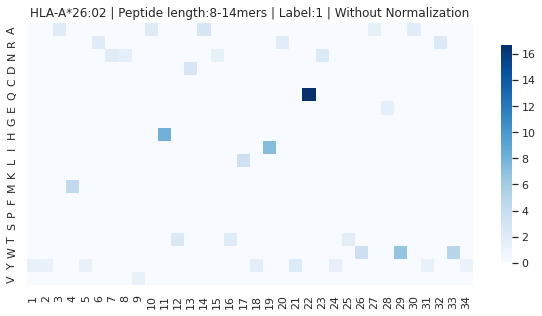


---------------------
#Peptides: 1642
HLA: HLA-B*46:01
Threshold: 0.6
YYAMYREKYRQTDVSNLYLRYDSYTWAEWAYLWY

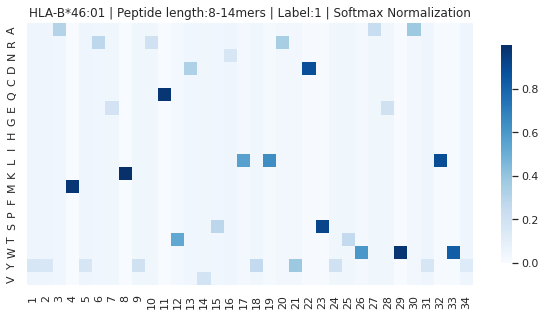

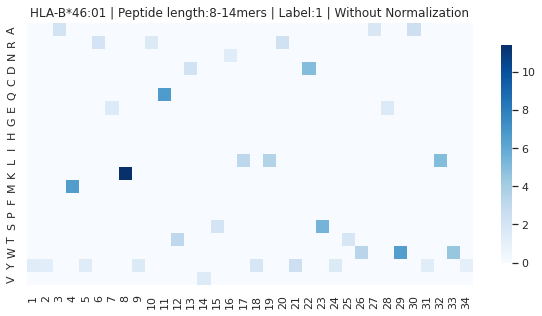


---------------------
#Peptides: 2550
HLA: HLA-B*27:02
Threshold: 0.6
YHTEYREICAKTDENIAYLNYHDYTWAVLAYEWY

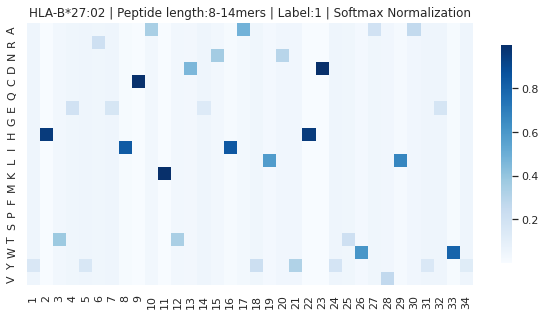

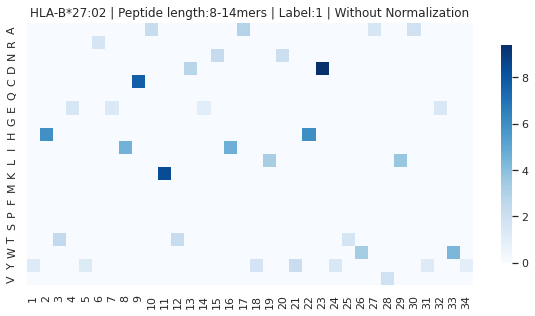


---------------------
#Peptides: 7510
HLA: HLA-B*40:02
Threshold: 0.6
YHTKYREISTNTYESNLYLSYNYYTWAVLAYEWY

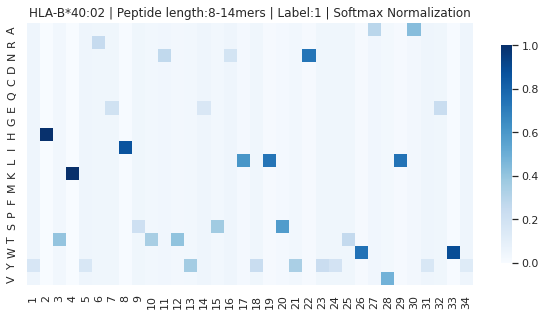

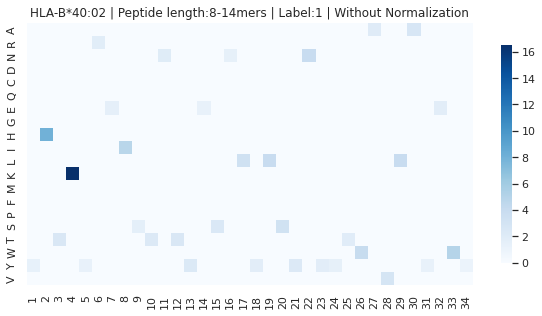


---------------------
#Peptides: 1336
HLA: HLA-A*02:04
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVMYHYYTWAVLAYTWY

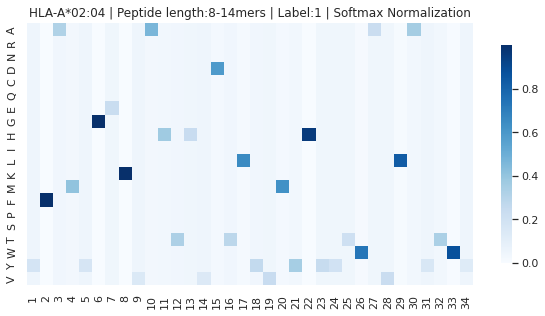

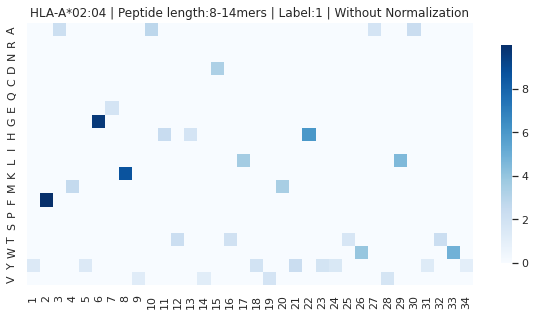


---------------------
#Peptides: 1922
HLA: HLA-C*01:02
Threshold: 0.6
YFSGYREKYRQTDVSNLYLWCDYYTWAERAYTWY

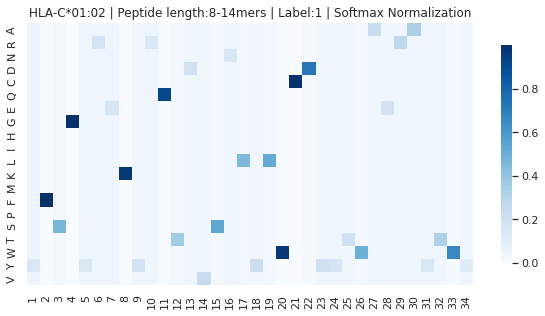

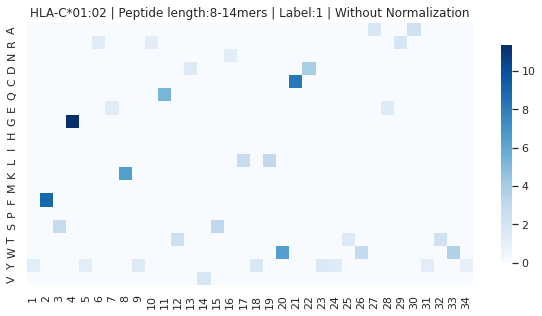


---------------------
#Peptides: 152
HLA: HLA-A*02:16
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYEWY

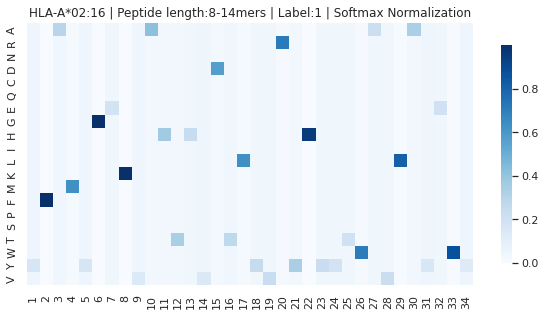

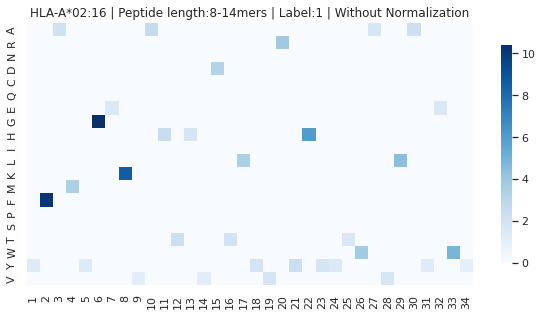


---------------------
#Peptides: 5447
HLA: HLA-C*06:02
Threshold: 0.6
YDSGYREKYRQADVNKLYLWYDSYTWAEWAYTWY

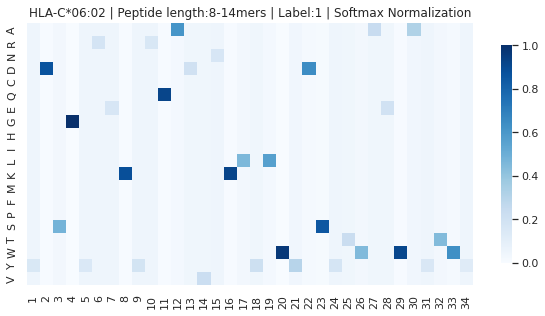

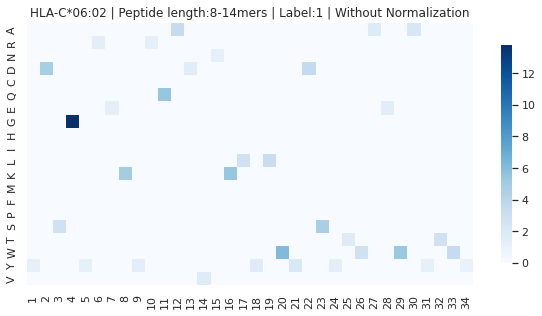


---------------------
#Peptides: 861
HLA: HLA-B*15:18
Threshold: 0.6
YYSEYRNICTNTYESNLYLRYDSYTWAELAYLWY

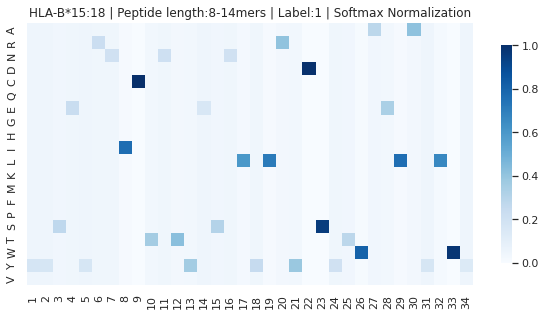

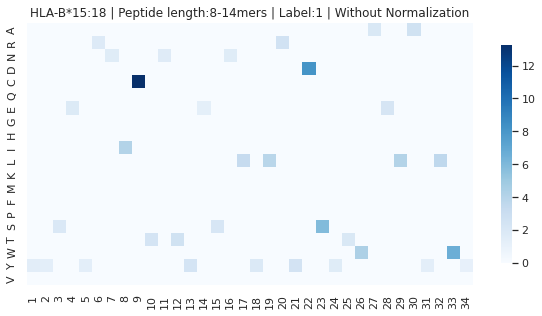


---------------------
#Peptides: 845
HLA: HLA-A*30:02
Threshold: 0.6
YSAMYQENVAHTDENTLYIIYEHYTWARLAYTWY

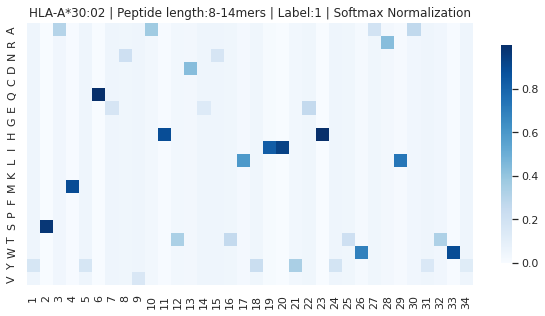

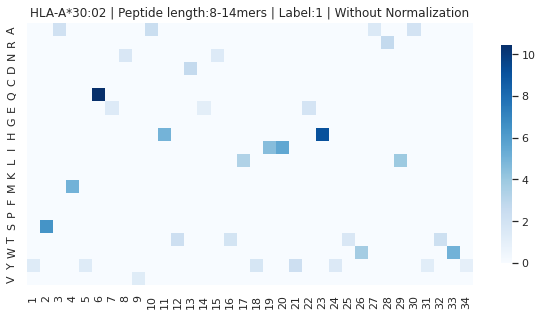


---------------------
#Peptides: 4405
HLA: HLA-C*05:01
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYNFYTWAERAYTWY

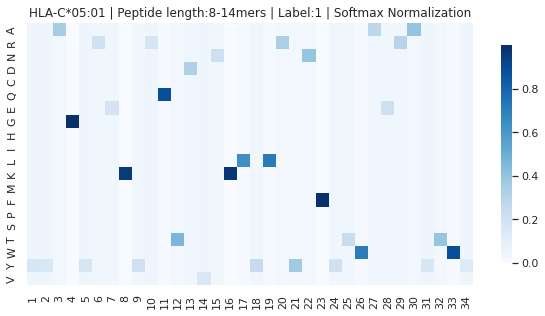

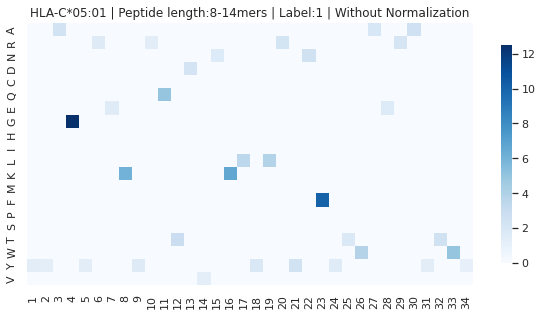


---------------------
#Peptides: 2103
HLA: HLA-C*14:02
Threshold: 0.6
YSAGYREKYRQTDVSNLYLWFDSYTWAERAYTWY

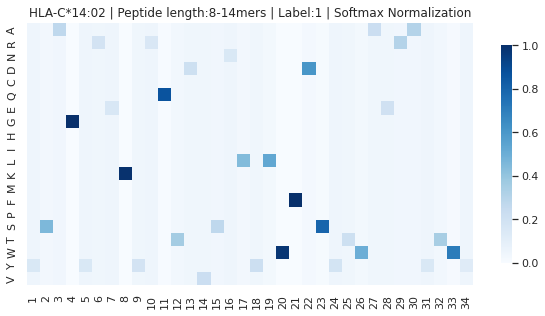

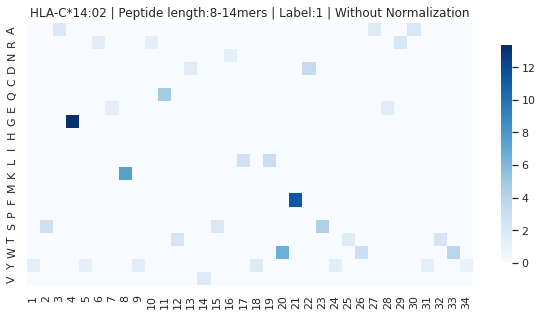


---------------------
#Peptides: 211
HLA: HLA-B*15:02
Threshold: 0.6
YYAMYRNISTNTYESNLYIRYDSYTWAELAYLWY

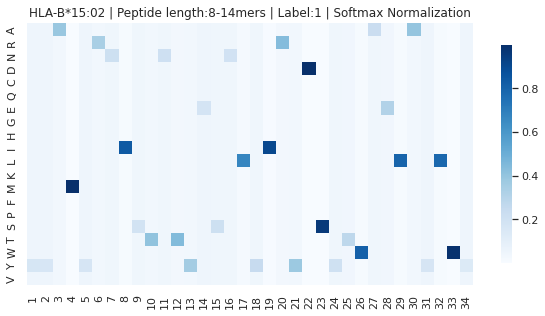

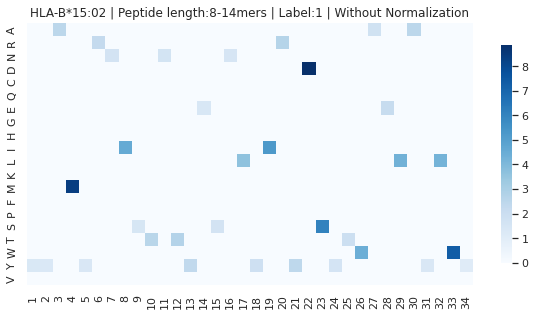


---------------------
#Peptides: 4282
HLA: HLA-C*03:03
Threshold: 0.6
YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY

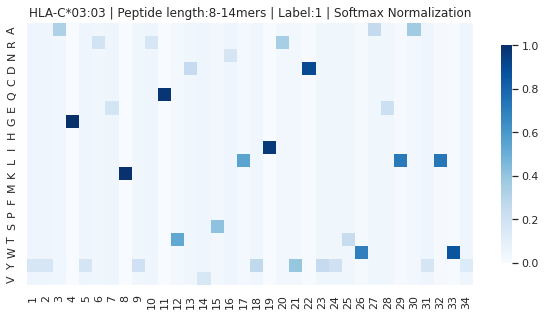

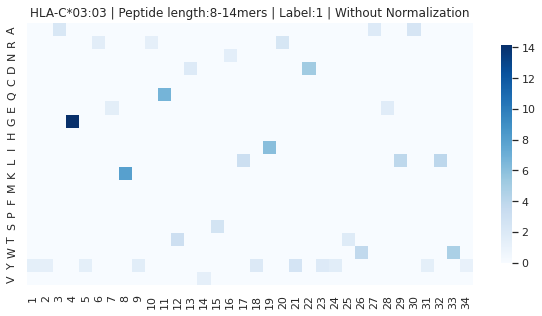


---------------------
#Peptides: 944
HLA: HLA-B*27:06
Threshold: 0.6
YHTEYREICAKTDESTLYLNYDYYTWAELAYEWY

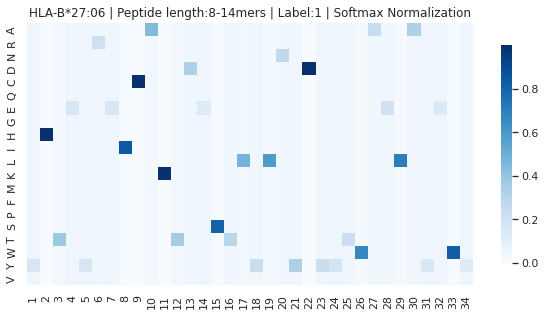

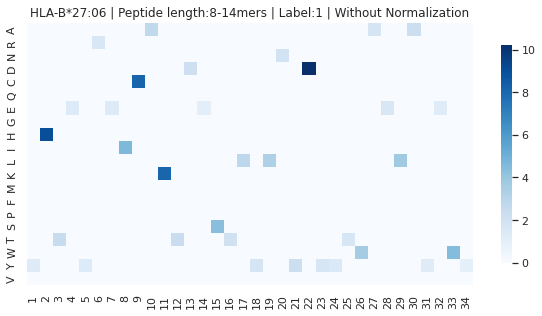


---------------------
#Peptides: 4042
HLA: HLA-A*02:06
Threshold: 0.6
YYAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY

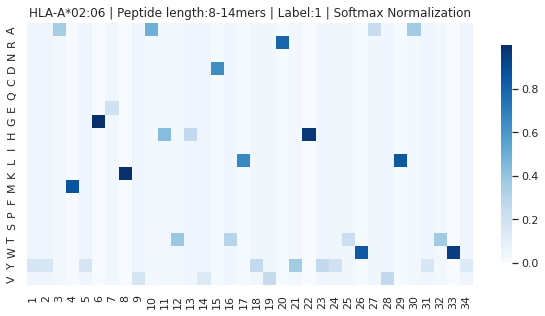

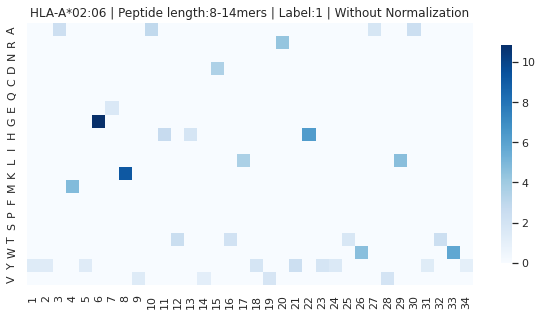


---------------------
#Peptides: 70
HLA: HLA-A*32:07
Threshold: 0.6
YSAMYQENVAHTDESIAYIMYQDYTWAVLAYTWY

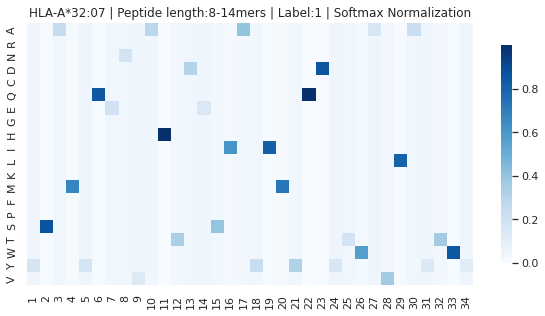

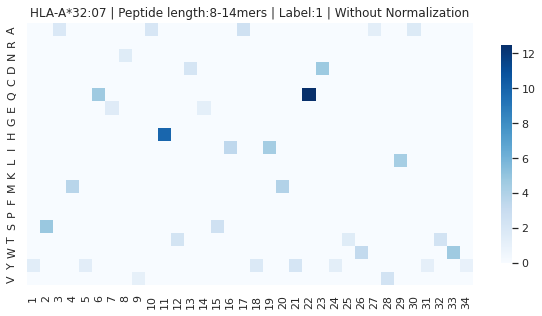


---------------------
#Peptides: 3973
HLA: HLA-B*39:01
Threshold: 0.6
YYSEYRNICTNTDESNLYLRYNFYTWAVLTYTWY

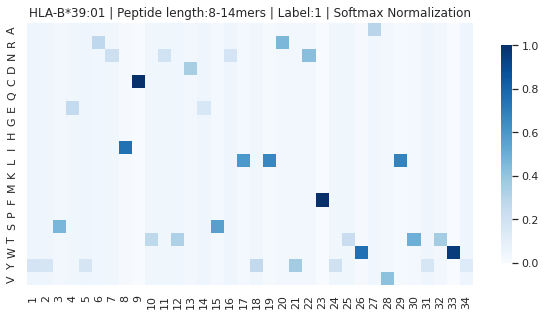

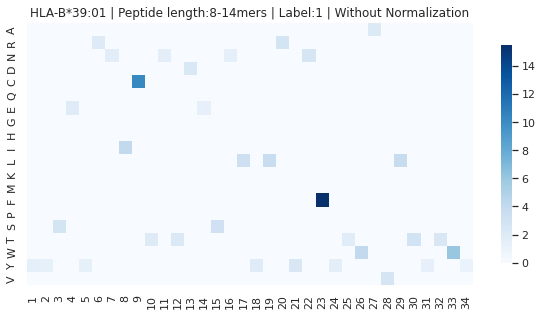


---------------------
#Peptides: 1627
HLA: HLA-B*27:07
Threshold: 0.6
YHTEYREICAKTDEDTLYLSYNYYTWAVLAYEWY

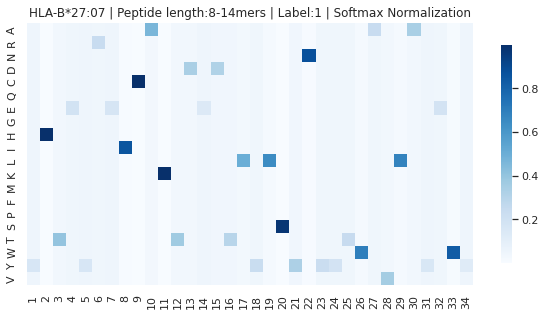

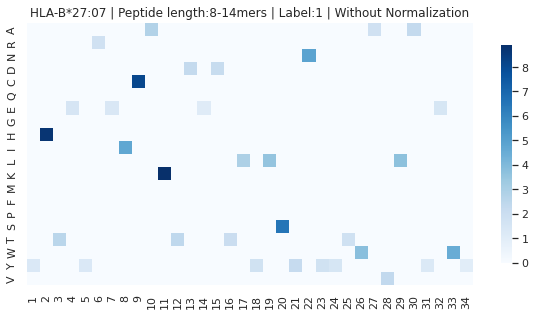


---------------------
#Peptides: 2198
HLA: HLA-A*02:05
Threshold: 0.6
YYAMYGEKVAHTHVDTLYLRYHYYTWAVWAYTWY

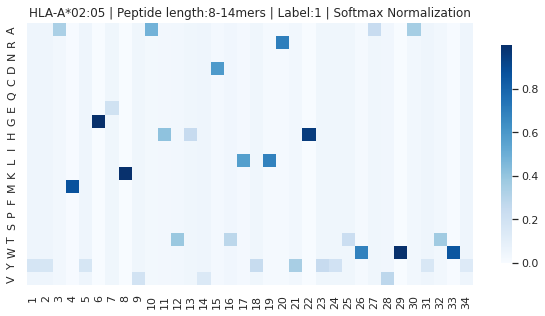

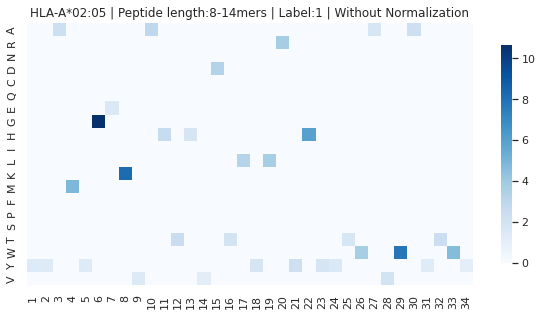


---------------------
#Peptides: 11958
HLA: HLA-B*57:01
Threshold: 0.6
YYAMYGENMASTYENIAYIVYDSYTWAVLAYLWY

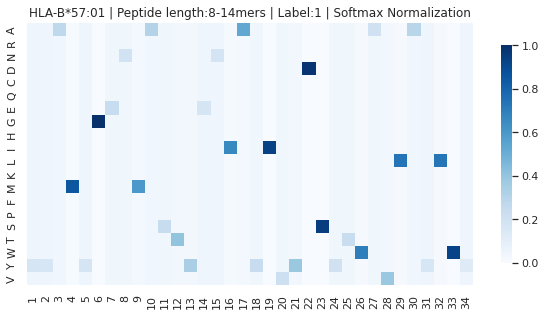

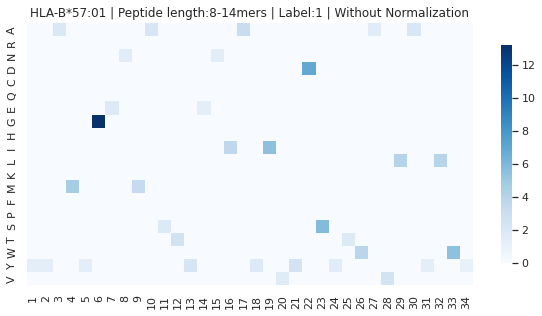


---------------------
#Peptides: 12983
HLA: HLA-B*07:02
Threshold: 0.6
YYSEYRNIYAQTDESNLYLSYDYYTWAERAYEWY

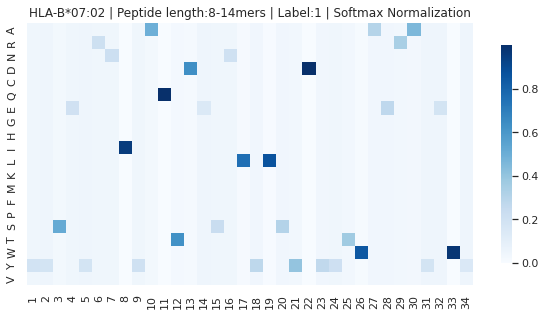

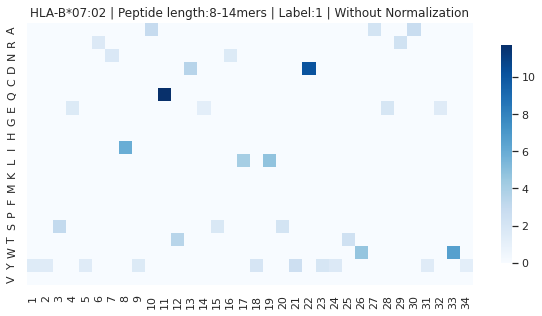


---------------------
#Peptides: 431
HLA: HLA-C*17:01
Threshold: 0.6
YYAGYREKYRQADVNKLYIRYNFYSLAELAYEWY

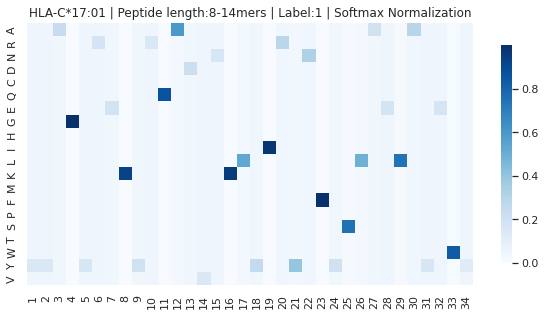

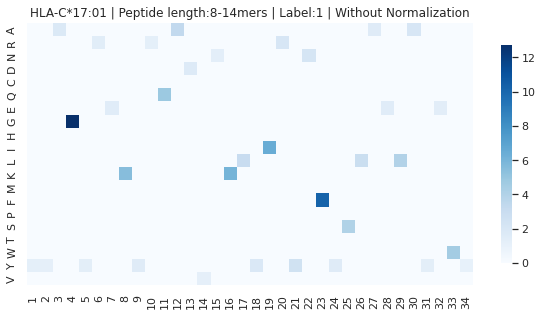


---------------------
#Peptides: 574
HLA: HLA-B*56:01
Threshold: 0.6
YYAEYRNIYAQTDESNLYWTYNLYTWAVLAYLWY

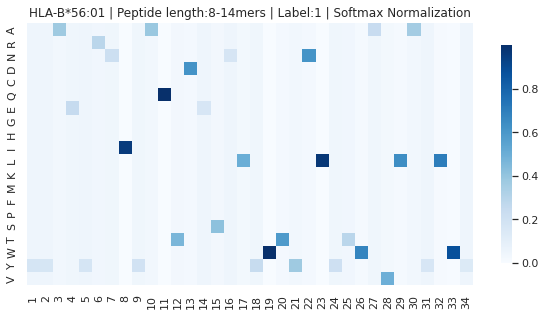

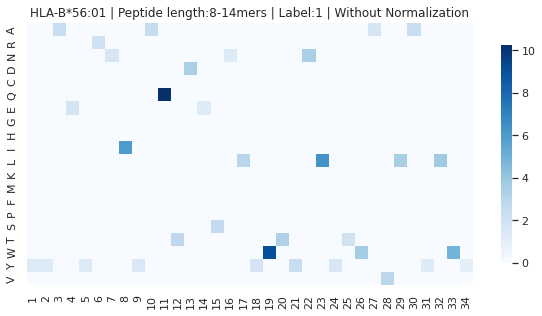


---------------------
#Peptides: 8131
HLA: HLA-A*24:02
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVQAYTGY

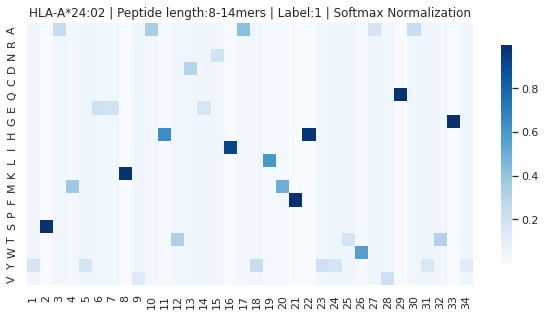

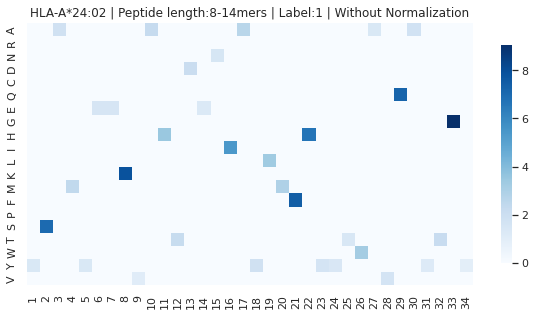


---------------------
#Peptides: 3008
HLA: HLA-A*23:01
Threshold: 0.6
YSAMYEEKVAHTDENIAYLMFHYYTWAVLAYTGY

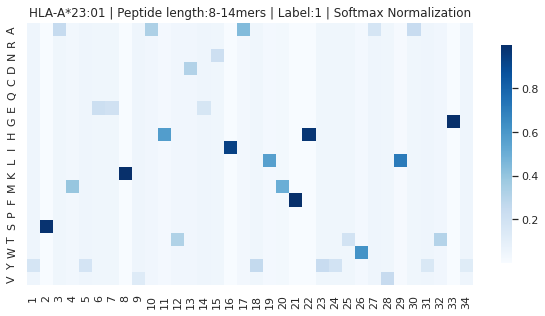

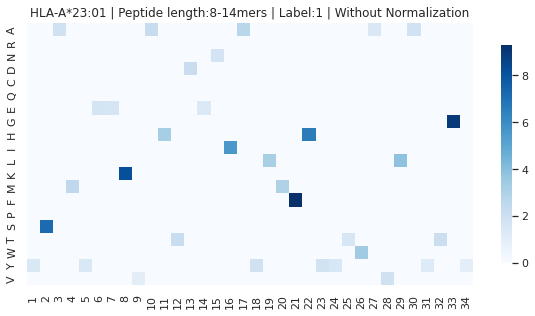


---------------------
#Peptides: 6837
HLA: HLA-A*68:01
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIMYRDYTWAVWAYTWY

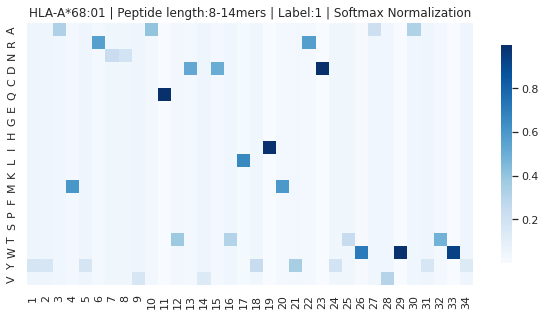

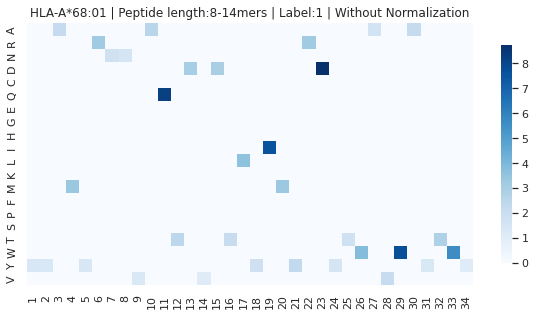


---------------------
#Peptides: 4815
HLA: HLA-C*02:02
Threshold: 0.6
YYAGYREKYRQTDVNKLYLRYDSYTWAEWAYEWY

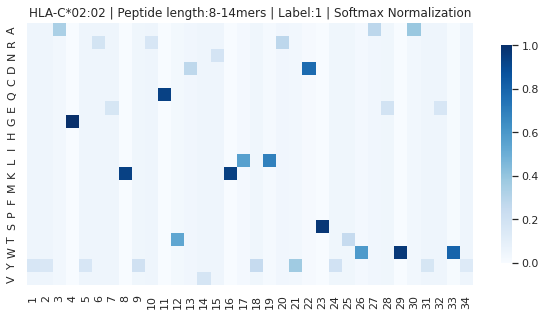

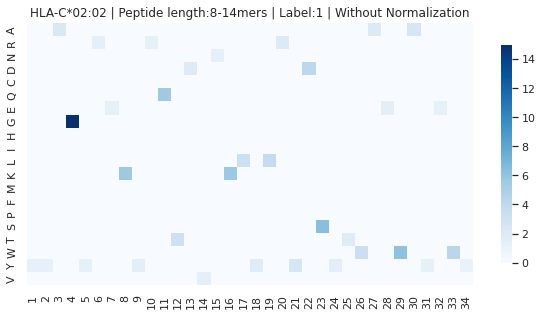


---------------------
#Peptides: 64
HLA: HLA-A*68:23
Threshold: 0.6
YYAMYRNNVAQTDVDTLYIRYRDYTWAVWAYTWY

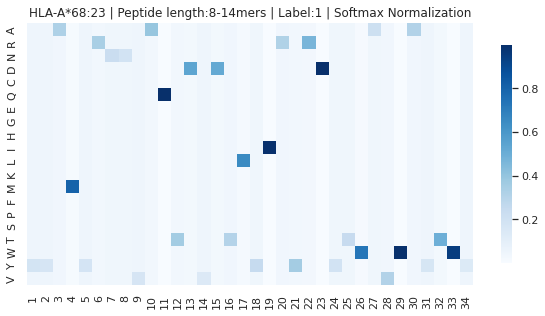

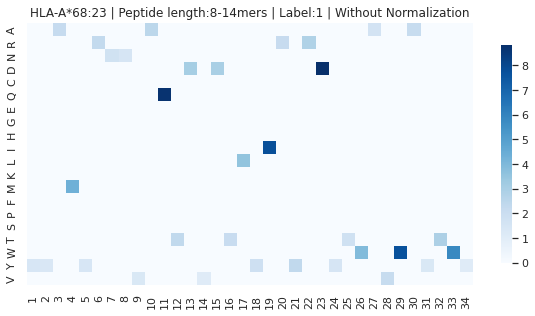


---------------------
#Peptides: 24033
HLA: HLA-A*02:01
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY

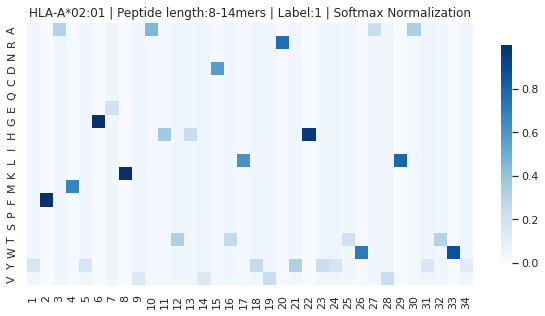

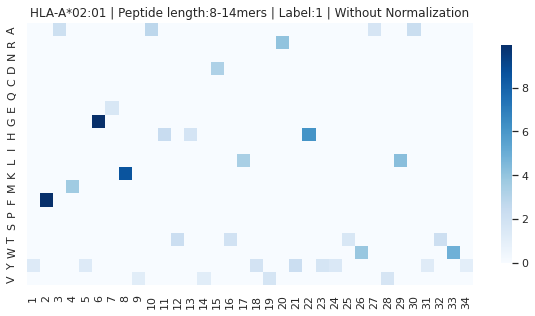


---------------------
#Peptides: 3967
HLA: HLA-B*49:01
Threshold: 0.6
YHTKYREISTNTYENIAYWRYNLYTWAELAYLWY

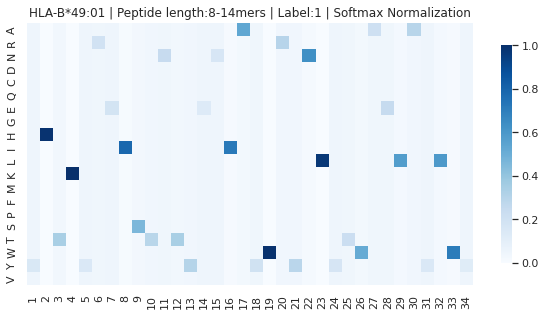

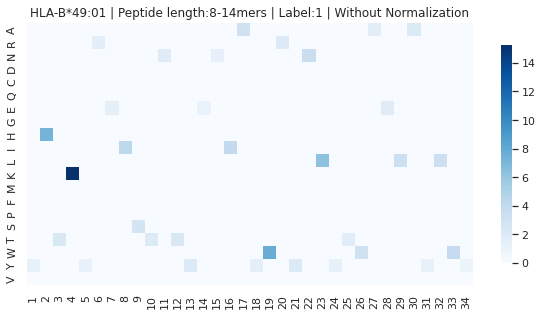


---------------------
#Peptides: 3240
HLA: HLA-B*35:03
Threshold: 0.6
YYATYRNIFTNTYESNLYIRYDFYTWAVLAYLWY

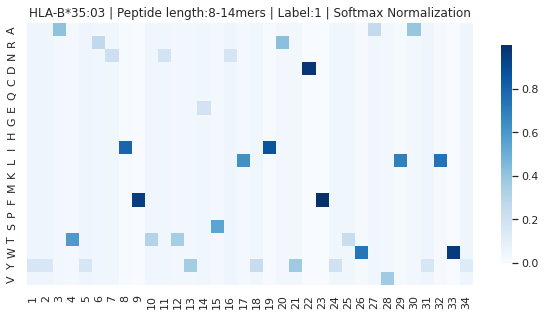

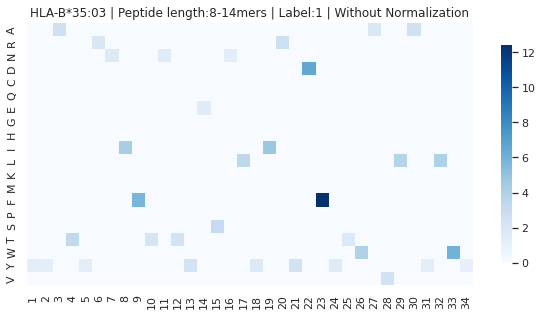


---------------------
#Peptides: 1992
HLA: HLA-B*27:04
Threshold: 0.6
YHTEYREICAKTDESTLYLNYHDYTWAELAYEWY

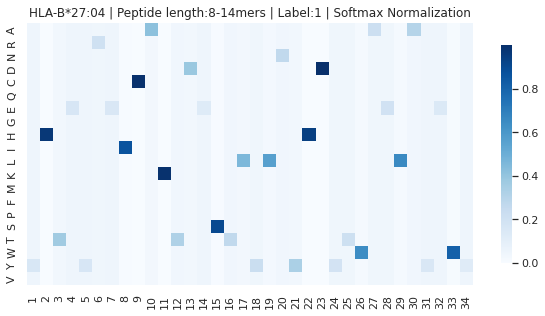

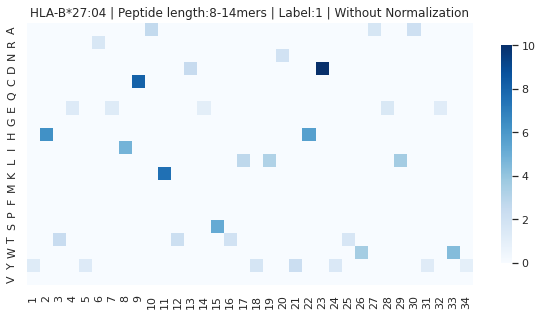


---------------------
#Peptides: 738
HLA: HLA-B*15:11
Threshold: 0.6
YYAMYRNIYTNTYESNLYLRYDSYTWAEWAYLWY

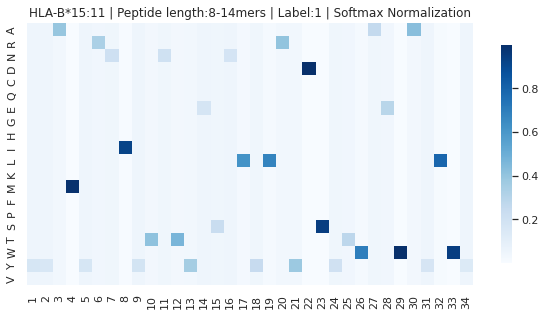

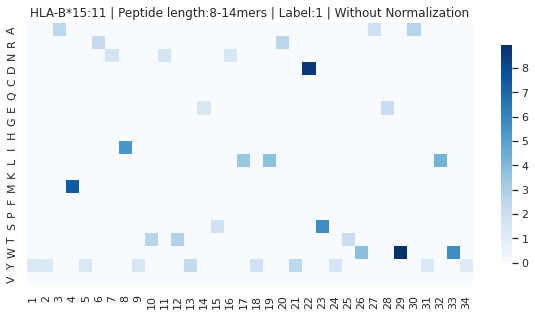


---------------------
#Peptides: 1617
HLA: HLA-C*12:03
Threshold: 0.6
YYAGYREKYRQADVSNLYLWYDSYTWAEWAYTWY

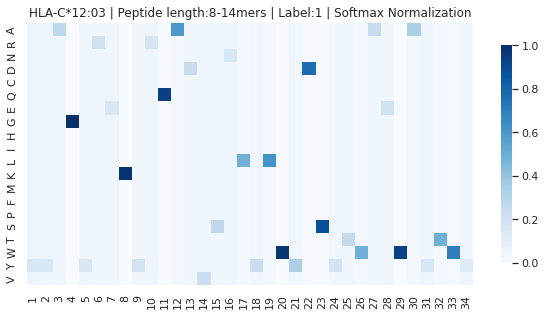

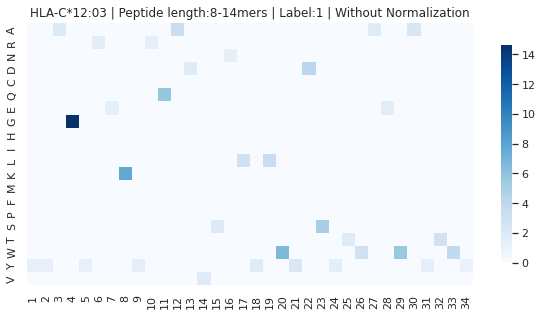


---------------------
#Peptides: 2610
HLA: HLA-A*02:07
Threshold: 0.6
YFAMYGEKVAHTHVDTLYVRCHYYTWAVLAYTWY

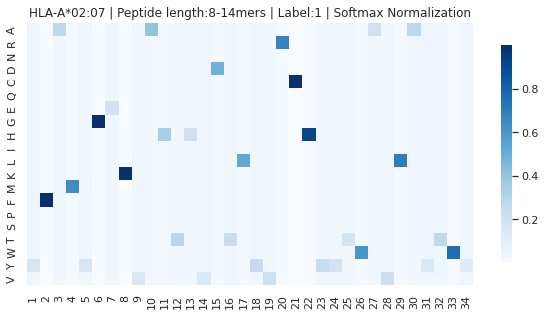

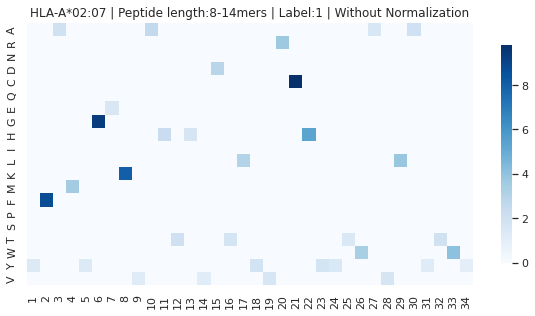


---------------------
#Peptides: 71
HLA: HLA-A*02:50
Threshold: 0.6
YFAMYGEKVAHTHVDTLYIRYHYYTWAVWAYTWY

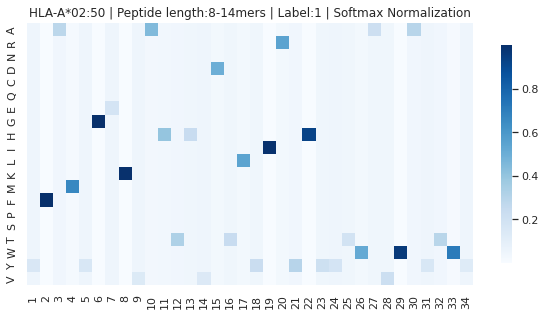

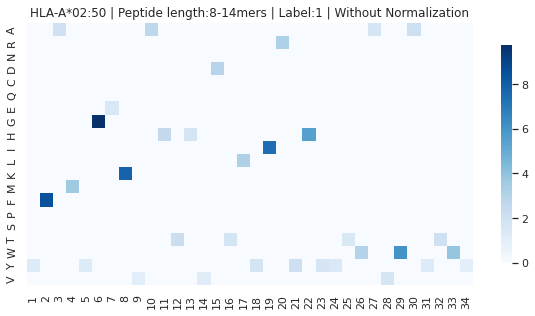


---------------------


In [21]:
for HLA_filter in HLA_list:
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position_HLApseudo(df_pd_nested_test_unique.reset_index(drop=True), enc_hla_attn_list_all, n_heads, HLA_filter, 34, softmax_dim = 0, label = 1 , length = None , threshold = 0.60, show = 'heatmap', top = False, softmax = True, unsoftmax = True)    
    print(color.END + '')
    col_mean_per_HLA[HLA_filter] =  unsoftmax_pd.max(axis=0).tolist()
    col_mean_per_HLA_softmax[HLA_filter] =  softmax_pd.max(axis=0).tolist()
    print("---------------------")
    #REPEAT
    


## AA IMPORTANCE PER POSITION - PEPTIDE

In [25]:
enc_attn_list_all = torch.from_numpy(np.array(enc_attn_list_all))    
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))
print("Done")

Done


In [26]:
df_pd_nested_test_unique.reset_index(drop=True)

,peptide,length,HLA,label,HLA_sequence,target_,pred_
0,HLNRTLAEN,9,HLA-B*15:01,0,YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY,0,0.002293
1,SDADCPTC,8,HLA-C*07:01,0,YDSGYRENYRQADVSNLYLRYDSYTLAALAYTWY,0,0.000062
2,LKRMSVYVILV,11,HLA-B*58:01,0,YYATYGENMASTYENIAYIRYDSYTWAVLAYLWY,0,0.000575
3,MPSVFQNVL,9,HLA-C*04:01,1,YSAGYREKYRQADVNKLYLRFNFYTWAERAYTWY,1,0.969817
4,TPSSREGTL,9,HLA-B*07:02,1,YYSEYRNIYAQTDESNLYLSYDYYTWAERAYEWY,1,0.996851
...,...,...,...,...,...,...,...
1864615,QGDGEDNHM,9,HLA-C*02:02,0,YYAGYREKYRQTDVNKLYLRYDSYTWAEWAYEWY,0,0.005793
1864616,FTSAEDDE,8,HLA-B*15:01,0,YYAMYREISTNTYESNLYLRYDSYTWAEWAYLWY,0,0.010387
1864617,TATTPTATS,9,HLA-B*14:02,0,YYSEYRNICTNTDESNLYLWYNFYTWAELAYTWH,0,0.000144
1864618,RGASGSIFS,9,HLA-C*03:03,0,YYAGYREKYRQTDVSNLYIRYDYYTWAELAYLWY,0,0.000518


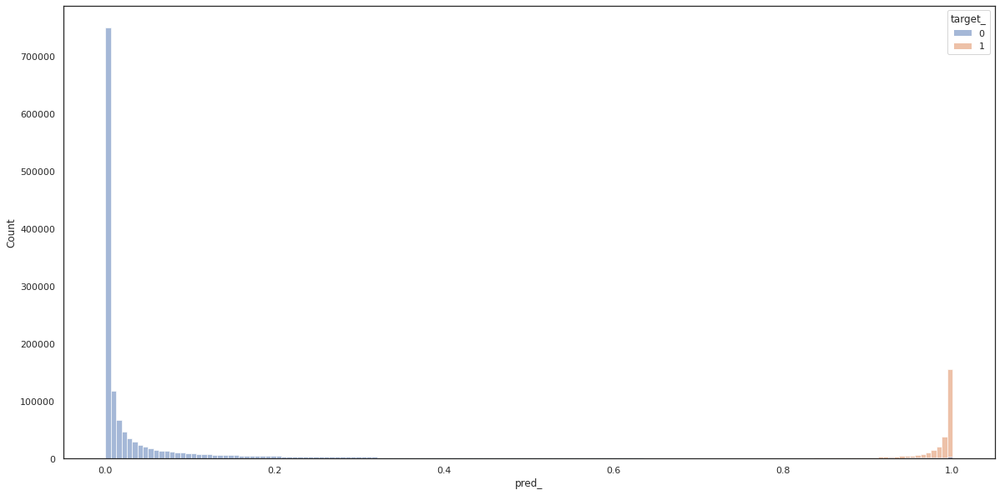

In [29]:
sn.set(rc={'figure.figsize':(20,10)})
sn.set_style("white")

sn.histplot(data=df_pd_nested_test_unique.reset_index(drop=True), x='pred_', hue='target_') #.set(ylim=(0,10000), xlim=(0.0,0.20))

plt.savefig('hist.png')

plt.show()

nn softmax but with /df_size nn.Softmax(dim=-1)(temp_length_head.mean(axis = 0))
#Peptides: 334732
HLA: None
Start
Threshold: 0.04
Pos
SLLELLLLLLLLYYDraw


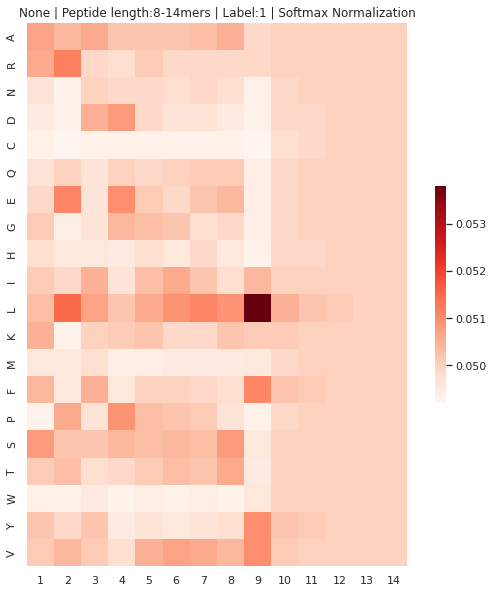

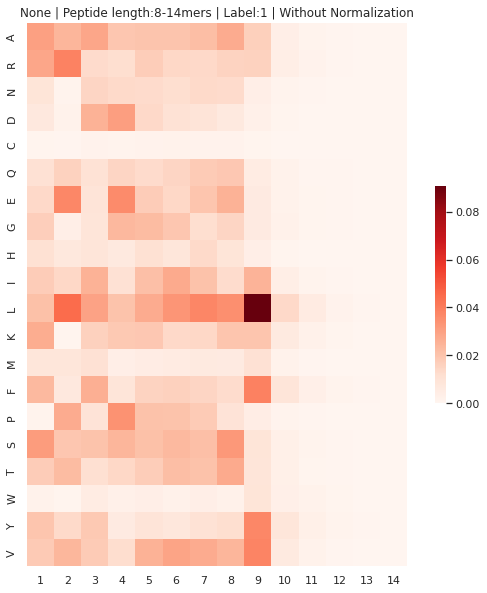

In [37]:
print('nn softmax but with /df_size nn.Softmax(dim=-1)(temp_length_head.mean(axis = 0))')

softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique_correct.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = None , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    
    

#Peptides: 334732
HLA: None
Start
Threshold: 1.18
Pos
SLLELLLLLLLLYWDraw


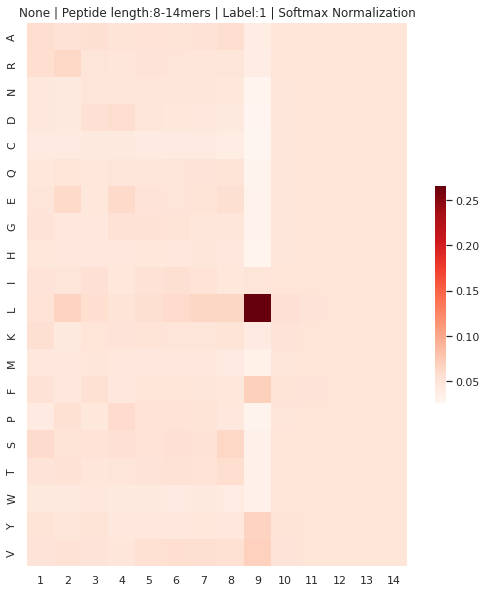

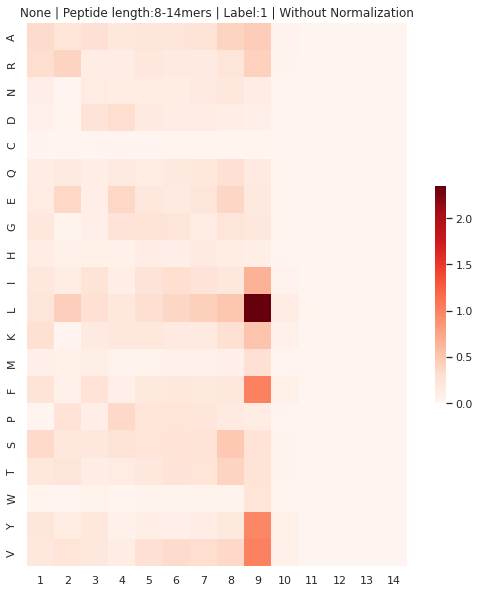

In [50]:

softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique_correct.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = None , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    
    

#Peptides: 1410586
HLA: None
Start
Threshold: 0.43
Pos
LLLLLLLLLLLLLEDraw


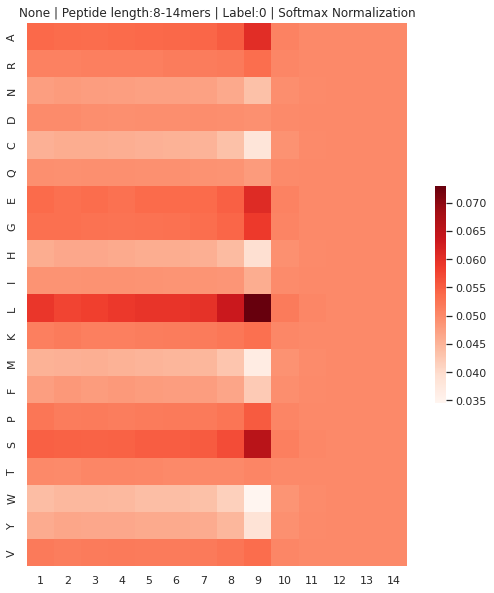

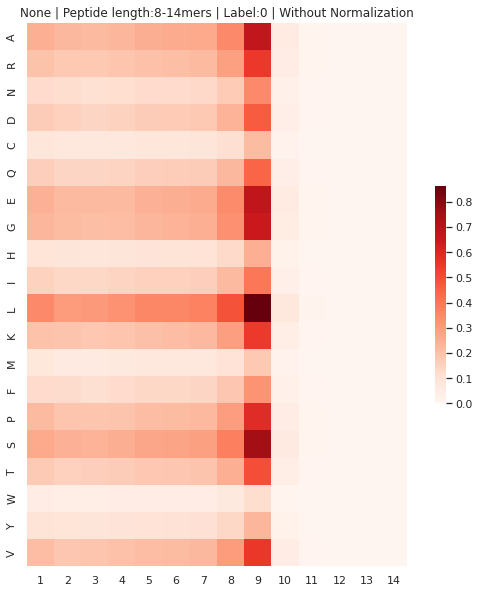

In [44]:

softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique_correct.reset_index(drop=True), enc_attn_list_all, None, 3, label = 0 , length = None , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    
    



--------------------------
8 1
#Peptides: 14952
HLA: None
Start
Threshold: 0.36
Pos
RRRKRRKLDraw


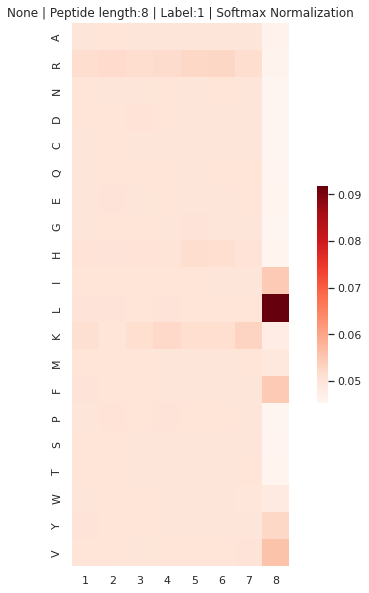

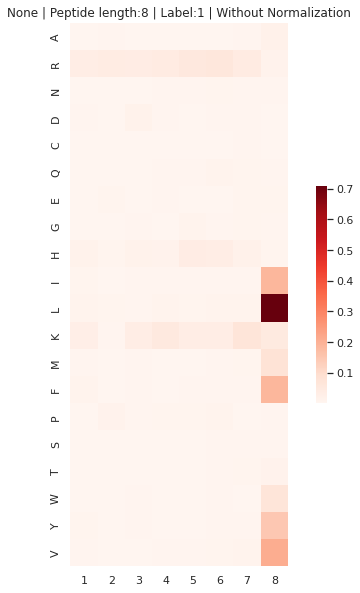

[0.049995, 0.049999999999999996, 0.04999499999999999, 0.050005, 0.05000499999999999, 0.05000499999999999, 0.05000499999999999, 0.049985]
[0.007928632790548652, 0.005705938972592546, 0.008009421111046152, 0.008757709028122578, 0.010076756372752838, 0.011113338626088019, 0.011903514640097824, 0.08650454767825708]


--------------------------
9 1
#Peptides: 240156
HLA: None
Start
Threshold: 0.27
Pos
RRRKRRRKLDraw


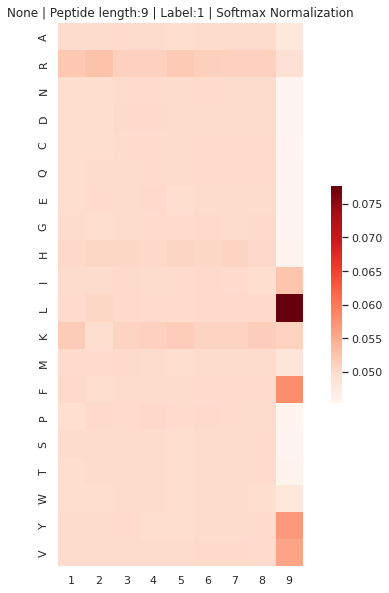

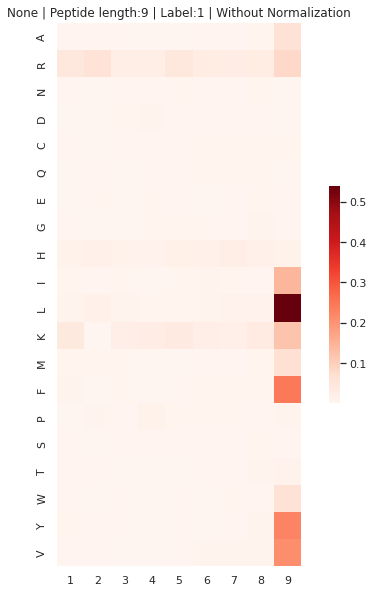

[0.04998999999999999, 0.04998999999999999, 0.05001, 0.05001, 0.049999999999999996, 0.050015, 0.050009999999999985, 0.050005, 0.050005]
[0.008129952515753474, 0.0068470452190364794, 0.006139932034340846, 0.006417785086930636, 0.008329692092046908, 0.007171047526281582, 0.007702984685422412, 0.008842811285213439, 0.09041810998688052]


--------------------------
10 1
#Peptides: 58415
HLA: None
Start
Threshold: 0.18
Pos
RRRKKKKRKLDraw


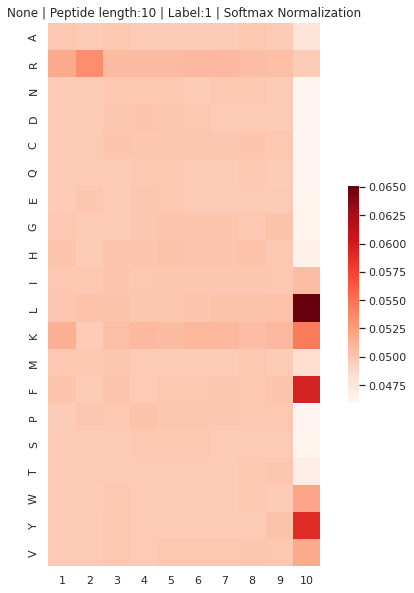

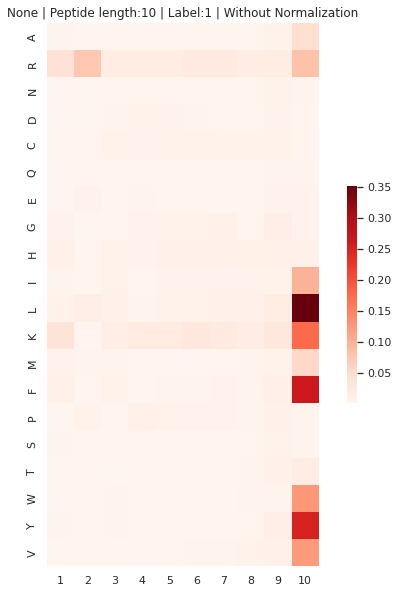

[0.04999999999999999, 0.04999499999999999, 0.05001, 0.05000499999999999, 0.05000499999999999, 0.050009999999999985, 0.05000499999999999, 0.050005, 0.05, 0.049999999999999996]
[0.00824538143960864, 0.007451510265715713, 0.006249633001503671, 0.006273937073511425, 0.006858426758272235, 0.007376451571489927, 0.007248290464464427, 0.00712897912857825, 0.011255651929653393, 0.08191169489963632]


--------------------------
11 1
#Peptides: 26184
HLA: None
Start
Threshold: 0.12
Pos
RRRKKKKKLKLDraw


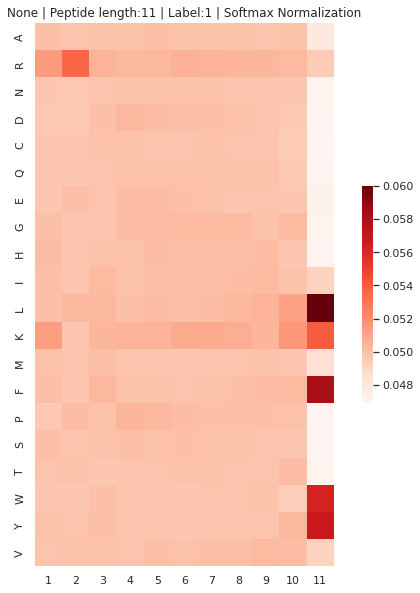

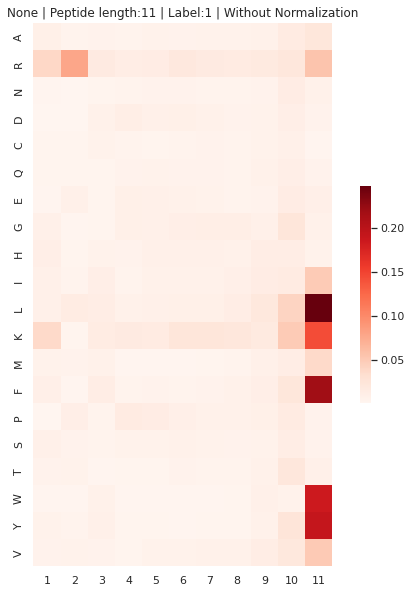

[0.050005, 0.049995, 0.05, 0.04999999999999999, 0.050009999999999985, 0.049995, 0.05001, 0.049995, 0.049995, 0.05001, 0.049995]
[0.008655390872745531, 0.008291433466125476, 0.006927406332596996, 0.006400232857023217, 0.006796605689715729, 0.007414028639462685, 0.007120102252429901, 0.007298886342548357, 0.009591147209794523, 0.018574559065751478, 0.06293021656488593]


--------------------------
12 1
#Peptides: 10798
HLA: None
Start
Threshold: 0.08
Pos
KRFKPKKKGLLWDraw


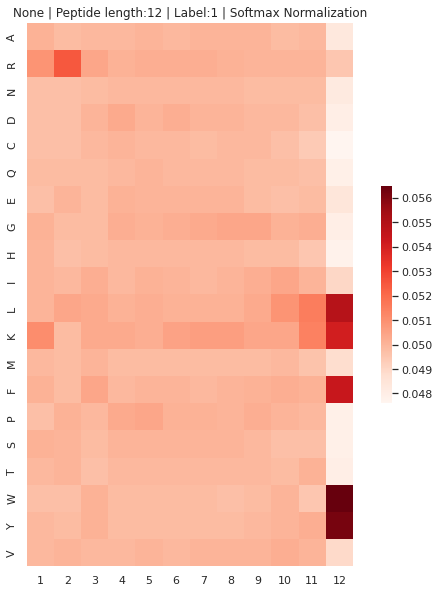

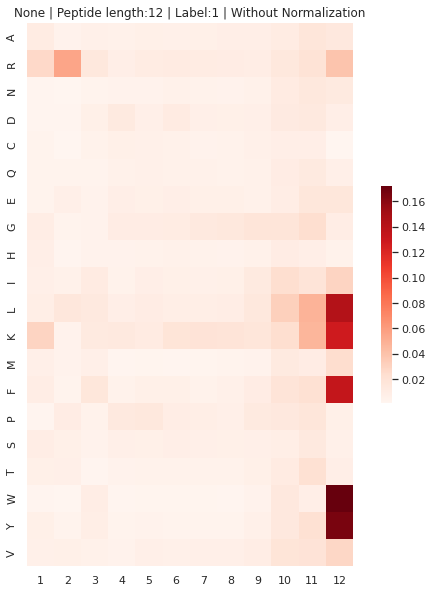

[0.05, 0.05, 0.049995, 0.05, 0.05001, 0.05, 0.049995, 0.05, 0.049995, 0.050005, 0.05, 0.050015]
[0.00833190201520699, 0.007626943054806859, 0.007419043749565325, 0.006800710945178853, 0.007308758989840354, 0.007395252534075343, 0.007101446099801514, 0.007118188268411025, 0.008859555282776477, 0.01489085324452219, 0.019198349657533875, 0.047949009812480986]


--------------------------
13 1
#Peptides: 5547
HLA: None
Start
Threshold: 0.08
Pos
KRFPPKKGGGLKYDraw


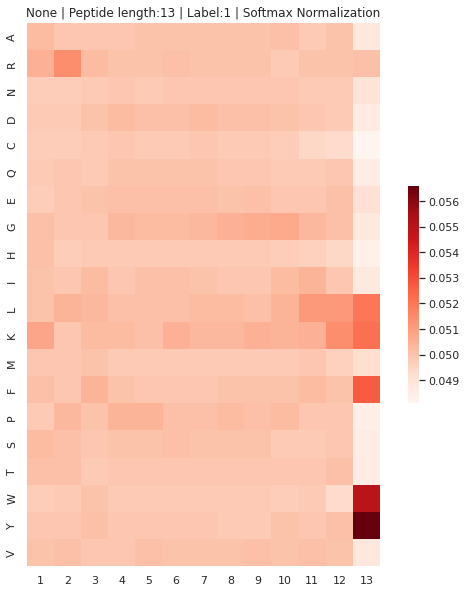

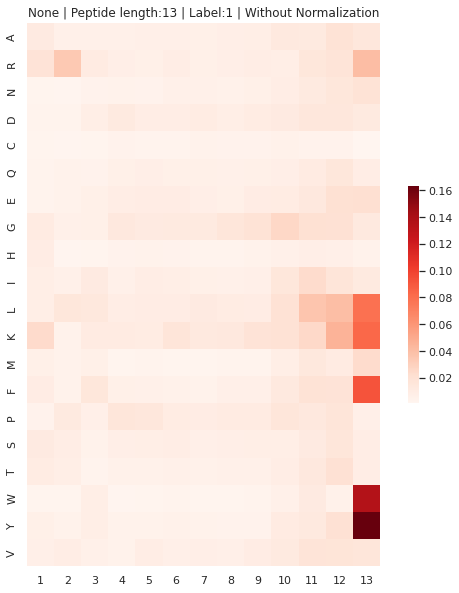

[0.050005, 0.05001, 0.05, 0.05, 0.049995, 0.05001, 0.050005, 0.049995, 0.05001, 0.05, 0.05, 0.04998500000000001, 0.04999]
[0.008168678067064467, 0.007252743645188872, 0.00727950570302674, 0.006976439214857373, 0.007271653879047707, 0.007426535023726577, 0.006890130210657775, 0.00706715691255109, 0.00820744359559877, 0.011710944604675944, 0.015489871106062664, 0.01807385759781734, 0.03818503487791395]


--------------------------
14 1
#Peptides: 3114
HLA: None
Start
Threshold: 0.04
Pos
SRFGPGGGGGGKKYDraw


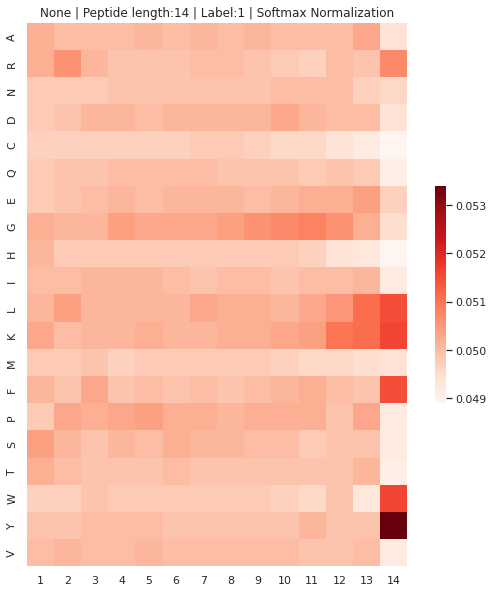

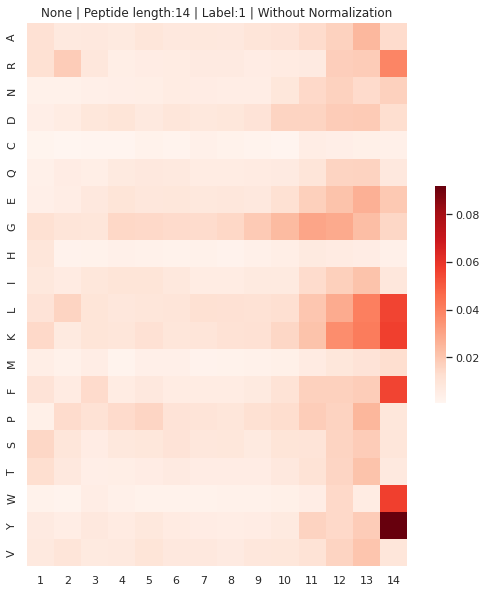

[0.049995, 0.049995, 0.04999500000000001, 0.049995000000000005, 0.050005, 0.04999, 0.050005, 0.049995, 0.05, 0.05, 0.049995, 0.05000000000000001, 0.05, 0.050005]
[0.00789238524574765, 0.007120891993981413, 0.00716547707984596, 0.007058065237720272, 0.007702412594566763, 0.007211301482941144, 0.006850996588619382, 0.006839012624977029, 0.007485295253146054, 0.009442990179925528, 0.013440395703128919, 0.017223359777441986, 0.019484309240572713, 0.02508310359031173]


In [55]:
for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.mean(axis=0)))
    print(list(unsoftmax_pd.mean(axis=0)))    



--------------------------


HLA and Label are filtered.
#Peptides: 5273
HLA: HLA-B*50:01
Threshold: 0.08
RRRRRRKRL

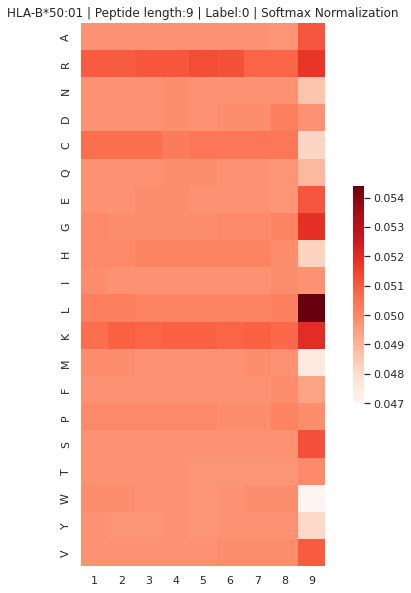

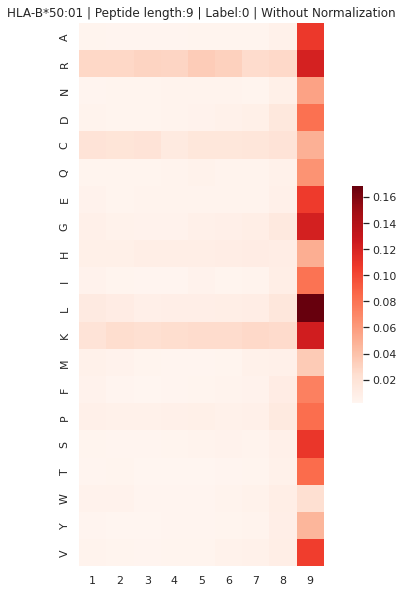



--------------------------


HLA and Label are filtered.
#Peptides: 6048
HLA: HLA-C*15:02
Threshold: 0.09
RRRRRRRRL

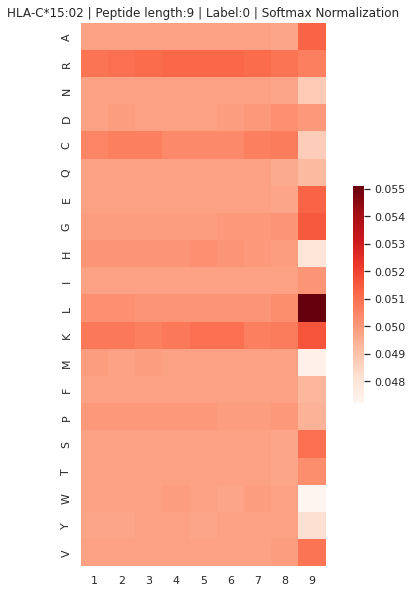

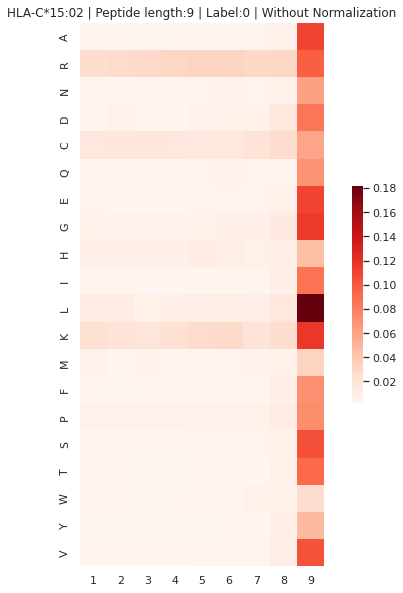



--------------------------


HLA and Label are filtered.
#Peptides: 22650
HLA: HLA-A*11:01
Threshold: 0.08
RRRRRRRRL

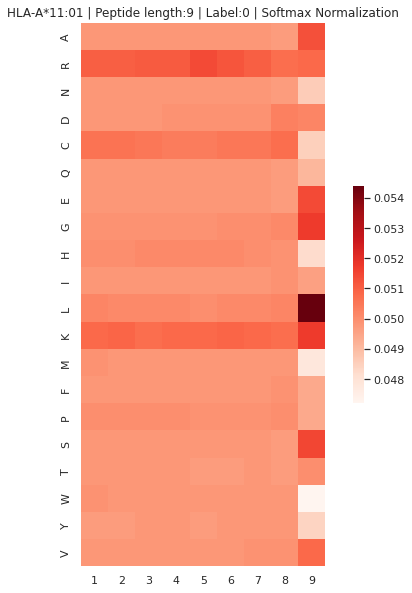

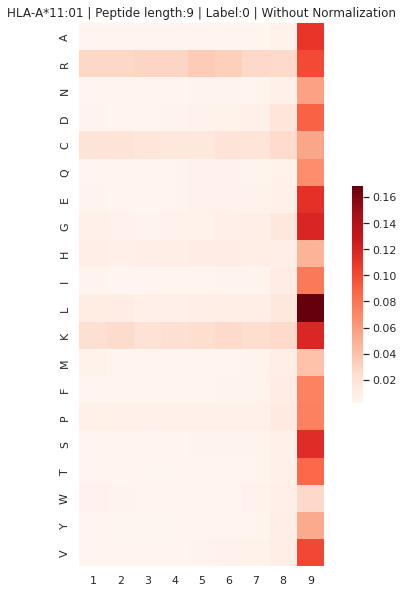



--------------------------


HLA and Label are filtered.
#Peptides: 1630
HLA: HLA-B*39:24
Threshold: 0.1
RRRRRRRCL

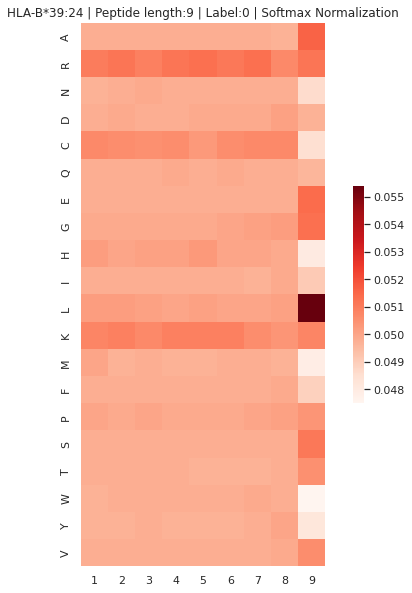

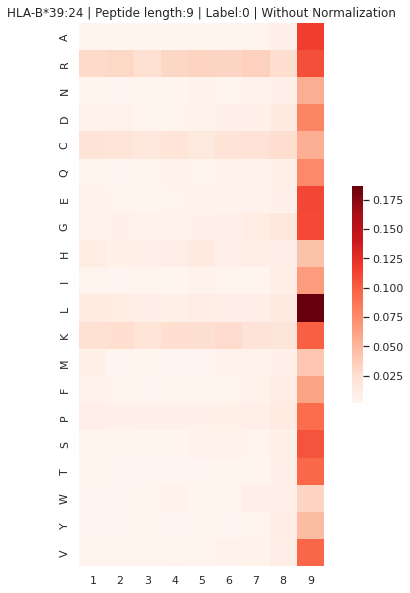



--------------------------


HLA and Label are filtered.
#Peptides: 3100
HLA: HLA-B*15:11
Threshold: 0.09
RRRRRRKKL

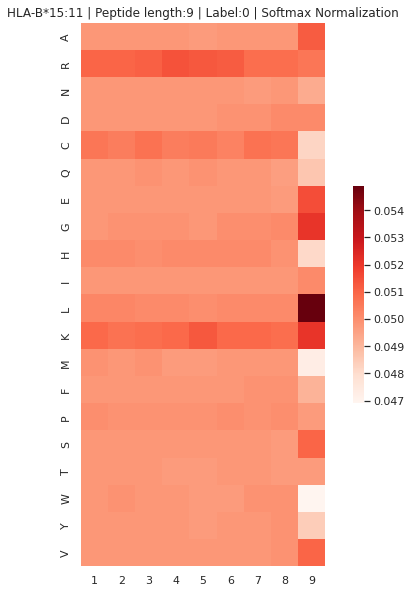

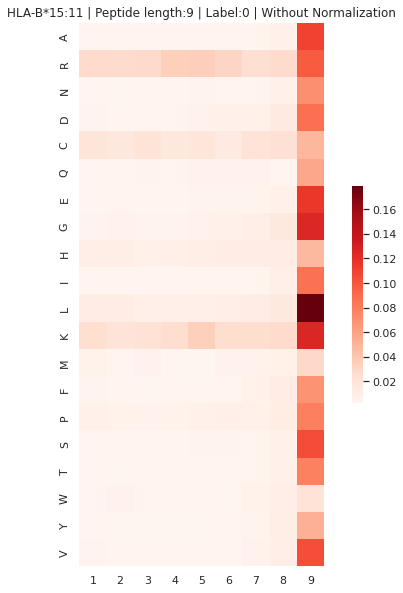



--------------------------


HLA and Label are filtered.
#Peptides: 10425
HLA: HLA-C*07:02
Threshold: 0.09
RRRRRRRRL

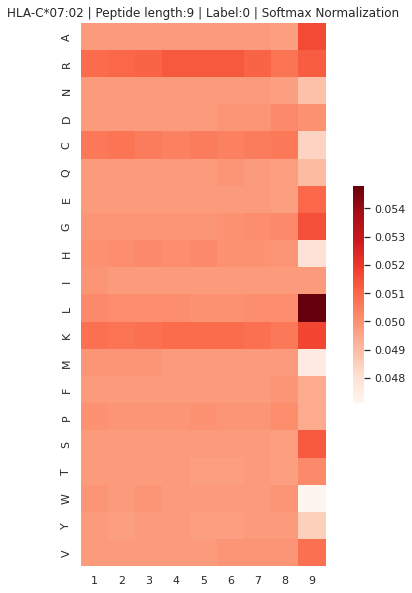

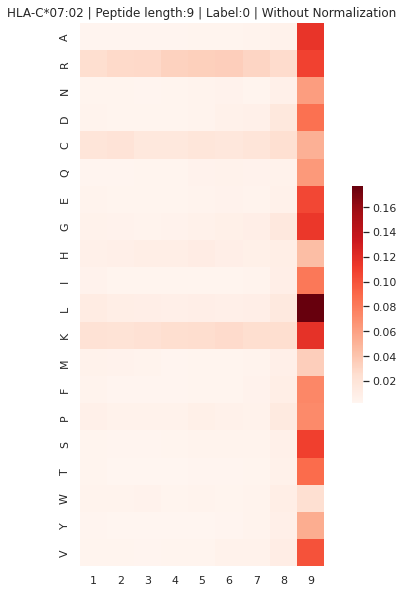



--------------------------


HLA and Label are filtered.
#Peptides: 6972
HLA: HLA-B*18:01
Threshold: 0.09
RRRRRRRRL

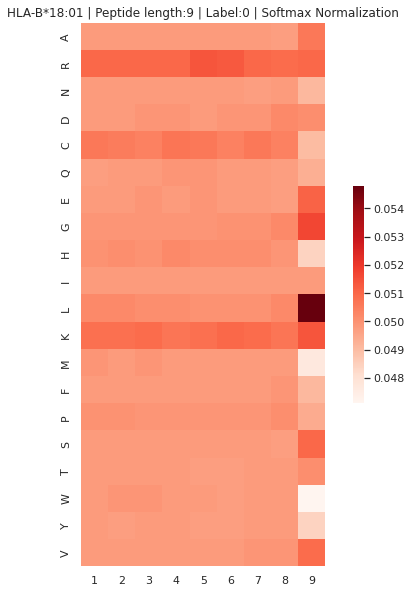

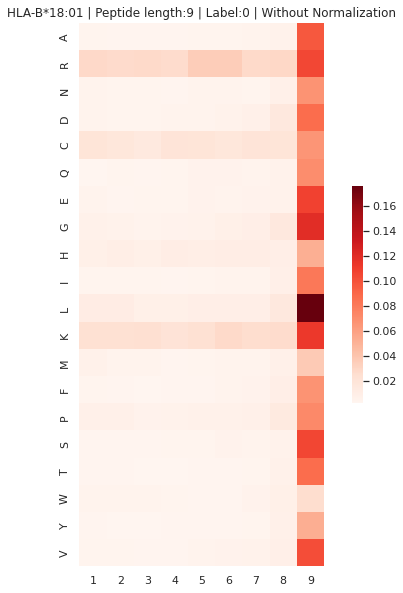



--------------------------


HLA and Label are filtered.
#Peptides: 12349
HLA: HLA-B*49:01
Threshold: 0.09
RRRRRRRRL

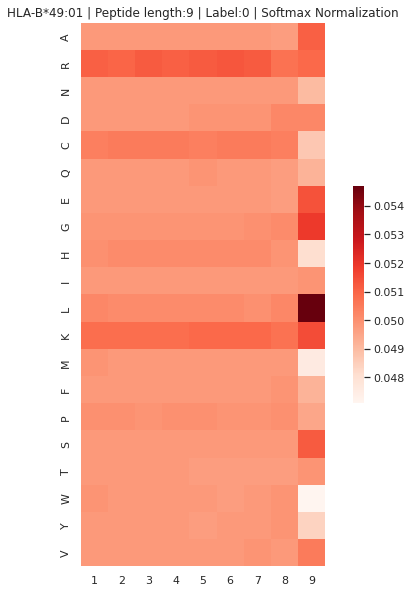

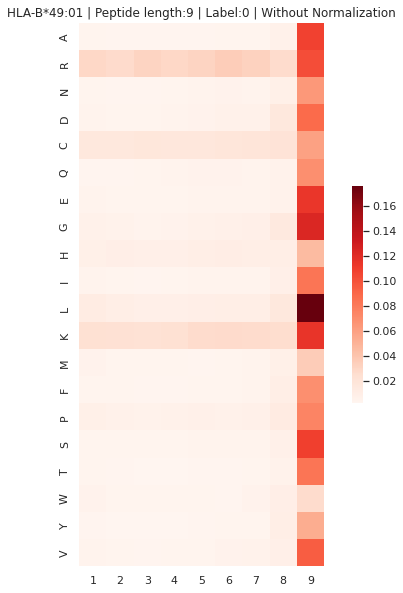



--------------------------


HLA and Label are filtered.
#Peptides: 3149
HLA: HLA-B*27:08
Threshold: 0.08
RRRRRRRKL

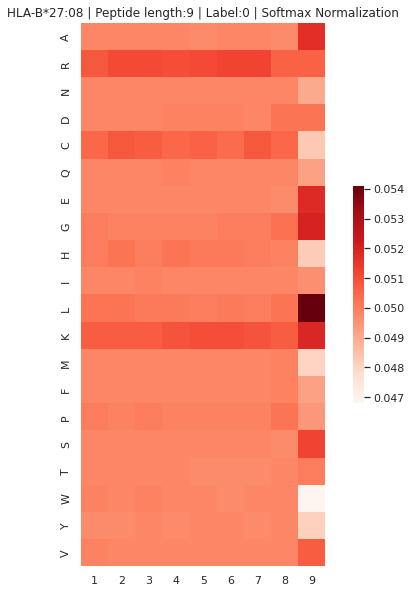

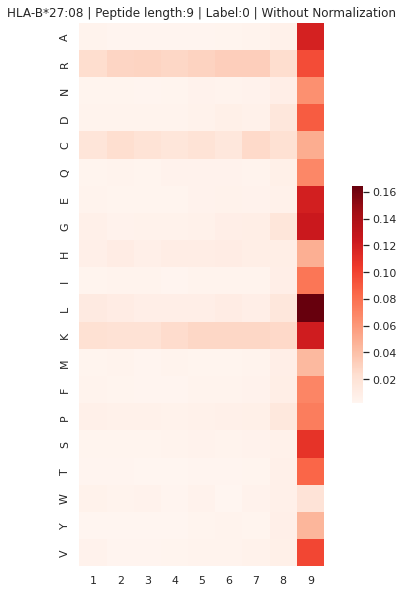



--------------------------


HLA and Label are filtered.
#Peptides: 27124
HLA: HLA-C*04:01
Threshold: 0.09
RRRRRRRKL

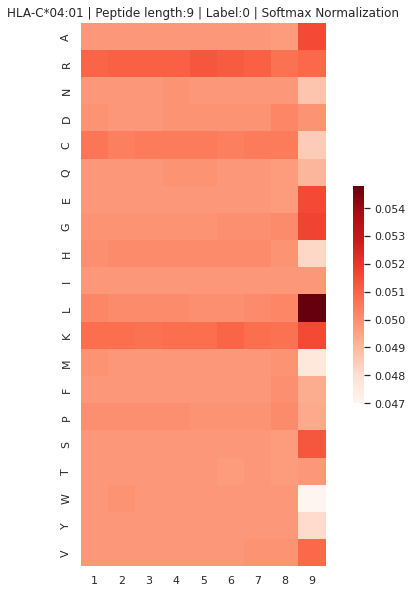

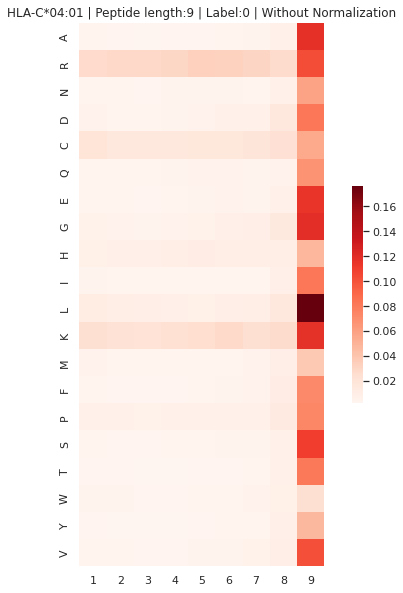



--------------------------


HLA and Label are filtered.
#Peptides: 17306
HLA: HLA-C*02:02
Threshold: 0.08
RRRRRRRRL

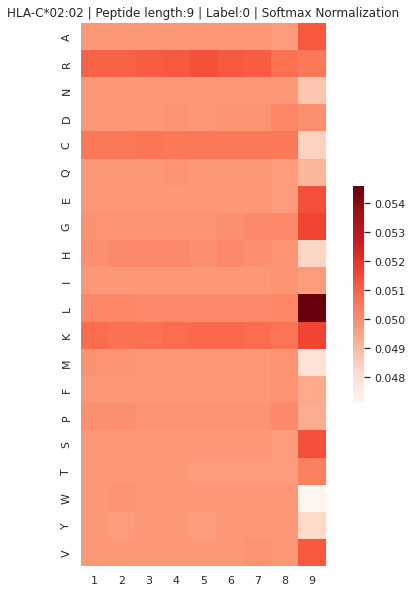

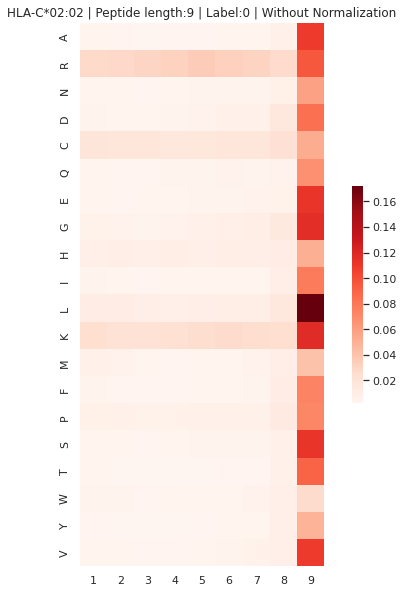



--------------------------


HLA and Label are filtered.
#Peptides: 10207
HLA: HLA-A*23:01
Threshold: 0.08
RRRRRRRRL

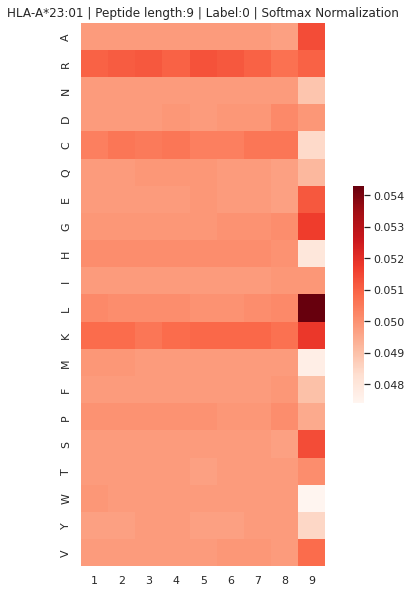

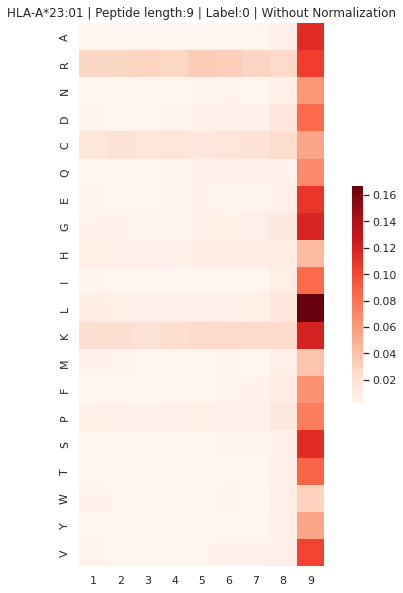



--------------------------


HLA and Label are filtered.
#Peptides: 3694
HLA: HLA-B*27:07
Threshold: 0.08
RRRRRRKRL

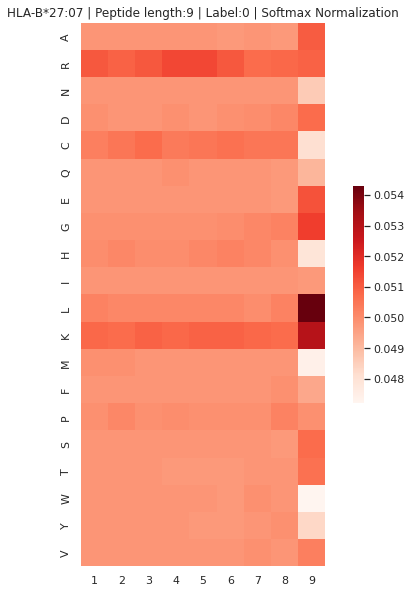

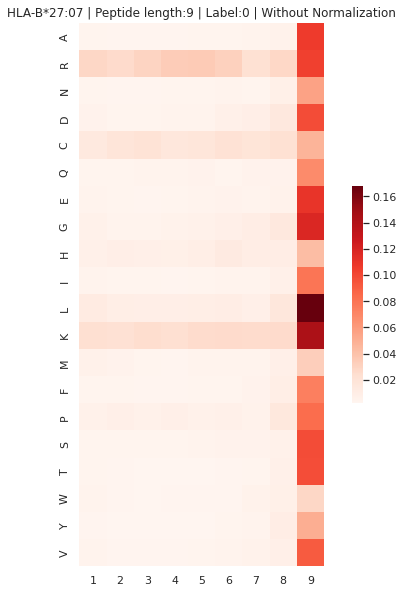



--------------------------


HLA and Label are filtered.
#Peptides: 9141
HLA: HLA-C*07:04
Threshold: 0.08
RRRRRRRKL

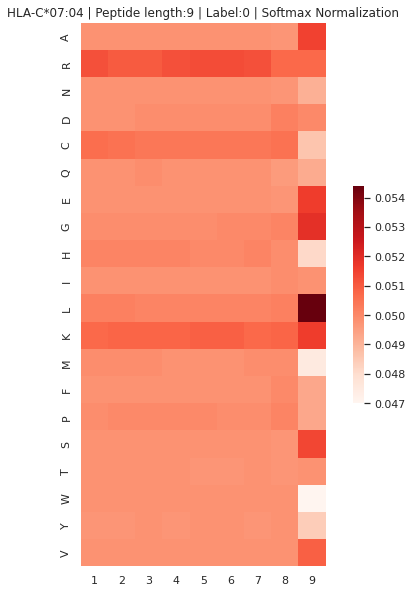

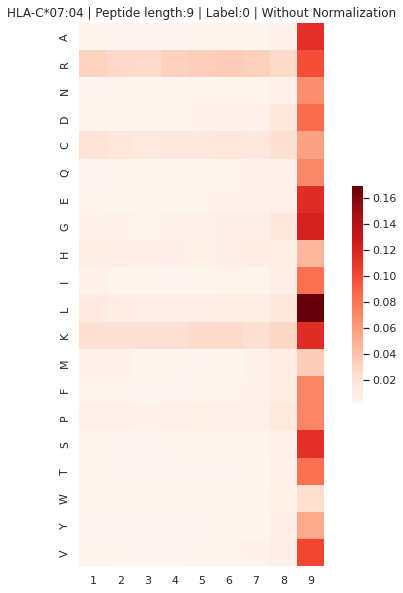



--------------------------


HLA and Label are filtered.
#Peptides: 538
HLA: HLA-B*18:03
Threshold: 0.08
RRRKRKRKL

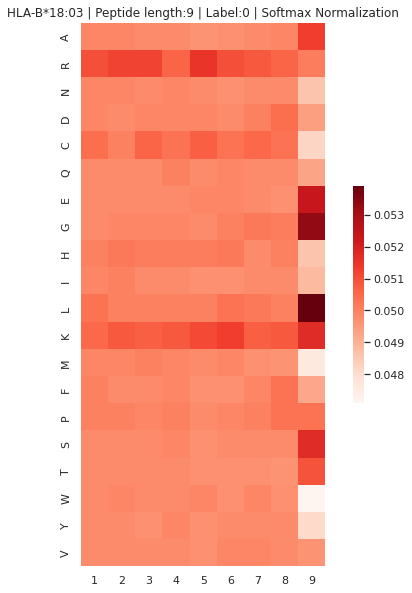

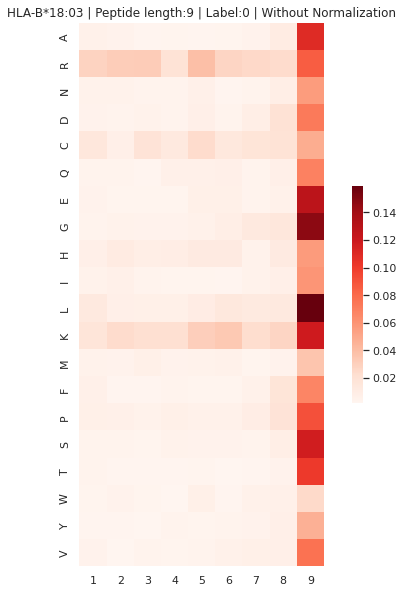



--------------------------


HLA and Label are filtered.
#Peptides: 4391
HLA: HLA-C*01:02
Threshold: 0.1
RRRRRRRRL

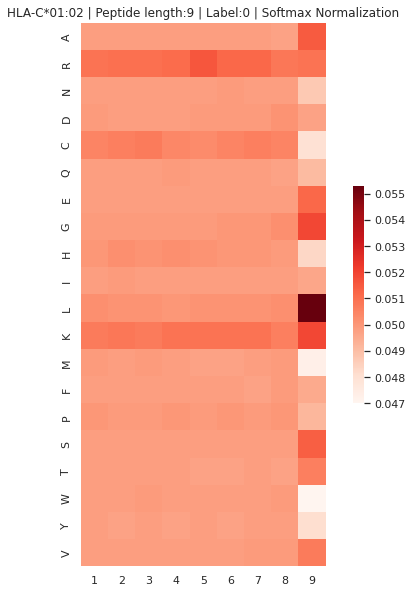

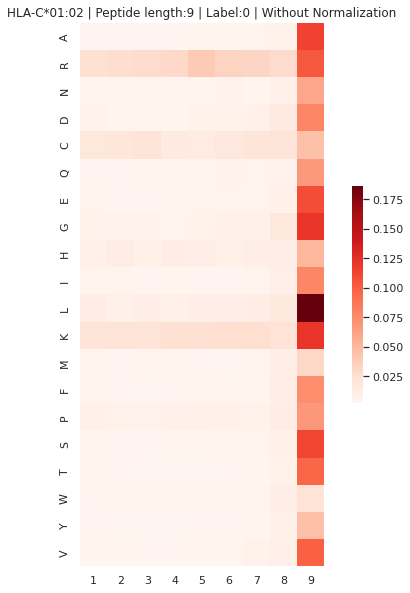



--------------------------


HLA and Label are filtered.
#Peptides: 12029
HLA: HLA-B*40:01
Threshold: 0.08
RRRRRRRRL

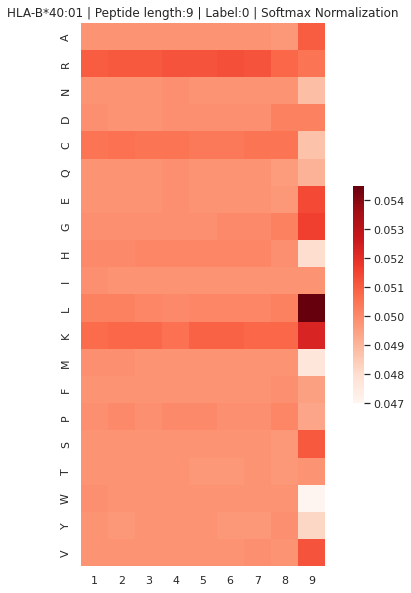

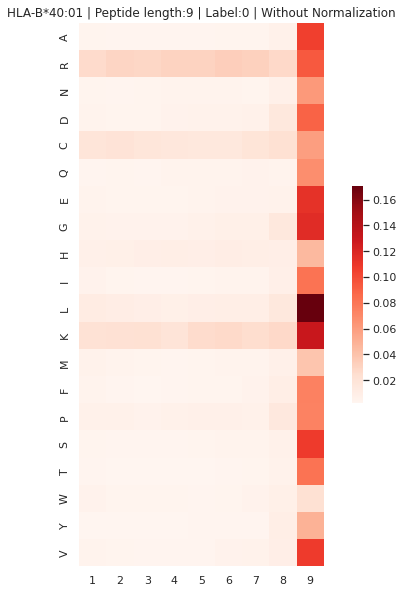



--------------------------


HLA and Label are filtered.
#Peptides: 1378
HLA: HLA-A*02:11
Threshold: 0.08
RRRRRKRKL

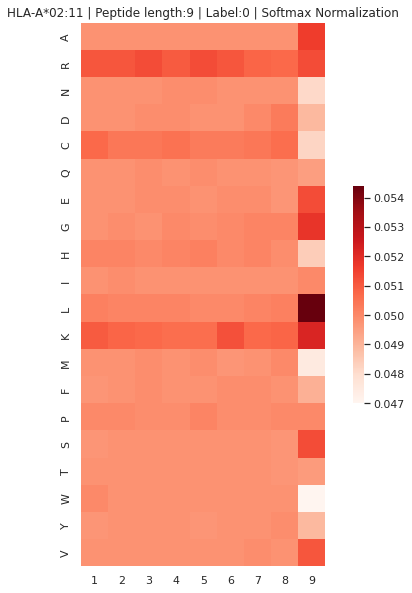

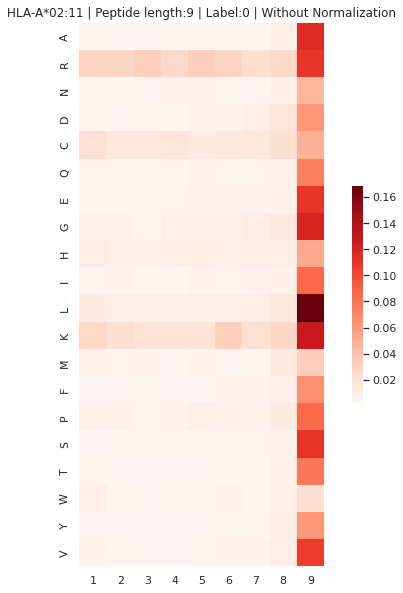



--------------------------


HLA and Label are filtered.
#Peptides: 19792
HLA: HLA-B*57:01
Threshold: 0.09
RRRRRRRKL

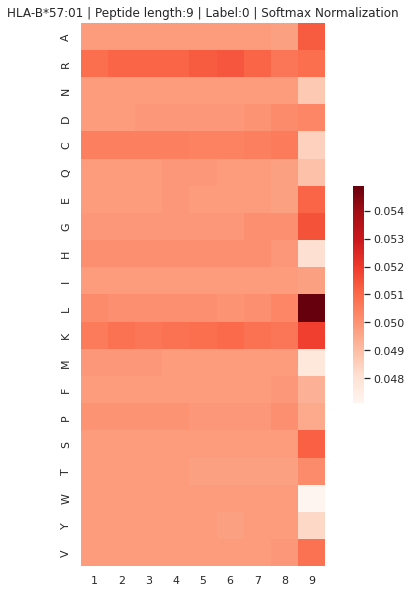

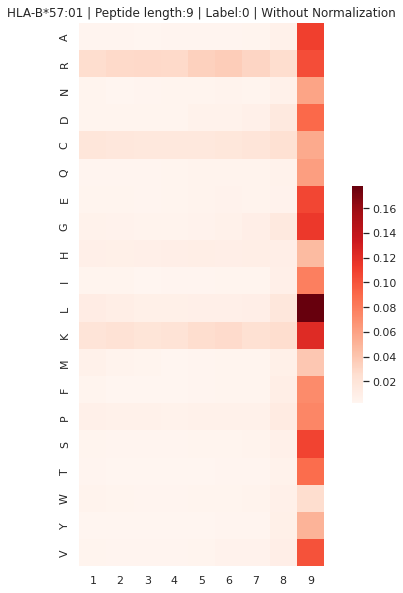



--------------------------


HLA and Label are filtered.
#Peptides: 1546
HLA: HLA-B*56:01
Threshold: 0.08
RRRRRRRKL

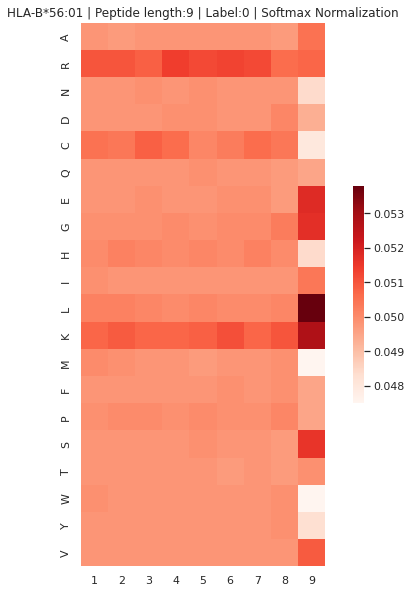

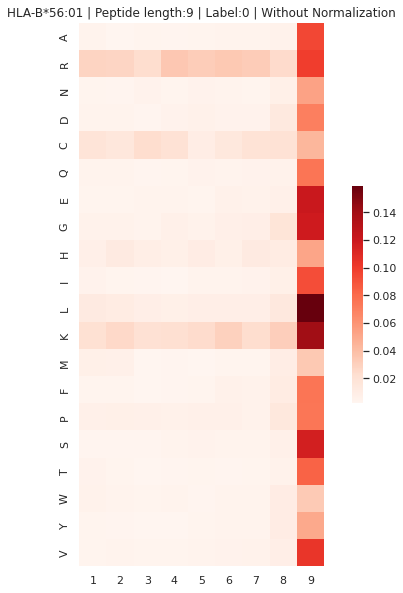



--------------------------


HLA and Label are filtered.
#Peptides: 1714
HLA: HLA-B*73:01
Threshold: 0.09
RRRKRKRKL

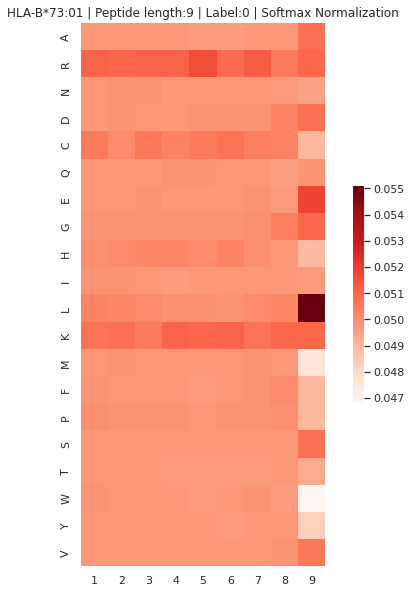

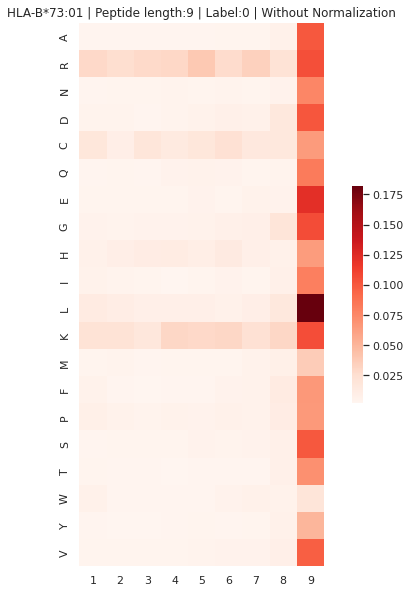



--------------------------


HLA and Label are filtered.
#Peptides: 10945
HLA: HLA-C*16:01
Threshold: 0.08
RRRRRRRKL

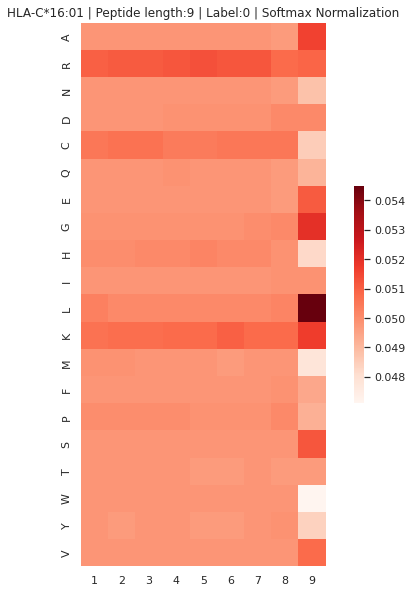

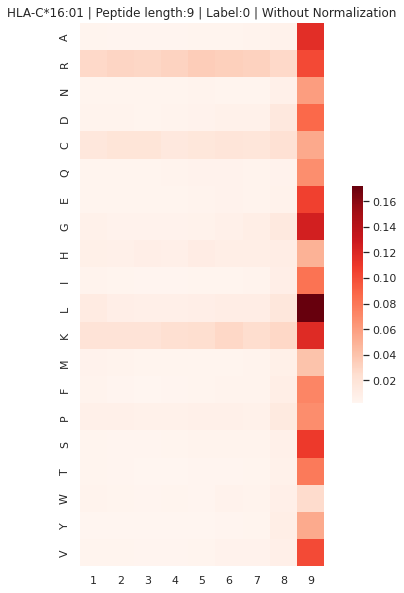



--------------------------


HLA and Label are filtered.
#Peptides: 65351
HLA: HLA-A*02:01
Threshold: 0.09
RRRRRRRKL

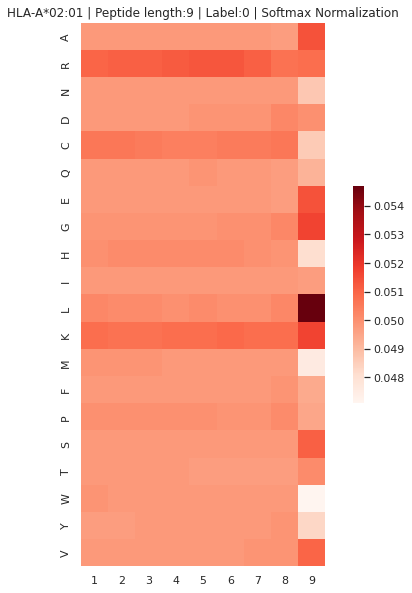

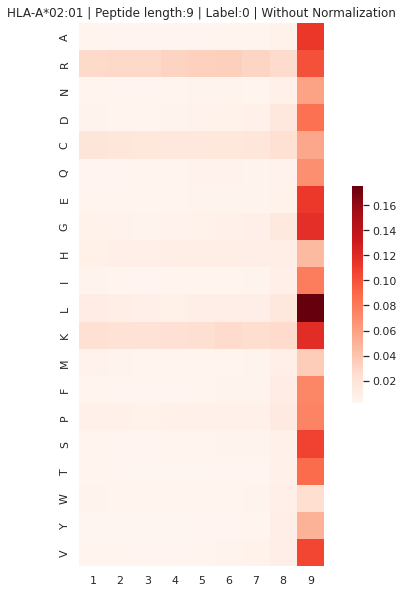



--------------------------


HLA and Label are filtered.
#Peptides: 1764
HLA: HLA-B*53:01
Threshold: 0.09
RRRRRKRRL

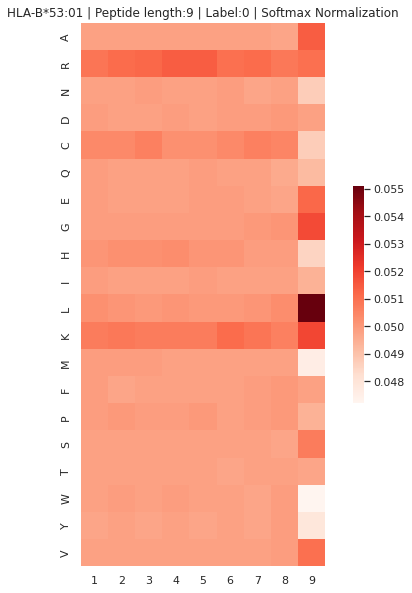

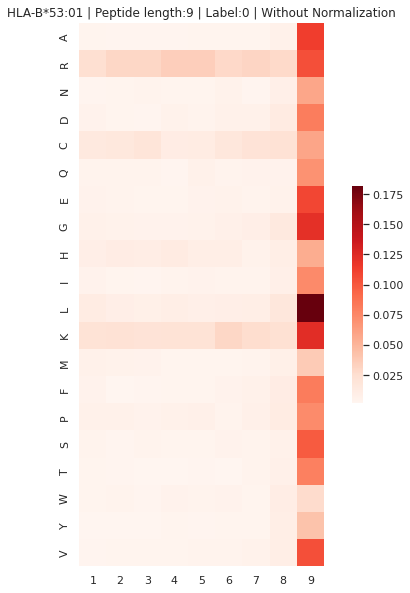



--------------------------


HLA and Label are filtered.
#Peptides: 10121
HLA: HLA-B*13:02
Threshold: 0.08
RRRRRRRRL

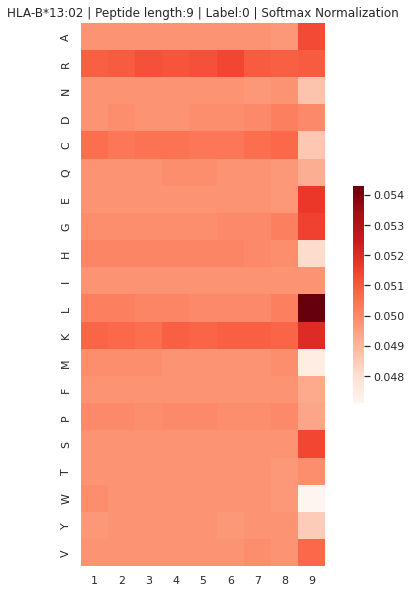

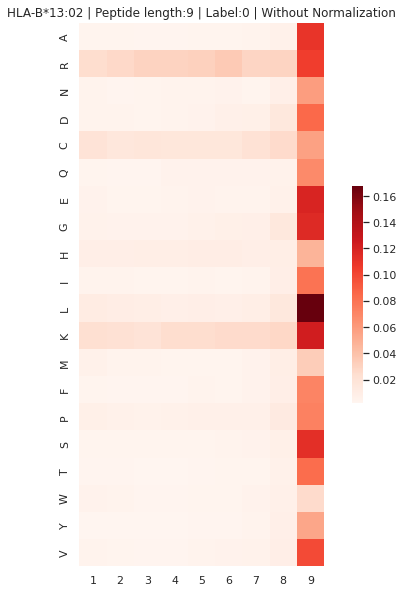



--------------------------


HLA and Label are filtered.
#Peptides: 395
HLA: HLA-B*48:01
Threshold: 0.08
RRRRRRRRL

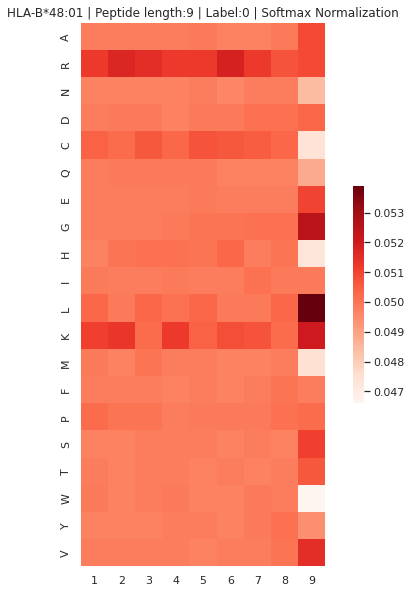

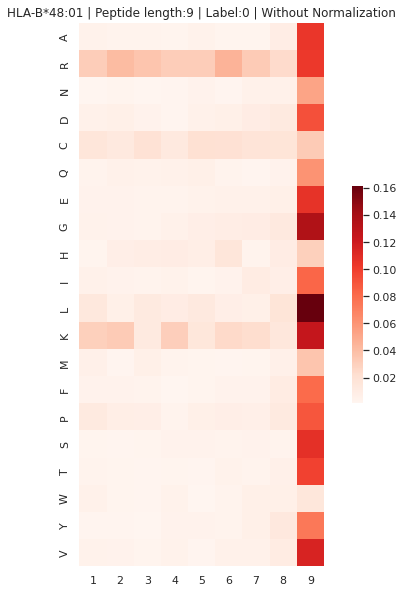



--------------------------


HLA and Label are filtered.
#Peptides: 17686
HLA: HLA-B*08:01
Threshold: 0.08
RRRRRRRRL

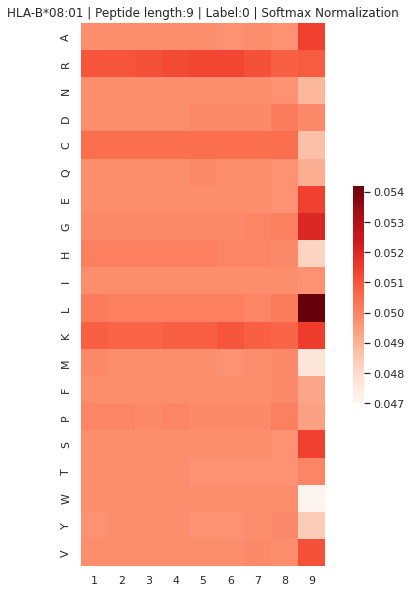

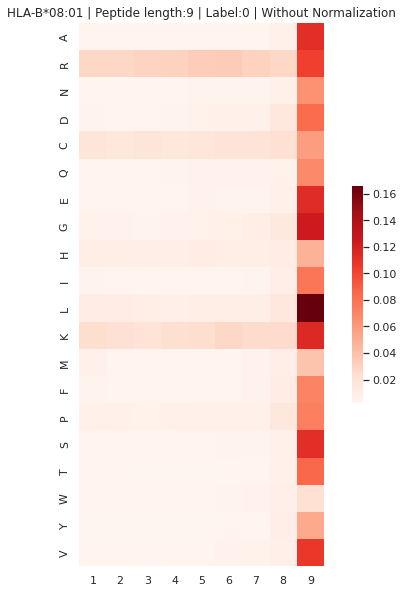



--------------------------


HLA and Label are filtered.
#Peptides: 449
HLA: HLA-B*52:01
Threshold: 0.08
RKRRRRRKL

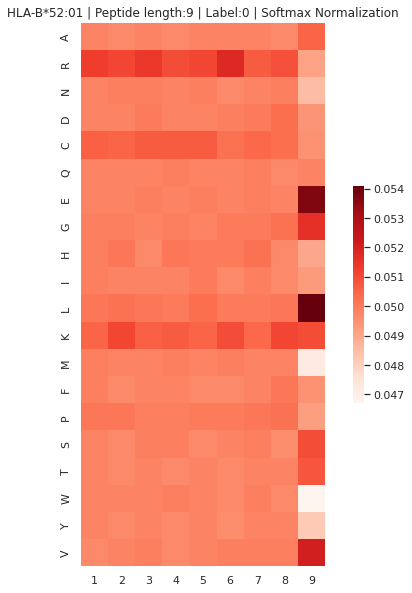

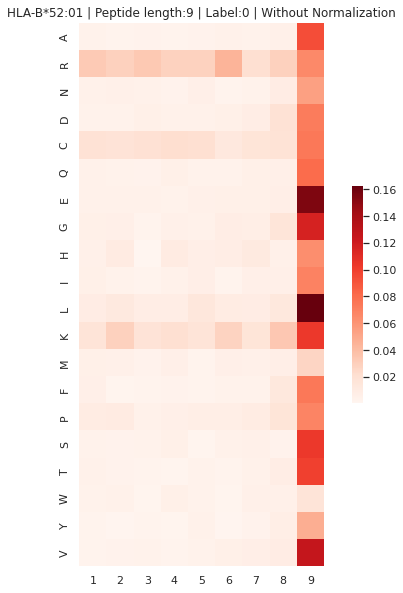



--------------------------


HLA and Label are filtered.
#Peptides: 14810
HLA: HLA-B*39:01
Threshold: 0.08
RRRRRRRRL

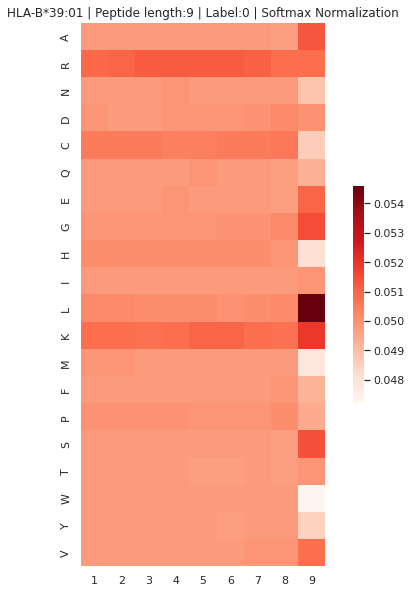

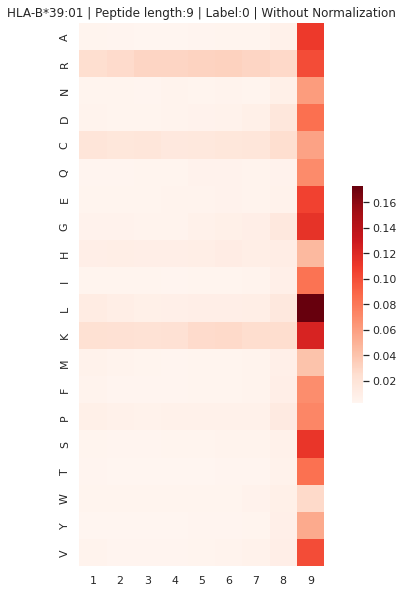



--------------------------


HLA and Label are filtered.
#Peptides: 3613
HLA: HLA-B*15:18
Threshold: 0.09
RRRRRRRCL

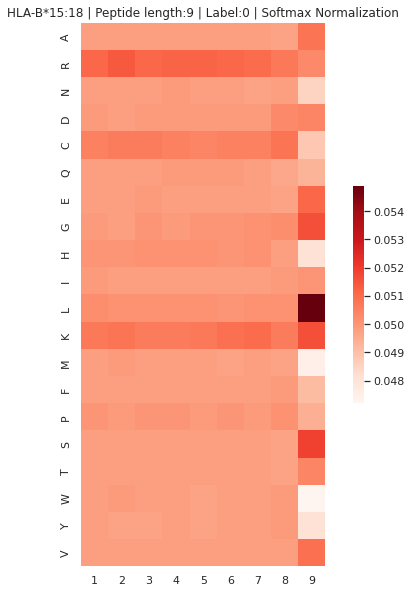

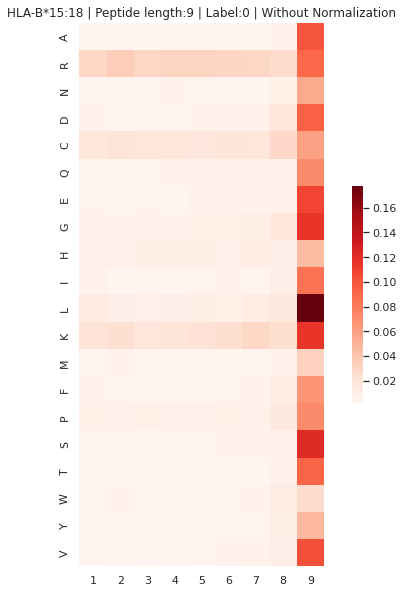



--------------------------


HLA and Label are filtered.
#Peptides: 5006
HLA: HLA-B*46:01
Threshold: 0.08
RRRRRRRKL

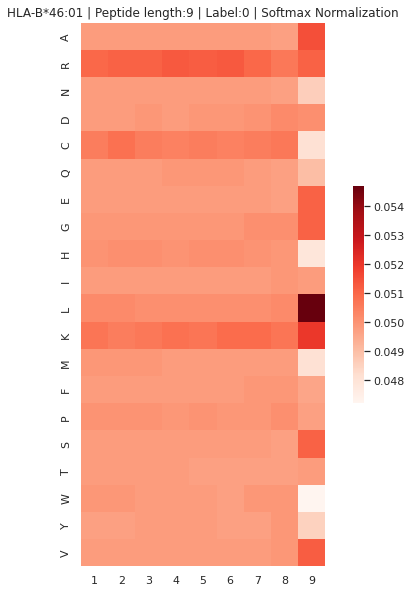

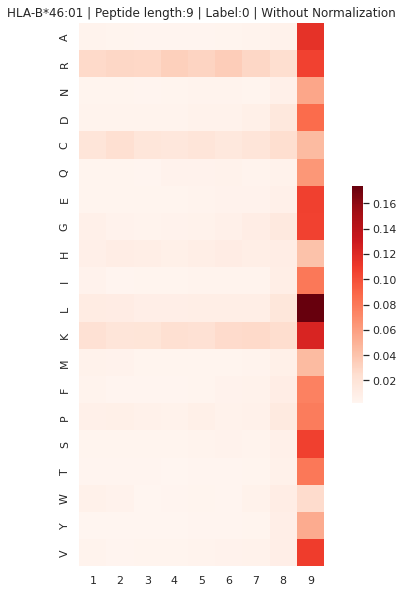



--------------------------


HLA and Label are filtered.
#Peptides: 11422
HLA: HLA-B*51:01
Threshold: 0.08
RRRRRRRRL

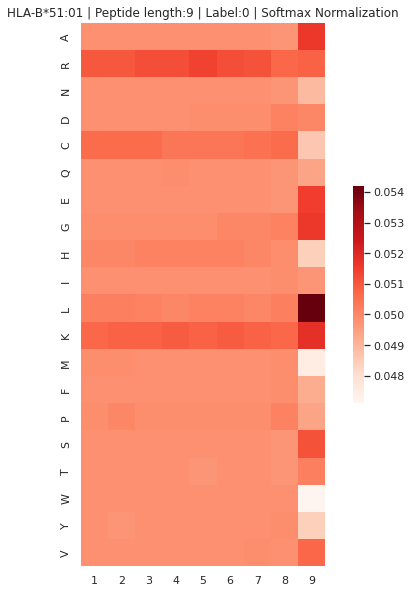

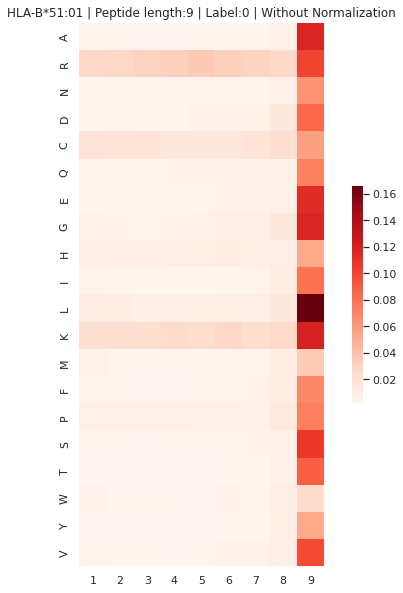



--------------------------


HLA and Label are filtered.
#Peptides: 496
HLA: HLA-A*24:13
Threshold: 0.12
KKRRRRKKL

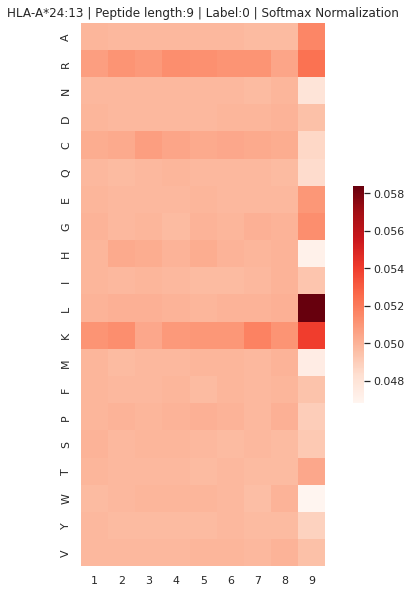

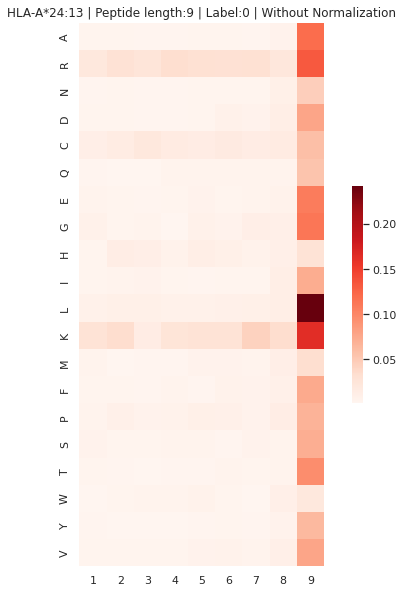



--------------------------


HLA and Label are filtered.
#Peptides: 10216
HLA: HLA-B*27:09
Threshold: 0.08
RRRRRRRKL

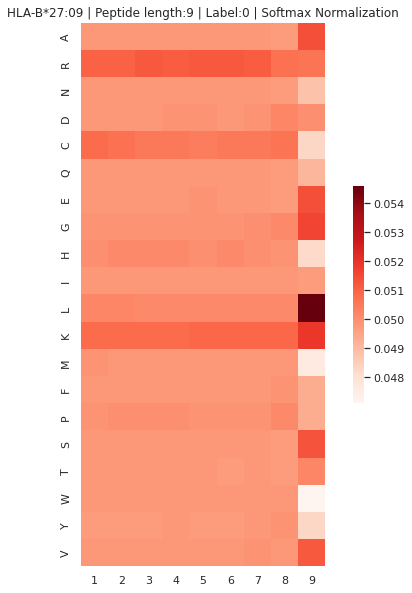

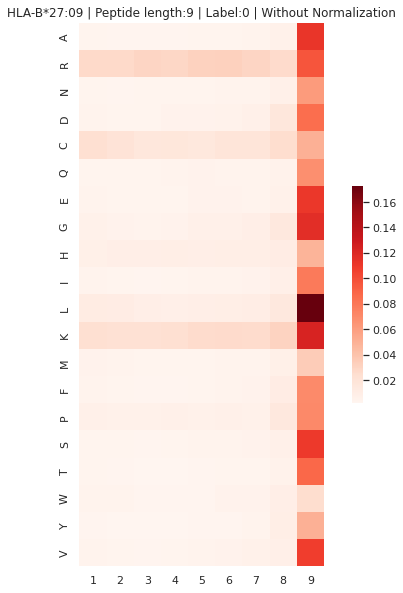



--------------------------


HLA and Label are filtered.
#Peptides: 30719
HLA: HLA-A*03:01
Threshold: 0.08
RRRRRRRRL

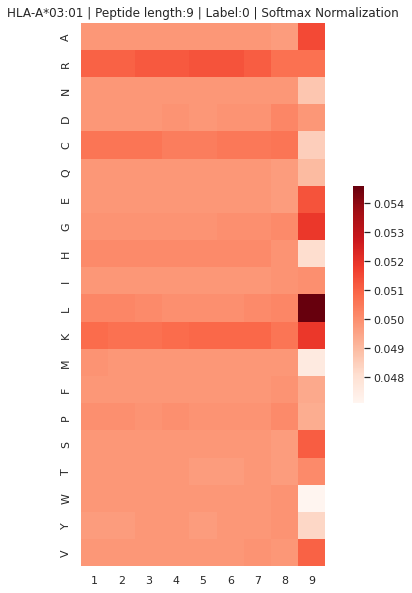

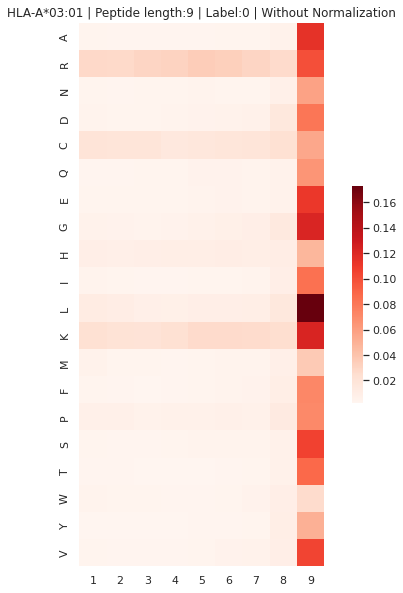



--------------------------


HLA and Label are filtered.
#Peptides: 2344
HLA: HLA-A*33:01
Threshold: 0.09
RRRRRRKKL

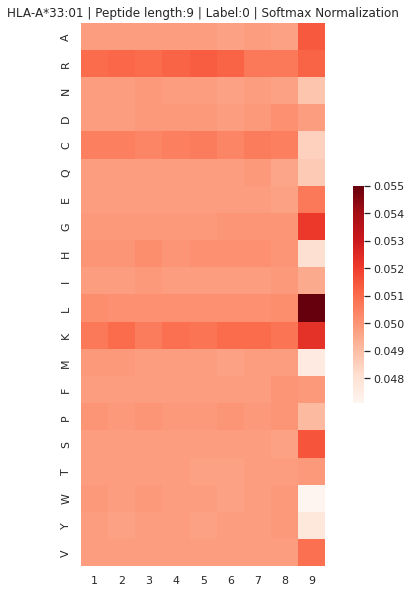

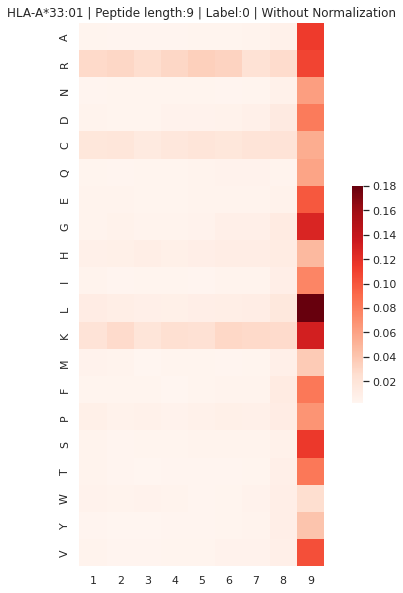



--------------------------


HLA and Label are filtered.
#Peptides: 1819
HLA: HLA-B*41:01
Threshold: 0.08
RRRRRRRKL

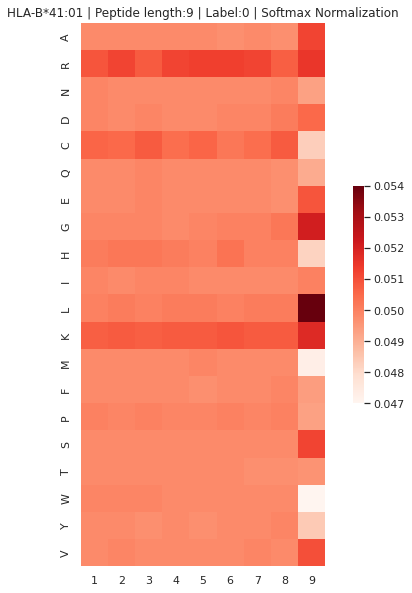

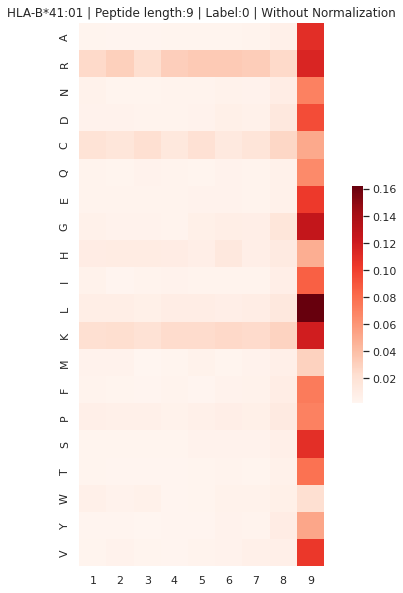



--------------------------


HLA and Label are filtered.
#Peptides: 34326
HLA: HLA-B*07:02
Threshold: 0.08
RRRRRRRKL

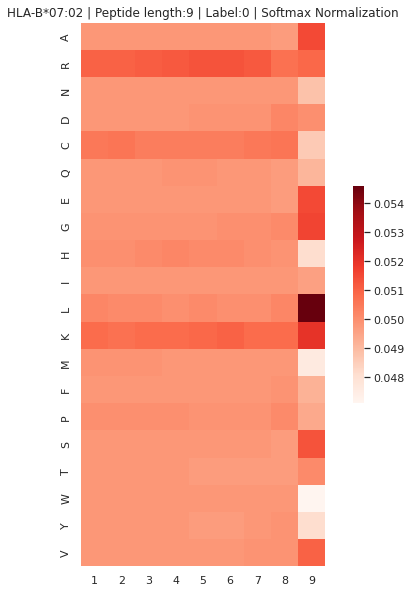

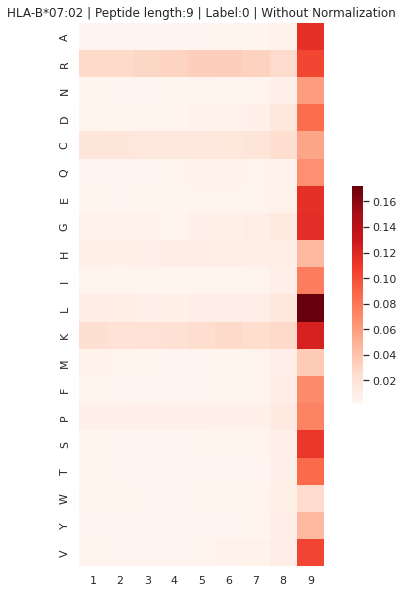



--------------------------


HLA and Label are filtered.
#Peptides: 1189
HLA: HLA-B*15:42
Threshold: 0.08
KRRKRKKKL

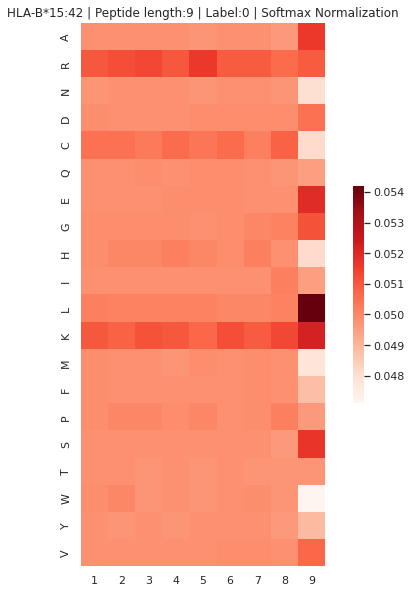

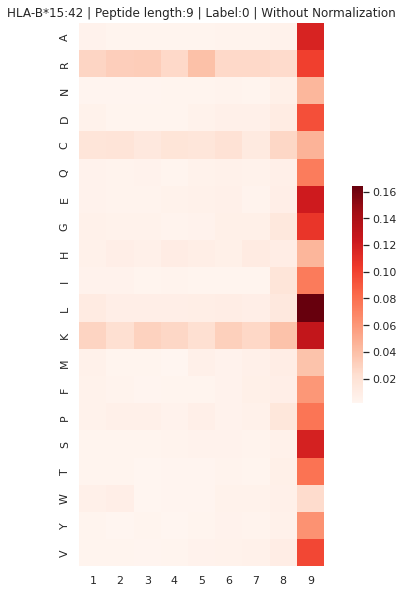



--------------------------


HLA and Label are filtered.
#Peptides: 11500
HLA: HLA-A*32:01
Threshold: 0.08
RRRRRRRCL

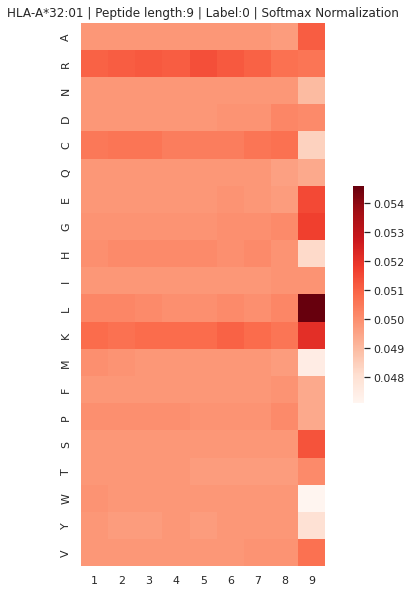

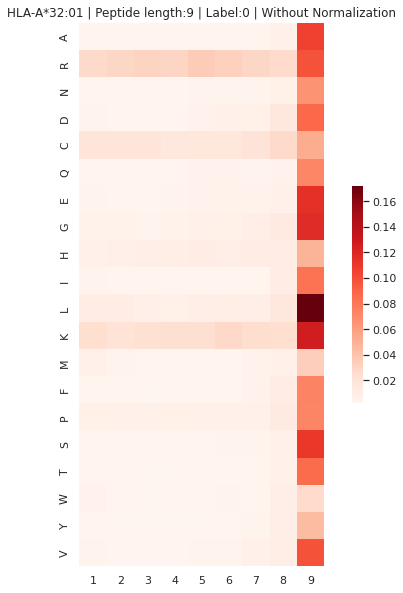



--------------------------


HLA and Label are filtered.
#Peptides: 1406
HLA: HLA-C*17:01
Threshold: 0.08
RRRKRRRRL

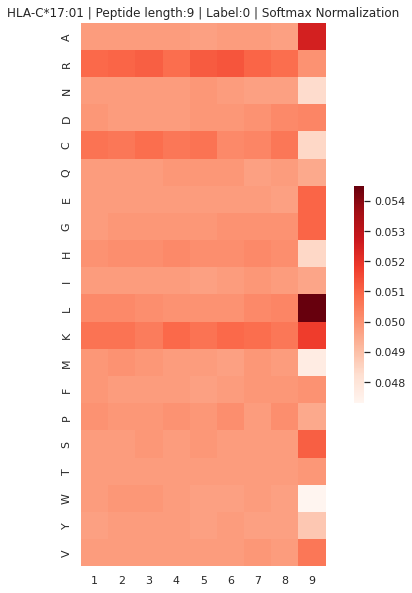

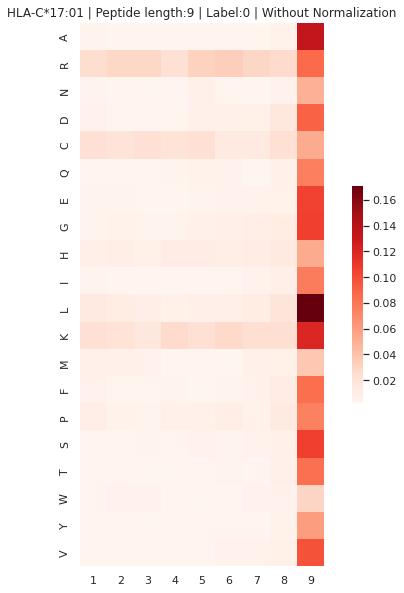



--------------------------


HLA and Label are filtered.
#Peptides: 2365
HLA: HLA-A*30:02
Threshold: 0.08
RRRRRRKCL

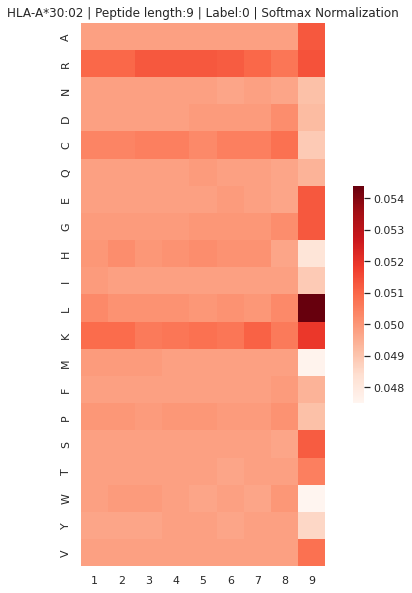

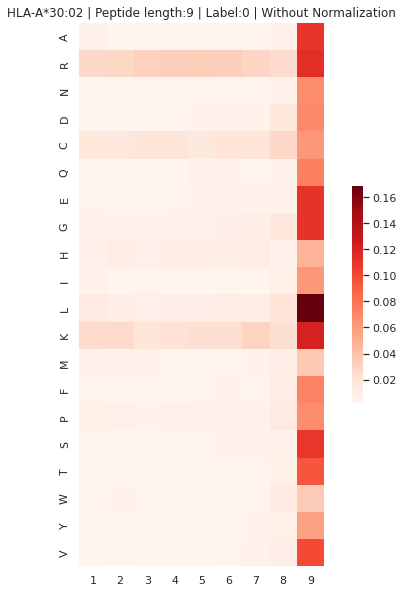



--------------------------


HLA and Label are filtered.
#Peptides: 39870
HLA: HLA-B*15:01
Threshold: 0.09
RRRRRRRKL

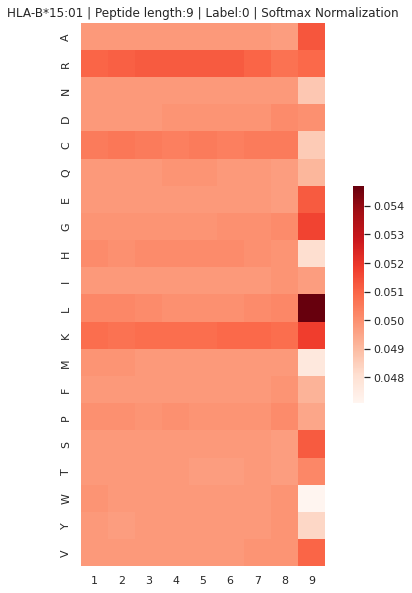

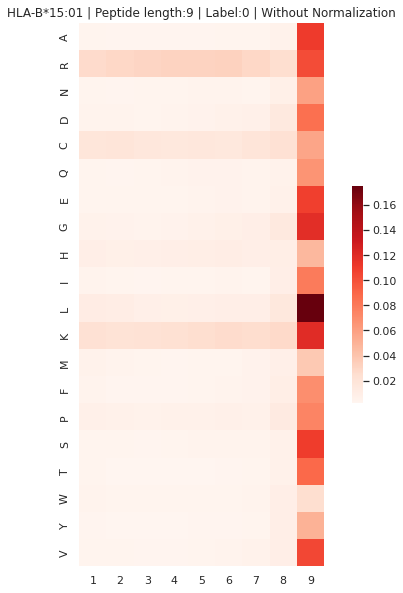



--------------------------


HLA and Label are filtered.
#Peptides: 8166
HLA: HLA-A*02:07
Threshold: 0.08
RRRRRRRRL

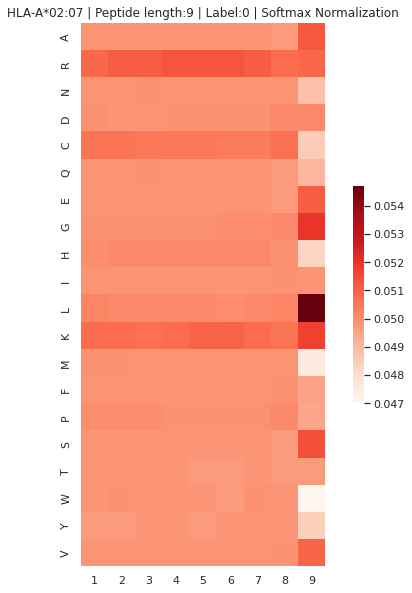

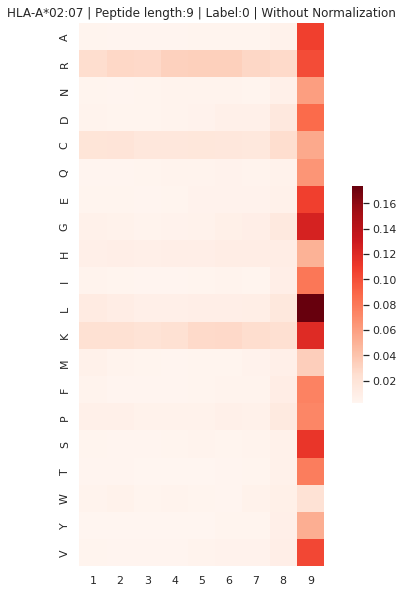



--------------------------


HLA and Label are filtered.
#Peptides: 11536
HLA: HLA-B*37:01
Threshold: 0.09
RRRRRRRRL

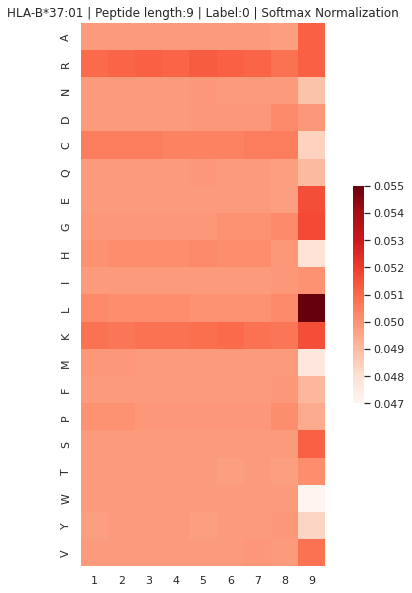

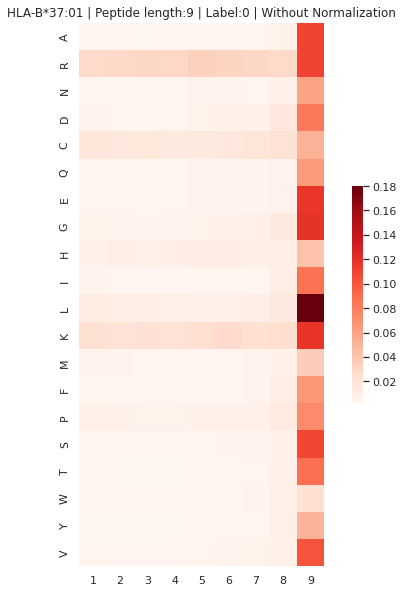



--------------------------


HLA and Label are filtered.
#Peptides: 311
HLA: HLA-A*66:01
Threshold: 0.13
KRRKRRRKL

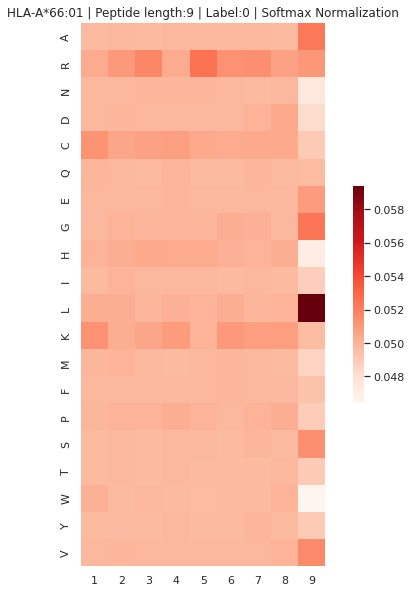

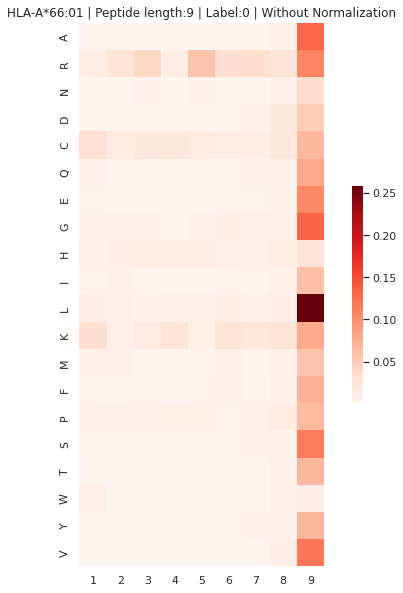



--------------------------


HLA and Label are filtered.
#Peptides: 14154
HLA: HLA-C*03:04
Threshold: 0.09
RRRRRRRRL

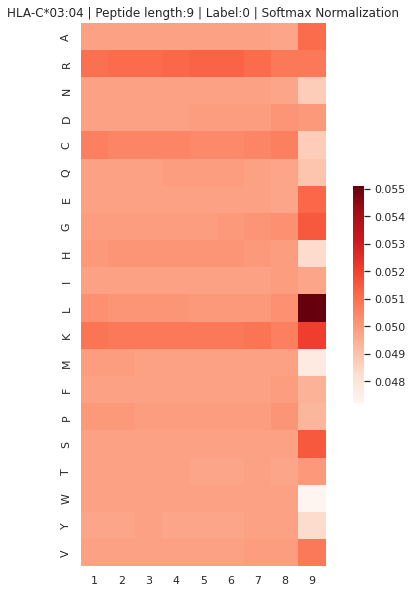

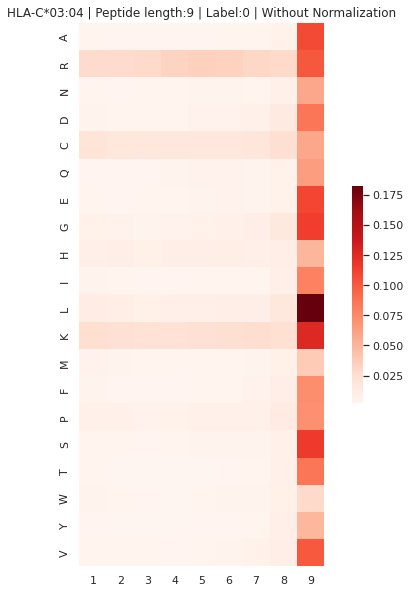



--------------------------


HLA and Label are filtered.
#Peptides: 3607
HLA: HLA-A*69:01
Threshold: 0.08
RRRRRRKCL

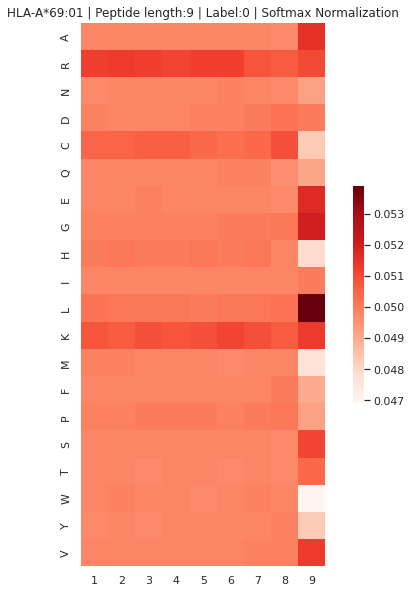

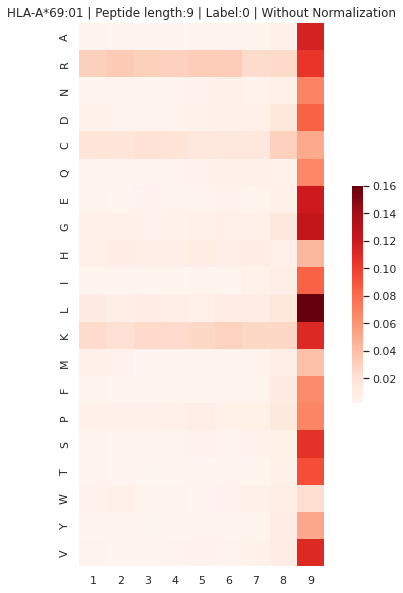



--------------------------


HLA and Label are filtered.
#Peptides: 479
HLA: HLA-A*02:17
Threshold: 0.09
RRRRRRRKK

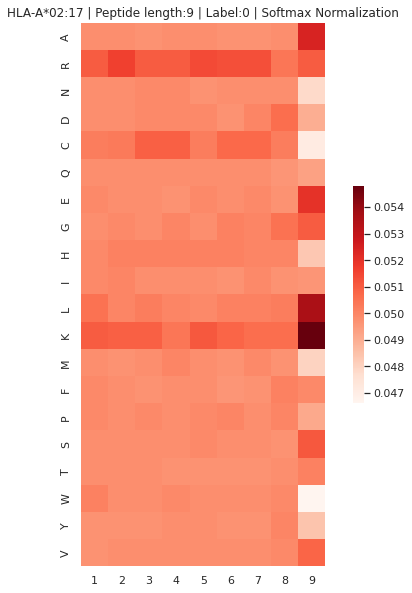

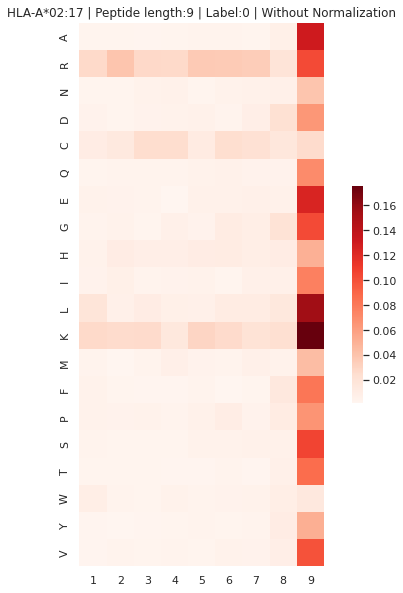



--------------------------


HLA and Label are filtered.
#Peptides: 16471
HLA: HLA-C*08:02
Threshold: 0.08
RRRRRRRRL

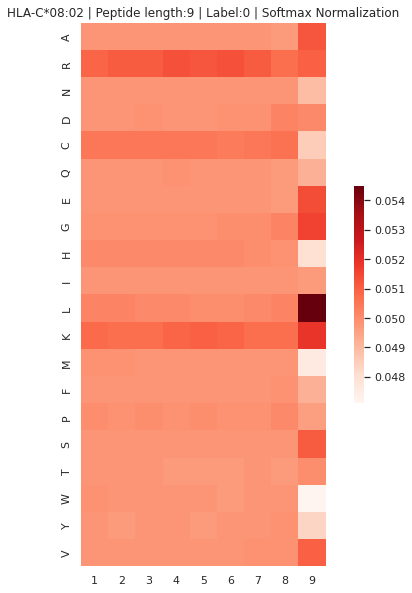

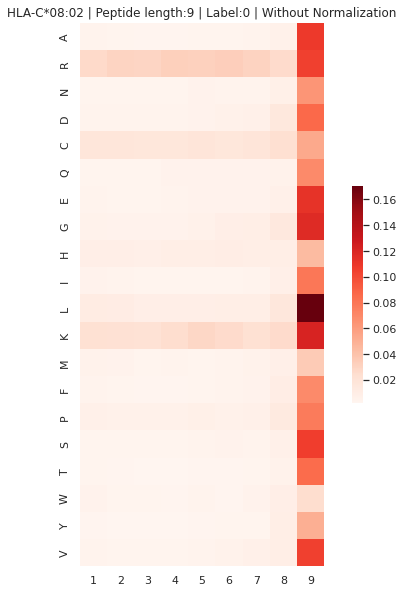



--------------------------


HLA and Label are filtered.
#Peptides: 596
HLA: HLA-A*80:01
Threshold: 0.08
KKRRRRRKL

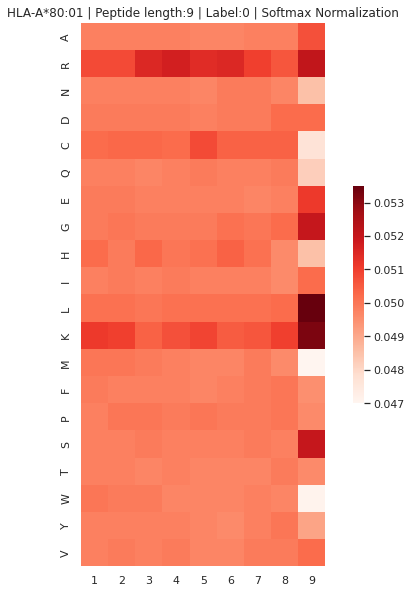

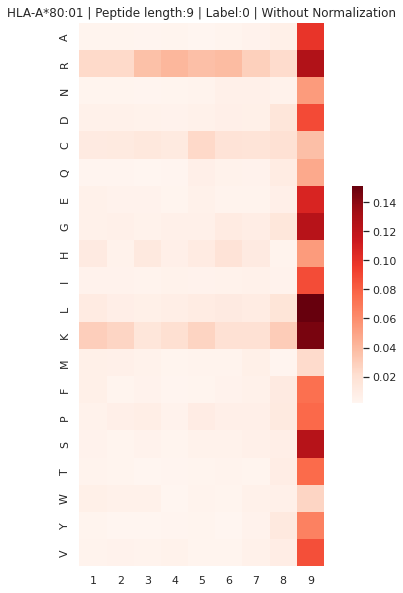



--------------------------


HLA and Label are filtered.
#Peptides: 21467
HLA: HLA-A*68:01
Threshold: 0.08
RRRRRRRKL

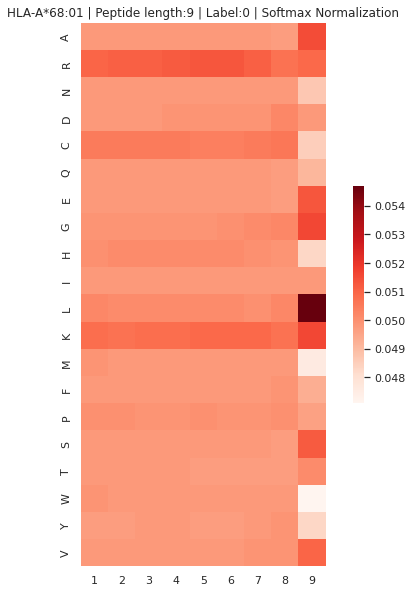

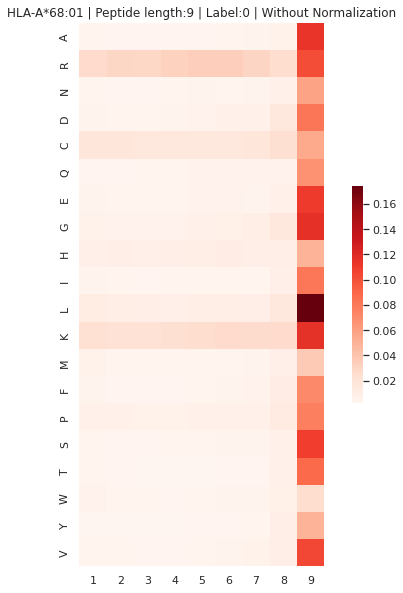



--------------------------


HLA and Label are filtered.
#Peptides: 298
HLA: HLA-A*02:50
Threshold: 0.08
KKRRRKRKL

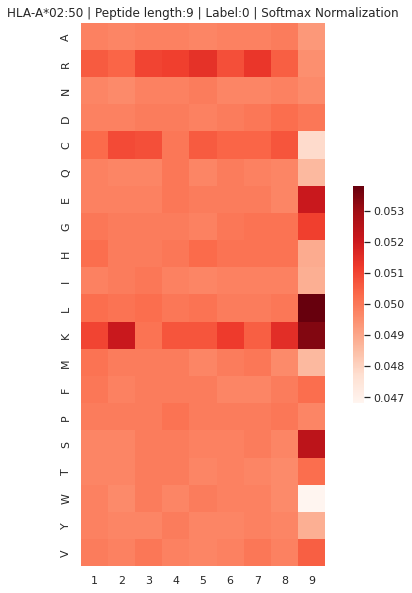

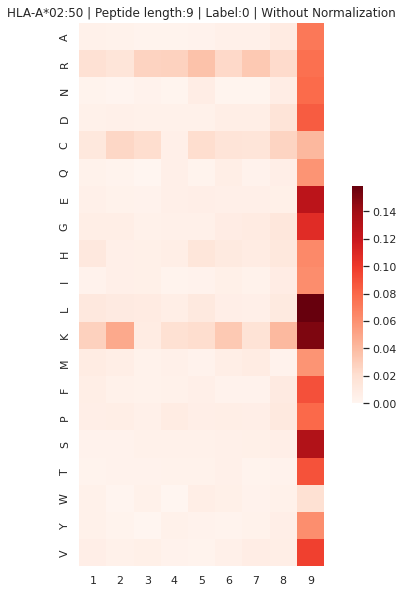



--------------------------


HLA and Label are filtered.
#Peptides: 11354
HLA: HLA-B*58:01
Threshold: 0.08
RRRRRRRKL

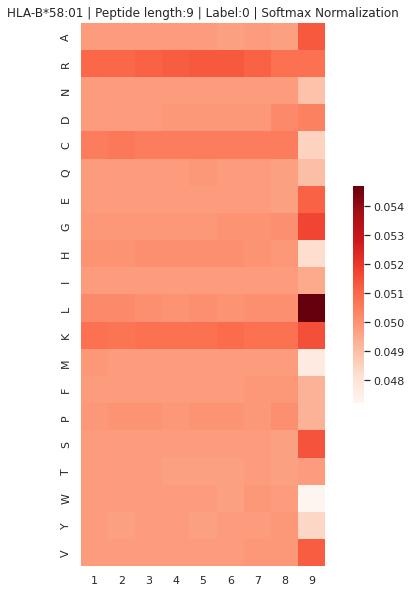

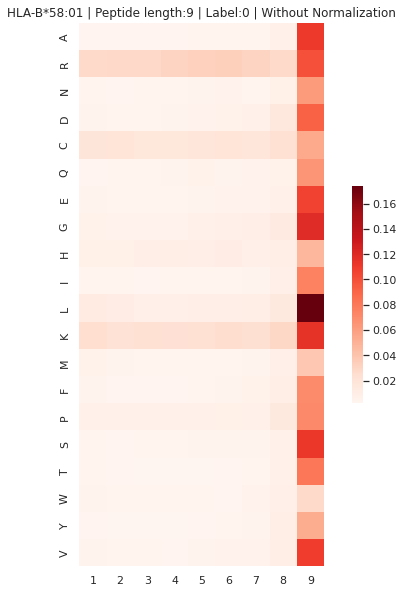



--------------------------


HLA and Label are filtered.
#Peptides: 277
HLA: HLA-A*26:03
Threshold: 0.1
RKRKRRRRL

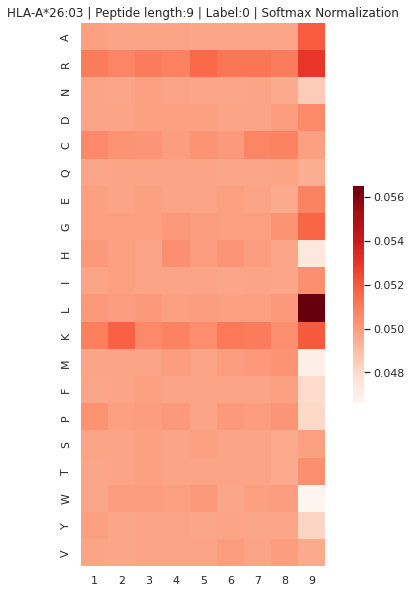

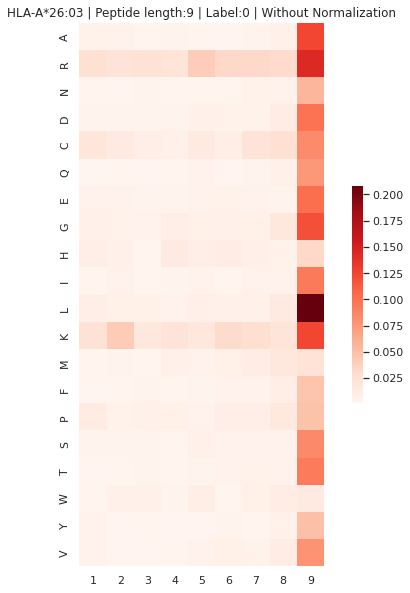



--------------------------


HLA and Label are filtered.
#Peptides: 12278
HLA: HLA-C*05:01
Threshold: 0.08
RRRRRRRKL

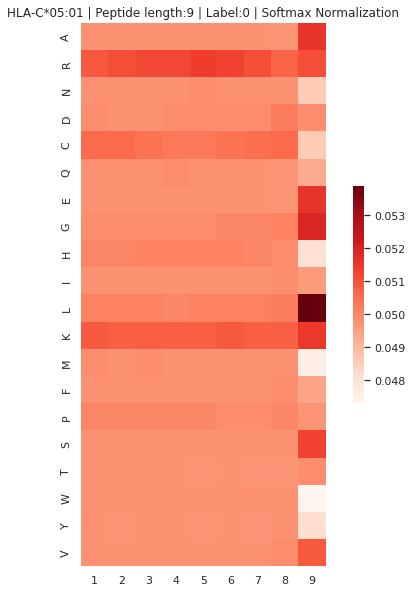

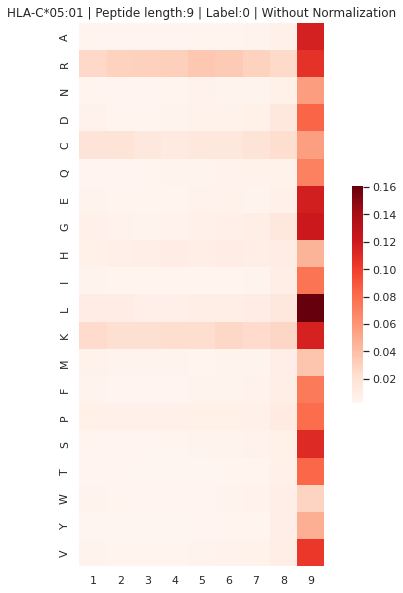



--------------------------


HLA and Label are filtered.
#Peptides: 14948
HLA: HLA-B*44:03
Threshold: 0.08
RRRRRRRRL

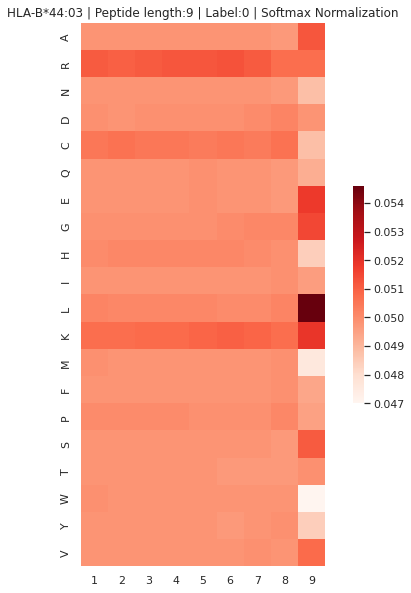

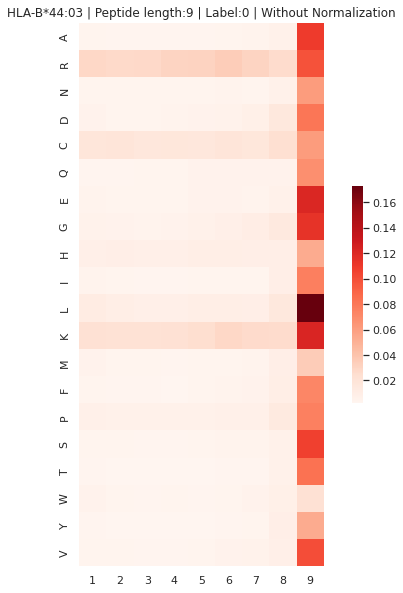



--------------------------


HLA and Label are filtered.
#Peptides: 6936
HLA: HLA-B*27:04
Threshold: 0.09
RRRRRRRRL

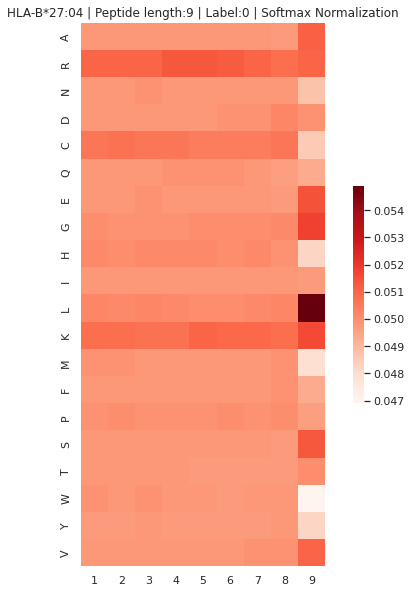

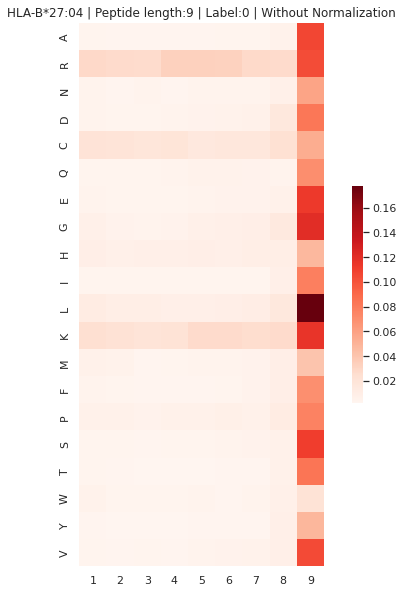



--------------------------


HLA and Label are filtered.
#Peptides: 0
HLA: HLA-B*44:27
Threshold: nan
AAAAAAAAA

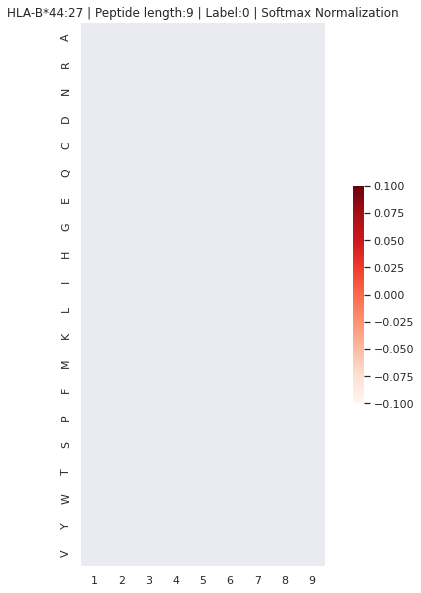

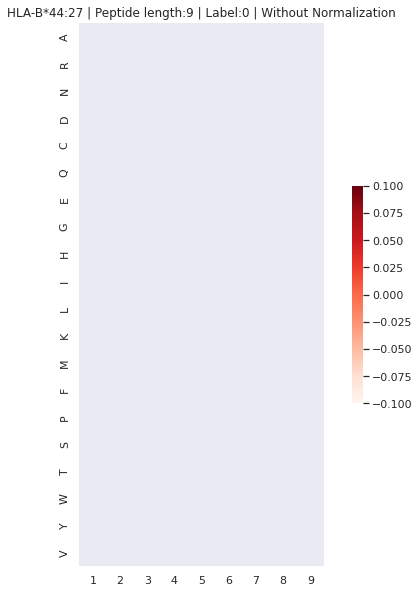



--------------------------


HLA and Label are filtered.
#Peptides: 1176
HLA: HLA-B*45:06
Threshold: 0.08
RRRRKRKKL

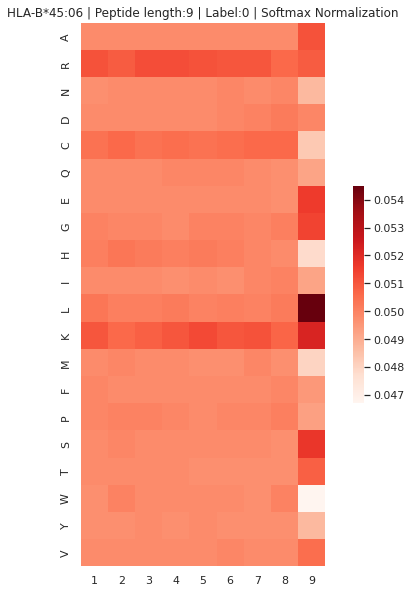

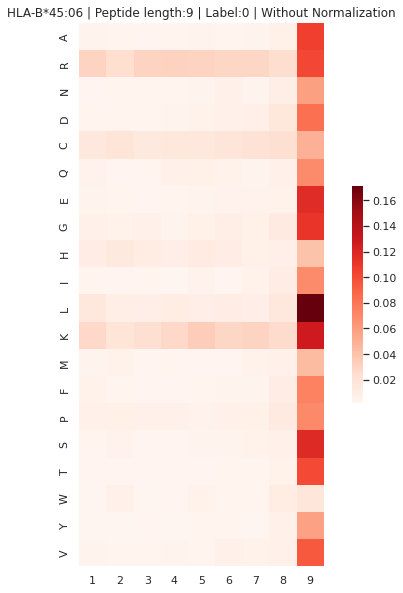



--------------------------


HLA and Label are filtered.
#Peptides: 9092
HLA: HLA-B*57:03
Threshold: 0.09
RRRRRRRKL

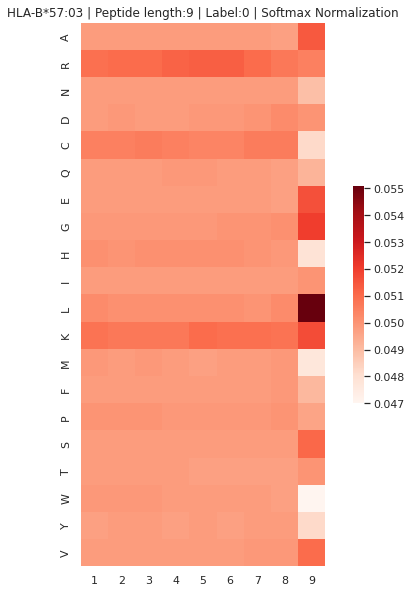

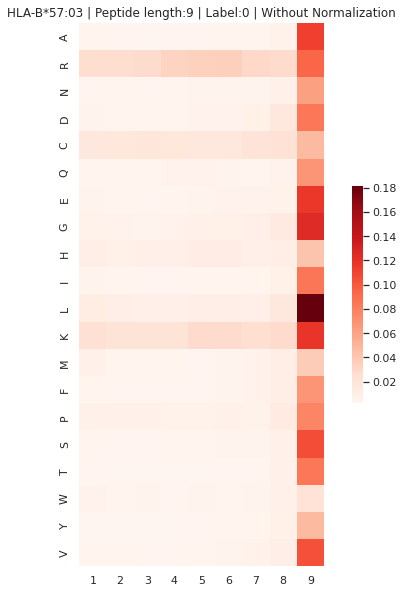



--------------------------


HLA and Label are filtered.
#Peptides: 11927
HLA: HLA-C*07:01
Threshold: 0.09
RRRRRRRRL

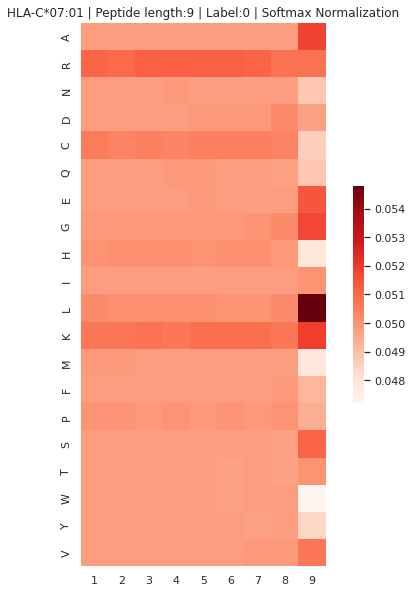

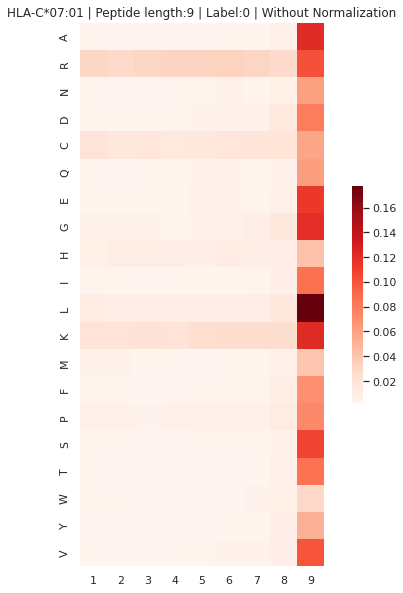



--------------------------


HLA and Label are filtered.
#Peptides: 17288
HLA: HLA-B*40:02
Threshold: 0.09
RRRRRRRRL

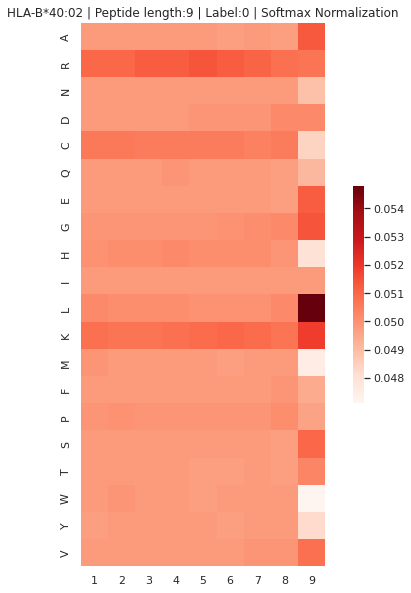

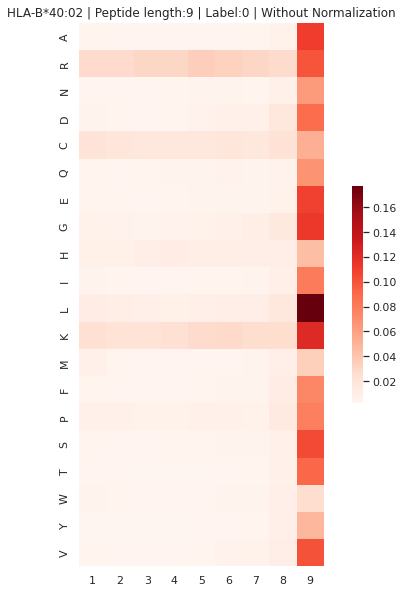



--------------------------


HLA and Label are filtered.
#Peptides: 2918
HLA: HLA-B*54:01
Threshold: 0.08
RRRRRRRKL

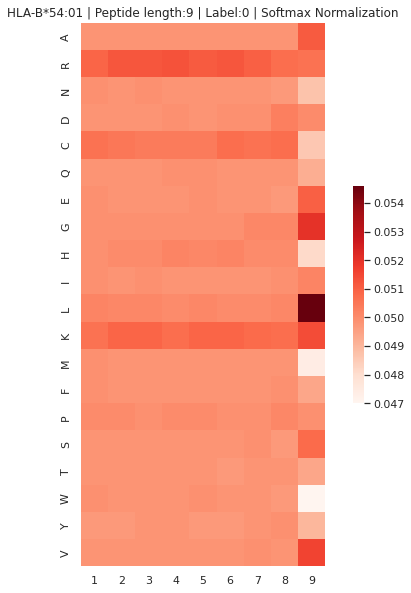

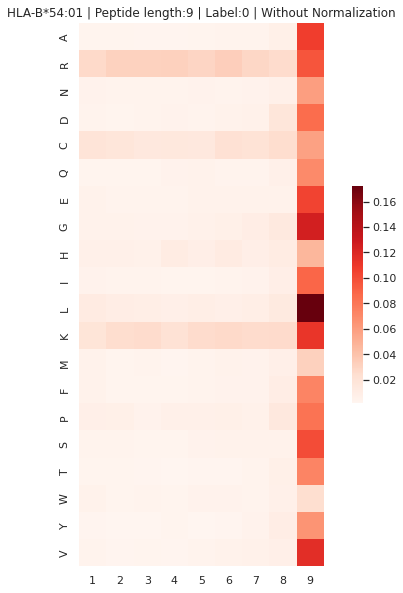



--------------------------


HLA and Label are filtered.
#Peptides: 319
HLA: HLA-B*14:01
Threshold: 0.08
CRKRRRRKL

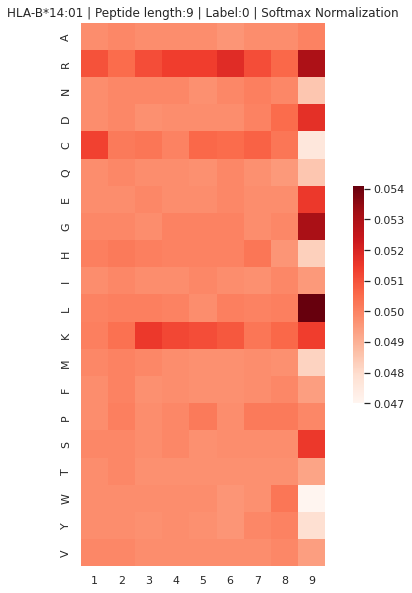

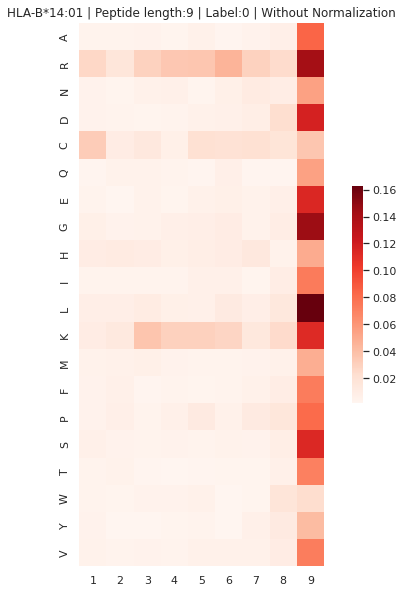



--------------------------


HLA and Label are filtered.
#Peptides: 22542
HLA: HLA-A*24:02
Threshold: 0.08
RRRRRRRRL

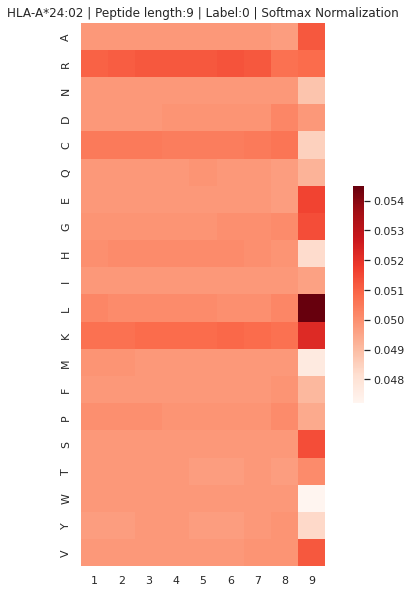

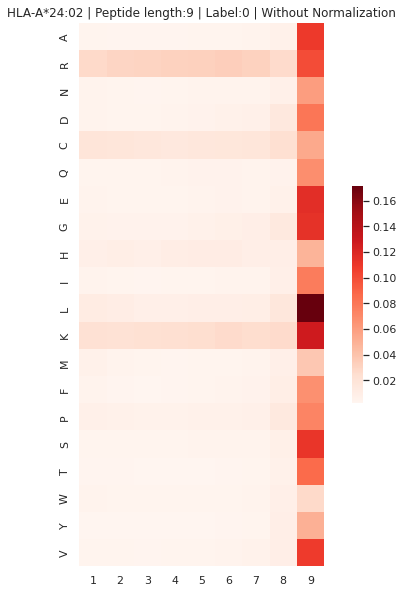



--------------------------


HLA and Label are filtered.
#Peptides: 1159
HLA: HLA-A*02:12
Threshold: 0.09
KRRRRRKKL

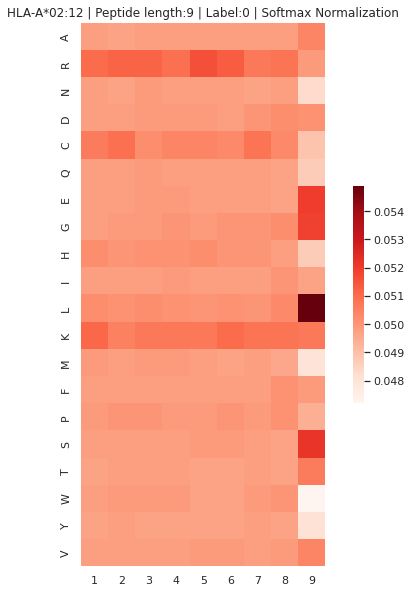

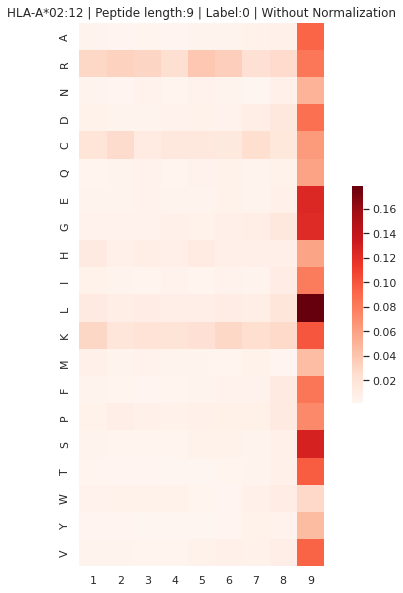



--------------------------


HLA and Label are filtered.
#Peptides: 18529
HLA: HLA-C*06:02
Threshold: 0.08
RRRRRRRRL

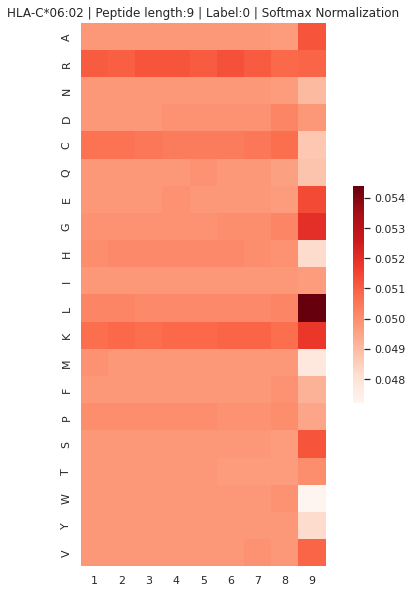

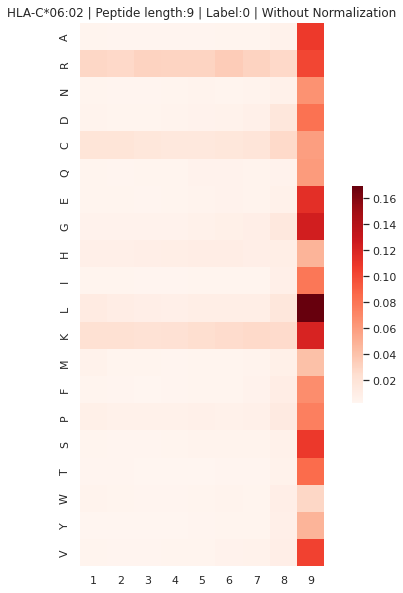



--------------------------


HLA and Label are filtered.
#Peptides: 12289
HLA: HLA-B*35:03
Threshold: 0.09
RRRRRRRRL

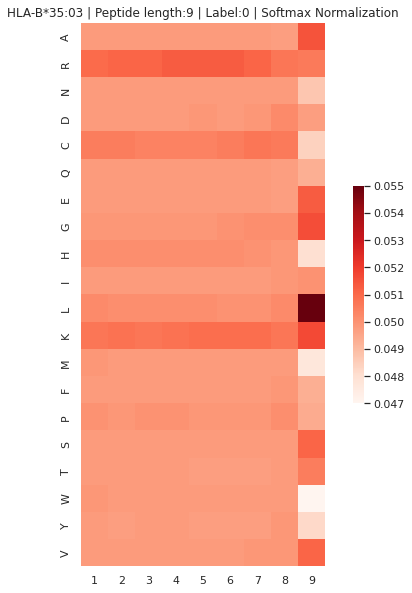

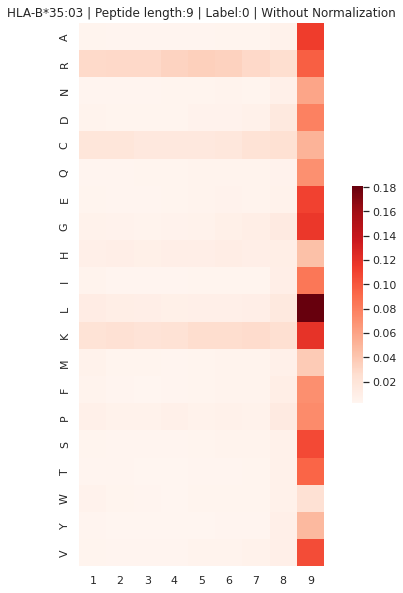



--------------------------


HLA and Label are filtered.
#Peptides: 17192
HLA: HLA-A*29:02
Threshold: 0.08
RRRRRRRKL

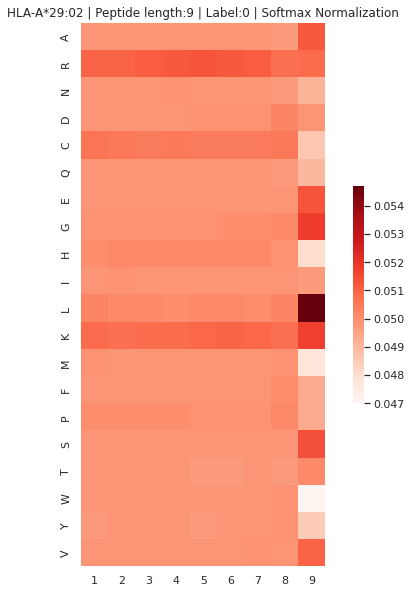

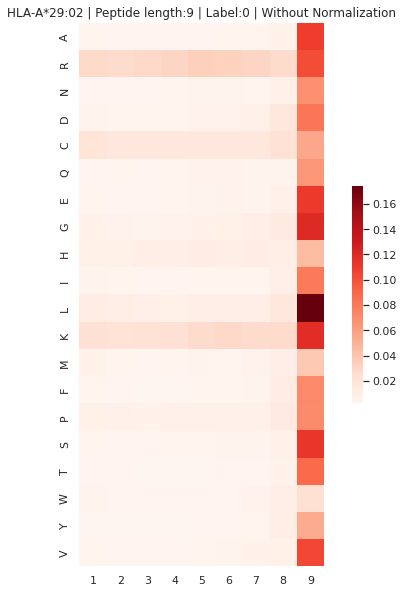



--------------------------


HLA and Label are filtered.
#Peptides: 6134
HLA: HLA-C*14:02
Threshold: 0.09
RRRRRRKCL

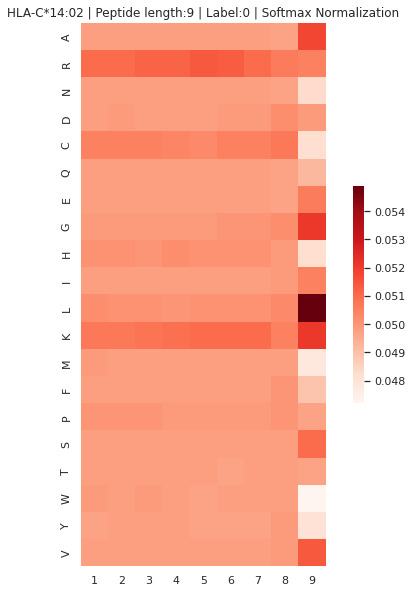

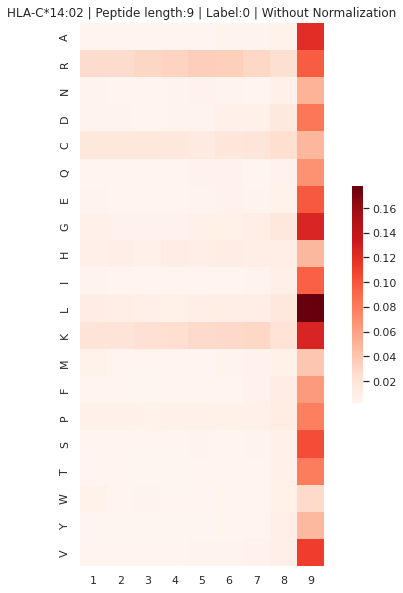



--------------------------


HLA and Label are filtered.
#Peptides: 638
HLA: HLA-A*02:16
Threshold: 0.08
KRRRRRRCL

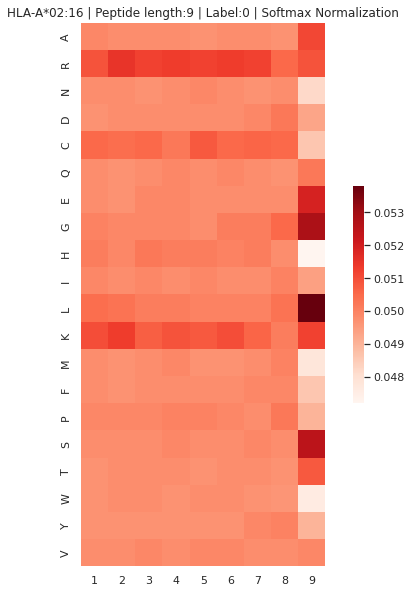

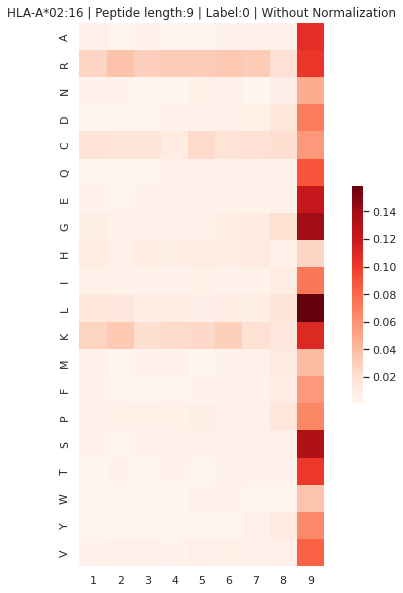



--------------------------


HLA and Label are filtered.
#Peptides: 832
HLA: HLA-A*02:19
Threshold: 0.08
RRKRRRKCL

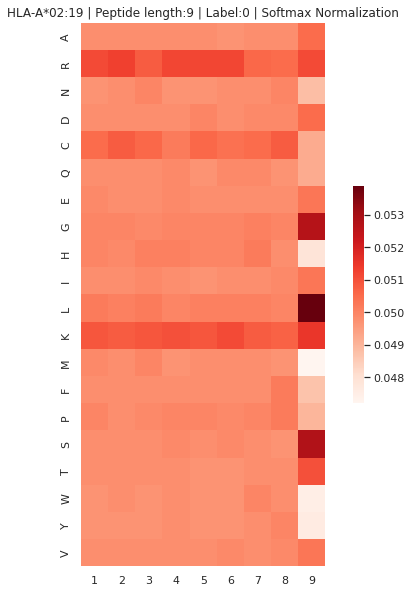

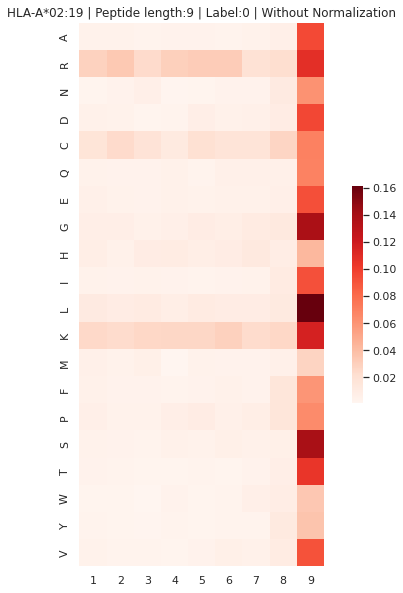



--------------------------


HLA and Label are filtered.
#Peptides: 269
HLA: HLA-A*68:23
Threshold: 0.08
KKRRRRRRG

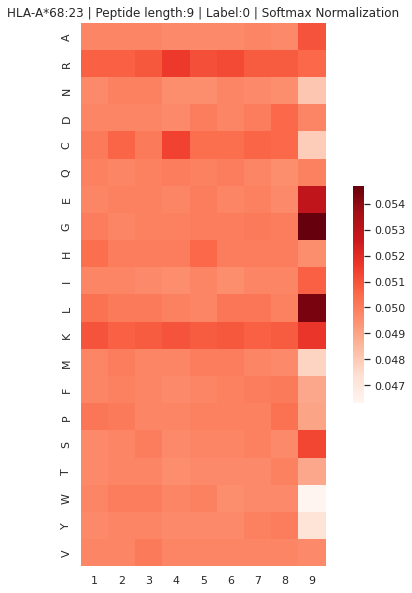

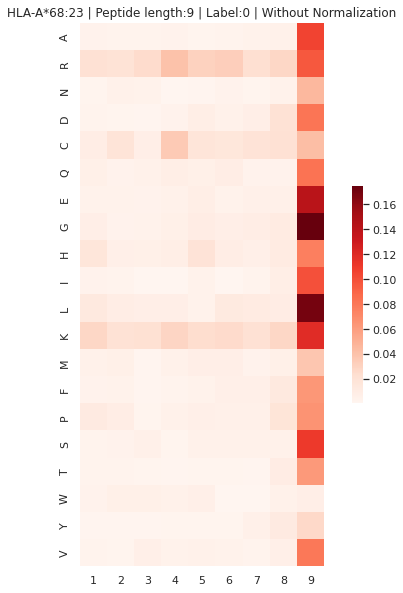



--------------------------


HLA and Label are filtered.
#Peptides: 886
HLA: HLA-B*15:02
Threshold: 0.09
RRRRRRRCL

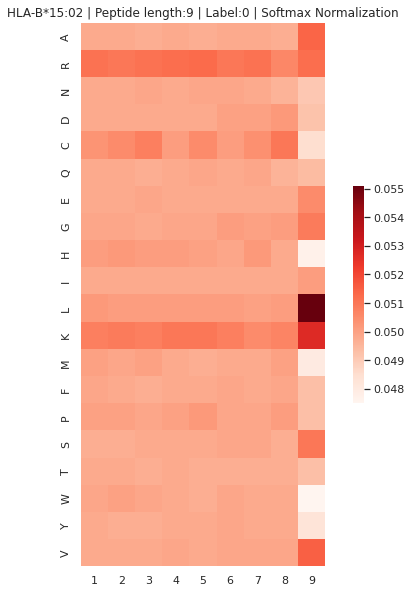

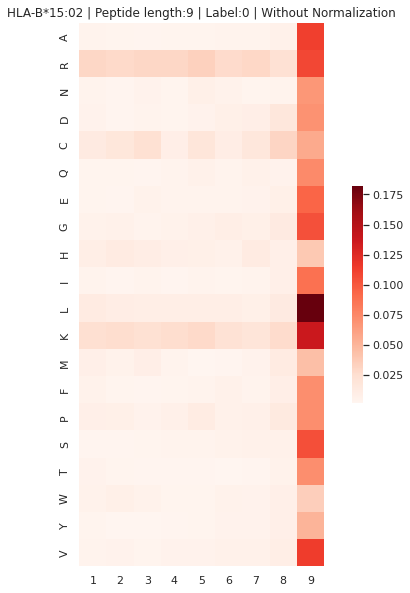



--------------------------


HLA and Label are filtered.
#Peptides: 344
HLA: HLA-B*15:09
Threshold: 0.1
RKKRRRRKL

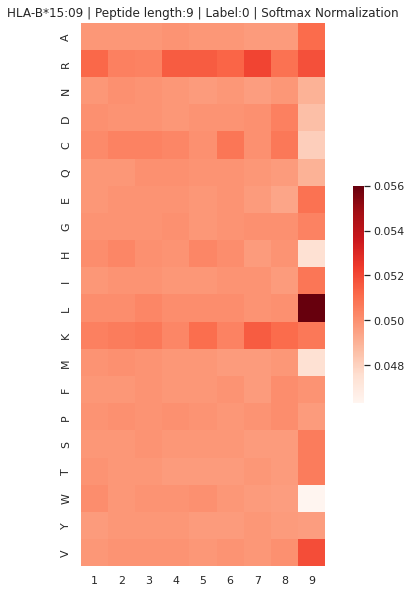

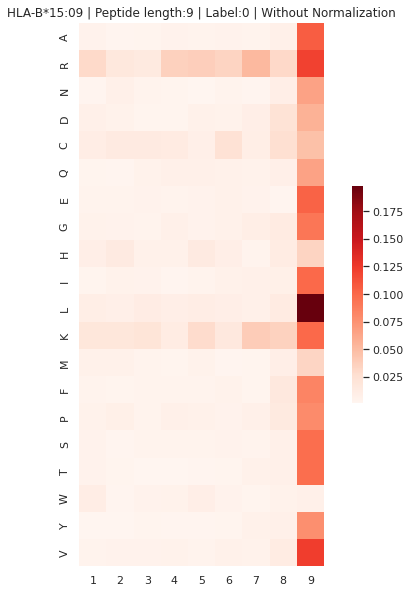



--------------------------


HLA and Label are filtered.
#Peptides: 294
HLA: HLA-A*32:07
Threshold: 0.08
RRCRRRRKL

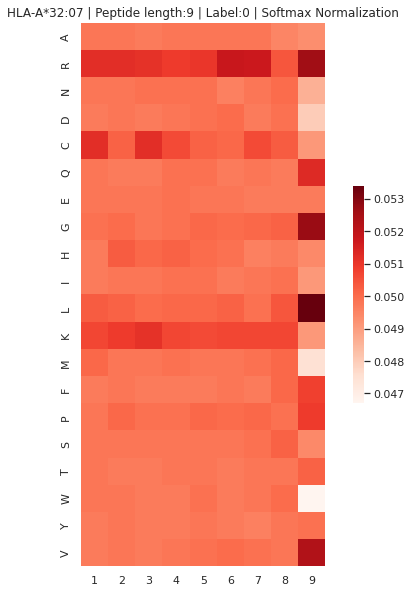

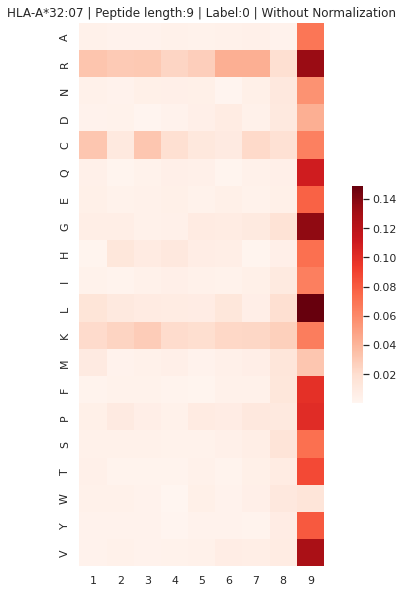



--------------------------


HLA and Label are filtered.
#Peptides: 10987
HLA: HLA-B*14:02
Threshold: 0.08
RRRRRRRCL

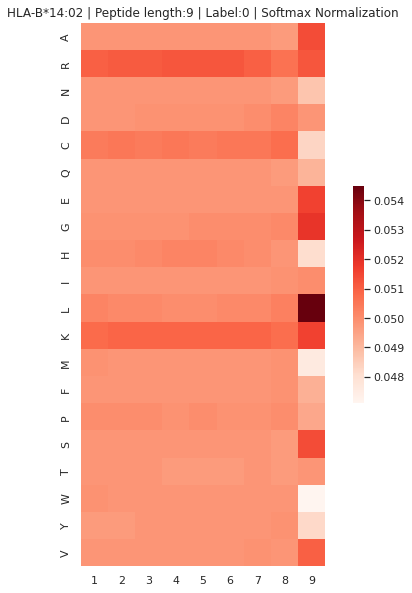

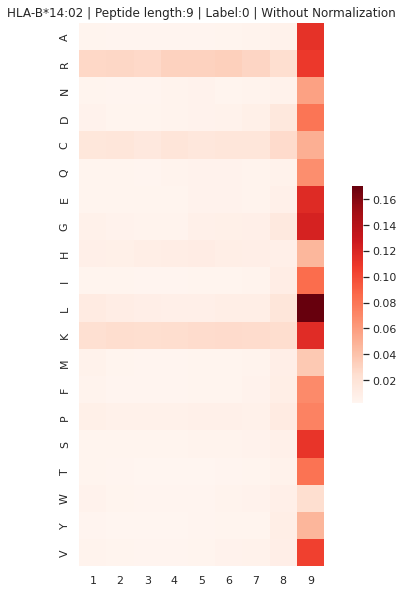



--------------------------


HLA and Label are filtered.
#Peptides: 67049
HLA: HLA-B*27:05
Threshold: 0.08
RRRRRRRRL

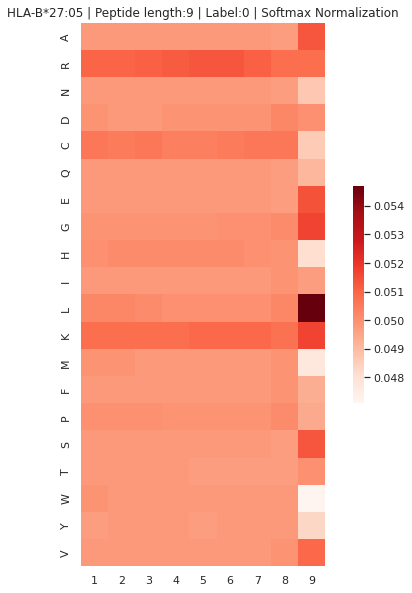

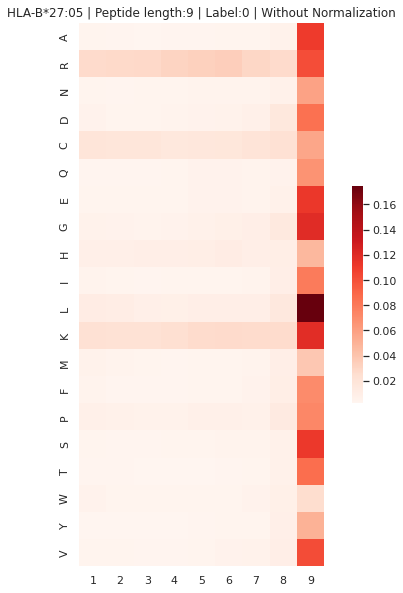



--------------------------


HLA and Label are filtered.
#Peptides: 2711
HLA: HLA-B*27:06
Threshold: 0.08
RRRRRRRRL

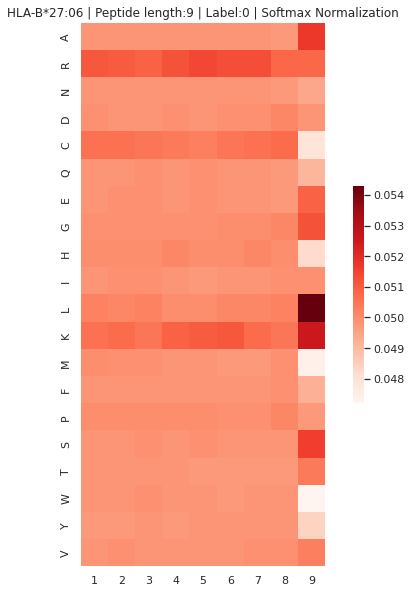

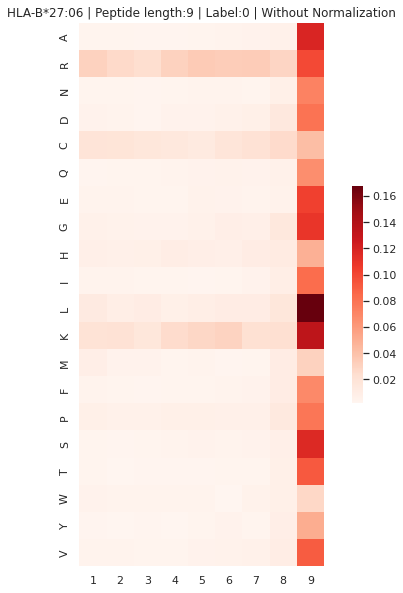



--------------------------


HLA and Label are filtered.
#Peptides: 1373
HLA: HLA-B*15:03
Threshold: 0.1
RKRRRRRRL

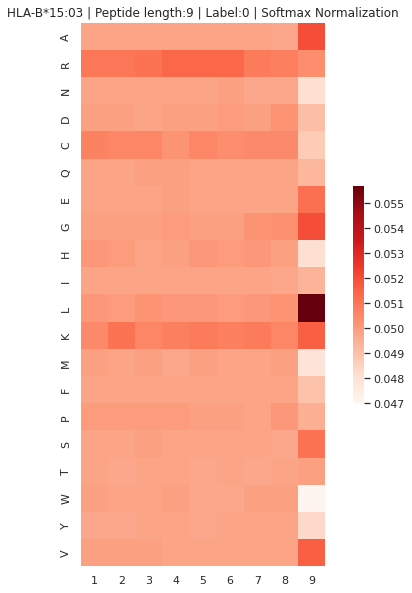

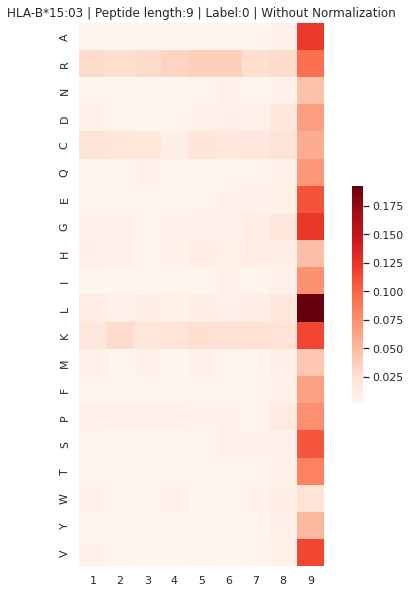



--------------------------


HLA and Label are filtered.
#Peptides: 244
HLA: HLA-A*32:15
Threshold: 0.08
KKCKKRRCL

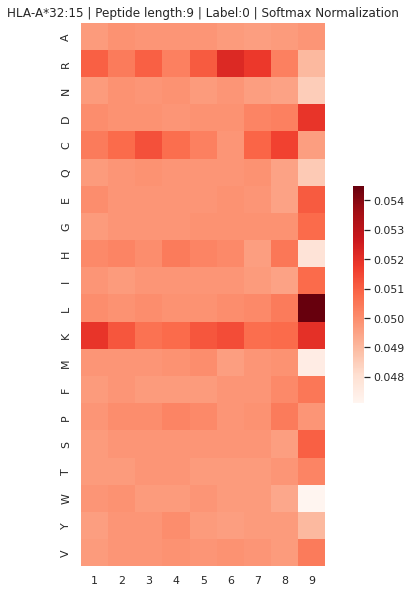

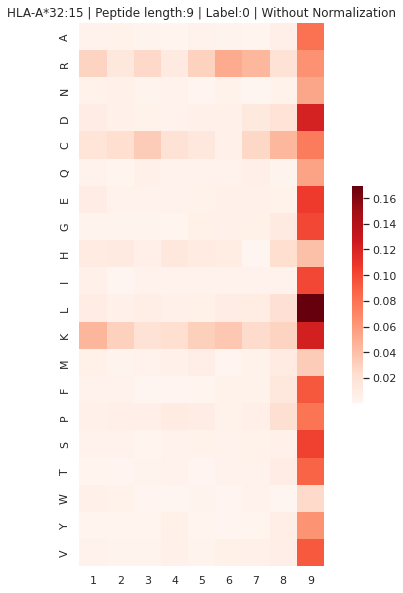



--------------------------


HLA and Label are filtered.
#Peptides: 14237
HLA: HLA-A*68:02
Threshold: 0.08
RRRRRRRKL

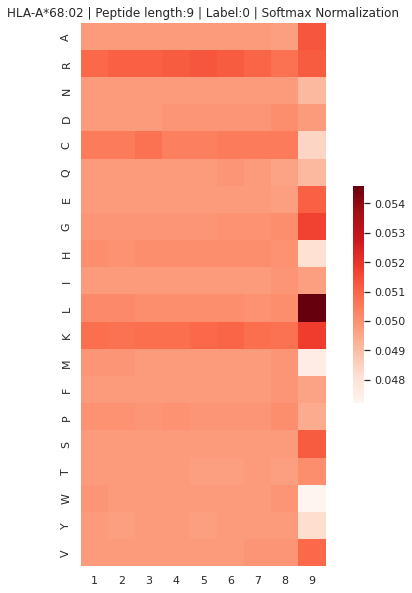

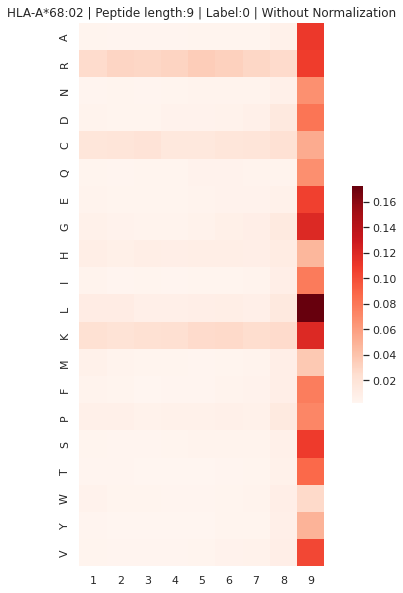



--------------------------


HLA and Label are filtered.
#Peptides: 15884
HLA: HLA-C*03:03
Threshold: 0.08
RRRRRRRRL

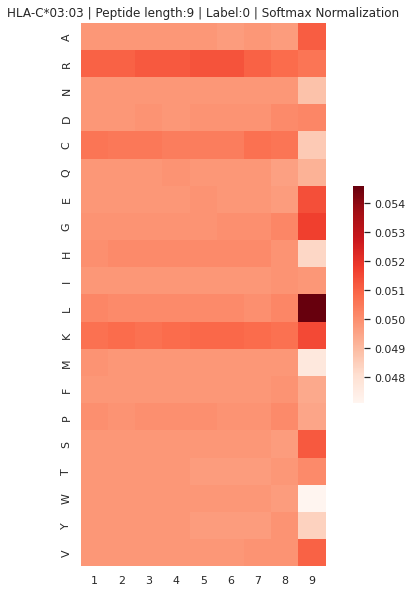

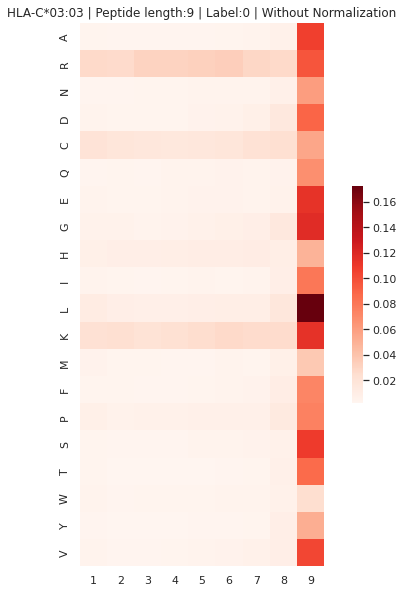



--------------------------


HLA and Label are filtered.
#Peptides: 5301
HLA: HLA-B*39:06
Threshold: 0.09
RRRRRRRRL

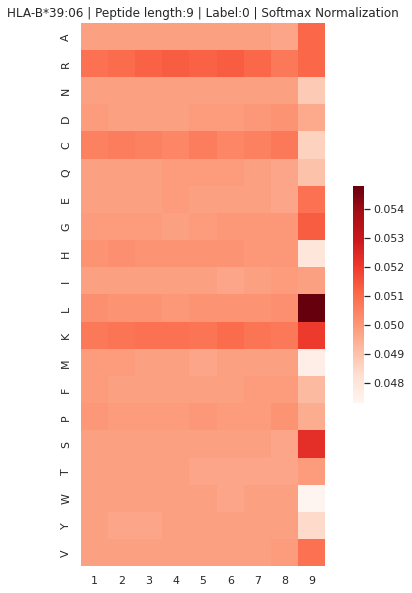

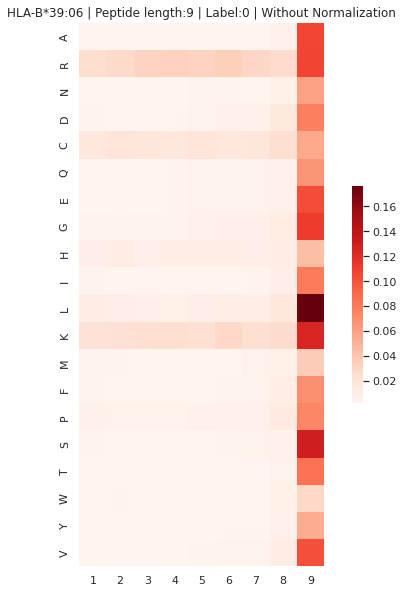



--------------------------


HLA and Label are filtered.
#Peptides: 3252
HLA: HLA-B*35:08
Threshold: 0.1
RRRRRRRKL

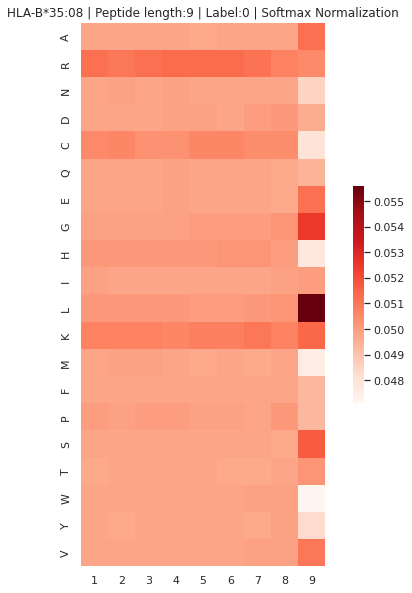

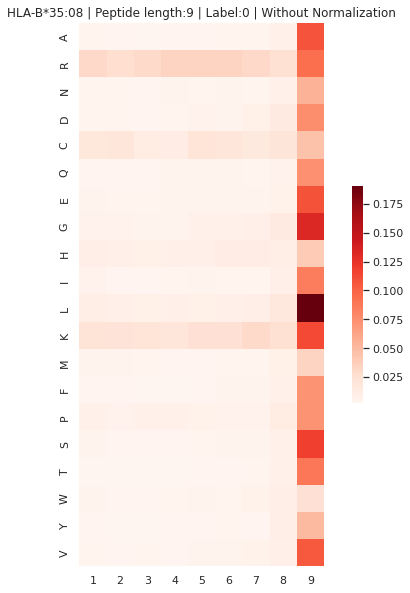



--------------------------


HLA and Label are filtered.
#Peptides: 6294
HLA: HLA-C*12:03
Threshold: 0.08
RRRRRRRKL

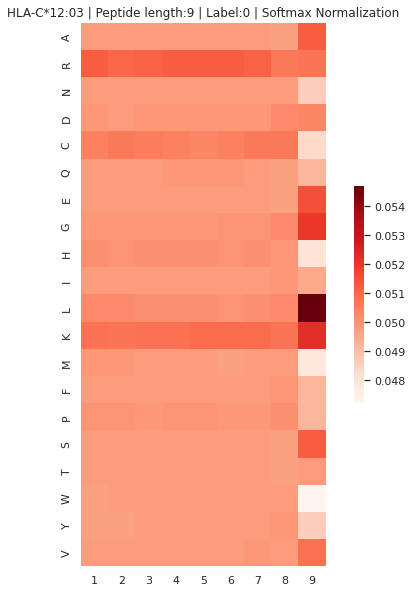

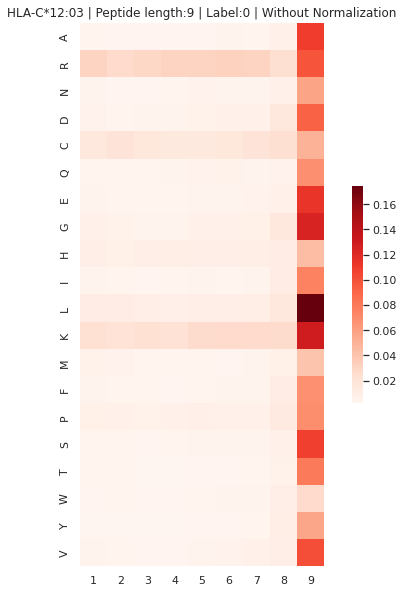



--------------------------


HLA and Label are filtered.
#Peptides: 403
HLA: HLA-A*25:01
Threshold: 0.08
CKRRKRKCL

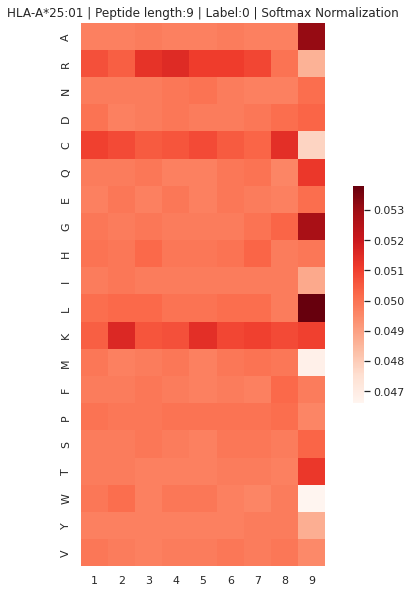

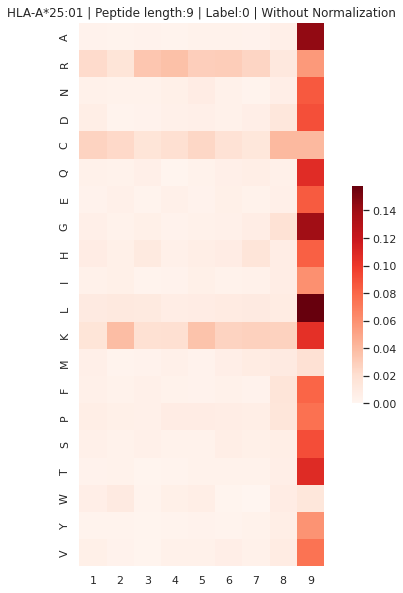



--------------------------


HLA and Label are filtered.
#Peptides: 1077
HLA: HLA-B*83:01
Threshold: 0.08
RRRRKRRRL

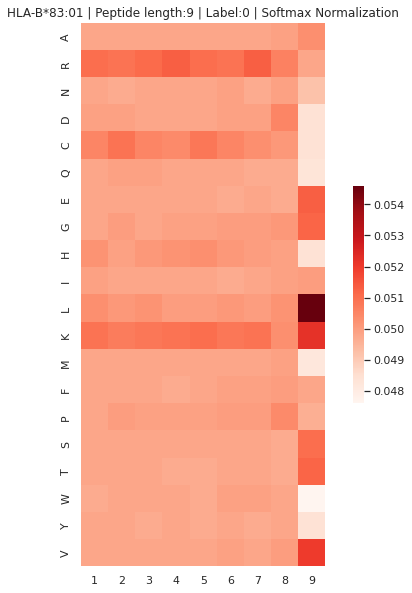

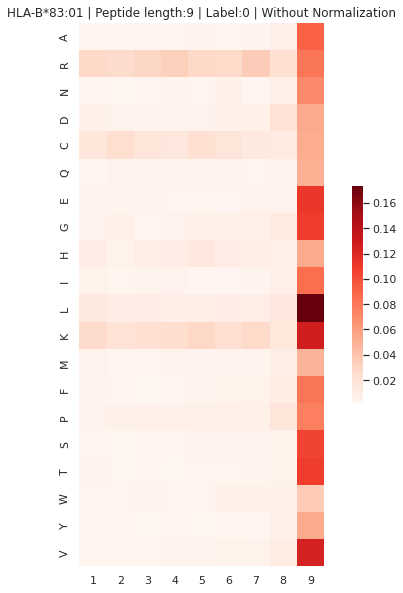



--------------------------


HLA and Label are filtered.
#Peptides: 13088
HLA: HLA-B*38:01
Threshold: 0.08
RRRRRRRRL

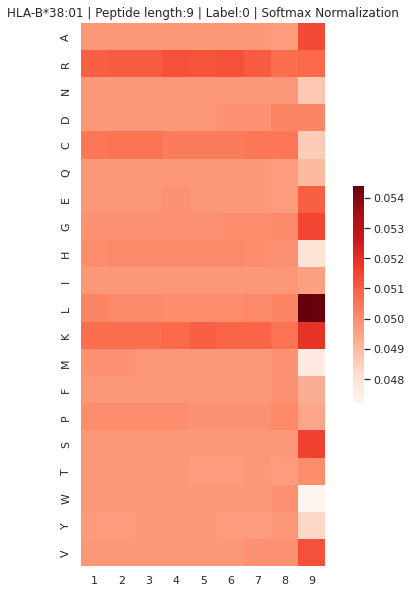

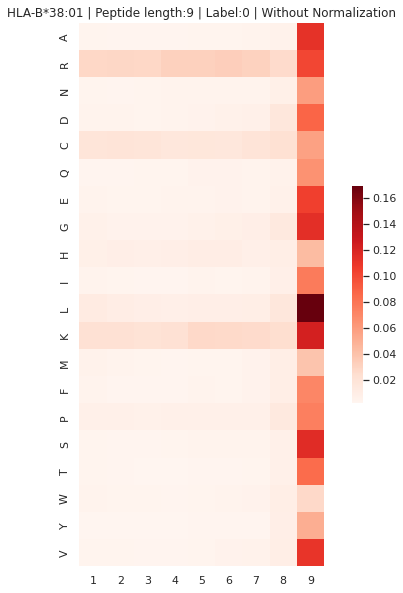



--------------------------


HLA and Label are filtered.
#Peptides: 307
HLA: HLA-B*27:20
Threshold: 0.08
CRRKRRKRL

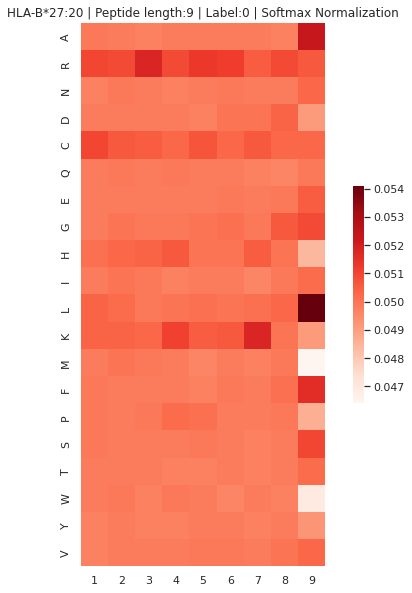

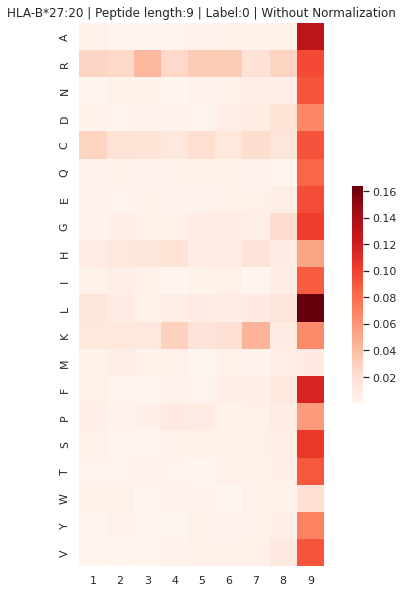



--------------------------


HLA and Label are filtered.
#Peptides: 386
HLA: HLA-A*24:06
Threshold: 0.1
RKRRRRRRL

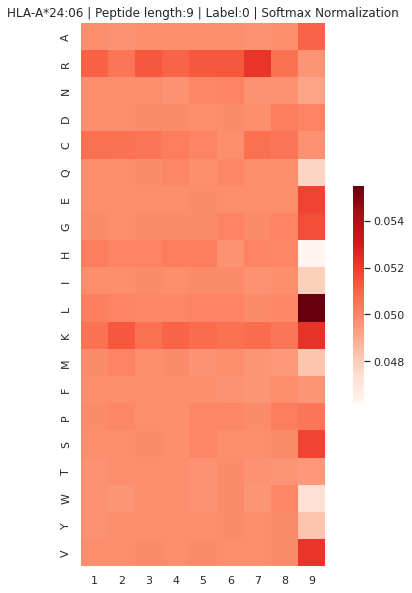

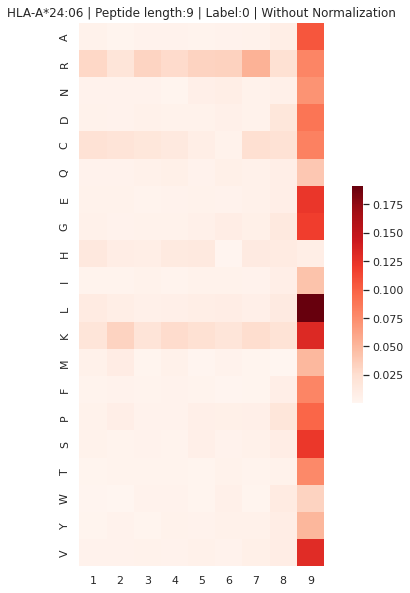



--------------------------


HLA and Label are filtered.
#Peptides: 5070
HLA: HLA-A*02:02
Threshold: 0.09
RRRKRRRKL

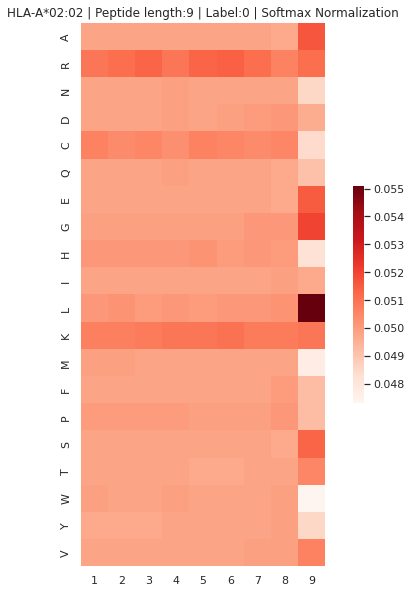

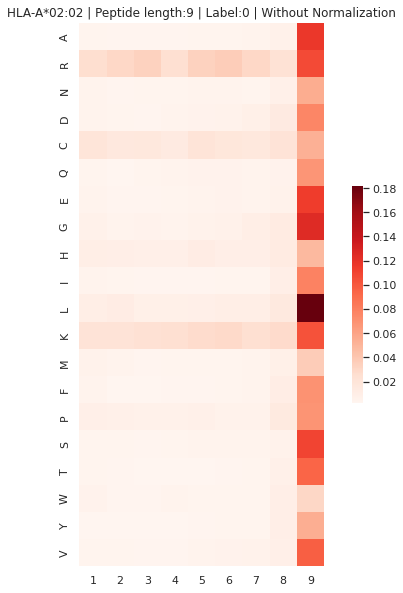



--------------------------


HLA and Label are filtered.
#Peptides: 6344
HLA: HLA-B*27:01
Threshold: 0.09
RRRRRRRKL

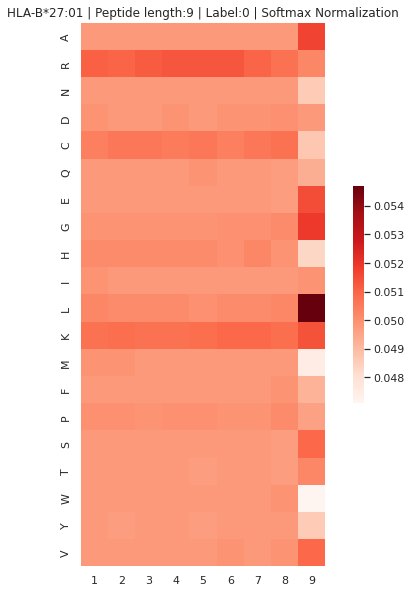

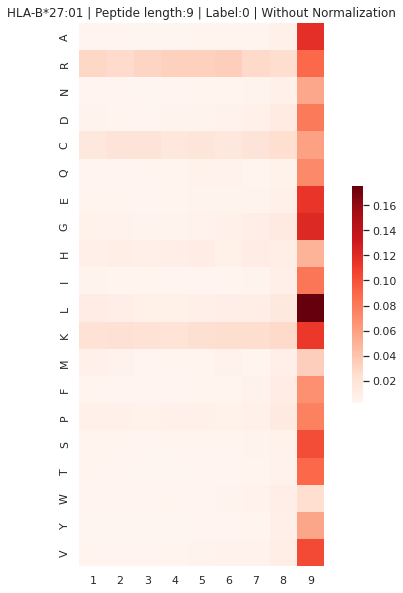



--------------------------


HLA and Label are filtered.
#Peptides: 27316
HLA: HLA-B*35:01
Threshold: 0.09
RRRRRRRRL

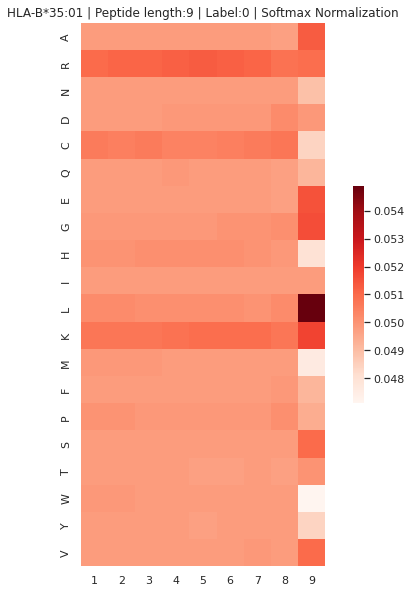

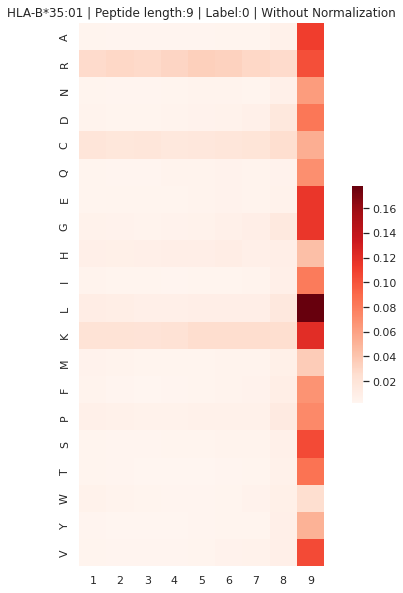



--------------------------


HLA and Label are filtered.
#Peptides: 1630
HLA: HLA-B*51:08
Threshold: 0.08
RRRRRRRCL

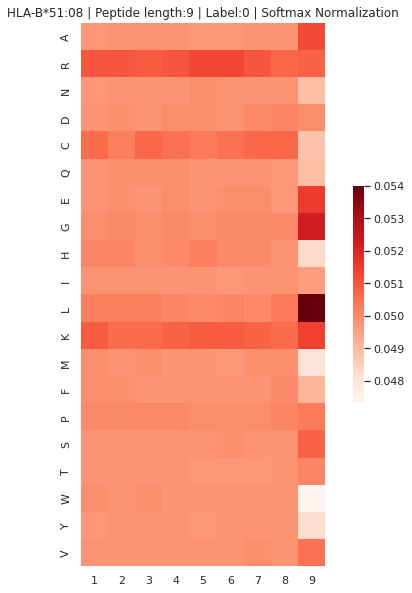

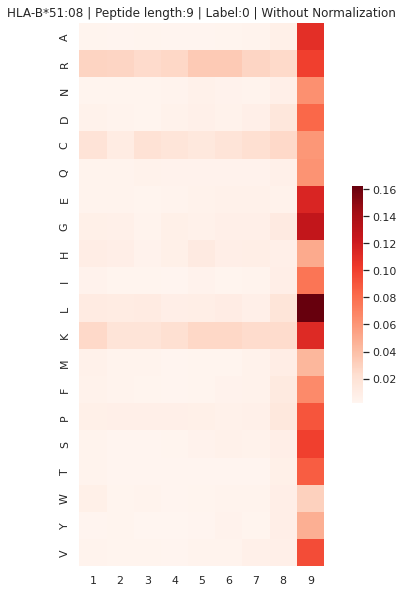



--------------------------


HLA and Label are filtered.
#Peptides: 6523
HLA: HLA-A*26:01
Threshold: 0.1
RRRRRRRRL

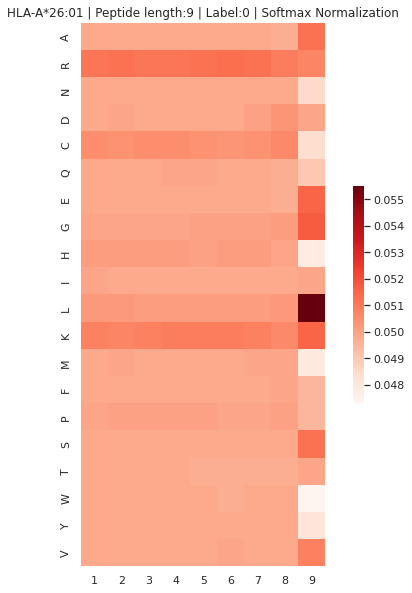

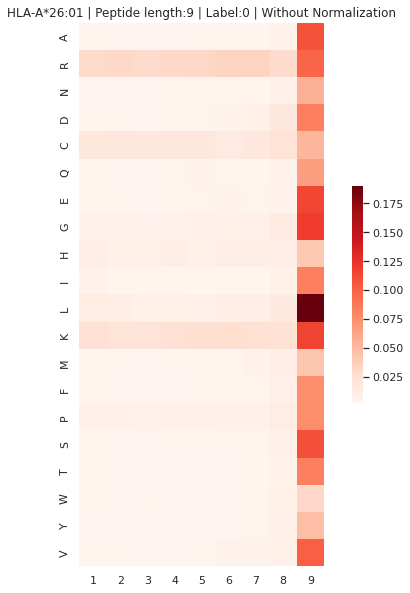



--------------------------


HLA and Label are filtered.
#Peptides: 13615
HLA: HLA-A*31:01
Threshold: 0.08
RRRRRRRRL

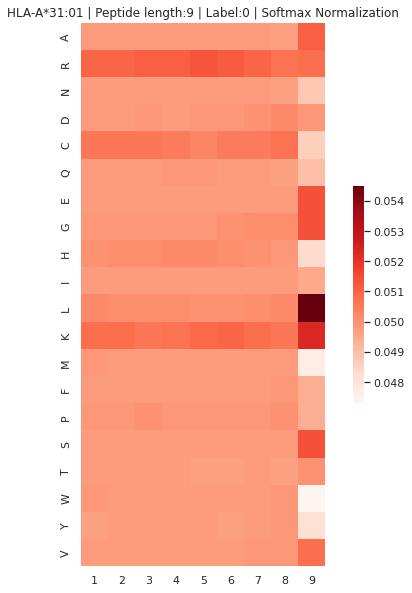

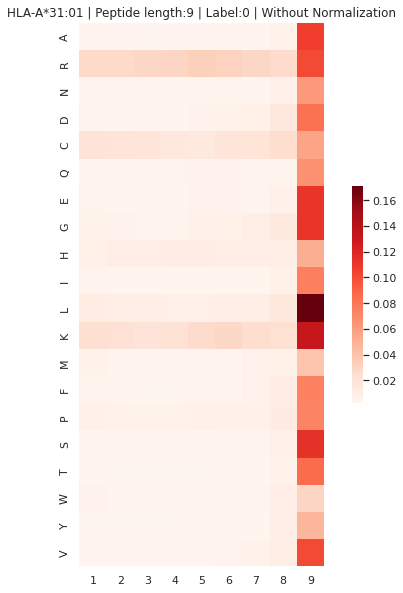



--------------------------


HLA and Label are filtered.
#Peptides: 1697
HLA: HLA-B*27:03
Threshold: 0.08
RRRRRKRKL

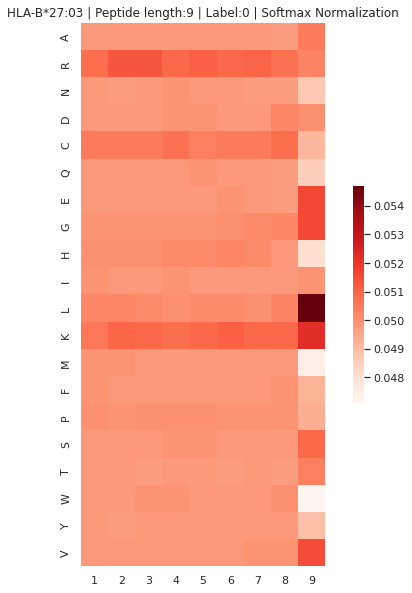

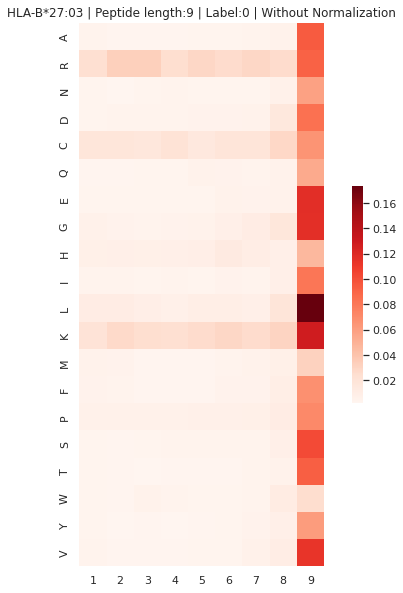



--------------------------


HLA and Label are filtered.
#Peptides: 4628
HLA: HLA-A*02:04
Threshold: 0.08
RRRRRRRRL

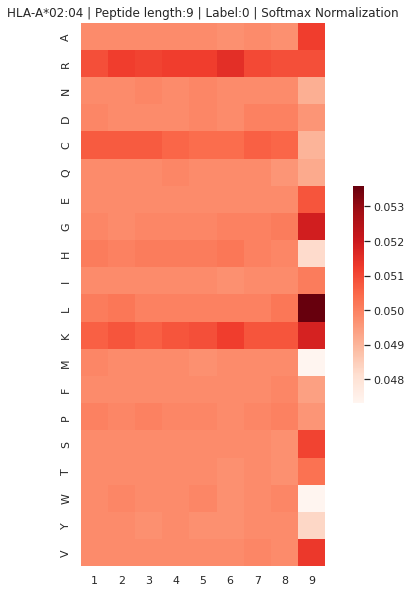

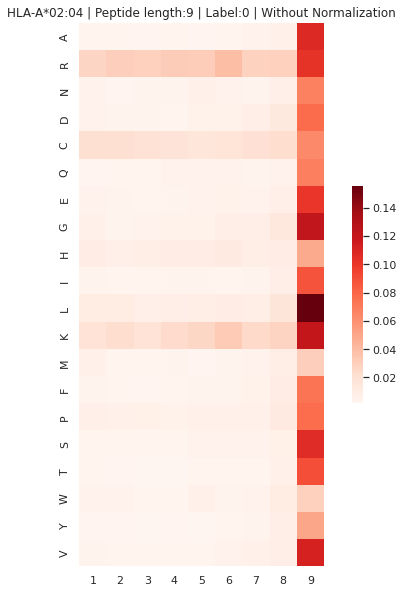



--------------------------


HLA and Label are filtered.
#Peptides: 7684
HLA: HLA-A*02:05
Threshold: 0.08
RRRRRRKRL

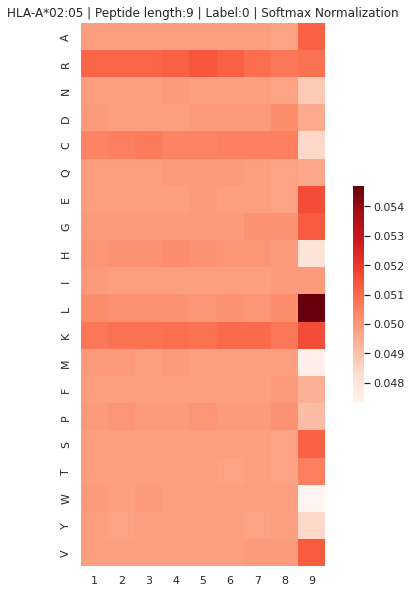

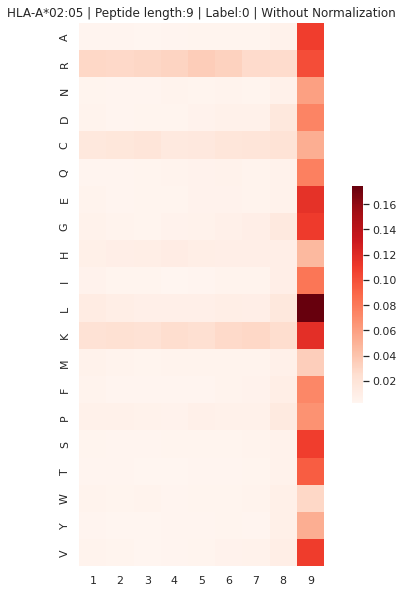



--------------------------


HLA and Label are filtered.
#Peptides: 7190
HLA: HLA-B*45:01
Threshold: 0.09
RRRRRRRKL

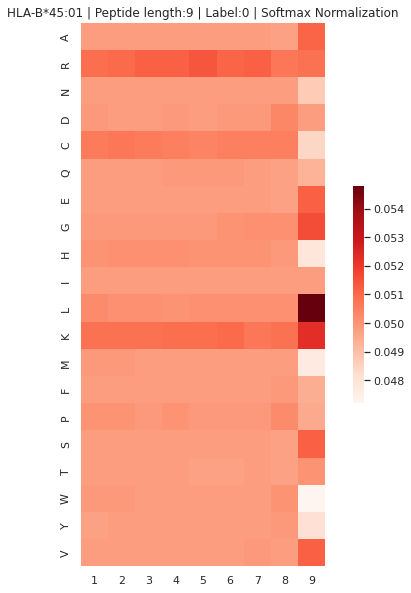

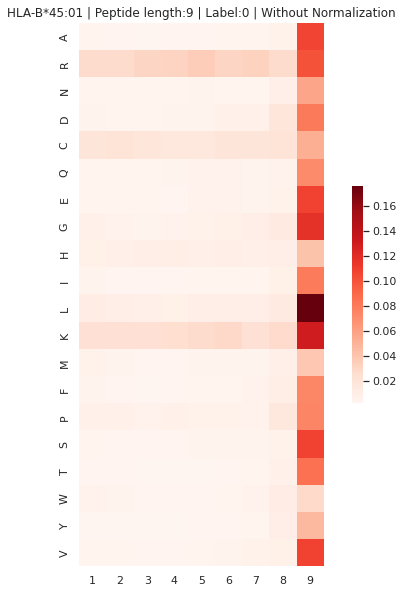



--------------------------


HLA and Label are filtered.
#Peptides: 13383
HLA: HLA-A*02:06
Threshold: 0.09
RRRRRRRKL

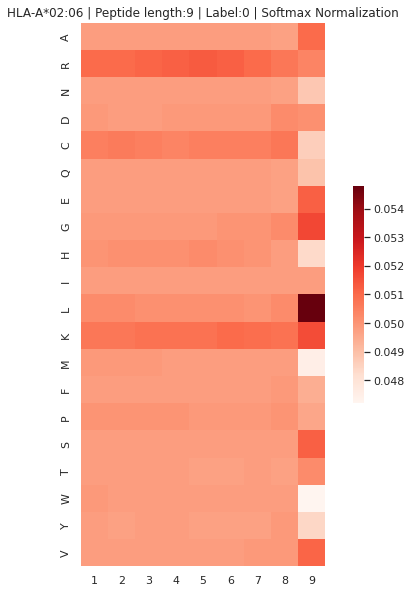

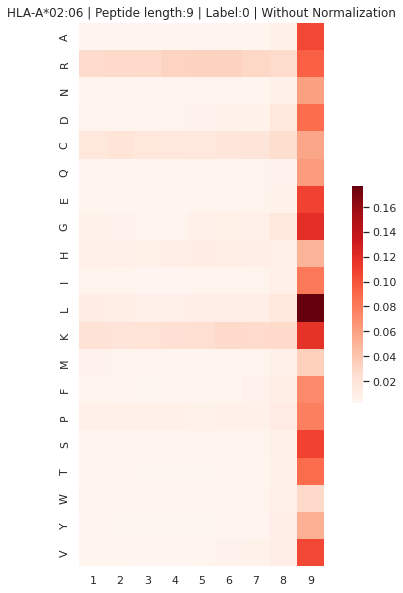



--------------------------


HLA and Label are filtered.
#Peptides: 3367
HLA: HLA-A*02:20
Threshold: 0.09
RRRRRRRRL

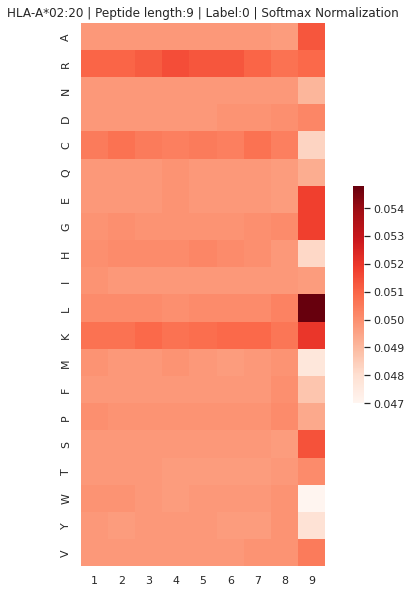

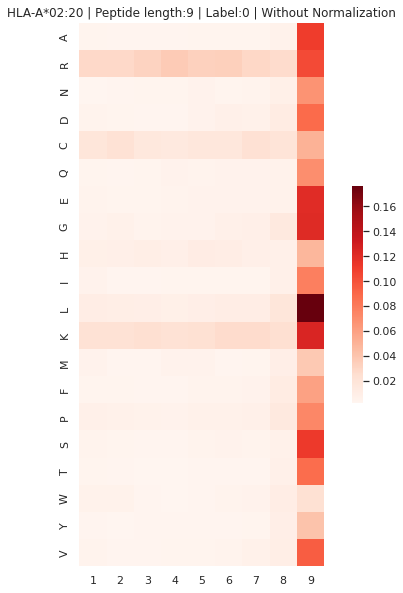



--------------------------


HLA and Label are filtered.
#Peptides: 1651
HLA: HLA-B*15:17
Threshold: 0.08
RRRRRKRKL

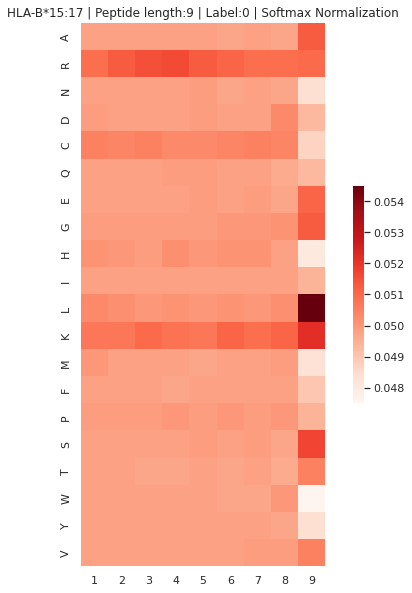

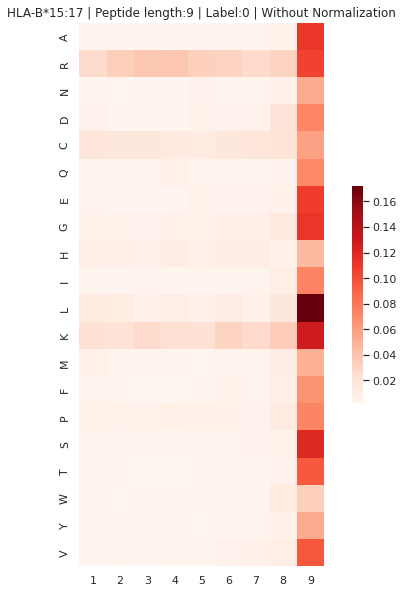



--------------------------


HLA and Label are filtered.
#Peptides: 17491
HLA: HLA-A*01:01
Threshold: 0.08
RRRRRRRRL

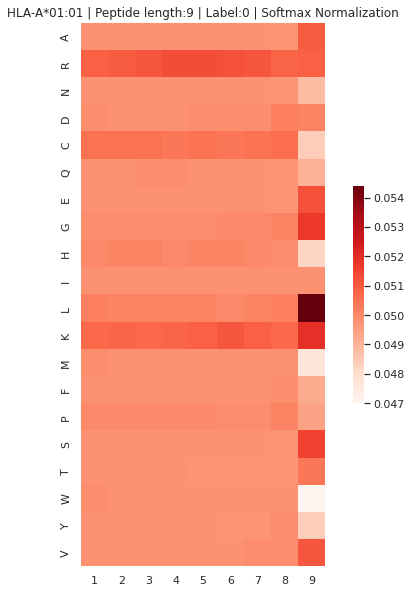

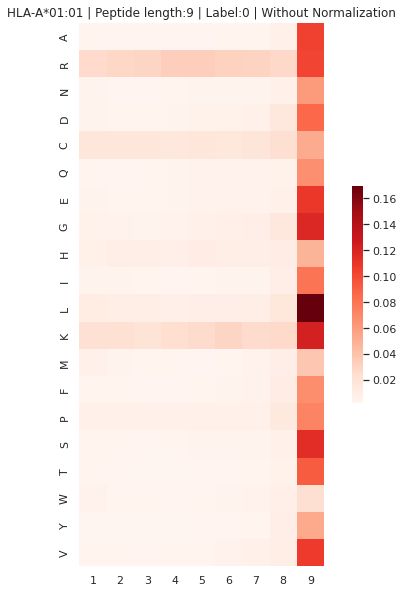



--------------------------


HLA and Label are filtered.
#Peptides: 4305
HLA: HLA-B*27:02
Threshold: 0.08
RRRRRRRCL

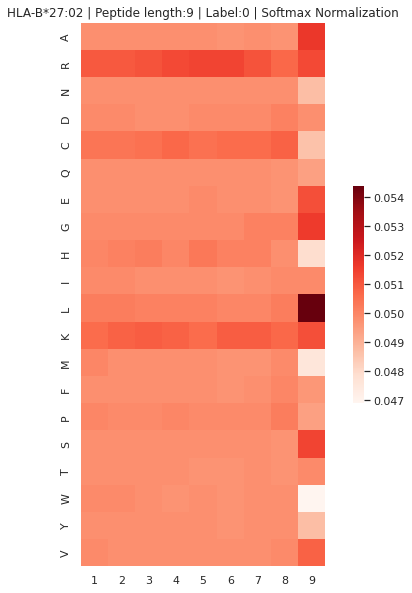

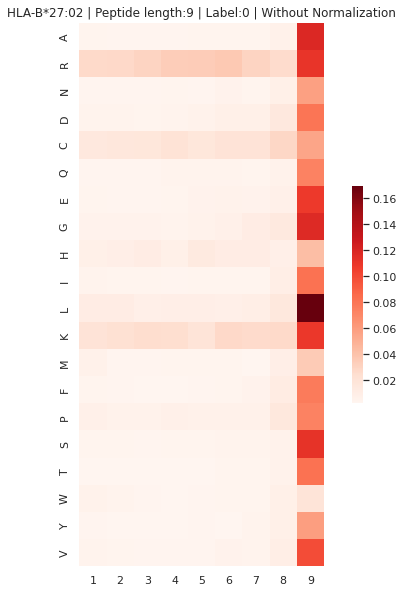



--------------------------


HLA and Label are filtered.
#Peptides: 18413
HLA: HLA-B*44:02
Threshold: 0.08
RRRRRRRKL

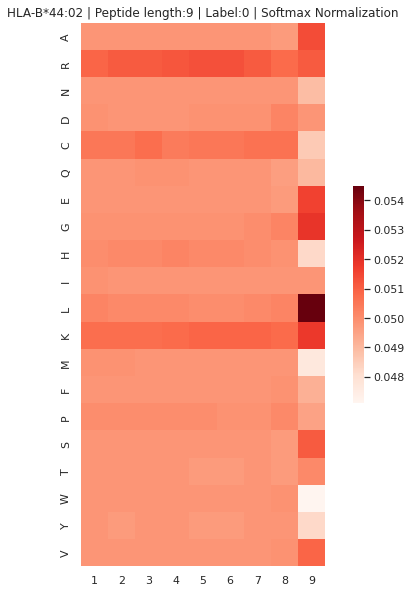

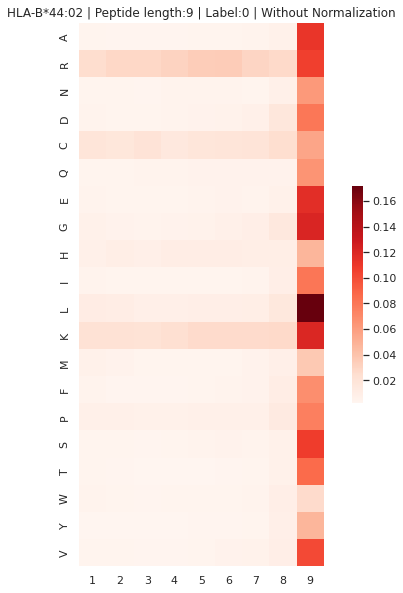



--------------------------


HLA and Label are filtered.
#Peptides: 790
HLA: HLA-A*26:02
Threshold: 0.1
RRRRRRRRL

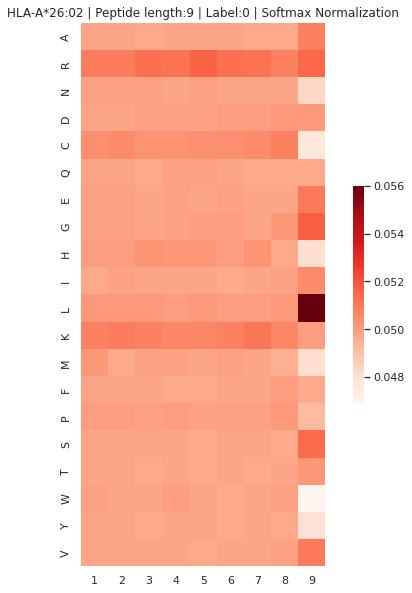

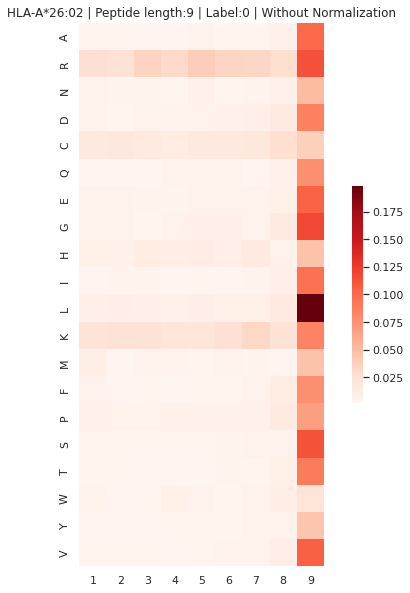



--------------------------


HLA and Label are filtered.
#Peptides: 1294
HLA: HLA-A*24:03
Threshold: 0.1
RRRRRRRCL

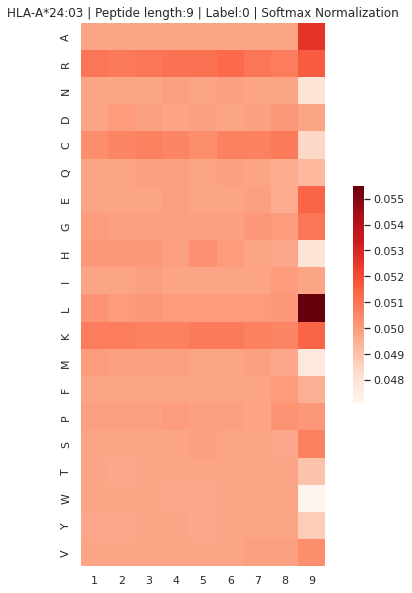

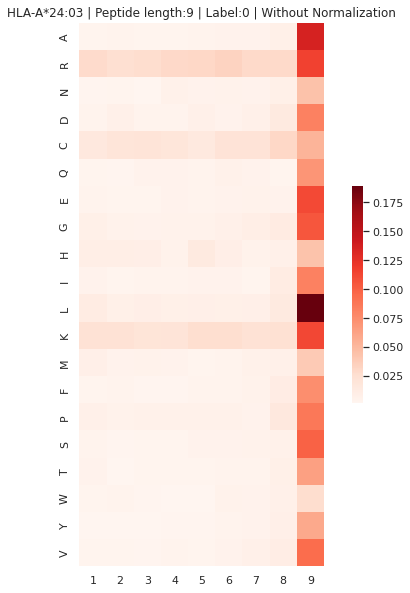



--------------------------


HLA and Label are filtered.
#Peptides: 10888
HLA: HLA-A*02:03
Threshold: 0.09
RRRRRRRKL

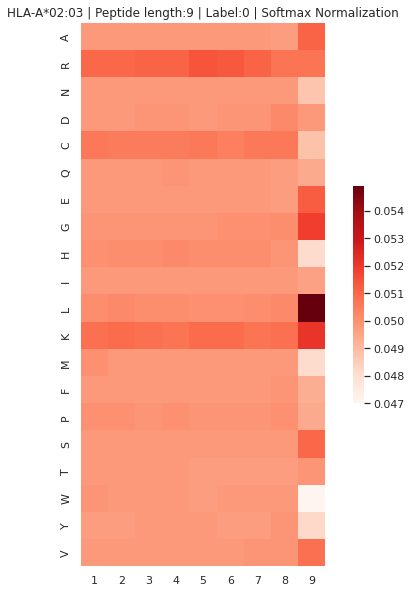

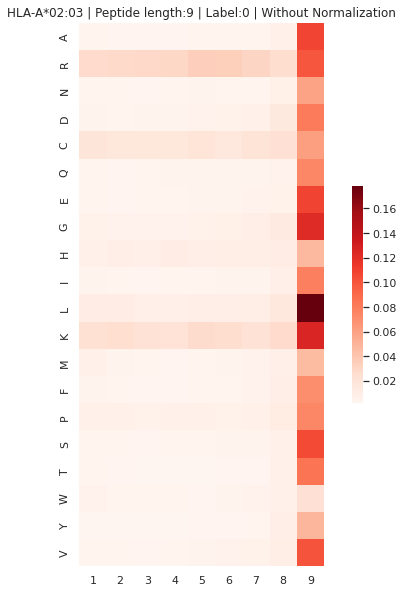



--------------------------


HLA and Label are filtered.
#Peptides: 5165
HLA: HLA-A*30:01
Threshold: 0.08
RRRRRRRKL

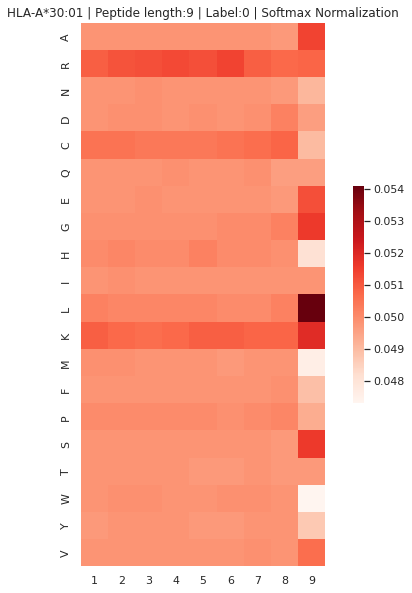

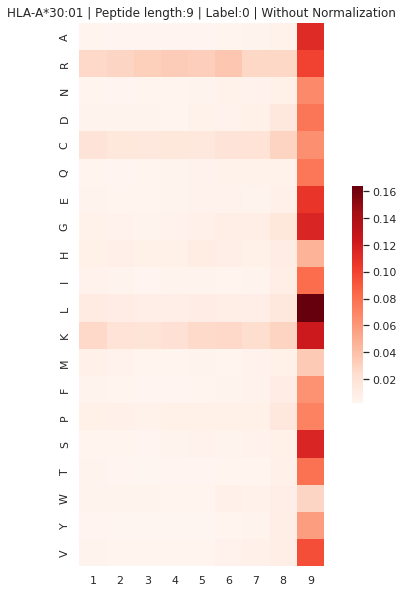

In [40]:
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))
for HLA_filter in HLA_list:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 0 , length = 9 , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    

#Peptides: 334732
HLA: None
Threshold: 0.19
RRRKRRRLLLLWYY

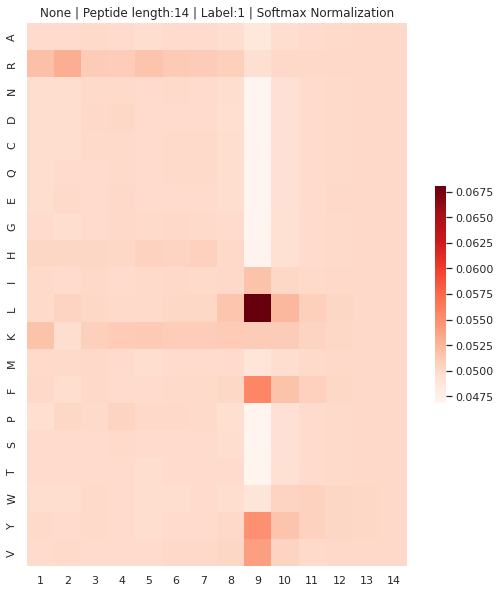

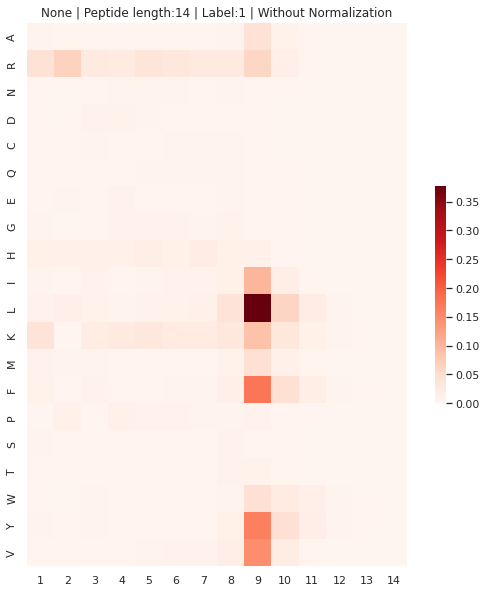

In [55]:
corr = True 

softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = None , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    




--------------------------
[      1      57      64 ... 1864603 1864609 1864616]
#Peptides: 59550
HLA: None
Threshold: 0.07
RRRRRRRL

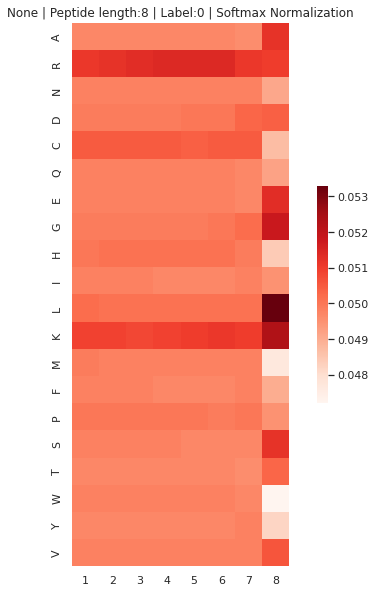

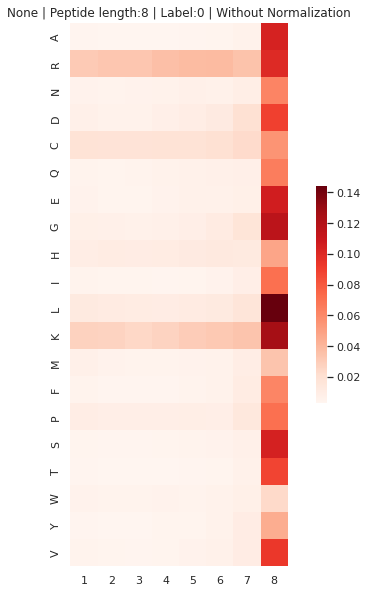

[0.04999499999999999, 0.04999499999999999, 0.04999499999999999, 0.04999499999999999, 0.04999499999999999, 0.05000499999999999, 0.04999499999999999, 0.049995]
[0.009094633690155823, 0.008559111370147527, 0.008322597602953136, 0.00904848018361179, 0.009973003268942526, 0.010950373139529544, 0.013728318298493586, 0.08032336743512541]


--------------------------
[      0       5       8 ... 1864615 1864617 1864618]
#Peptides: 948721
HLA: None
Threshold: 0.08
RRRRRRRRL

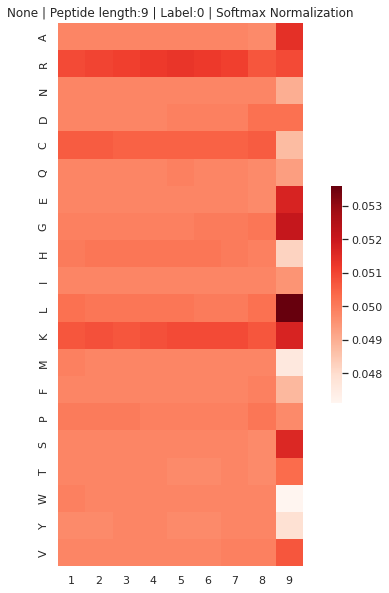

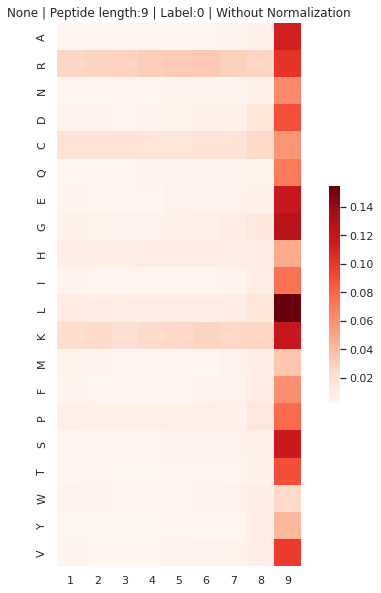

[0.04998999999999999, 0.04998999999999999, 0.04998999999999999, 0.04999499999999999, 0.05000499999999999, 0.04999499999999999, 0.04999999999999999, 0.04998999999999999, 0.05]
[0.0076866567342498155, 0.007259518799067706, 0.006900691781119413, 0.00720696342379553, 0.007902297859680954, 0.008429022197940537, 0.00851529185720005, 0.012040392324903738, 0.08404940508804089]


--------------------------
[      7      16      32 ... 1864599 1864602 1864614]
#Peptides: 228449
HLA: None
Threshold: 0.07
RRRRRRRRCL

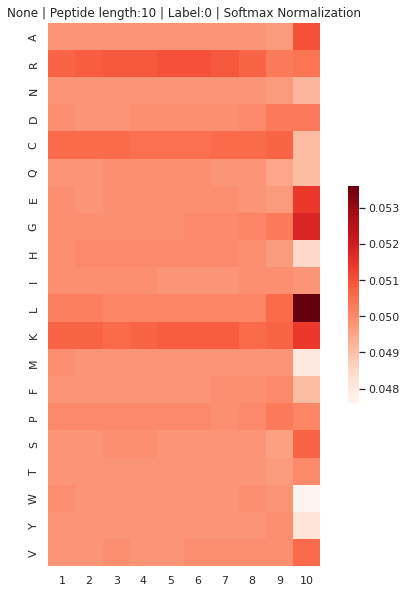

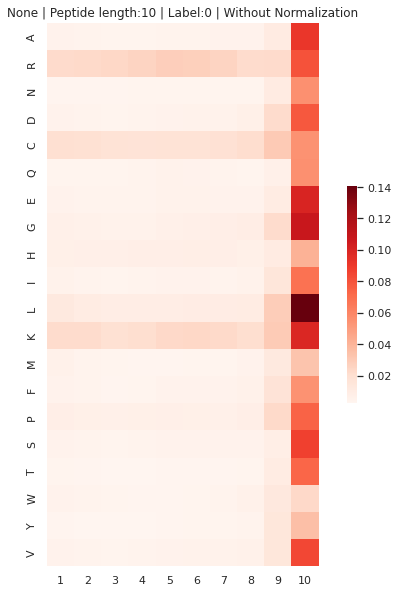

[0.04999499999999999, 0.04998499999999999, 0.04999999999999999, 0.04999999999999999, 0.04999999999999999, 0.050009999999999985, 0.05000499999999999, 0.04999999999999999, 0.050005, 0.05]
[0.007930387188506617, 0.007348610423493726, 0.006920281027789912, 0.007198804781014446, 0.007895583077499484, 0.008141144108613958, 0.007941490252055369, 0.008225780069420752, 0.016608271881371095, 0.07178926218215007]


--------------------------
[      2      24      35 ... 1864592 1864594 1864619]
#Peptides: 101964
HLA: None
Threshold: 0.04
CCCRRRCCCLL

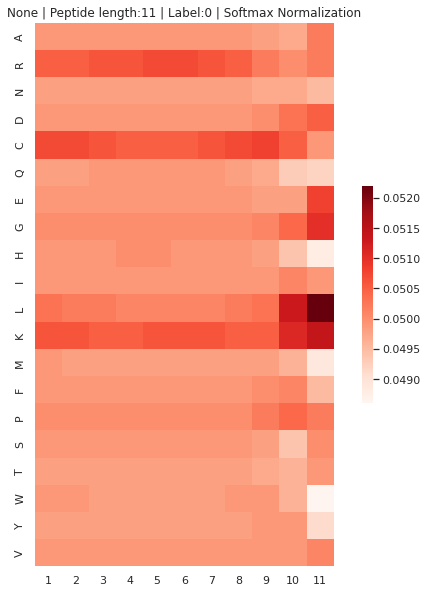

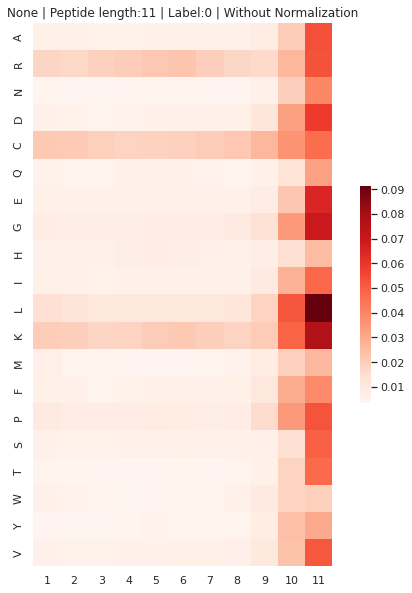

[0.05001499999999999, 0.05000499999999999, 0.05, 0.04999499999999999, 0.050005, 0.04999999999999999, 0.04999999999999999, 0.04999999999999999, 0.04999, 0.050005, 0.049995000000000005]
[0.008413187079130142, 0.007725657117048318, 0.007285957490564034, 0.007514841690952391, 0.008216527006755294, 0.008370053584370542, 0.008012349103020965, 0.008084400594971019, 0.011203722022045618, 0.026436405571719855, 0.048736872580813606]


--------------------------
[     46      60      99 ... 1864415 1864443 1864559]
#Peptides: 40783
HLA: None
Threshold: 0.04
CCCCCCCCCLKL

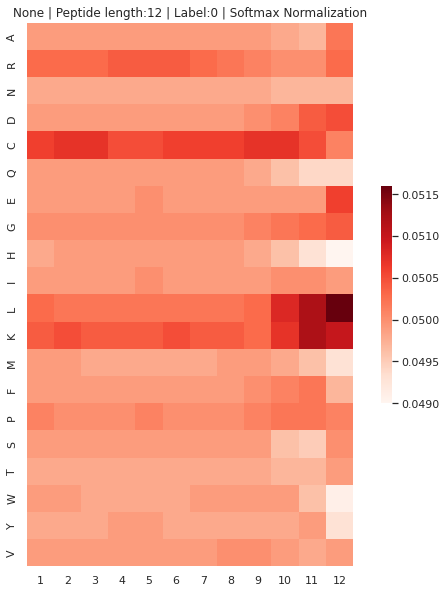

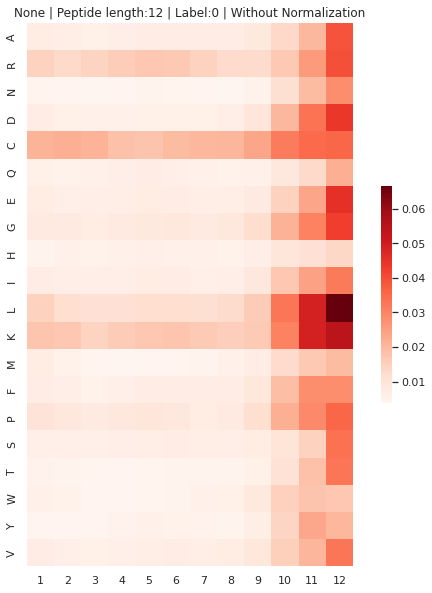

[0.04999499999999999, 0.04999999999999999, 0.04998499999999999, 0.049985, 0.05, 0.04998999999999999, 0.04998499999999999, 0.04998999999999999, 0.049999999999999996, 0.05000499999999999, 0.050005, 0.05]
[0.008503292708470219, 0.007848624115854512, 0.007397592243976264, 0.00763417961311981, 0.008196545552182006, 0.008247161345919974, 0.007891302518220483, 0.007874432021200143, 0.009837927613804264, 0.01726041118069119, 0.025155970094027574, 0.03415253558803224]


--------------------------
[     51     242     295 ... 1864427 1864510 1864520]
#Peptides: 20443
HLA: None
Threshold: 0.02
CCCCCCCCCCKLL

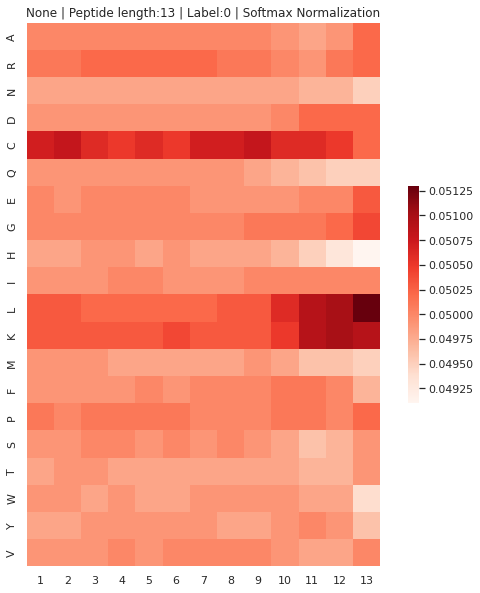

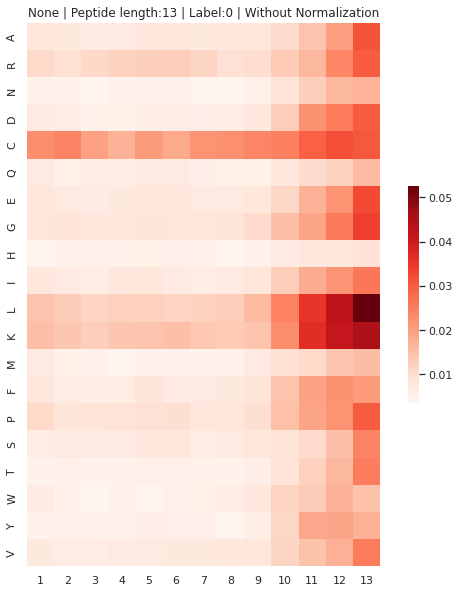

[0.04999499999999999, 0.049995, 0.050005, 0.050005, 0.049995, 0.05, 0.049995, 0.049995, 0.05000499999999999, 0.050005, 0.049995, 0.049995, 0.05]
[0.008415736012896616, 0.007784189415416541, 0.0072069278279086975, 0.007459530184041882, 0.008134087563167492, 0.008009821210642042, 0.007675614749091318, 0.007666756489479463, 0.008966595185501015, 0.013019217562198473, 0.01782854212034252, 0.0215631999352764, 0.02626978431914013]


--------------------------
[    223     352    1563 ... 1863955 1863988 1864062]
#Peptides: 10676
HLA: None
Threshold: 0.02
CCCCCCCCCCKKLL

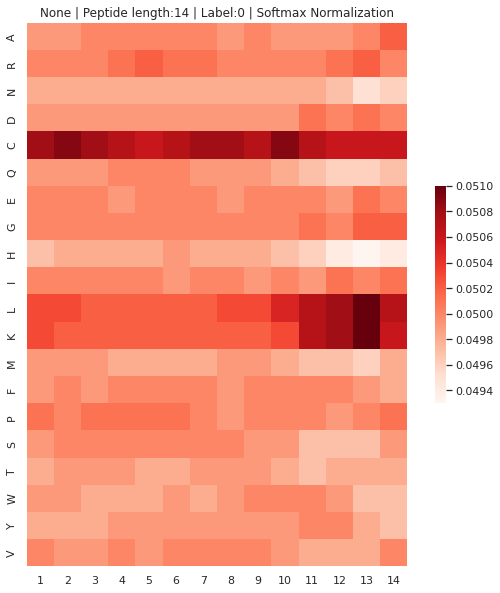

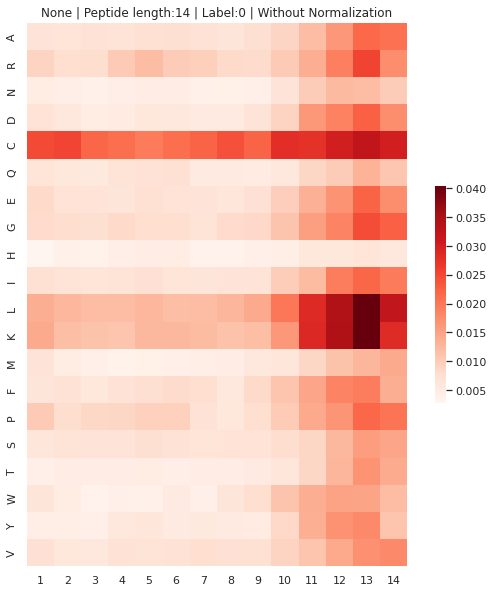

[0.049995, 0.050005, 0.049995, 0.050005, 0.05, 0.05001, 0.050005, 0.04999500000000001, 0.05000500000000001, 0.050005, 0.05000500000000001, 0.049984999999999995, 0.04999499999999999, 0.049995]
[0.008249112692340207, 0.007597036279511836, 0.007099503138039432, 0.007496638528502983, 0.007930392582973051, 0.007847655029411215, 0.0073826348750320615, 0.007422184274186799, 0.007999739945269828, 0.01050164520003546, 0.014305256814624365, 0.01768548693179906, 0.020970642401422622, 0.017512054843552418]


In [29]:
for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 0 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.mean(axis=0)))
    print(list(unsoftmax_pd.mean(axis=0)))    



--------------------------


HLA and Label are filtered.
#Peptides: 14952
HLA: None
Threshold: 0.36
RRRKRRKL

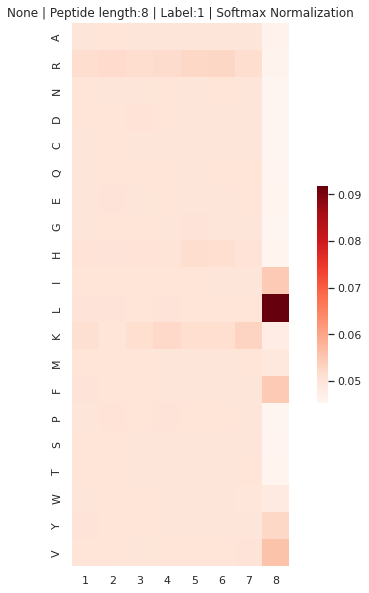

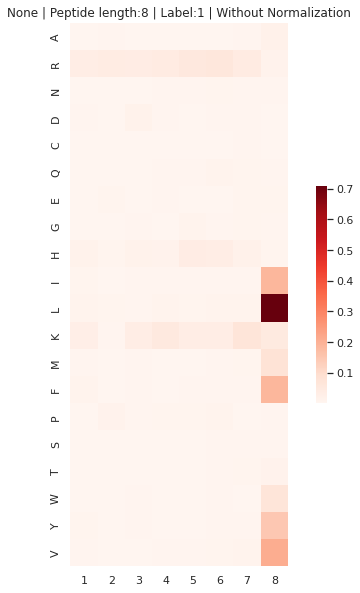

[0.049995, 0.049999999999999996, 0.04999499999999999, 0.050005, 0.05000499999999999, 0.05000499999999999, 0.05000499999999999, 0.049985]
[0.007928632790548652, 0.005705938972592546, 0.008009421111046152, 0.008757709028122578, 0.010076756372752838, 0.011113338626088019, 0.011903514640097824, 0.08650454767825708]


--------------------------


HLA and Label are filtered.
#Peptides: 240156
HLA: None
Threshold: 0.27
RRRKRRRKL

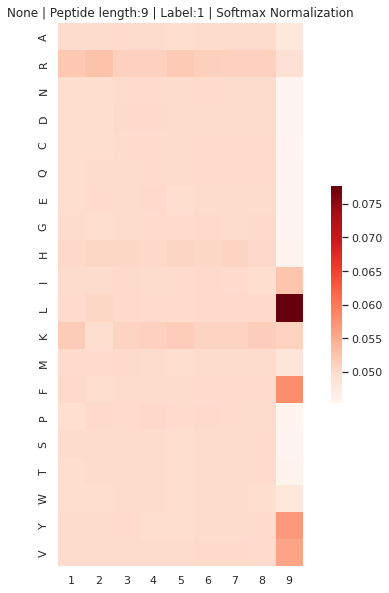

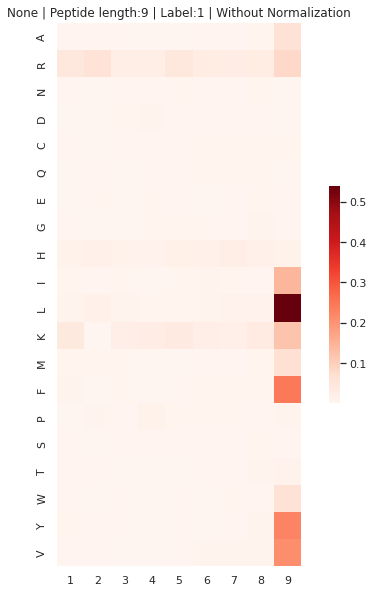

[0.04998999999999999, 0.04998999999999999, 0.05001, 0.05001, 0.049999999999999996, 0.050015, 0.050009999999999985, 0.050005, 0.050005]
[0.008129952515753474, 0.0068470452190364794, 0.006139932034340846, 0.006417785086930636, 0.008329692092046908, 0.007171047526281582, 0.007702984685422412, 0.008842811285213439, 0.09041810998688052]


--------------------------


HLA and Label are filtered.
#Peptides: 58415
HLA: None
Threshold: 0.18
RRRKKKKRKL

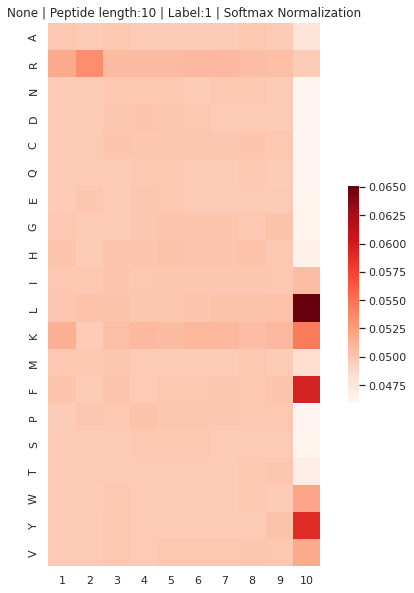

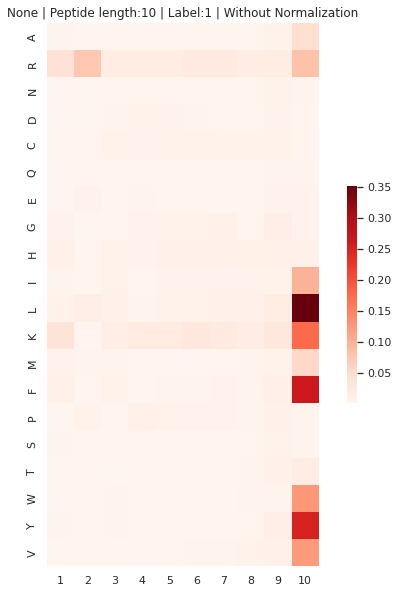

[0.04999999999999999, 0.04999499999999999, 0.05001, 0.05000499999999999, 0.05000499999999999, 0.050009999999999985, 0.05000499999999999, 0.050005, 0.05, 0.049999999999999996]
[0.00824538143960864, 0.007451510265715713, 0.006249633001503671, 0.006273937073511425, 0.006858426758272235, 0.007376451571489927, 0.007248290464464427, 0.00712897912857825, 0.011255651929653393, 0.08191169489963632]


--------------------------


HLA and Label are filtered.
#Peptides: 26184
HLA: None
Threshold: 0.12
RRRKKKKKLKL

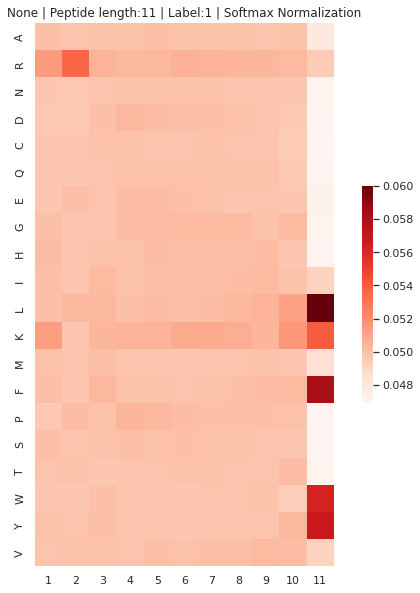

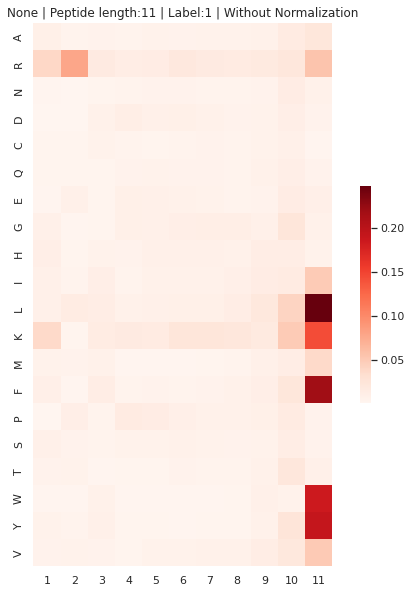

[0.050005, 0.049995, 0.05, 0.04999999999999999, 0.050009999999999985, 0.049995, 0.05001, 0.049995, 0.049995, 0.05001, 0.049995]
[0.008655390872745531, 0.008291433466125476, 0.006927406332596996, 0.006400232857023217, 0.006796605689715729, 0.007414028639462685, 0.007120102252429901, 0.007298886342548357, 0.009591147209794523, 0.018574559065751478, 0.06293021656488593]


--------------------------


HLA and Label are filtered.
#Peptides: 10798
HLA: None
Threshold: 0.08
KRFKPKKKGLLW

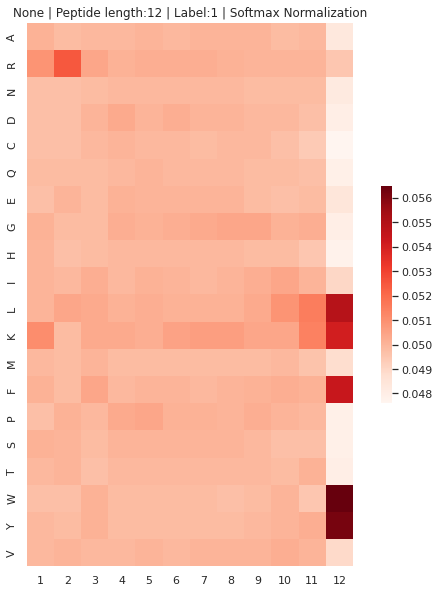

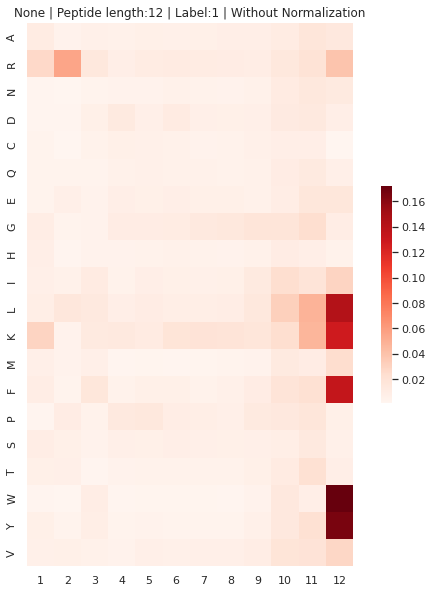

[0.05, 0.05, 0.049995, 0.05, 0.05001, 0.05, 0.049995, 0.05, 0.049995, 0.050005, 0.05, 0.050015]
[0.00833190201520699, 0.007626943054806859, 0.007419043749565325, 0.006800710945178853, 0.007308758989840354, 0.007395252534075343, 0.007101446099801514, 0.007118188268411025, 0.008859555282776477, 0.01489085324452219, 0.019198349657533875, 0.047949009812480986]


--------------------------


HLA and Label are filtered.
#Peptides: 5547
HLA: None
Threshold: 0.08
KRFPPKKGGGLKY

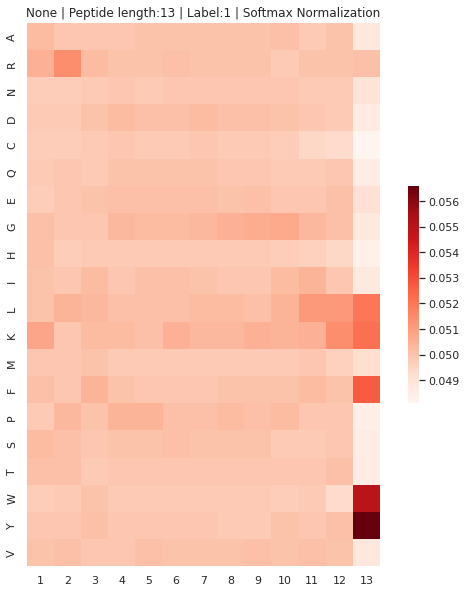

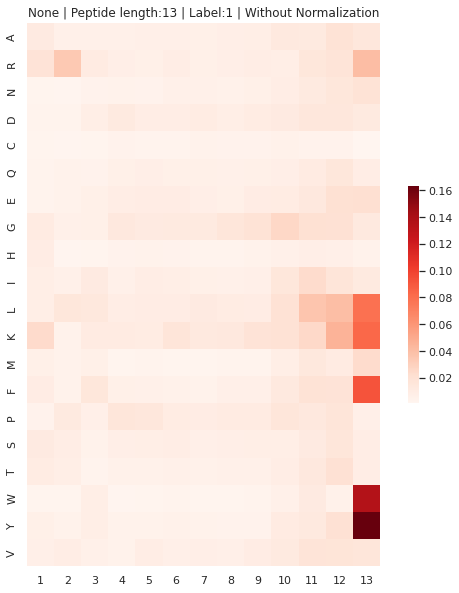

[0.050005, 0.05001, 0.05, 0.05, 0.049995, 0.05001, 0.050005, 0.049995, 0.05001, 0.05, 0.05, 0.04998500000000001, 0.04999]
[0.008168678067064467, 0.007252743645188872, 0.00727950570302674, 0.006976439214857373, 0.007271653879047707, 0.007426535023726577, 0.006890130210657775, 0.00706715691255109, 0.00820744359559877, 0.011710944604675944, 0.015489871106062664, 0.01807385759781734, 0.03818503487791395]


--------------------------


HLA and Label are filtered.
#Peptides: 3114
HLA: None
Threshold: 0.04
SRFGPGGGGGGKKY

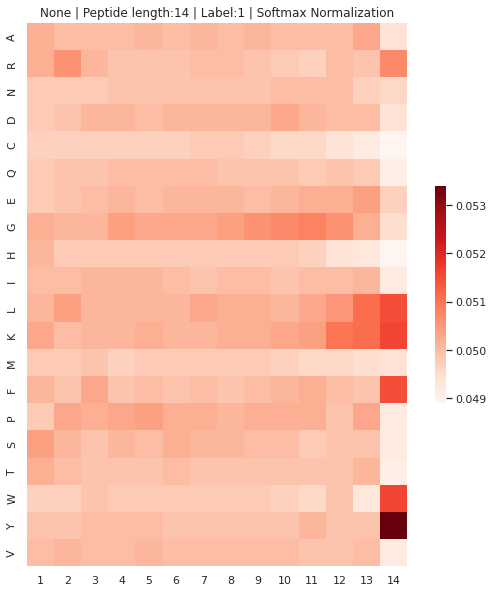

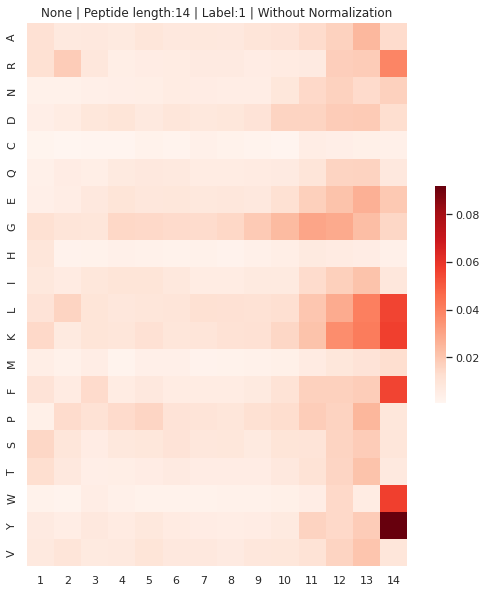

[0.049995, 0.049995, 0.04999500000000001, 0.049995000000000005, 0.050005, 0.04999, 0.050005, 0.049995, 0.05, 0.05, 0.049995, 0.05000000000000001, 0.05, 0.050005]
[0.00789238524574765, 0.007120891993981413, 0.00716547707984596, 0.007058065237720272, 0.007702412594566763, 0.007211301482941144, 0.006850996588619382, 0.006839012624977029, 0.007485295253146054, 0.009442990179925528, 0.013440395703128919, 0.017223359777441986, 0.019484309240572713, 0.02508310359031173]


In [32]:
softmax_pd_g_1 = []
unsoftmax_pd_g_1 = []

for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.mean(axis=0)))
    print(list(unsoftmax_pd.mean(axis=0)))  
    softmax_pd_g_1.append(list(softmax_pd.mean(axis=0)))
    unsoftmax_pd_g_.append(list(unsoftmax_pd.mean(axis=0)))    



--------------------------


HLA and Label are filtered.
#Peptides: 3532
HLA: HLA-B*39:01
Threshold: 0.5
HHHRKRHKL

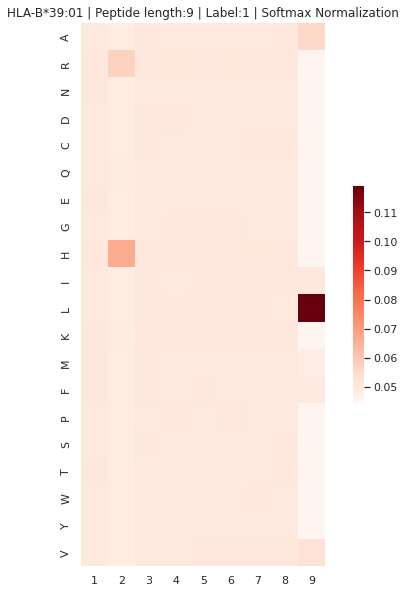

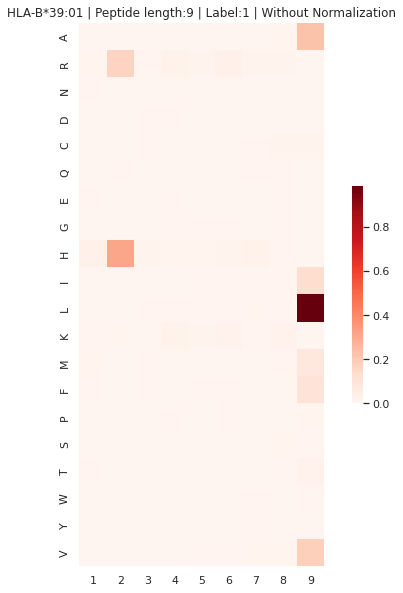

In [35]:
corr = False 

enc_attn_list_all = torch.from_numpy(np.array(enc_attn_list_all))    
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))
for HLA_filter in HLA_list[2::]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 1 , length = 9 , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    break



--------------------------


HLA and Label are filtered.
#Peptides: 3532
HLA: HLA-B*39:01
Threshold: 0.5
HHHRKRHKL

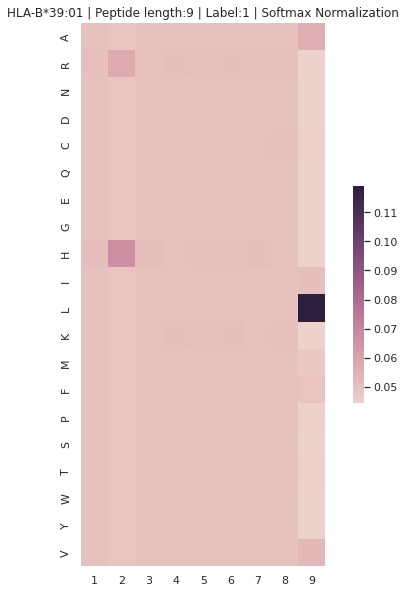

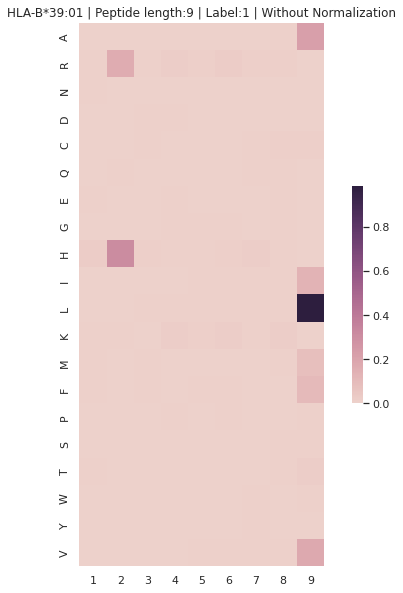

In [59]:
corr = False 

enc_attn_list_all = torch.from_numpy(np.array(enc_attn_list_all))    
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))
for HLA_filter in HLA_list[2::]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 1 , length = 9 , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    break



--------------------------


HLA and Label are filtered.
#Peptides: 750
HLA: HLA-B*27:08
Threshold: 0.31
IRLLIIWEL

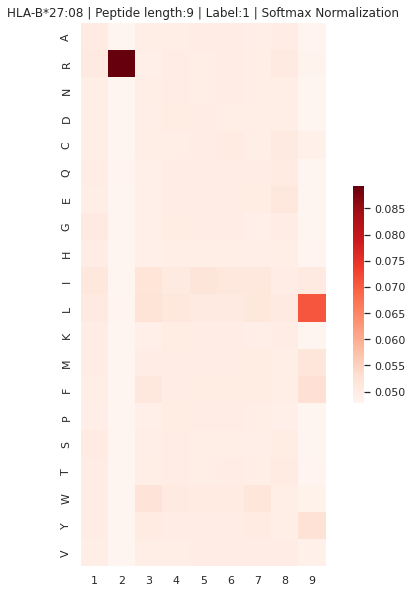

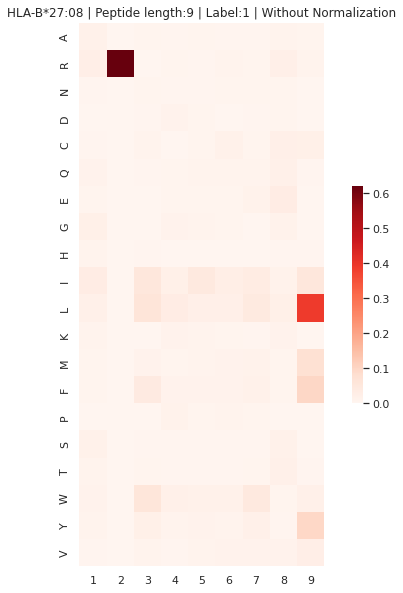



--------------------------


HLA and Label are filtered.
#Peptides: 3247
HLA: HLA-A*31:01
Threshold: 0.4
RLLLIIILR

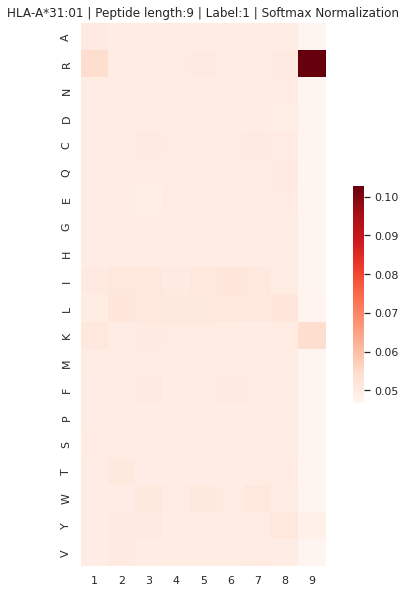

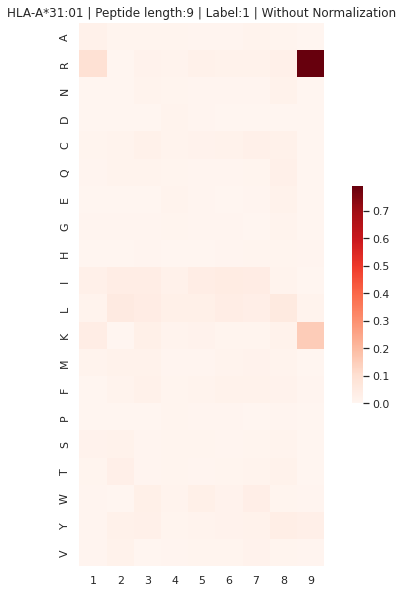



--------------------------


HLA and Label are filtered.
#Peptides: 3396
HLA: HLA-A*68:02
Threshold: 0.16
ELIRIIWRL

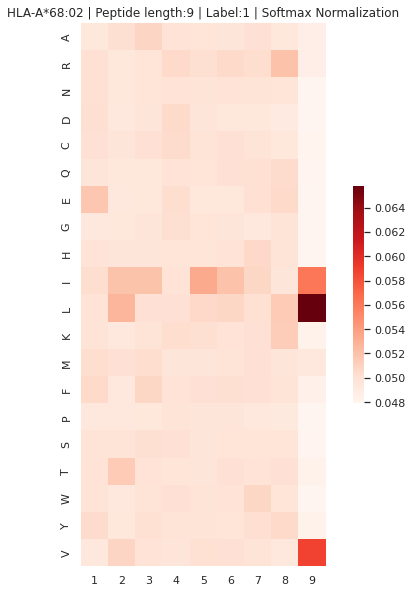

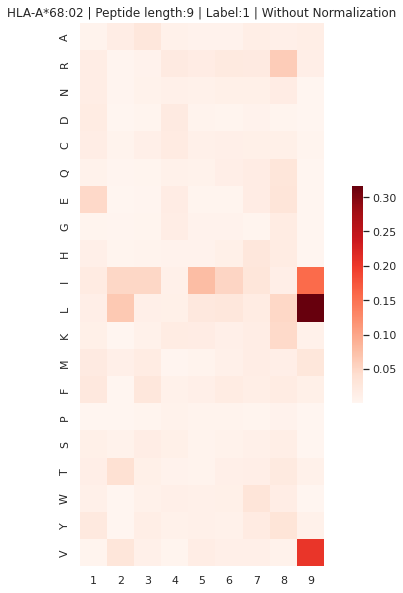



--------------------------


HLA and Label are filtered.
#Peptides: 4394
HLA: HLA-B*44:02
Threshold: 0.24
EEILRRRRW

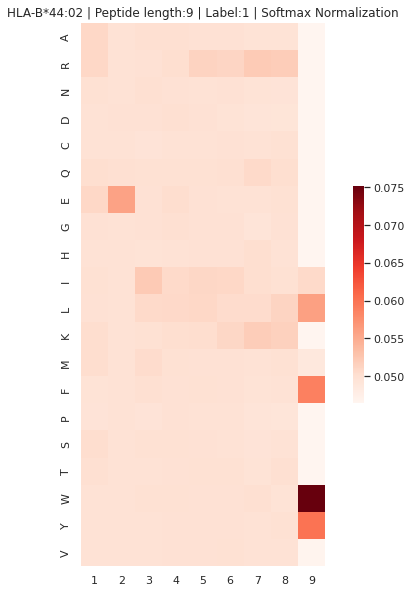

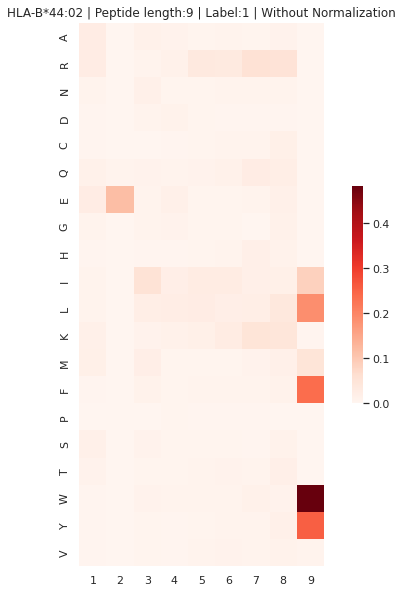



--------------------------


HLA and Label are filtered.
#Peptides: 1462
HLA: HLA-C*14:02
Threshold: 0.26
RYIRRRREL

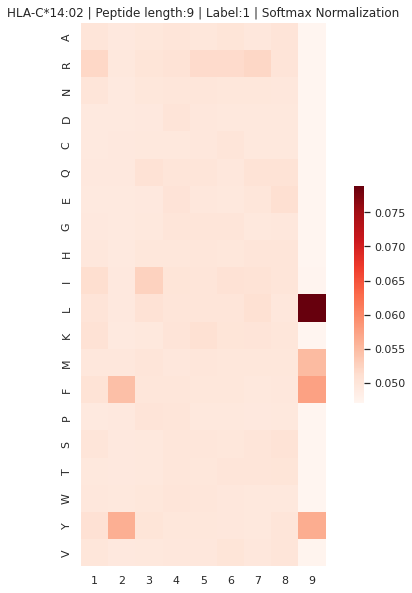

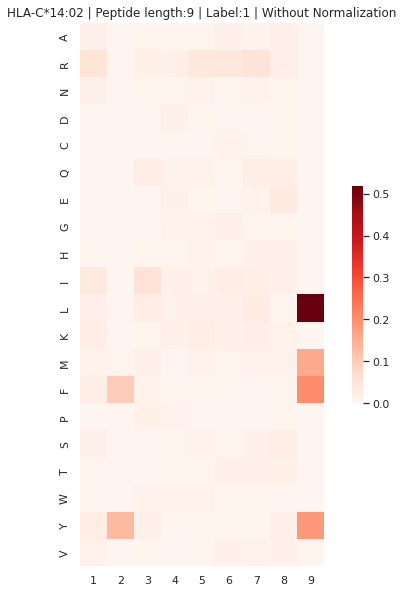



--------------------------


HLA and Label are filtered.
#Peptides: 1230
HLA: HLA-A*30:01
Threshold: 0.11
RIRIIWLLK

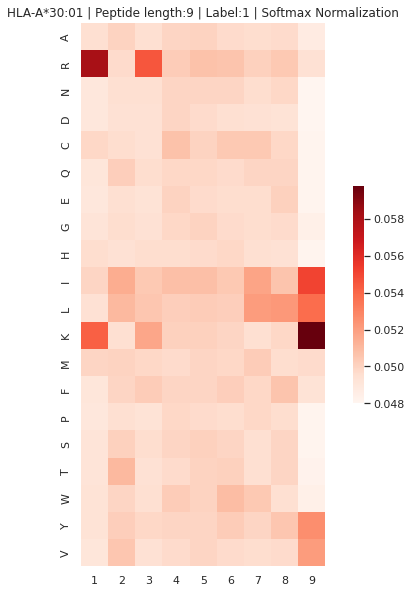

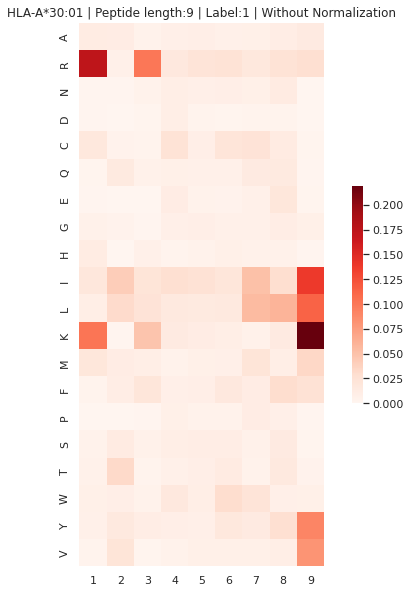



--------------------------


HLA and Label are filtered.
#Peptides: 276
HLA: HLA-A*02:12
Threshold: 0.11
KLWCWCWRL

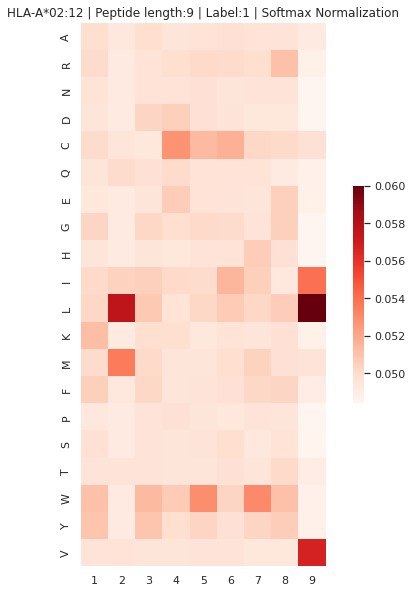

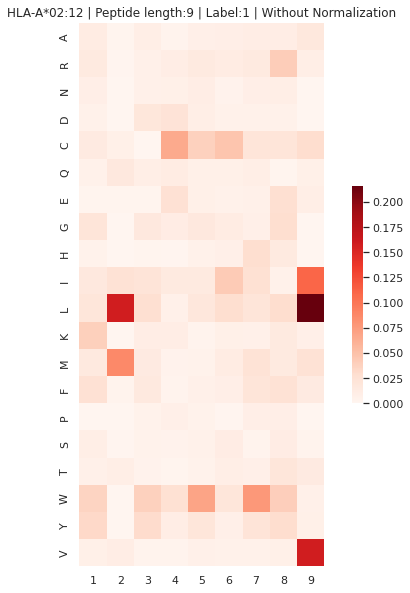



--------------------------


HLA and Label are filtered.
#Peptides: 4723
HLA: HLA-B*57:01
Threshold: 0.5
KTRKIIRLW

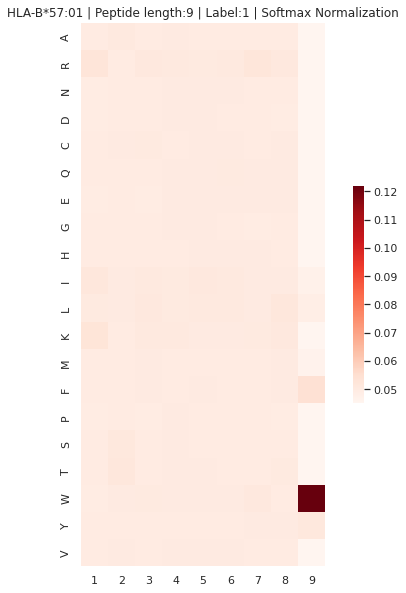

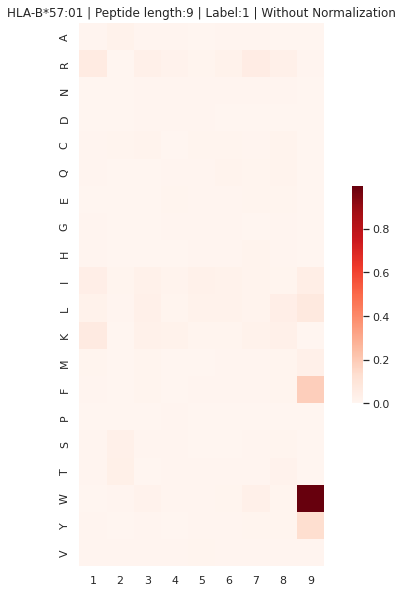



--------------------------


HLA and Label are filtered.
#Peptides: 128
HLA: HLA-B*18:03
Threshold: 0.18
DEWIRIRSL

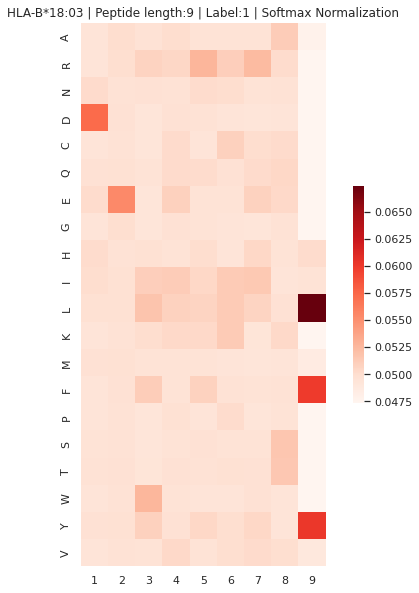

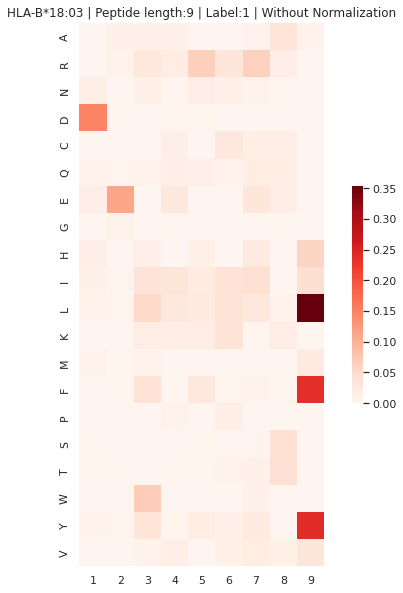



--------------------------


HLA and Label are filtered.
#Peptides: 5379
HLA: HLA-A*24:02
Threshold: 0.14
RYIRRLWLL

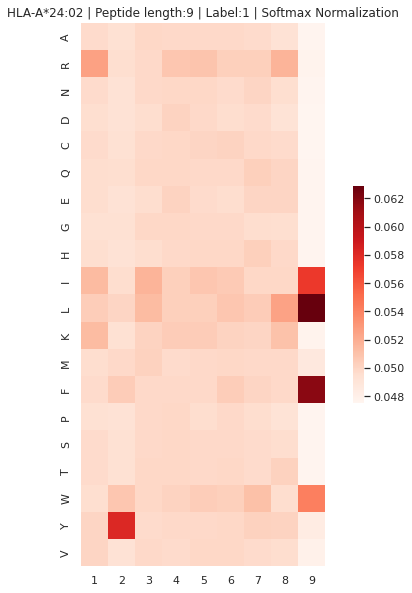

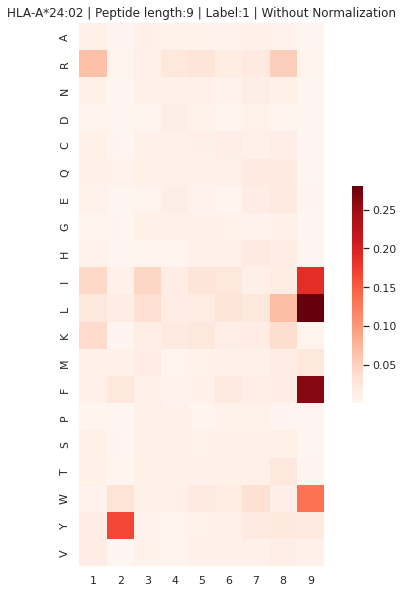



--------------------------


HLA and Label are filtered.
#Peptides: 2619
HLA: HLA-B*14:02
Threshold: 0.39
RRRLRRLSL

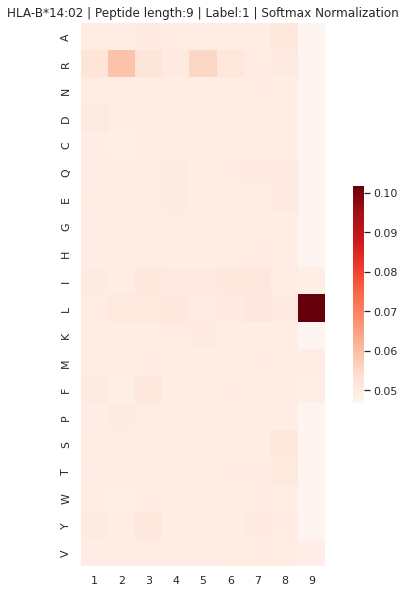

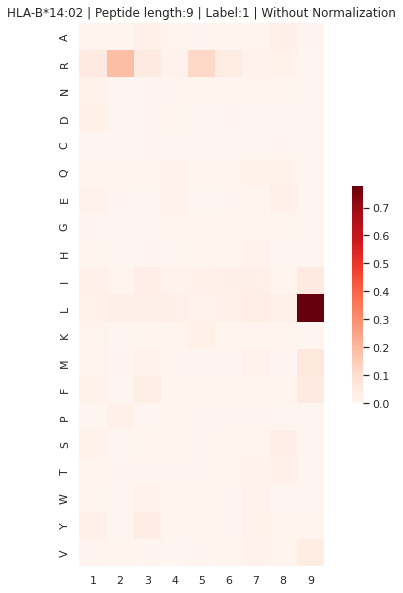



--------------------------


HLA and Label are filtered.
#Peptides: 66
HLA: HLA-A*26:03
Threshold: 0.16
WIICRWIWY

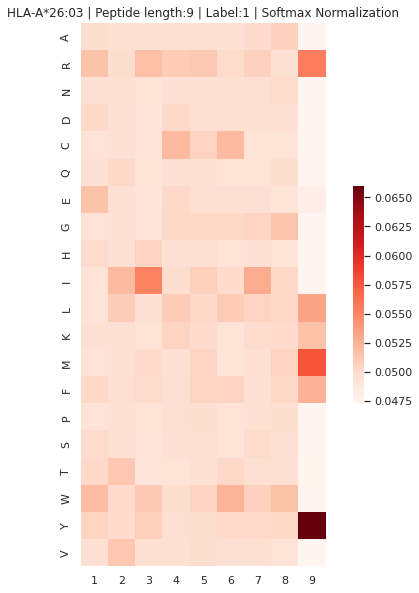

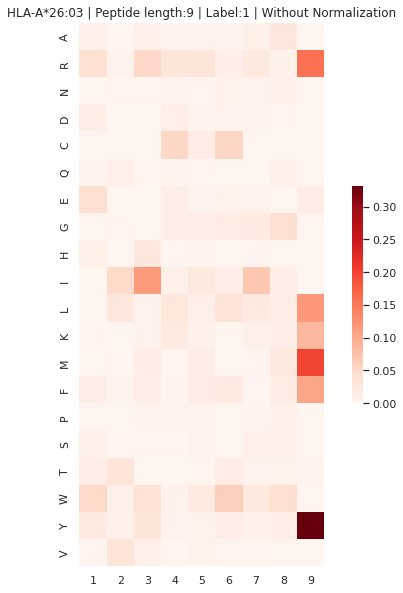



--------------------------


HLA and Label are filtered.
#Peptides: 308
HLA: HLA-A*24:03
Threshold: 0.14
RYLWLCWWF

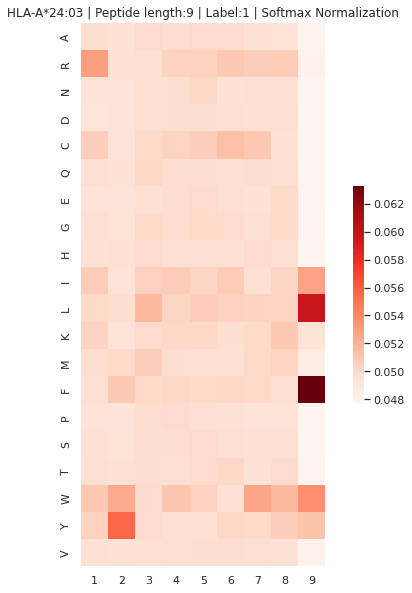

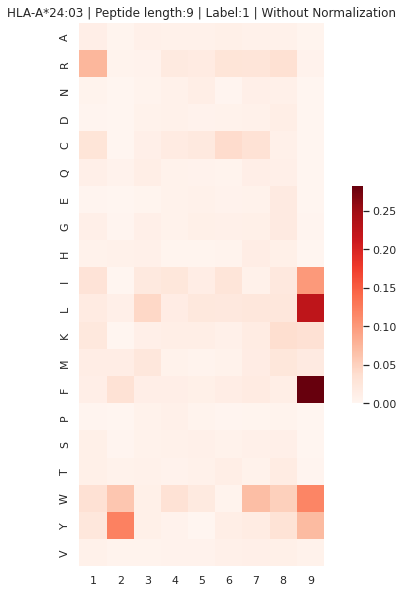



--------------------------


HLA and Label are filtered.
#Peptides: 71
HLA: HLA-A*02:50
Threshold: 0.1
YLICWICWV

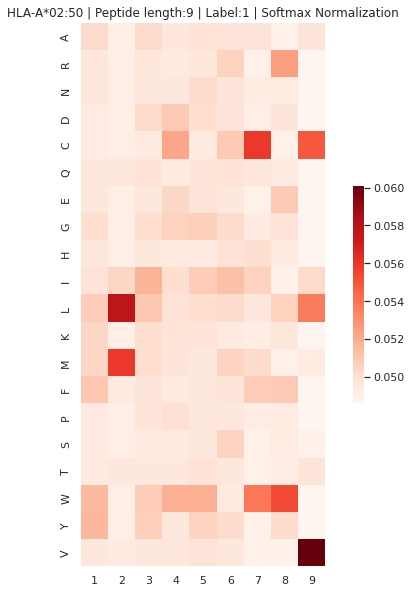

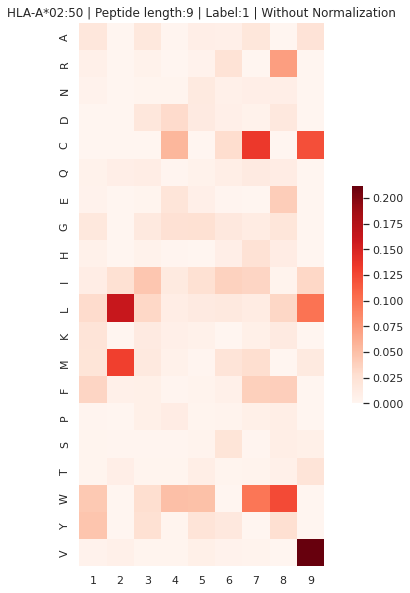



--------------------------


HLA and Label are filtered.
#Peptides: 738
HLA: HLA-B*15:11
Threshold: 0.43
MARRERIRY

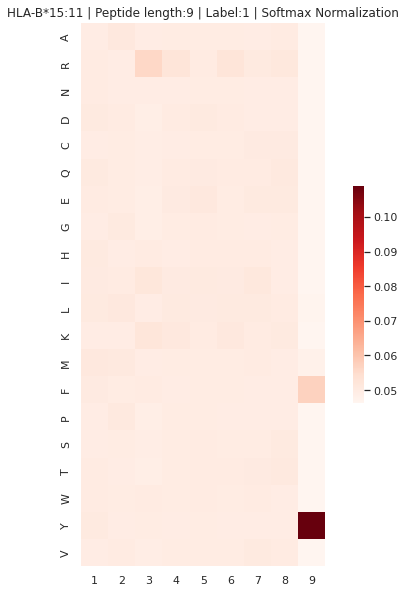

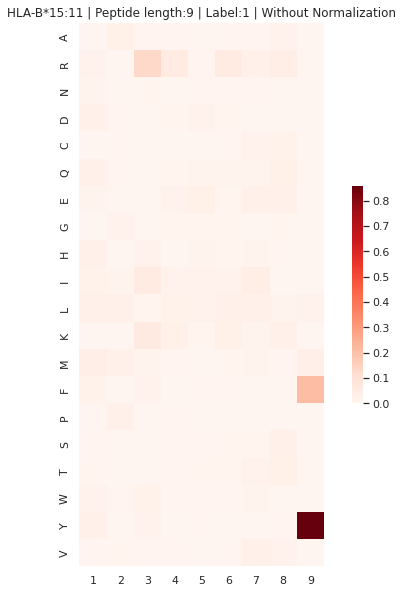



--------------------------


HLA and Label are filtered.
#Peptides: 368
HLA: HLA-B*56:01
Threshold: 0.1
RPRLILLEA

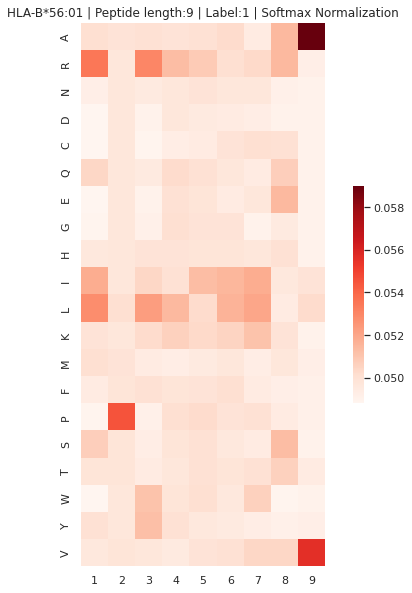

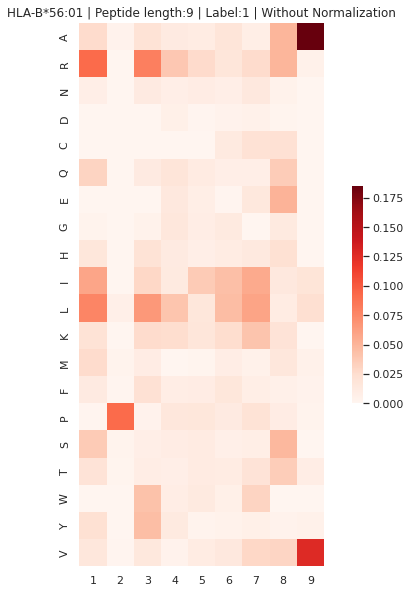



--------------------------


HLA and Label are filtered.
#Peptides: 4221
HLA: HLA-B*08:01
Threshold: 0.32
ELKLRILSL

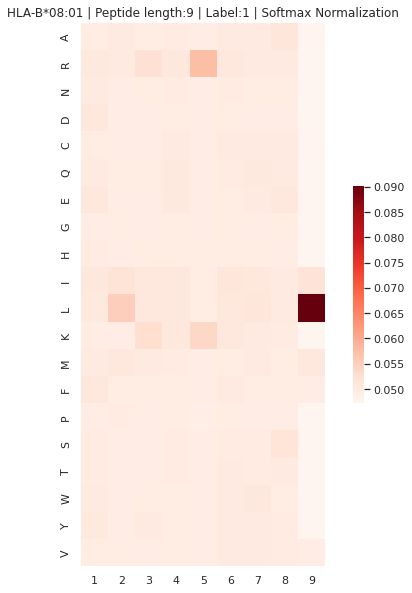

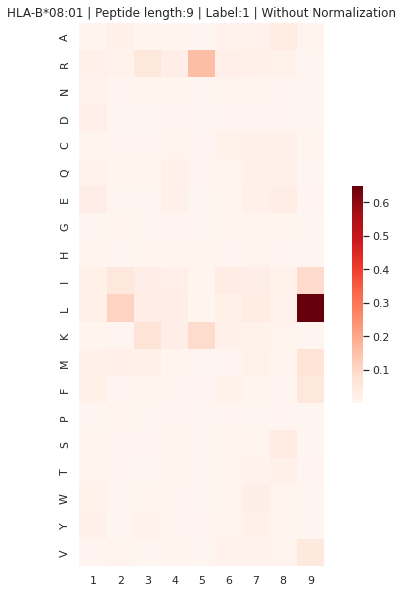



--------------------------


HLA and Label are filtered.
#Peptides: 3928
HLA: HLA-C*08:02
Threshold: 0.36
RLDERRREL

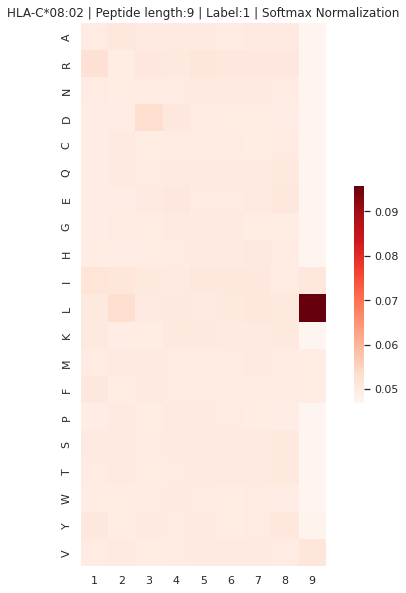

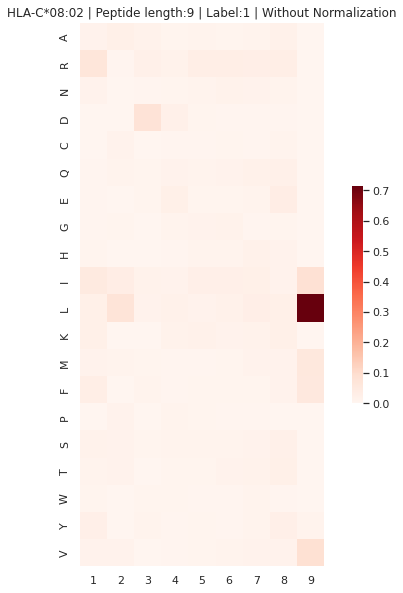



--------------------------


HLA and Label are filtered.
#Peptides: 1661
HLA: HLA-B*18:01
Threshold: 0.22
DEIILRRRY

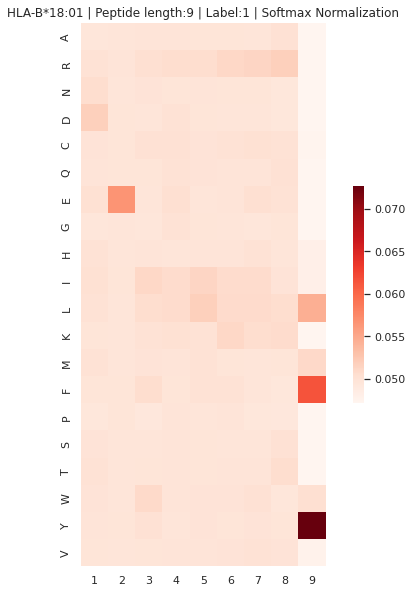

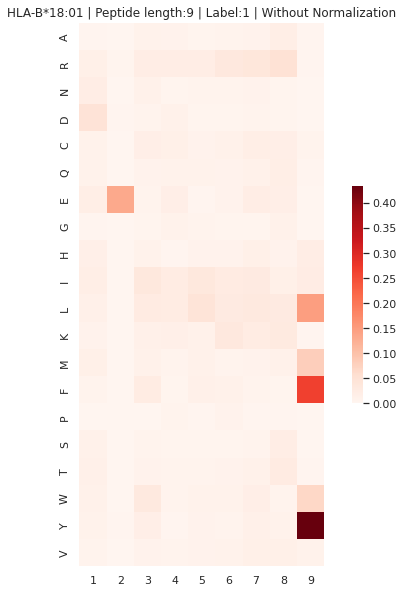



--------------------------


HLA and Label are filtered.
#Peptides: 1946
HLA: HLA-A*02:07
Threshold: 0.24
ILDEILLRL

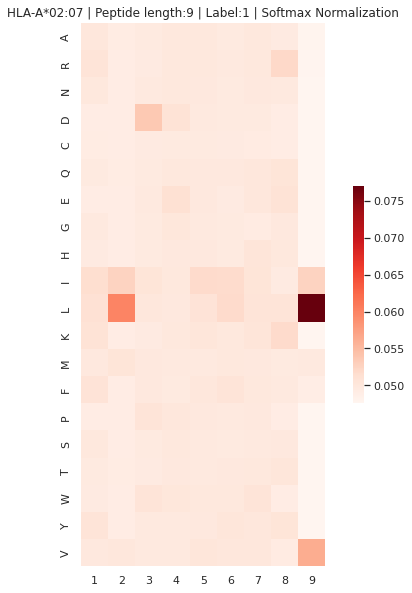

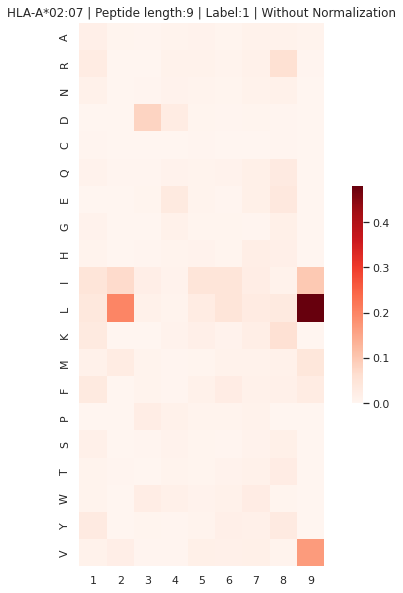



--------------------------


HLA and Label are filtered.
#Peptides: 558
HLA: HLA-A*33:01
Threshold: 0.29
IIILCCCLR

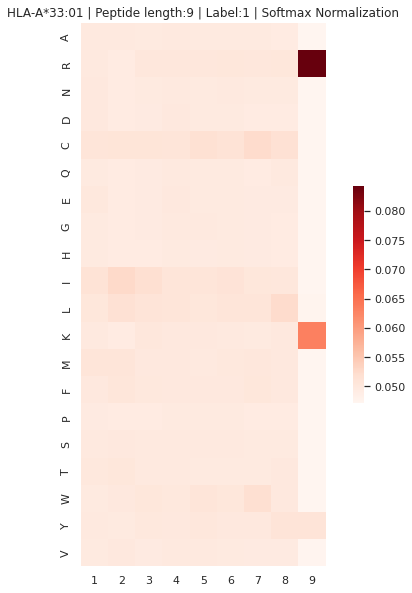

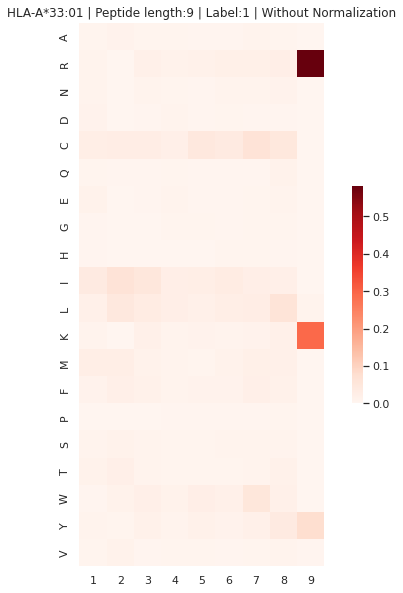



--------------------------


HLA and Label are filtered.
#Peptides: 2741
HLA: HLA-A*32:01
Threshold: 0.16
RLIRWRLTW

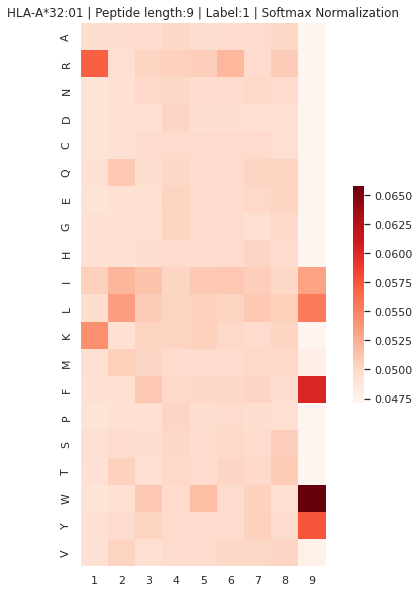

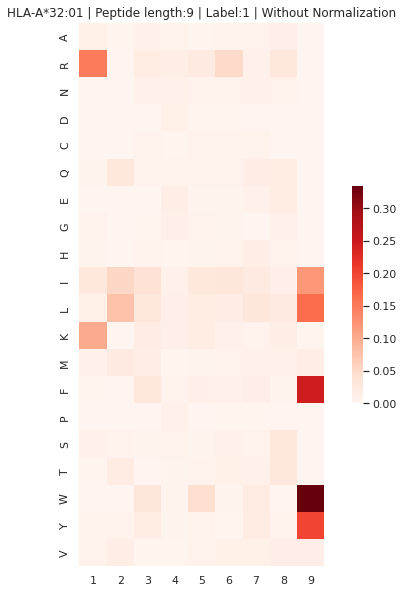



--------------------------


HLA and Label are filtered.
#Peptides: 1102
HLA: HLA-A*02:04
Threshold: 0.3
RLLDWIWRL

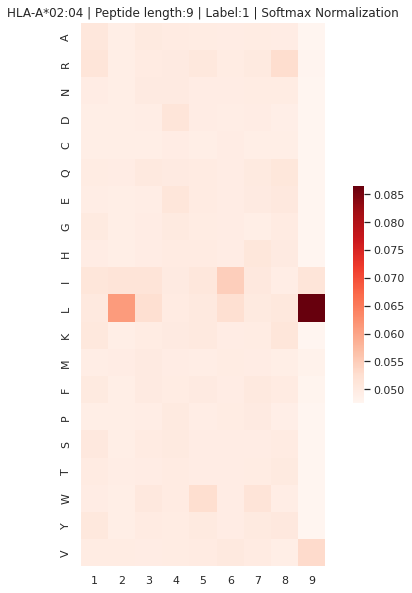

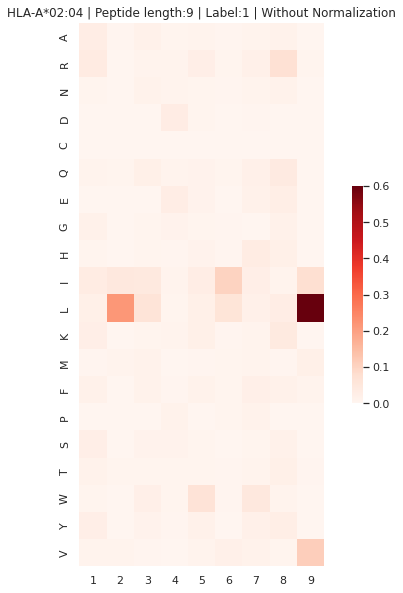



--------------------------


HLA and Label are filtered.
#Peptides: 775
HLA: HLA-B*35:08
Threshold: 0.26
LPDRRDITY

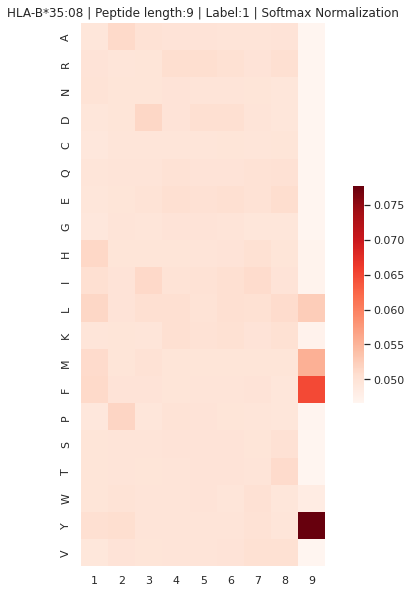

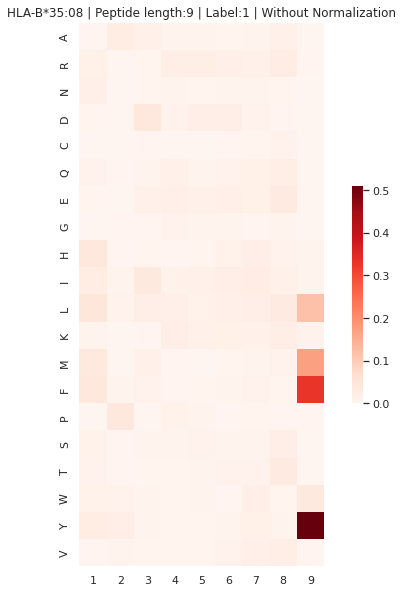



--------------------------


HLA and Label are filtered.
#Peptides: 1512
HLA: HLA-B*27:01
Threshold: 0.22
RRLLIILLL

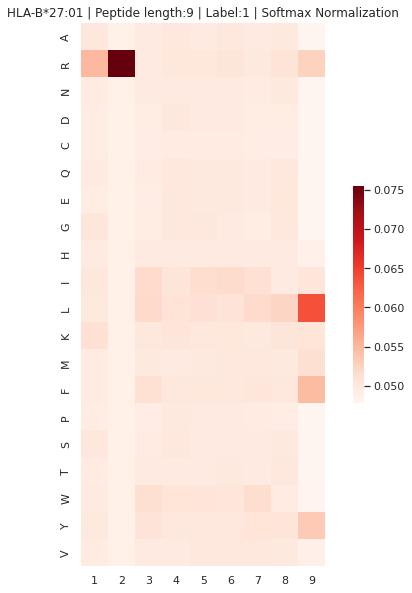

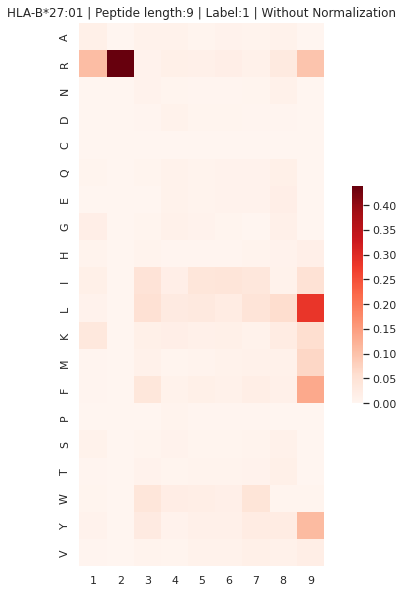



--------------------------


HLA and Label are filtered.
#Peptides: 2707
HLA: HLA-B*58:01
Threshold: 0.54
RSIRILLLW

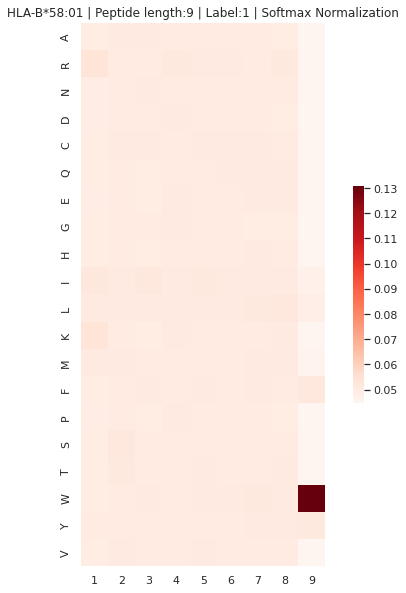

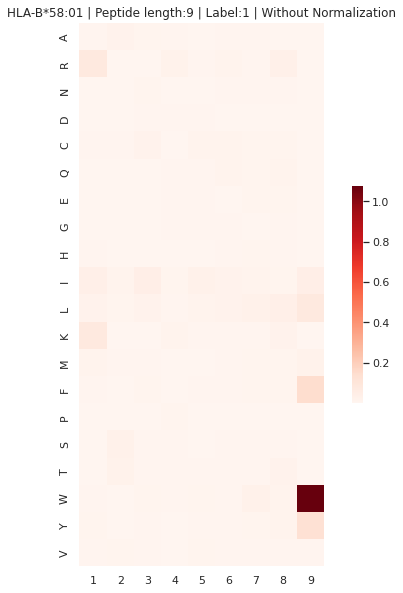



--------------------------


HLA and Label are filtered.
#Peptides: 2930
HLA: HLA-B*35:03
Threshold: 0.47
LPIRIIIIL

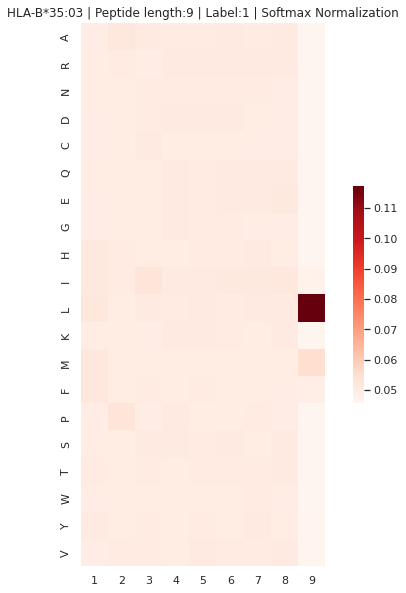

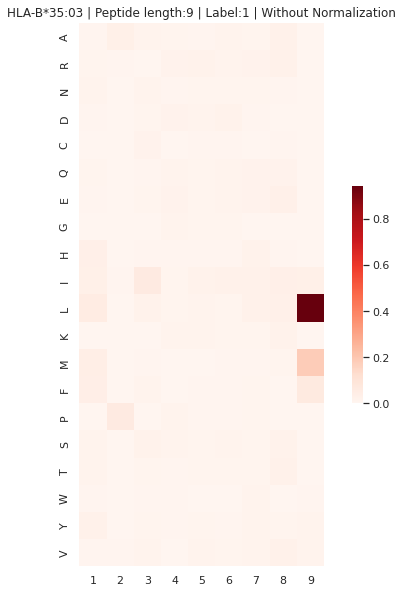



--------------------------


HLA and Label are filtered.
#Peptides: 74
HLA: HLA-A*66:01
Threshold: 0.26
MTICIIWLR

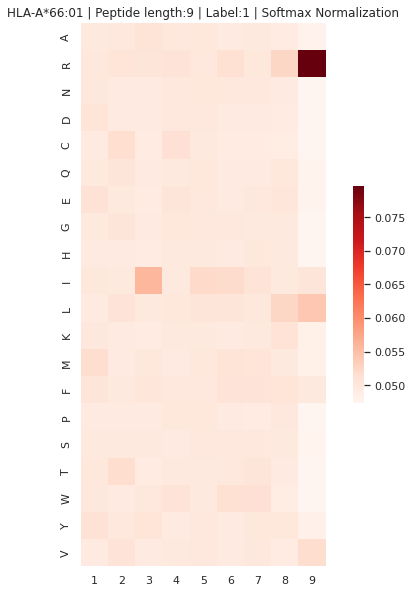

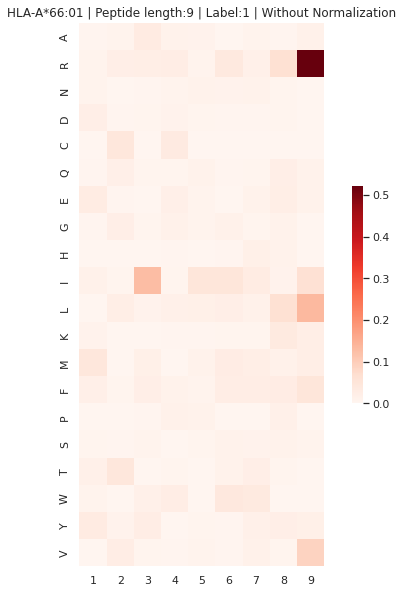



--------------------------


HLA and Label are filtered.
#Peptides: 257
HLA: HLA-B*83:01
Threshold: 0.11
RMRWRWLYL

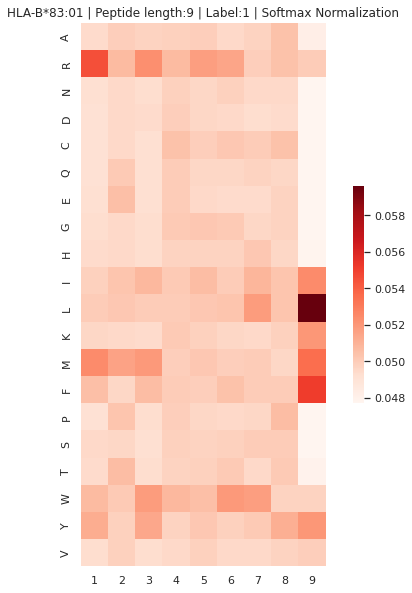

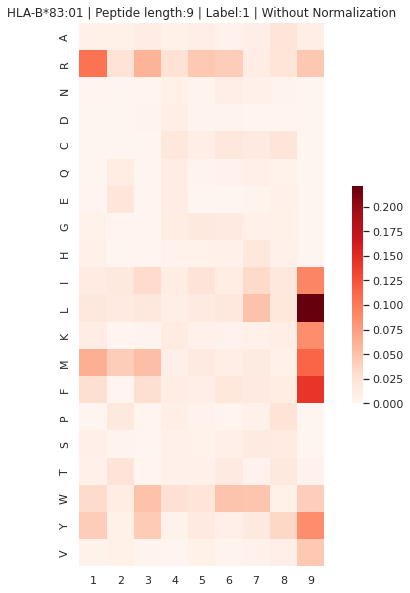



--------------------------


HLA and Label are filtered.
#Peptides: 5125
HLA: HLA-A*68:01
Threshold: 0.46
EIILIIILR

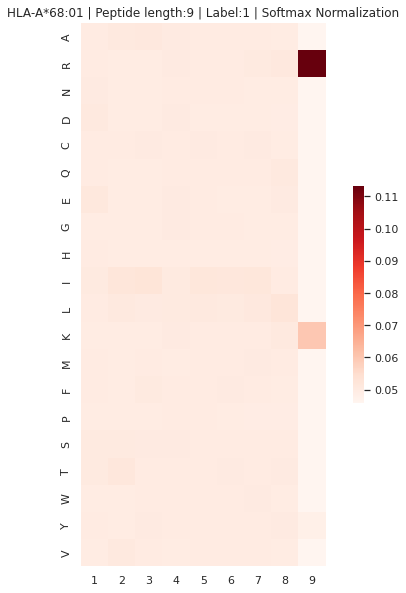

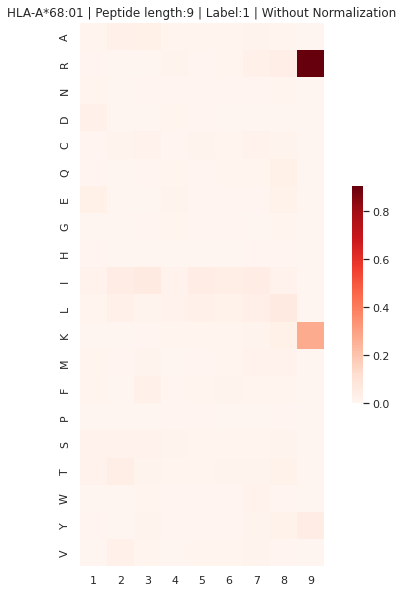



--------------------------


HLA and Label are filtered.
#Peptides: 2412
HLA: HLA-B*13:02
Threshold: 0.28
RQLKIILRI

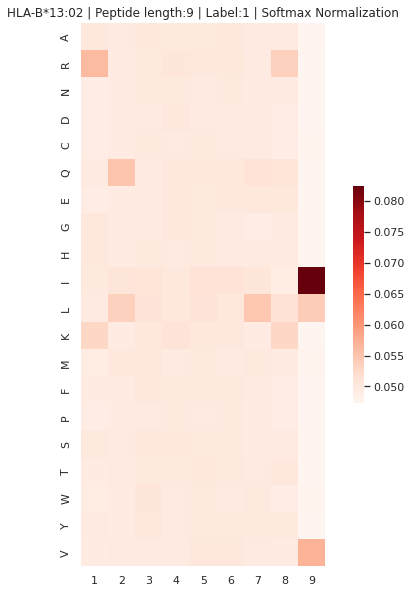

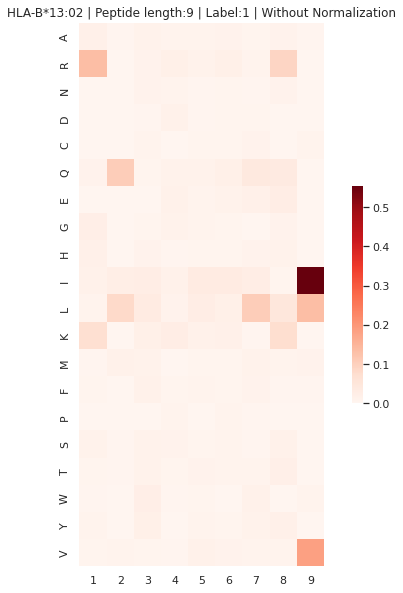



--------------------------


HLA and Label are filtered.
#Peptides: 82
HLA: HLA-B*15:09
Threshold: 0.37
YHIWIRKIL

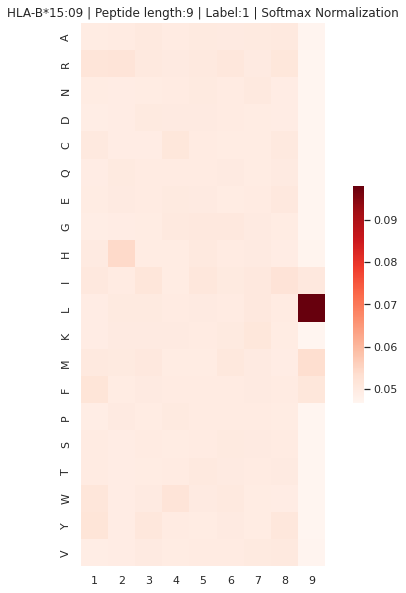

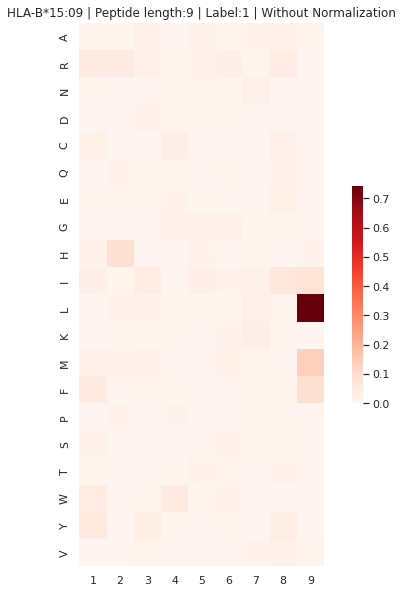



--------------------------


HLA and Label are filtered.
#Peptides: 188
HLA: HLA-A*26:02
Threshold: 0.22
EIICWMWWY

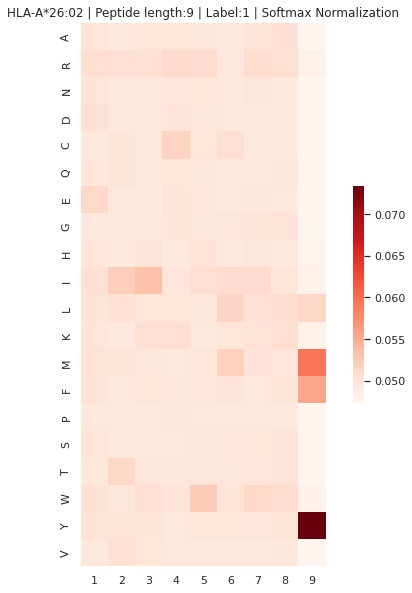

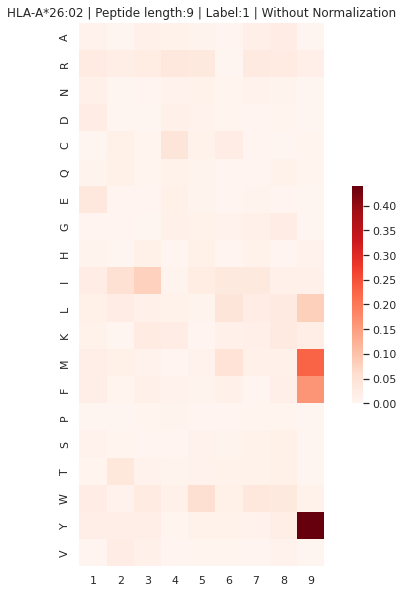



--------------------------


HLA and Label are filtered.
#Peptides: 118
HLA: HLA-A*24:13
Threshold: 0.19
IYIDRHIRL

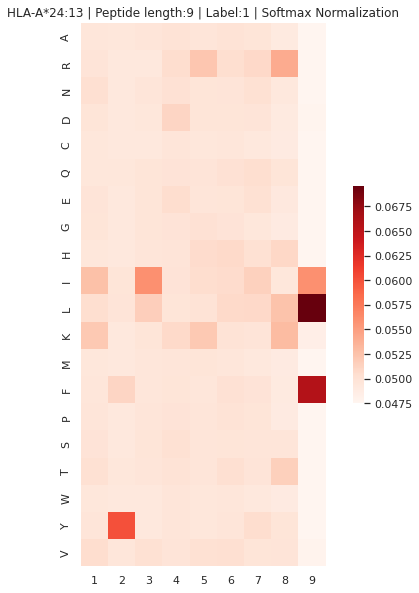

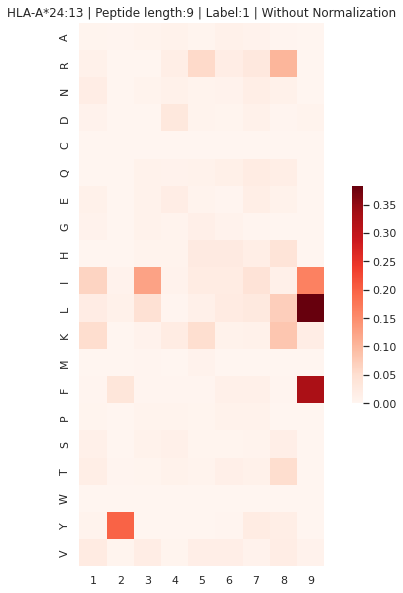



--------------------------


HLA and Label are filtered.
#Peptides: 3565
HLA: HLA-B*44:03
Threshold: 0.2
REILIRKRW

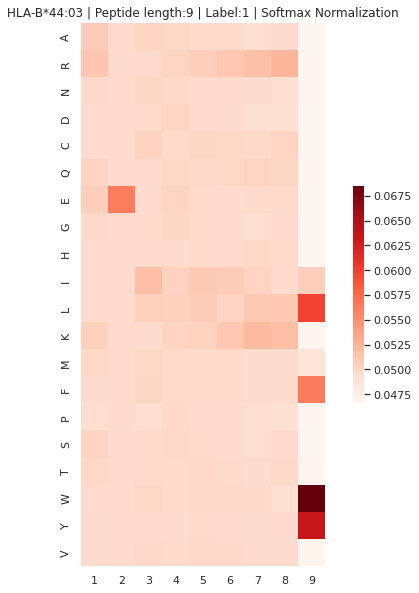

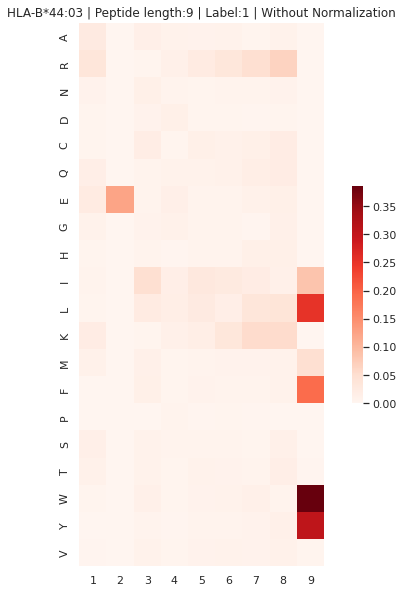



--------------------------


HLA and Label are filtered.
#Peptides: 861
HLA: HLA-B*15:18
Threshold: 0.32
IHRIIILRY

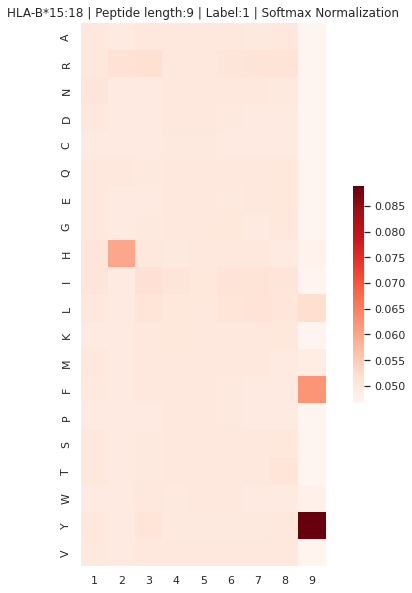

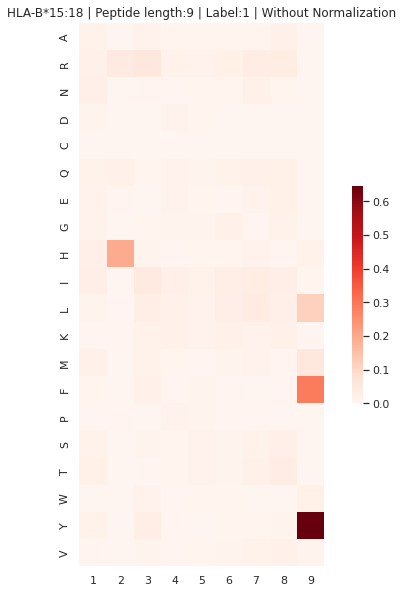



--------------------------


HLA and Label are filtered.
#Peptides: 152
HLA: HLA-A*02:16
Threshold: 0.1
KLLCWICWL

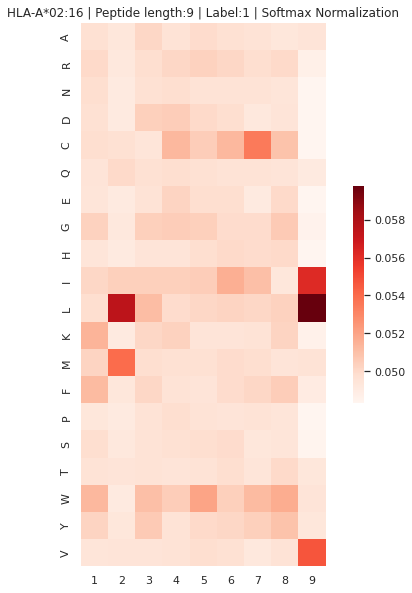

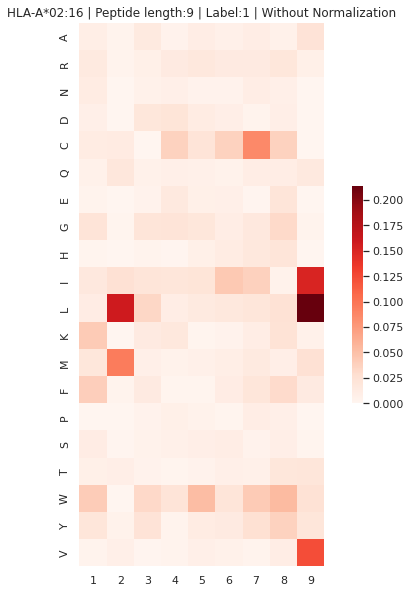



--------------------------


HLA and Label are filtered.
#Peptides: 2179
HLA: HLA-C*07:04
Threshold: 0.26
RLIERIIEL

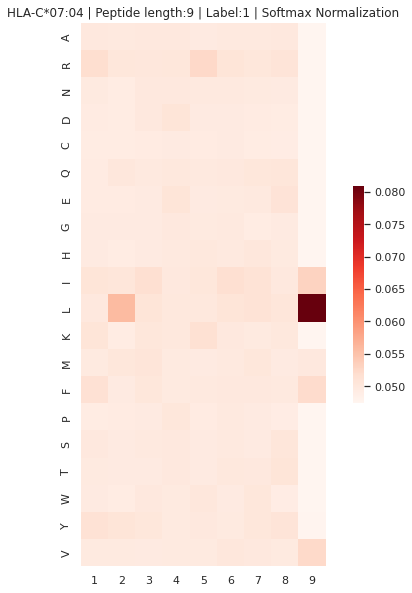

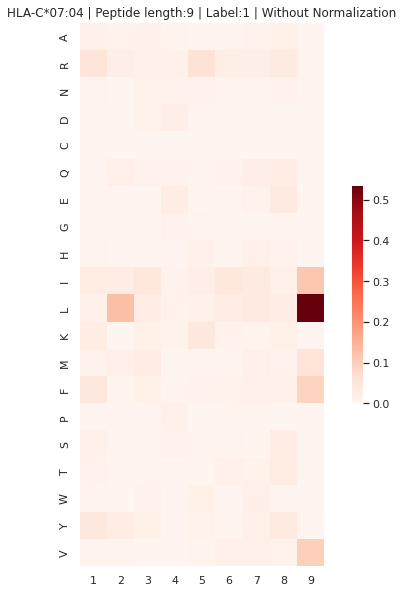



--------------------------


HLA and Label are filtered.
#Peptides: 563
HLA: HLA-A*30:02
Threshold: 0.36
CWIICRLCY

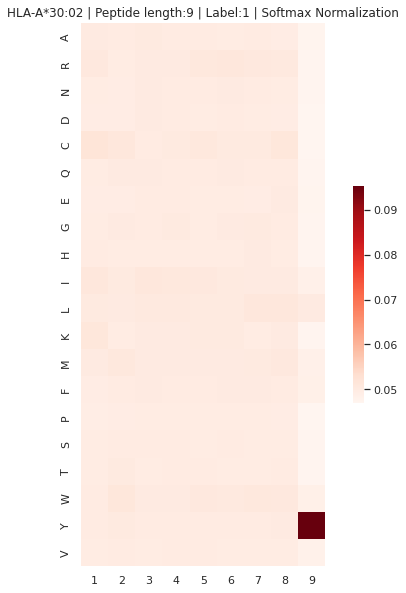

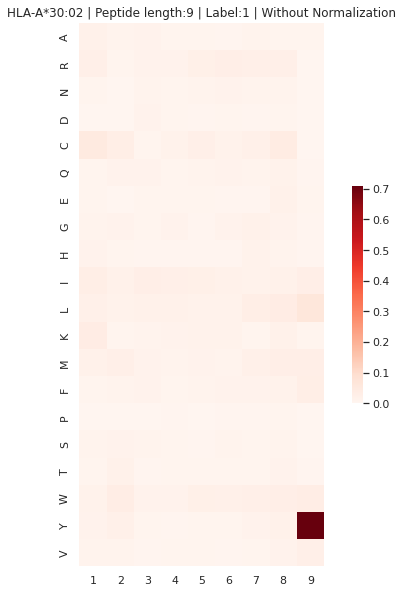



--------------------------


HLA and Label are filtered.
#Peptides: 16084
HLA: HLA-B*27:05
Threshold: 0.16
RRLLIILLL

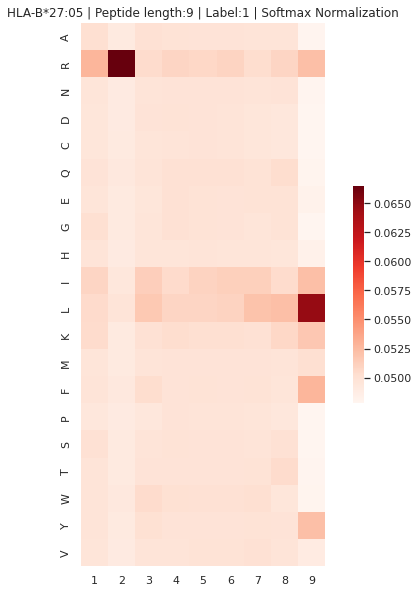

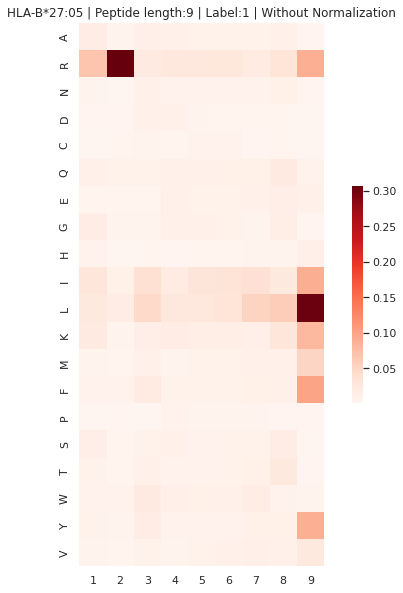



--------------------------


HLA and Label are filtered.
#Peptides: 1713
HLA: HLA-B*45:01
Threshold: 0.1
AEIRRLLKA

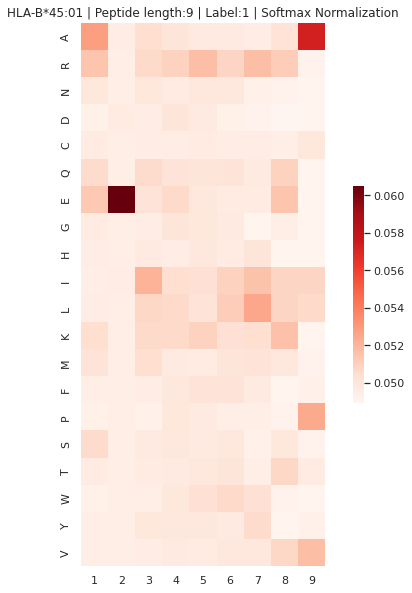

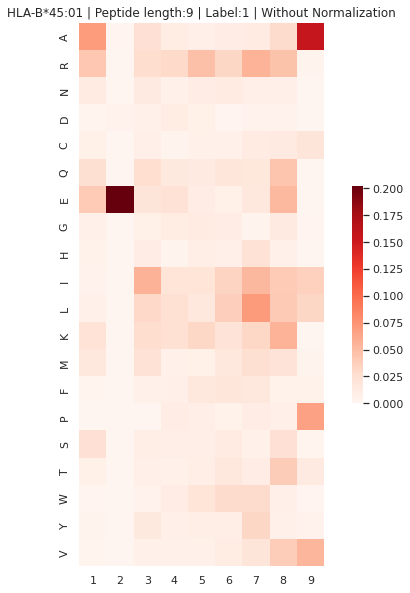



--------------------------


HLA and Label are filtered.
#Peptides: 1046
HLA: HLA-C*01:02
Threshold: 0.49
RLPLRRRSL

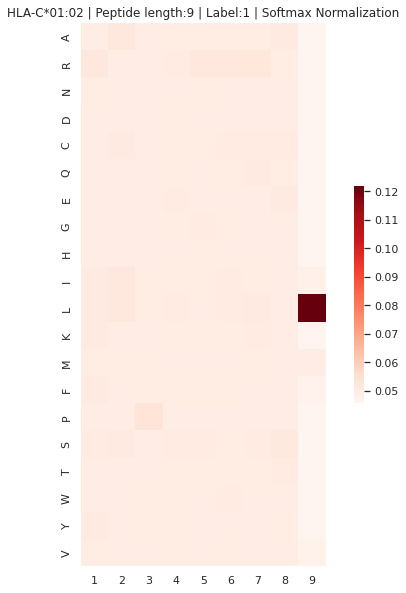

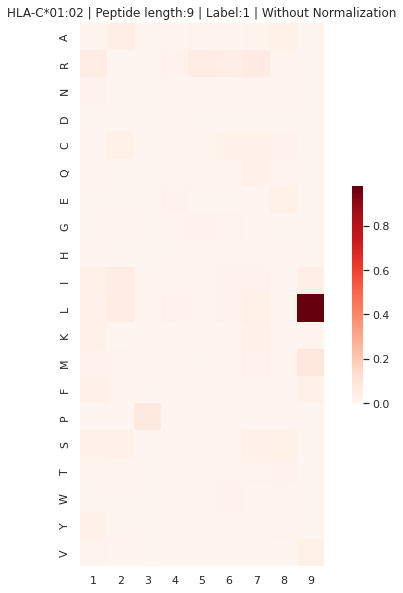



--------------------------


HLA and Label are filtered.
#Peptides: 73
HLA: HLA-B*27:20
Threshold: 0.22
RRYKRWIPL

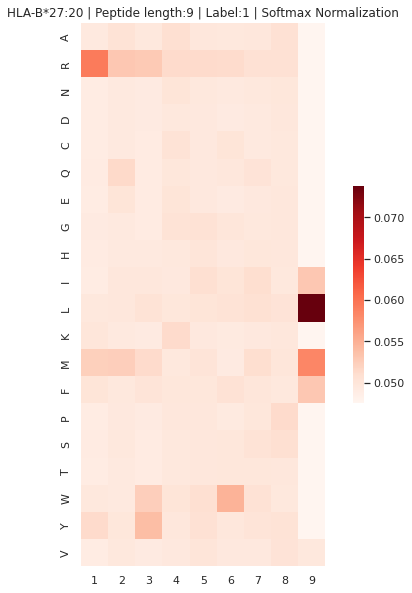

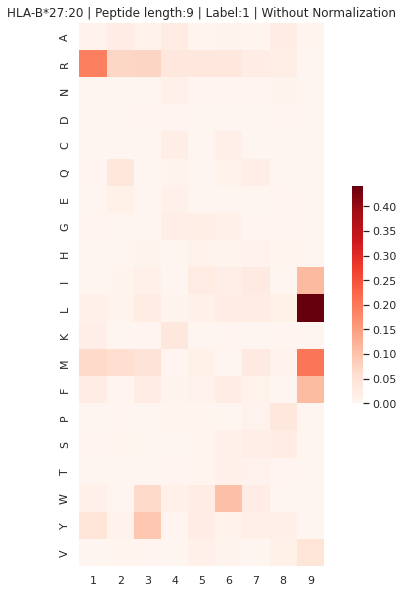



--------------------------


HLA and Label are filtered.
#Peptides: 4128
HLA: HLA-C*02:02
Threshold: 0.18
RLIDIILRL

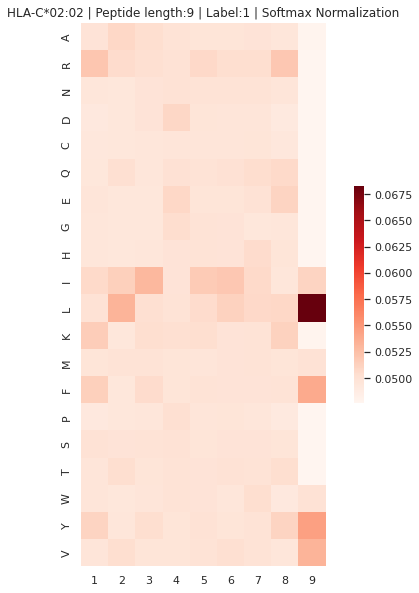

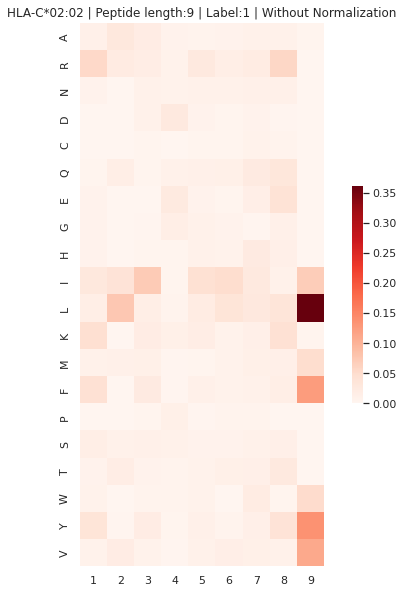



--------------------------


HLA and Label are filtered.
#Peptides: 3119
HLA: HLA-B*38:01
Threshold: 0.3
IHILIILLL

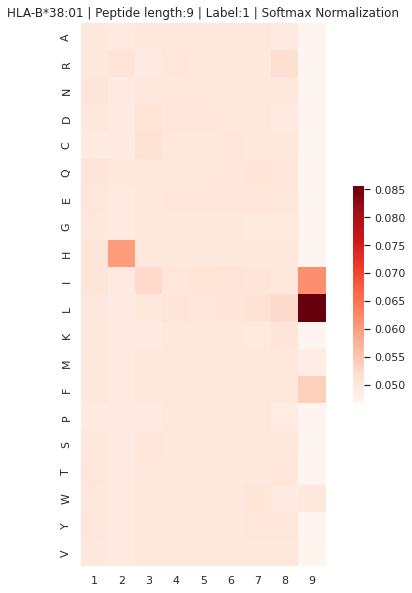

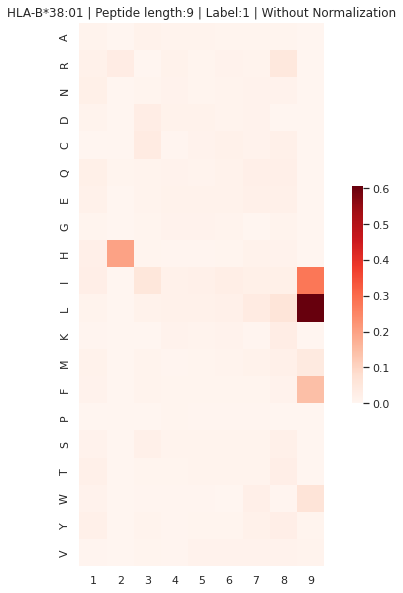



--------------------------


HLA and Label are filtered.
#Peptides: 646
HLA: HLA-B*27:06
Threshold: 0.3
IRILIILLL

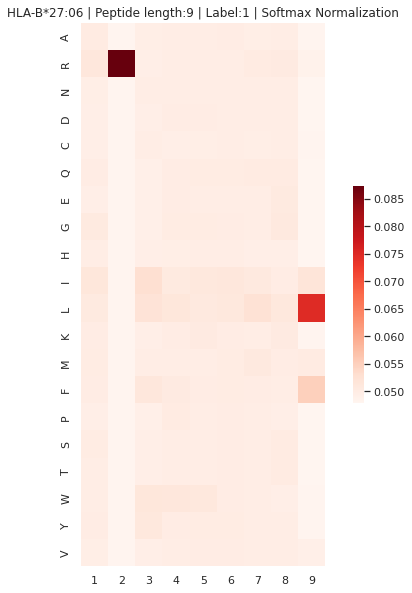

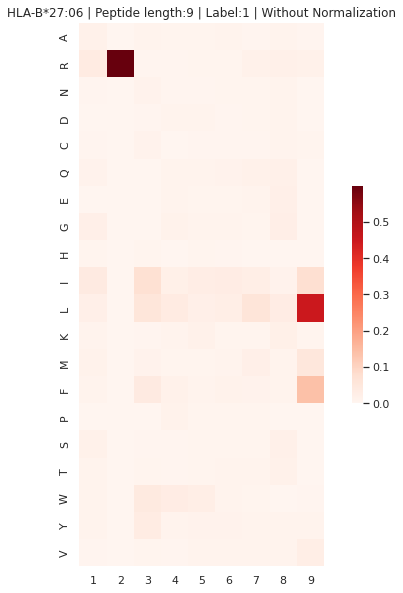



--------------------------


HLA and Label are filtered.
#Peptides: 142
HLA: HLA-A*80:01
Threshold: 0.4
KLIKWFWLY

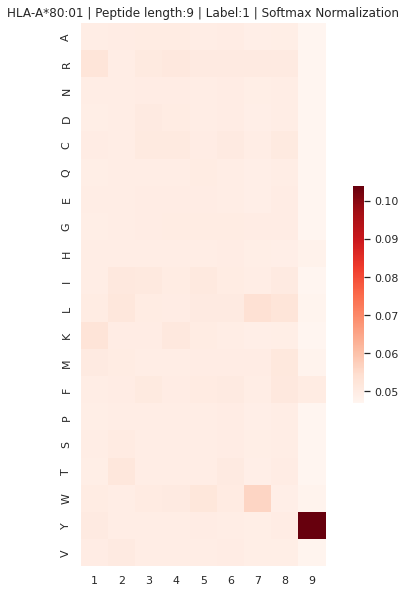

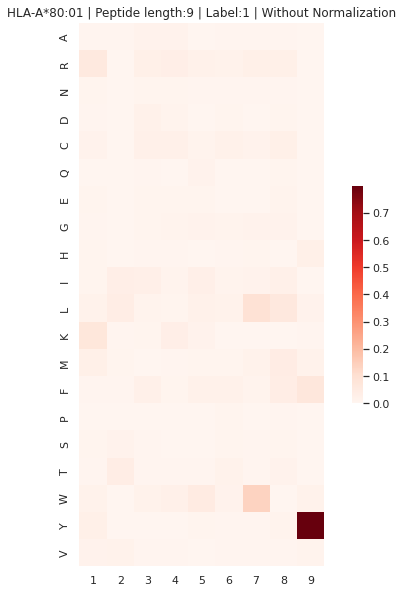



--------------------------


HLA and Label are filtered.
#Peptides: 3532
HLA: HLA-B*39:01
Threshold: 0.32
HRILIILLL

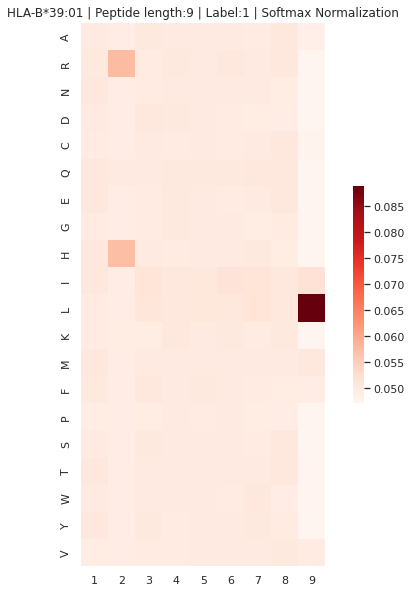

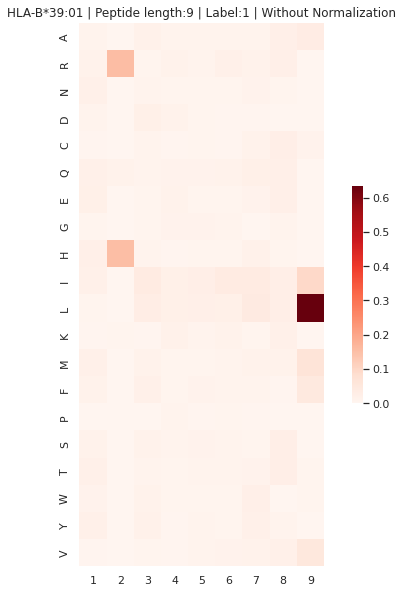



--------------------------


HLA and Label are filtered.
#Peptides: 2868
HLA: HLA-B*40:01
Threshold: 0.4
REIIIRIRL

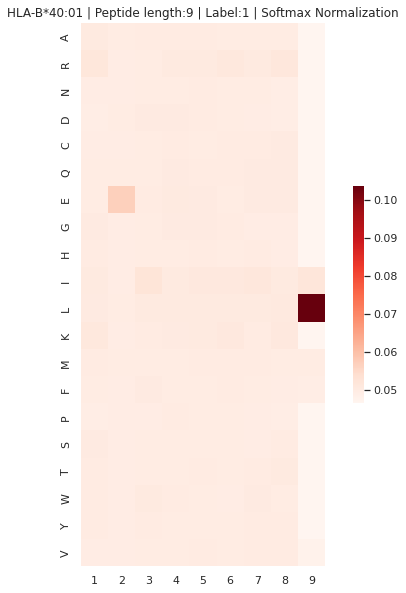

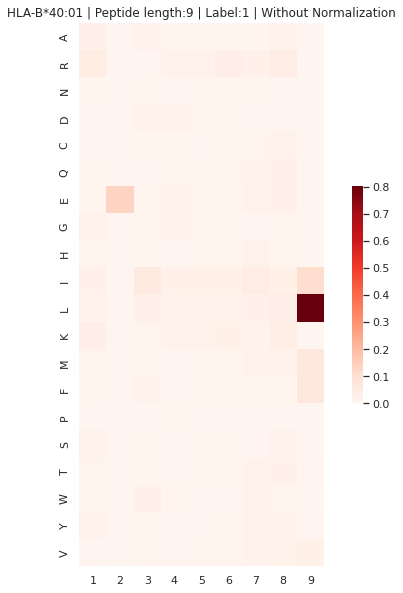



--------------------------


HLA and Label are filtered.
#Peptides: 2724
HLA: HLA-B*51:01
Threshold: 0.23
LPLLIIRLI

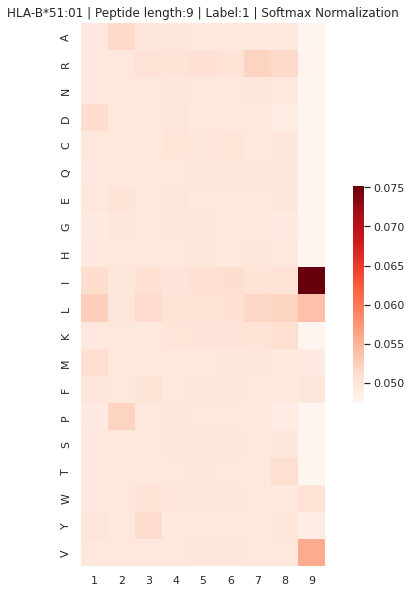

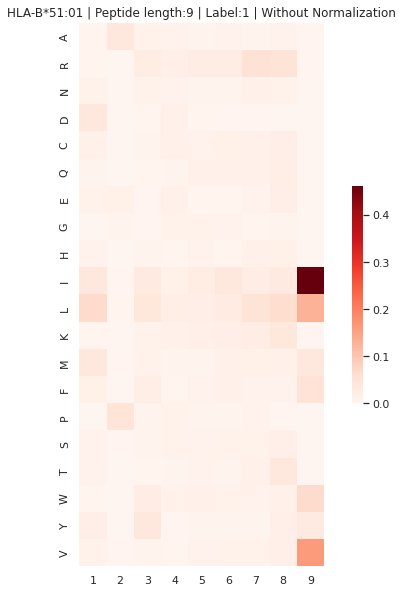



--------------------------


HLA and Label are filtered.
#Peptides: 420
HLA: HLA-B*53:01
Threshold: 0.18
MPICIWWLW

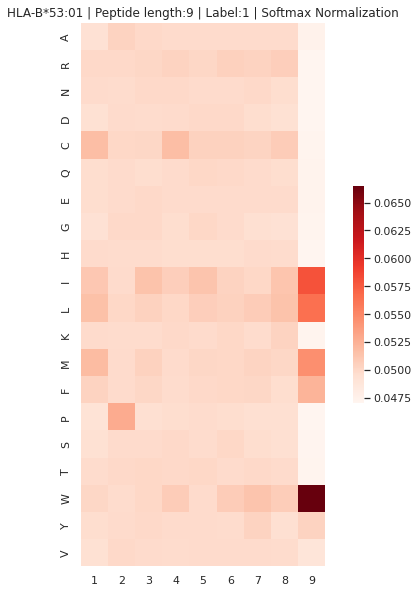

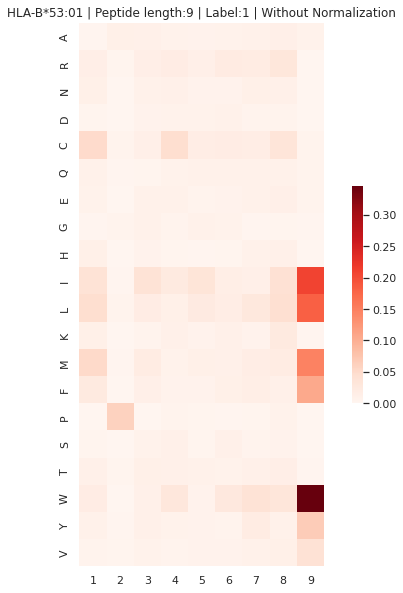



--------------------------


HLA and Label are filtered.
#Peptides: 393
HLA: HLA-B*15:17
Threshold: 0.15
KTRCRWWCY

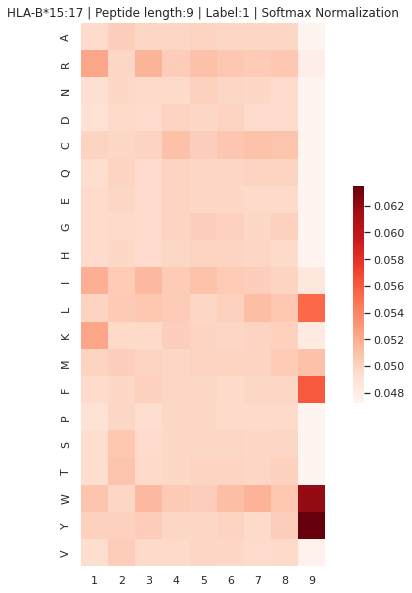

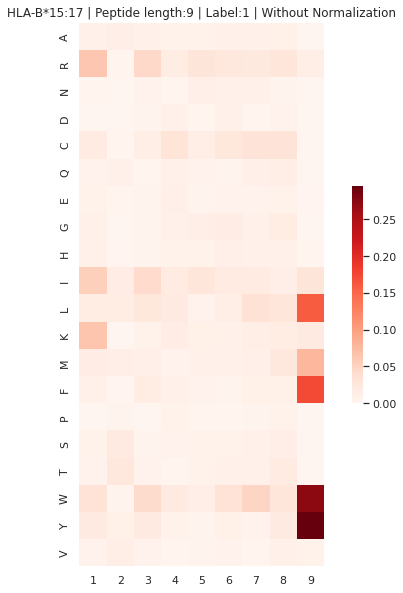



--------------------------


HLA and Label are filtered.
#Peptides: 280
HLA: HLA-B*45:06
Threshold: 0.12
RMRWRRWCL

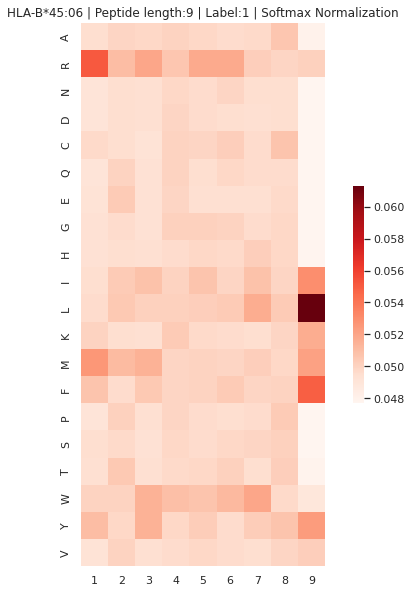

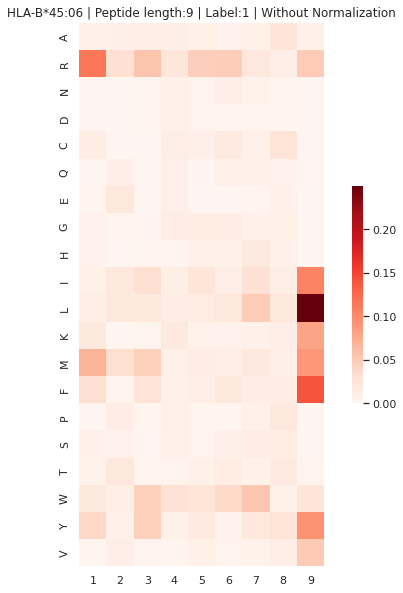



--------------------------


HLA and Label are filtered.
#Peptides: 0
HLA: HLA-B*44:27
Threshold: nan
AAAAAAAAA

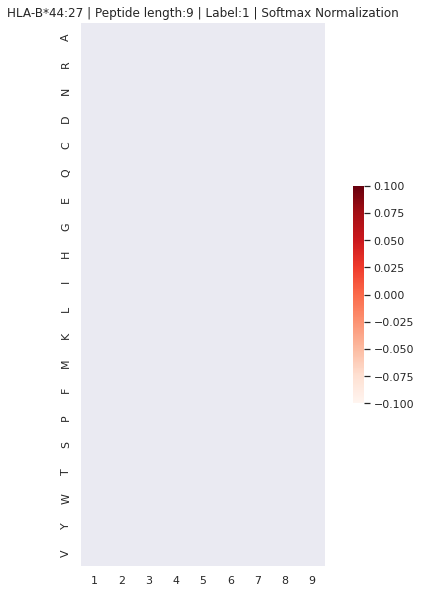

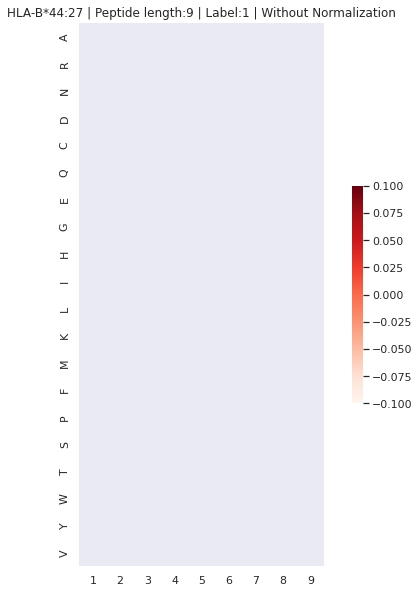



--------------------------


HLA and Label are filtered.
#Peptides: 107
HLA: HLA-B*52:01
Threshold: 0.24
RQYIFRHTI

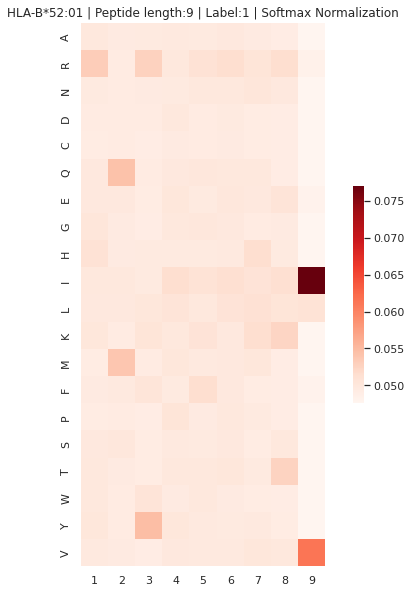

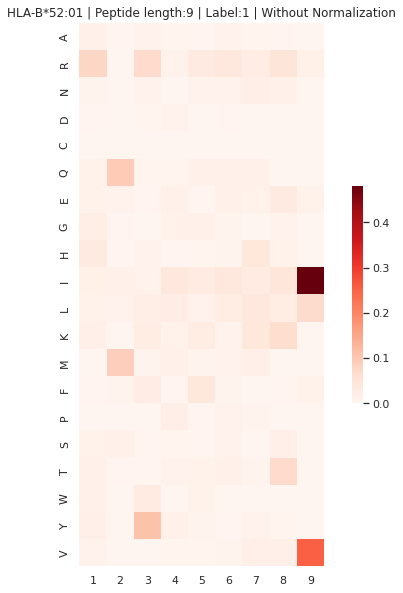



--------------------------


HLA and Label are filtered.
#Peptides: 2843
HLA: HLA-C*07:01
Threshold: 0.24
RRIDRILYL

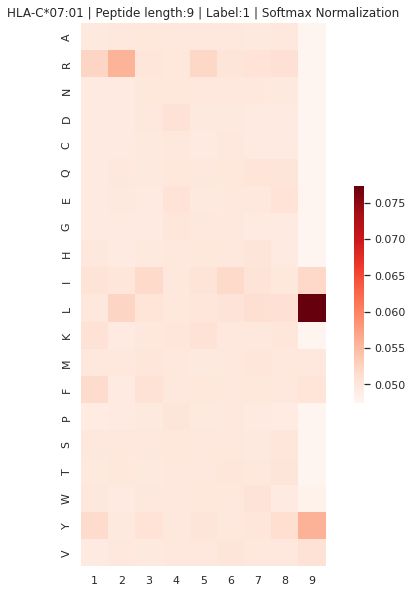

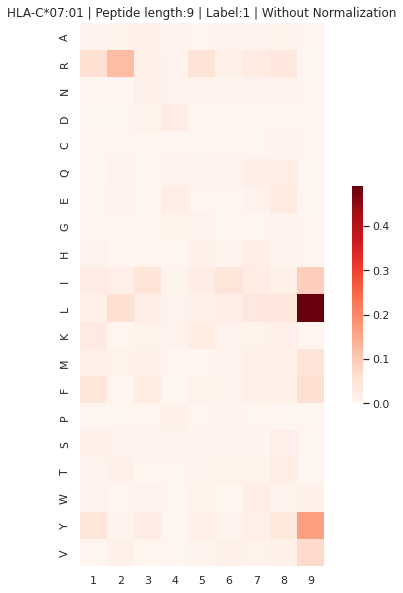



--------------------------


HLA and Label are filtered.
#Peptides: 4173
HLA: HLA-A*01:01
Threshold: 0.48
LLDRRRLLY

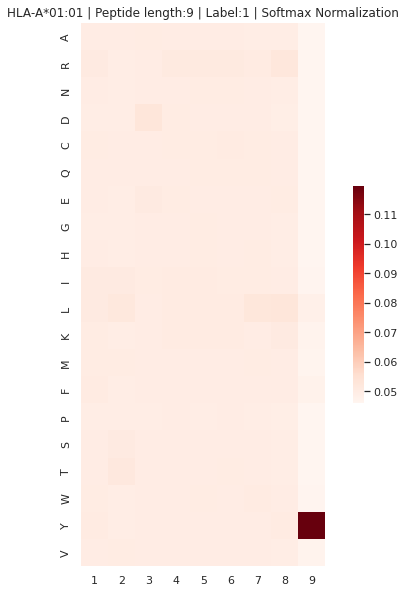

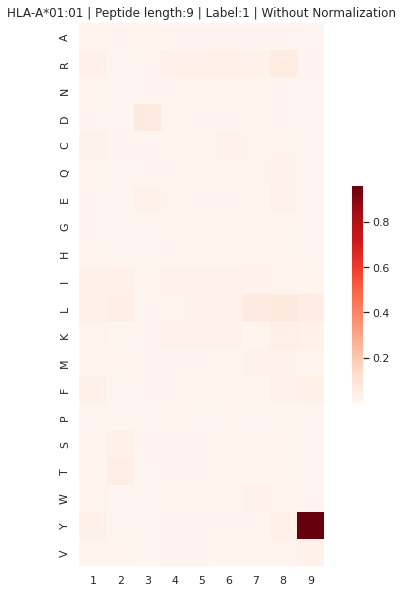



--------------------------


HLA and Label are filtered.
#Peptides: 64
HLA: HLA-A*68:23
Threshold: 0.11
MTIWWRWYF

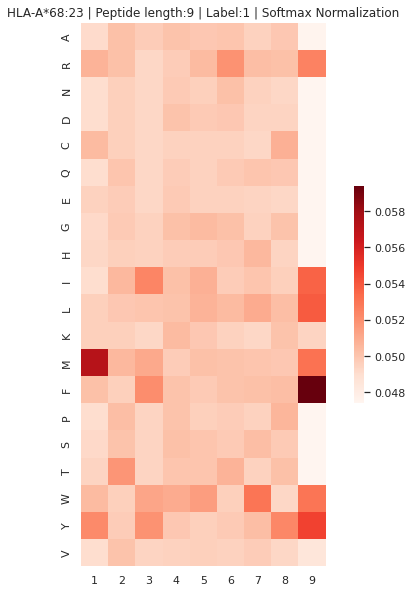

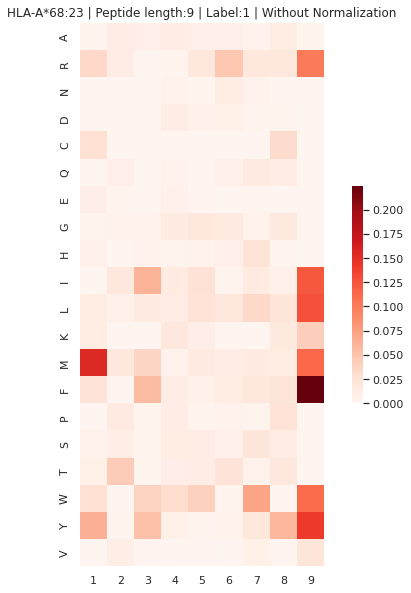



--------------------------


HLA and Label are filtered.
#Peptides: 2928
HLA: HLA-C*05:01
Threshold: 0.26
ILDERRRRL

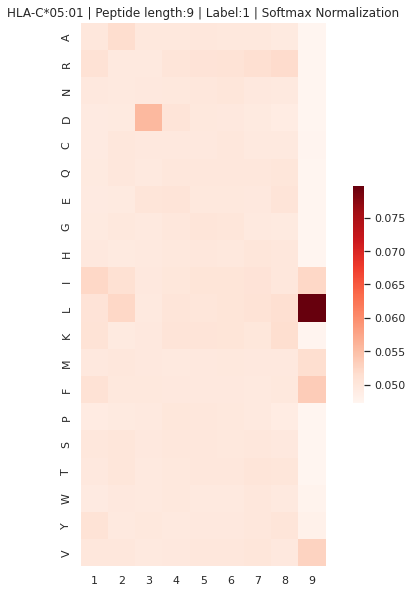

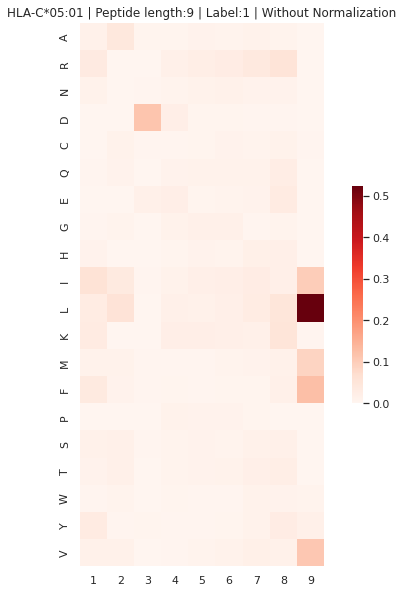



--------------------------


HLA and Label are filtered.
#Peptides: 802
HLA: HLA-A*02:20
Threshold: 0.18
KLLEKIIRL

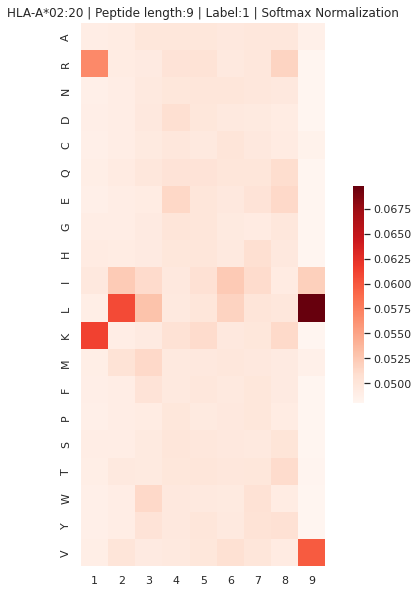

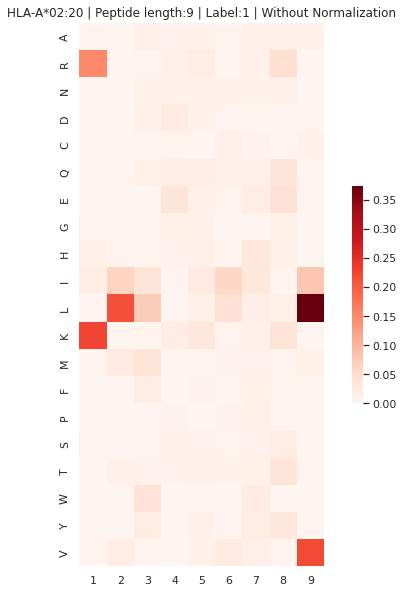



--------------------------


HLA and Label are filtered.
#Peptides: 1025
HLA: HLA-B*27:02
Threshold: 0.3
IRILIILLY

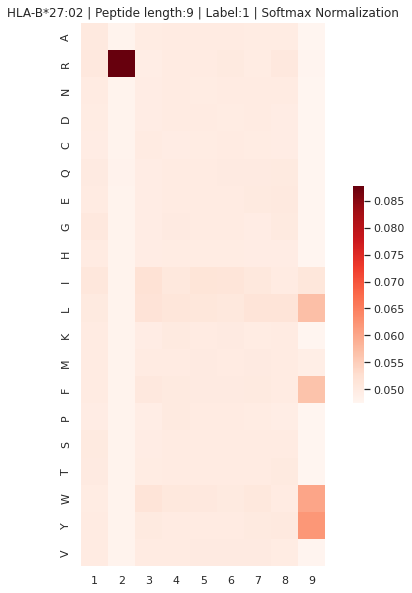

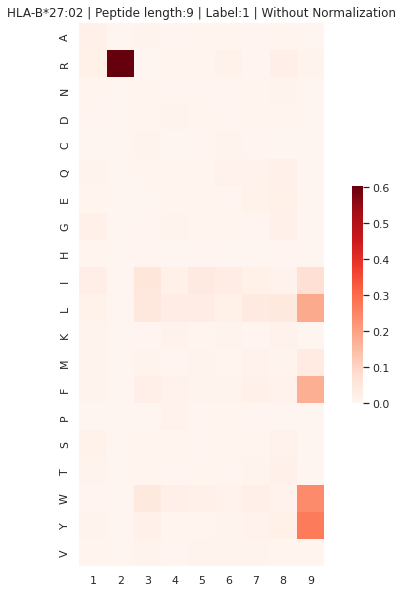



--------------------------


HLA and Label are filtered.
#Peptides: 2167
HLA: HLA-B*57:03
Threshold: 0.26
KTLRILWLW

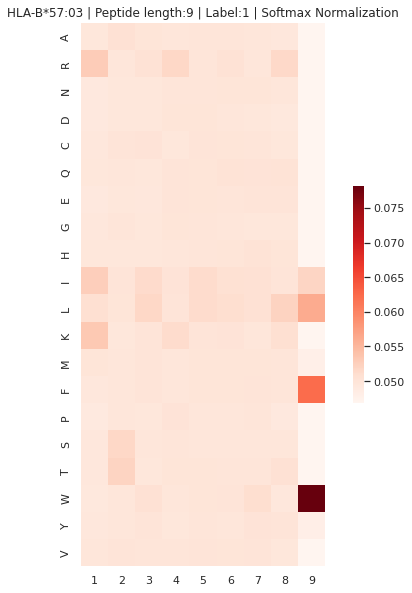

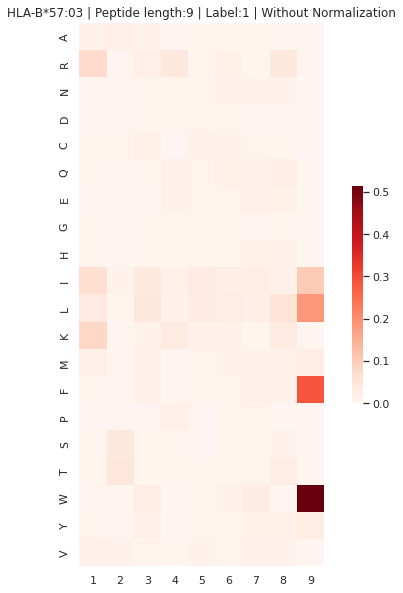



--------------------------


HLA and Label are filtered.
#Peptides: 388
HLA: HLA-B*51:08
Threshold: 0.34
LAKLIIRTI

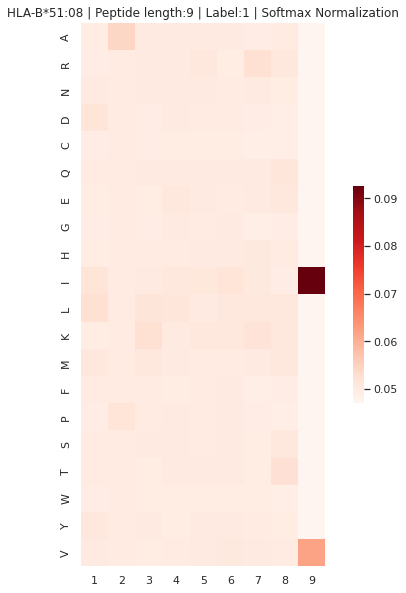

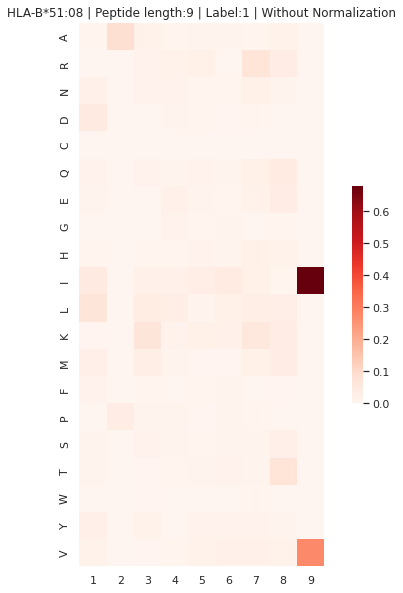



--------------------------


HLA and Label are filtered.
#Peptides: 1554
HLA: HLA-A*26:01
Threshold: 0.27
EIIRRILRY

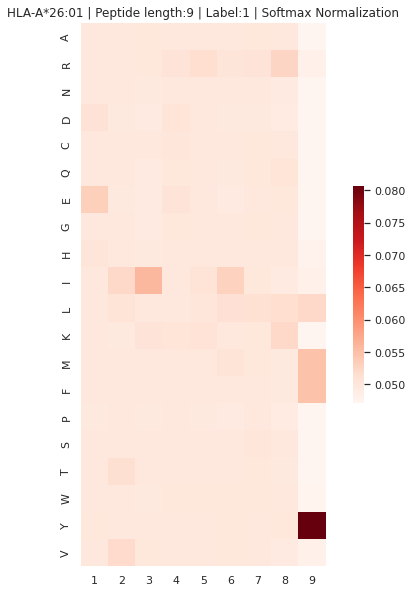

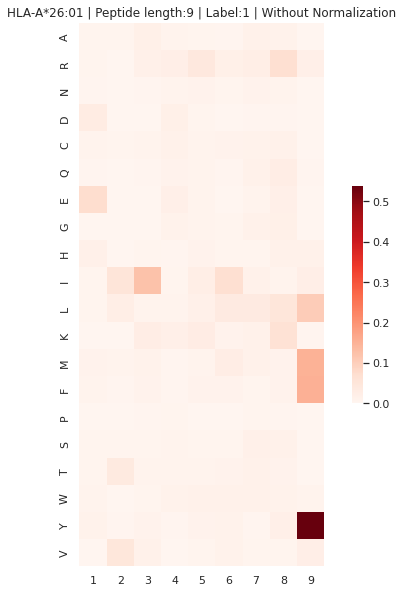



--------------------------


HLA and Label are filtered.
#Peptides: 695
HLA: HLA-B*54:01
Threshold: 0.06
LPLWIIIRV

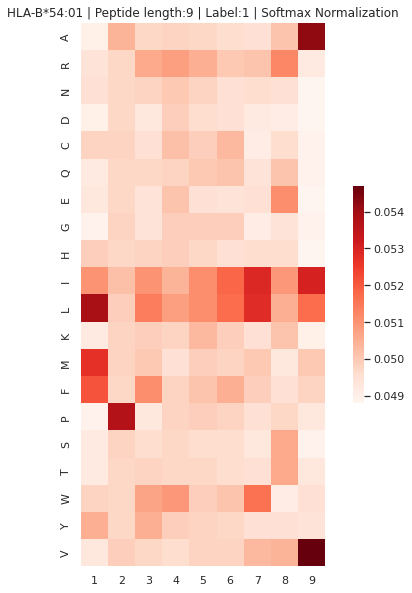

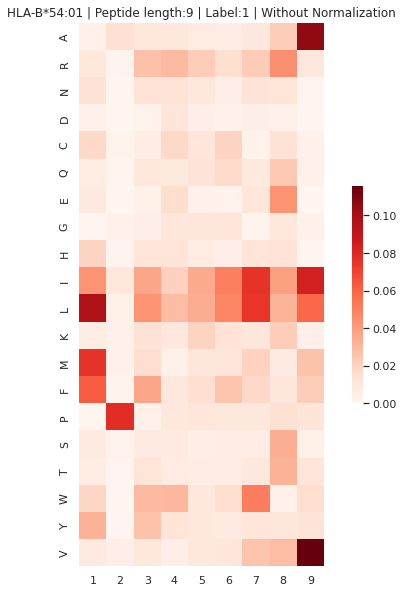



--------------------------


HLA and Label are filtered.
#Peptides: 388
HLA: HLA-B*39:24
Threshold: 0.45
TRLIIIQSL

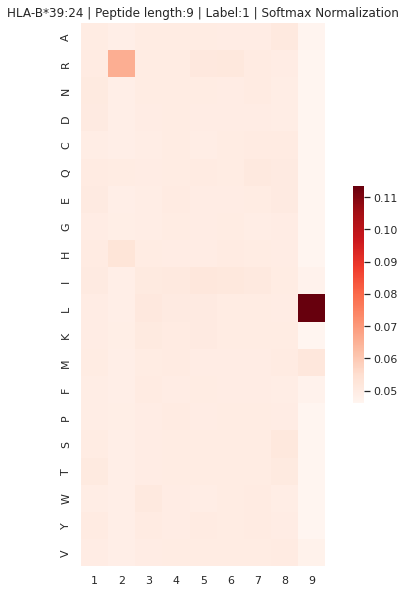

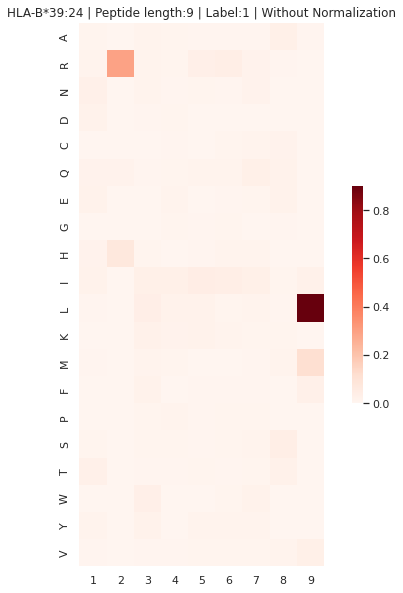



--------------------------


HLA and Label are filtered.
#Peptides: 328
HLA: HLA-A*02:11
Threshold: 0.12
FLWCWIWWL

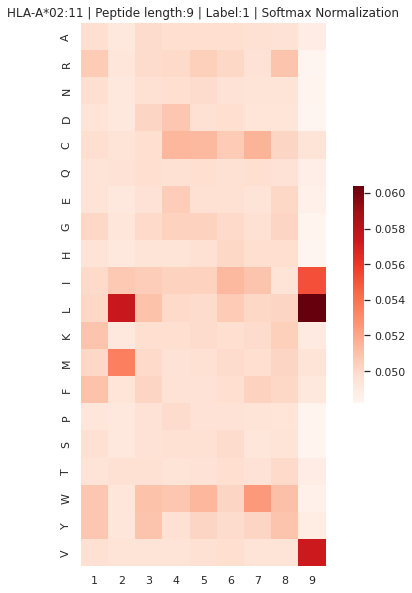

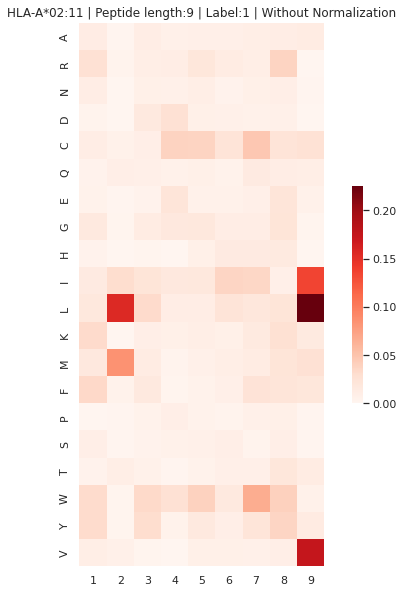



--------------------------


HLA and Label are filtered.
#Peptides: 6481
HLA: HLA-C*04:01
Threshold: 0.2
RYDERILLL

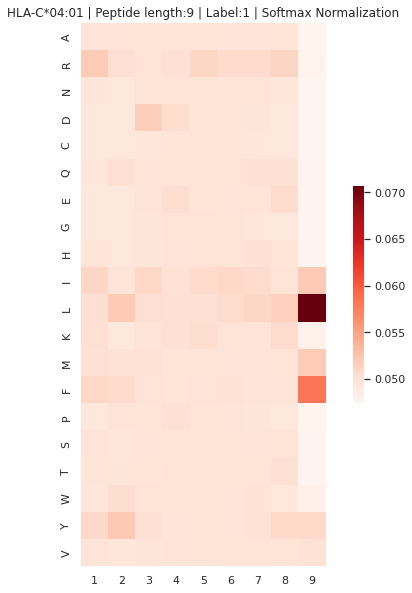

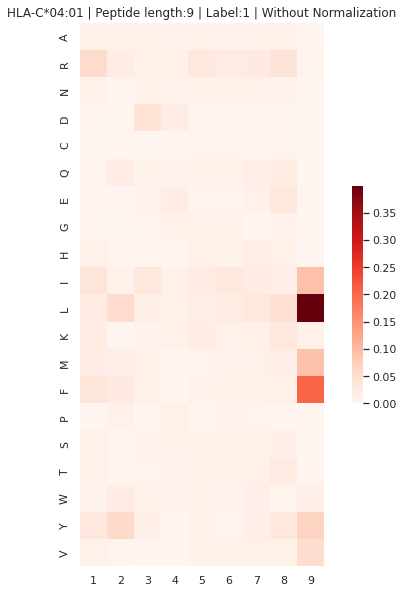



--------------------------


HLA and Label are filtered.
#Peptides: 58
HLA: HLA-A*32:15
Threshold: 0.16
MMMRWWWCF

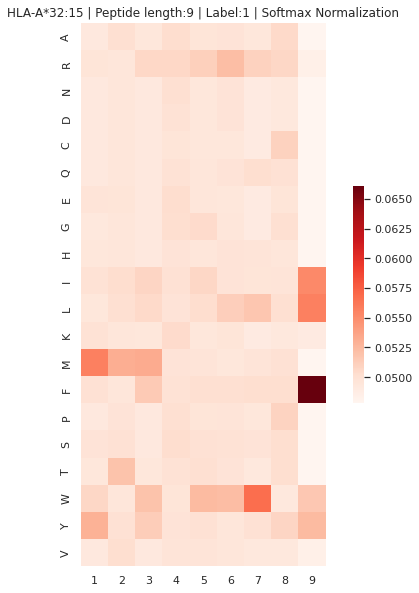

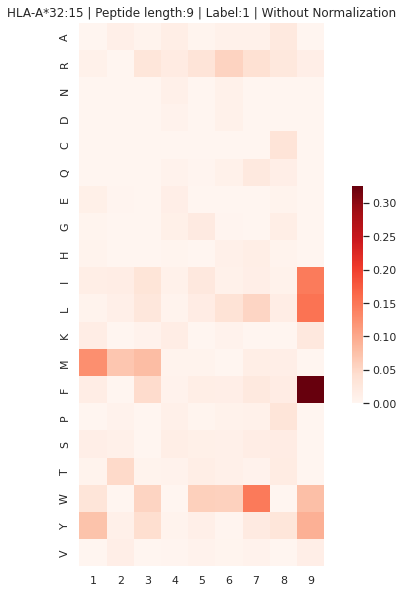



--------------------------


HLA and Label are filtered.
#Peptides: 2595
HLA: HLA-A*02:03
Threshold: 0.12
RLICRILLL

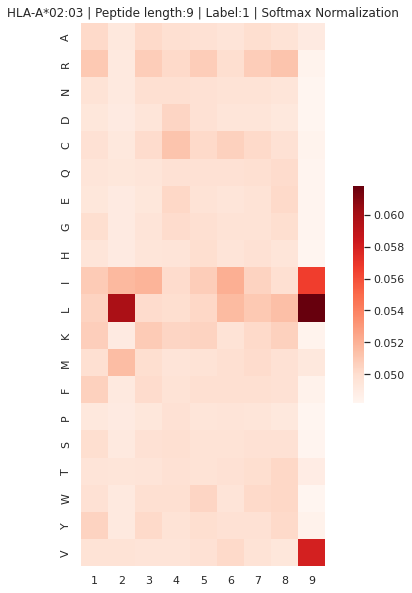

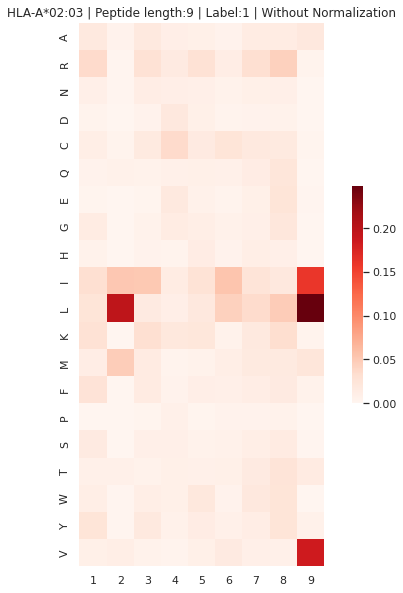



--------------------------


HLA and Label are filtered.
#Peptides: 198
HLA: HLA-A*02:19
Threshold: 0.12
YLYDWCWYL

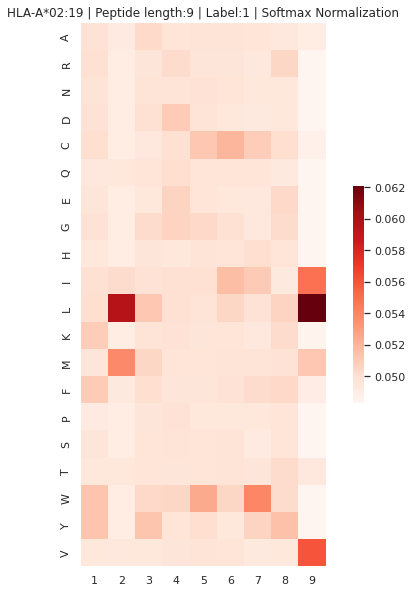

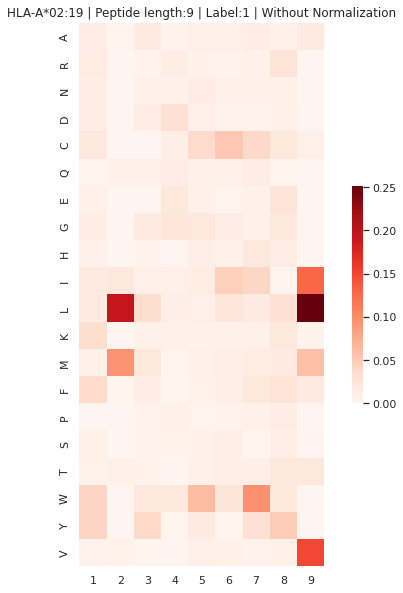



--------------------------


HLA and Label are filtered.
#Peptides: 1653
HLA: HLA-B*27:04
Threshold: 0.28
RRILIILLL

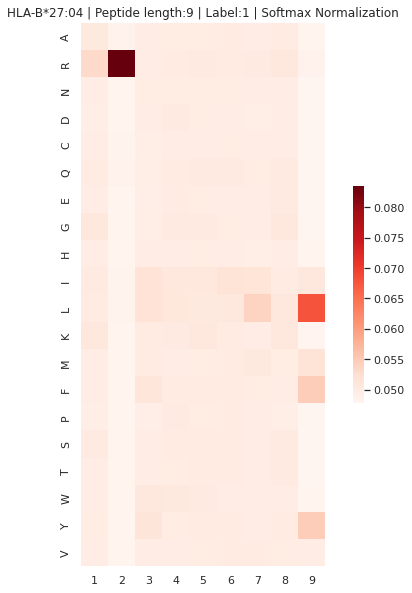

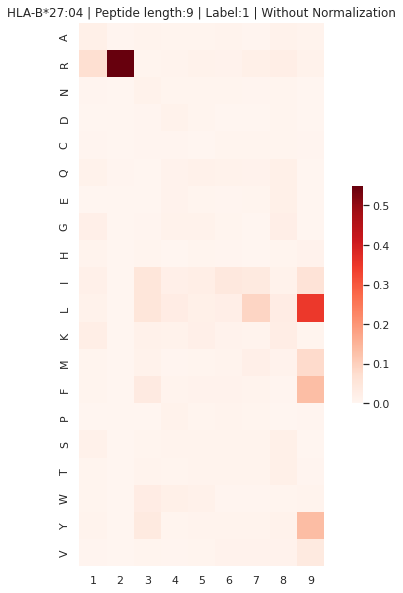



--------------------------


HLA and Label are filtered.
#Peptides: 96
HLA: HLA-A*25:01
Threshold: 0.26
EIIWRIRRY

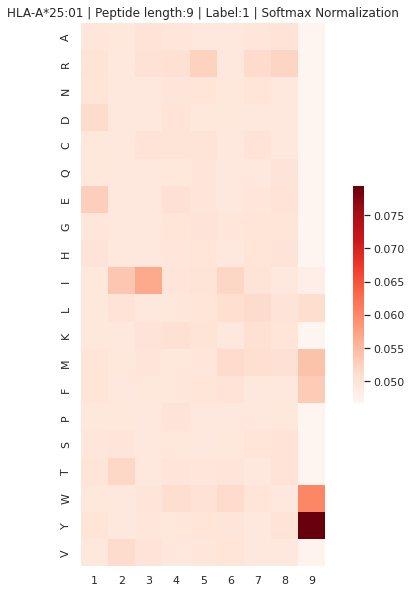

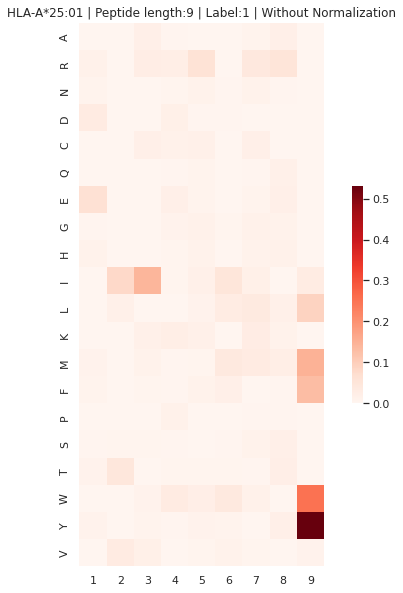



--------------------------


HLA and Label are filtered.
#Peptides: 433
HLA: HLA-B*41:01
Threshold: 0.1
REIRRRRKA

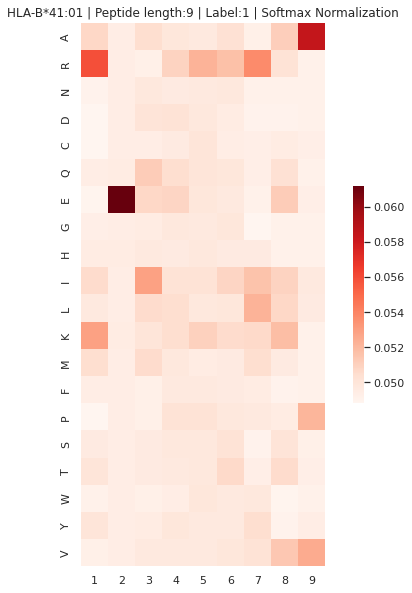

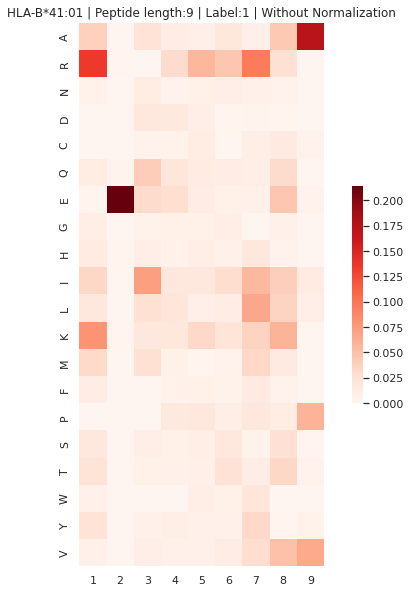



--------------------------


HLA and Label are filtered.
#Peptides: 1500
HLA: HLA-C*12:03
Threshold: 0.18
RAYDRIRRL

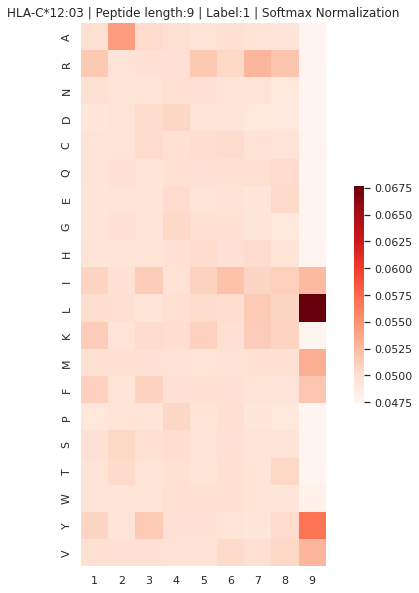

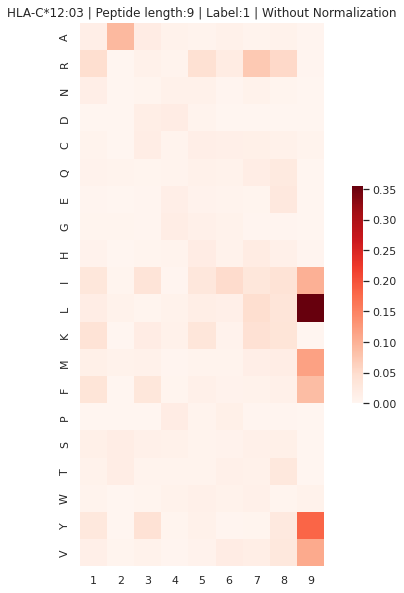



--------------------------


HLA and Label are filtered.
#Peptides: 15673
HLA: HLA-A*02:01
Threshold: 0.16
RLLEIIIRL

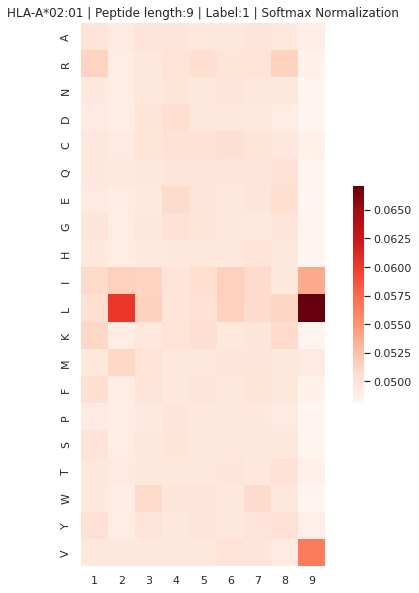

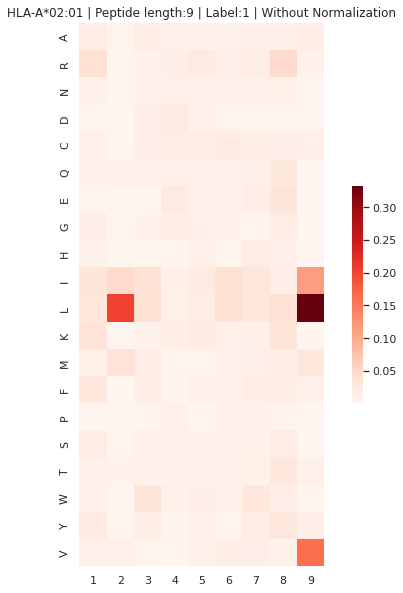



--------------------------


HLA and Label are filtered.
#Peptides: 4125
HLA: HLA-B*40:02
Threshold: 0.32
REILIIRRL

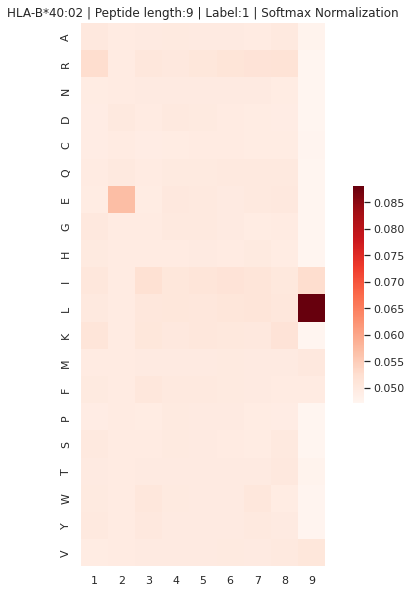

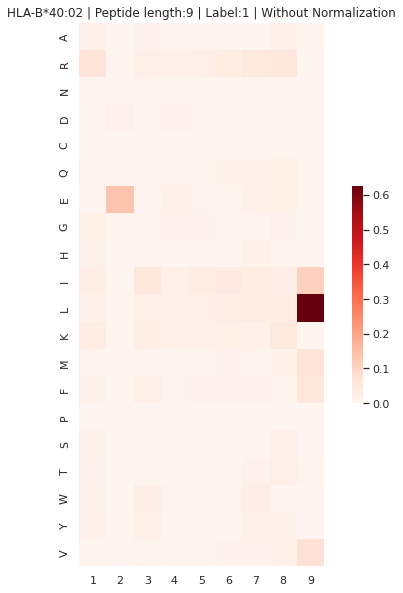



--------------------------


HLA and Label are filtered.
#Peptides: 94
HLA: HLA-B*48:01
Threshold: 0.33
RQWGIWWIL

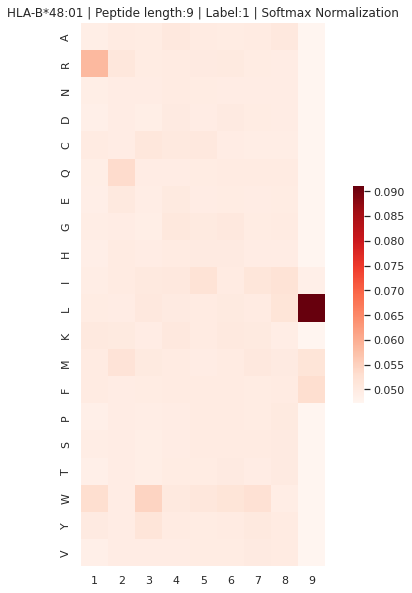

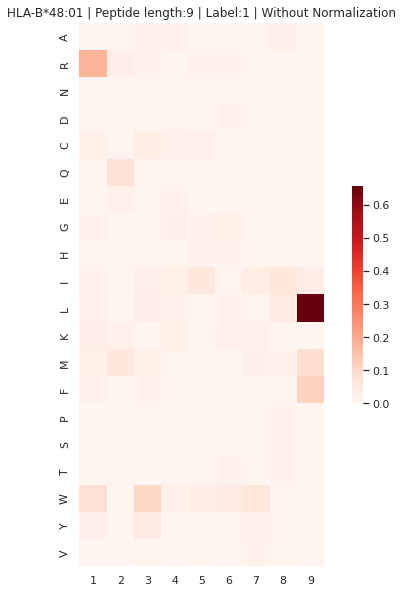



--------------------------


HLA and Label are filtered.
#Peptides: 2609
HLA: HLA-C*16:01
Threshold: 0.23
RAIERRREL

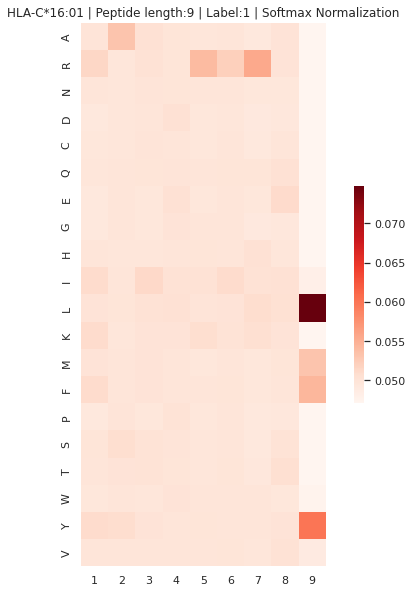

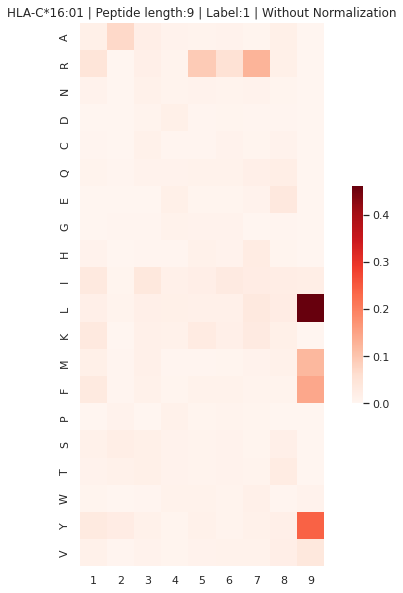



--------------------------


HLA and Label are filtered.
#Peptides: 1831
HLA: HLA-A*02:05
Threshold: 0.26
KLIEIIQRL

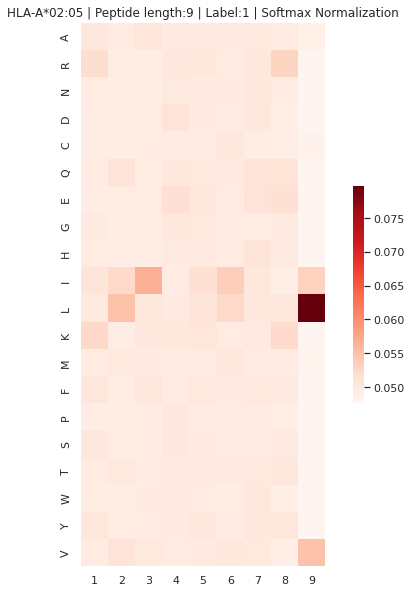

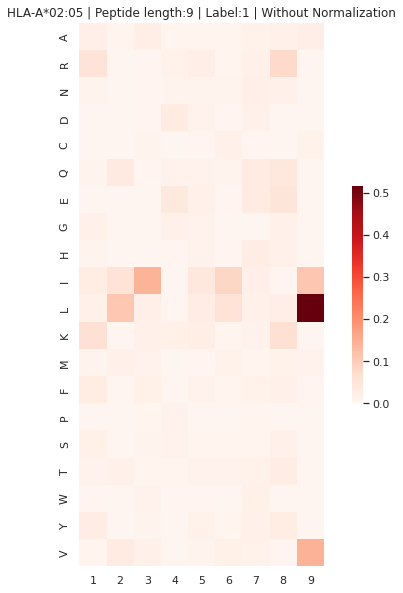



--------------------------


HLA and Label are filtered.
#Peptides: 2751
HLA: HLA-B*37:01
Threshold: 0.26
REILRLLRI

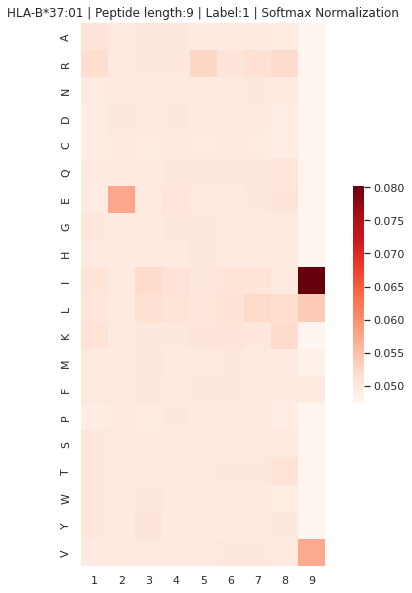

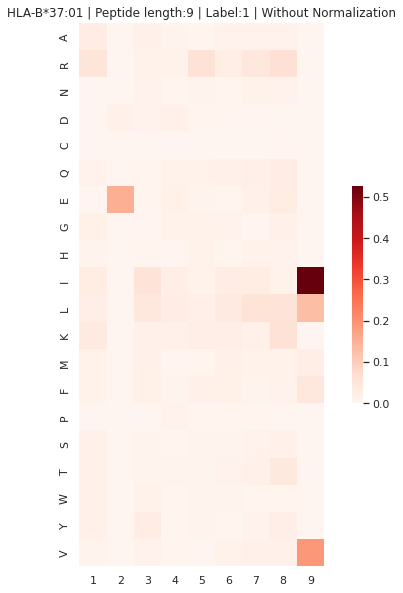



--------------------------


HLA and Label are filtered.
#Peptides: 2944
HLA: HLA-B*49:01
Threshold: 0.28
REILRLLRI

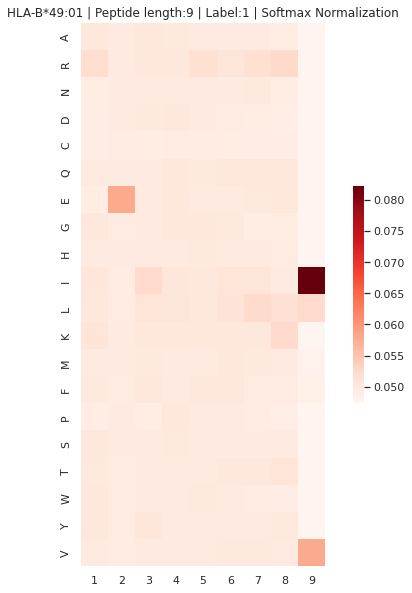

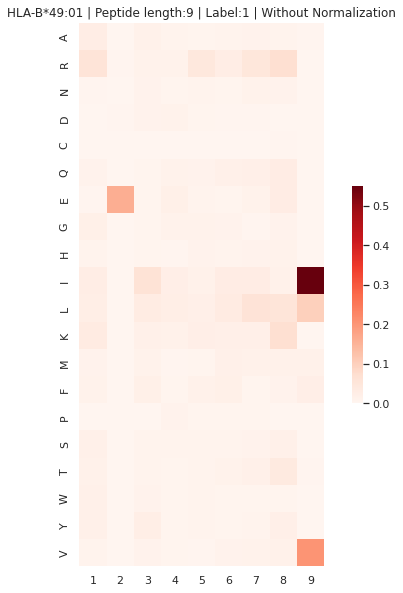



--------------------------


HLA and Label are filtered.
#Peptides: 335
HLA: HLA-C*17:01
Threshold: 0.44
FAIRRIIRL

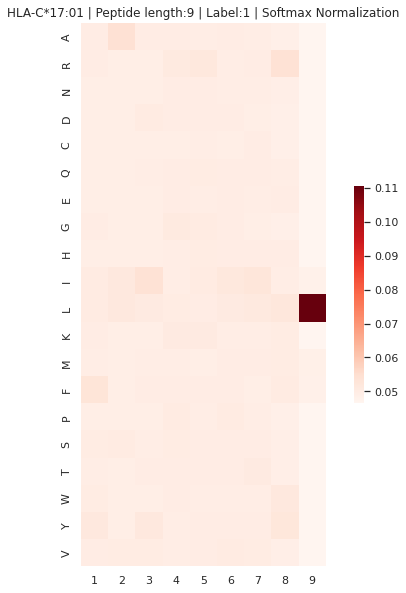

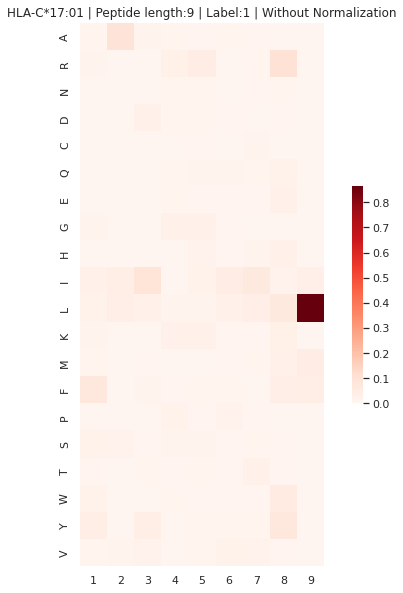



--------------------------


HLA and Label are filtered.
#Peptides: 2433
HLA: HLA-A*23:01
Threshold: 0.15
RYIKRLLRL

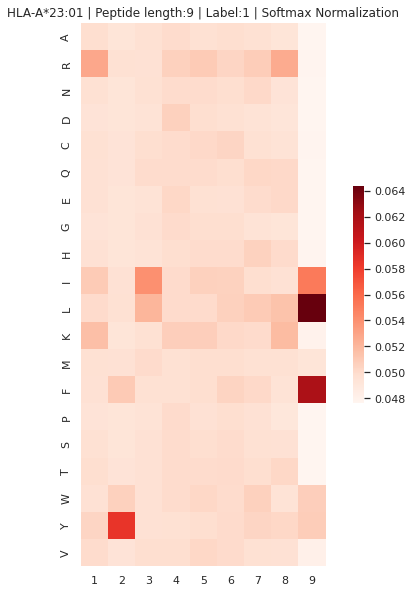

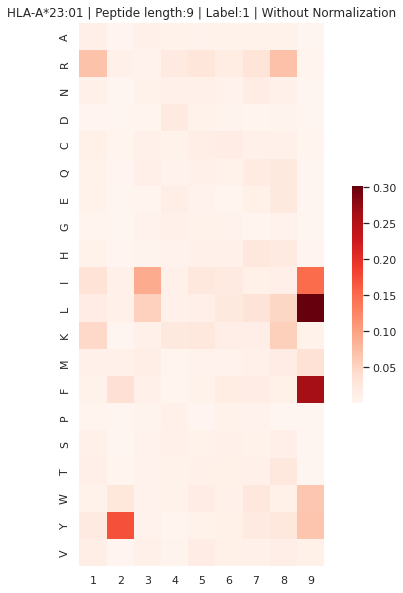



--------------------------


HLA and Label are filtered.
#Peptides: 1256
HLA: HLA-B*50:01
Threshold: 0.1
REIERLREA

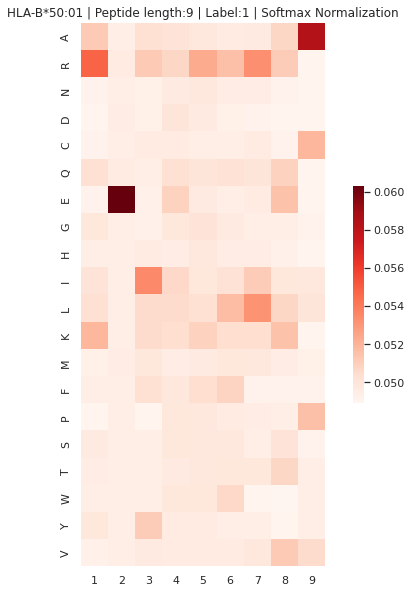

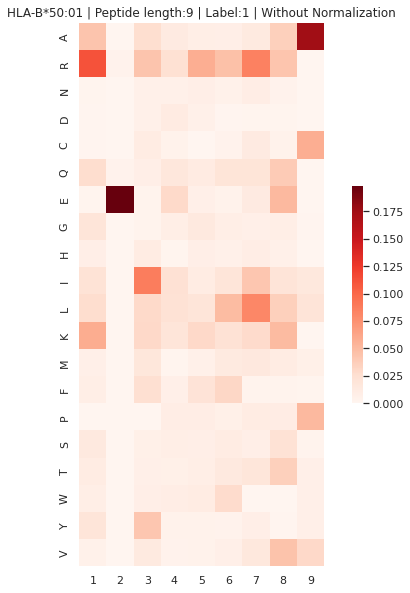



--------------------------


HLA and Label are filtered.
#Peptides: 1193
HLA: HLA-B*46:01
Threshold: 0.23
FIIDWLLEY

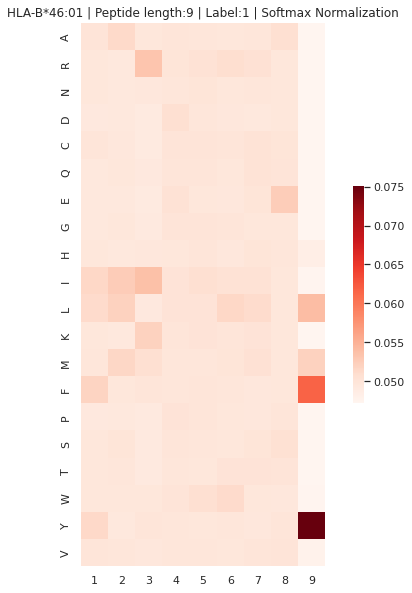

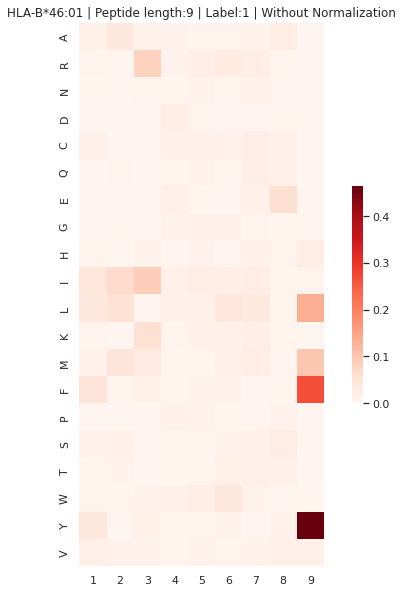



--------------------------


HLA and Label are filtered.
#Peptides: 1441
HLA: HLA-C*15:02
Threshold: 0.2
RSIDRILLL

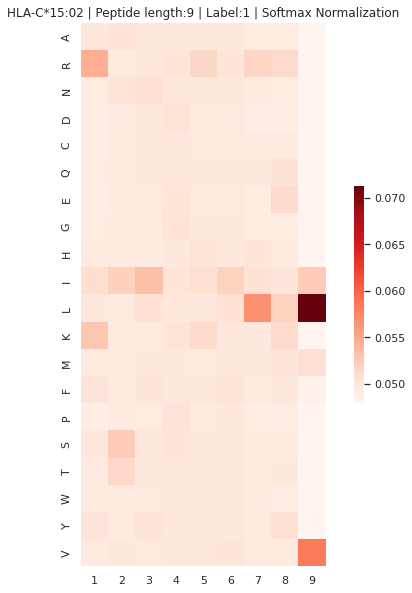

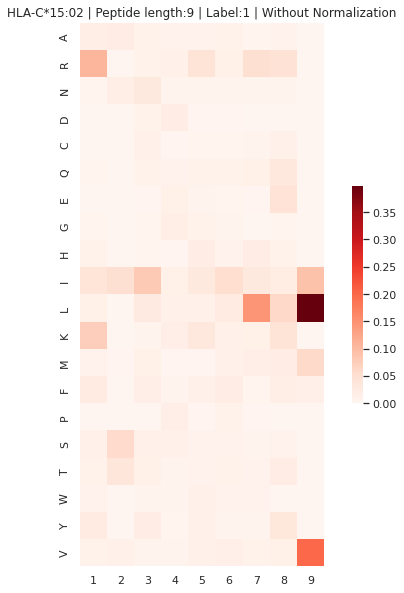



--------------------------


HLA and Label are filtered.
#Peptides: 1263
HLA: HLA-B*39:06
Threshold: 0.13
QRLLLILAA

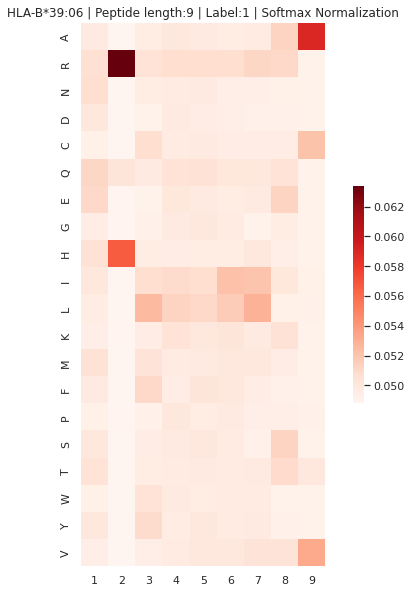

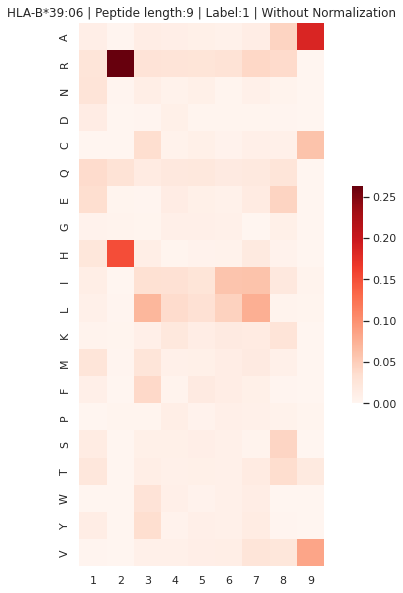



--------------------------


HLA and Label are filtered.
#Peptides: 70
HLA: HLA-A*32:07
Threshold: 0.14
RMWWWRWPL

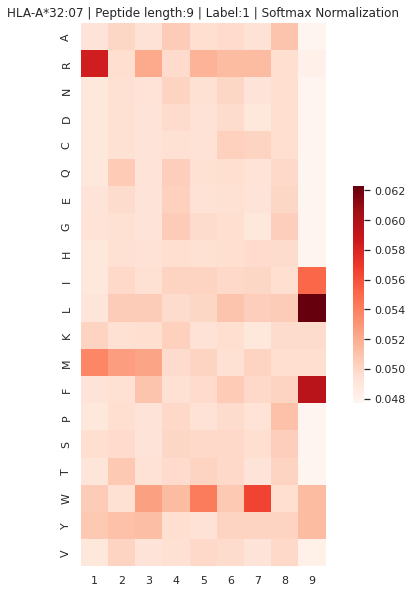

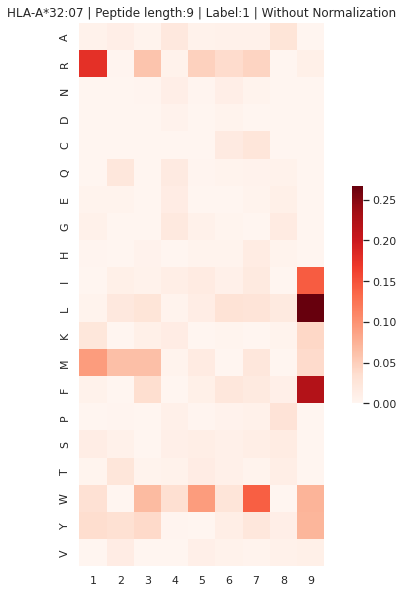



--------------------------


HLA and Label are filtered.
#Peptides: 6524
HLA: HLA-B*35:01
Threshold: 0.28
LPIRIILRY

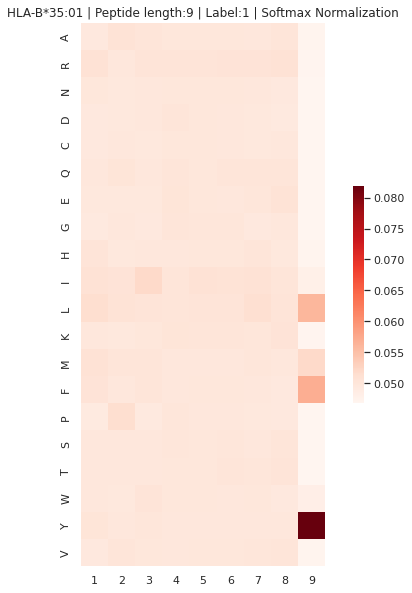

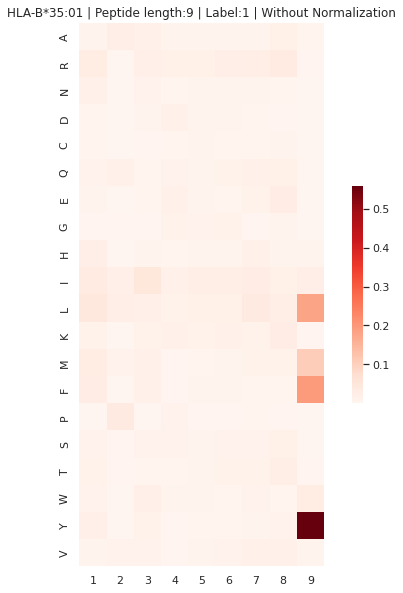



--------------------------


HLA and Label are filtered.
#Peptides: 404
HLA: HLA-B*27:03
Threshold: 0.27
RRLWIILLL

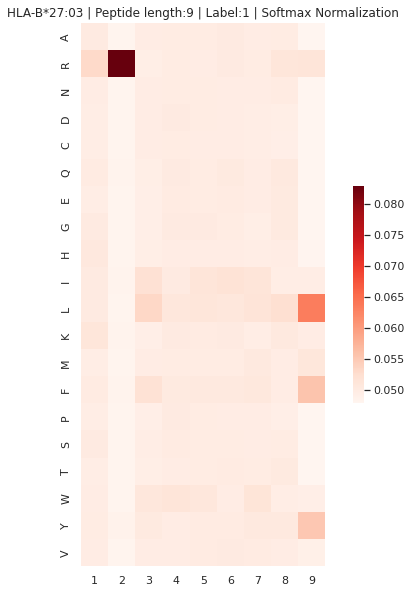

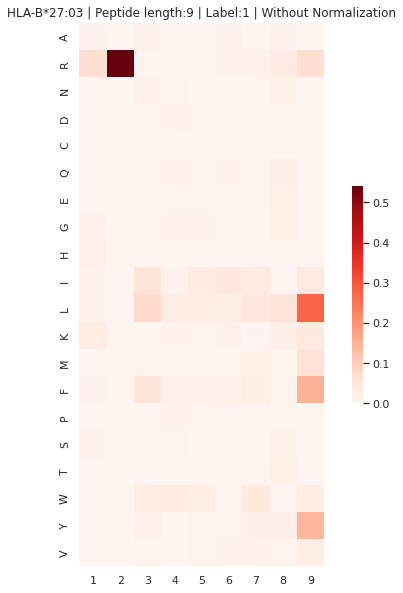



--------------------------


HLA and Label are filtered.
#Peptides: 114
HLA: HLA-A*02:17
Threshold: 0.13
ILWCGCWWL

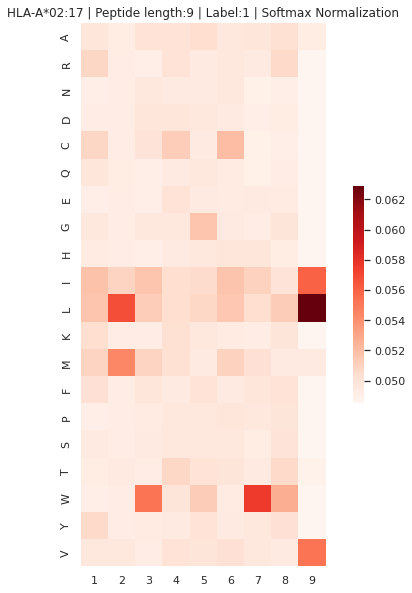

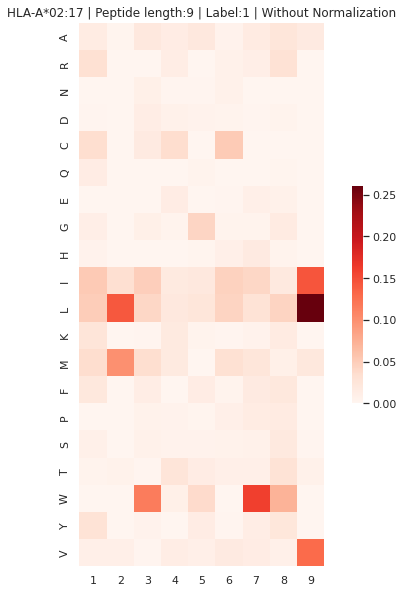



--------------------------


HLA and Label are filtered.
#Peptides: 4100
HLA: HLA-A*29:02
Threshold: 0.47
RLLRIRLLY

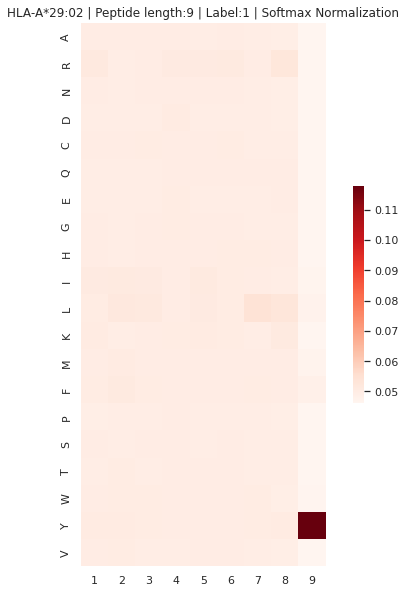

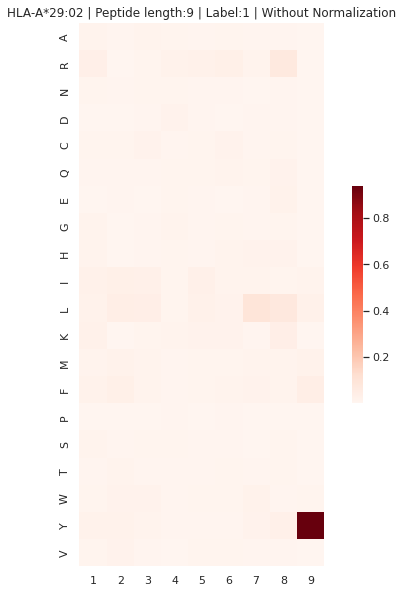



--------------------------


HLA and Label are filtered.
#Peptides: 860
HLA: HLA-A*69:01
Threshold: 0.16
ETLRIIWRL

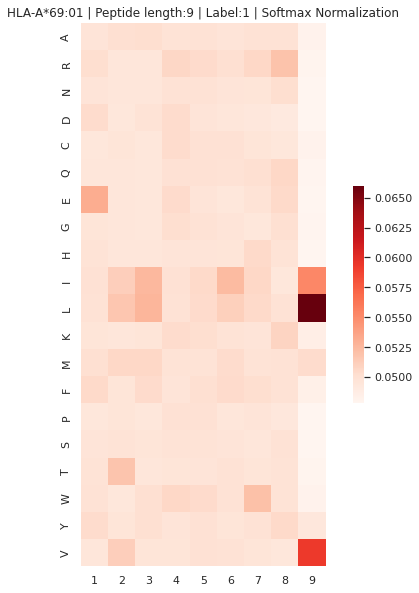

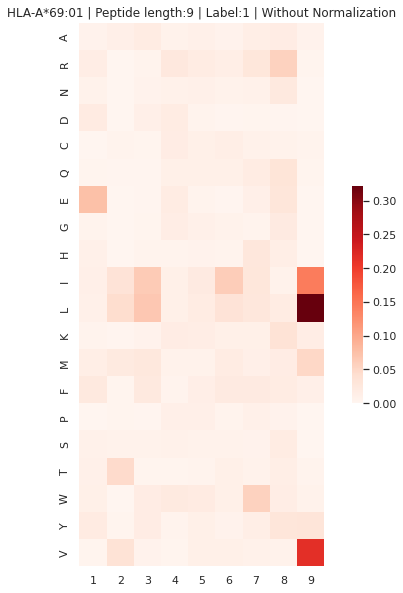



--------------------------


HLA and Label are filtered.
#Peptides: 211
HLA: HLA-B*15:02
Threshold: 0.34
ILREWWRAY

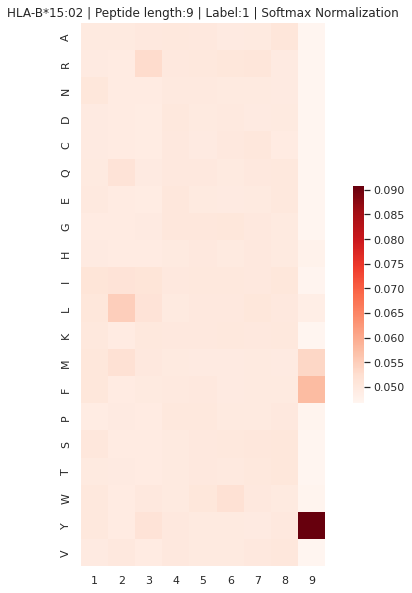

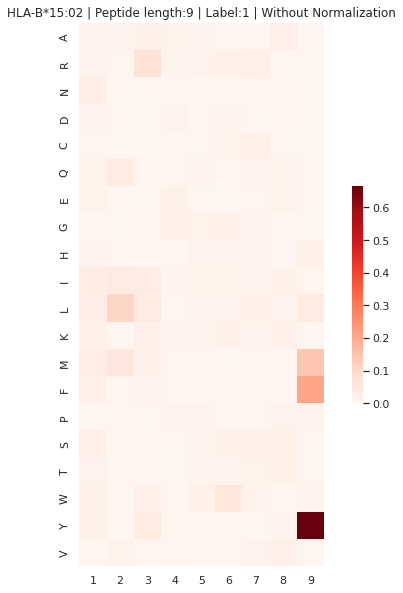



--------------------------


HLA and Label are filtered.
#Peptides: 2485
HLA: HLA-C*07:02
Threshold: 0.25
RRYDRILLL

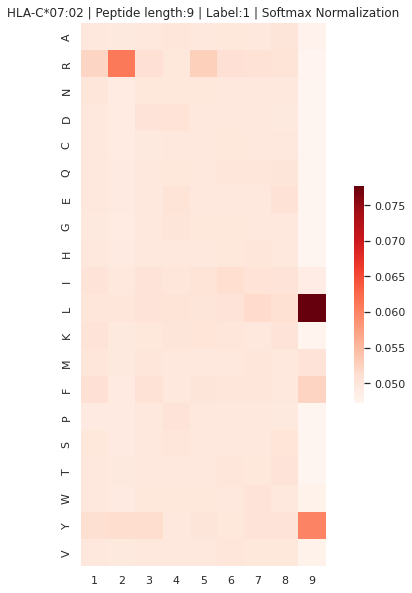

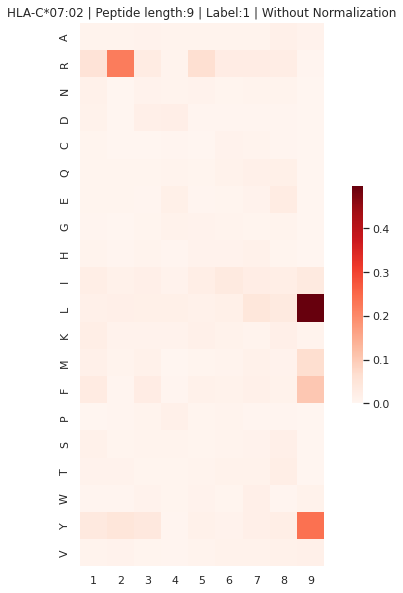



--------------------------


HLA and Label are filtered.
#Peptides: 327
HLA: HLA-B*15:03
Threshold: 0.19
IMICCINIF

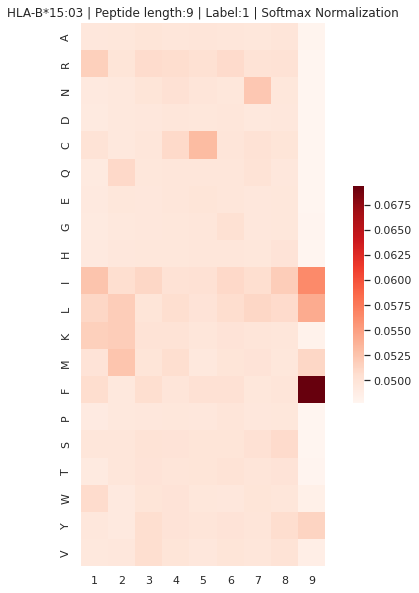

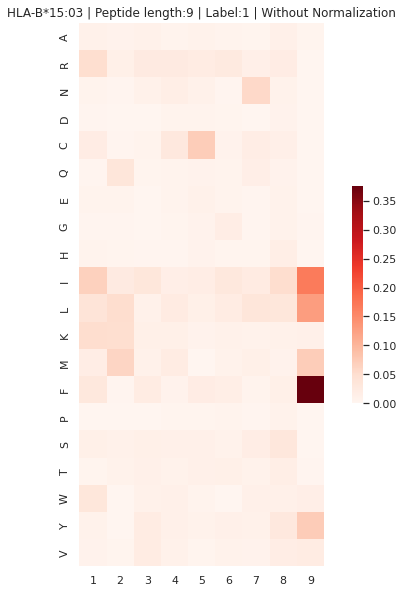



--------------------------


HLA and Label are filtered.
#Peptides: 4421
HLA: HLA-C*06:02
Threshold: 0.2
RRIDIIRLL

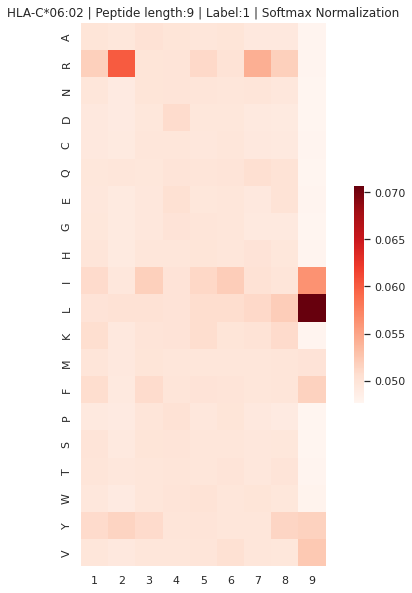

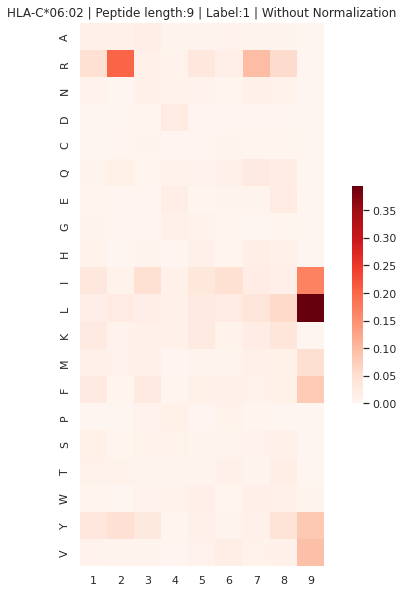



--------------------------


HLA and Label are filtered.
#Peptides: 76
HLA: HLA-B*14:01
Threshold: 0.38
DRYLRIISL

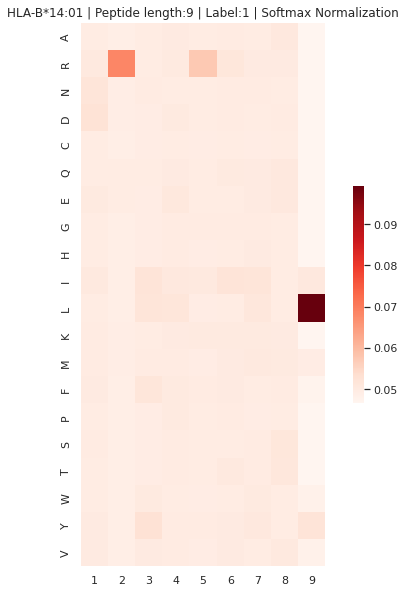

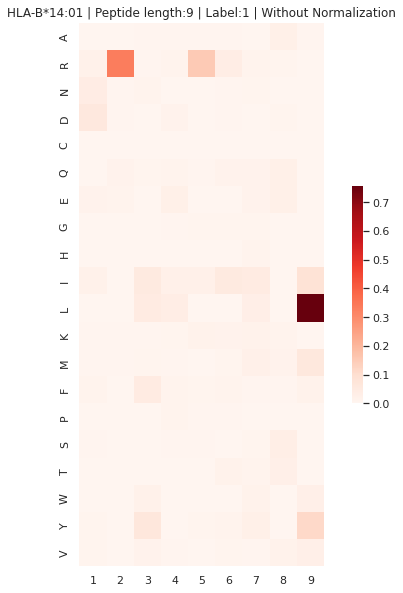



--------------------------


HLA and Label are filtered.
#Peptides: 8205
HLA: HLA-B*07:02
Threshold: 0.36
RPRLRRLSL

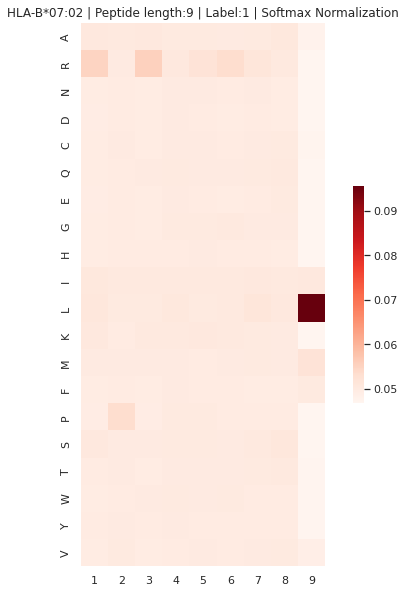

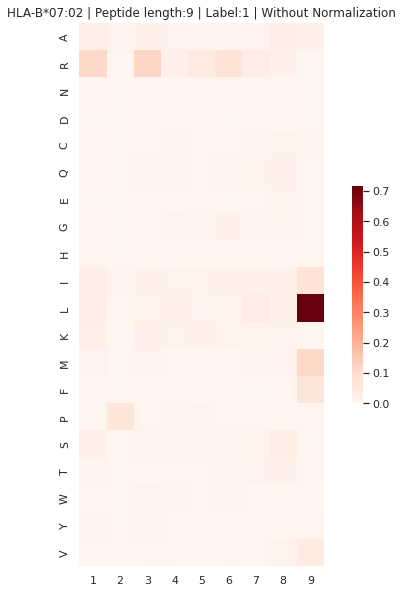



--------------------------


HLA and Label are filtered.
#Peptides: 9542
HLA: HLA-B*15:01
Threshold: 0.28
RLIRIRLRY

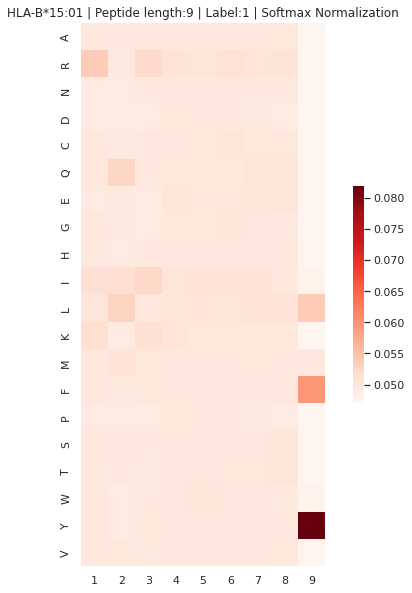

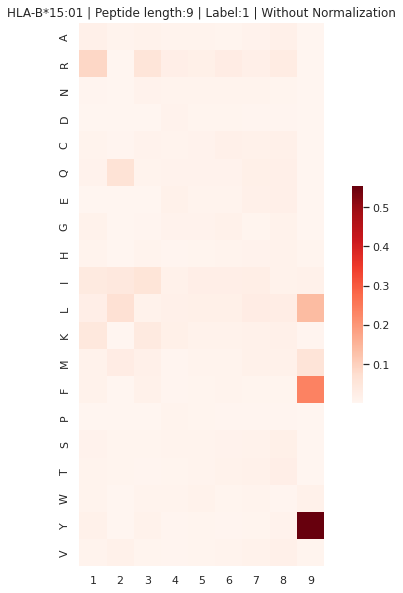



--------------------------


HLA and Label are filtered.
#Peptides: 5409
HLA: HLA-A*11:01
Threshold: 0.32
RIIIIILLK

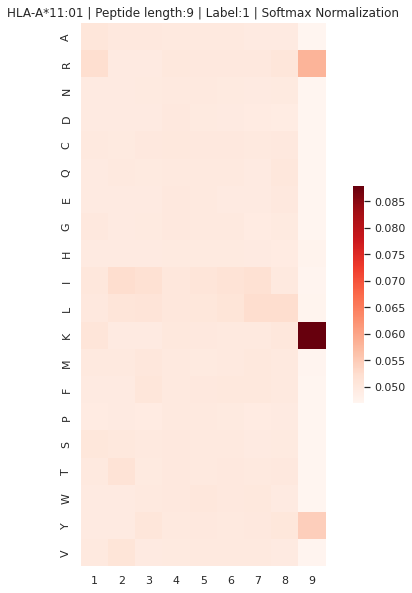

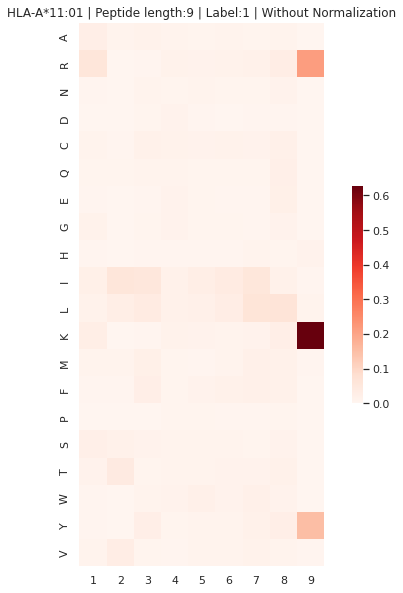



--------------------------


HLA and Label are filtered.
#Peptides: 283
HLA: HLA-B*15:42
Threshold: 0.13
RMMWRWLYL

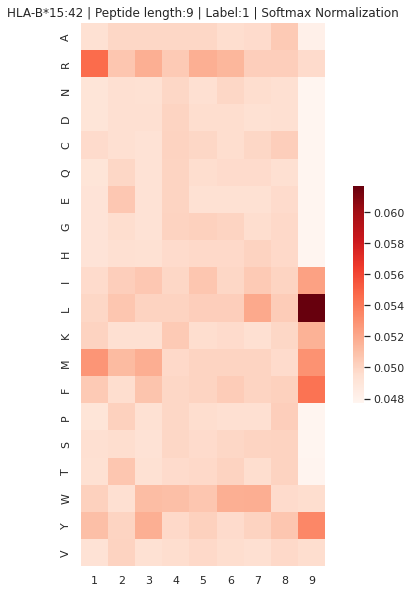

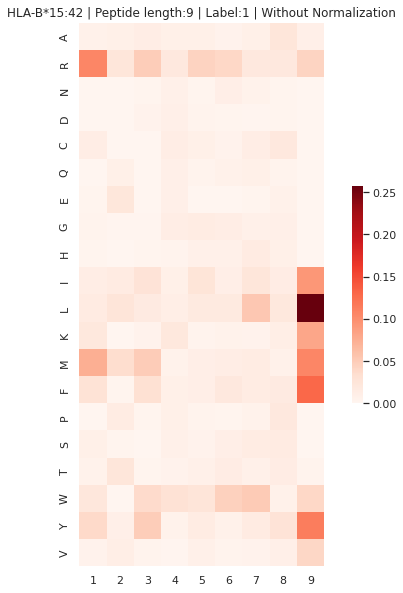



--------------------------


HLA and Label are filtered.
#Peptides: 3193
HLA: HLA-A*02:06
Threshold: 0.16
RLICILWRL

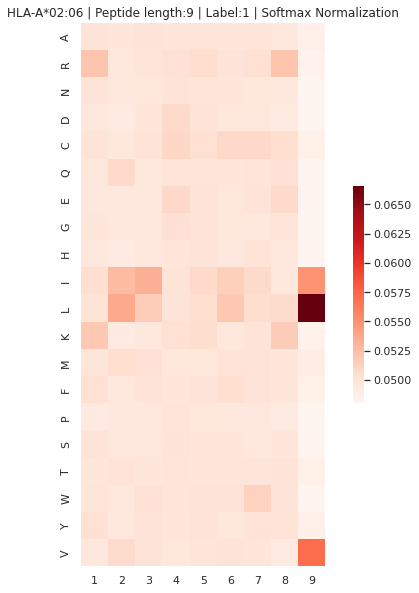

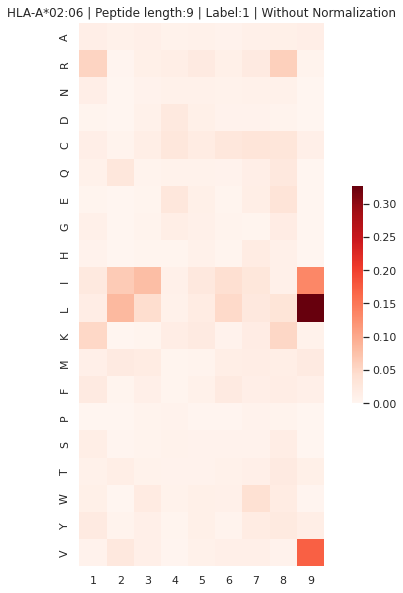



--------------------------


HLA and Label are filtered.
#Peptides: 7340
HLA: HLA-A*03:01
Threshold: 0.29
RLYLRILLK

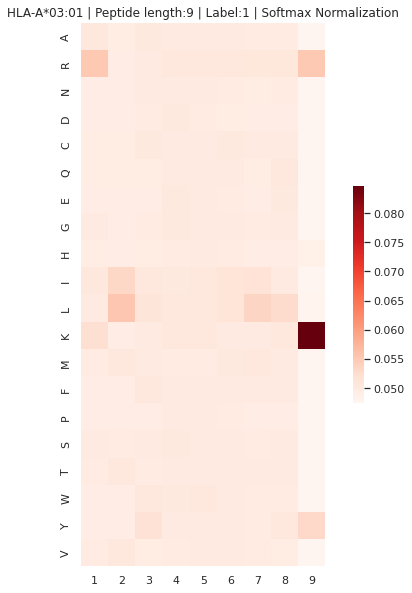

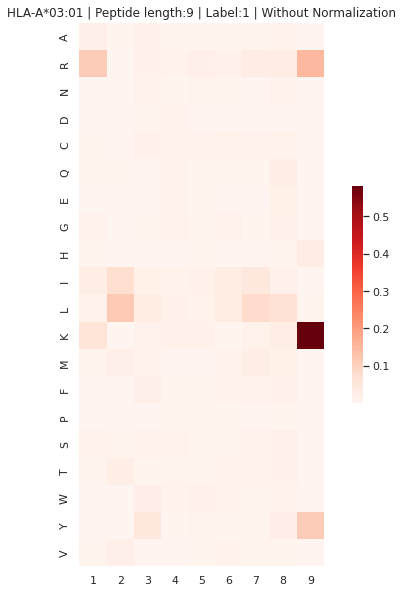



--------------------------


HLA and Label are filtered.
#Peptides: 408
HLA: HLA-B*73:01
Threshold: 0.4
NRLLIRLIP

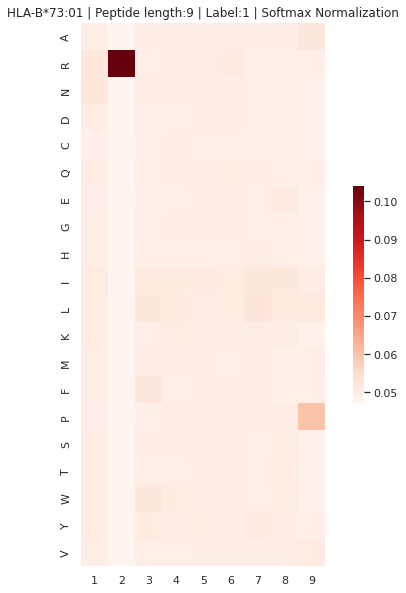

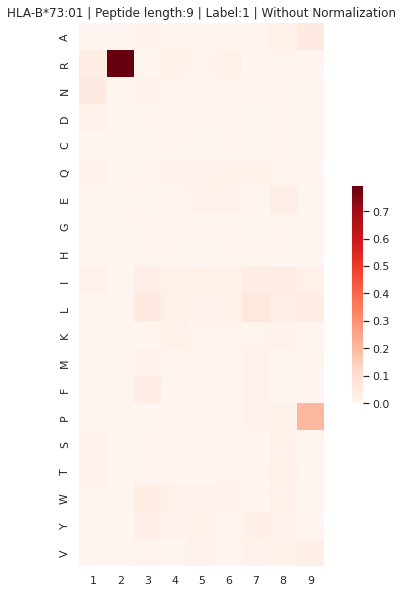



--------------------------


HLA and Label are filtered.
#Peptides: 1208
HLA: HLA-A*02:02
Threshold: 0.14
RLCCCCWLL

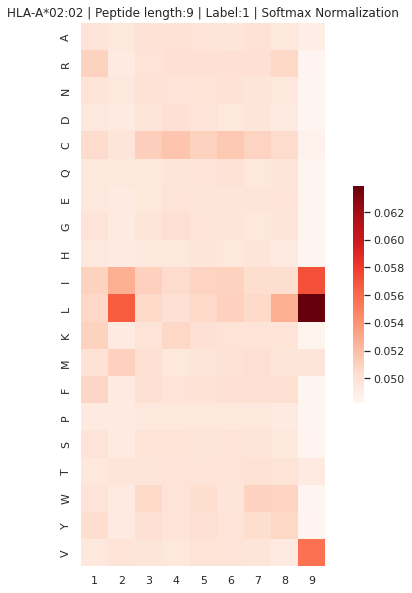

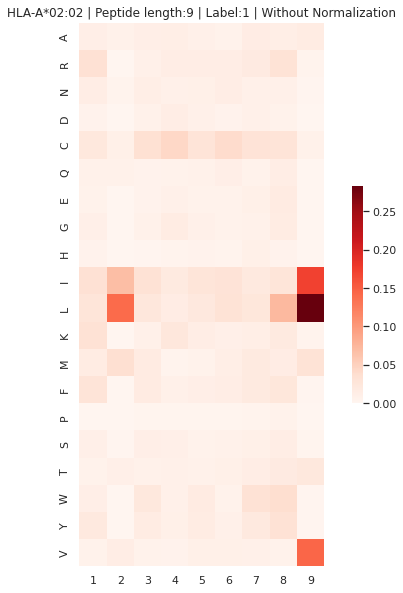



--------------------------


HLA and Label are filtered.
#Peptides: 880
HLA: HLA-B*27:07
Threshold: 0.3
IRILIIILL

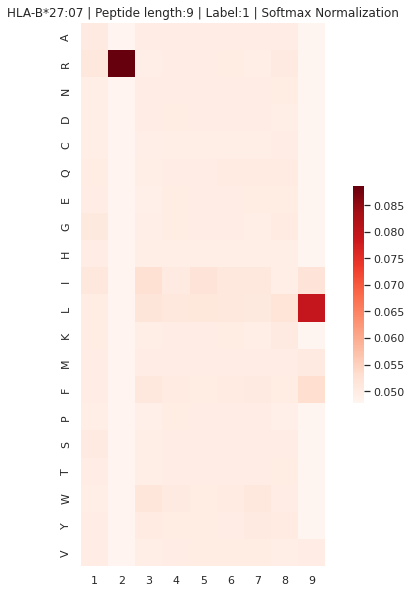

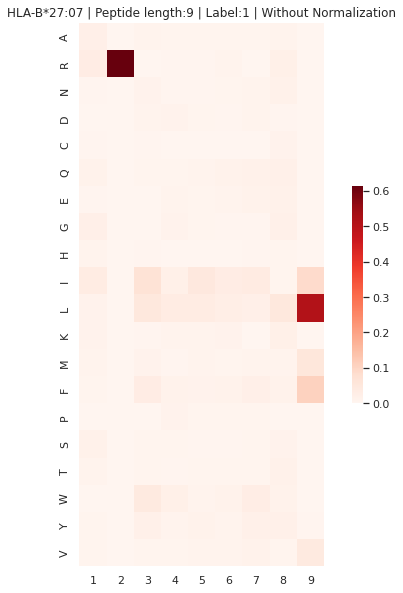



--------------------------


HLA and Label are filtered.
#Peptides: 3789
HLA: HLA-C*03:03
Threshold: 0.32
RAIPRRREL

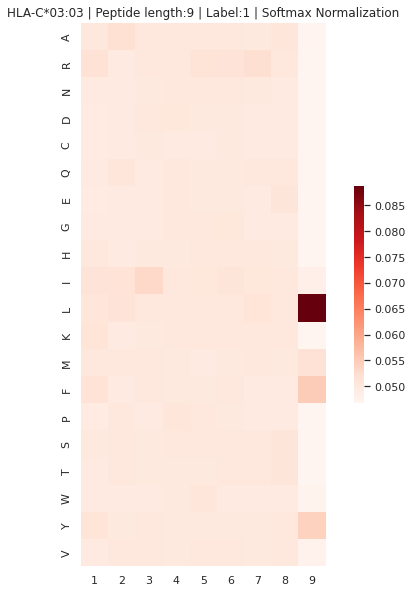

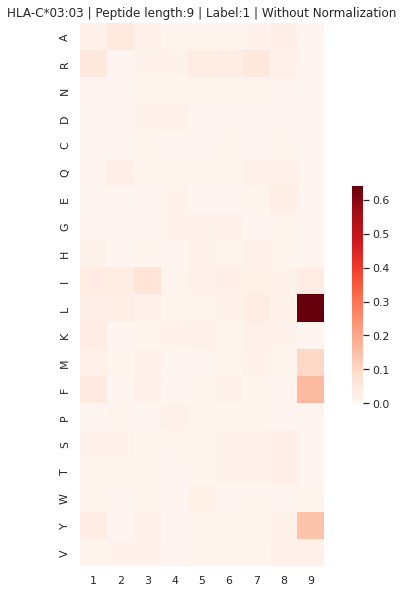



--------------------------


HLA and Label are filtered.
#Peptides: 2437
HLA: HLA-B*27:09
Threshold: 0.28
RRLLIIILL

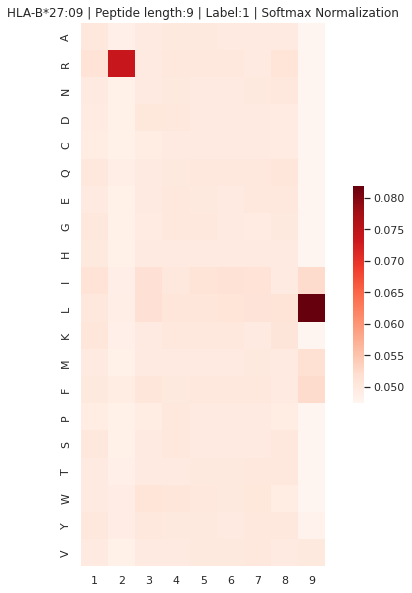

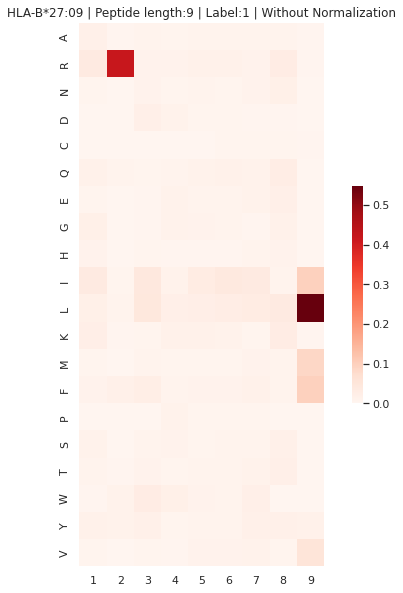



--------------------------


HLA and Label are filtered.
#Peptides: 3374
HLA: HLA-C*03:04
Threshold: 0.31
FLIERRREL

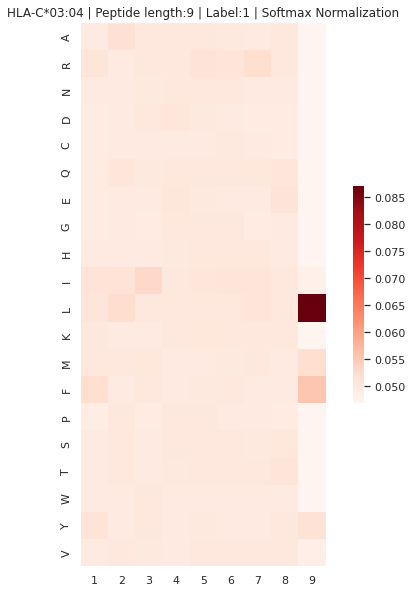

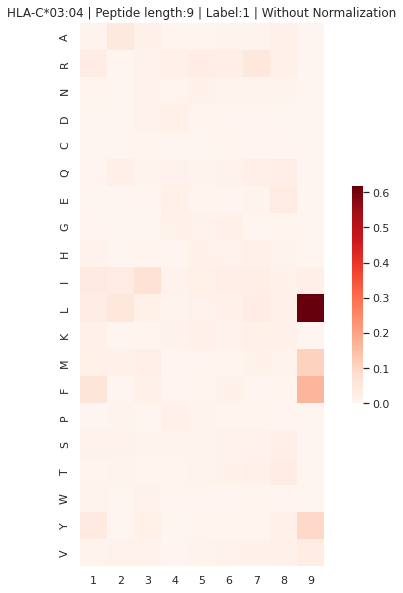



--------------------------


HLA and Label are filtered.
#Peptides: 92
HLA: HLA-A*24:06
Threshold: 0.2
IYIKKIRRF

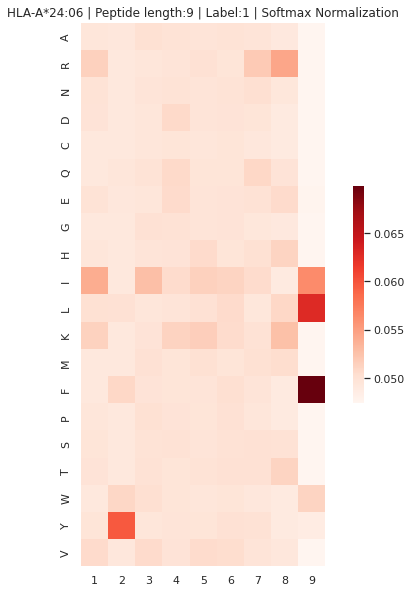

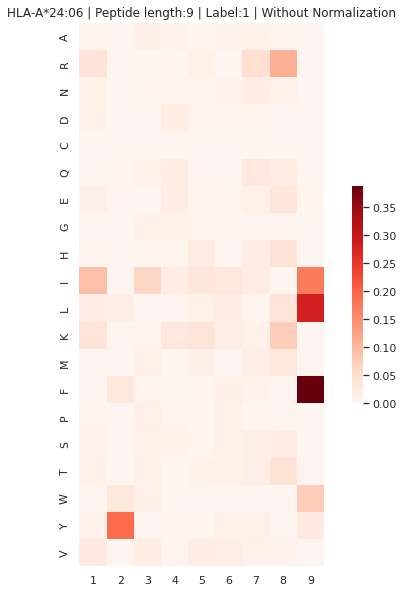

In [42]:
  
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))
for HLA_filter in HLA_list:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo =  fnc.draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 1 , length = 9 , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    



--------------------------
8 1
#Peptides: 627
HLA: HLA-A*02:01
Start
Threshold: 0.24
Pos
KLKKRHKLDraw


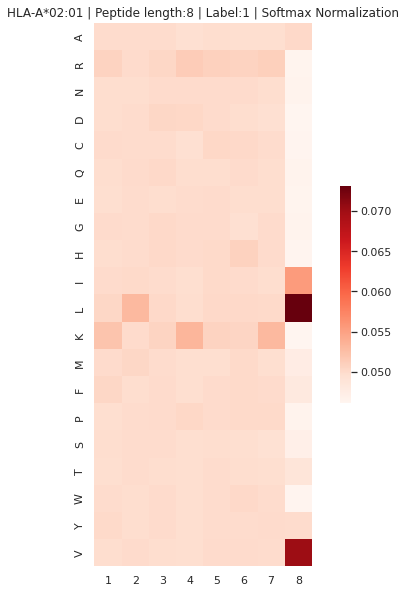

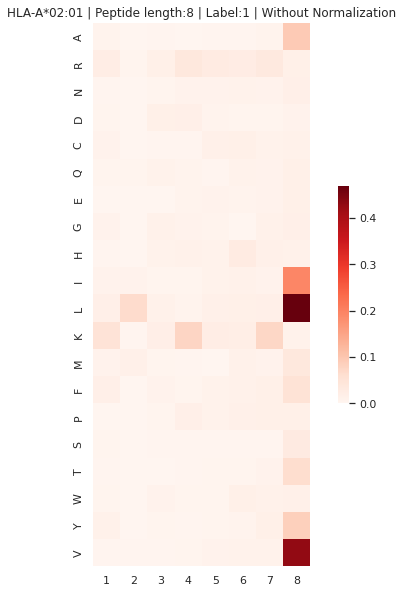









--------------------------
8 1
#Peptides: 924
HLA: HLA-B*08:01
Start
Threshold: 0.68
Pos
DLKRKHRLDraw


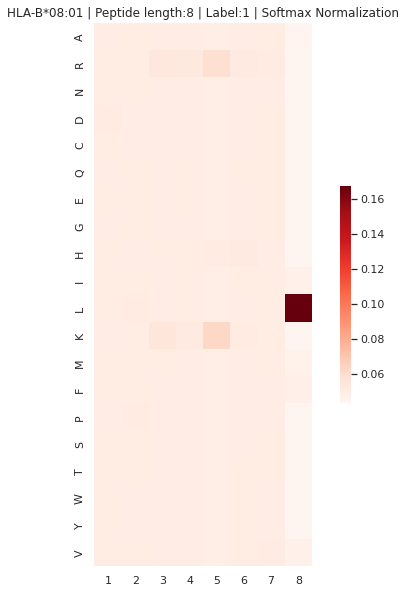

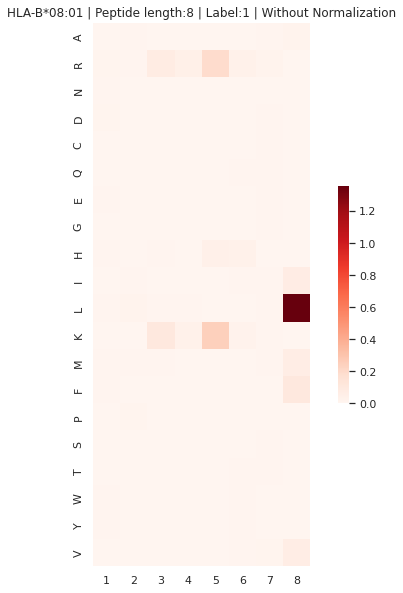









--------------------------
8 1
#Peptides: 0
HLA: HLA-B*27:02
Start
Threshold: nan
Pos
AAAAAAAADraw


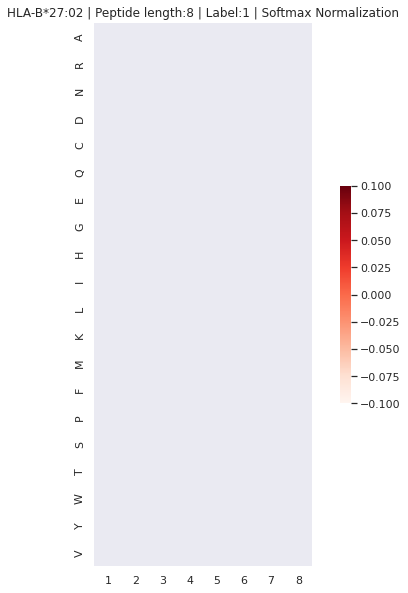

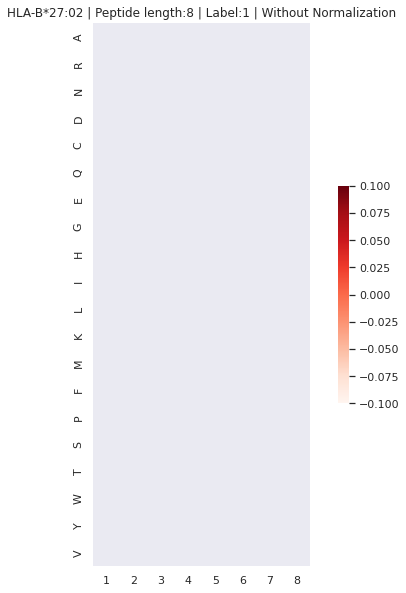









--------------------------
8 1
#Peptides: 574
HLA: HLA-C*05:01
Start
Threshold: 0.48
Pos
KLDKHRKLDraw


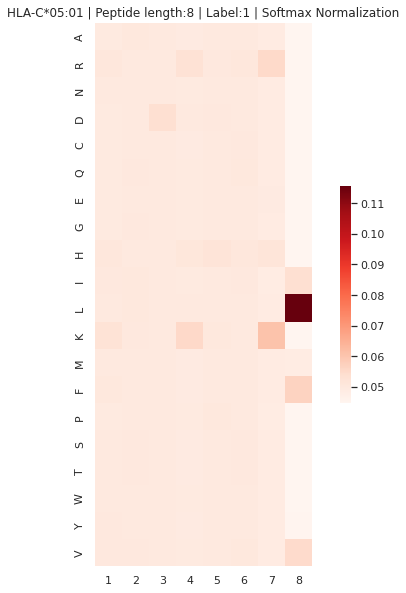

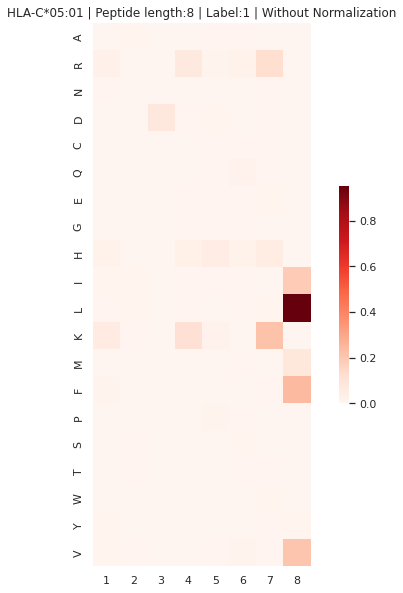









--------------------------
9 1
#Peptides: 15673
HLA: HLA-A*02:01
Start
Threshold: 0.32
Pos
KLLKKKHKLDraw


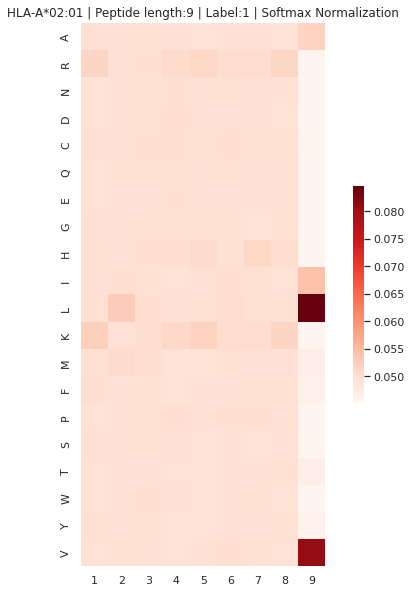

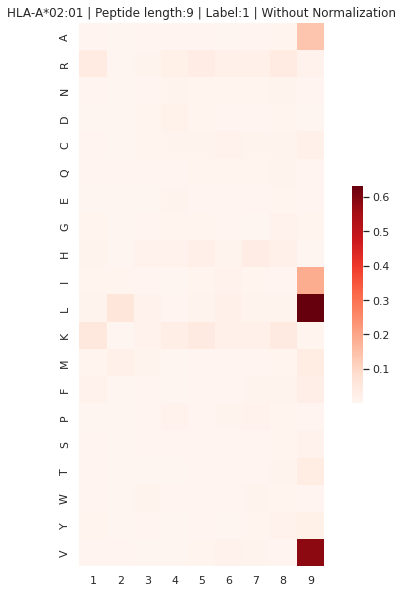









--------------------------
9 1
#Peptides: 4221
HLA: HLA-B*08:01
Start
Threshold: 0.56
Pos
RLKRRRRSLDraw


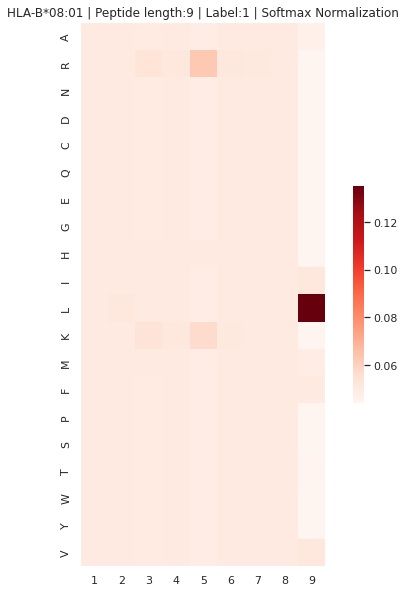

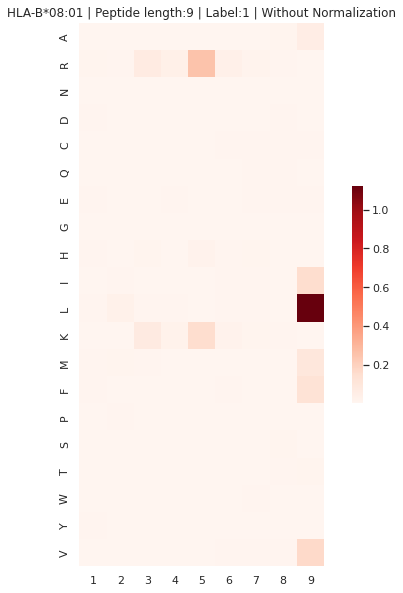









--------------------------
9 1
#Peptides: 1025
HLA: HLA-B*27:02
Start
Threshold: 0.33
Pos
RRWRRRLGFDraw


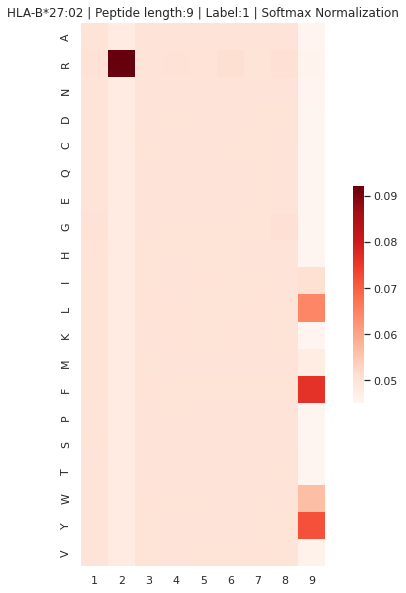

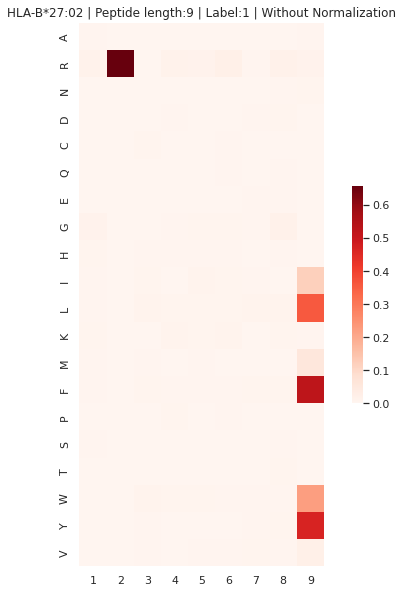









--------------------------
9 1
#Peptides: 2928
HLA: HLA-C*05:01
Start
Threshold: 0.42
Pos
KLDKKRRKLDraw


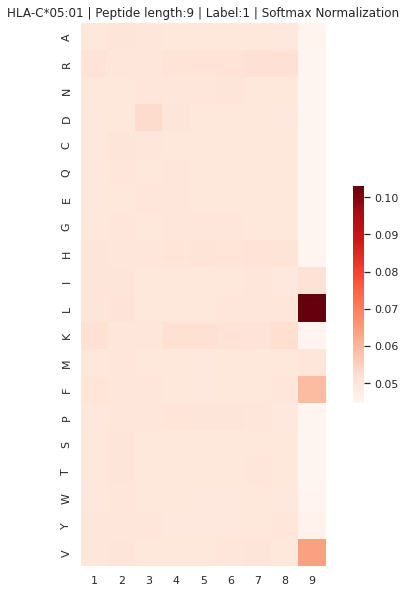

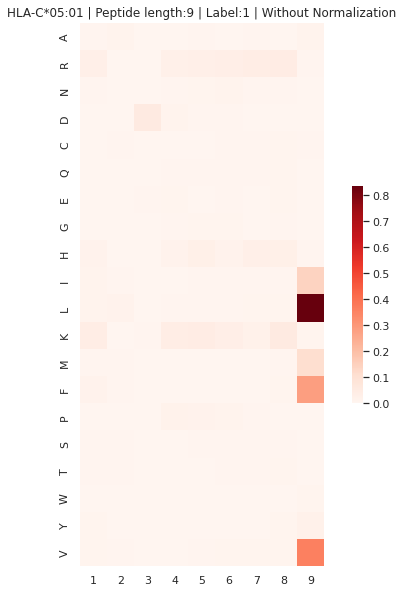









--------------------------
10 1
#Peptides: 4234
HLA: HLA-A*02:01
Start
Threshold: 0.24
Pos
KLLKKKKHKVDraw


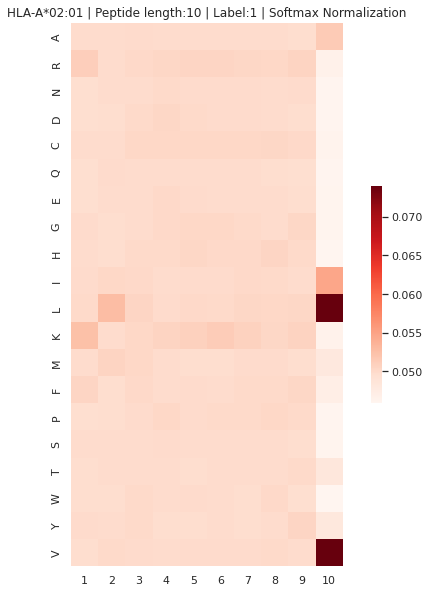

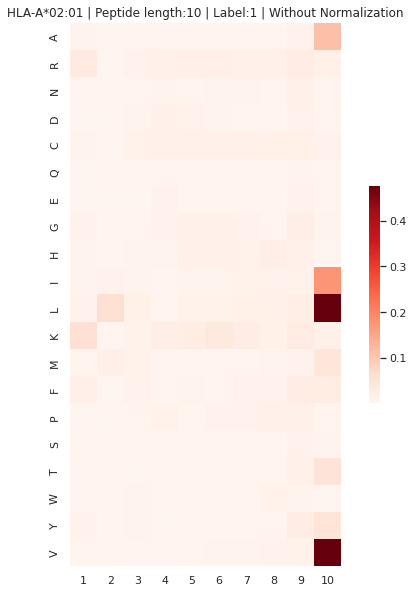









--------------------------
10 1
#Peptides: 274
HLA: HLA-B*08:01
Start
Threshold: 0.54
Pos
RRRKRKRCILDraw


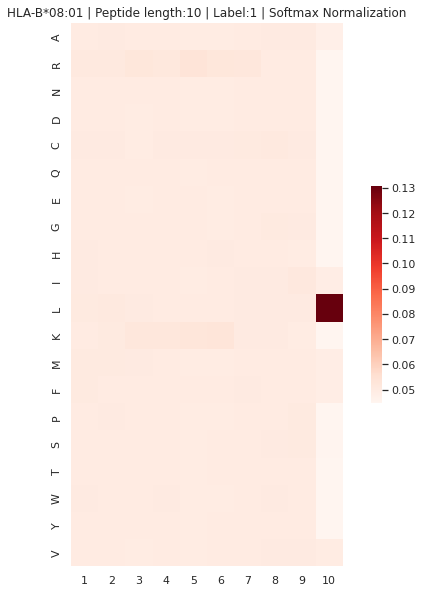

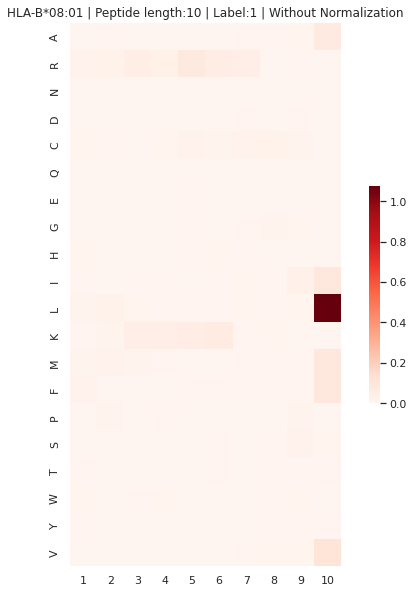









--------------------------
10 1
#Peptides: 720
HLA: HLA-B*27:02
Start
Threshold: 0.31
Pos
RRWKCLGLGFDraw


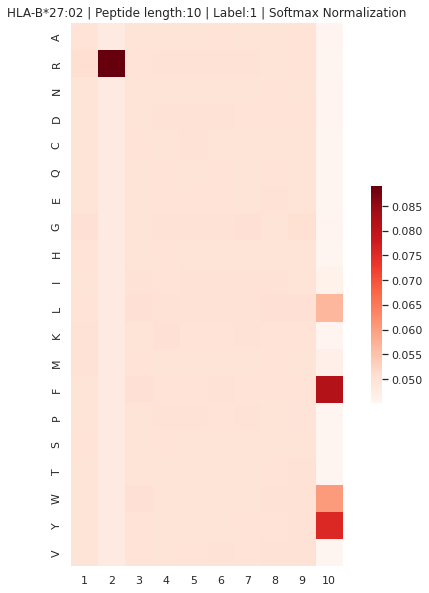

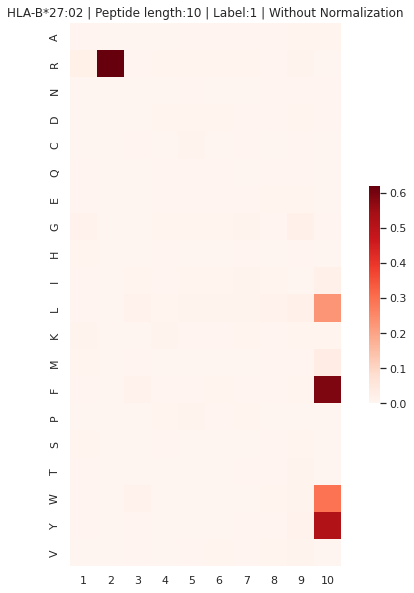









--------------------------
10 1
#Peptides: 468
HLA: HLA-C*05:01
Start
Threshold: 0.34
Pos
KLDKKRRKRLDraw


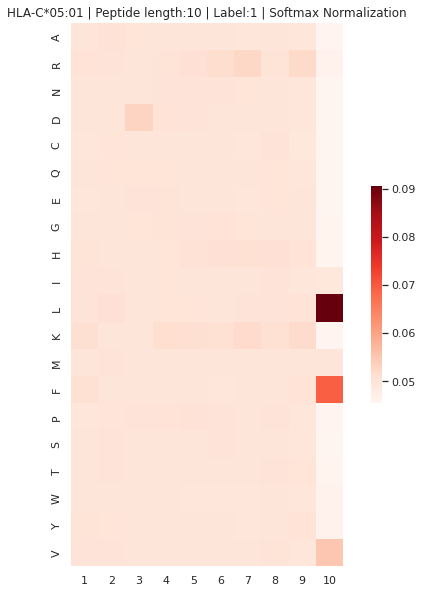

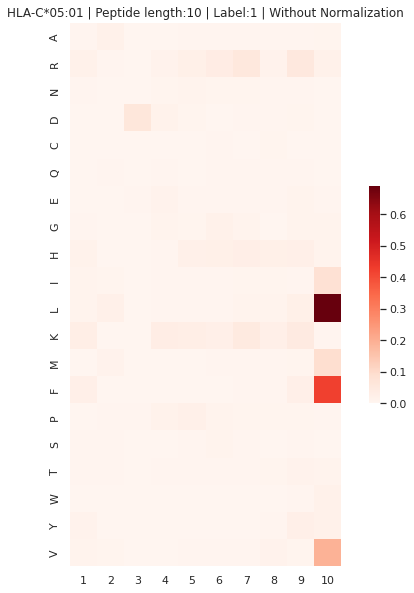









--------------------------
11 1
#Peptides: 2004
HLA: HLA-A*02:01
Start
Threshold: 0.18
Pos
KLLDKKKKLKLDraw


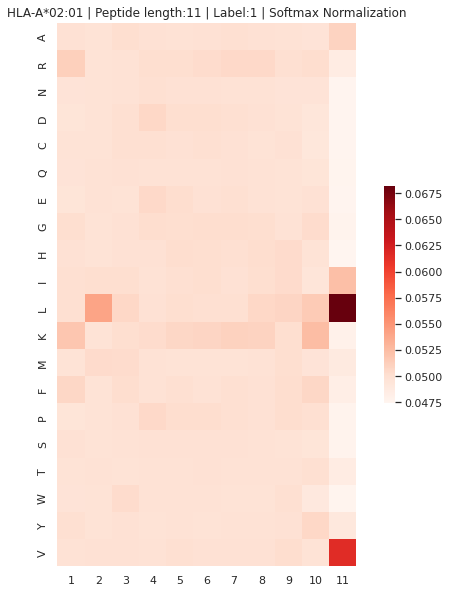

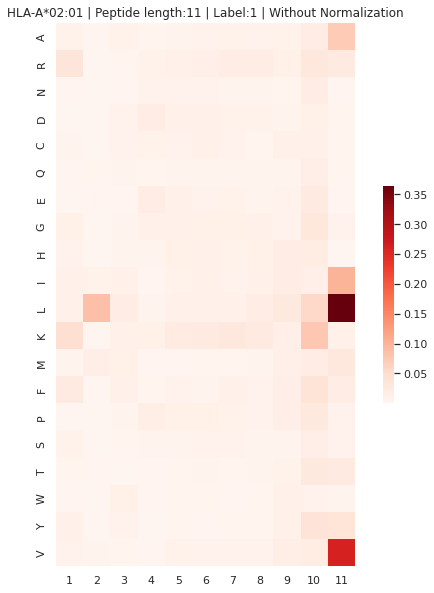









--------------------------
11 1
#Peptides: 131
HLA: HLA-B*08:01
Start
Threshold: 0.27
Pos
FLRRRCRRRPLDraw


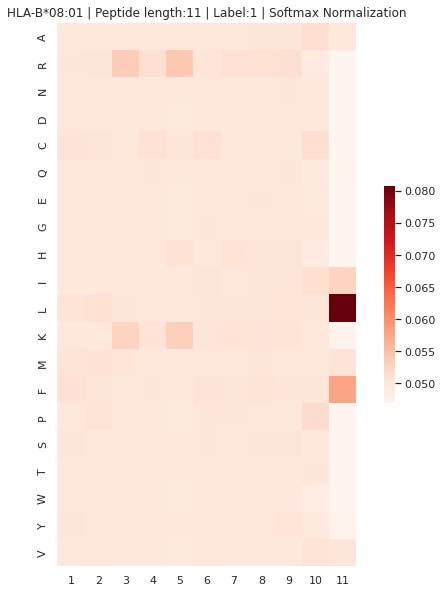

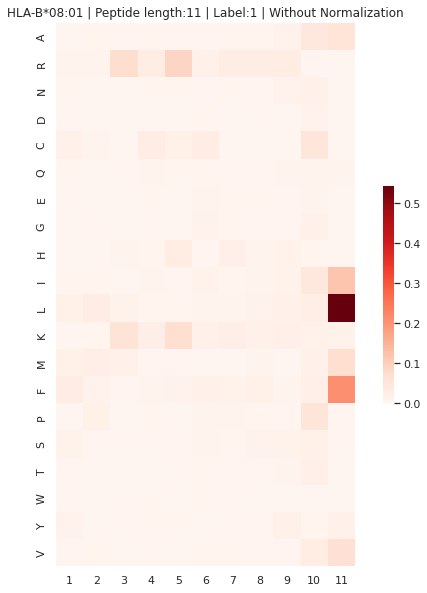









--------------------------
11 1
#Peptides: 465
HLA: HLA-B*27:02
Start
Threshold: 0.24
Pos
RRFGPKGGLYYDraw


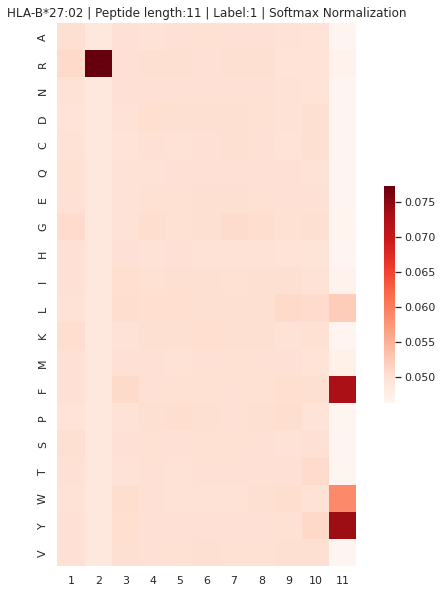

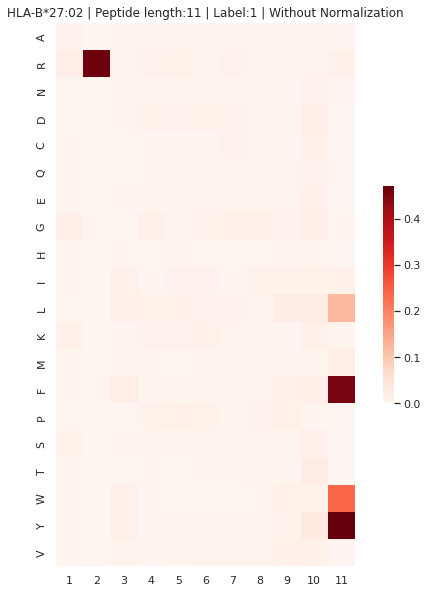









--------------------------
11 1
#Peptides: 236
HLA: HLA-C*05:01
Start
Threshold: 0.28
Pos
FLDDPRKKLKLDraw


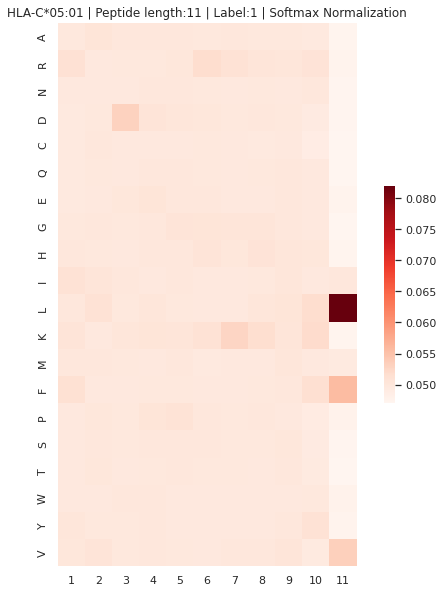

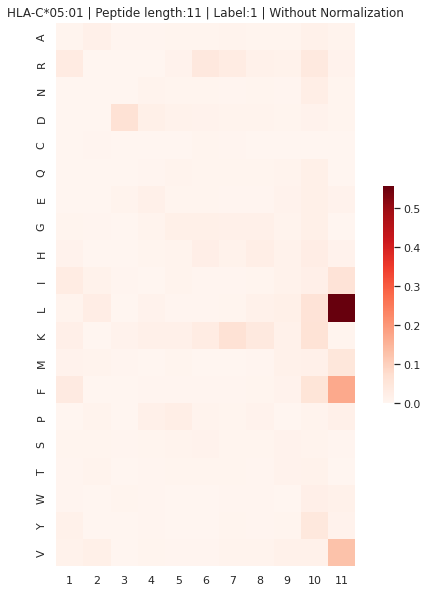









--------------------------
12 1
#Peptides: 912
HLA: HLA-A*02:01
Start
Threshold: 0.12
Pos
KLLDGKKKKLLLDraw


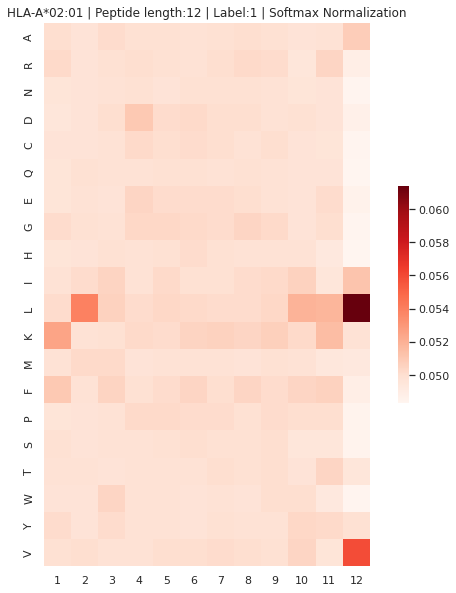

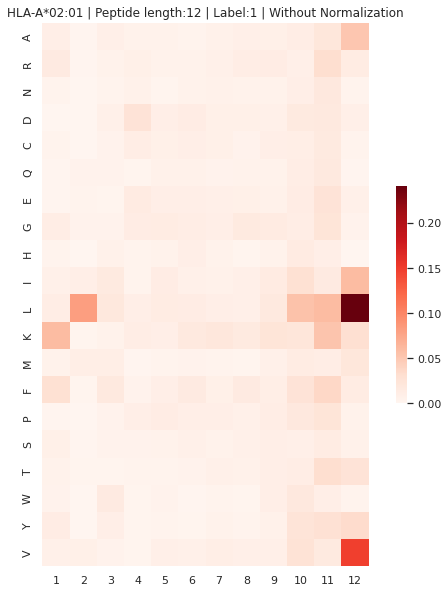









--------------------------
12 1
#Peptides: 145
HLA: HLA-B*08:01
Start
Threshold: 0.18
Pos
FLRKRFCKFCPLDraw


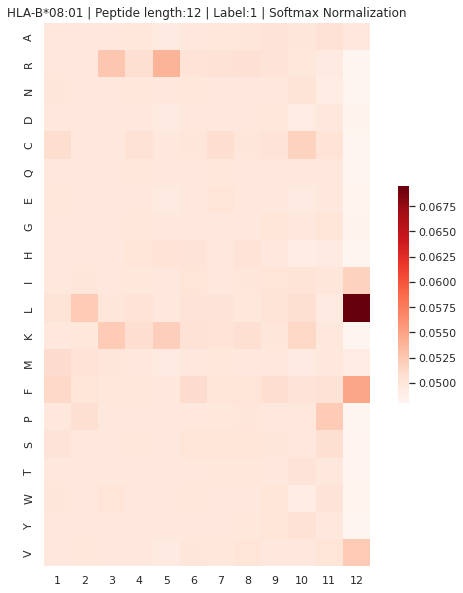

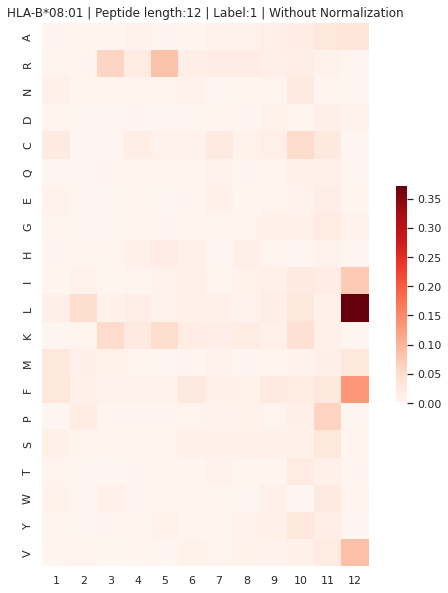









--------------------------
12 1
#Peptides: 233
HLA: HLA-B*27:02
Start
Threshold: 0.18
Pos
RRWPPKGDGWLYDraw


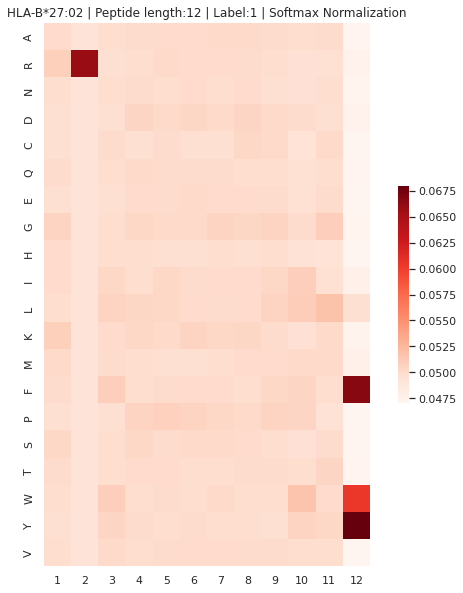

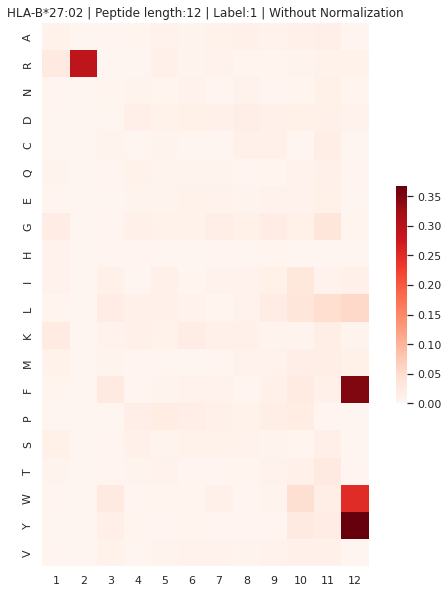









--------------------------
12 1
#Peptides: 76
HLA: HLA-C*05:01
Start
Threshold: 0.15
Pos
KADKKKKKKGFLDraw


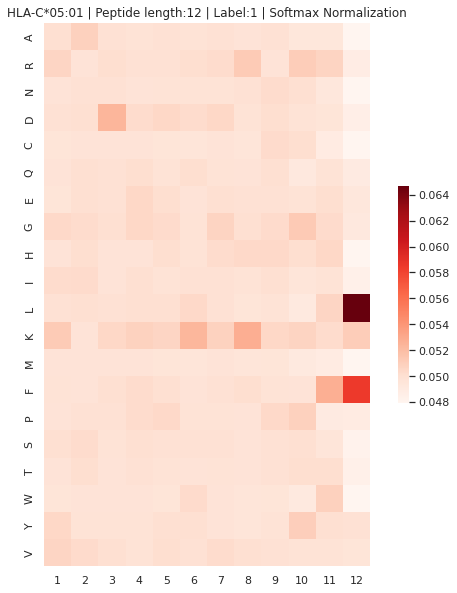

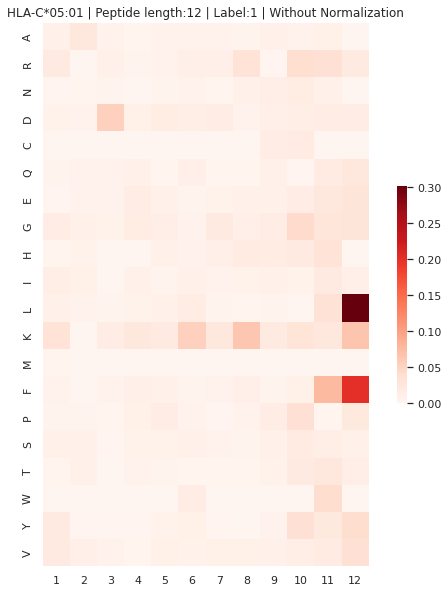









--------------------------
13 1
#Peptides: 380
HLA: HLA-A*02:01
Start
Threshold: 0.09
Pos
FLLDEGKGKKLKLDraw


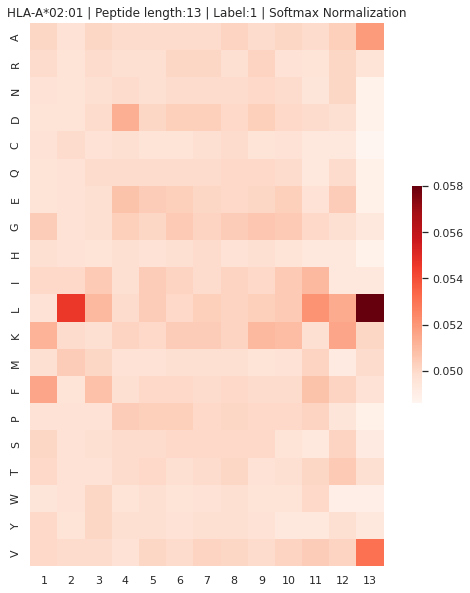

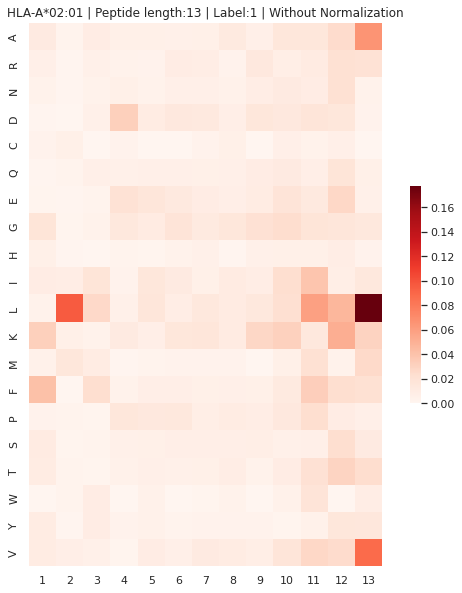









--------------------------
13 1
#Peptides: 0
HLA: HLA-B*08:01
Start
Threshold: nan
Pos
AAAAAAAAAAAAADraw


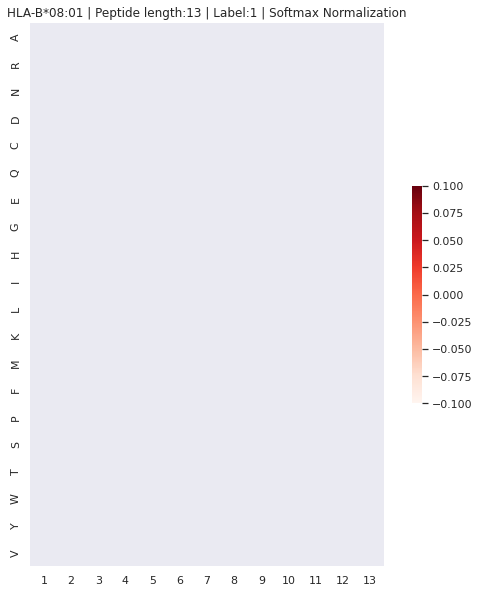

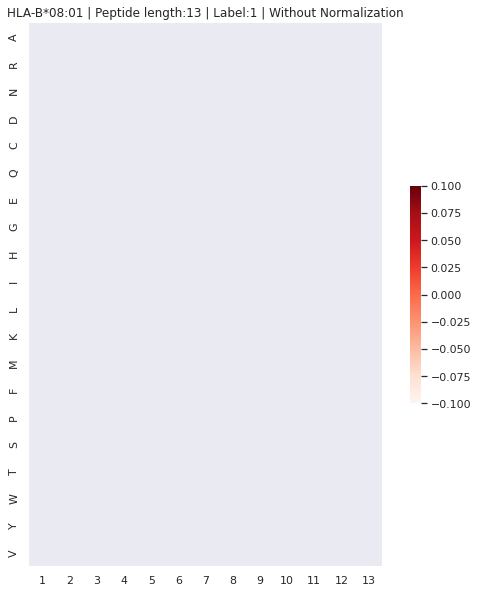









--------------------------
13 1
#Peptides: 107
HLA: HLA-B*27:02
Start
Threshold: 0.21
Pos
RRWGCRGGGGLLYDraw


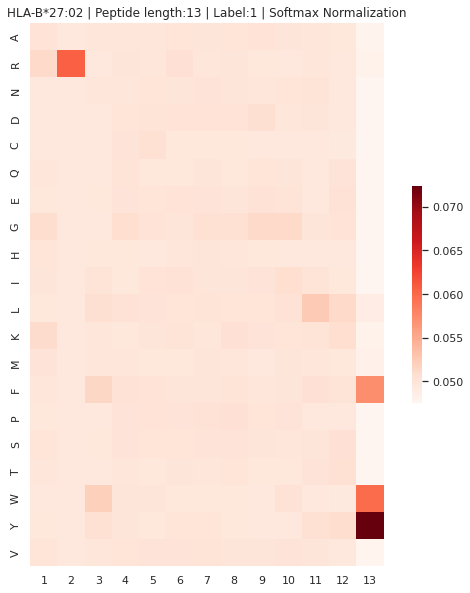

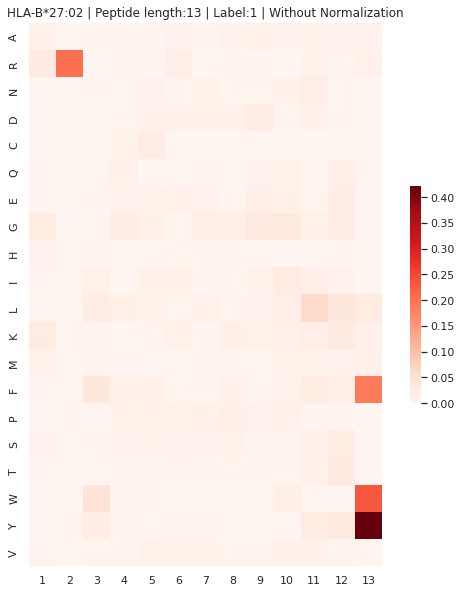









--------------------------
13 1
#Peptides: 60
HLA: HLA-C*05:01
Start
Threshold: 0.14
Pos
KPDGGKGGKYRKLDraw


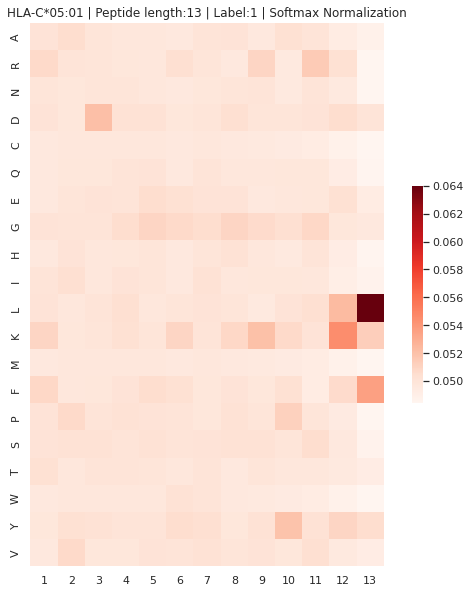

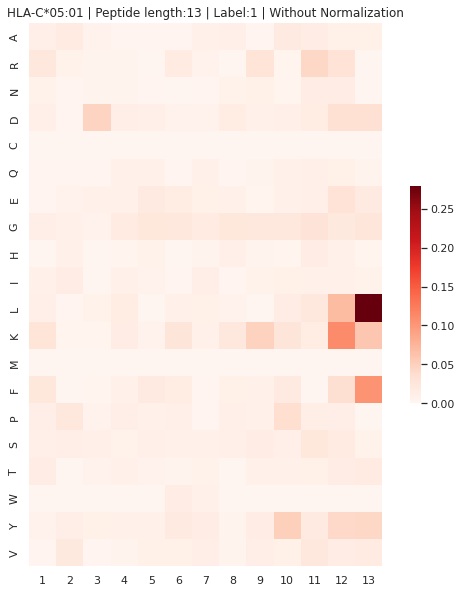









--------------------------
14 1
#Peptides: 203
HLA: HLA-A*02:01
Start
Threshold: 0.05
Pos
FLFEPLPGLKLLLLDraw


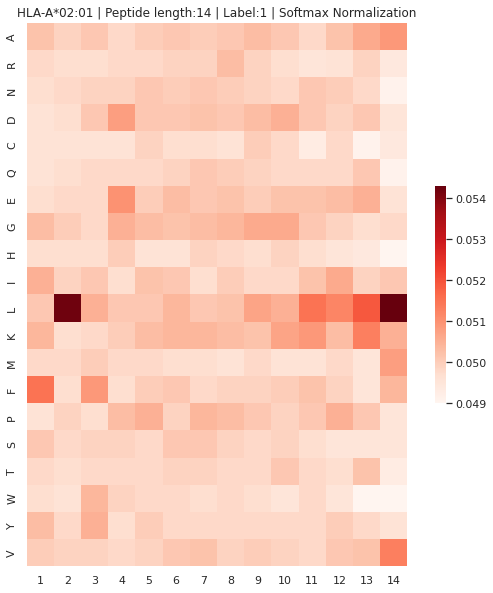

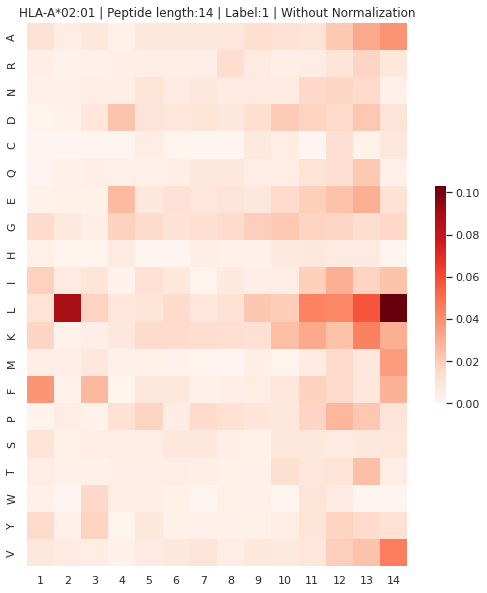









--------------------------
14 1
#Peptides: 0
HLA: HLA-B*08:01
Start
Threshold: nan
Pos
AAAAAAAAAAAAAADraw


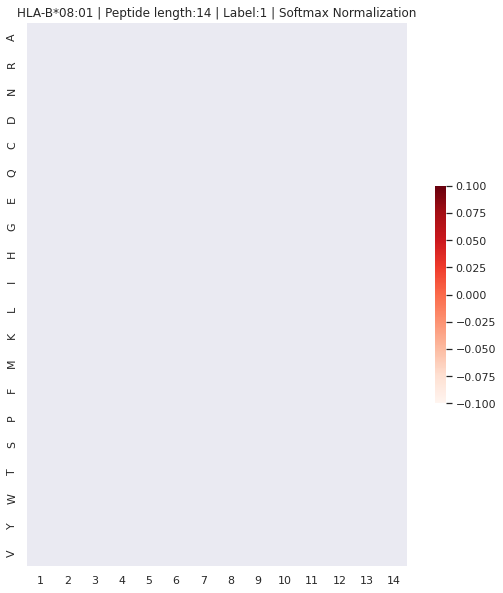

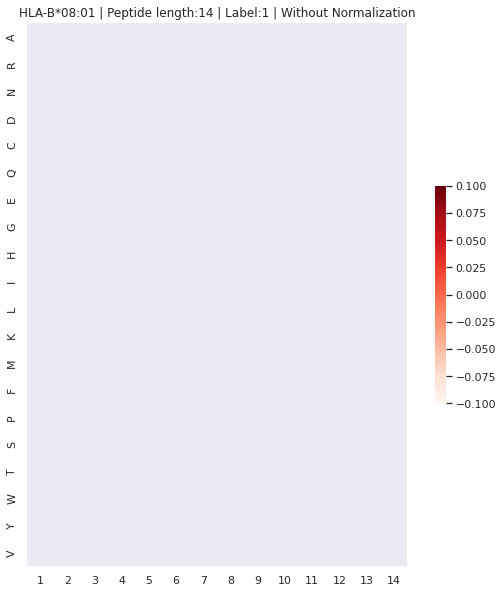









--------------------------
14 1
#Peptides: 0
HLA: HLA-B*27:02
Start
Threshold: nan
Pos
AAAAAAAAAAAAAADraw


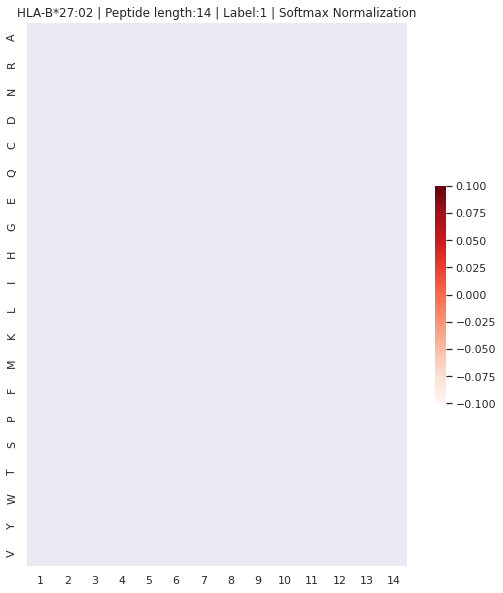

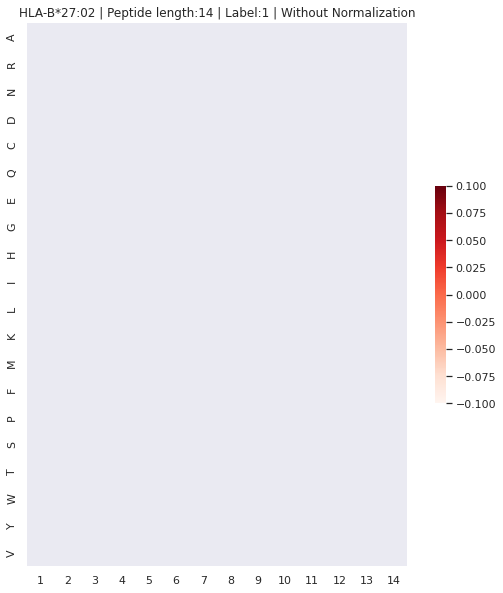









--------------------------
14 1
#Peptides: 63
HLA: HLA-C*05:01
Start
Threshold: 0.06
Pos
KADYPKGGKKGGLLDraw


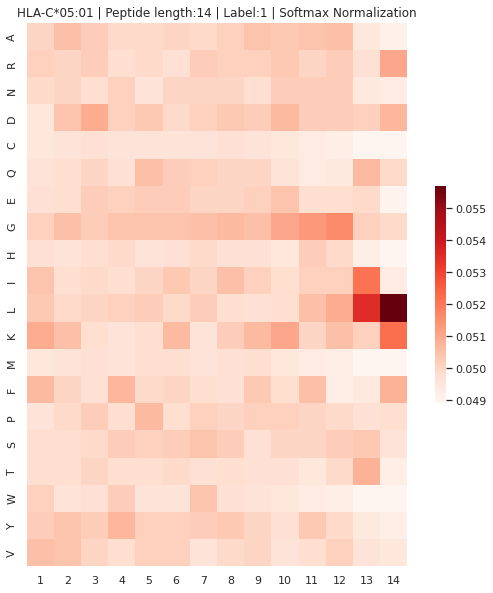

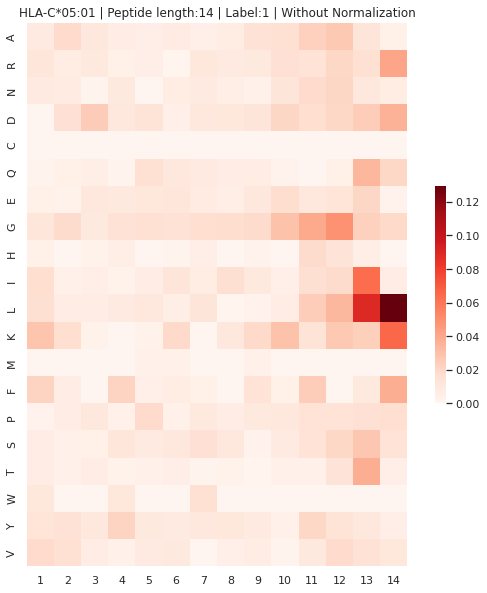

In [132]:
  
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))

for lll in [8,9,10,11,12,13,14]:
    for HLA_filter in ['HLA-A*02:01', 'HLA-B*08:01', 'HLA-B*27:02', 'HLA-C*05:01']:
        print('\n\n--------------------------')
        softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 1 , length = lll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
        
        print("\n\n\n\n\n")



--------------------------
8 1
#Peptides: 14952
HLA: None
Start
Threshold: 0.36
Pos
RRRKRRKLDraw


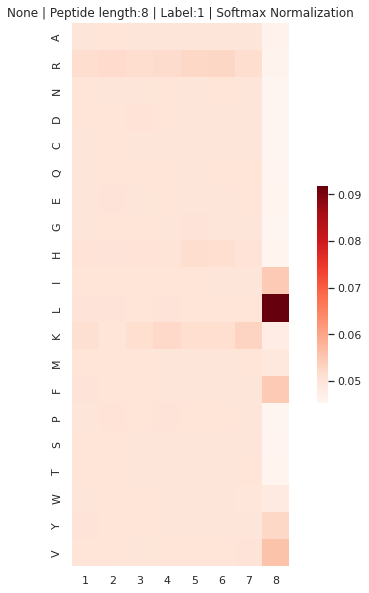

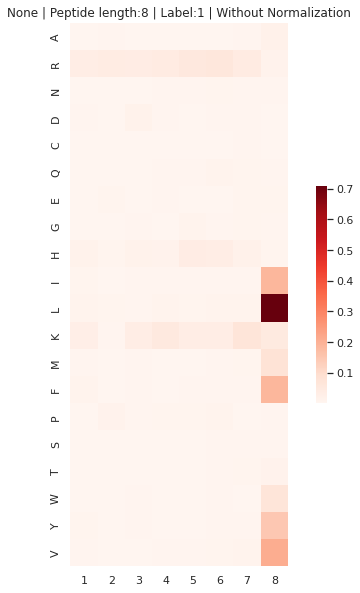

[0.0514, 0.0518, 0.0515, 0.0522, 0.0523, 0.0525, 0.0529, 0.0918, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.0361175455467914, 0.04177829503630367, 0.03770696600214436, 0.05101610390881028, 0.05514175308905163, 0.05908562347428438, 0.06755179399599552, 0.7093236115987828, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
9 1
#Peptides: 240156
HLA: None
Start
Threshold: 0.27
Pos
RRRKRRRKLDraw


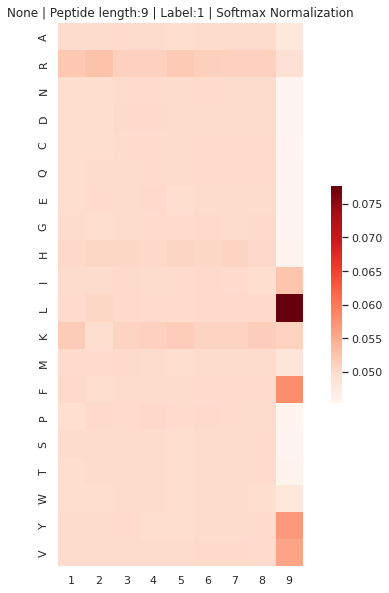

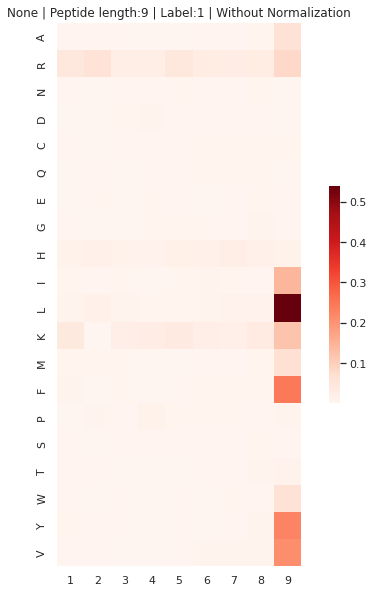

[0.0519, 0.0527, 0.051, 0.0511, 0.0518, 0.0512, 0.0511, 0.0513, 0.0777, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04516116444883742, 0.0603007255895647, 0.025334452202422593, 0.02772805220551954, 0.04339165219690534, 0.030125921894258317, 0.02895637366961475, 0.03383434312618673, 0.5400190722384617, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
10 1
#Peptides: 58415
HLA: None
Start
Threshold: 0.18
Pos
RRRKKKKRKLDraw


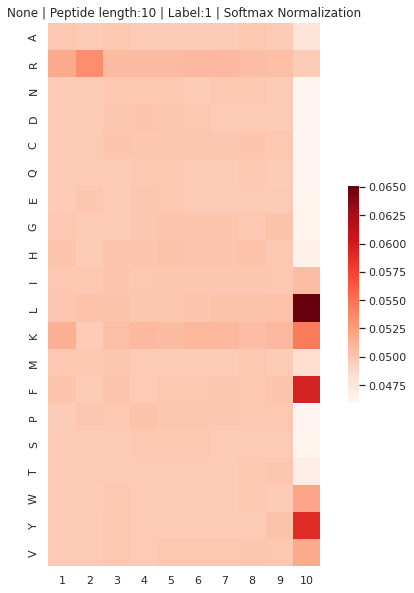

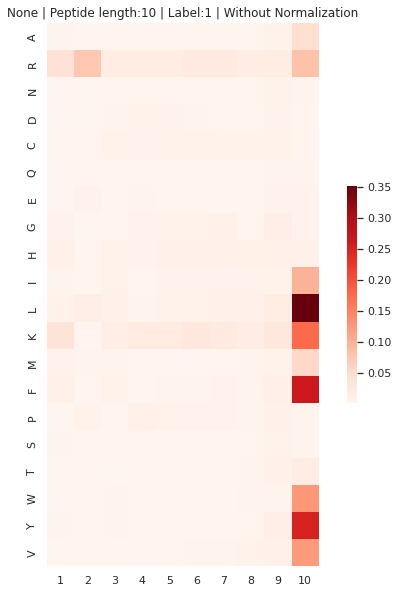

[0.0517, 0.0534, 0.0507, 0.0508, 0.0507, 0.051, 0.0509, 0.0506, 0.0509, 0.0651, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04156294051051742, 0.07409058400828127, 0.020683855799425447, 0.021632783996378285, 0.021171491329549347, 0.026793642639144483, 0.025147449820251647, 0.018890482732656425, 0.028858063415459427, 0.35117555288667296, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
11 1
#Peptides: 26184
HLA: None
Start
Threshold: 0.12
Pos
RRRKKKKKLKLDraw


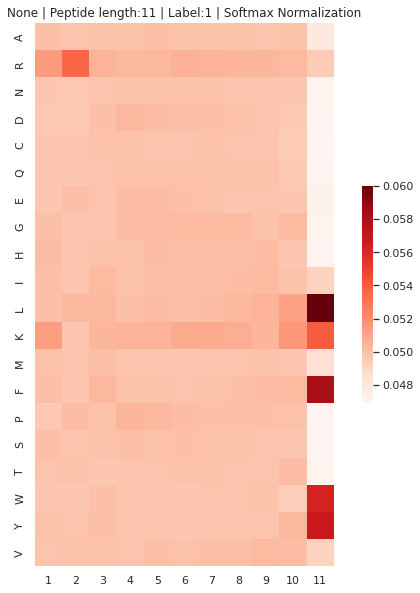

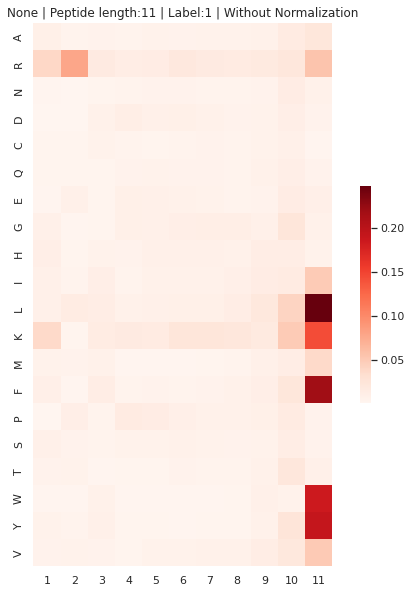

[0.0515, 0.0536, 0.0505, 0.0505, 0.0505, 0.0508, 0.0508, 0.0507, 0.0505, 0.0516, 0.06, 0.045979, 0.045979, 0.045979]
[0.03902653718337057, 0.07856234402748338, 0.016743265741140222, 0.016474242753804803, 0.015812333920225616, 0.023570071510900025, 0.023035999907654724, 0.021661261335047165, 0.019987214132437748, 0.049163920923798884, 0.24797977921870226, 0.045979, 0.045979, 0.045979]


--------------------------
12 1
#Peptides: 10798
HLA: None
Start
Threshold: 0.08
Pos
KRFKPKKKGLLWDraw


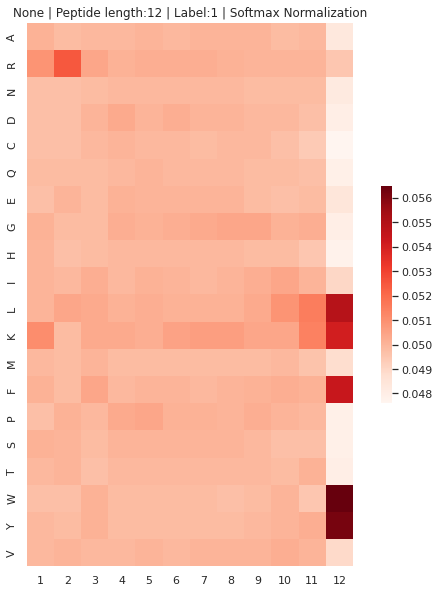

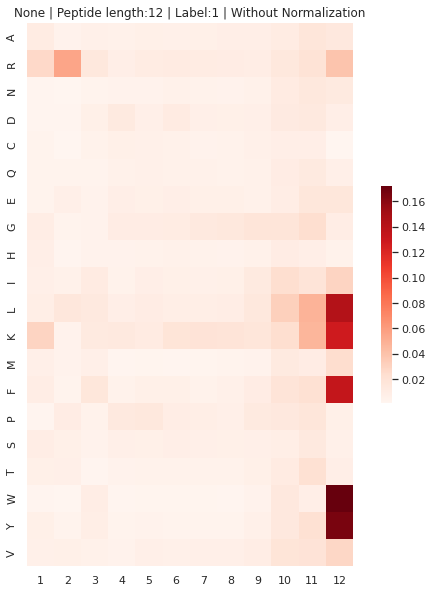

[0.0511, 0.0525, 0.0504, 0.0503, 0.0504, 0.0505, 0.0506, 0.0506, 0.0504, 0.0509, 0.0515, 0.0565, 0.045979, 0.045979]
[0.02931357799006471, 0.05569460268792543, 0.0161652300927038, 0.013663233816899687, 0.014815506967797857, 0.018223742198714463, 0.019764297691665992, 0.019202593941007595, 0.017636236426432413, 0.03193028650144269, 0.048146021235848074, 0.1723204017634921, 0.045979, 0.045979]


--------------------------
13 1
#Peptides: 5547
HLA: None
Start
Threshold: 0.08
Pos
KRFPPKKGGGLKYDraw


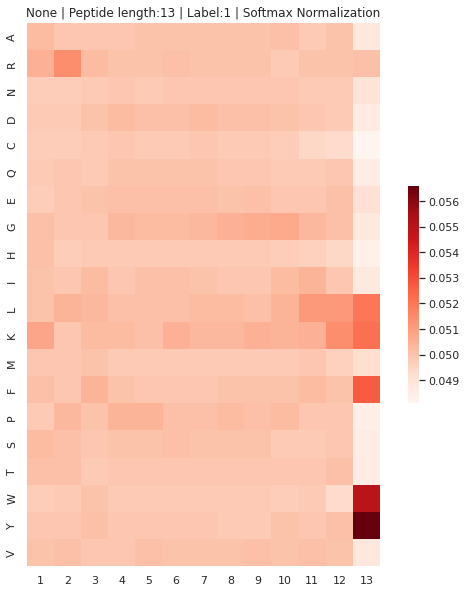

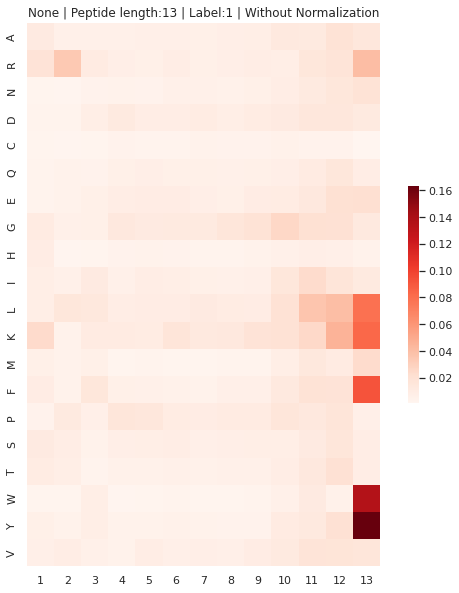

[0.0508, 0.0514, 0.0504, 0.0504, 0.0504, 0.0505, 0.0503, 0.0505, 0.0506, 0.0507, 0.0511, 0.0514, 0.0566, 0.045979]
[0.024158863585468496, 0.03438679935997921, 0.01523338112935131, 0.015669447721952744, 0.01495001658633397, 0.01656256277367341, 0.01274900984845764, 0.016226368765369373, 0.01923384115419582, 0.025962894234073598, 0.03639818118975488, 0.046021217523619186, 0.16342856842310596, 0.045979]


--------------------------
14 1
#Peptides: 3114
HLA: None
Start
Threshold: 0.04
Pos
SRFGPGGGGGGKKYDraw


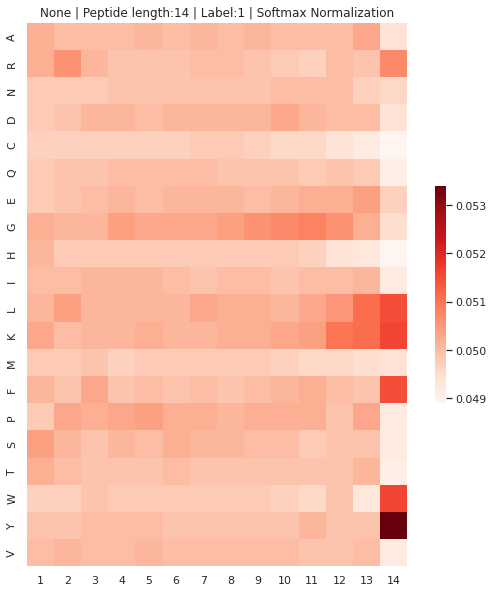

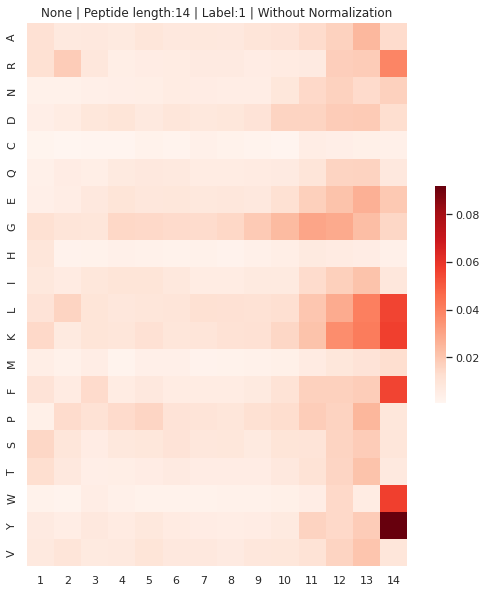

[0.0504, 0.0506, 0.0503, 0.0504, 0.0504, 0.0503, 0.0503, 0.0504, 0.0506, 0.0507, 0.0508, 0.051, 0.0511, 0.0534]
[0.0150487038594603, 0.018494530679632932, 0.013826546641443506, 0.014884342347955428, 0.015573203908225704, 0.013610019083580453, 0.013190012829534963, 0.014662432073398362, 0.018945938972762248, 0.02369058078577217, 0.029822911217799154, 0.03653516383529398, 0.04100927207128467, 0.09191566227182181]


In [37]:
softmax_pd_g_1 = []
unsoftmax_pd_g_l = []

for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo, HLA_length_aatype_position =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    print(list(unsoftmax_pd.max(axis=0))+ [0.045979] * (14-ll))  
    softmax_pd_g_1.append(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    unsoftmax_pd_g_l.append(list(unsoftmax_pd.sum(axis=0)) + [0.045979] * (14-ll))  



--------------------------
8 1
#Peptides: 14952
HLA: None
Start
Threshold: 0.36
Pos
RRRKRRKLDraw


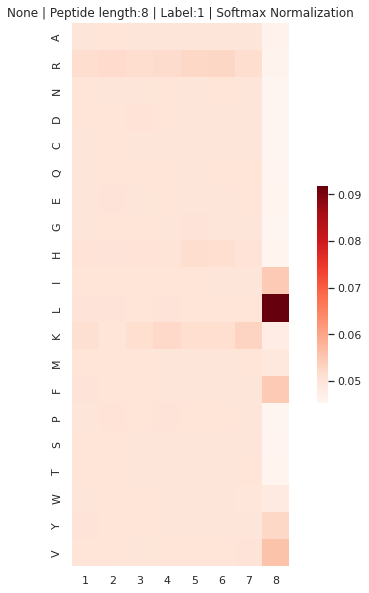

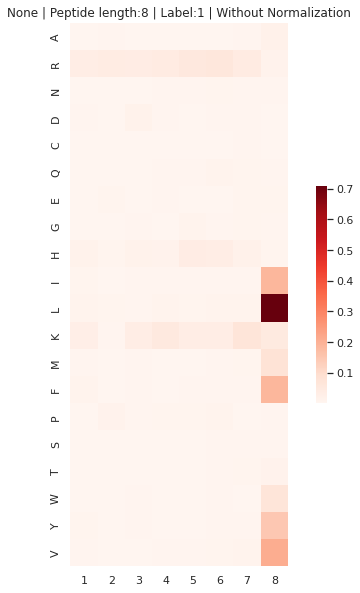

[0.0514, 0.0518, 0.0515, 0.0522, 0.0523, 0.0525, 0.0529, 0.0918, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.0361175455467914, 0.04177829503630367, 0.03770696600214436, 0.05101610390881028, 0.05514175308905163, 0.05908562347428438, 0.06755179399599552, 0.7093236115987828, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
9 1
#Peptides: 240156
HLA: None
Start
Threshold: 0.27
Pos
RRRKRRRKLDraw


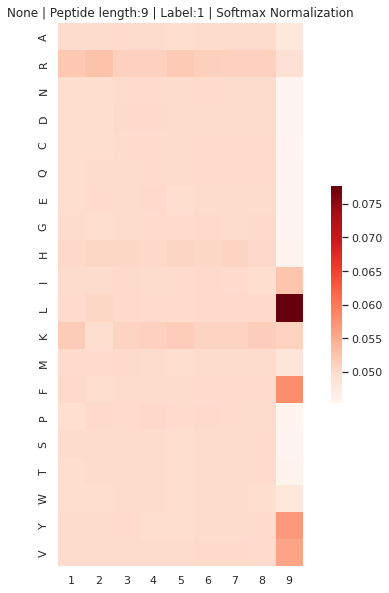

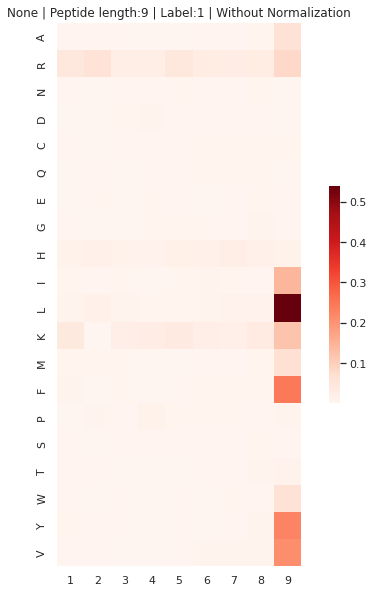

[0.0519, 0.0527, 0.051, 0.0511, 0.0518, 0.0512, 0.0511, 0.0513, 0.0777, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04516116444883742, 0.0603007255895647, 0.025334452202422593, 0.02772805220551954, 0.04339165219690534, 0.030125921894258317, 0.02895637366961475, 0.03383434312618673, 0.5400190722384617, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
10 1
#Peptides: 58415
HLA: None
Start
Threshold: 0.18
Pos
RRRKKKKRKLDraw


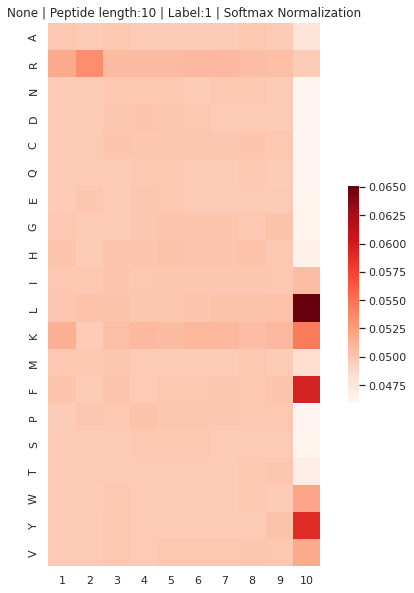

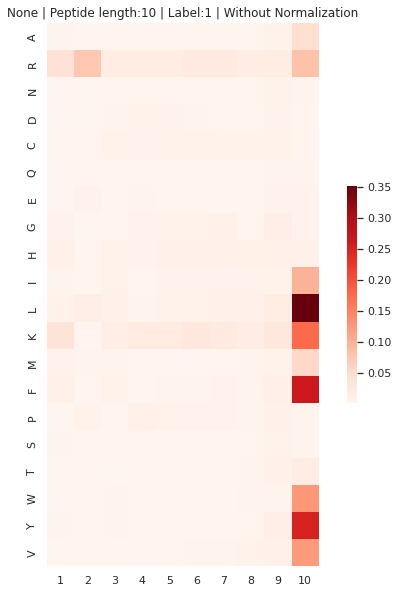

[0.0517, 0.0534, 0.0507, 0.0508, 0.0507, 0.051, 0.0509, 0.0506, 0.0509, 0.0651, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04156294051051742, 0.07409058400828127, 0.020683855799425447, 0.021632783996378285, 0.021171491329549347, 0.026793642639144483, 0.025147449820251647, 0.018890482732656425, 0.028858063415459427, 0.35117555288667296, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
11 1
#Peptides: 26184
HLA: None
Start
Threshold: 0.12
Pos
RRRKKKKKLKLDraw


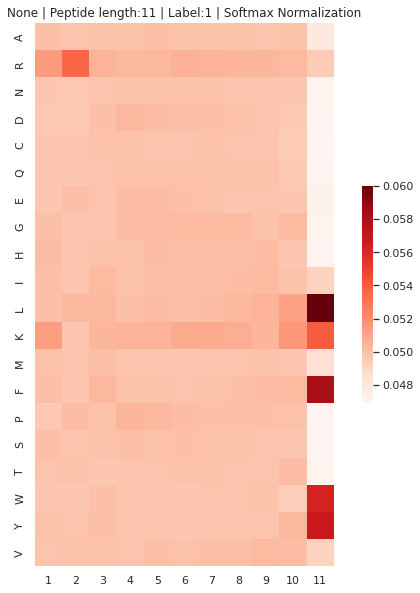

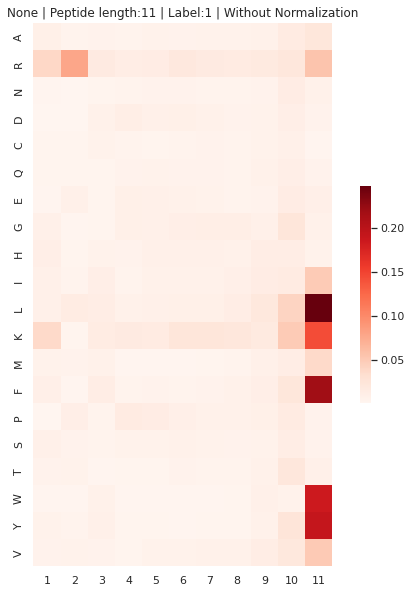

[0.0515, 0.0536, 0.0505, 0.0505, 0.0505, 0.0508, 0.0508, 0.0507, 0.0505, 0.0516, 0.06, 0.045979, 0.045979, 0.045979]
[0.03902653718337057, 0.07856234402748338, 0.016743265741140222, 0.016474242753804803, 0.015812333920225616, 0.023570071510900025, 0.023035999907654724, 0.021661261335047165, 0.019987214132437748, 0.049163920923798884, 0.24797977921870226, 0.045979, 0.045979, 0.045979]


--------------------------
12 1
#Peptides: 10798
HLA: None
Start
Threshold: 0.08
Pos
KRFKPKKKGLLWDraw


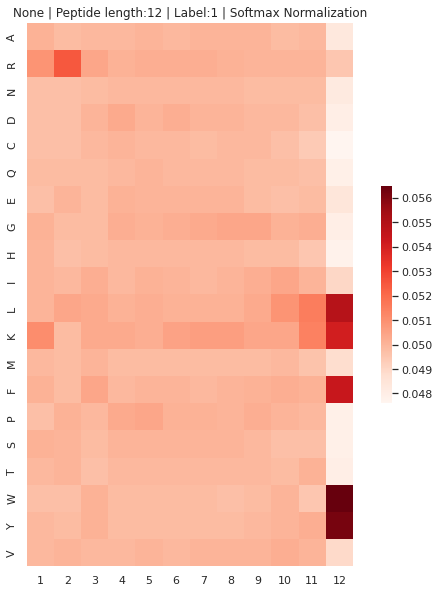

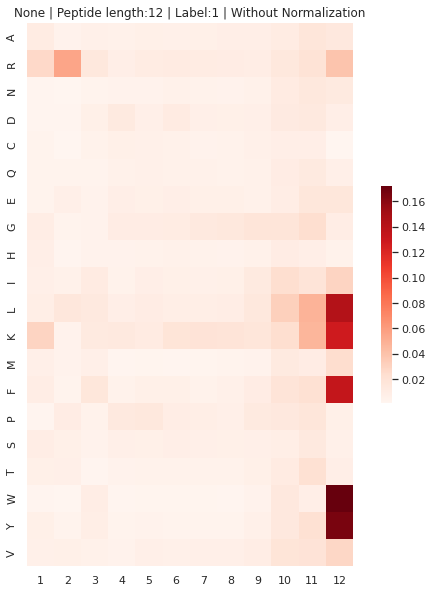

[0.0511, 0.0525, 0.0504, 0.0503, 0.0504, 0.0505, 0.0506, 0.0506, 0.0504, 0.0509, 0.0515, 0.0565, 0.045979, 0.045979]
[0.02931357799006471, 0.05569460268792543, 0.0161652300927038, 0.013663233816899687, 0.014815506967797857, 0.018223742198714463, 0.019764297691665992, 0.019202593941007595, 0.017636236426432413, 0.03193028650144269, 0.048146021235848074, 0.1723204017634921, 0.045979, 0.045979]


--------------------------
13 1
#Peptides: 5547
HLA: None
Start
Threshold: 0.08
Pos
KRFPPKKGGGLKYDraw


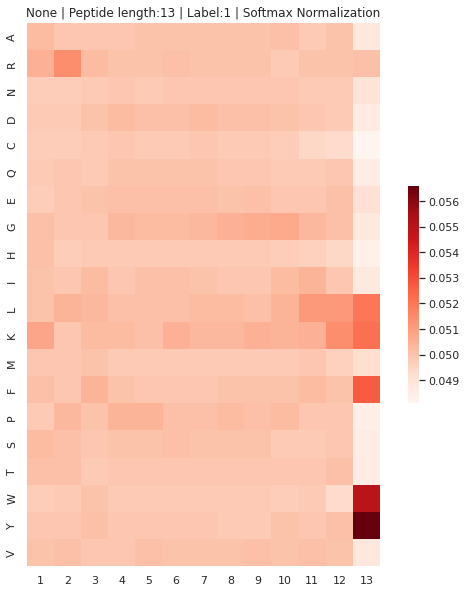

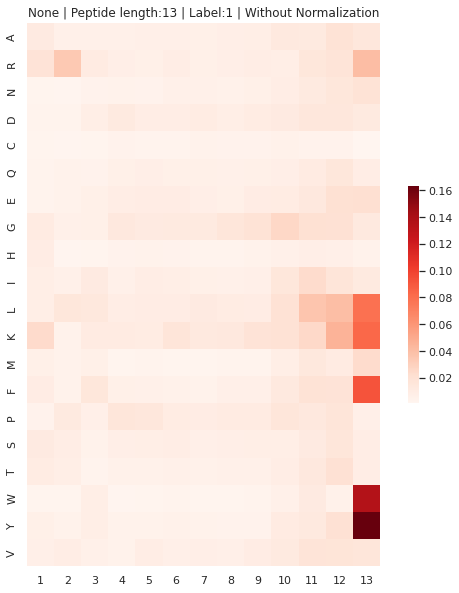

[0.0508, 0.0514, 0.0504, 0.0504, 0.0504, 0.0505, 0.0503, 0.0505, 0.0506, 0.0507, 0.0511, 0.0514, 0.0566, 0.045979]
[0.024158863585468496, 0.03438679935997921, 0.01523338112935131, 0.015669447721952744, 0.01495001658633397, 0.01656256277367341, 0.01274900984845764, 0.016226368765369373, 0.01923384115419582, 0.025962894234073598, 0.03639818118975488, 0.046021217523619186, 0.16342856842310596, 0.045979]


--------------------------
14 1
#Peptides: 3114
HLA: None
Start
Threshold: 0.04
Pos
SRFGPGGGGGGKKYDraw


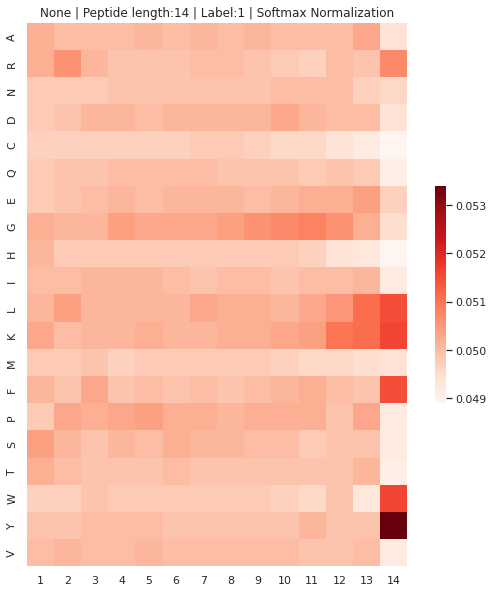

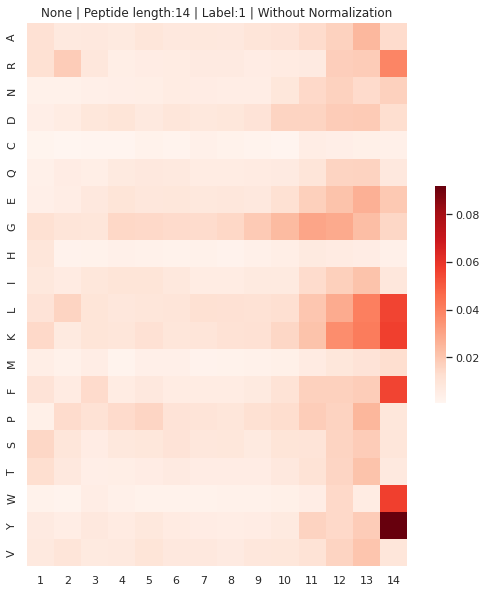

[0.0504, 0.0506, 0.0503, 0.0504, 0.0504, 0.0503, 0.0503, 0.0504, 0.0506, 0.0507, 0.0508, 0.051, 0.0511, 0.0534]
[0.0150487038594603, 0.018494530679632932, 0.013826546641443506, 0.014884342347955428, 0.015573203908225704, 0.013610019083580453, 0.013190012829534963, 0.014662432073398362, 0.018945938972762248, 0.02369058078577217, 0.029822911217799154, 0.03653516383529398, 0.04100927207128467, 0.09191566227182181]


In [37]:
softmax_pd_g_1 = []
unsoftmax_pd_g_l = []

for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo, HLA_length_aatype_position =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    print(list(unsoftmax_pd.max(axis=0))+ [0.045979] * (14-ll))  
    softmax_pd_g_1.append(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    unsoftmax_pd_g_l.append(list(unsoftmax_pd.sum(axis=0)) + [0.045979] * (14-ll))  

## Decoder

In [179]:
def draw_pHLA_attns(data, attn_data, label, length hla = 'HLA-A*02:01', peptide = 'SISELVAYL'):
    
    idx = data[data.HLA == hla][data.peptide == peptide].index[0]
    hla_sequence = list(data.iloc[idx].HLA_sequenc e)
    
    label = data.iloc[idx].label
    length = len(peptide)
    for head in range(3):
        if head == 0:
            temp = attn_data[idx][head][:, :length]
            temp_softmax = nn.Softmax(dim=-1)(attn_data[idx][head][:, :length].float()) # Shape = (34, 14), 行是HLA，列是peptide，由行查列
        else:
            temp += attn_data[idx][head][:, :length]
            temp_softmax += nn.Softmax(dim=-1)(attn_data[idx][head][:, :length].float())
    temp_softmax = nn.Softmax(dim = -1)(temp_softmax)
    
    return temp_softmax, hla_sequence

In [288]:
df[df.HLA=='HLA-A*02:01'][df.label==1].iloc[:700,:]

,peptide,length,HLA,label,HLA_sequence,target_,pred_
37,STYYGSFVTR,10,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.817058
63,GMNKRPILT,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.809783
144,YKLFLESGA,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.169723
190,ALADFAELI,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.986237
229,GLISVSNLPKL,11,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.977414
...,...,...,...,...,...,...,...
20849,ALIAAGKEII,10,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.855142
20858,SLSGELREV,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.997667
20878,FSYNVAYAI,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.799477
20881,SLAPIIVFV,9,HLA-A*02:01,1,YFAMYGEKVAHTHVDTLYVRYHYYTWAVLAYTWY,1,0.998648


In [130]:
pep = 'MPSVFQNVL' #'KFIMDSLNK'
hla = 'HLA-C*04:01' #'HLA-A*02:01'
label = 0

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

head 0 done.
head 1 done.
head 2 done.


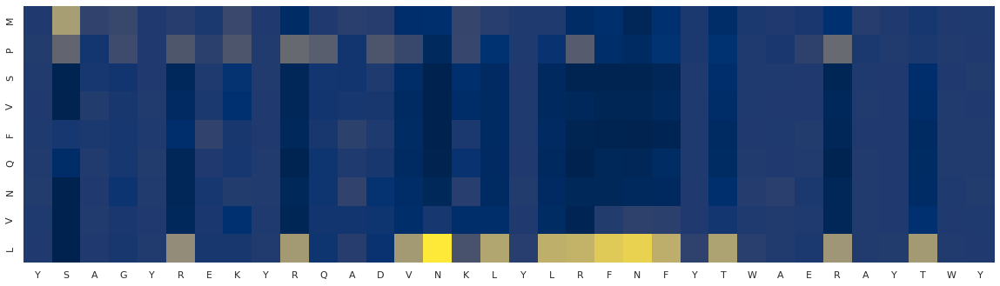

In [132]:
temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')
cmap = 'cividis'
sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar = False)

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

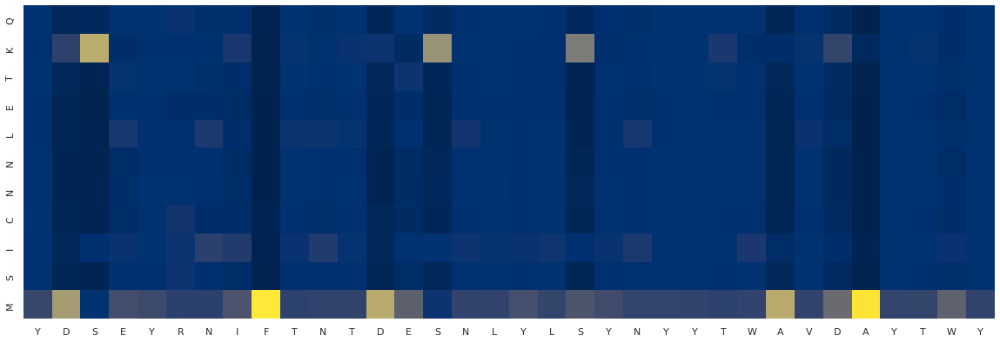

In [143]:
pep = 'QKTELNNCISM' #'KFIMDSLNK'
hla = 'HLA-B*08:01' #'HLA-A*02:01'
label = 0

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')
cmap = 'cividis'
sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar = False)

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

In [295]:
def get_accum_signal(df, enc_dec_attn_list_all, hla_, label_, length_):

    tt = 0
    accum_signal = []
    pep_l = list(df.peptide)
    hla_l = list(df.HLA)
    label_l = list(df.label)
    
    for i in range(len(df)):
        if i % 500 == 0:
            print(i)

        pep = pep_l[i]
        hla = hla_l[i]
        label = label_l[i]
        length = len(pep)
        
        if [label_, length_] == [label, length]:
            
            if hla_:
                if hla_ == hla:
                    temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)
                    if tt == 0:
                        accum_signal = np.array(temp_softmax)
                    accum_signal = np.add(accum_signal, np.array(temp_softmax))
                    tt += 1
                else:
                    continue
            else:
                temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all,hla = hla, peptide = pep)
                if tt == 0:
                    accum_signal = np.array(temp_softmax)
                accum_signal = np.add(accum_signal, np.array(temp_softmax)) 
                tt += 1
        else:
            continue
    return accum_signal

0
500000
1000000
1500000
240156


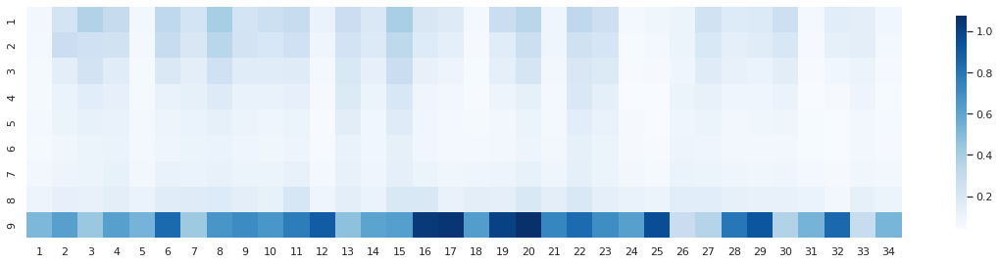

In [298]:
def get_accum_signal(df, attn_data, hla_, label_, length_):

    tt = 0
    accum_signal = []
    pep_l = list(df.peptide)
    hla_l = list(df.HLA)
    label_l = list(df.label)
    
    for i in range(len(df)):
        if i % 500000 == 0:
            print(i)

        pep = pep_l[i]
        hla = hla_l[i]
        label = label_l[i]
        length = len(pep)
        idx = i
        
        if [label_, length_] == [label, length]:
            
            if hla_:
                if hla_ == hla:
                    for head in range(3):
                        if head == 0:
                            temp_softmax = softmax( attn_data[idx][head][:, :length].float().cpu().detach().numpy(), axis=-1) # Shape = (34, 14), 行是HLA，列是peptide，由行查列
                        else:
                            temp_softmax += softmax( attn_data[idx][head][:, :length].float().cpu().detach().numpy(), axis=-1)
                    temp_softmax_softmax = softmax( temp_softmax, axis=-1)

                    if tt == 0:
                        accum_signal_softmax = temp_softmax_softmax
                        accum_signal = temp_softmax

                    accum_signal += temp_softmax
                    accum_signal_softmax += temp_softmax_softmax
                    tt += 1
            else:
                for head in range(3):
                    if head == 0:
                        temp_softmax =  attn_data[idx][head][:, :length].float().cpu().detach().numpy() # Shape = (34, 14), 行是HLA，列是peptide，由行查列
                    else:
                        temp_softmax +=  attn_data[idx][head][:, :length].float().cpu().detach().numpy()
                temp_softmax_softmax = softmax( temp_softmax, axis=-1)
                
                if tt == 0:
                    accum_signal_softmax = temp_softmax_softmax
                    accum_signal = temp_softmax
                    
                accum_signal += temp_softmax
                accum_signal_softmax += temp_softmax_softmax
                tt += 1
                
        else:
            continue
            
        #if tt == 200000:
    return accum_signal, accum_signal_softmax, tt

accum_signal, accum_signal_softmax, tt = get_accum_signal(df, enc_dec_attn_list_all, None, 1, 9)
print(tt)
accum_signal = accum_signal / tt

temp_softmax_pd_all = pd.DataFrame(np.array(accum_signal)[14::], index = list(range(1,35,1)), columns = list(range(1,10,1))).T

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd_all, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

plt.show()

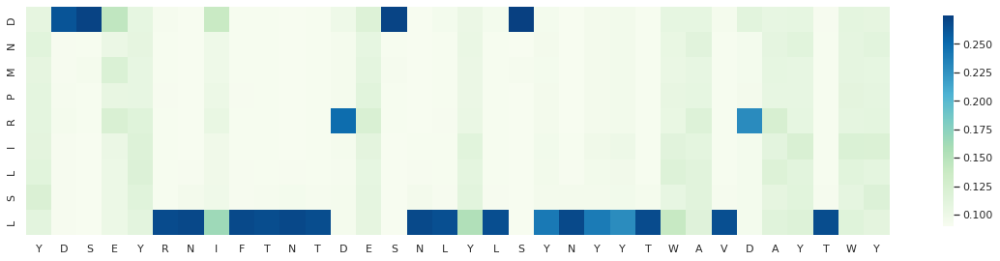

In [313]:
pep = 'DNMPRILSL'  # 'KFIMDSLNK'
hla = 'HLA-B*08:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

0
500000
1000000
1500000
Done


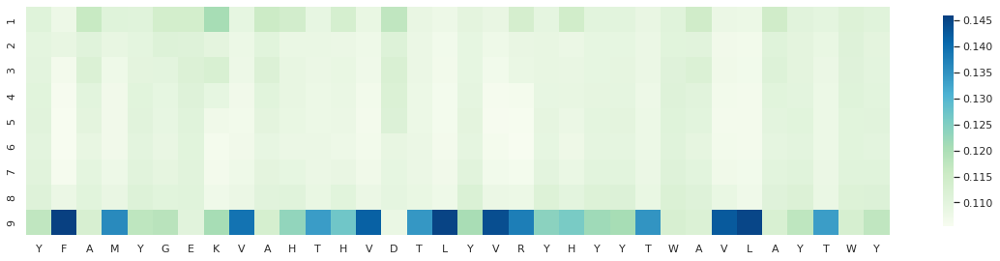

In [320]:
hla_filter = 'HLA-B*08:01'

hla_sequence = list(df[df.HLA==hla_filter].HLA_sequence)[0]

accum_signal, accum_signal_softmax, tt = get_accum_signal(df, enc_dec_attn_list_all, hla_filter, 1, 9)
accum_signal_softmax = accum_signal_softmax / tt

temp_softmax_pd_b0801 = pd.DataFrame(np.array(accum_signal_softmax)[14::], index = list(hla_sequence), columns = list(range(1,10,1))).T
print("Done")

fig.patch.set_facecolor('white')
cmap = 'GnBu'
sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd_b0801, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

Done


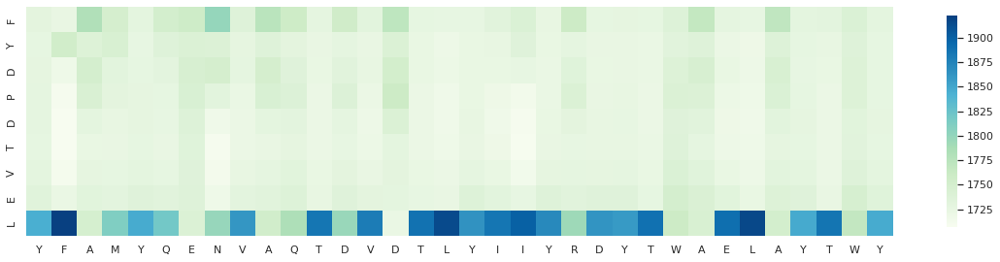

In [268]:
#accum_signal = get_accum_signal(df, enc_dec_attn_list_all, 'HLA-A*02:01', 1, 9)

#temp_softmax_pd_a0201 = pd.DataFrame(np.array(accum_signal)[14::], index = list(hla_sequence), columns = list(pep)).T
print("Done")

fig.patch.set_facecolor('white')
sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd_a0201, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

Done


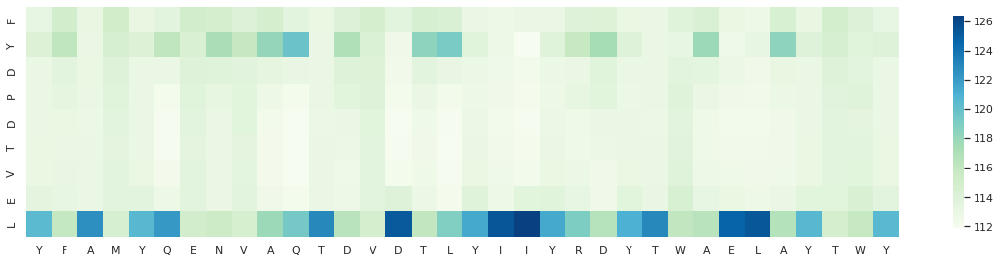

In [269]:
#accum_signal = get_accum_signal(df, enc_dec_attn_list_all, 'HLA-B*27:02', 1, 9)

#temp_softmax_pd_b2702 = pd.DataFrame(np.array(accum_signal)[14::], index = list(hla_sequence), columns = list(pep)).T
print("Done")

fig.patch.set_facecolor('white')
sn.set(rc = {'figure.figsize':(20,20)})
sn.heatmap(temp_softmax_pd_b2702, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})
fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))
plt.show()

Done


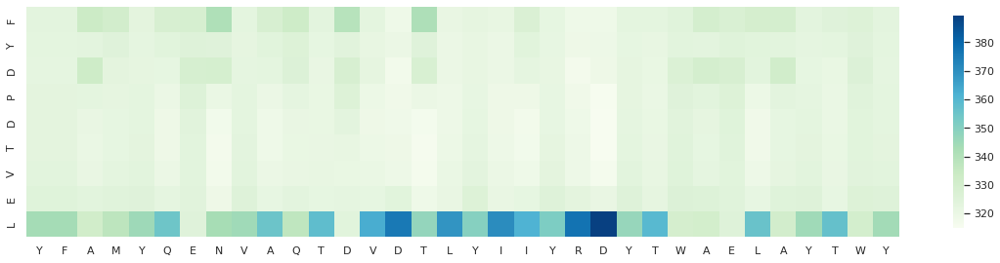

In [270]:
#accum_signal = get_accum_signal(df, enc_dec_attn_list_all, 'HLA-C*05:01', 1, 9)

#temp_softmax_pd_c0501 = pd.DataFrame(np.array(accum_signal)[14::], index = list(hla_sequence), columns = list(pep)).T
print("Done")

fig.patch.set_facecolor('white')
sn.set(rc = {'figure.figsize':(20,20)})
sn.heatmap(temp_softmax_pd_c0501, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})
fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))
plt.show()

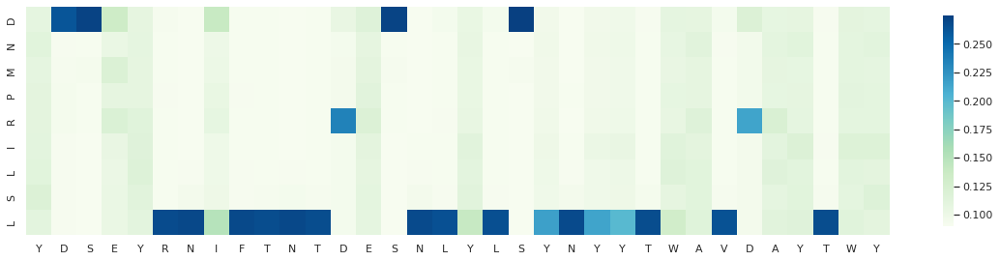

In [265]:
pep = 'DNMPRILSL'  # 'KFIMDSLNK'
hla = 'HLA-B*08:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

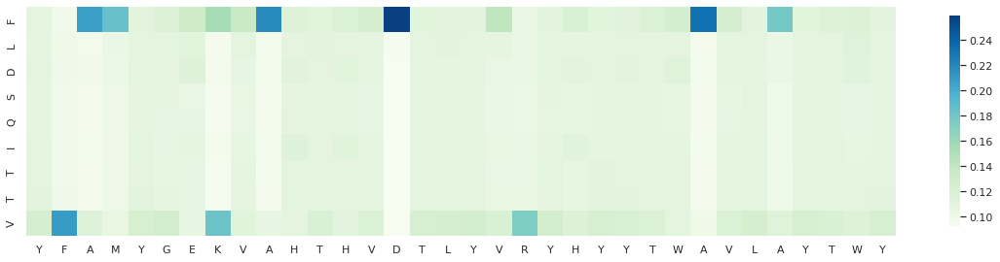

In [282]:
pep = 'FLDSQITTV'  # 'KFIMDSLNK'
hla = 'HLA-A*02:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

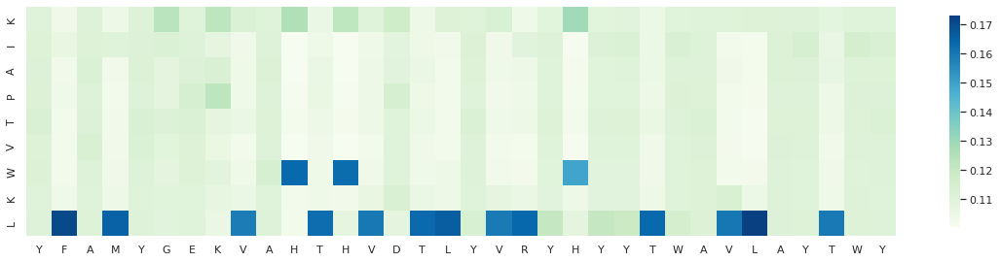

In [287]:
pep = 'KIAPTVWKL'  # 'KFIMDSLNK'
hla = 'HLA-A*02:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

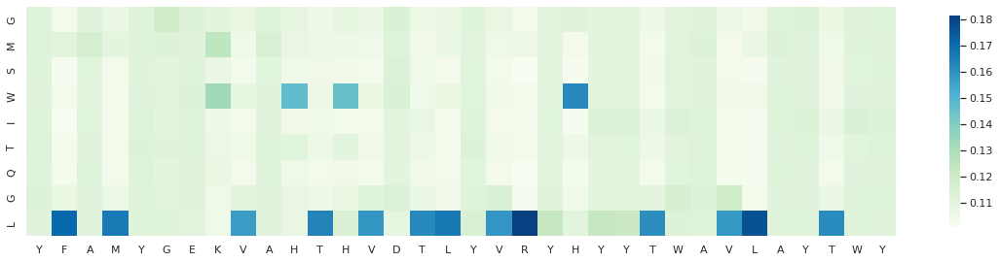

In [290]:
pep = 'GMSWITQGL'  # 'KFIMDSLNK'
hla = 'HLA-A*02:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()

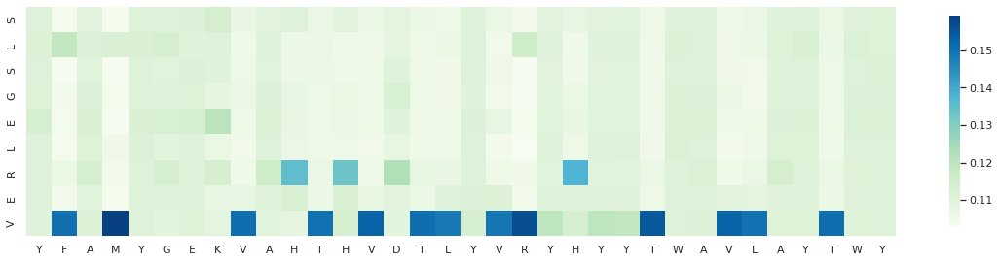

In [291]:
pep = 'SLSGELREV'  # 'KFIMDSLNK'
hla = 'HLA-A*02:01'  #' HLA-A*02:01'
label = 1

temp_softmax, hla_sequence = fnc.draw_pHLA_attns(df, enc_dec_attn_list_all, hla = hla, peptide = pep)

temp_softmax_pd = pd.DataFrame(np.array(temp_softmax)[14::], index = list(hla_sequence), columns = list(pep)).T

fig.patch.set_facecolor('white')

sn.set(rc = {'figure.figsize':(20,20)})

sn.heatmap(temp_softmax_pd, cmap = cmap, square = True, cbar_kws={'shrink': 0.2})

fig.suptitle('{} | {} | {}'.format(hla, pep, ['Negative', 'Positive'][label == 1]))

plt.show()



--------------------------
8 1
#Peptides: 14952
HLA: None
Start
Threshold: 0.36
Pos
RRRKRRKLDraw


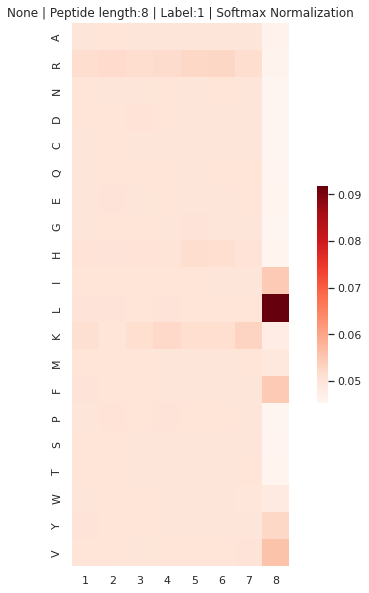

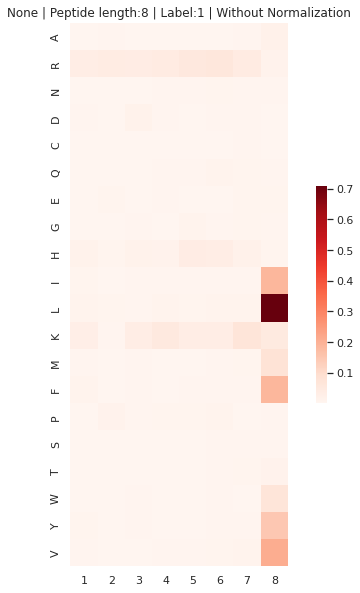

[0.0514, 0.0518, 0.0515, 0.0522, 0.0523, 0.0525, 0.0529, 0.0918, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.0361175455467914, 0.04177829503630367, 0.03770696600214436, 0.05101610390881028, 0.05514175308905163, 0.05908562347428438, 0.06755179399599552, 0.7093236115987828, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
9 1
#Peptides: 240156
HLA: None
Start
Threshold: 0.27
Pos
RRRKRRRKLDraw


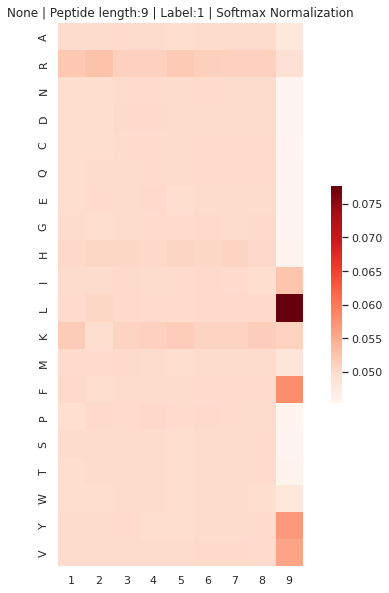

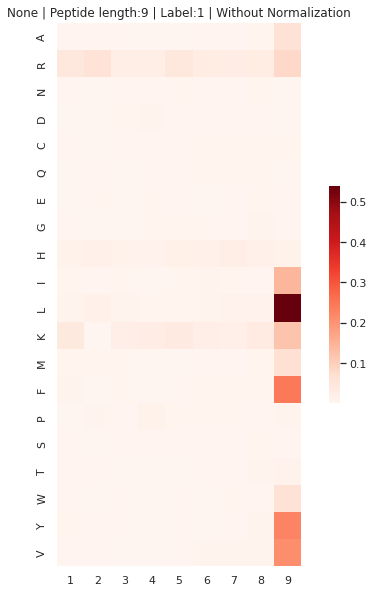

[0.0519, 0.0527, 0.051, 0.0511, 0.0518, 0.0512, 0.0511, 0.0513, 0.0777, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04516116444883742, 0.0603007255895647, 0.025334452202422593, 0.02772805220551954, 0.04339165219690534, 0.030125921894258317, 0.02895637366961475, 0.03383434312618673, 0.5400190722384617, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
10 1
#Peptides: 58415
HLA: None
Start
Threshold: 0.18
Pos
RRRKKKKRKLDraw


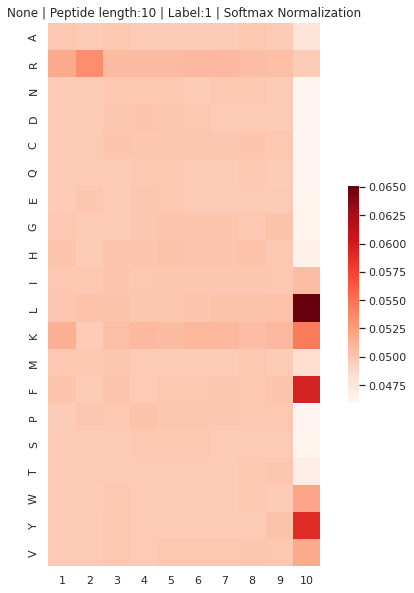

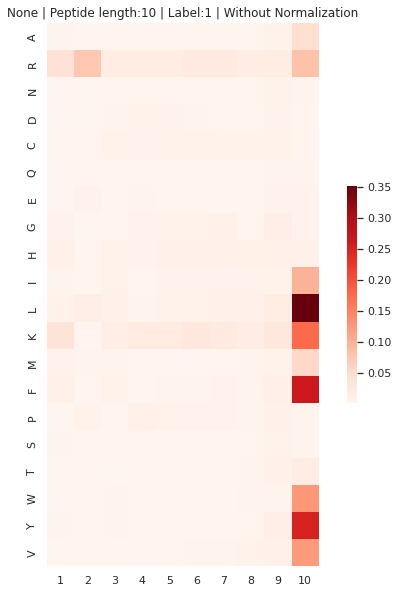

[0.0517, 0.0534, 0.0507, 0.0508, 0.0507, 0.051, 0.0509, 0.0506, 0.0509, 0.0651, 0.045979, 0.045979, 0.045979, 0.045979]
[0.04156294051051742, 0.07409058400828127, 0.020683855799425447, 0.021632783996378285, 0.021171491329549347, 0.026793642639144483, 0.025147449820251647, 0.018890482732656425, 0.028858063415459427, 0.35117555288667296, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
11 1
#Peptides: 26184
HLA: None
Start
Threshold: 0.12
Pos
RRRKKKKKLKLDraw


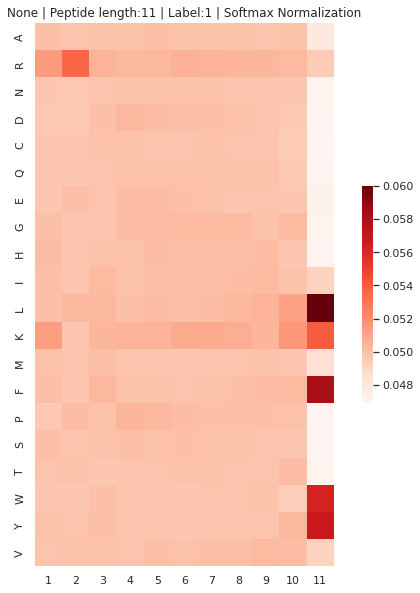

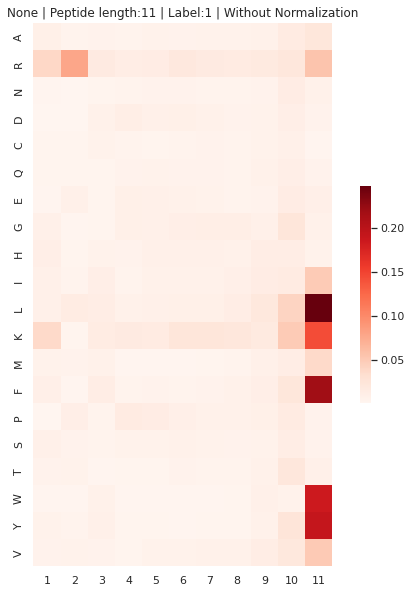

[0.0515, 0.0536, 0.0505, 0.0505, 0.0505, 0.0508, 0.0508, 0.0507, 0.0505, 0.0516, 0.06, 0.045979, 0.045979, 0.045979]
[0.03902653718337057, 0.07856234402748338, 0.016743265741140222, 0.016474242753804803, 0.015812333920225616, 0.023570071510900025, 0.023035999907654724, 0.021661261335047165, 0.019987214132437748, 0.049163920923798884, 0.24797977921870226, 0.045979, 0.045979, 0.045979]


--------------------------
12 1
#Peptides: 10798
HLA: None
Start
Threshold: 0.08
Pos
KRFKPKKKGLLWDraw


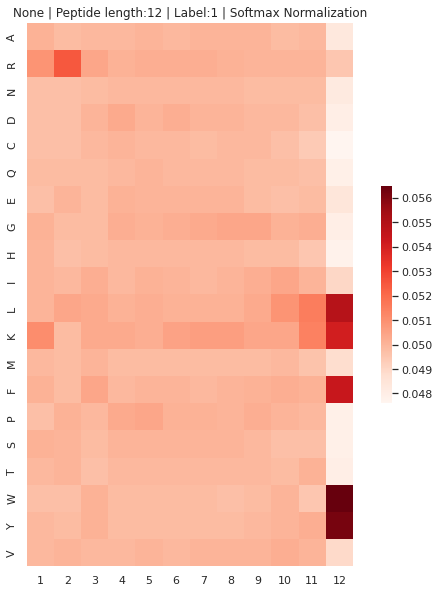

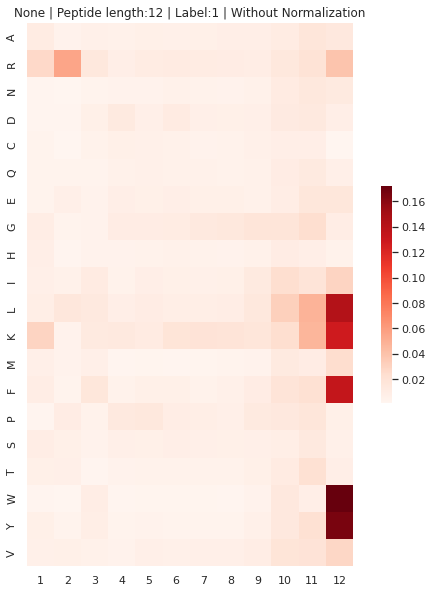

[0.0511, 0.0525, 0.0504, 0.0503, 0.0504, 0.0505, 0.0506, 0.0506, 0.0504, 0.0509, 0.0515, 0.0565, 0.045979, 0.045979]
[0.02931357799006471, 0.05569460268792543, 0.0161652300927038, 0.013663233816899687, 0.014815506967797857, 0.018223742198714463, 0.019764297691665992, 0.019202593941007595, 0.017636236426432413, 0.03193028650144269, 0.048146021235848074, 0.1723204017634921, 0.045979, 0.045979]


--------------------------
13 1
#Peptides: 5547
HLA: None
Start
Threshold: 0.08
Pos
KRFPPKKGGGLKYDraw


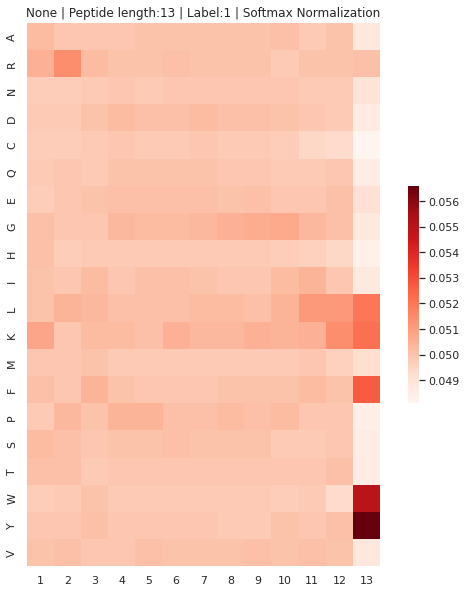

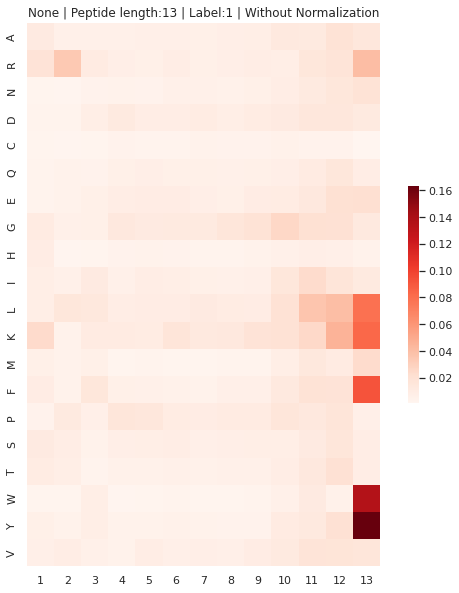

[0.0508, 0.0514, 0.0504, 0.0504, 0.0504, 0.0505, 0.0503, 0.0505, 0.0506, 0.0507, 0.0511, 0.0514, 0.0566, 0.045979]
[0.024158863585468496, 0.03438679935997921, 0.01523338112935131, 0.015669447721952744, 0.01495001658633397, 0.01656256277367341, 0.01274900984845764, 0.016226368765369373, 0.01923384115419582, 0.025962894234073598, 0.03639818118975488, 0.046021217523619186, 0.16342856842310596, 0.045979]


--------------------------
14 1
#Peptides: 3114
HLA: None
Start
Threshold: 0.04
Pos
SRFGPGGGGGGKKYDraw


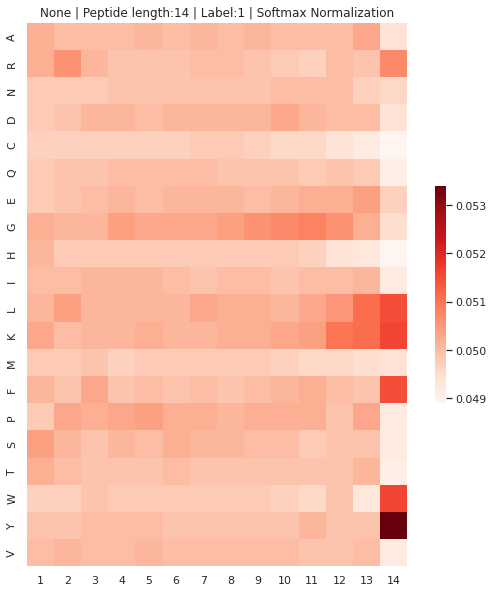

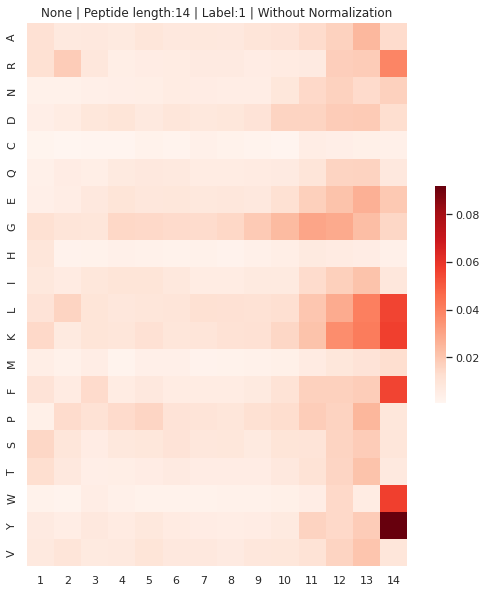

[0.0504, 0.0506, 0.0503, 0.0504, 0.0504, 0.0503, 0.0503, 0.0504, 0.0506, 0.0507, 0.0508, 0.051, 0.0511, 0.0534]
[0.0150487038594603, 0.018494530679632932, 0.013826546641443506, 0.014884342347955428, 0.015573203908225704, 0.013610019083580453, 0.013190012829534963, 0.014662432073398362, 0.018945938972762248, 0.02369058078577217, 0.029822911217799154, 0.03653516383529398, 0.04100927207128467, 0.09191566227182181]


In [37]:
softmax_pd_g_1 = []
unsoftmax_pd_g_l = []

for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo, HLA_length_aatype_position =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    print(list(unsoftmax_pd.max(axis=0))+ [0.045979] * (14-ll))  
    softmax_pd_g_1.append(list(softmax_pd.mean(axis=0))+ [0.045979] * (14-ll))
    unsoftmax_pd_g_l.append(list(unsoftmax_pd.sum(axis=0)) + [0.045979] * (14-ll))  



--------------------------
8 0
#Peptides: 62774
HLA: None
Start
Threshold: 0.08
Pos
RRRRRRRLDraw


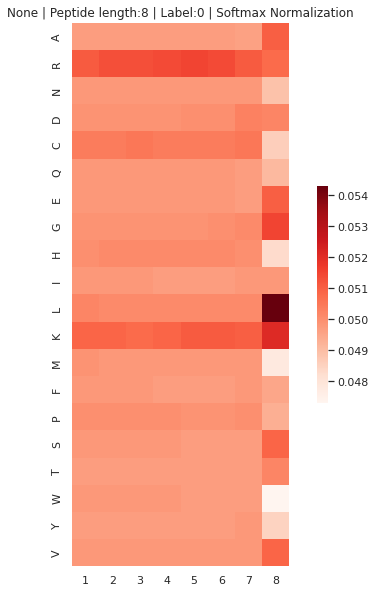

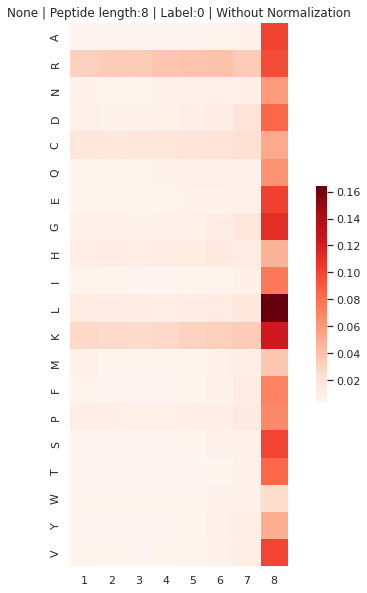

[0.0511, 0.0513, 0.0513, 0.0514, 0.0515, 0.0514, 0.0511, 0.0543, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.03176592762641082, 0.033488977292300555, 0.03388827754125912, 0.03696619411126621, 0.03880386821673782, 0.038849500197384666, 0.03481873746744273, 0.16434176009872717, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
9 0
#Peptides: 1006011
HLA: None
Start
Threshold: 0.08
Pos
RRRRRRRRLDraw


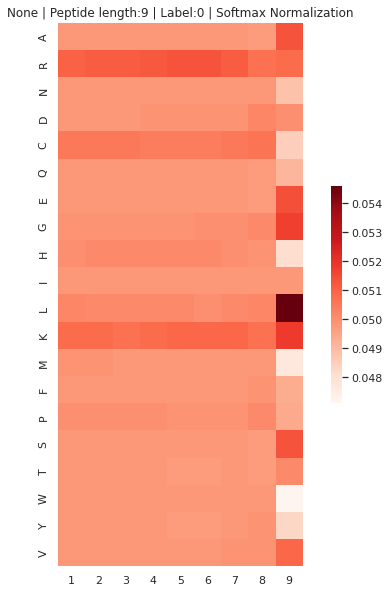

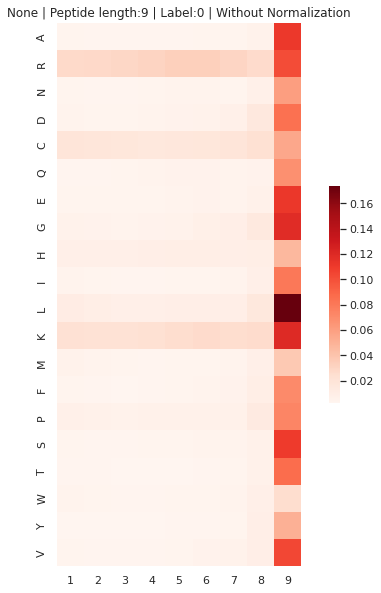

[0.051, 0.0511, 0.0511, 0.0512, 0.0513, 0.0513, 0.0511, 0.0507, 0.0546, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]
[0.027184822500698303, 0.028031362852891272, 0.02906425181359846, 0.030845342552168913, 0.033207238942963846, 0.0332002613540011, 0.029888432429541027, 0.02642417793828795, 0.1737341061628551, 0.045979, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
10 0
#Peptides: 245092
HLA: None
Start
Threshold: 0.08
Pos
RRRRRRRRKLDraw


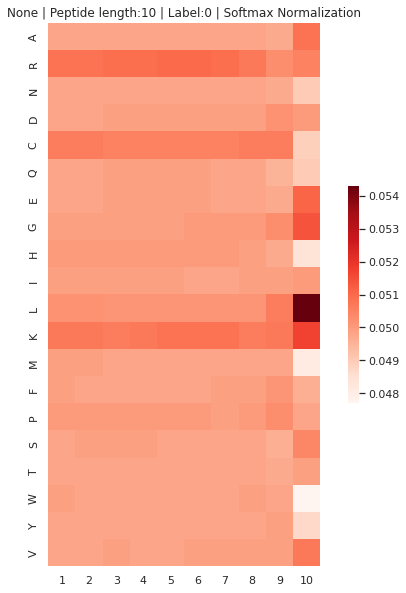

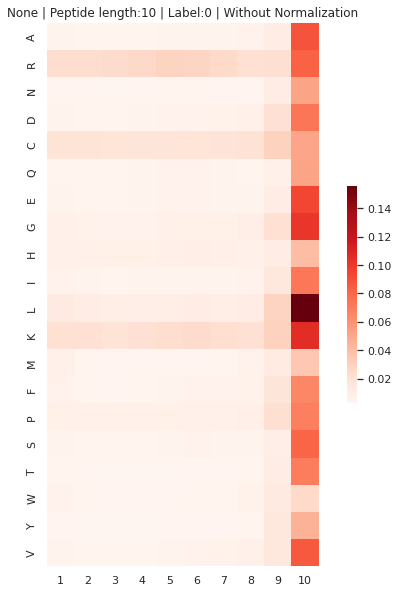

[0.0508, 0.0508, 0.0509, 0.0509, 0.051, 0.051, 0.0509, 0.0507, 0.0507, 0.0543, 0.045979, 0.045979, 0.045979, 0.045979]
[0.022984080898065827, 0.023492993750178503, 0.02399344955797211, 0.02564296367856254, 0.02802440360724238, 0.027538449289577997, 0.02517470241404248, 0.021420531786278212, 0.02927513770658059, 0.15591291356919035, 0.045979, 0.045979, 0.045979, 0.045979]


--------------------------
11 0
#Peptides: 109886
HLA: None
Start
Threshold: 0.05
Pos
CCRRRRKCCLLDraw


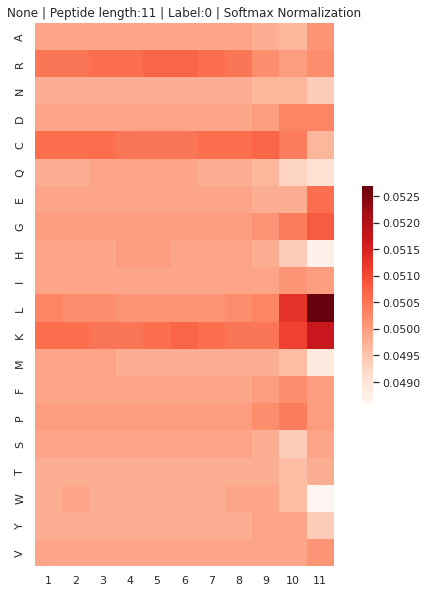

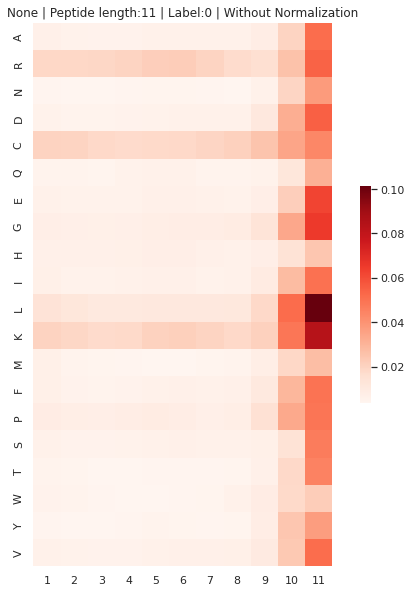

[0.0506, 0.0506, 0.0506, 0.0506, 0.0507, 0.0507, 0.0506, 0.0506, 0.0507, 0.0513, 0.0527, 0.045979, 0.045979, 0.045979]
[0.020240378913999508, 0.019897907511819066, 0.018951427679879604, 0.019821516642105227, 0.021619424850669103, 0.022100549802750124, 0.019829526096932275, 0.02075421265774871, 0.025248714345861848, 0.051720797932061406, 0.10150055725365378, 0.045979, 0.045979, 0.045979]


--------------------------
12 0
#Peptides: 45329
HLA: None
Start
Threshold: 0.04
Pos
CCCCKCCCCLKLDraw


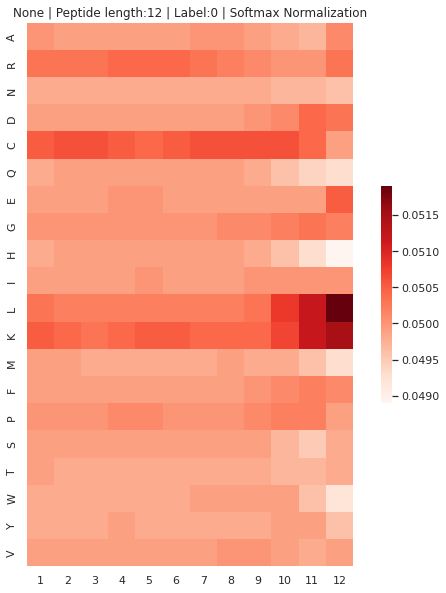

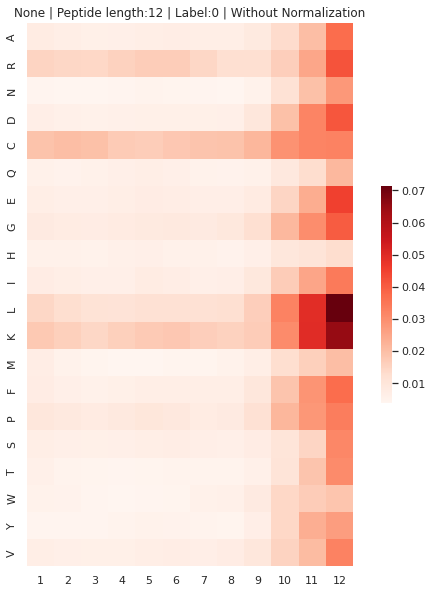

[0.0505, 0.0506, 0.0506, 0.0505, 0.0505, 0.0505, 0.0506, 0.0506, 0.0506, 0.0508, 0.0512, 0.0519, 0.045979, 0.045979]
[0.018923342321296107, 0.019907507117666808, 0.01954718169866421, 0.017057503694344403, 0.01726180834022163, 0.017907660176156543, 0.018796034153166986, 0.018895697484812426, 0.02161888017027248, 0.03251616340308495, 0.04958172450824803, 0.0714666540821687, 0.045979, 0.045979]


--------------------------
13 0
#Peptides: 23289
HLA: None
Start
Threshold: 0.02
Pos
CCCCCCCCCLKKLDraw


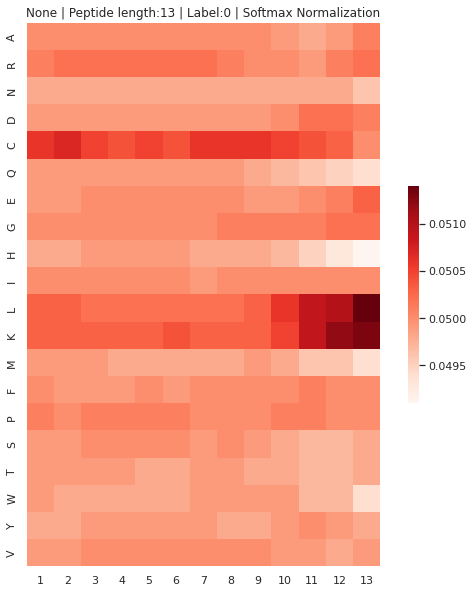

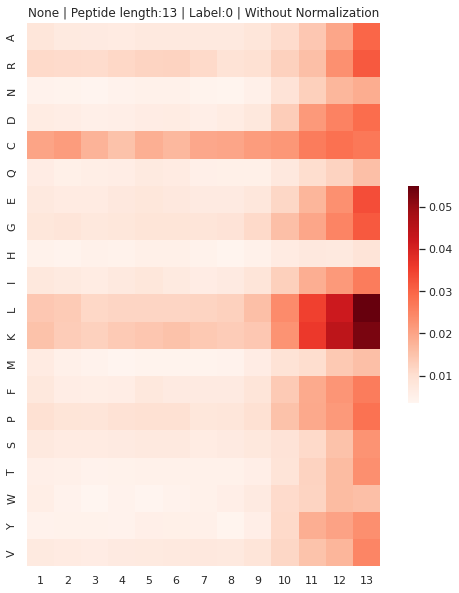

[0.0506, 0.0507, 0.0505, 0.0504, 0.0505, 0.0504, 0.0506, 0.0506, 0.0506, 0.0506, 0.0509, 0.0512, 0.0514, 0.045979]
[0.020084225003790684, 0.021320108949889834, 0.01762045308658997, 0.015240945537173532, 0.018324771114363942, 0.01679125921002136, 0.019558777277413023, 0.0199479697635049, 0.021339561629148955, 0.023946189200608387, 0.03621422415759586, 0.04441011687552331, 0.05491105708267583, 0.045979]


--------------------------
14 0
#Peptides: 13073
HLA: None
Start
Threshold: 0.02
Pos
CCCCCCCCCCKKKKDraw


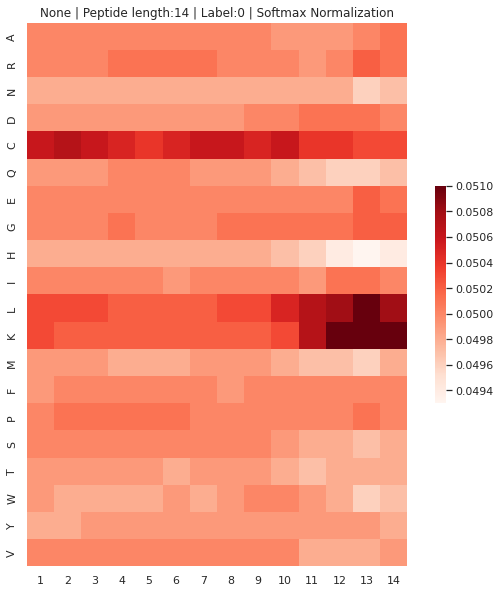

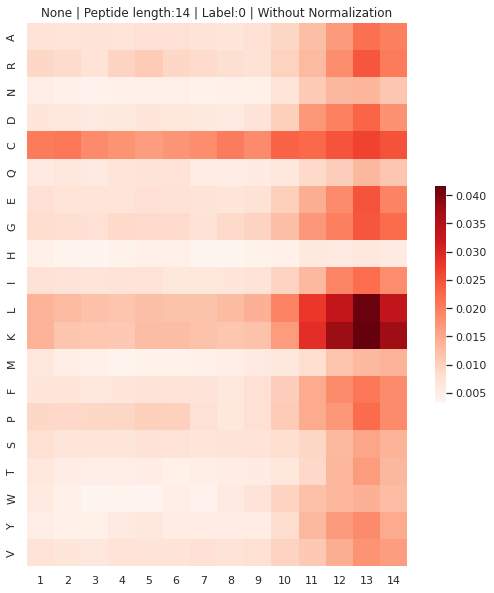

[0.0506, 0.0507, 0.0506, 0.0505, 0.0504, 0.0505, 0.0506, 0.0506, 0.0505, 0.0506, 0.0507, 0.051, 0.051, 0.051]
[0.02042305753105757, 0.020799971680957412, 0.018454677243591275, 0.017511863127814723, 0.01639465434744739, 0.01731106992943471, 0.018302027491433323, 0.020235367305676537, 0.018394594521509027, 0.023094229186437457, 0.0289022147605334, 0.037606228157509754, 0.04167759475935612, 0.03724885758322855]


In [39]:
softmax_pd_g_o = []
unsoftmax_pd_g_o = []

for ll in [8,9,10,11,12,13,14]:
    print('\n\n--------------------------')
    softmax_pd, unsoftmax_pd, max_list, new_pseudo, HLA_length_aatype_position =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, None, 3, label = 1 , length = ll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
    print(list(softmax_pd.max(axis=0))+ [0.045979] * (14-ll))
    print(list(unsoftmax_pd.max(axis=0))+ [0.045979] * (14-ll))  
    softmax_pd_g_o.append(list(softmax_pd.mean(axis=0))+ [0.045979] * (14-ll))
    unsoftmax_pd_g_o.append(list(unsoftmax_pd.sum(axis=0)) + [0.045979] * (14-ll)) 
    

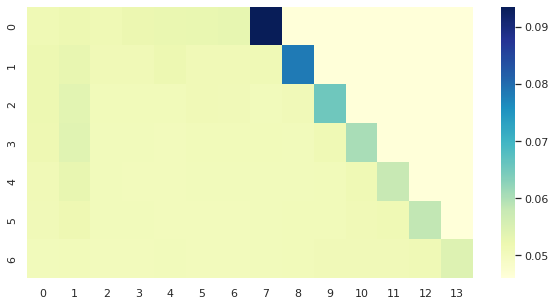

In [75]:
sn.set(rc = {'figure.figsize':(10,5)})
ax = sn.heatmap(softmax_pd_g_1, cmap = 'YlGnBu')

In [95]:
#Why D has a weak signal on the second position:

ll = [ x[8] for x in list(df[df.HLA == 'HLA-C*05:01'][df.length == 9][df.label == 1].peptide)]

import collections 
collections.Counter(ll)

Counter({'S': 60,
         'D': 2094,
         'A': 114,
         'E': 286,
         'T': 16,
         'F': 55,
         'Q': 19,
         'K': 17,
         'L': 20,
         'Y': 54,
         'N': 38,
         'P': 45,
         'G': 21,
         'C': 6,
         'V': 18,
         'I': 14,
         'M': 31,
         'H': 12,
         'R': 5,
         'W': 3})

In [96]:
ll = [ x[8] for x in list(df[df.HLA == 'HLA-C*05:01'][df.length == 9][df.label == 1].peptide)]
import collections 
collections.Counter(ll)

Counter({'L': 1377,
         'V': 616,
         'I': 231,
         'F': 437,
         'M': 166,
         'Y': 36,
         'A': 23,
         'R': 5,
         'C': 4,
         'P': 4,
         'H': 5,
         'W': 9,
         'K': 8,
         'T': 4,
         'D': 2,
         'Q': 1})



--------------------------
8 1
#Peptides: 627
HLA: HLA-A*02:01
Start
Threshold: 0.24
Pos
KLKKRHKLDraw


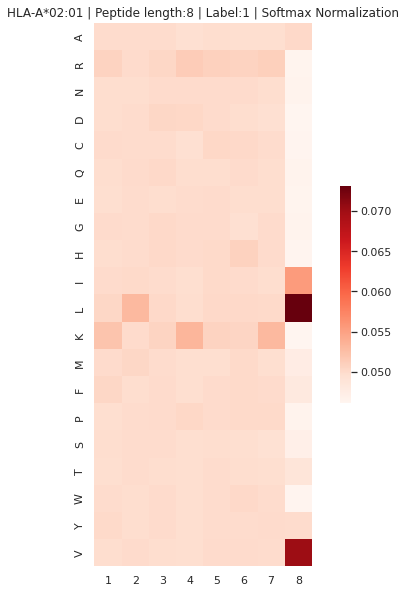

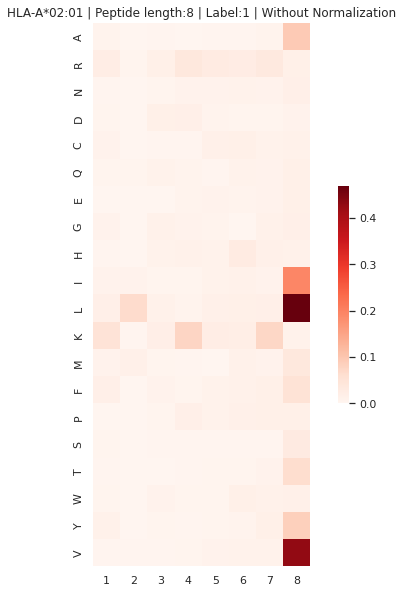









--------------------------
8 1
#Peptides: 924
HLA: HLA-B*08:01
Start
Threshold: 0.68
Pos
DLKRKHRLDraw


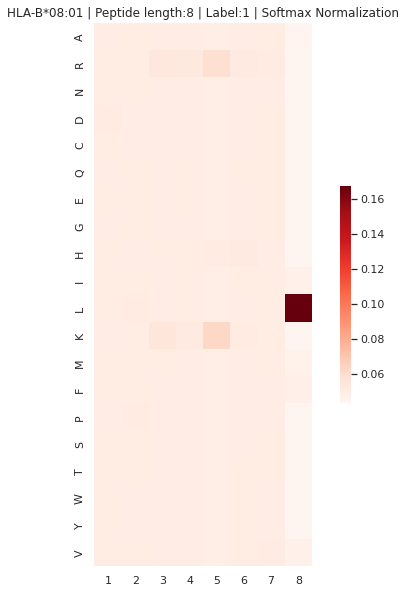

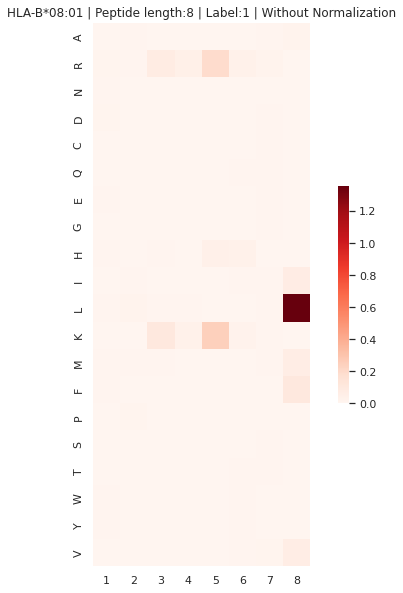









--------------------------
8 1
#Peptides: 0
HLA: HLA-B*27:02
Start
Threshold: nan
Pos
AAAAAAAADraw


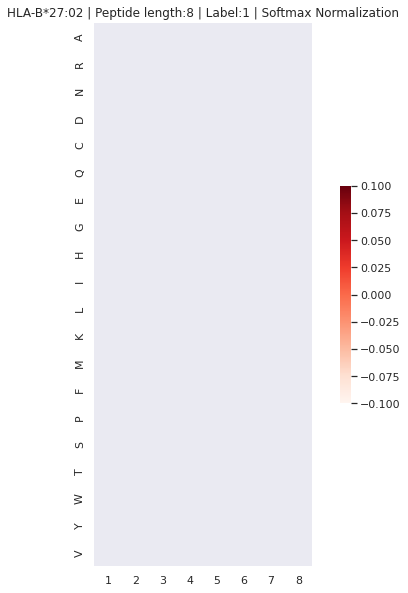

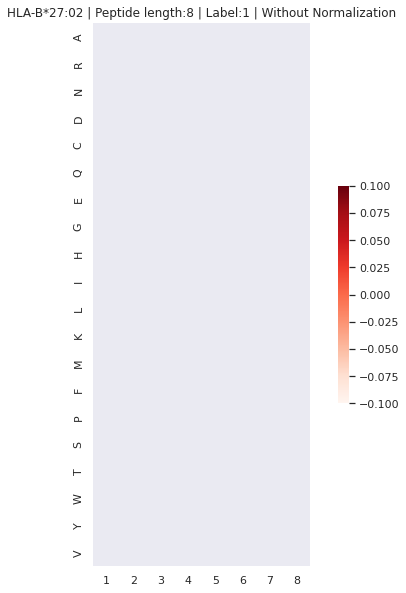









--------------------------
8 1
#Peptides: 574
HLA: HLA-C*05:01
Start
Threshold: 0.48
Pos
KLDKHRKLDraw


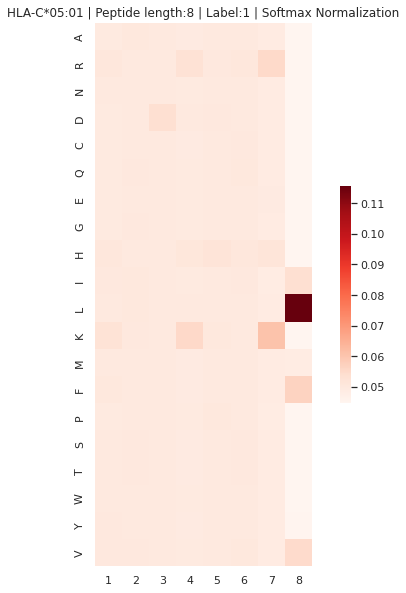

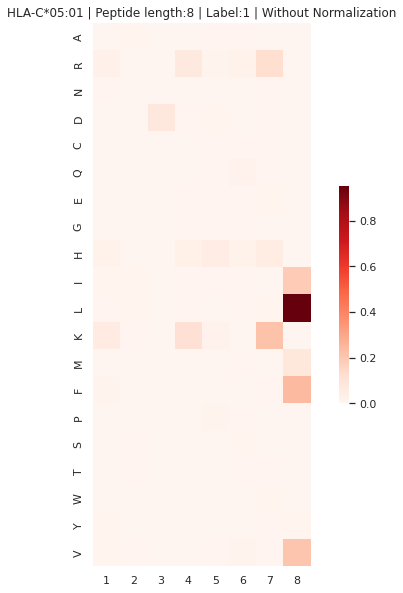









--------------------------
9 1
#Peptides: 15673
HLA: HLA-A*02:01
Start
Threshold: 0.32
Pos
KLLKKKHKLDraw


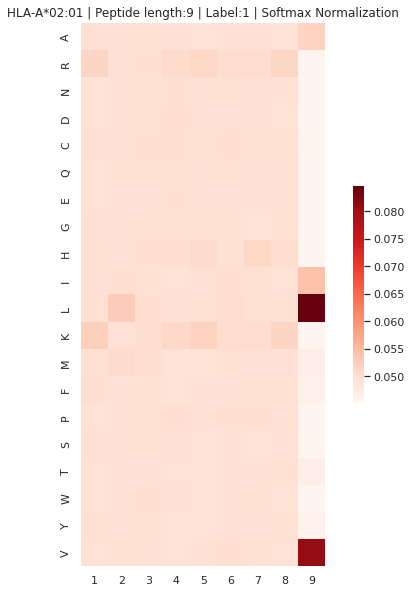

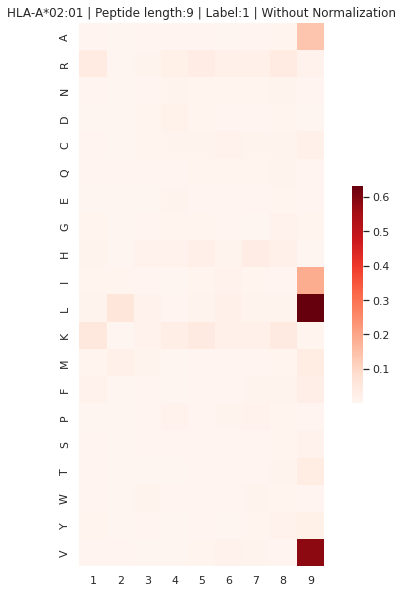









--------------------------
9 1
#Peptides: 4221
HLA: HLA-B*08:01
Start
Threshold: 0.56
Pos
RLKRRRRSLDraw


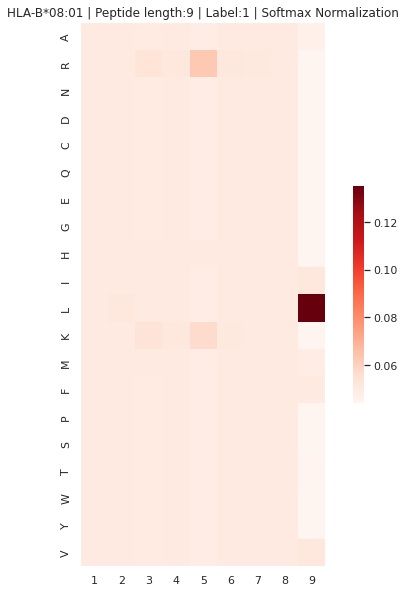

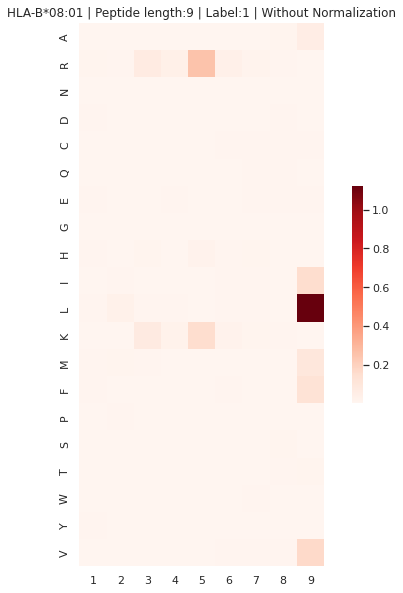









--------------------------
9 1
#Peptides: 1025
HLA: HLA-B*27:02
Start
Threshold: 0.33
Pos
RRWRRRLGFDraw


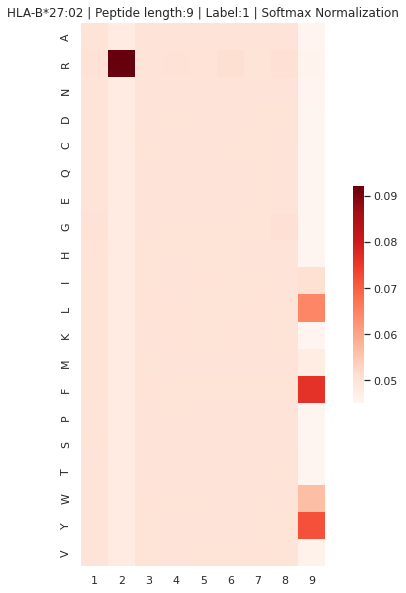

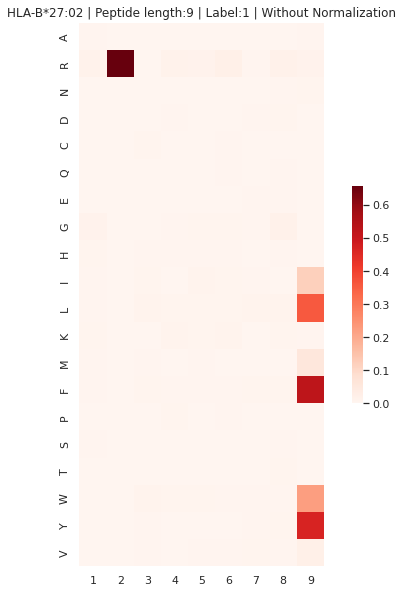









--------------------------
9 1
#Peptides: 2928
HLA: HLA-C*05:01
Start
Threshold: 0.42
Pos
KLDKKRRKLDraw


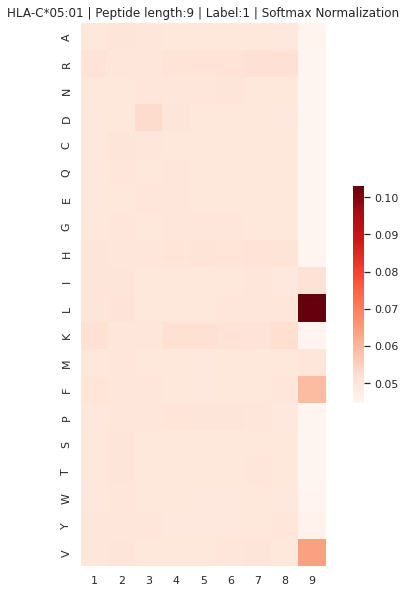

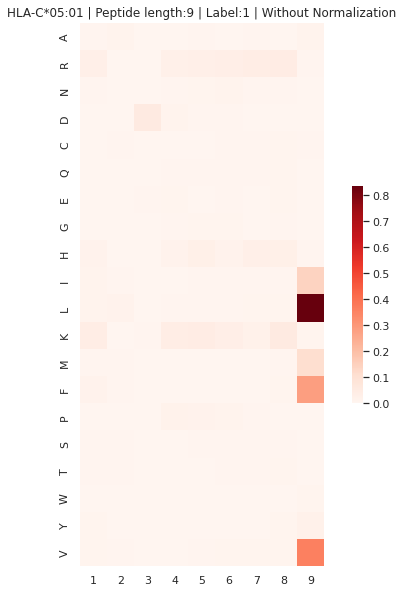









--------------------------
10 1
#Peptides: 4234
HLA: HLA-A*02:01
Start
Threshold: 0.24
Pos
KLLKKKKHKVDraw


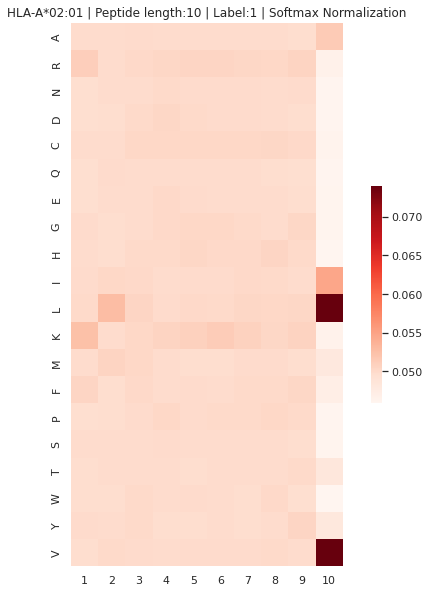

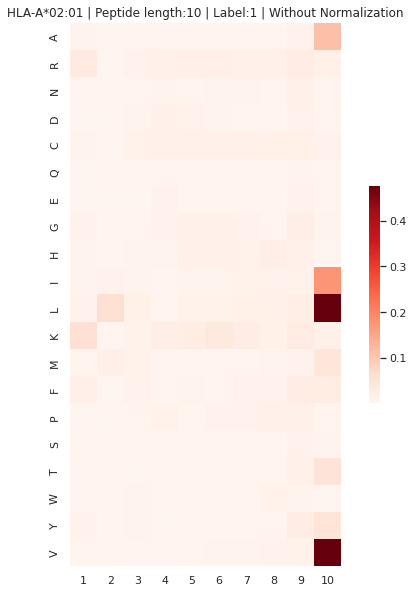









--------------------------
10 1
#Peptides: 274
HLA: HLA-B*08:01
Start
Threshold: 0.54
Pos
RRRKRKRCILDraw


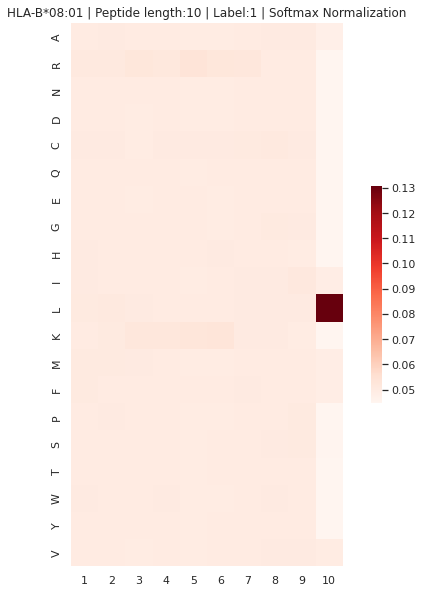

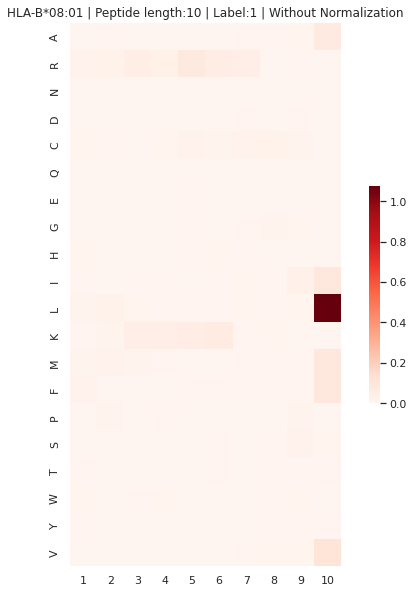









--------------------------
10 1
#Peptides: 720
HLA: HLA-B*27:02
Start
Threshold: 0.31
Pos
RRWKCLGLGFDraw


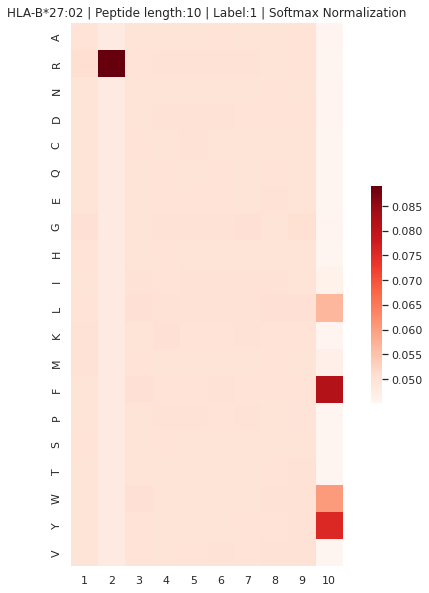

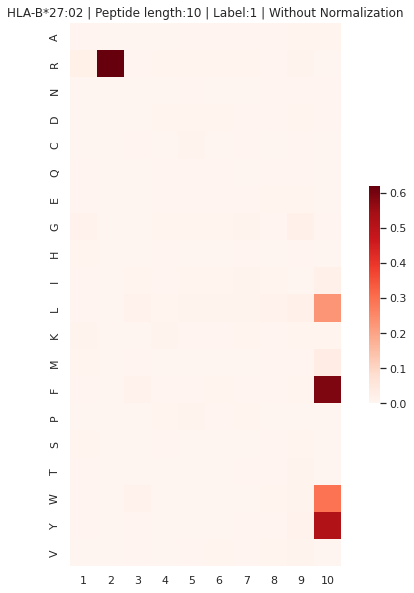









--------------------------
10 1
#Peptides: 468
HLA: HLA-C*05:01
Start
Threshold: 0.34
Pos
KLDKKRRKRLDraw


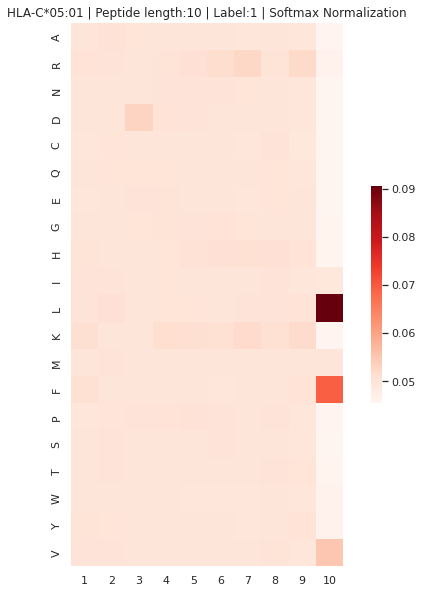

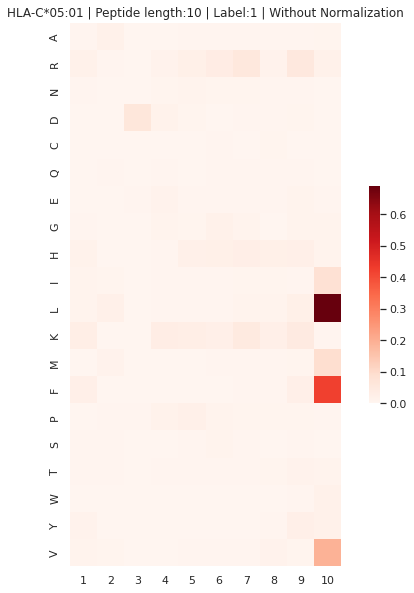









--------------------------
11 1
#Peptides: 2004
HLA: HLA-A*02:01
Start
Threshold: 0.18
Pos
KLLDKKKKLKLDraw


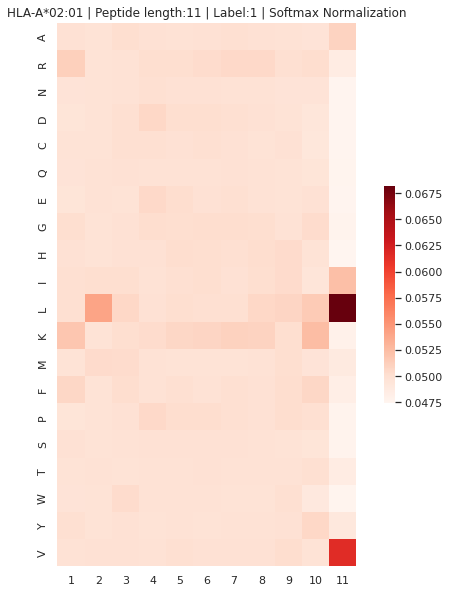

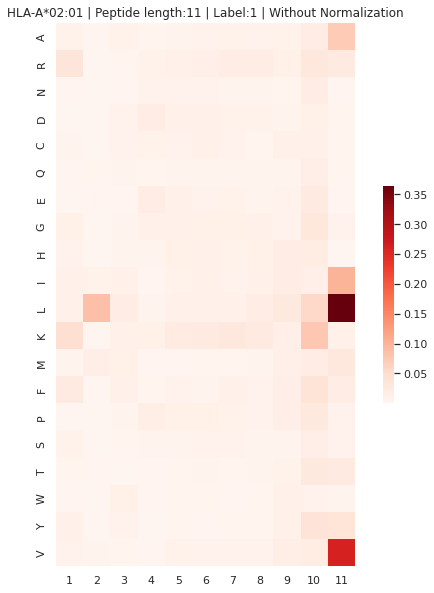









--------------------------
11 1
#Peptides: 131
HLA: HLA-B*08:01
Start
Threshold: 0.27
Pos
FLRRRCRRRPLDraw


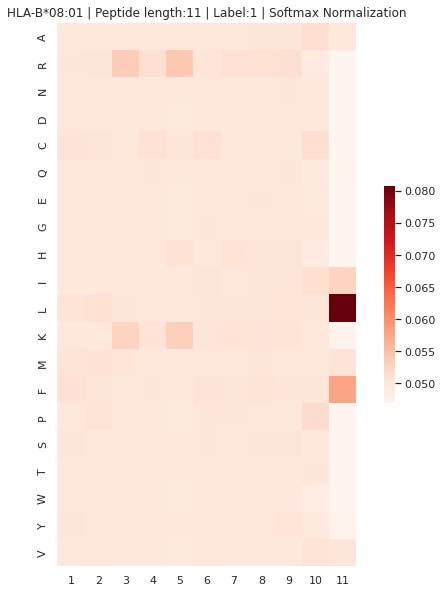

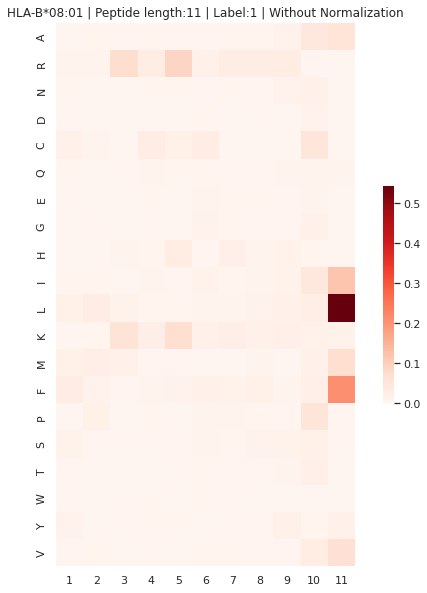









--------------------------
11 1
#Peptides: 465
HLA: HLA-B*27:02
Start
Threshold: 0.24
Pos
RRFGPKGGLYYDraw


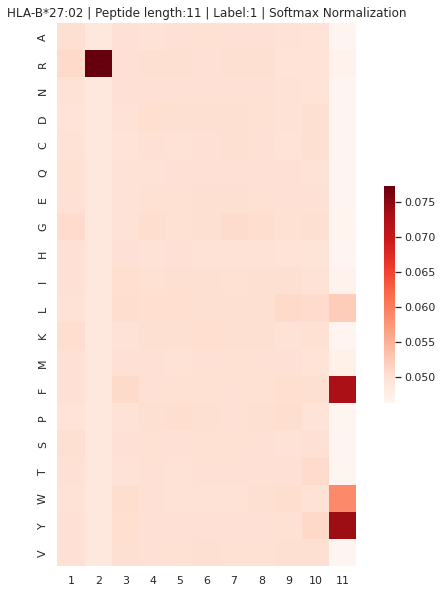

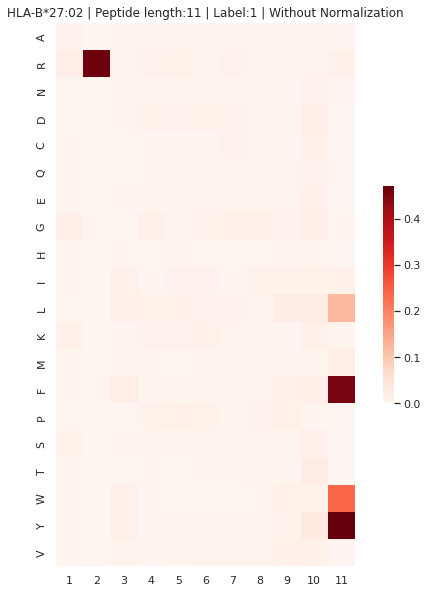









--------------------------
11 1
#Peptides: 236
HLA: HLA-C*05:01
Start
Threshold: 0.28
Pos
FLDDPRKKLKLDraw


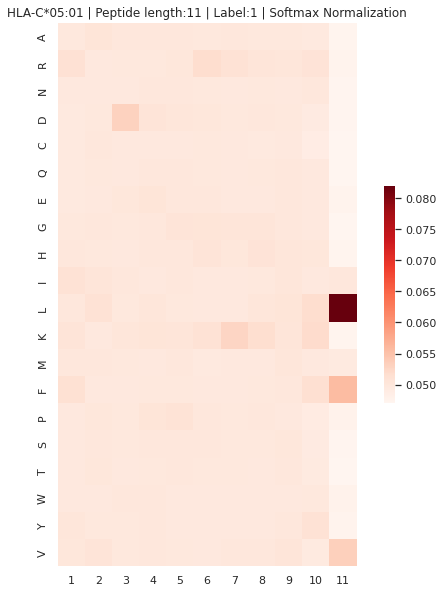

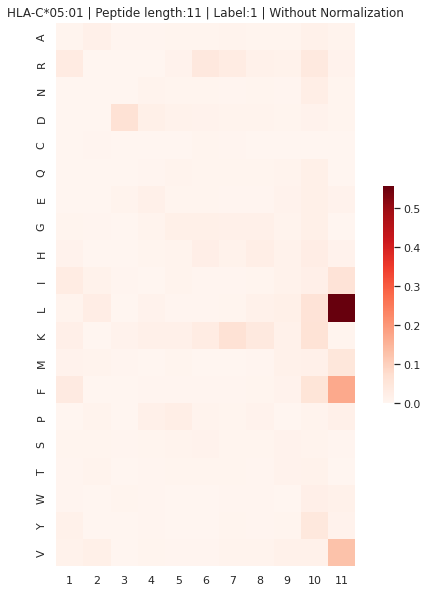









--------------------------
12 1
#Peptides: 912
HLA: HLA-A*02:01
Start
Threshold: 0.12
Pos
KLLDGKKKKLLLDraw


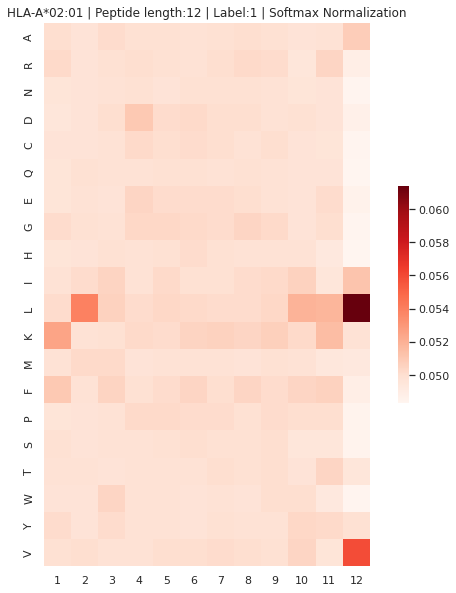

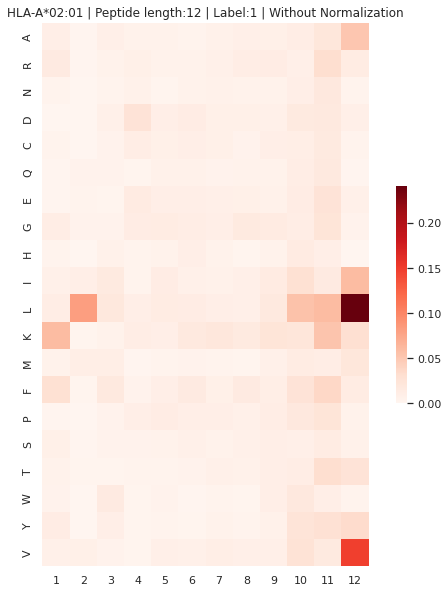









--------------------------
12 1
#Peptides: 145
HLA: HLA-B*08:01
Start
Threshold: 0.18
Pos
FLRKRFCKFCPLDraw


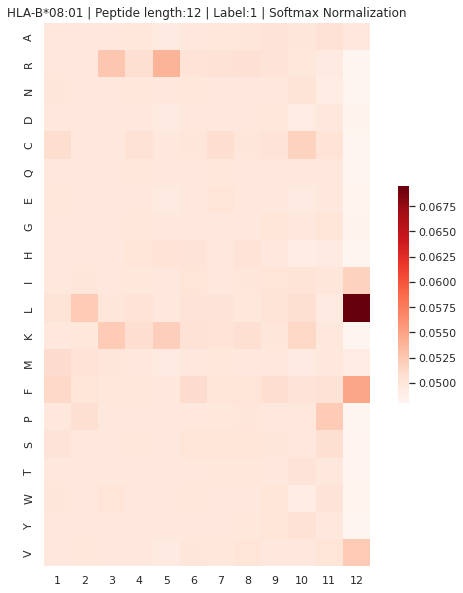

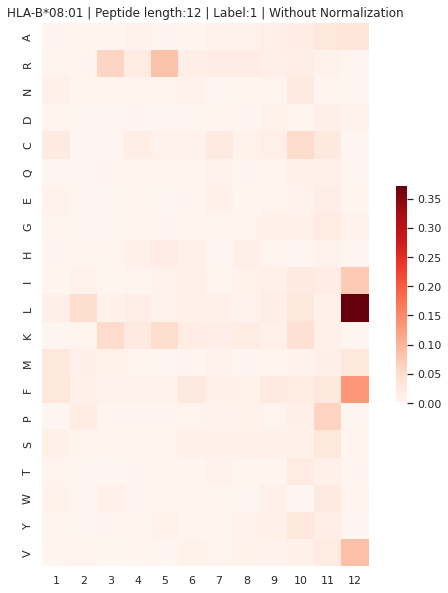









--------------------------
12 1
#Peptides: 233
HLA: HLA-B*27:02
Start
Threshold: 0.18
Pos
RRWPPKGDGWLYDraw


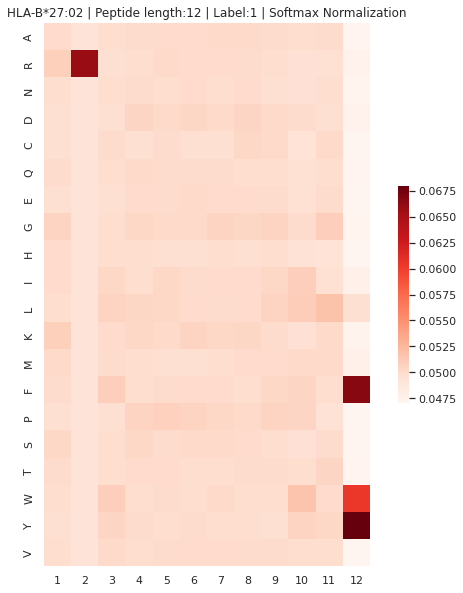

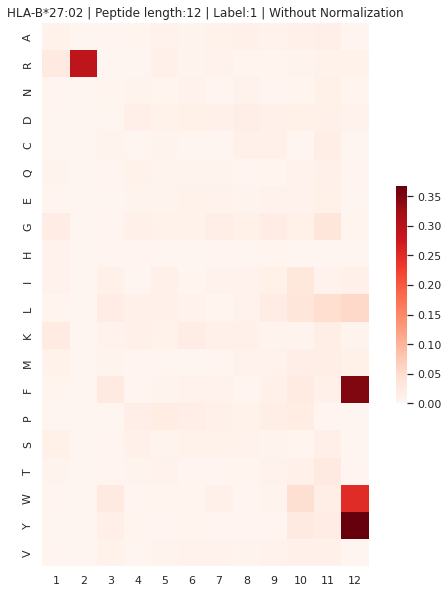









--------------------------
12 1
#Peptides: 76
HLA: HLA-C*05:01
Start
Threshold: 0.15
Pos
KADKKKKKKGFLDraw


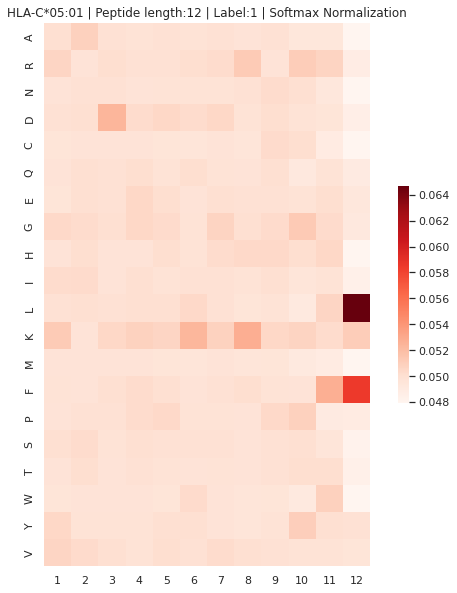

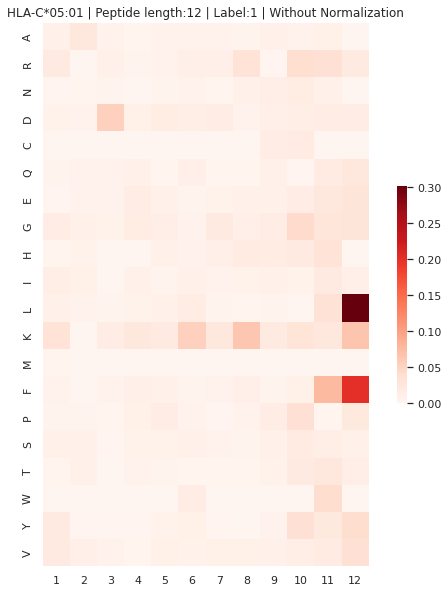









--------------------------
13 1
#Peptides: 380
HLA: HLA-A*02:01
Start
Threshold: 0.09
Pos
FLLDEGKGKKLKLDraw


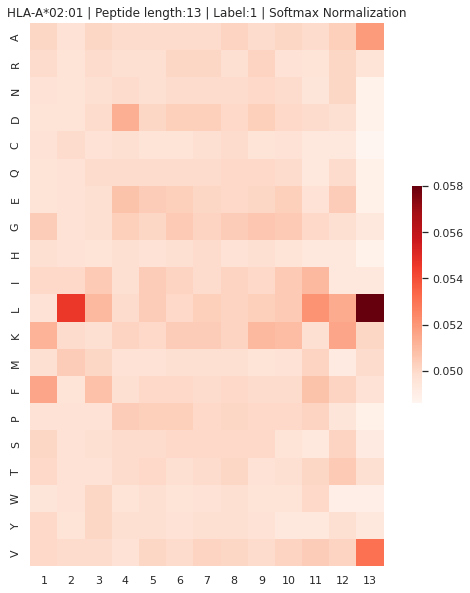

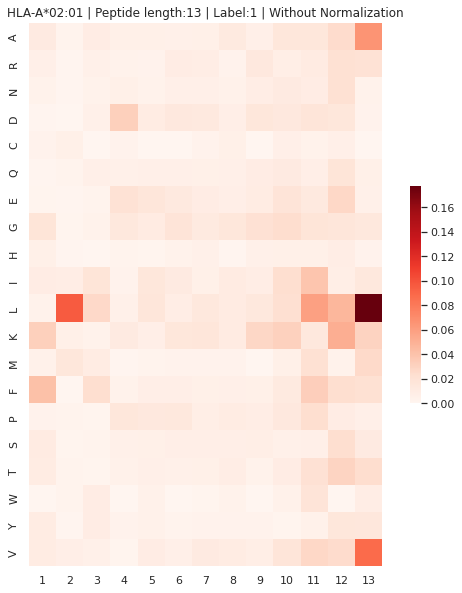









--------------------------
13 1
#Peptides: 0
HLA: HLA-B*08:01
Start
Threshold: nan
Pos
AAAAAAAAAAAAADraw


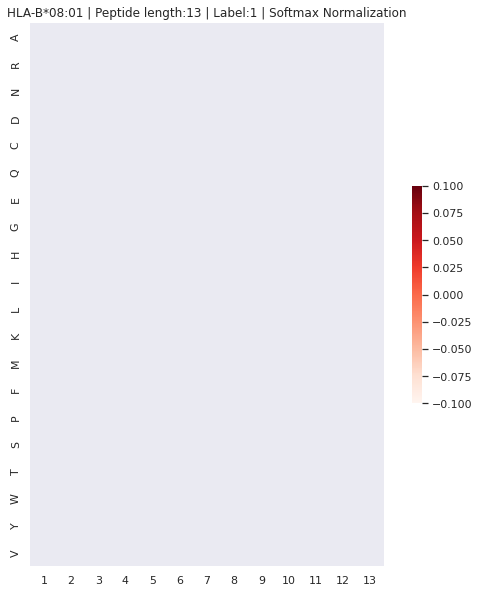

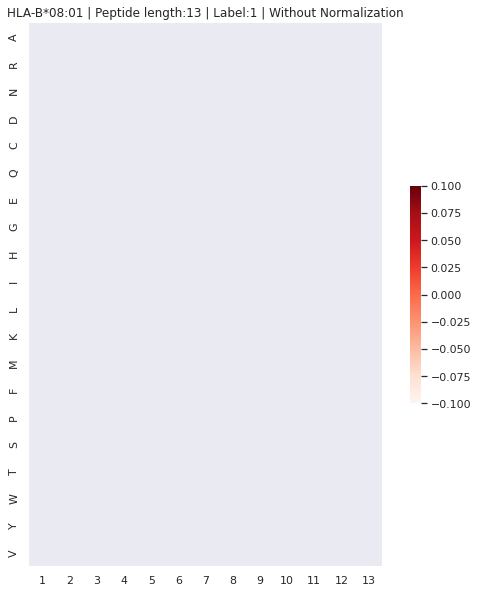









--------------------------
13 1
#Peptides: 107
HLA: HLA-B*27:02
Start
Threshold: 0.21
Pos
RRWGCRGGGGLLYDraw


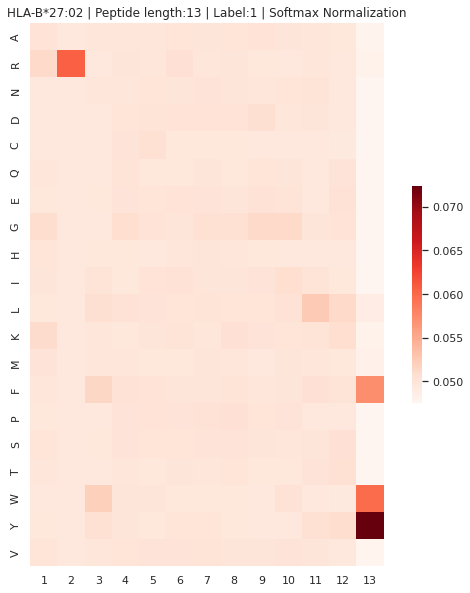

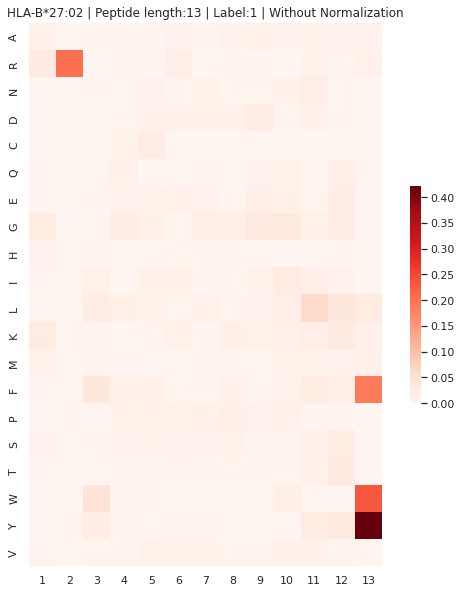









--------------------------
13 1
#Peptides: 60
HLA: HLA-C*05:01
Start
Threshold: 0.14
Pos
KPDGGKGGKYRKLDraw


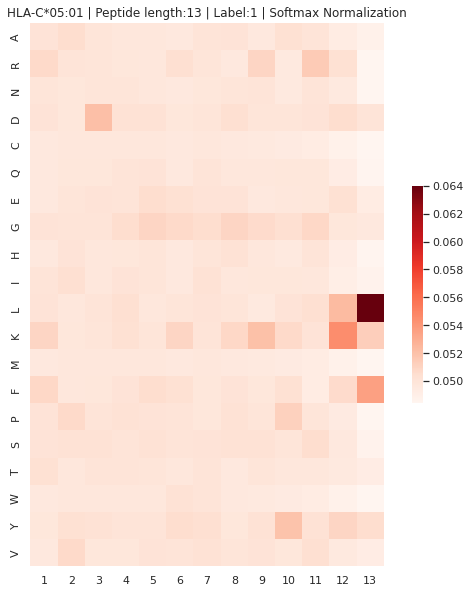

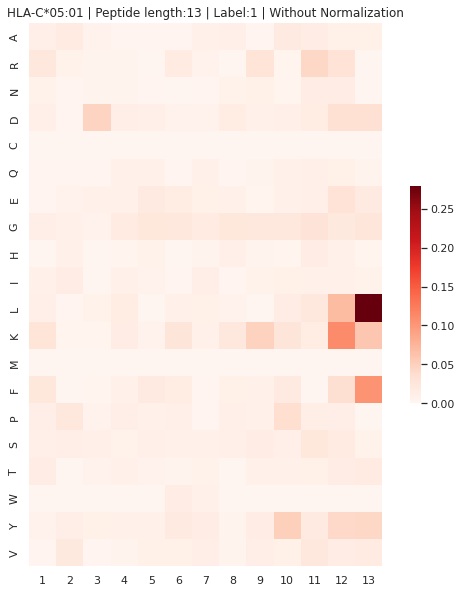









--------------------------
14 1
#Peptides: 203
HLA: HLA-A*02:01
Start
Threshold: 0.05
Pos
FLFEPLPGLKLLLLDraw


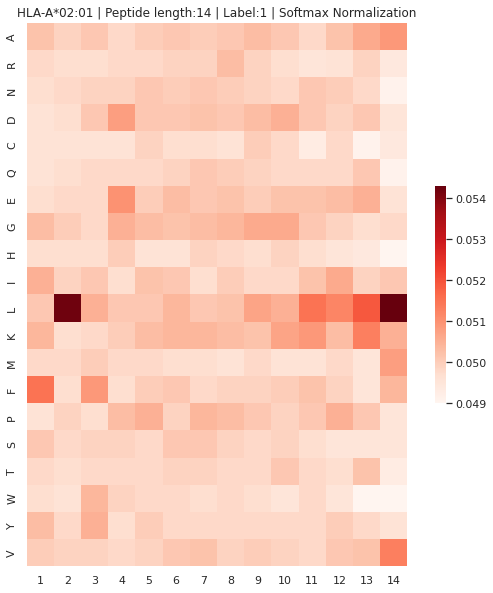

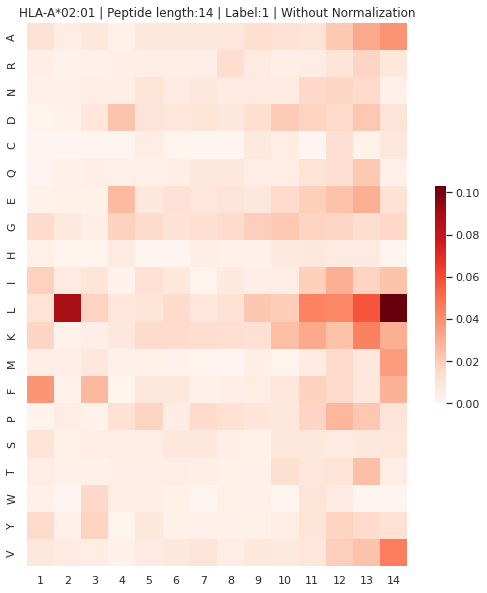









--------------------------
14 1
#Peptides: 0
HLA: HLA-B*08:01
Start
Threshold: nan
Pos
AAAAAAAAAAAAAADraw


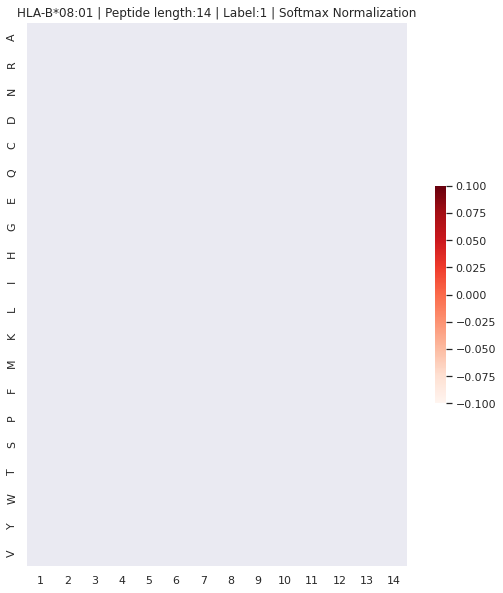

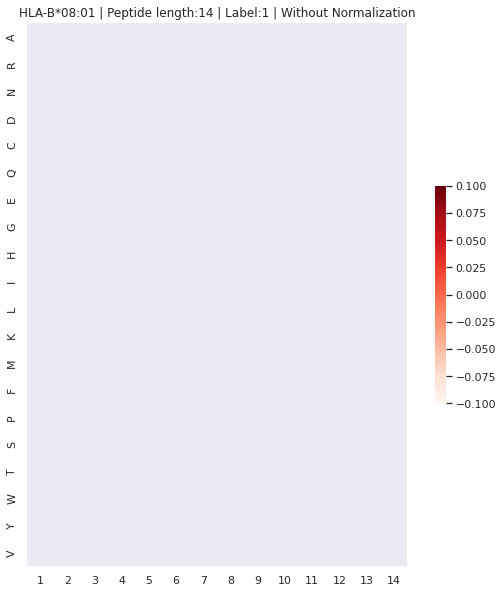









--------------------------
14 1
#Peptides: 0
HLA: HLA-B*27:02
Start
Threshold: nan
Pos
AAAAAAAAAAAAAADraw


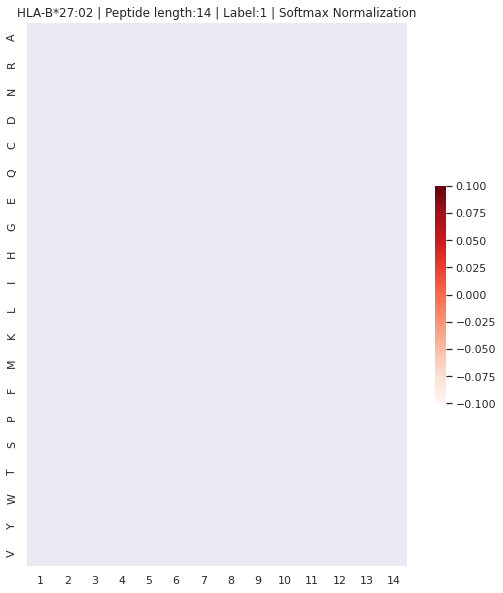

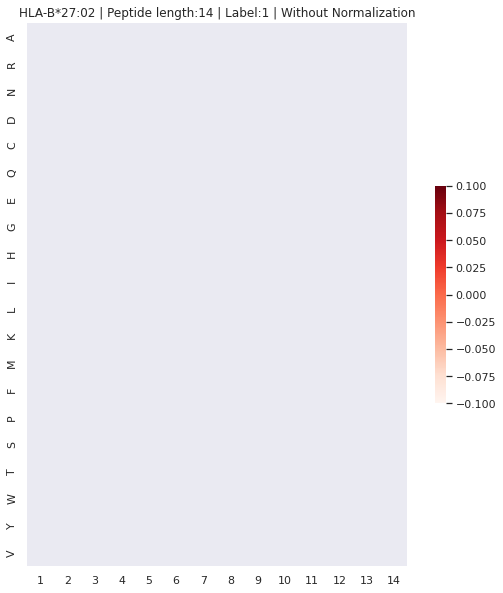









--------------------------
14 1
#Peptides: 63
HLA: HLA-C*05:01
Start
Threshold: 0.06
Pos
KADYPKGGKKGGLLDraw


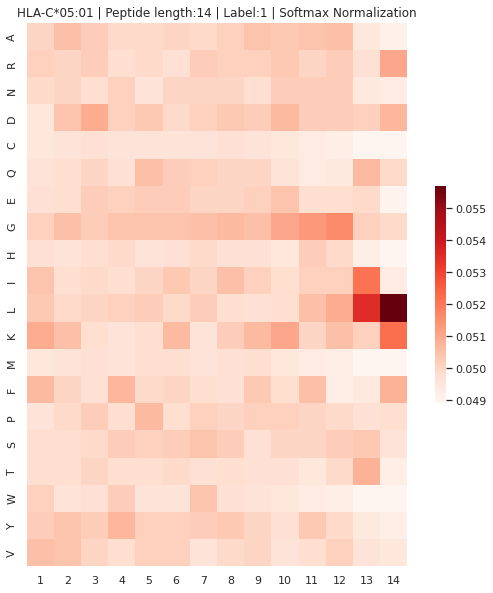

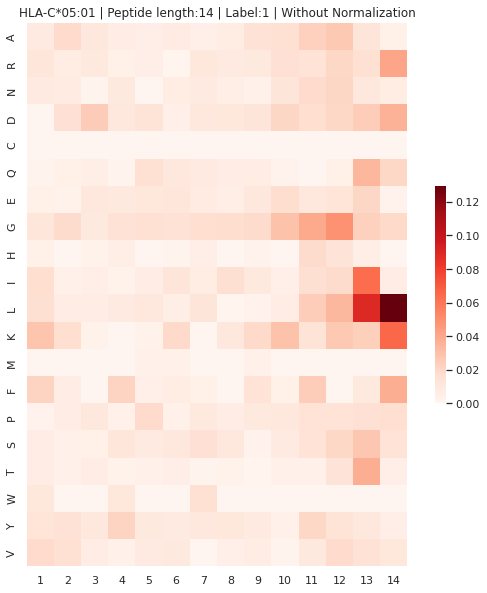

In [132]:
  
HLA_list = list(set(df_pd_nested_test_unique.reset_index(drop=True)['HLA'].tolist()))

for lll in [8,9,10,11,12,13,14]:
    for HLA_filter in ['HLA-A*02:01', 'HLA-B*08:01', 'HLA-B*27:02', 'HLA-C*05:01']:
        print('\n\n--------------------------')
        softmax_pd, unsoftmax_pd, max_list, new_pseudo =  draw_hla_length_aatype_position(df_pd_nested_test_unique.reset_index(drop=True), enc_attn_list_all, HLA_filter, 3, label = 1 , length = lll , threshold = 0.50, show = True, softmax = True, unsoftmax = True)    
        
        print("\n\n\n\n\n")